# ARIMAX_N with GRIDSEARCH_CV and PCA on ADM0, QUARTERLY

In [1]:
import pandas as pd

# pd.set_option('display.max_rows', 500)
# pd.set_option('display.max_columns', 500)

import warnings
warnings.simplefilter('ignore')

import warnings
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.simplefilter('ignore', ConvergenceWarning)
    
import time
import datetime

import os

## Model Specifications

In [2]:
TARGET_VARIABLE = "SUM(FATALITIES)"
SEASONAL_PERIODICITY = 4 # for data frequency & seasonality S

SEASONALITY = False
NEIGHBORS = True # X_N
SOCIO_ECO_VARS = False # X_SE
N_LAGS_X = 1 # todo: remove or change behavior from max lags to lag
DIM_REDUCTION_METHOD = "PCA"

if SEASONALITY:
    CV_FOLDS = 5
else:
    CV_FOLDS = 5

In [3]:
MODEL_NAME = ""
if SEASONALITY:
    MODEL_NAME += "S" 
    
MODEL_NAME += "ARIMA"

if SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_SE+N"
    
if SOCIO_ECO_VARS and not NEIGHBORS:
    MODEL_NAME += "X_SE"
    
if not SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_N"
    
if SEASONAL_PERIODICITY ==  12:
    MODEL_NAME += "_MONTHLY"
elif SEASONAL_PERIODICITY == 4:
    MODEL_NAME += "_QUARTERLY"

MODEL_NAME

'ARIMAX_N_QUARTERLY'

### Hyperparameter Grid

In [4]:
# create a set of sarima configs to try
PARAM_GRID = list()
# parameter options to try

### PCA
if NEIGHBORS or SOCIO_ECO_VARS:
    n_components = range(0, 4) # include up to three main components
else:
    n_components = [0]
    

### ARMA
p_params = range(4) # AR 3
d_params = range(2) # Differencing 1
q_params = range(4) # MA 3


### SEASONALITY
if SEASONALITY:
    P_params = range(3) # 5
    D_params = range(2) # 1
    Q_params = range(3) # 2
    
    ### TREND
    # t_params = ['n','c','t','ct'] # Form of Trend
    # t_params = ['n', 't', 'ct'] # Form of Trend
    t_params = ["n"]

    ### SEASONAL PERIODICITY
    m_params = [SEASONAL_PERIODICITY]   
else:
    P_params = [0]
    D_params = [0]
    Q_params = [0]

    t_params = ["n"] # Form of Trend

    m_params = [0] 

for n in n_components:
    for p in p_params:
        for d in d_params:
            for q in q_params:
                for P in P_params:
                    for D in D_params:
                        for Q in Q_params:
                            for m in m_params:
                                for t in t_params:
                                    cfg = [n, (p, d, q), (P, D, Q, m), t]
                                    PARAM_GRID.append(cfg)
len(PARAM_GRID)    

128

## Model Training

In [5]:
from common_functions import *
from forecasters import *

#### Training Method

In [6]:
def sarimax(target_variable="SUM(FATALITIES)", 
            target_country="MLI", 
            predictor_countries=["BFA"], 
            n_lags_X = N_LAGS_X, 
            seasonal_periodicity = SEASONAL_PERIODICITY):
        
    ### GET DATA
    y, X = getData(target_variable = target_variable, 
                   target_country = target_country, 
                   predictor_countries = predictor_countries,
                   socio_eco_vars = SOCIO_ECO_VARS,
                   n_lags_X = N_LAGS_X, 
                   seasonal_periodicity = SEASONAL_PERIODICITY)
    
    ### SPLIT DATA
    X_train, X_test, y_train, y_test = train_test_split(y = y,
                                                        X = X, 
                                                        forecast_horizon = SEASONAL_PERIODICITY)
    
    ### TRAINING WITH GRIDSEARCHCV
    gscv = GridSearchCV(param_grid = PARAM_GRID,
                        forecaster = TimeSeriesForecasterPCA_LinInt,
                        seasonal_periodicity = SEASONAL_PERIODICITY,
                        cv_folds = CV_FOLDS)
    training_res = gscv.train(X_train, y_train)

    if training_res is not None:
        model = gscv
        # print ARIMA summary
        print(training_res)
        print(model.best_model_result.mle_retvals)
        plt.tight_layout()
        try:
            model.best_model_result.plot_diagnostics(figsize=(16*0.7, 10*0.7), lags = SEASONAL_PERIODICITY+1)
        except: 
            pass
        best_parameters = str(model.best_model_cv_results)
        
    else:
        print("No model fitted --> Prediction with Naive Model ")
        model = NoChange().fit(X_train, y_train)
        best_parameters = np.nan
        
    ### PREDICTION
    prediction_results = model.evaluate_model(X_test, y_test, fh = SEASONAL_PERIODICITY)
    
    if prediction_results["FAT_PRED"].isnull().values.any():
        model = NoChange().fit(X_train, y_train)
        print("Model Prediction failed --> Prediction with Naive Model ")
        model = NoChange().fit(X_train, y_train)
        best_parameters = np.nan
        prediction_results = model.evaluate_model(X_test, y_test, fh = SEASONAL_PERIODICITY)
    
    ### ADJUST RESULT DF
    prediction_results["GID_0"] = target_country
    prediction_results["MONTH"] = pd.to_datetime(prediction_results["MONTH"].astype(str)) 
    prediction_results["PARAMETERS"] = best_parameters

    print(prediction_results)

    return prediction_results

#### Automated Training for all 234 Countries 

In [7]:
acled_monthly_adm0 = pd.read_csv("../data/TB003_EVENT_OUTCOMES_MONTHLY_START_DATE.csv")
gid0_neighbors = pd.read_csv("../data/GID_0_Neighbours.csv")
# gid_list = acled_monthly_adm0["GID_0"].unique()[::-1] #reverse
gid_list = acled_monthly_adm0["GID_0"].unique()
len(gid_list)

234

######## ABW (1/234) #########
0
Neighbor countries: []
Getting Data for ABW
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (13, 0)
y: (13, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ABW   No. Observations:                    9
Model:                         SARIMAX   Log Likelihood                  95.346
Date:                 Wed, 19 Oct 2022   AIC                           -188.692
Time:                         10:23:19   BIC                           -188.495
Sample:                     01-31-2019   HQIC                          -189.117
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err 

<Figure size 432x288 with 0 Axes>

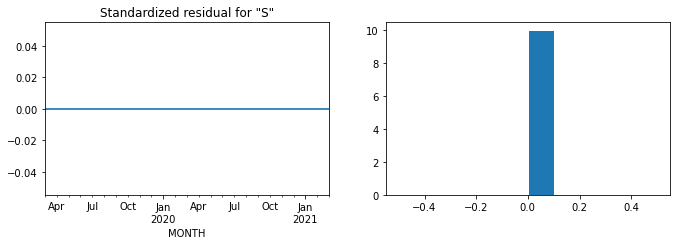

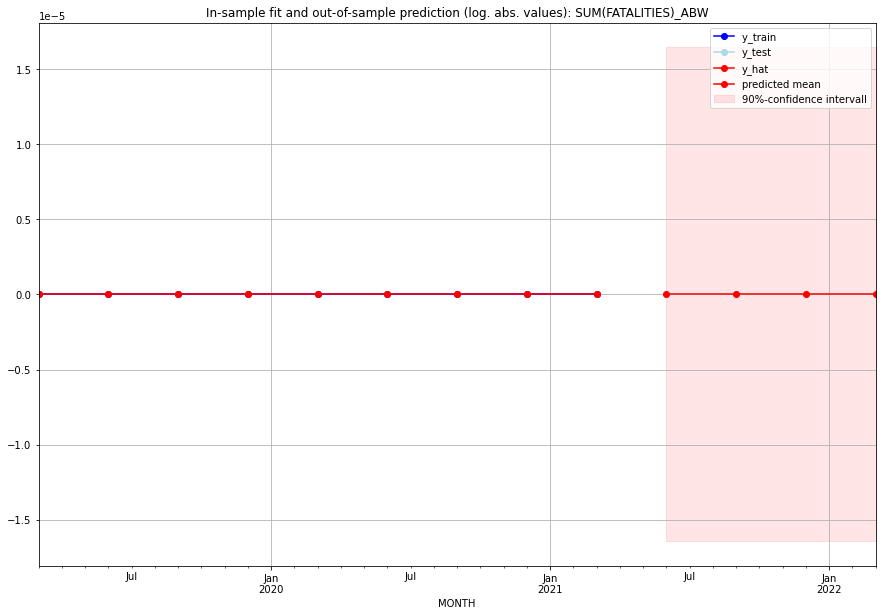

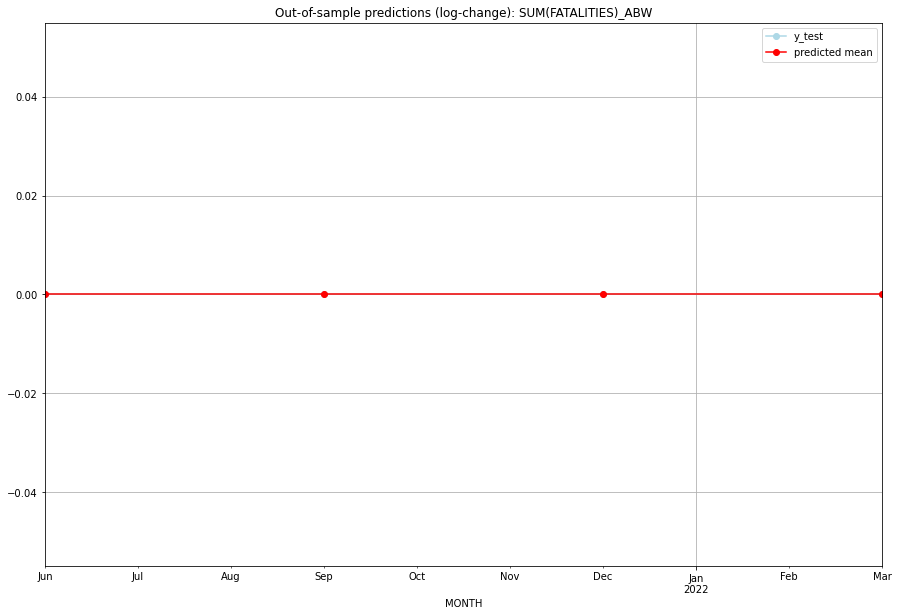

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ABW   
1 2021-07-01       0.0         0.0           0.0             0.0   ABW   
2 2021-10-01       0.0         0.0           0.0             0.0   ABW   
3 2022-01-01       0.0         0.0           0.0             0.0   ABW   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:04
######## AFG (2/234) #########
0
Neighbor countries: ['PAK', 'IRN', 'TKM', 'TJK', 'CHN', 'UZB']
Getting Data for AFG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 48)
y: (21, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.1731404632772359, 'fold_results': [0.2028665939446319, 0.20133751775232644, 0.11521727813474936]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AFG   No. Observations:                   17
Model:                SARIMAX(2, 1, 0)   Log Likelihood                   3.569
Date:                 Wed, 19 Oct 2022   AIC                              2.861
Time:                         10:23:33   BIC                              6.724
Sample:                     01-31-2017   HQIC                             3.059
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1     

<Figure size 432x288 with 0 Axes>

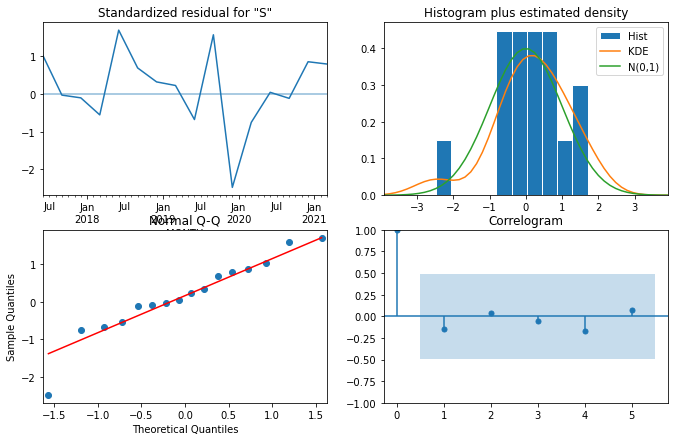

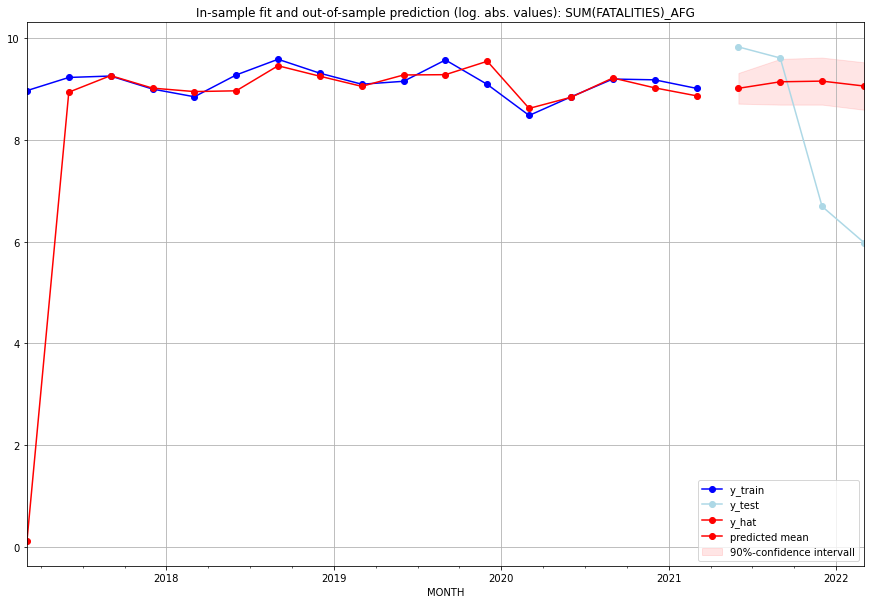

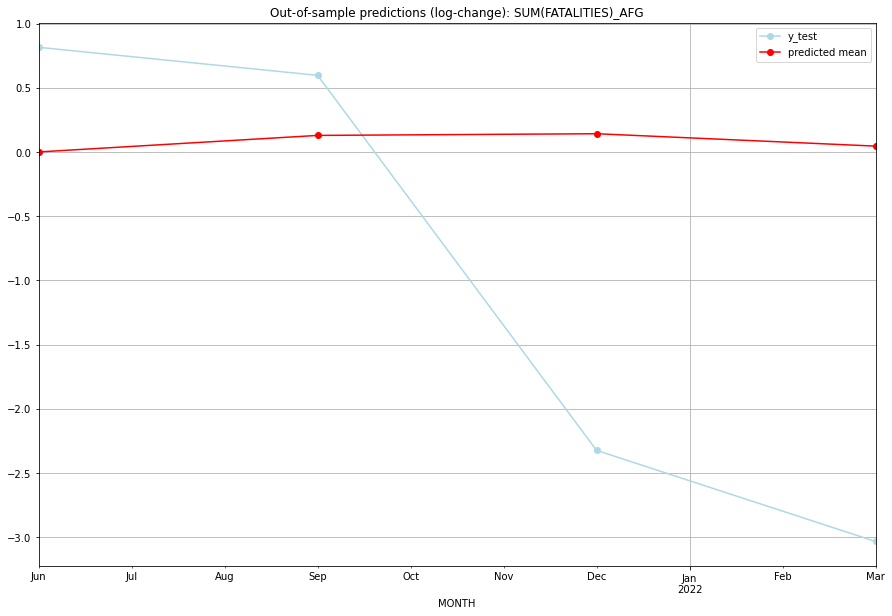

TADDA: 1.7540289533641298
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  8222.782078     18574.0      0.000825        0.815611   AFG   
1 2021-07-01  9352.478729     14933.0      0.129543        0.597435   AFG   
2 2021-10-01  9475.910487       804.0      0.142653       -2.323118   AFG   
3 2022-01-01  8604.817385       395.0      0.046233       -3.032546   AFG   

                                          PARAMETERS  
0  {'params': [2, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## AGO (3/234) #########
0
Neighbor countries: ['COD', 'ZMB', 'NAM', 'COG']
Getting Data for AGO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 32)
y: (100, 1)
------------------------------------------------
Training s

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.3066958186157744, 'fold_results': [2.5321609479046012, 0.8135309839169202, 0.5428895859659827, 1.398849805899, 1.2460477693923684]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AGO   No. Observations:                   96
Model:                SARIMAX(3, 1, 3)   Log Likelihood                -168.076
Date:                 Wed, 19 Oct 2022   AIC                            354.153
Time:                         10:24:02   BIC                            377.138
Sample:                     04-30-1997   HQIC                           363.441
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------

<Figure size 432x288 with 0 Axes>

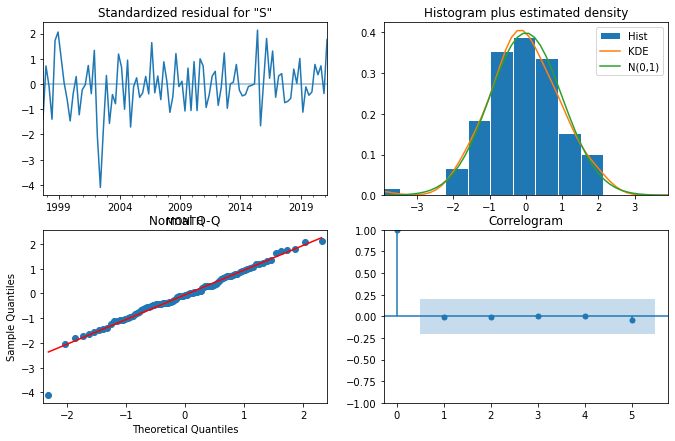

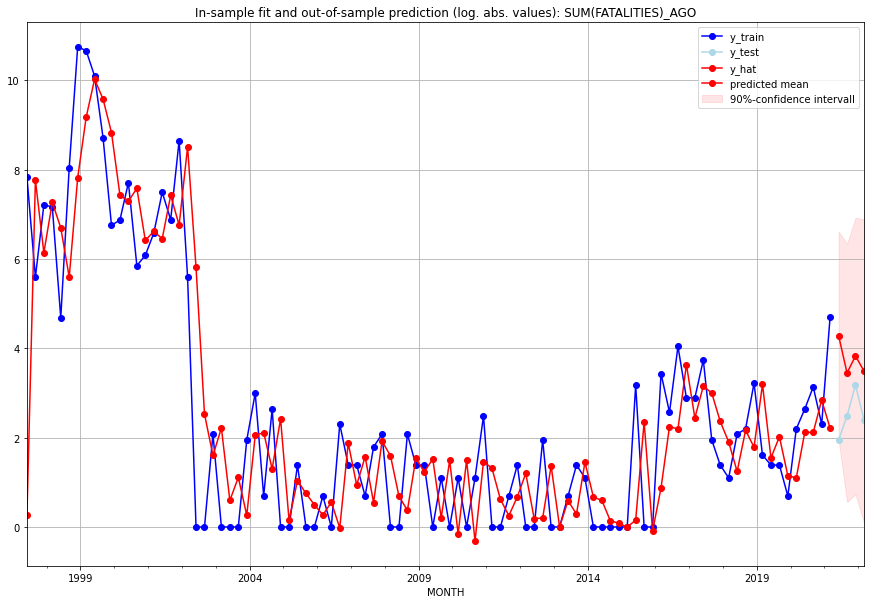

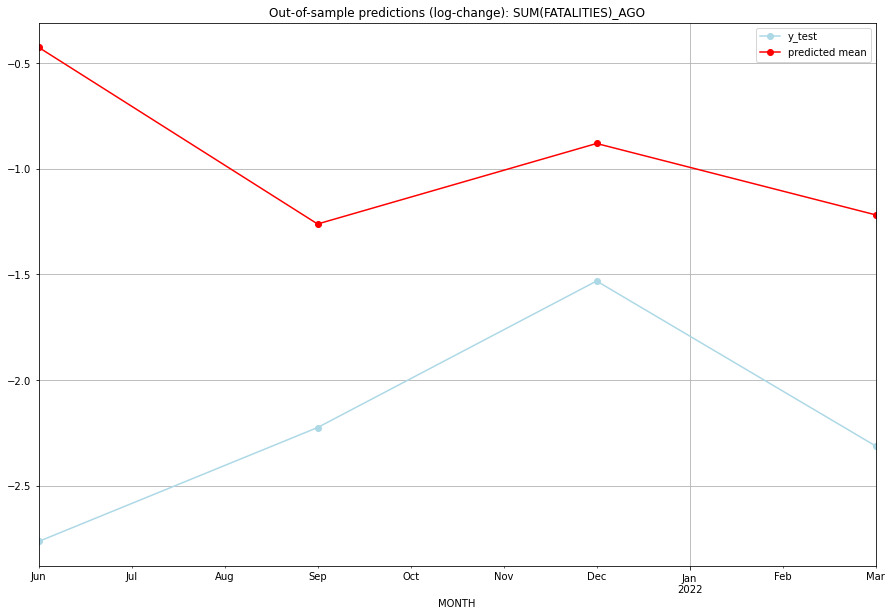

TADDA: 1.261143143954698
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  71.504772         6.0     -0.425878       -2.763620   AGO   
1 2021-07-01  30.433326        11.0     -1.261662       -2.224624   AGO   
2 2021-10-01  45.001306        23.0     -0.880860       -1.531476   AGO   
3 2022-01-01  31.823595        10.0     -1.218383       -2.311635   AGO   

                                          PARAMETERS  
0  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:25
######## AIA (4/234) #########
0
Neighbor countries: []
Getting Data for AIA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient 

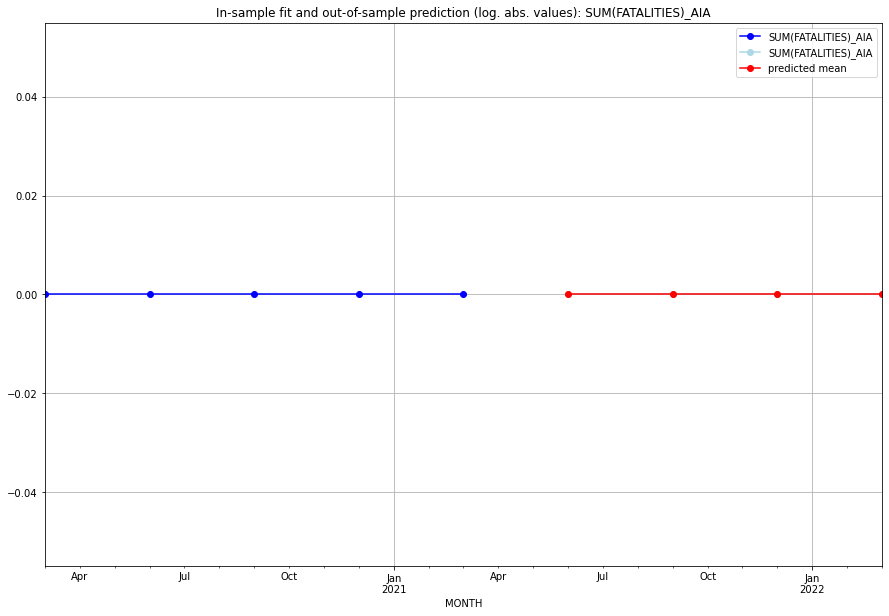

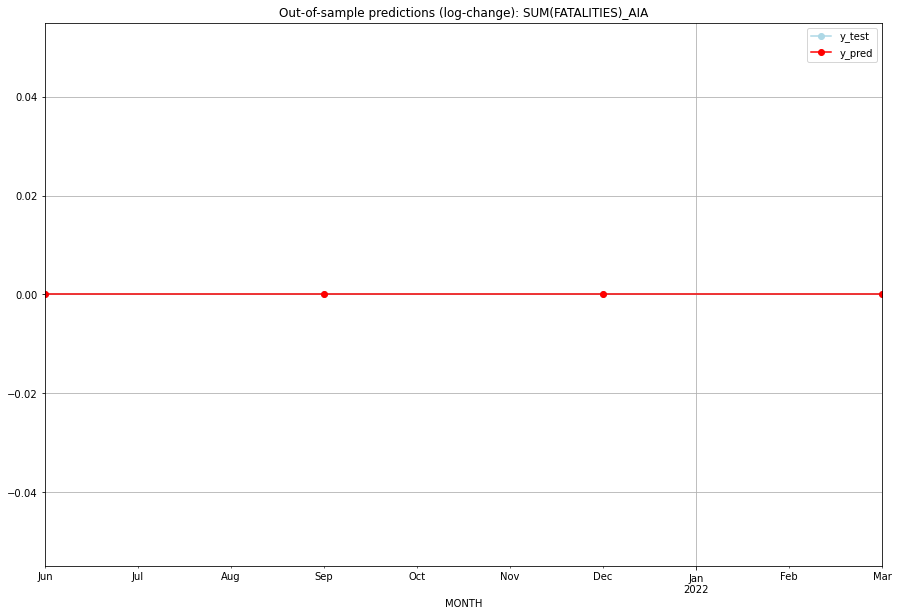

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AIA   
1 2021-07-01       0.0         0.0           0.0             0.0   AIA   
2 2021-10-01       0.0         0.0           0.0             0.0   AIA   
3 2022-01-01       0.0         0.0           0.0             0.0   AIA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## ALA (5/234) #########
0
Neighbor countries: []
Getting Data for ALA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


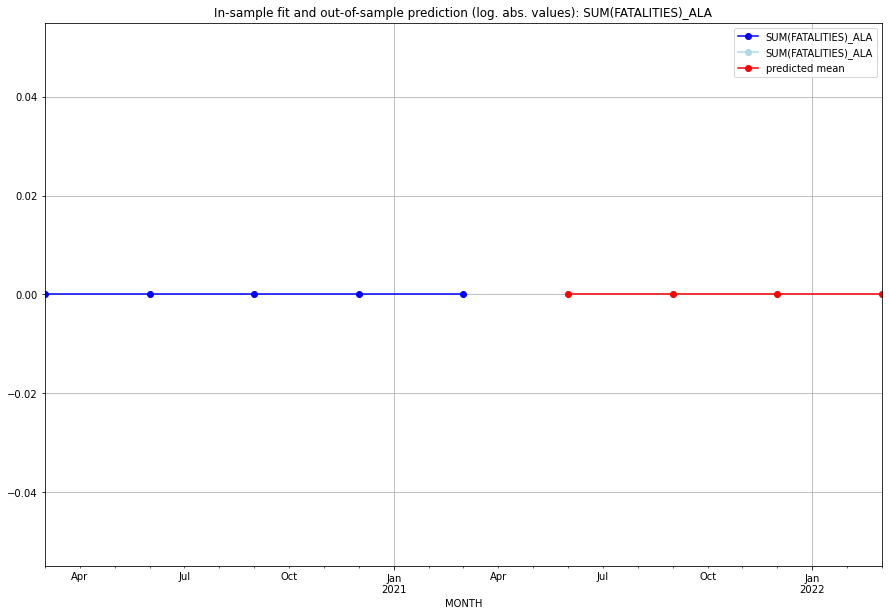

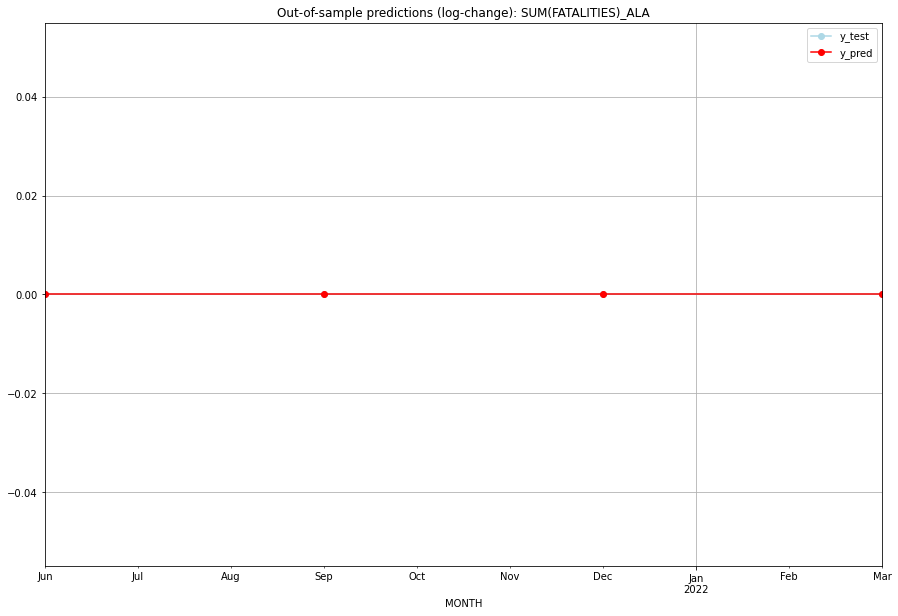

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ALA   
1 2021-07-01       0.0         0.0           0.0             0.0   ALA   
2 2021-10-01       0.0         0.0           0.0             0.0   ALA   
3 2022-01-01       0.0         0.0           0.0             0.0   ALA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## ALB (6/234) #########
0
Neighbor countries: ['MNE', 'GRC', 'XKO', 'MKD']
Getting Data for ALB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 32)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ALB   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:24:20   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

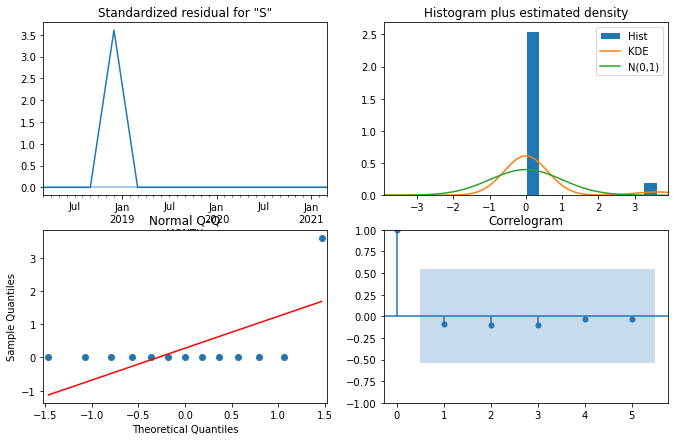

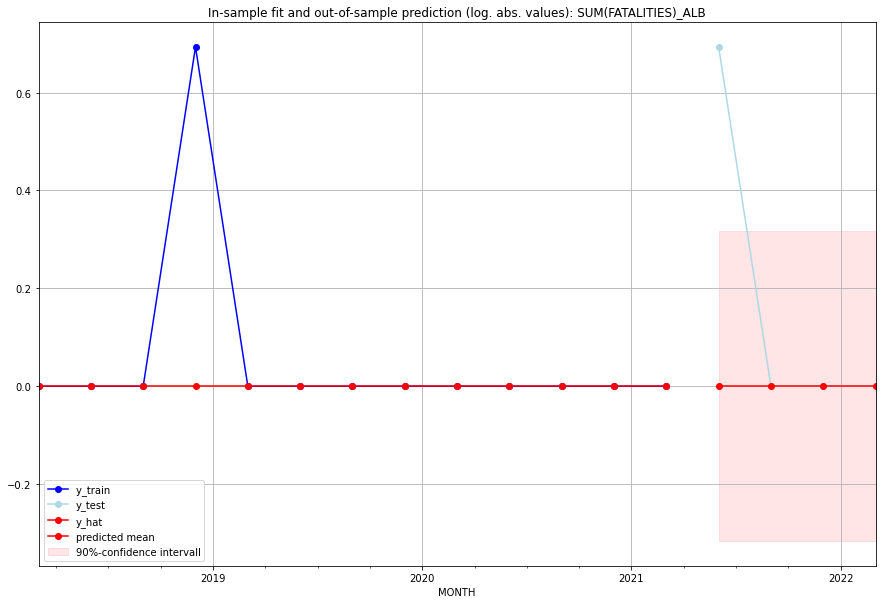

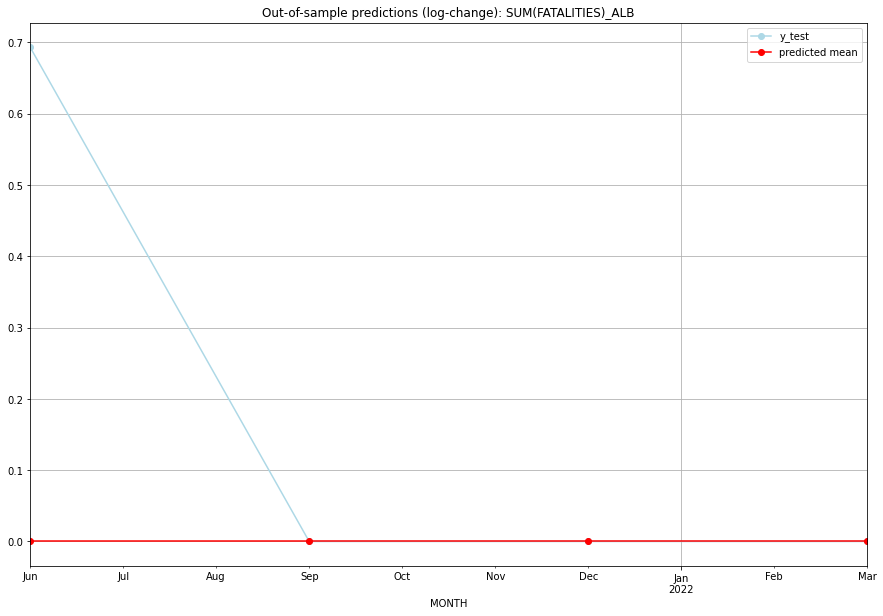

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         1.0           0.0        0.693147   ALB   
1 2021-07-01       0.0         0.0           0.0        0.000000   ALB   
2 2021-10-01       0.0         0.0           0.0        0.000000   ALB   
3 2022-01-01       0.0         0.0           0.0        0.000000   ALB   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## AND (7/234) #########
0
Neighbor countries: ['FRA', 'ESP']
Getting Data for AND
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 16)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Ins

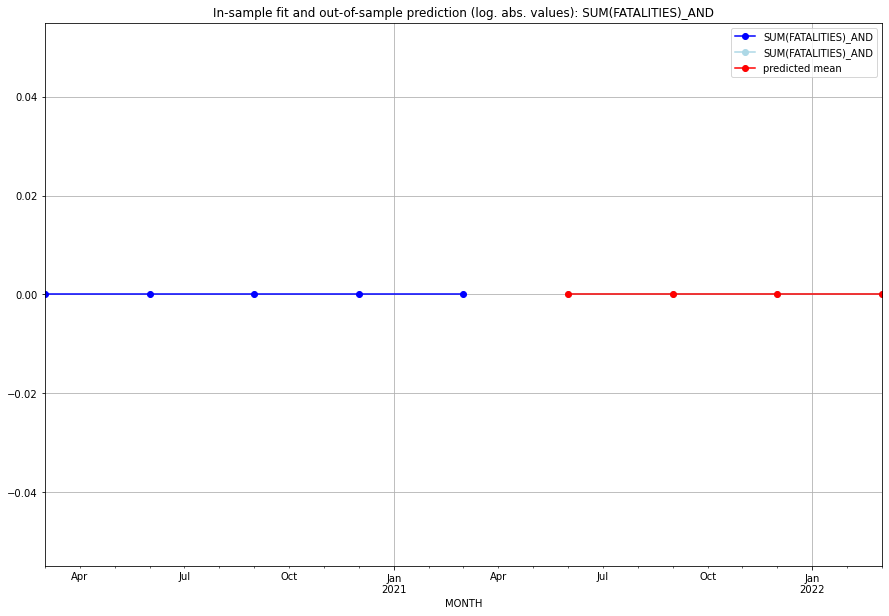

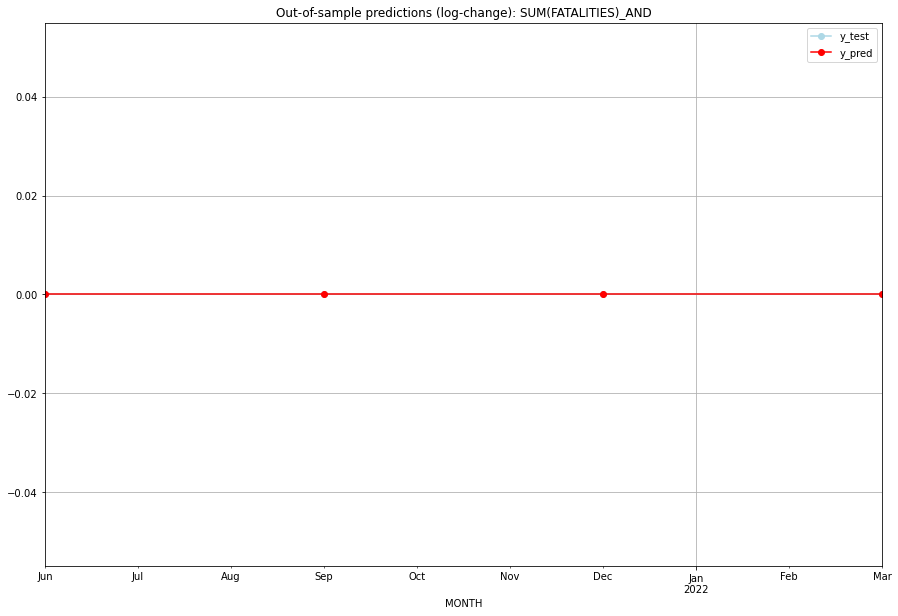

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AND   
1 2021-07-01       0.0         0.0           0.0             0.0   AND   
2 2021-10-01       0.0         0.0           0.0             0.0   AND   
3 2022-01-01       0.0         0.0           0.0             0.0   AND   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## ARE (8/234) #########
0
Neighbor countries: ['OMN', 'SAU']
Getting Data for ARE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 16)
y: (21, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARE   No. Observations:                 

<Figure size 432x288 with 0 Axes>

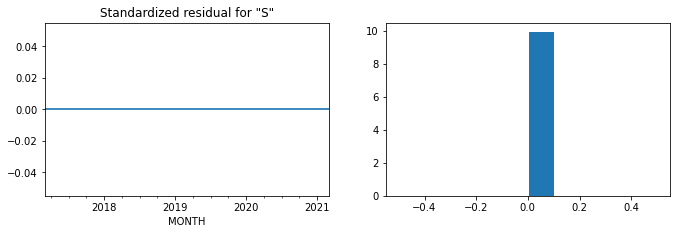

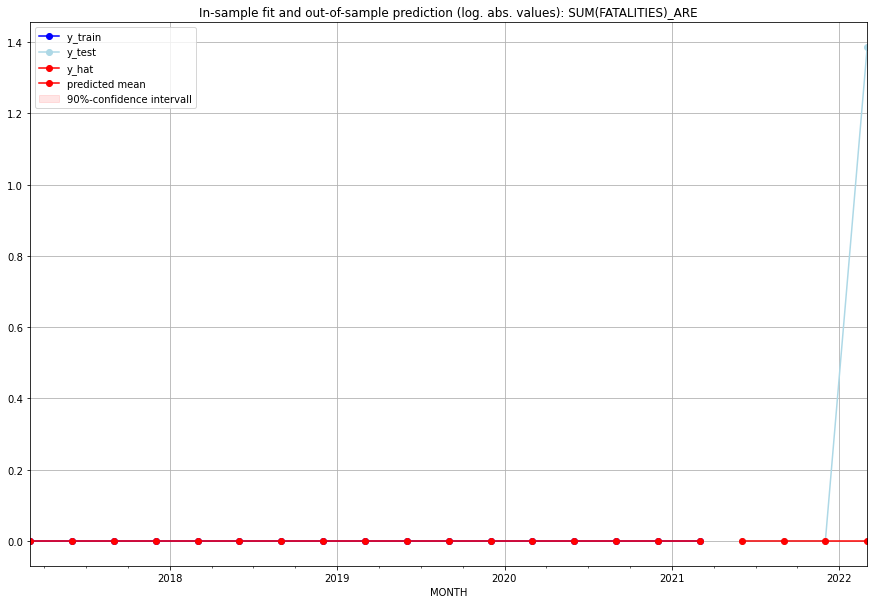

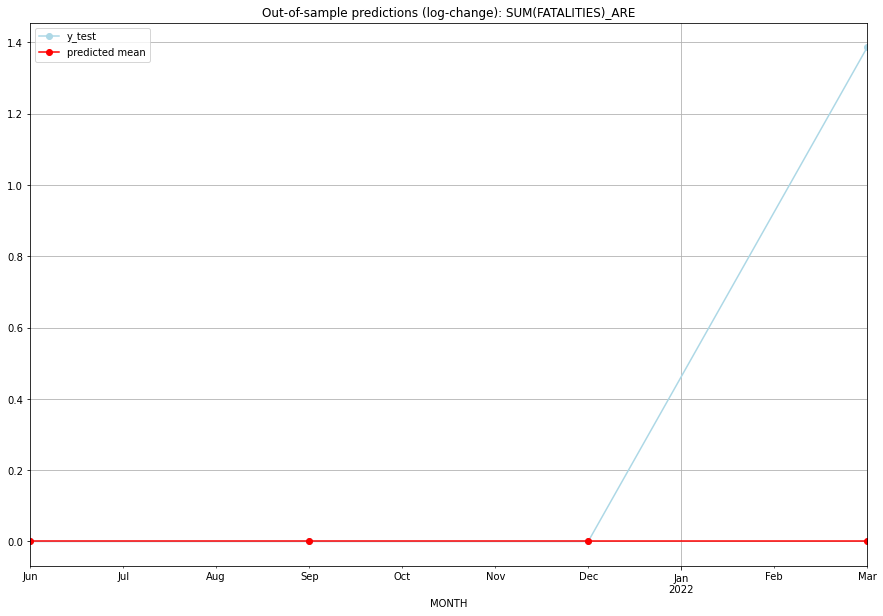

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   ARE   
1 2021-07-01       0.0         0.0           0.0        0.000000   ARE   
2 2021-10-01       0.0         0.0           0.0        0.000000   ARE   
3 2022-01-01       0.0         3.0           0.0        1.386294   ARE   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## ARG (9/234) #########
0
Neighbor countries: ['BOL', 'CHL', 'BRA', 'PRY', 'URY']
Getting Data for ARG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3949183970352586, 'fold_results': [0.3949183970352586, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARG   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -17.717
Date:                 Wed, 19 Oct 2022   AIC                             43.434
Time:                         10:24:33   BIC                             45.694
Sample:                     01-31-2018   HQIC                            42.969
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0326      0.115      0.284 

<Figure size 432x288 with 0 Axes>

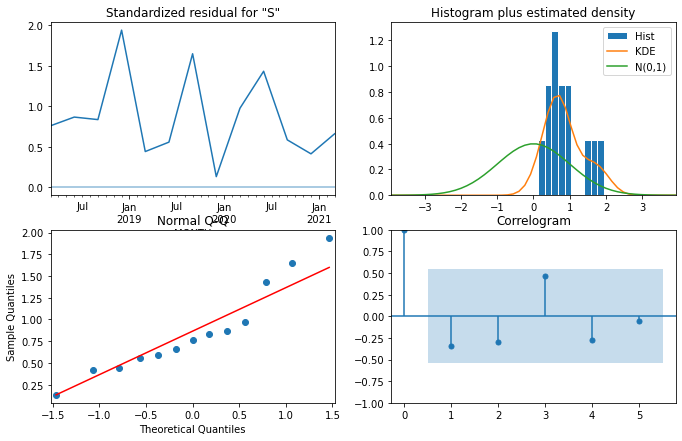

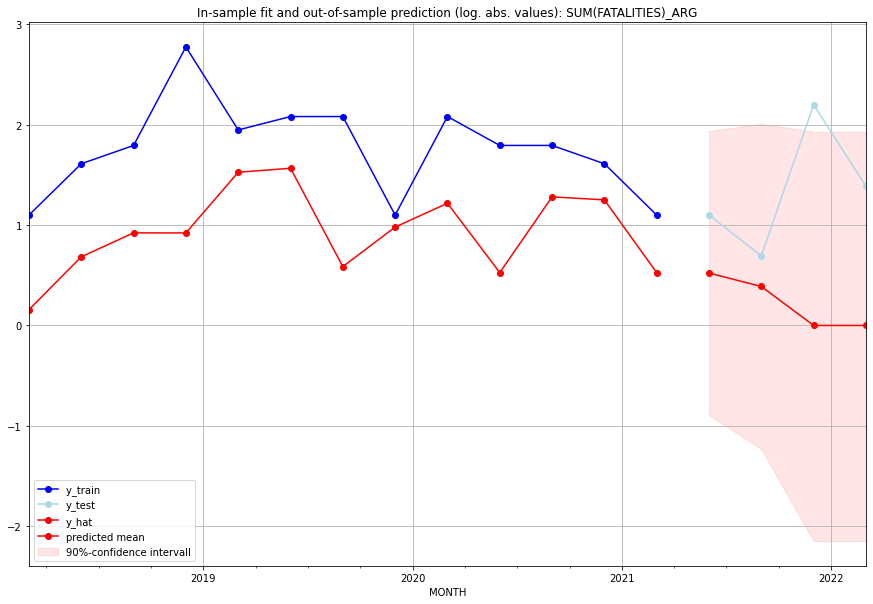

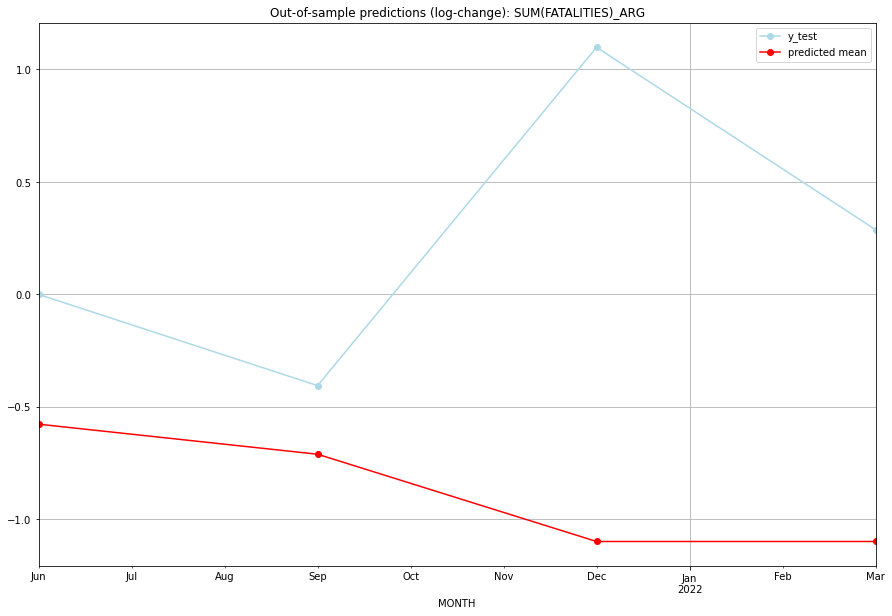

TADDA: 1.6657361169614822
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.684720         2.0     -0.577013        0.000000   ARG   
1 2021-07-01  0.473969         1.0     -0.710653       -0.405465   ARG   
2 2021-10-01  0.000000         8.0     -1.098612        1.098612   ARG   
3 2022-01-01  0.000000         3.0     -1.098612        0.287682   ARG   

                                          PARAMETERS  
0  {'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:04
######## ARM (10/234) #########
0
Neighbor countries: ['AZE', 'GEO', 'TUR', 'IRN']
Getting Data for ARM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 32)
y: (17, 1)
------------------------------------------------
Training started.
Start GR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.34657359027997264, 'fold_results': [0.34657359027997264, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARM   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -17.308
Date:                 Wed, 19 Oct 2022   AIC                             46.616
Time:                         10:24:41   BIC                             50.005
Sample:                     01-31-2018   HQIC                            45.919
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3138      1.669      0.18

<Figure size 432x288 with 0 Axes>

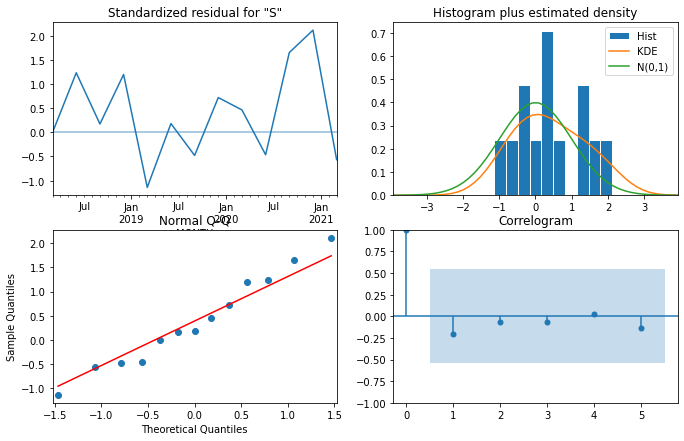

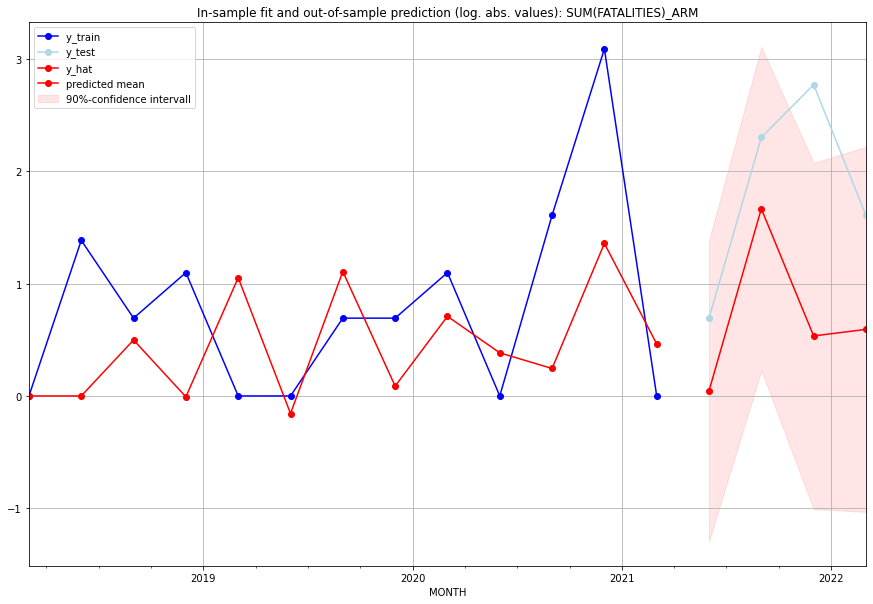

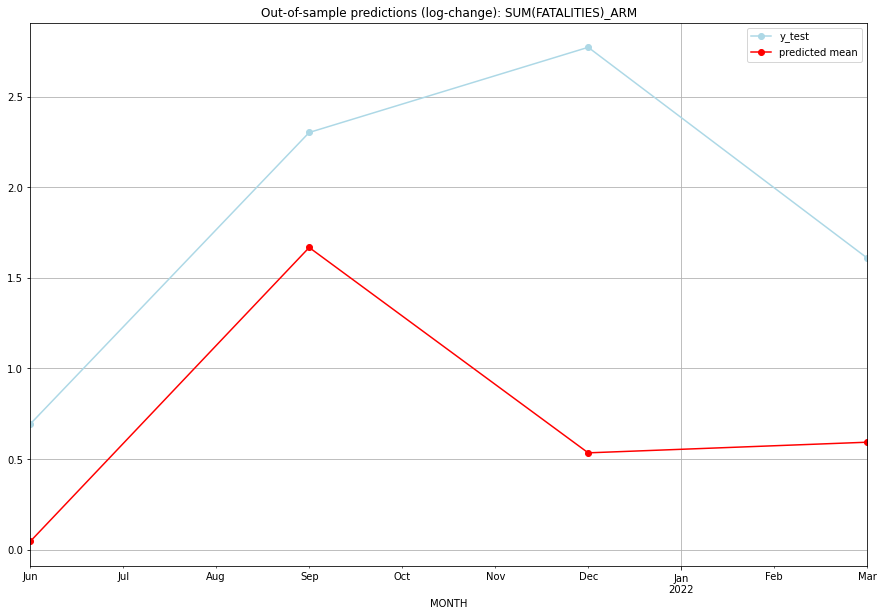

TADDA: 1.1342782796044708
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.046268         1.0      0.045230        0.693147   ARM   
1 2021-07-01  4.300419         9.0      1.667786        2.302585   ARM   
2 2021-10-01  0.706524        15.0      0.534458        2.772589   ARM   
3 2022-01-01  0.809719         4.0      0.593172        1.609438   ARM   

                                          PARAMETERS  
0  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## ASM (11/234) #########
0
Neighbor countries: []
Getting Data for ASM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient dat

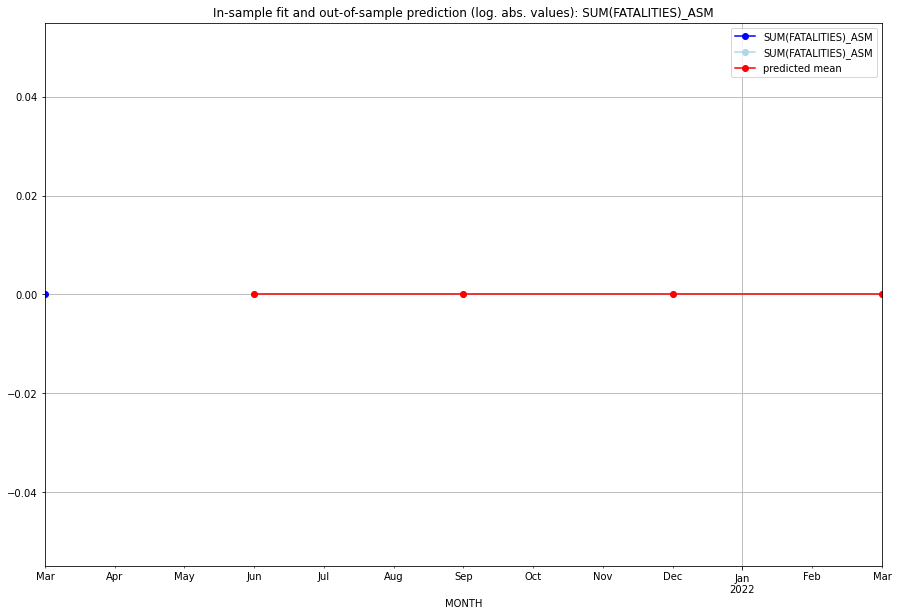

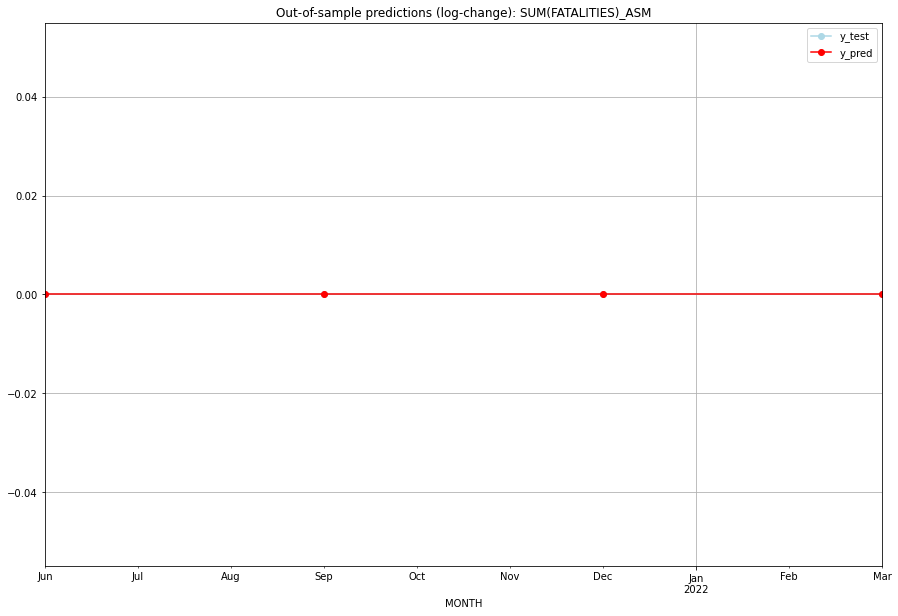

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ASM   
1 2021-07-01       0.0         0.0           0.0             0.0   ASM   
2 2021-10-01       0.0         0.0           0.0             0.0   ASM   
3 2022-01-01       0.0         0.0           0.0             0.0   ASM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:00
######## ATA (12/234) #########
0
Neighbor countries: []
Getting Data for ATA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


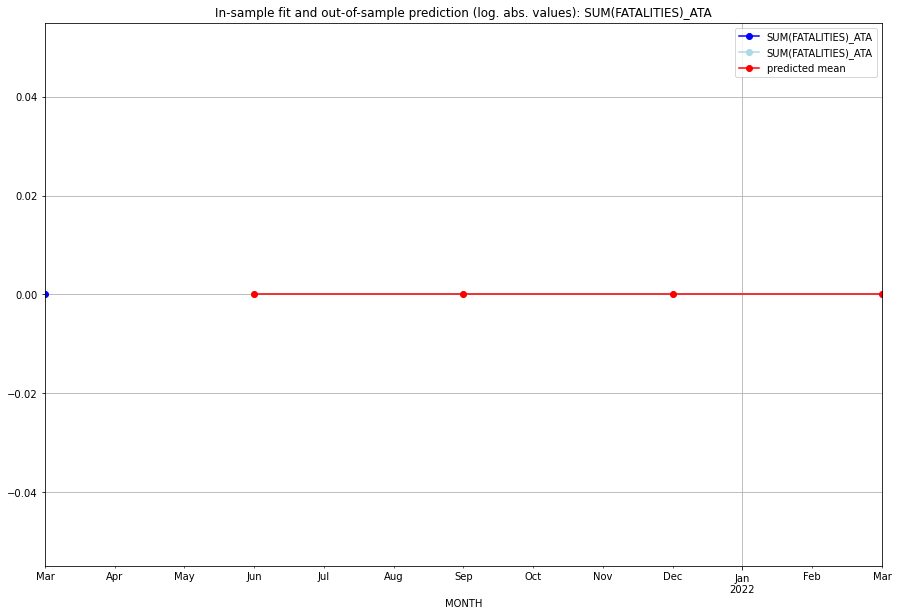

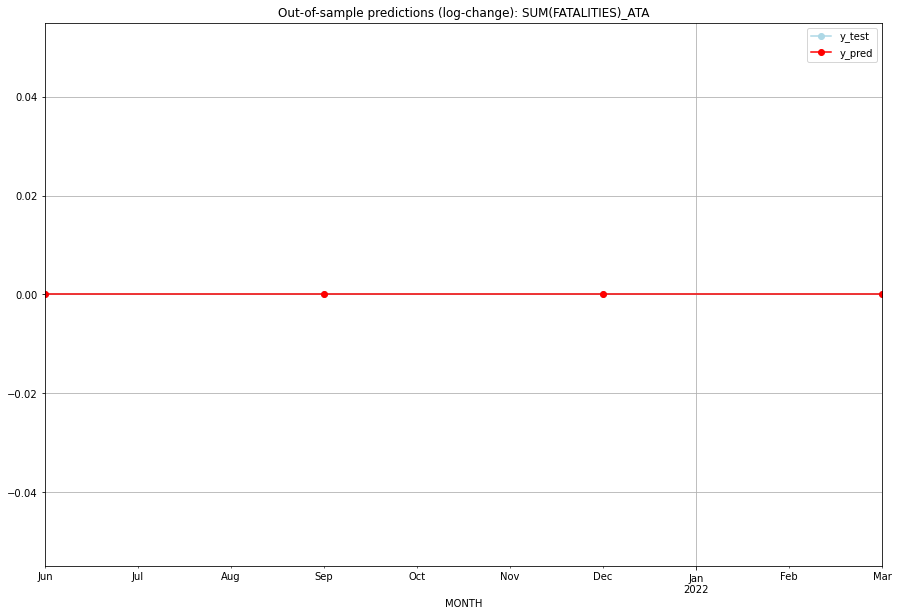

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ATA   
1 2021-07-01       0.0         0.0           0.0             0.0   ATA   
2 2021-10-01       0.0         0.0           0.0             0.0   ATA   
3 2022-01-01       0.0         0.0           0.0             0.0   ATA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## ATG (13/234) #########
0
Neighbor countries: []
Getting Data for ATG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ATG   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                              0.019
Time:                         10:24:50   BIC                              1.714
Sample:                     01-31-2018   HQIC                            -0.330
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1      -6.757e-07   1.14e+05  -5.93e-12      1.000   -2.23e+05    2.23

<Figure size 432x288 with 0 Axes>

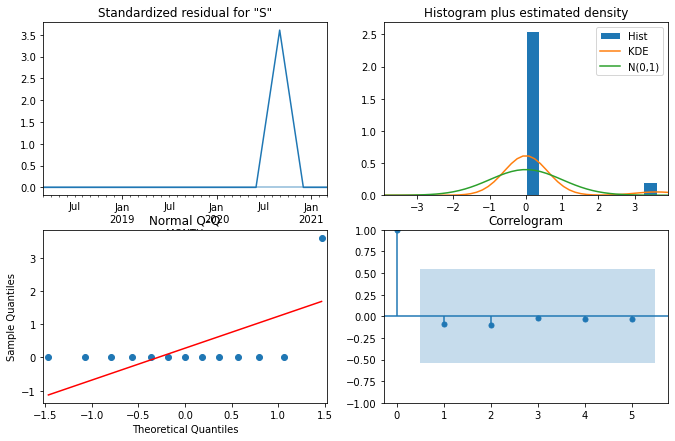

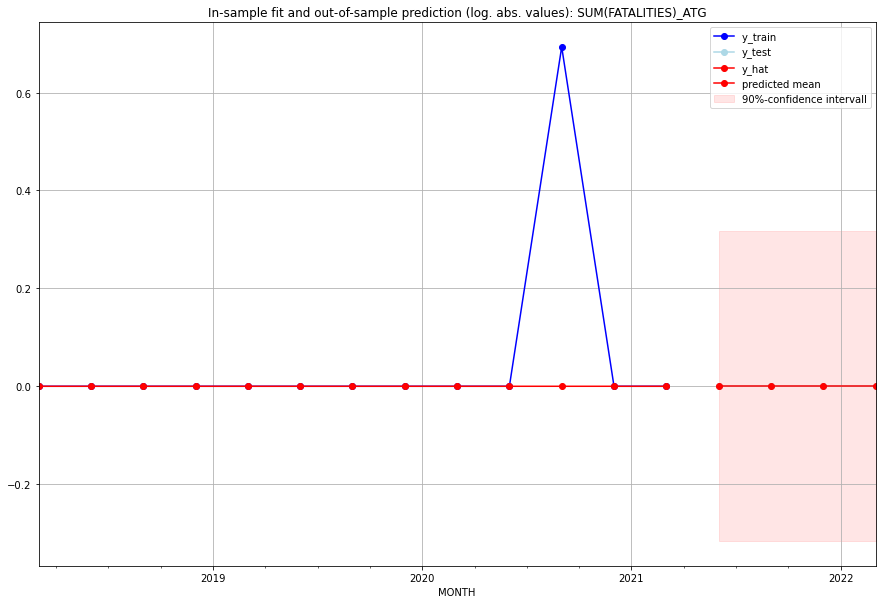

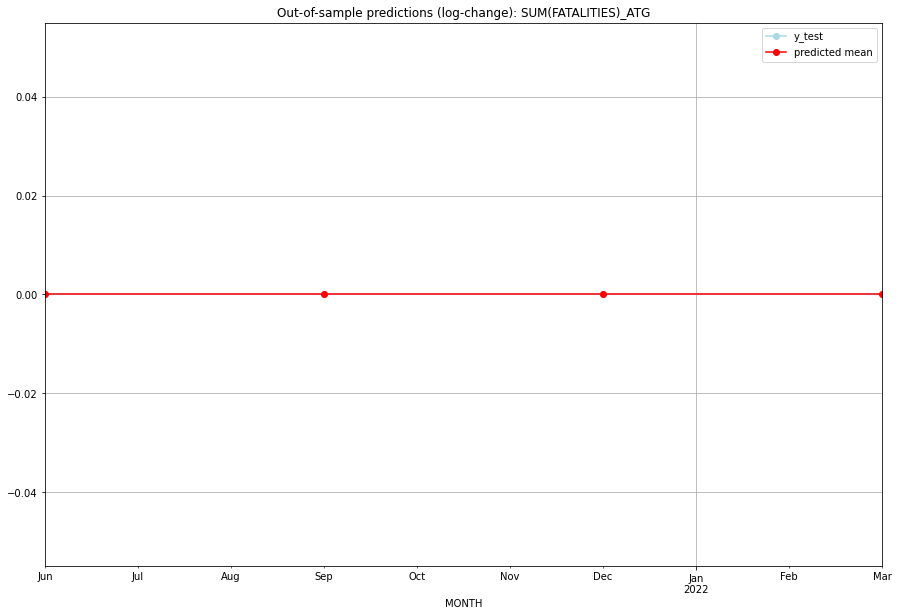

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ATG   
1 2021-07-01       0.0         0.0           0.0             0.0   ATG   
2 2021-10-01       0.0         0.0           0.0             0.0   ATG   
3 2022-01-01       0.0         0.0           0.0             0.0   ATG   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## AUS (14/234) #########
0
Neighbor countries: ['PNG']
Getting Data for AUS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 8)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cros

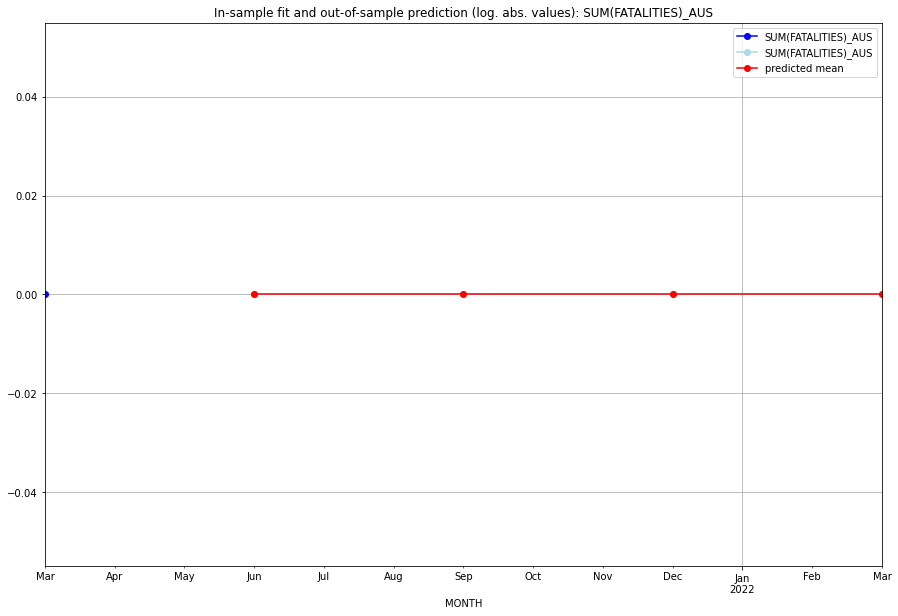

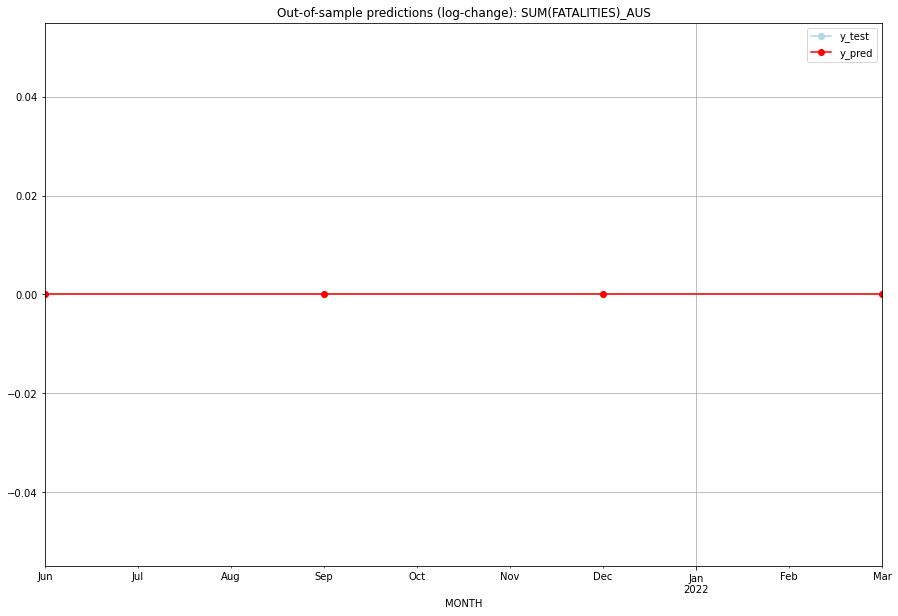

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AUS   
1 2021-07-01       0.0         0.0           0.0             0.0   AUS   
2 2021-10-01       0.0         0.0           0.0             0.0   AUS   
3 2022-01-01       0.0         0.0           0.0             0.0   AUS   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## AUT (15/234) #########
0
Neighbor countries: ['HUN', 'SVK', 'SVN', 'ITA', 'CZE', 'DEU', 'CHE', 'LIE']
Getting Data for AUT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


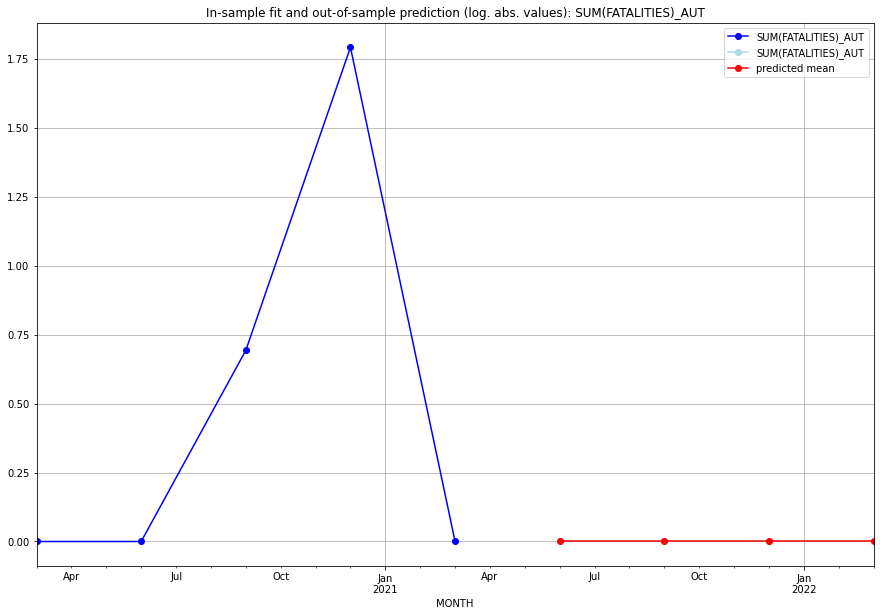

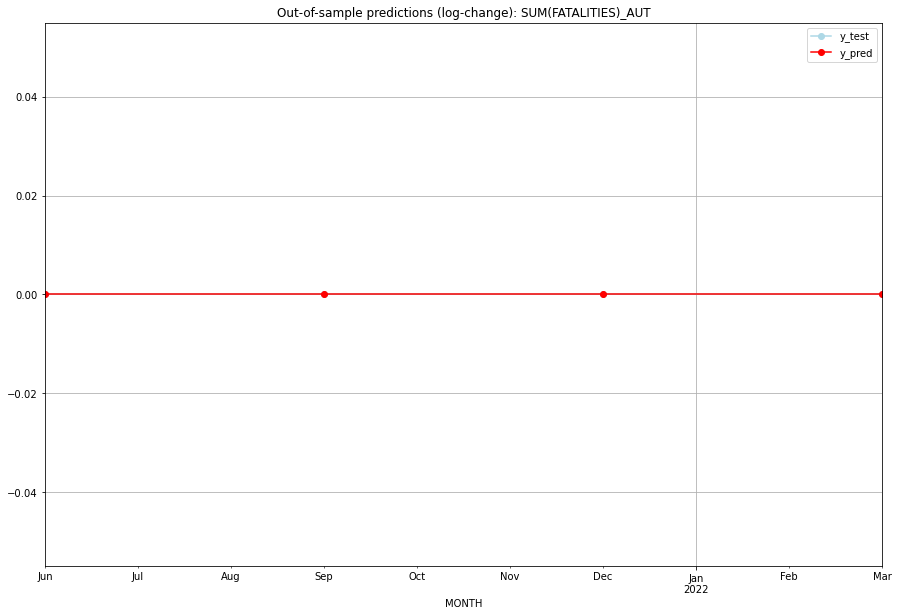

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AUT   
1 2021-07-01       0.0         0.0           0.0             0.0   AUT   
2 2021-10-01       0.0         0.0           0.0             0.0   AUT   
3 2022-01-01       0.0         0.0           0.0             0.0   AUT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## AZE (16/234) #########
0
Neighbor countries: ['IRN', 'ARM', 'GEO', 'TUR', 'RUS']
Getting Data for AZE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3233030675242955, 'fold_results': [0.3233030675242955, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AZE   No. Observations:                   13
Model:                SARIMAX(1, 0, 2)   Log Likelihood                 -26.849
Date:                 Wed, 19 Oct 2022   AIC                             63.699
Time:                         10:25:00   BIC                             66.523
Sample:                     01-31-2018   HQIC                            63.118
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0753      0.262      0.288 

<Figure size 432x288 with 0 Axes>

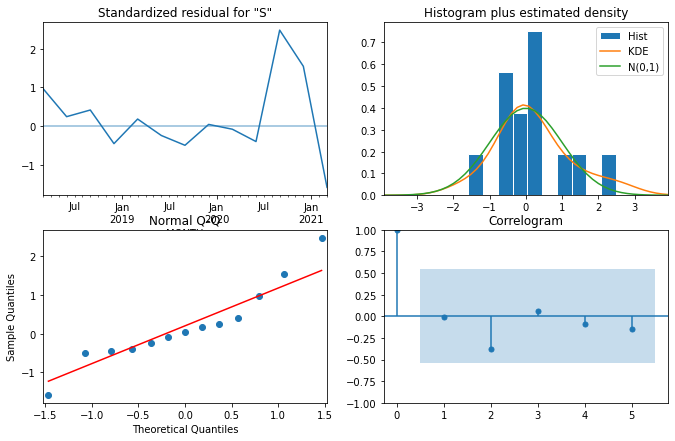

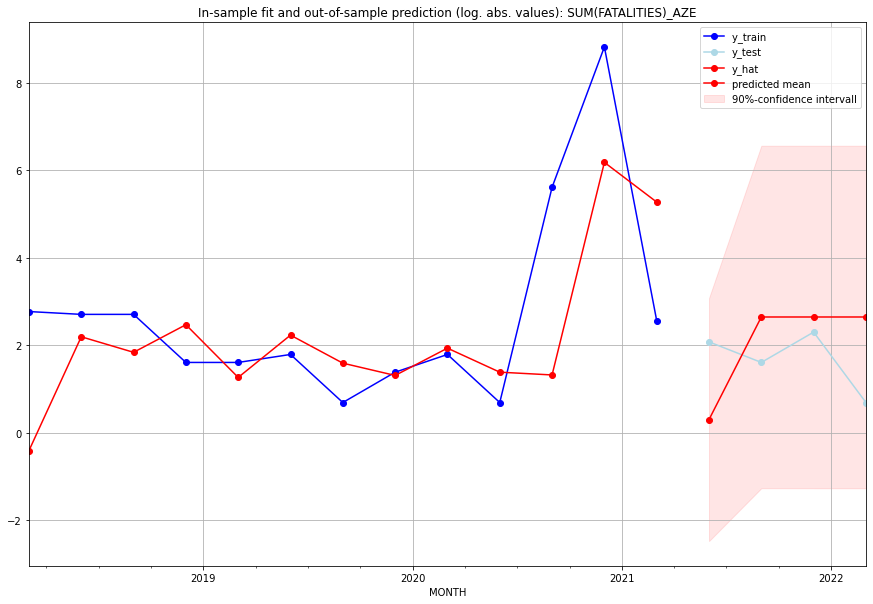

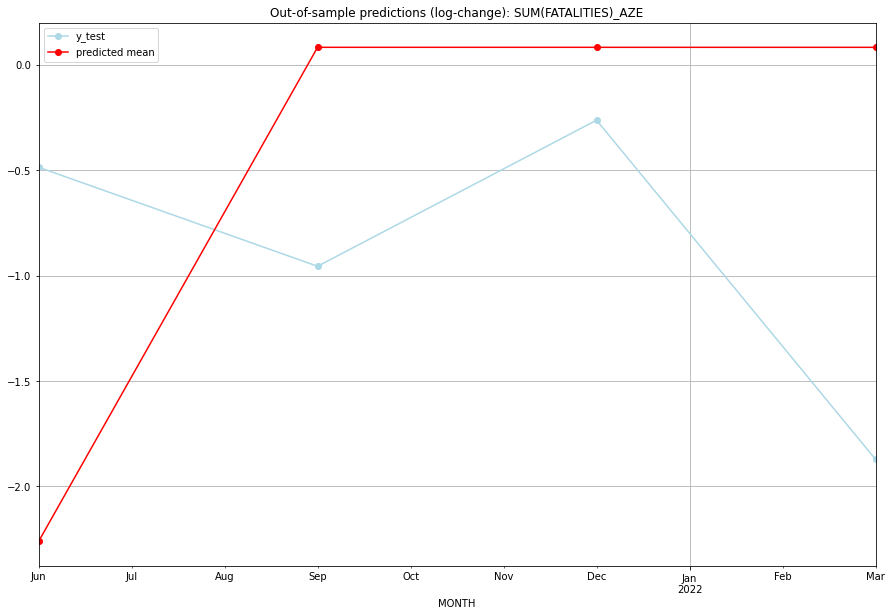

TADDA: 1.3413853105593665
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   0.354866         7.0     -2.261246       -0.485508   AZE   
1 2021-07-01  13.130468         4.0      0.083384       -0.955511   AZE   
2 2021-10-01  13.130046         9.0      0.083354       -0.262364   AZE   
3 2022-01-01  13.129625         1.0      0.083324       -1.871802   AZE   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## BDI (17/234) #########
0
Neighbor countries: ['RWA', 'COD', 'TZA']
Getting Data for BDI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.39627016317698827, 'fold_results': [0.6714232831853802, 0.3228438953486178, 0.31085488499521285, 0.18487801581927688, 0.49135073653645356]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BDI   No. Observations:                   96
Model:                SARIMAX(2, 0, 3)   Log Likelihood                -133.303
Date:                 Wed, 19 Oct 2022   AIC                            278.607
Time:                         10:25:12   BIC                            293.993
Sample:                     04-30-1997   HQIC                           284.826
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------

<Figure size 432x288 with 0 Axes>

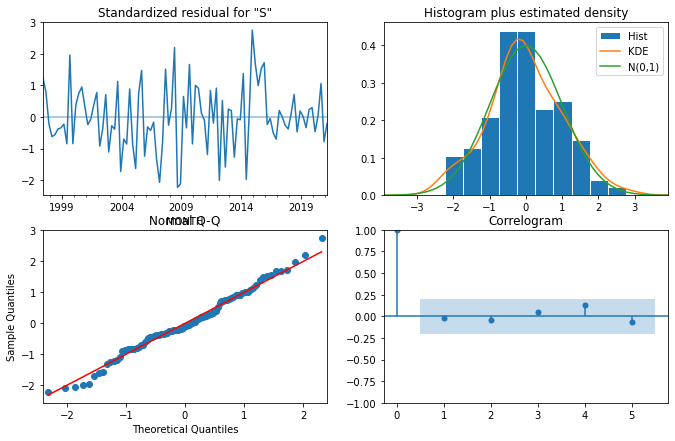

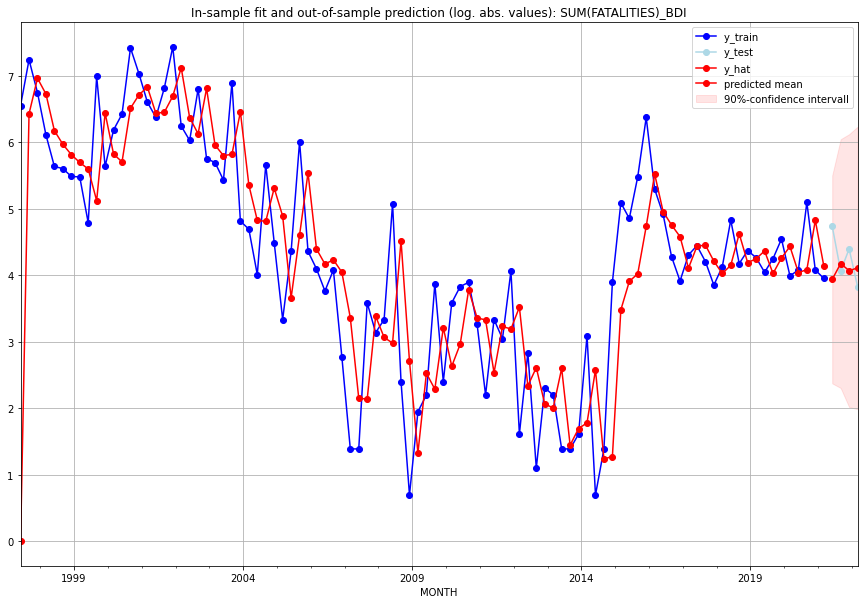

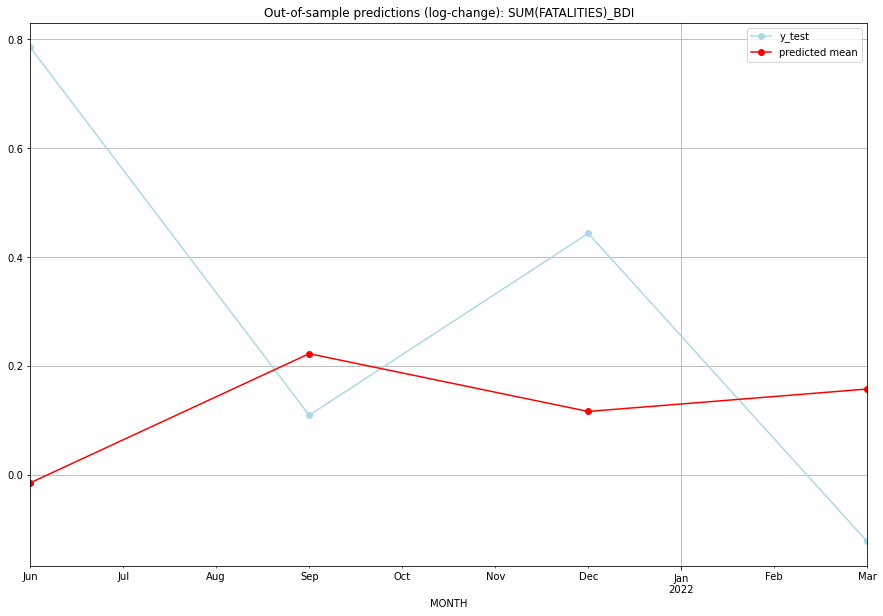

TADDA: 0.4231026878378721
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  50.227767       113.0     -0.014962        0.784955   BDI   
1 2021-07-01  63.946811        57.0      0.222325        0.109199   BDI   
2 2021-10-01  57.406951        80.0      0.116191        0.443205   BDI   
3 2022-01-01  59.863803        45.0      0.157395       -0.122602   BDI   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## BEL (18/234) #########
0
Neighbor countries: ['FRA', 'NLD', 'DEU', 'LUX']
Getting Data for BEL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 32)
y: (9, 1)
------------------------------------------------
Training started.
GridS

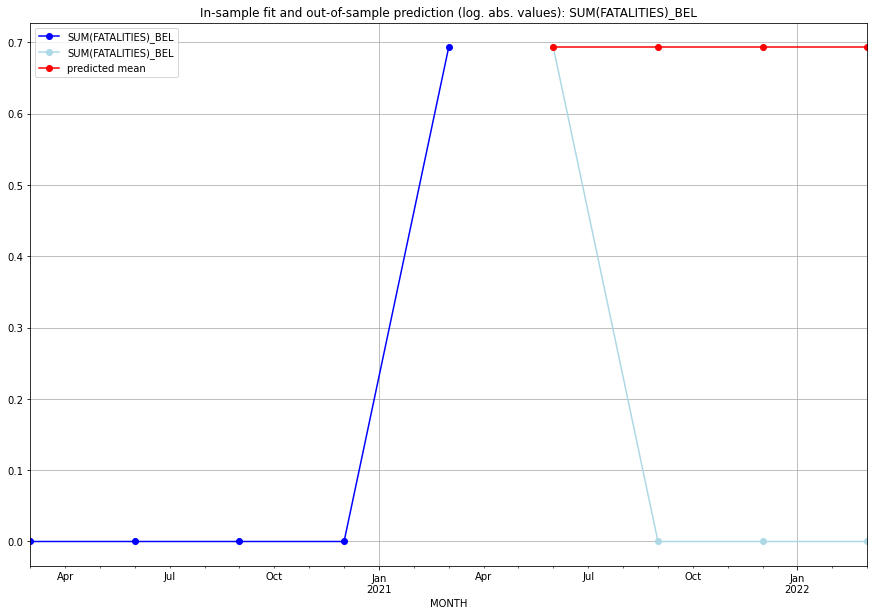

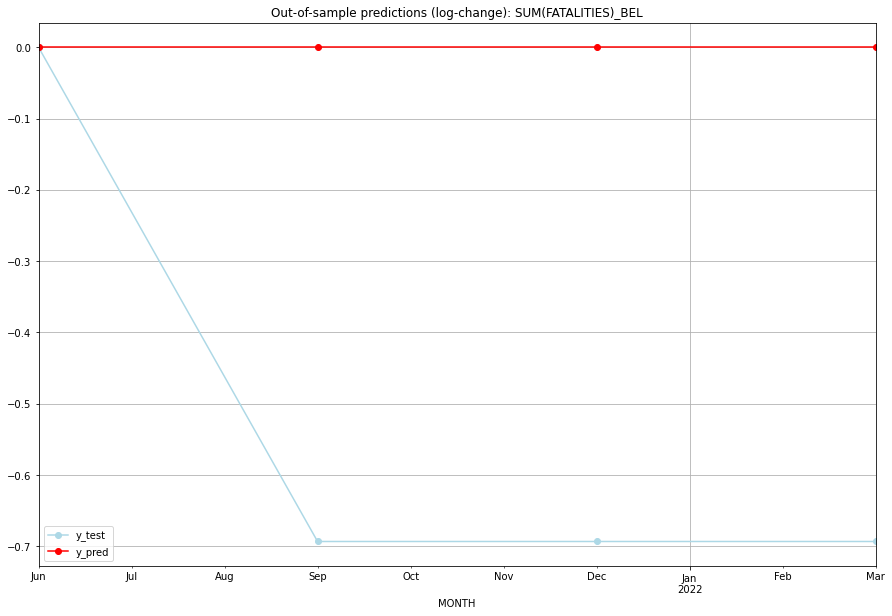

TADDA: 0.5198603854199589
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.693147    0.693147           0.0        0.000000   BEL   
1 2021-07-01  0.693147    0.000000           0.0       -0.693147   BEL   
2 2021-10-01  0.693147    0.000000           0.0       -0.693147   BEL   
3 2022-01-01  0.693147    0.000000           0.0       -0.693147   BEL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## BEN (19/234) #########
0
Neighbor countries: ['NGA', 'TGO', 'BFA', 'NER']
Getting Data for BEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 32)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9616633954201884, 'fold_results': [1.4009848792202364, 1.1530638559050599, 1.0893366569286995, 0.6704330627589064, 0.4944985222880399]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BEN   No. Observations:                   96
Model:                SARIMAX(3, 1, 0)   Log Likelihood                 -76.914
Date:                 Wed, 19 Oct 2022   AIC                            161.827
Time:                         10:25:34   BIC                            172.043
Sample:                     04-30-1997   HQIC                           165.955
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

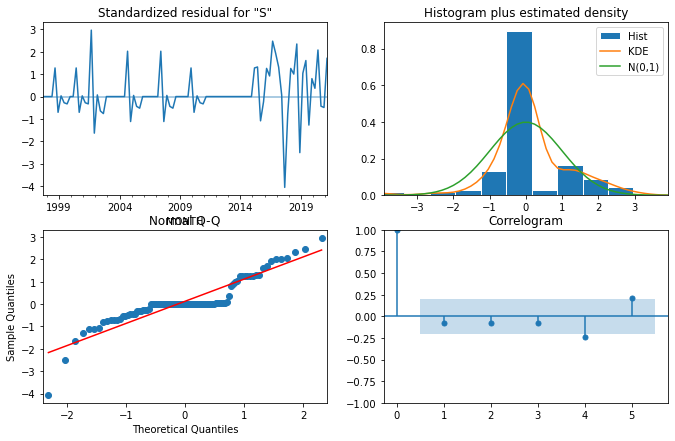

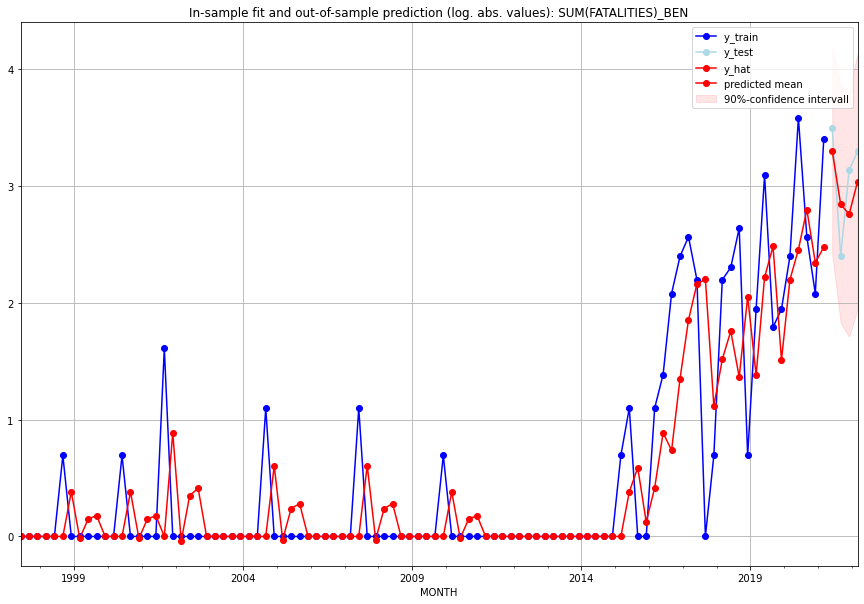

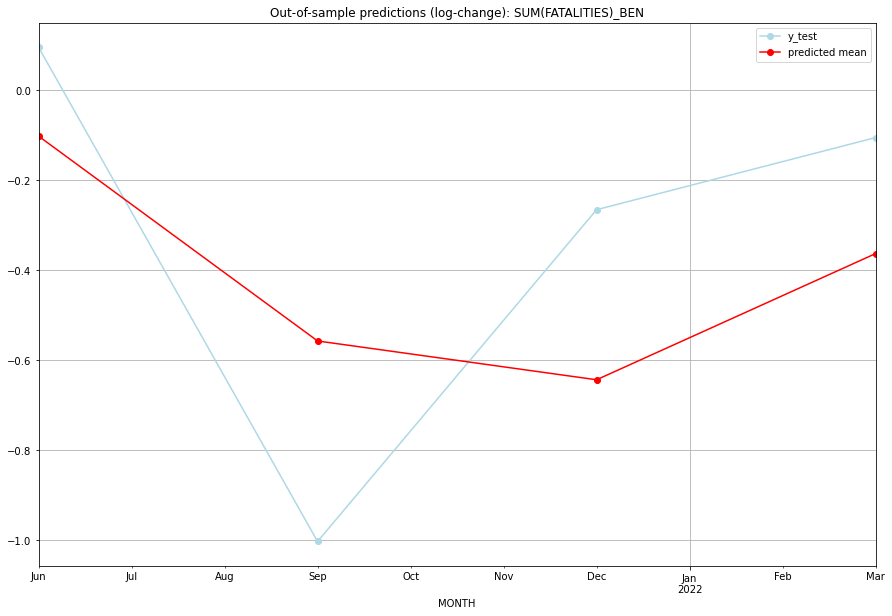

TADDA: 0.3453399103984546
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  26.086887        32.0     -0.102148        0.095310   BEN   
1 2021-07-01  16.178726        10.0     -0.557526       -1.003302   BEN   
2 2021-10-01  14.759416        22.0     -0.643759       -0.265703   BEN   
3 2022-01-01  19.861709        26.0     -0.363282       -0.105361   BEN   

                                          PARAMETERS  
0  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## BES (20/234) #########
0
Neighbor countries: []
Getting Data for BES
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV

<Figure size 432x288 with 0 Axes>

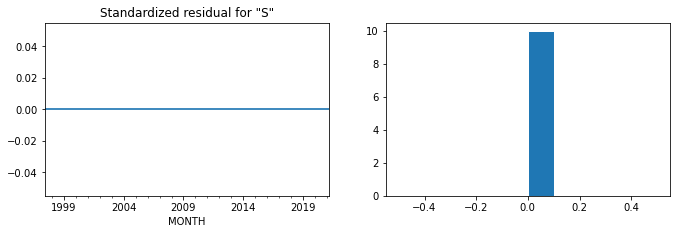

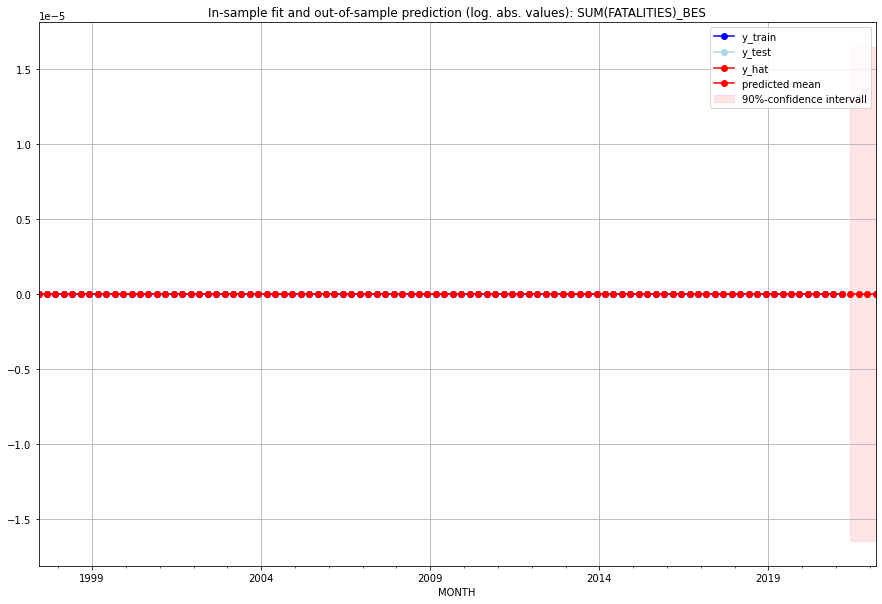

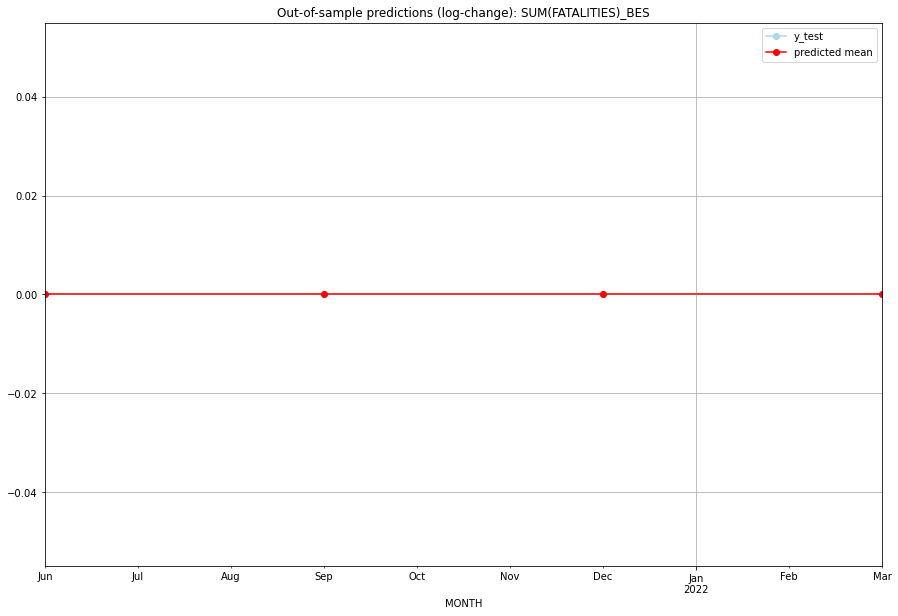

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BES   
1 2021-07-01       0.0         0.0           0.0             0.0   BES   
2 2021-10-01       0.0         0.0           0.0             0.0   BES   
3 2022-01-01       0.0         0.0           0.0             0.0   BES   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## BFA (21/234) #########
0
Neighbor countries: ['MLI', 'NER', 'CIV', 'GHA', 'TGO', 'BEN']
Getting Data for BFA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 48)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.769799329309247, 'fold_results': [0.9241653986389977, 0.37982170385995473, 0.8736529565753944, 1.150165690648968, 0.5211908968229197]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BFA   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -154.528
Date:                 Wed, 19 Oct 2022   AIC                            315.055
Time:                         10:25:55   BIC                            322.717
Sample:                     04-30-1997   HQIC                           318.151
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

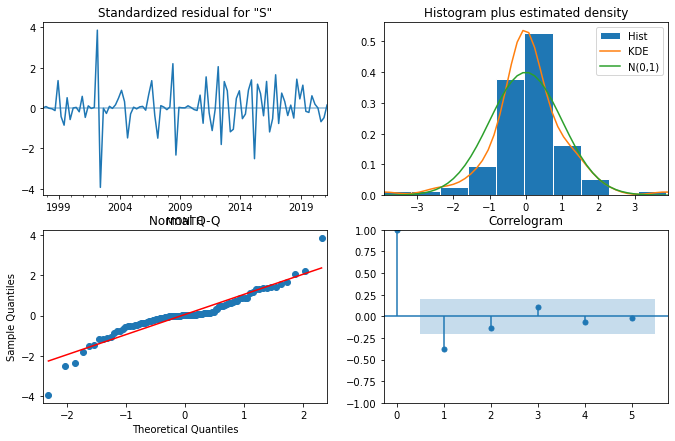

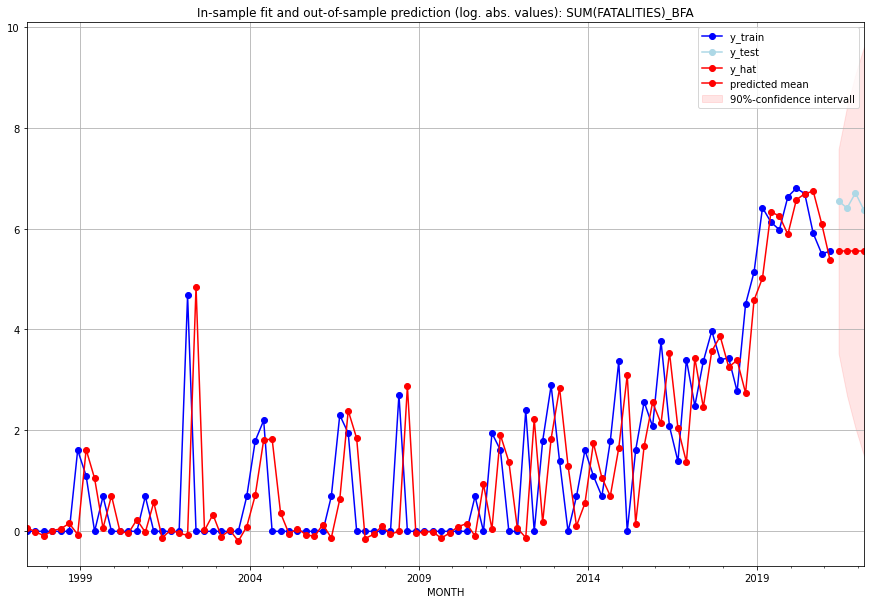

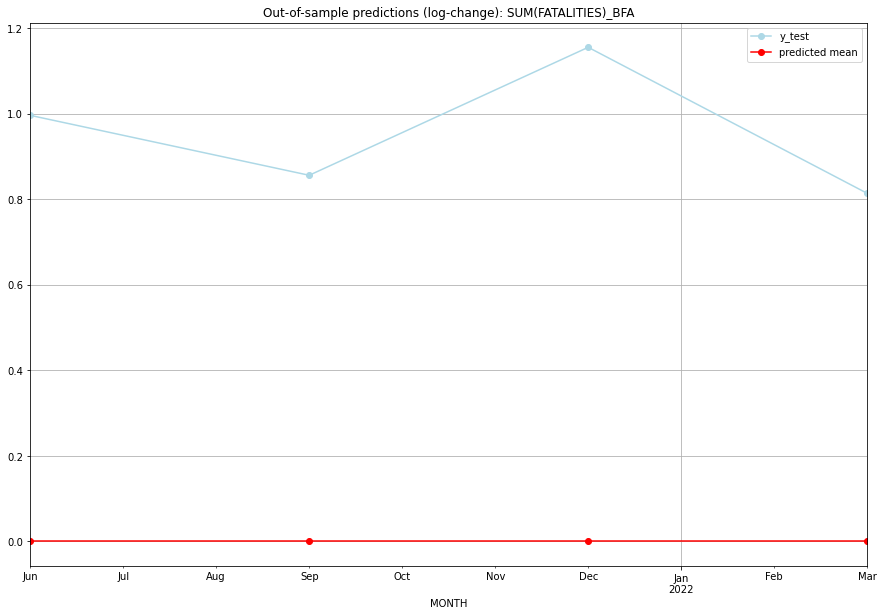

TADDA: 0.9554290593222365
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     256.0       695.0  1.776357e-15        0.996274   BFA   
1 2021-07-01     256.0       604.0  1.776357e-15        0.856152   BFA   
2 2021-10-01     256.0       815.0  1.776357e-15        1.155338   BFA   
3 2022-01-01     256.0       579.0  1.776357e-15        0.813952   BFA   

                                          PARAMETERS  
0  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## BGD (22/234) #########
0
Neighbor countries: ['IND', 'MMR']
Getting Data for BGD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 16)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.39103906825366935, 'fold_results': [0.3521427663663306, 0.6619810120640777, 0.6954502168751864, 0.1798782833526349, 0.0657430626101172]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BGD   No. Observations:                   45
Model:                SARIMAX(2, 0, 2)   Log Likelihood                 -30.498
Date:                 Wed, 19 Oct 2022   AIC                             76.995
Time:                         10:26:10   BIC                             91.449
Sample:                     01-31-2010   HQIC                            82.384
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

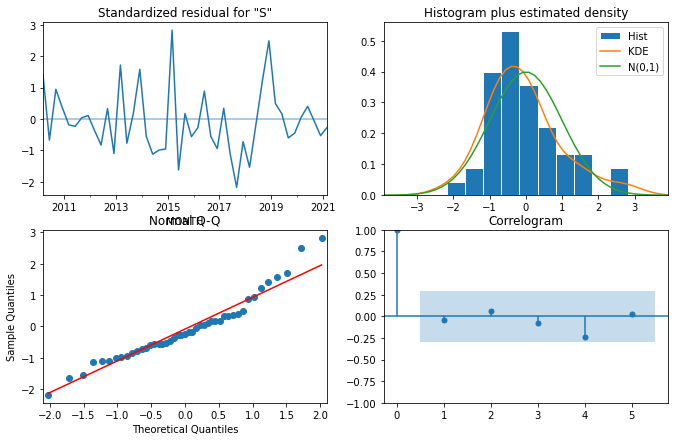

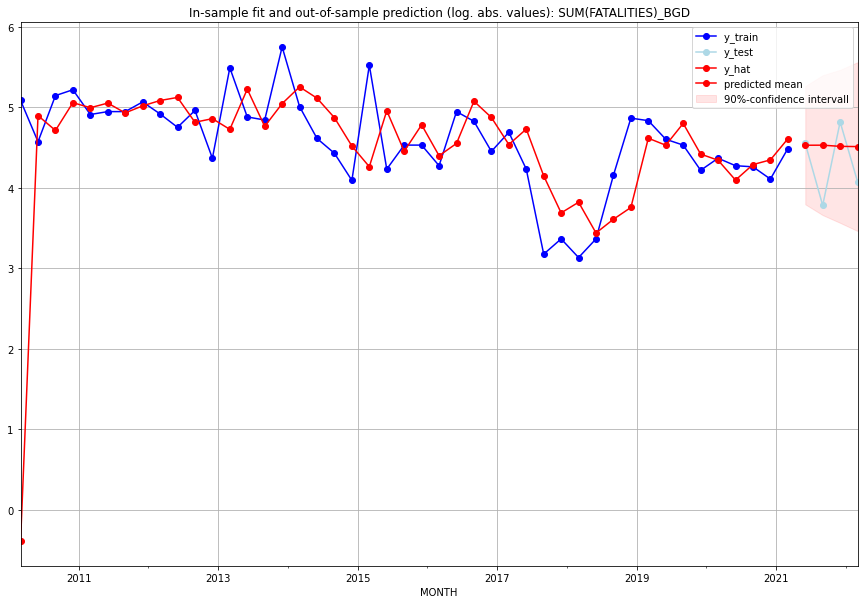

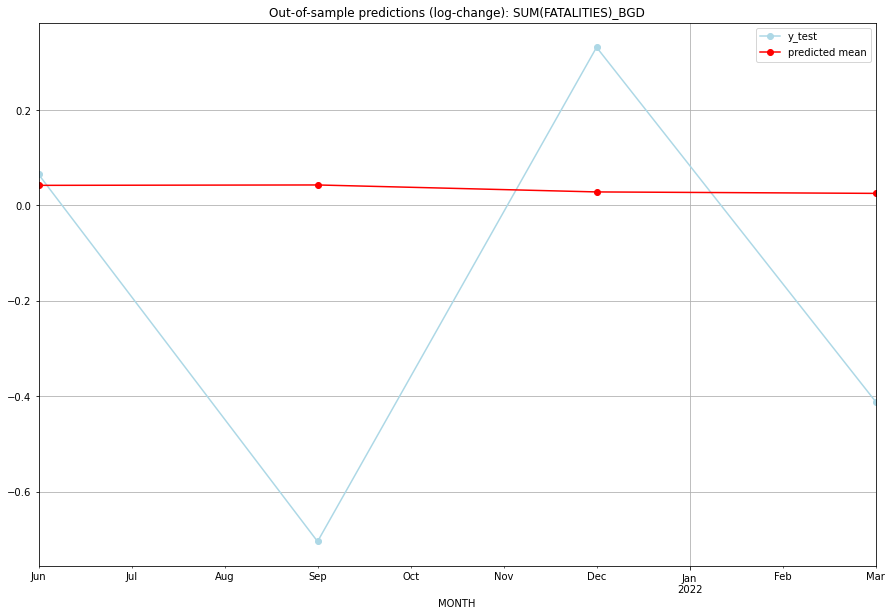

TADDA: 0.3946652064288204
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  91.838687        94.0      0.042227        0.065241   BGD   
1 2021-07-01  91.915146        43.0      0.043050       -0.704447   BGD   
2 2021-10-01  90.568040       123.0      0.028446        0.331645   BGD   
3 2022-01-01  90.289639        58.0      0.025401       -0.411099   BGD   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## BGR (23/234) #########
0
Neighbor countries: ['ROU', 'SRB', 'GRC', 'MKD', 'TUR']
Getting Data for BGR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training start

<Figure size 432x288 with 0 Axes>

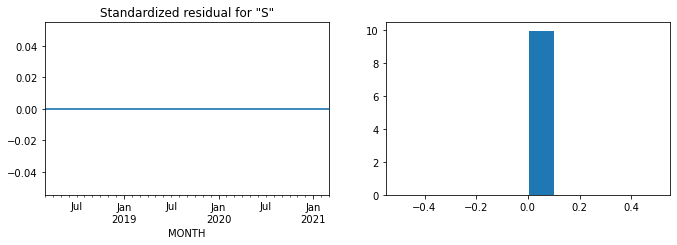

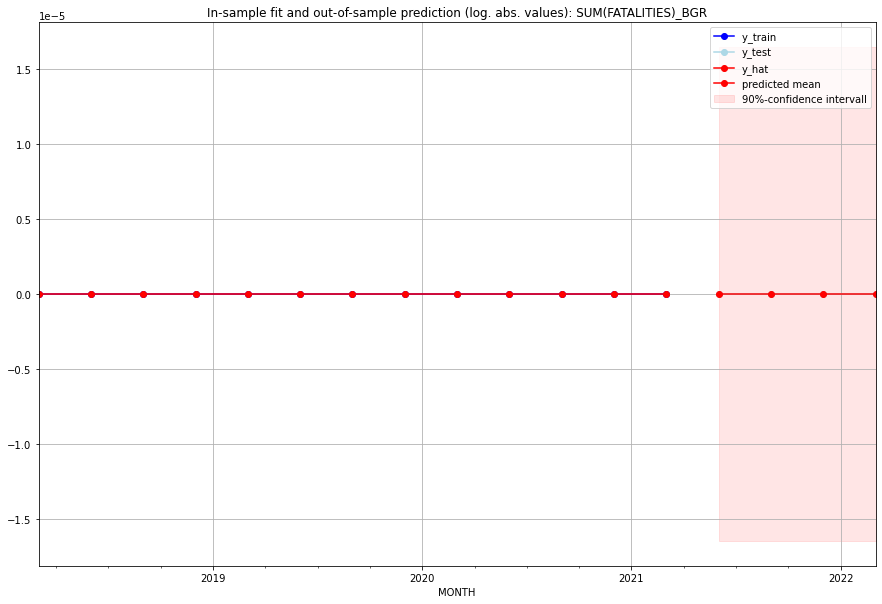

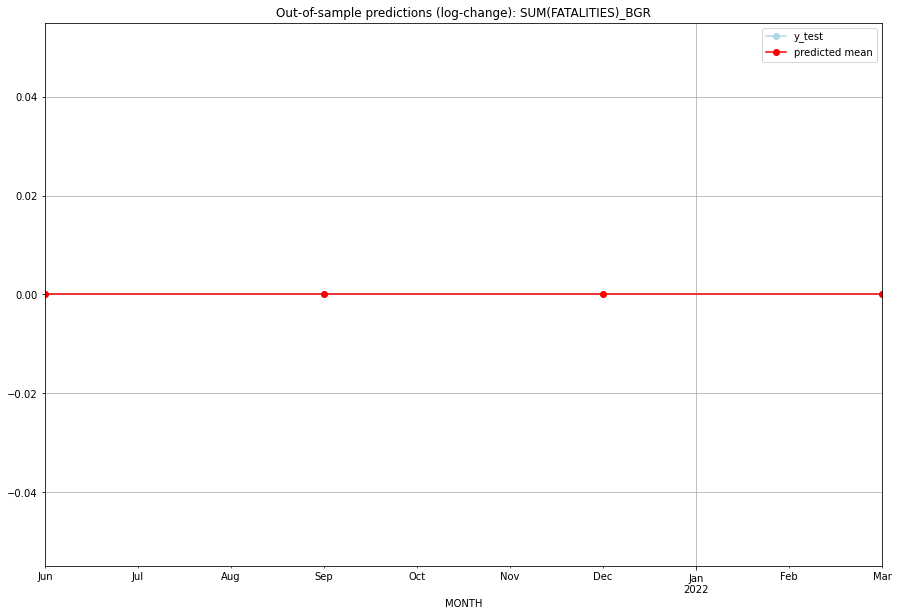

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BGR   
1 2021-07-01       0.0         0.0           0.0             0.0   BGR   
2 2021-10-01       0.0         0.0           0.0             0.0   BGR   
3 2022-01-01       0.0         0.0           0.0             0.0   BGR   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:06
######## BHR (24/234) #########
0
Neighbor countries: ['SAU']
Getting Data for BHR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 8)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.34558931796946396, 'fold_results': [1.2090704767378695, 0.0, 0.17328679513998632, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BHR   No. Observations:                   21
Model:                         SARIMAX   Log Likelihood                 -24.066
Date:                 Wed, 19 Oct 2022   AIC                             50.131
Time:                         10:26:31   BIC                             51.176
Sample:                     01-31-2016   HQIC                            50.358
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.

<Figure size 432x288 with 0 Axes>

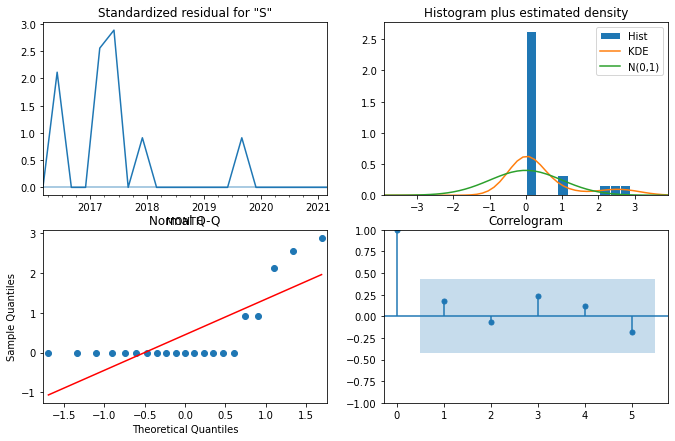

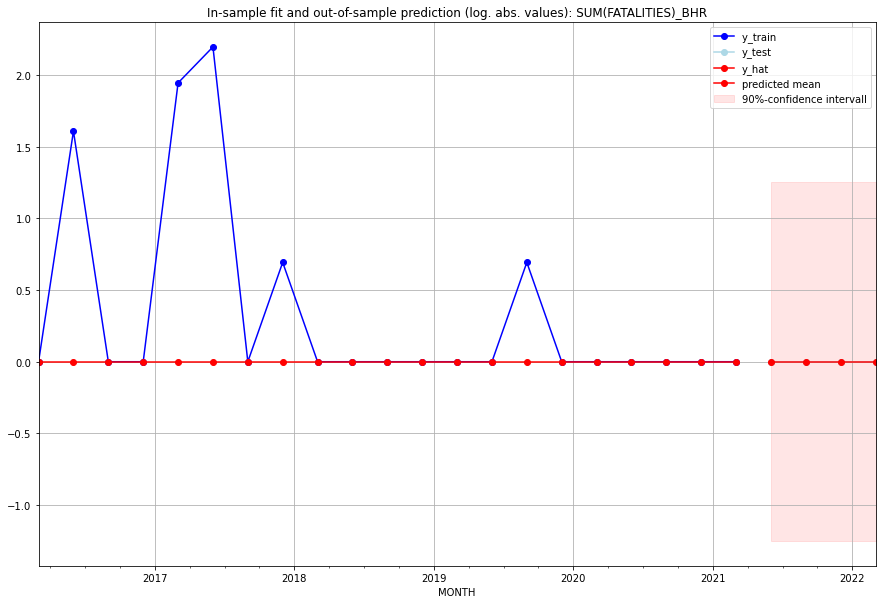

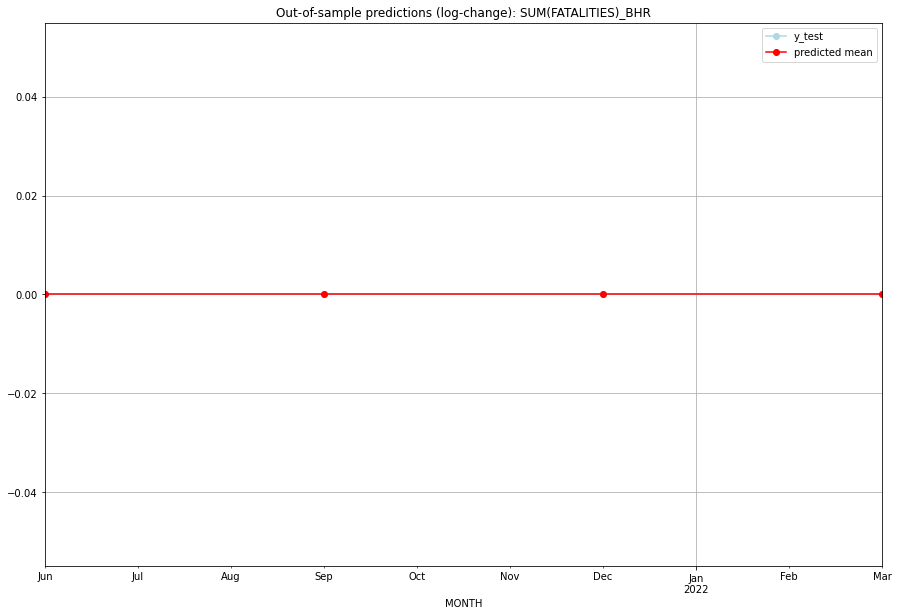

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BHR   
1 2021-07-01       0.0         0.0           0.0             0.0   BHR   
2 2021-10-01       0.0         0.0           0.0             0.0   BHR   
3 2022-01-01       0.0         0.0           0.0             0.0   BHR   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## BHS (25/234) #########
0
Neighbor countries: []
Getting Data for BHS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BHS   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -6.138
Date:                 Wed, 19 Oct 2022   AIC                             18.277
Time:                         10:26:35   BIC                             19.972
Sample:                     01-31-2018   HQIC                            17.929
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.4703      0.314      1.499      0.134      -0.144       1

<Figure size 432x288 with 0 Axes>

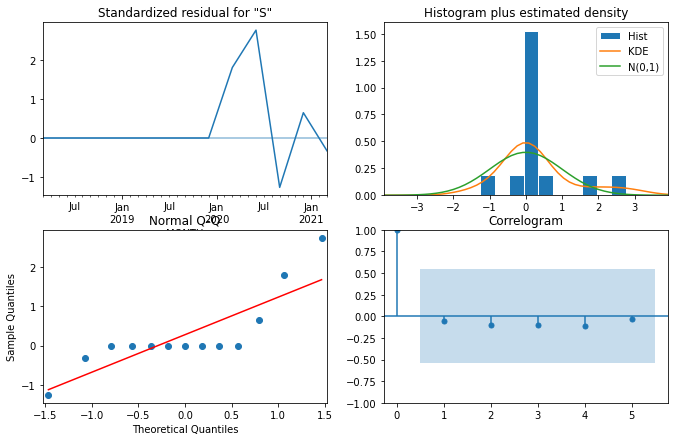

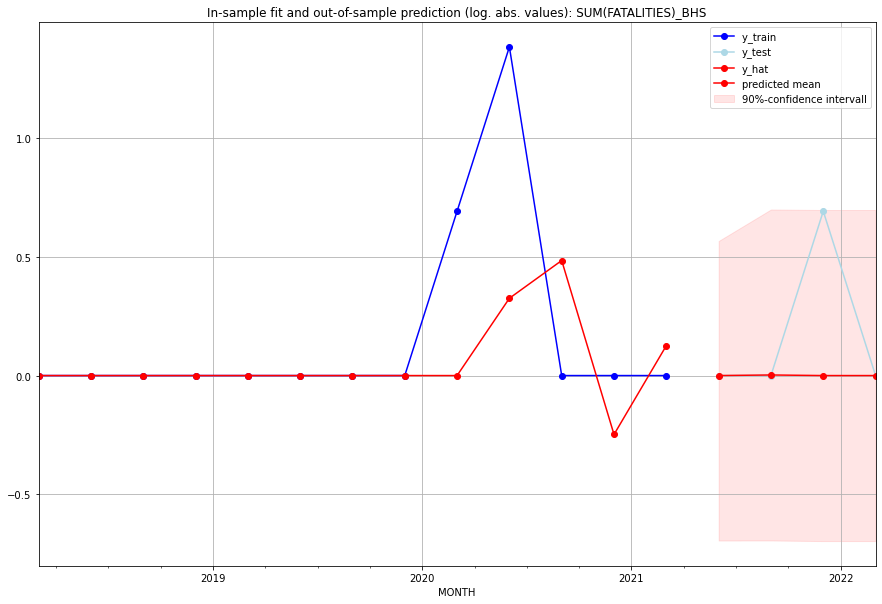

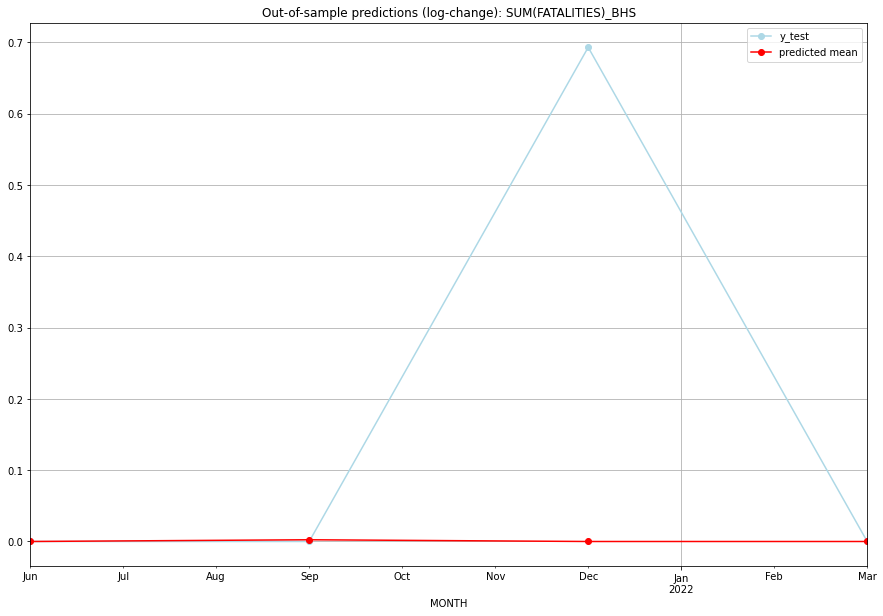

TADDA: 0.17389465902325324
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.000000         0.0      0.000000        0.000000   BHS   
1 2021-07-01  0.002434         0.0      0.002431        0.000000   BHS   
2 2021-10-01  0.000000         1.0      0.000000        0.693147   BHS   
3 2022-01-01  0.000000         0.0      0.000000        0.000000   BHS   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## BIH (26/234) #########
0
Neighbor countries: ['HRV', 'MNE', 'SRB']
Getting Data for BIH
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEAR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 7.747845836802057e-06, 'fold_results': [1.4992885990382752e-05, 5.028056832213625e-07]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BIH   No. Observations:                   13
Model:                SARIMAX(3, 1, 1)   Log Likelihood                   0.678
Date:                 Wed, 19 Oct 2022   AIC                              8.644
Time:                         10:26:54   BIC                             11.068
Sample:                     01-31-2018   HQIC                             7.746
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.76

<Figure size 432x288 with 0 Axes>

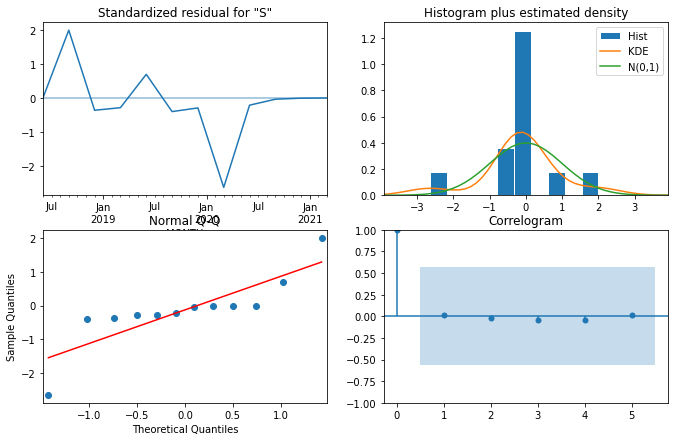

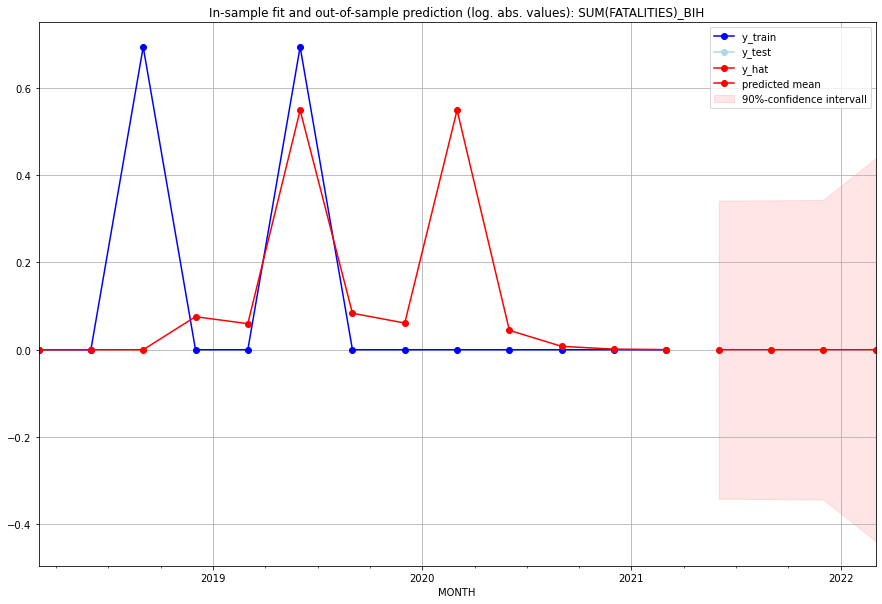

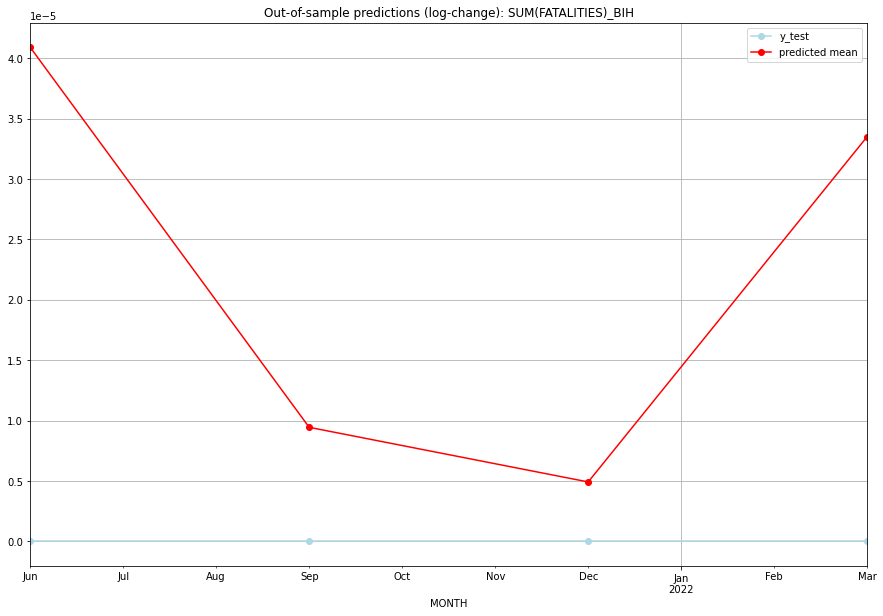

TADDA: 2.2199771436197002e-05
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.000041         0.0      0.000041             0.0   BIH   
1 2021-07-01  0.000009         0.0      0.000009             0.0   BIH   
2 2021-10-01  0.000005         0.0      0.000005             0.0   BIH   
3 2022-01-01  0.000034         0.0      0.000034             0.0   BIH   

                                          PARAMETERS  
0  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## BLM (27/234) #########
0
Neighbor countries: []
Getting Data for BLM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV 

<Figure size 432x288 with 0 Axes>

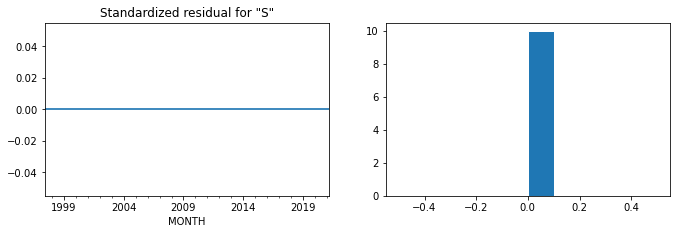

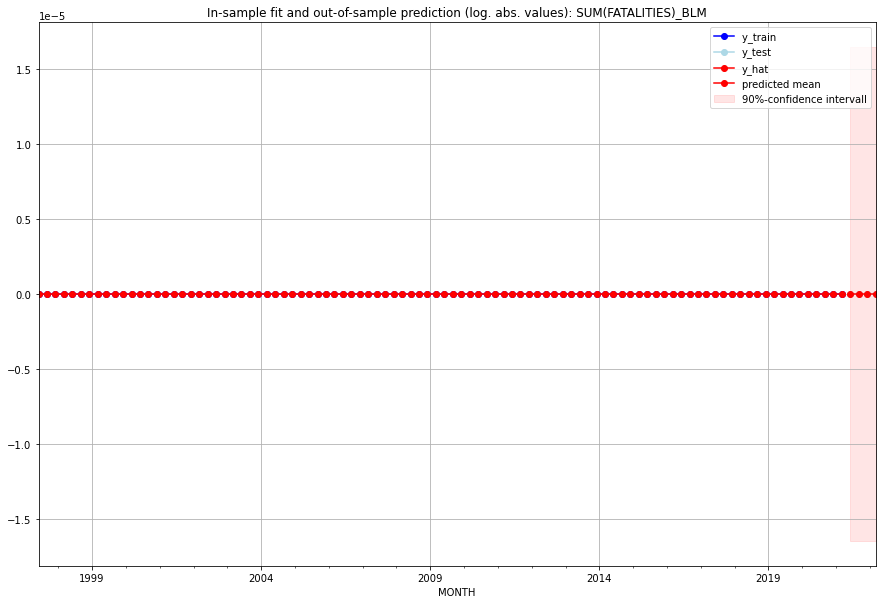

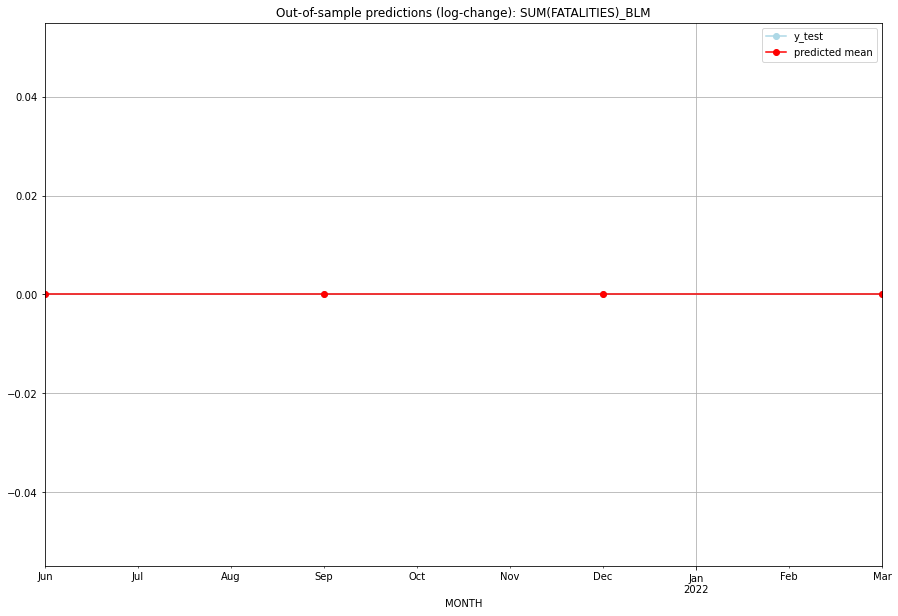

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BLM   
1 2021-07-01       0.0         0.0           0.0             0.0   BLM   
2 2021-10-01       0.0         0.0           0.0             0.0   BLM   
3 2022-01-01       0.0         0.0           0.0             0.0   BLM   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## BLR (28/234) #########
0
Neighbor countries: ['POL', 'UKR', 'RUS', 'LTU', 'LVA']
Getting Data for BLR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BLR   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -9.430
Date:                 Wed, 19 Oct 2022   AIC                             24.861
Time:                         10:27:07   BIC                             26.555
Sample:                     01-31-2018   HQIC                            24.512
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.3589      2.067      0.174      0.862      -3.692       4

<Figure size 432x288 with 0 Axes>

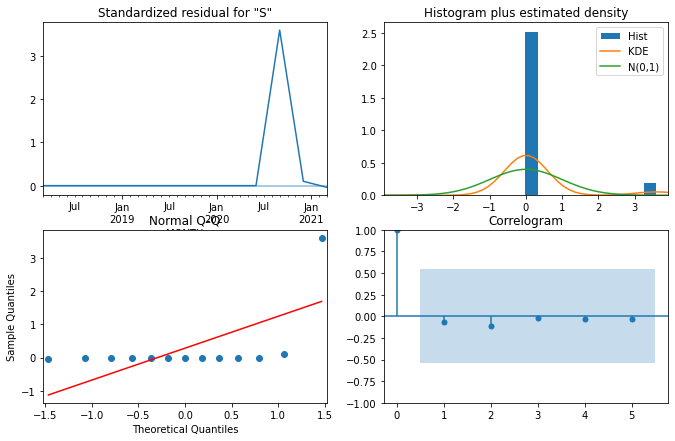

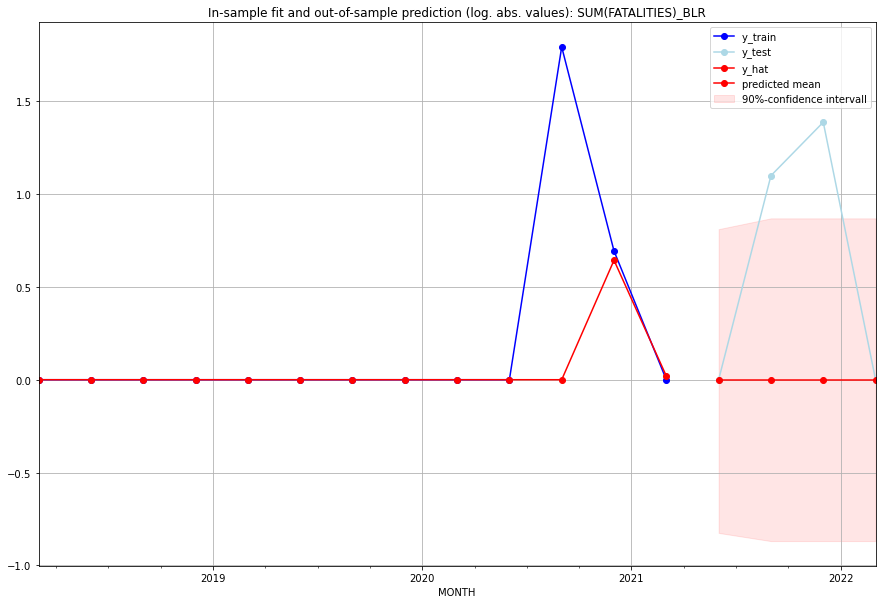

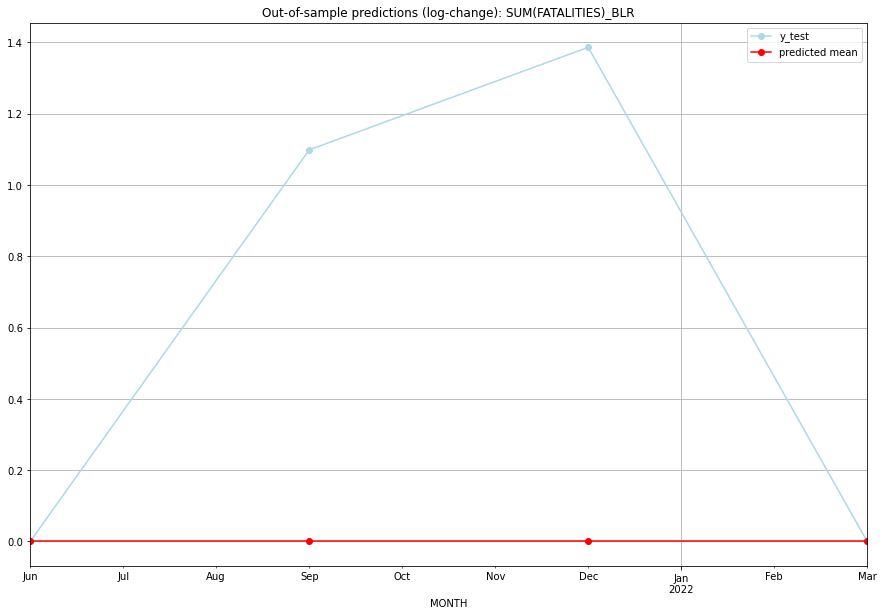

TADDA: 0.6212266624470001
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   BLR   
1 2021-07-01       0.0         2.0           0.0        1.098612   BLR   
2 2021-10-01       0.0         3.0           0.0        1.386294   BLR   
3 2022-01-01       0.0         0.0           0.0        0.000000   BLR   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## BLZ (29/234) #########
0
Neighbor countries: ['GTM', 'MEX']
Getting Data for BLZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 16)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.31495479682929317, 'fold_results': [0.34892706949548646, 0.2809825241630999]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BLZ   No. Observations:                   13
Model:                SARIMAX(0, 1, 1)   Log Likelihood                  -7.750
Date:                 Wed, 19 Oct 2022   AIC                             19.501
Time:                         10:27:19   BIC                             20.471
Sample:                     01-31-2018   HQIC                            19.142
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.9985     8

<Figure size 432x288 with 0 Axes>

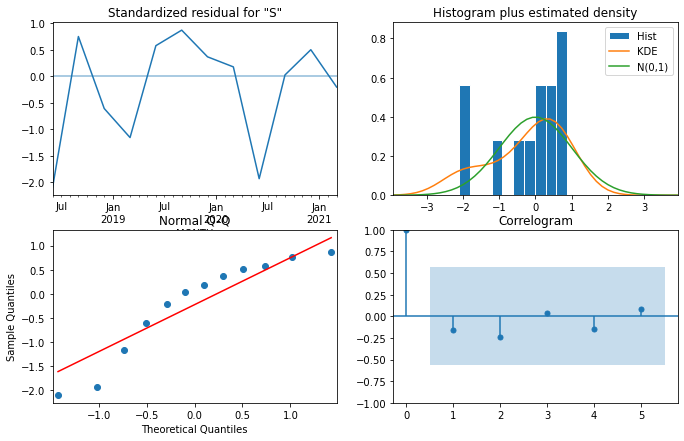

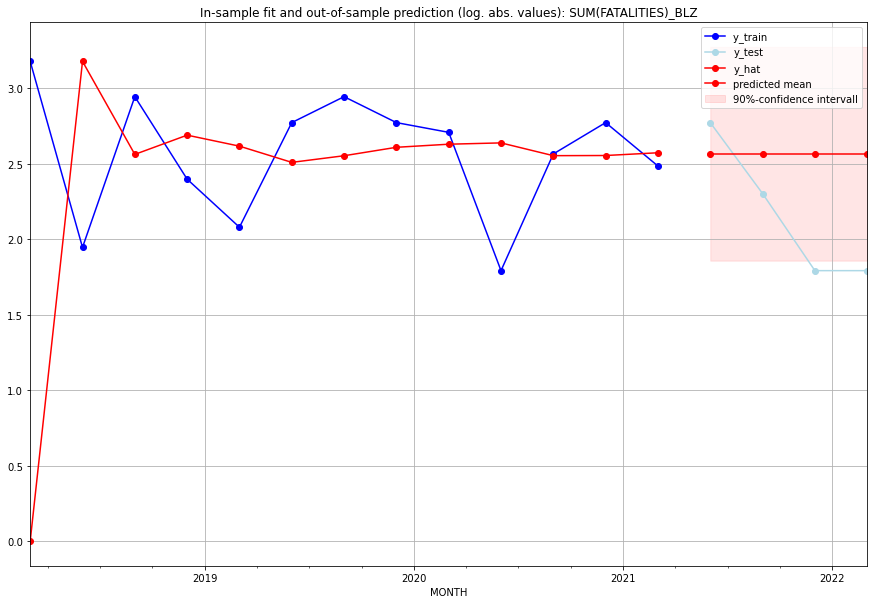

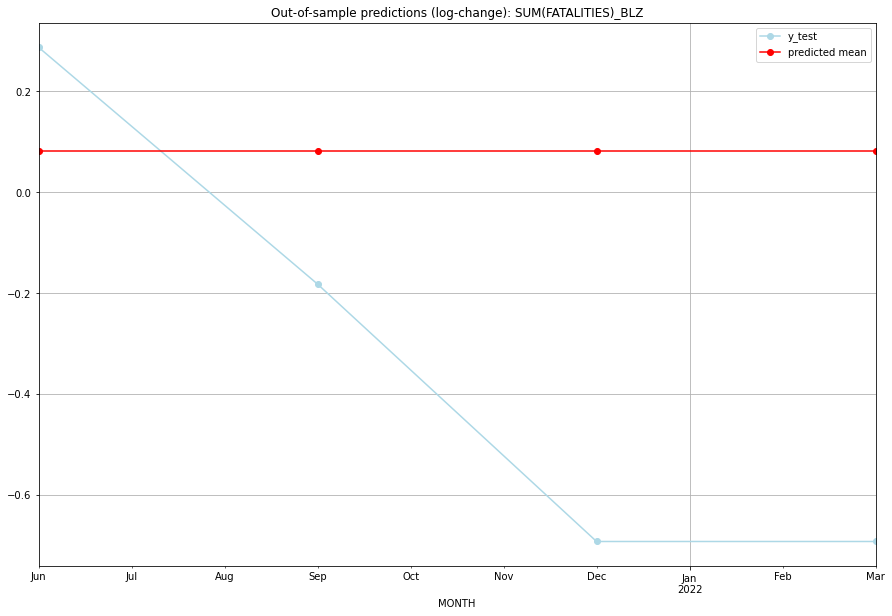

TADDA: 0.5654014438381235
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  12.013252        15.0      0.081062        0.287682   BLZ   
1 2021-07-01  12.013252         9.0      0.081062       -0.182322   BLZ   
2 2021-10-01  12.013252         5.0      0.081062       -0.693147   BLZ   
3 2022-01-01  12.013252         5.0      0.081062       -0.693147   BLZ   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## BMU (30/234) #########
0
Neighbor countries: []
Getting Data for BMU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficien

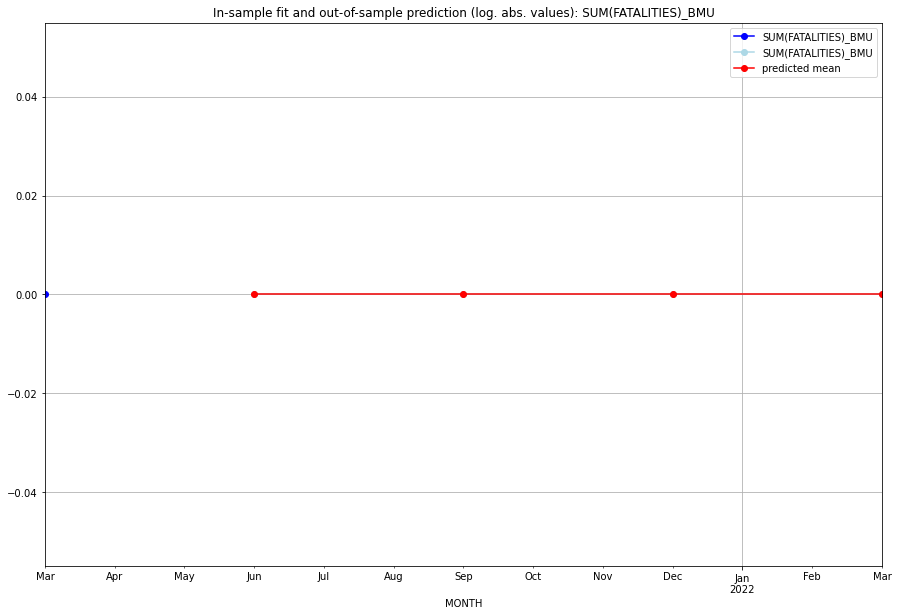

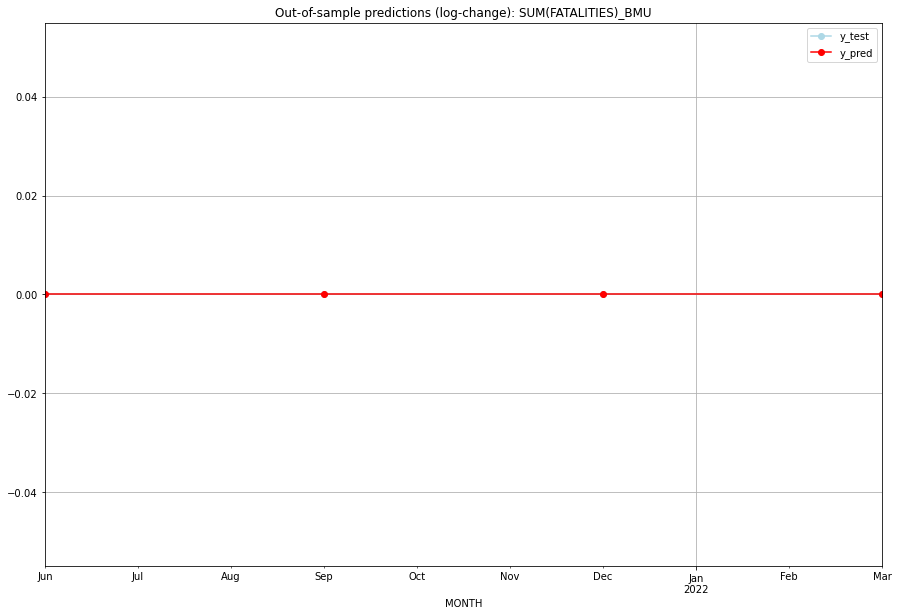

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BMU   
1 2021-07-01       0.0         0.0           0.0             0.0   BMU   
2 2021-10-01       0.0         0.0           0.0             0.0   BMU   
3 2022-01-01       0.0         0.0           0.0             0.0   BMU   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## BOL (31/234) #########
0
Neighbor countries: ['PRY', 'BRA', 'CHL', 'PER', 'ARG']
Getting Data for BOL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.8425572985442206, 'fold_results': [0.8425572985442206, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BOL   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -14.605
Date:                 Wed, 19 Oct 2022   AIC                             45.210
Time:                         10:27:32   BIC                             49.729
Sample:                     01-31-2018   HQIC                            44.281
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.2238      0.392     -0.571 

<Figure size 432x288 with 0 Axes>

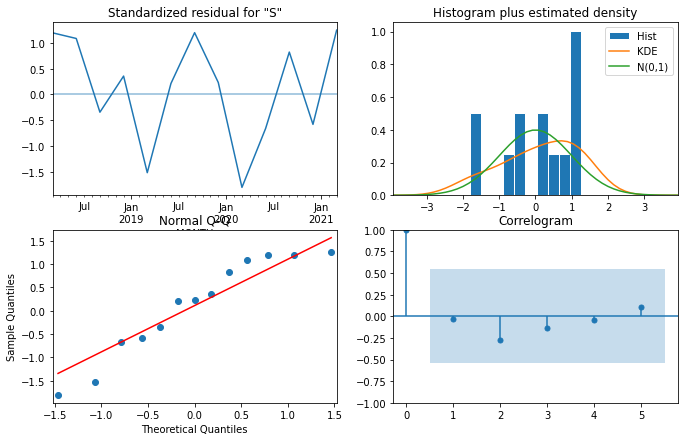

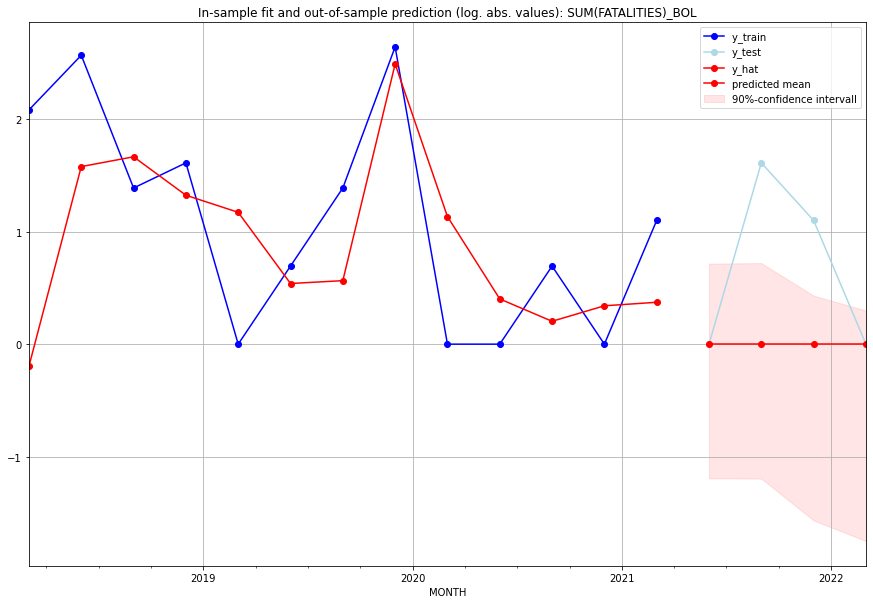

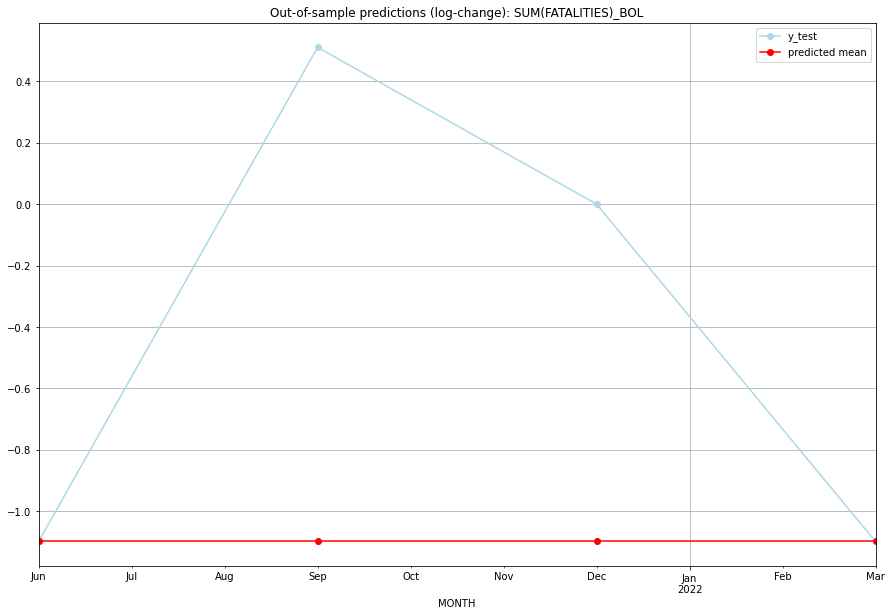

TADDA: 0.9516656224425801
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -1.098612       -1.098612   BOL   
1 2021-07-01       0.0         4.0     -1.098612        0.510826   BOL   
2 2021-10-01       0.0         2.0     -1.098612        0.000000   BOL   
3 2022-01-01       0.0         0.0     -1.098612       -1.098612   BOL   

                                          PARAMETERS  
0  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## BRA (32/234) #########
0
Neighbor countries: ['BOL', 'PRY', 'GUY', 'SUR', 'ARG', 'PER', 'URY', 'VEN', 'GUF', 'COL']
Getting Data for BRA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 80)
y: (17, 1)
---------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.05109259940171351, 'fold_results': [0.05109259940171351, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BRA   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                   6.802
Date:                 Wed, 19 Oct 2022   AIC                              4.396
Time:                         10:27:44   BIC                              9.480
Sample:                     01-31-2018   HQIC                             3.351
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0016      0.036      0.04

<Figure size 432x288 with 0 Axes>

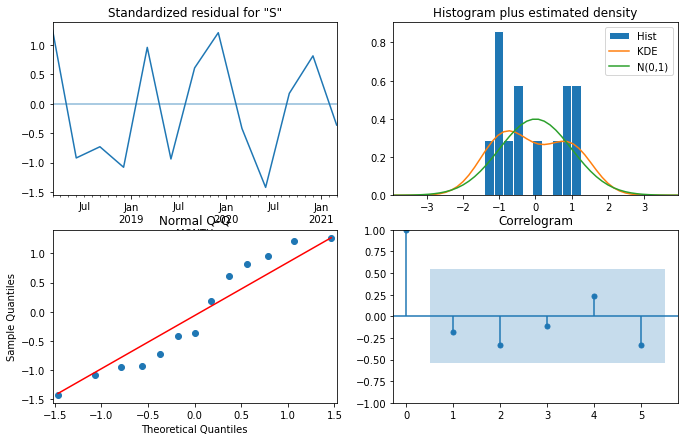

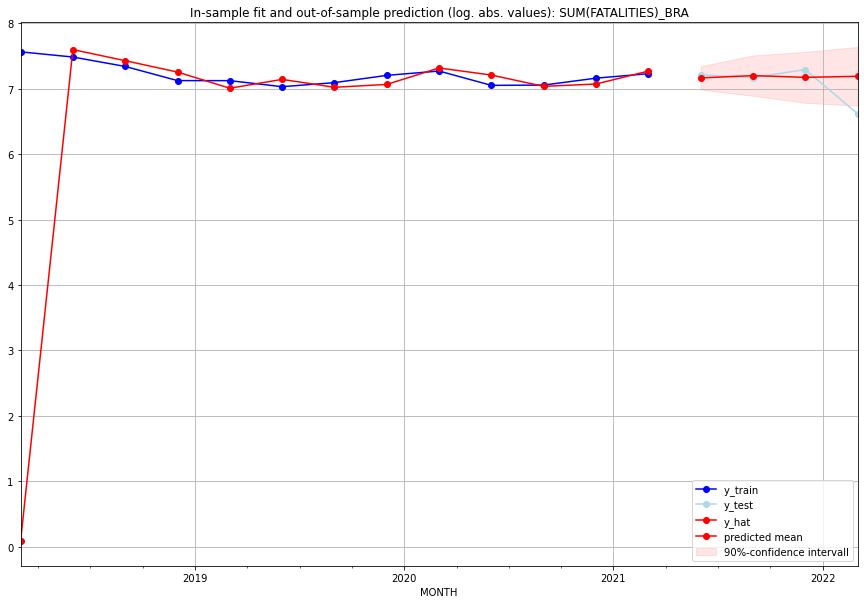

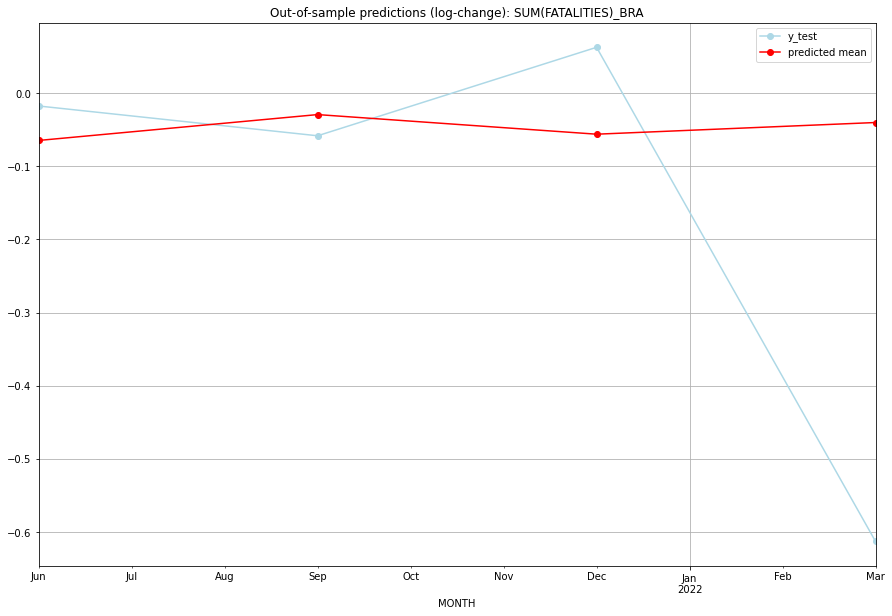

TADDA: 0.20594293796969776
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1289.719032      1352.0     -0.064708       -0.017583   BRA   
1 2021-07-01  1336.182182      1298.0     -0.029343       -0.058312   BRA   
2 2021-10-01  1300.819032      1465.0     -0.056145        0.062630   BRA   
3 2022-01-01  1321.769471       745.0     -0.040180       -0.612937   BRA   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## BRB (33/234) #########
0
Neighbor countries: []
Getting Data for BRB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BRB   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -2.997
Date:                 Wed, 19 Oct 2022   AIC                             11.993
Time:                         10:27:53   BIC                             13.688
Sample:                     01-31-2018   HQIC                            11.645
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1      -1.276e-06   6.03e+04  -2.11e-11      1.000   -1.18e+05    1.18

<Figure size 432x288 with 0 Axes>

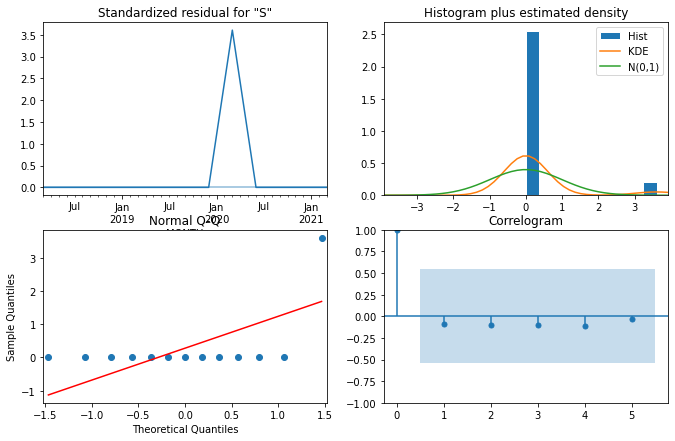

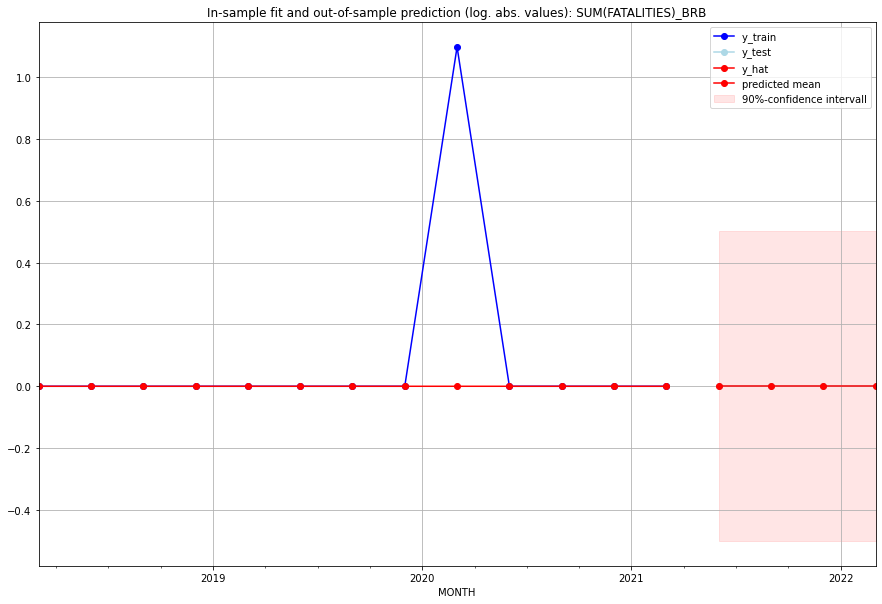

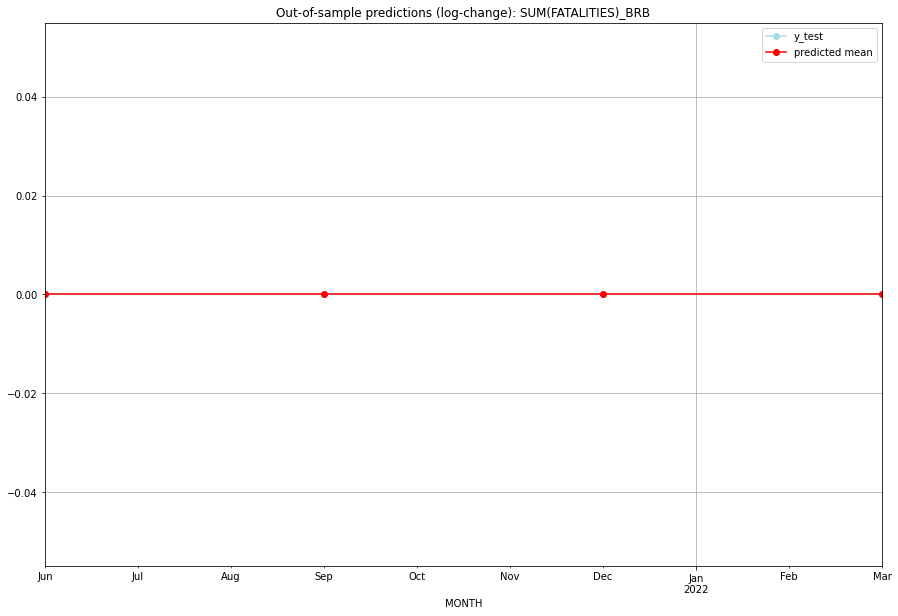

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BRB   
1 2021-07-01       0.0         0.0           0.0             0.0   BRB   
2 2021-10-01       0.0         0.0           0.0             0.0   BRB   
3 2022-01-01       0.0         0.0           0.0             0.0   BRB   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## BRN (34/234) #########
0
Neighbor countries: ['MYS']
Getting Data for BRN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cros

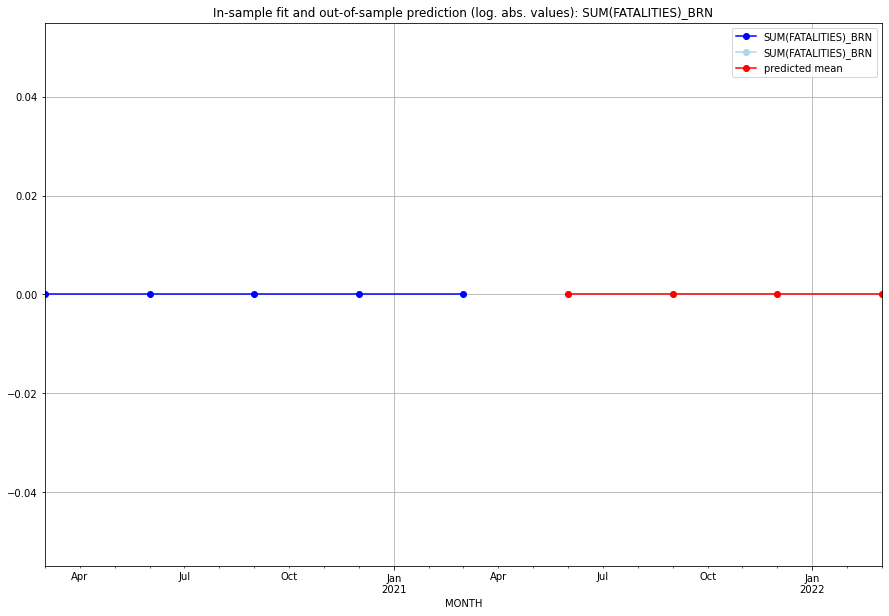

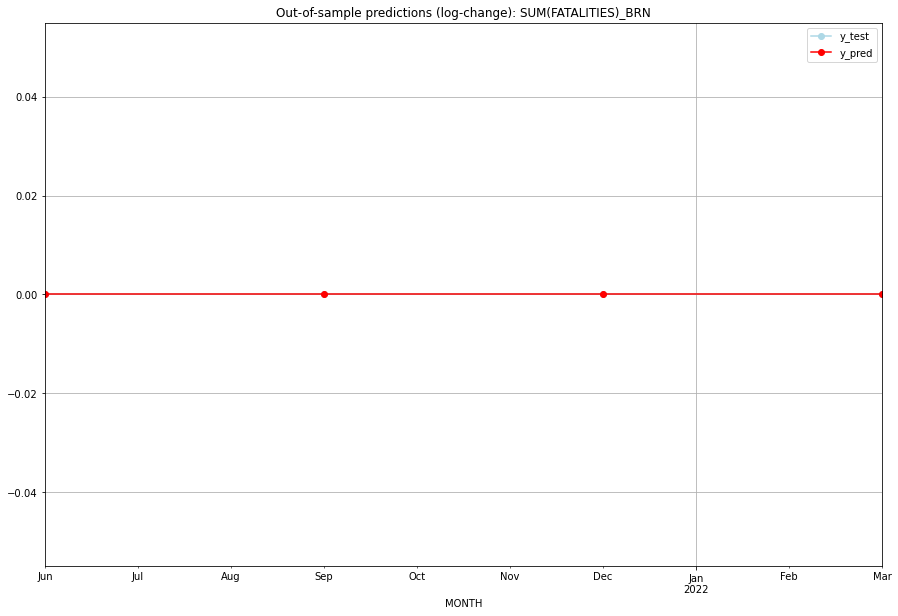

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BRN   
1 2021-07-01       0.0         0.0           0.0             0.0   BRN   
2 2021-10-01       0.0         0.0           0.0             0.0   BRN   
3 2022-01-01       0.0         0.0           0.0             0.0   BRN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## BTN (35/234) #########
0
Neighbor countries: ['IND', 'CHN']
Getting Data for BTN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 16)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


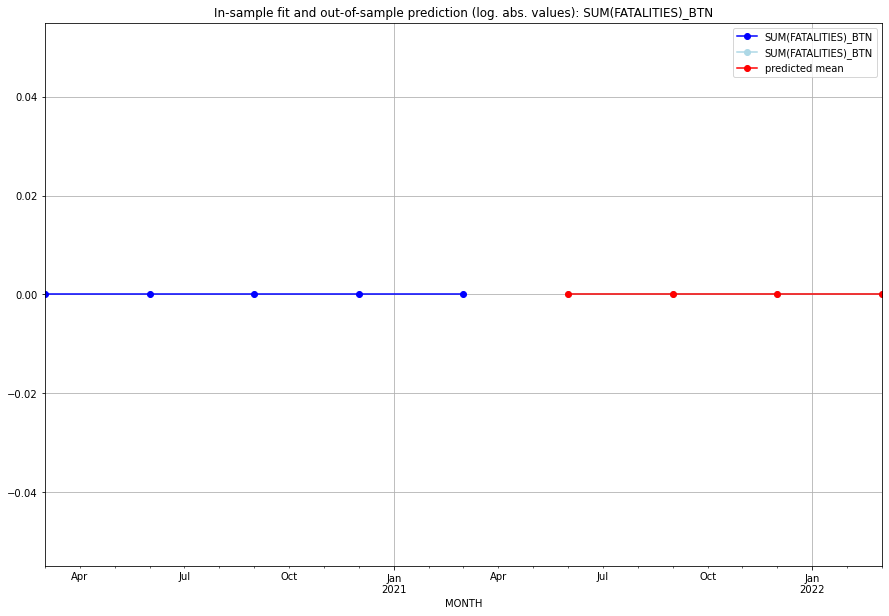

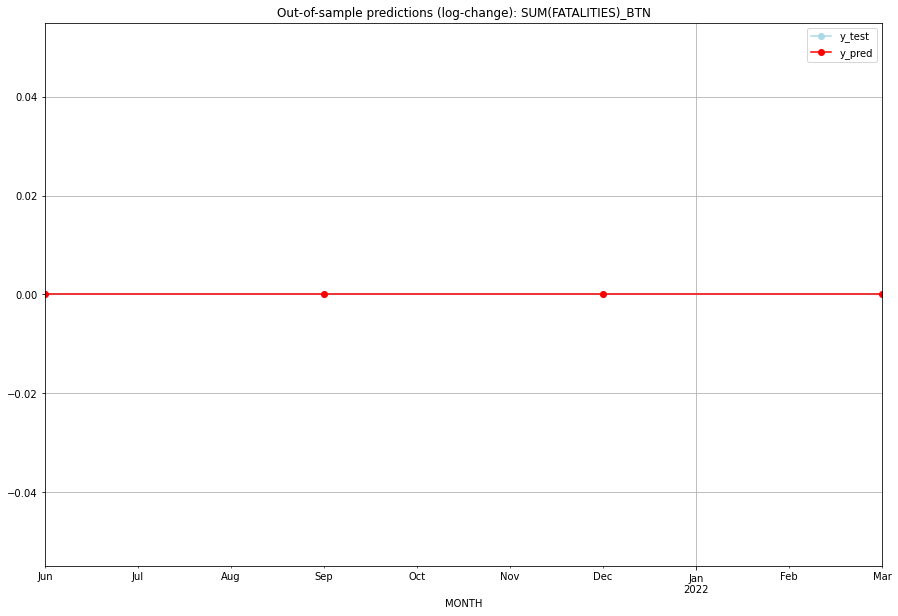

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BTN   
1 2021-07-01       0.0         0.0           0.0             0.0   BTN   
2 2021-10-01       0.0         0.0           0.0             0.0   BTN   
3 2022-01-01       0.0         0.0           0.0             0.0   BTN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## BWA (36/234) #########
0
Neighbor countries: ['ZWE', 'NAM', 'ZAF', 'ZMB']
Getting Data for BWA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 32)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.18444397270569685, 'fold_results': [0.0, 0.0, 0.17328679513998632, 0.0, 0.7489330683884978]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BWA   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                  -2.760
Date:                 Wed, 19 Oct 2022   AIC                              7.520
Time:                         10:28:21   BIC                             10.085
Sample:                     04-30-1997   HQIC                             8.557
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      

<Figure size 432x288 with 0 Axes>

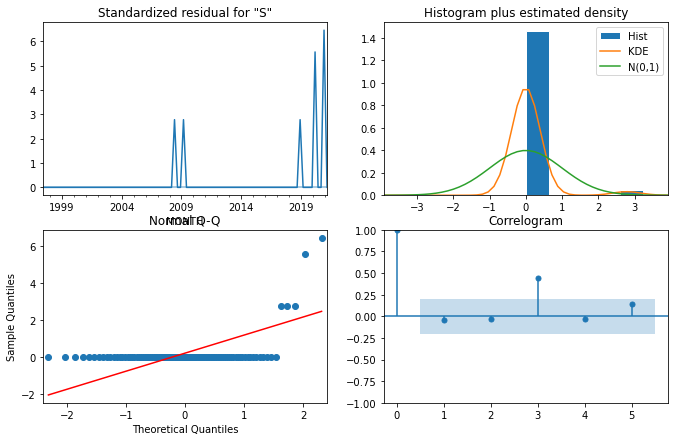

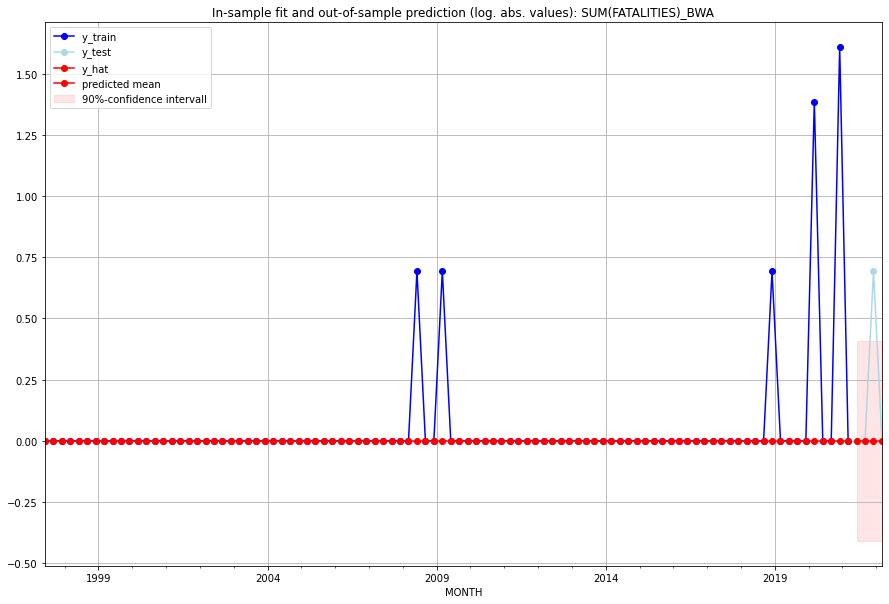

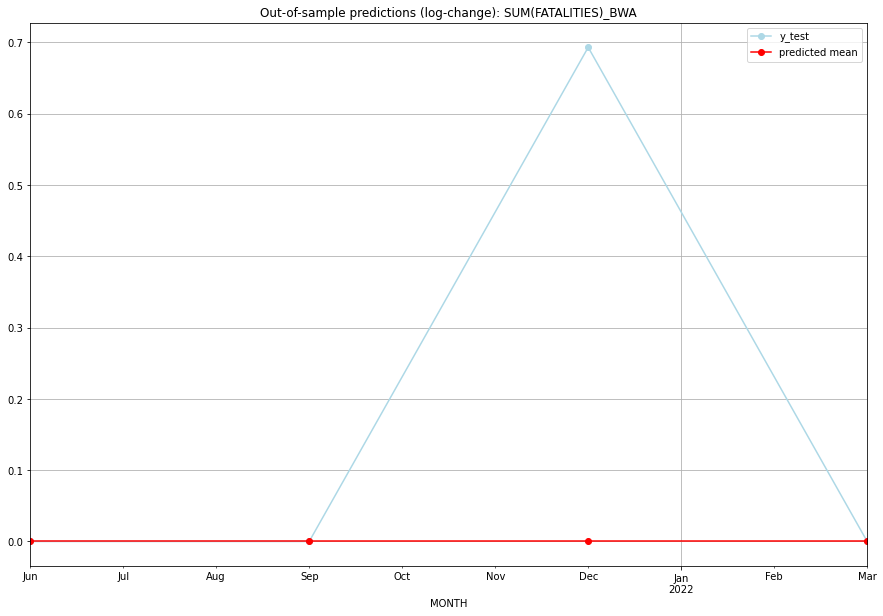

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   BWA   
1 2021-07-01       0.0         0.0           0.0        0.000000   BWA   
2 2021-10-01       0.0         1.0           0.0        0.693147   BWA   
3 2022-01-01       0.0         0.0           0.0        0.000000   BWA   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:24
######## CAF (37/234) #########
0
Neighbor countries: ['CMR', 'COD', 'TCD', 'COG', 'SDN', 'XKK', 'SSD']
Getting Data for CAF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 56)
y: (100, 1)
------------------------------------------------
Tr

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4498239892155441, 'fold_results': [0.6684507640645441, 0.25897487773842975, 0.4709640101455992, 0.37489857263747317, 0.4758317214916743]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CAF   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -174.525
Date:                 Wed, 19 Oct 2022   AIC                            355.050
Time:                         10:28:33   BIC                            362.712
Sample:                     04-30-1997   HQIC                           358.146
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

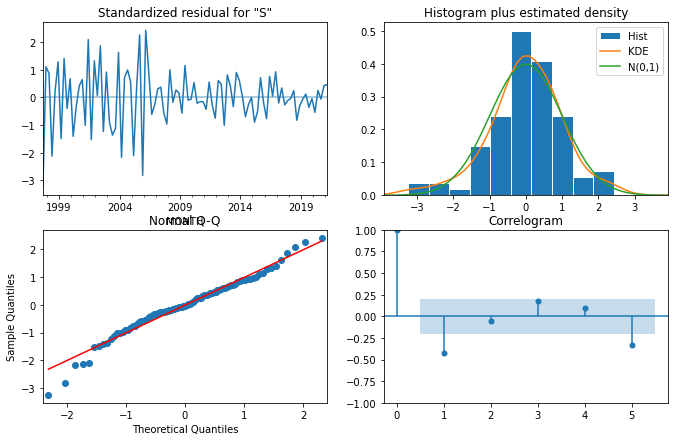

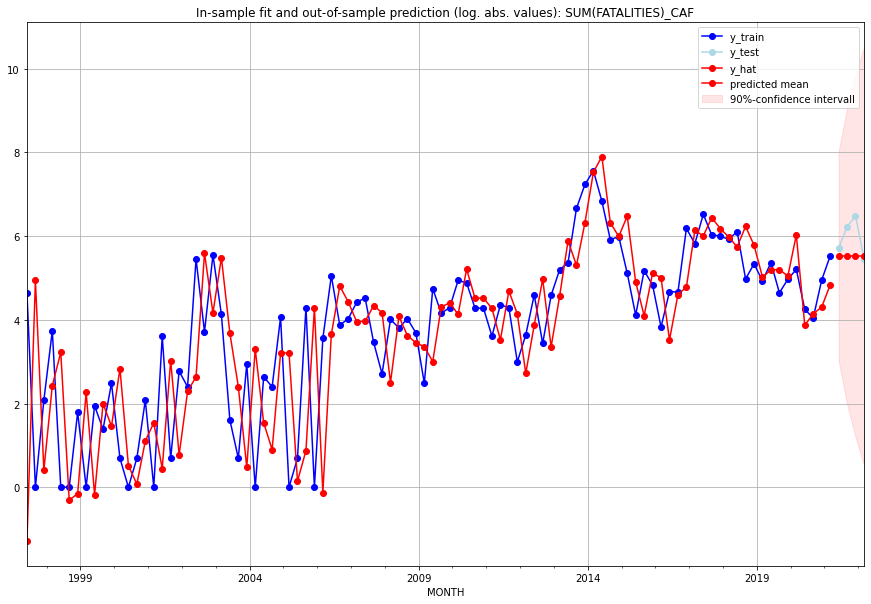

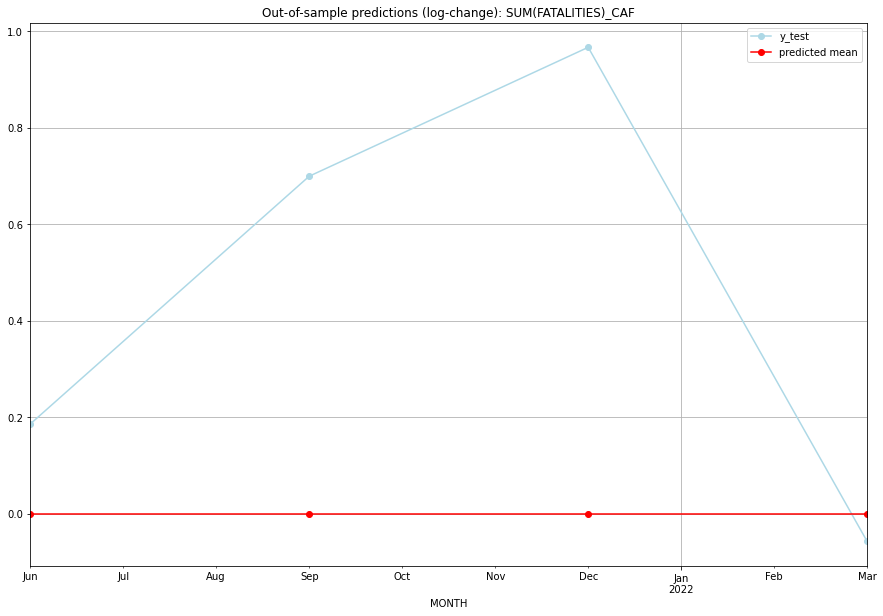

TADDA: 0.4771577031457894
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     249.0       300.0 -7.105427e-15        0.185649   CAF   
1 2021-07-01     249.0       502.0 -7.105427e-15        0.699129   CAF   
2 2021-10-01     249.0       656.0 -7.105427e-15        0.966223   CAF   
3 2022-01-01     249.0       235.0 -7.105427e-15       -0.057629   CAF   

                                          PARAMETERS  
0  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## CAN (38/234) #########
0
Neighbor countries: ['USA', 'GRL']
Getting Data for CAN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 16)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Ins

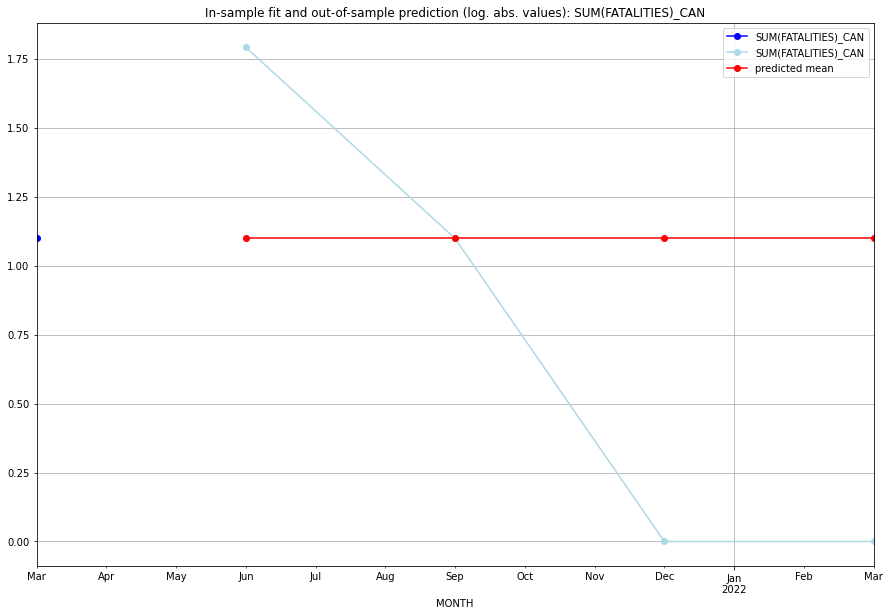

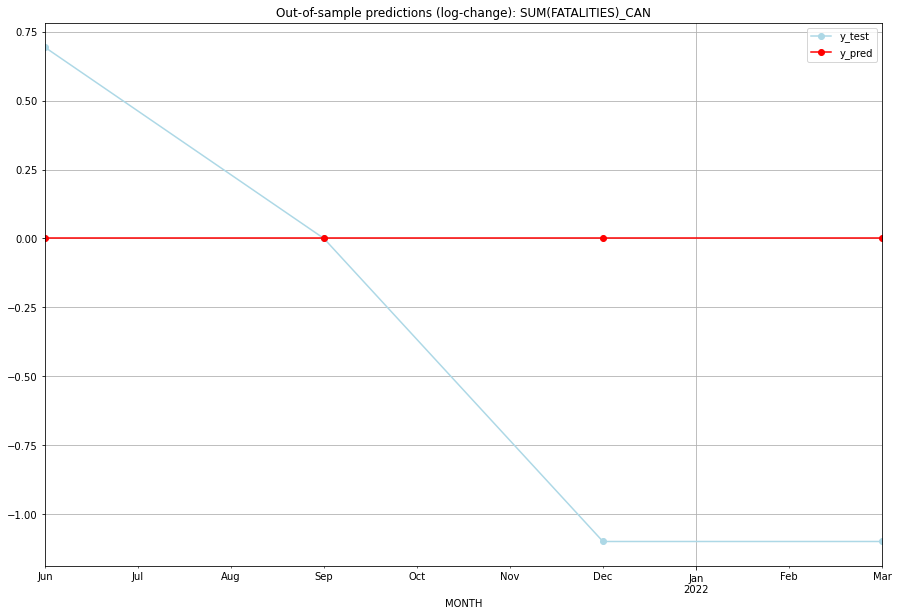

TADDA: 0.7225929394740411
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.098612    1.791759           0.0        0.693147   CAN   
1 2021-07-01  1.098612    1.098612           0.0        0.000000   CAN   
2 2021-10-01  1.098612    0.000000           0.0       -1.098612   CAN   
3 2022-01-01  1.098612    0.000000           0.0       -1.098612   CAN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## CHE (39/234) #########
0
Neighbor countries: ['AUT', 'ITA', 'LIE', 'FRA', 'DEU']
Getting Data for CHE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 40)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


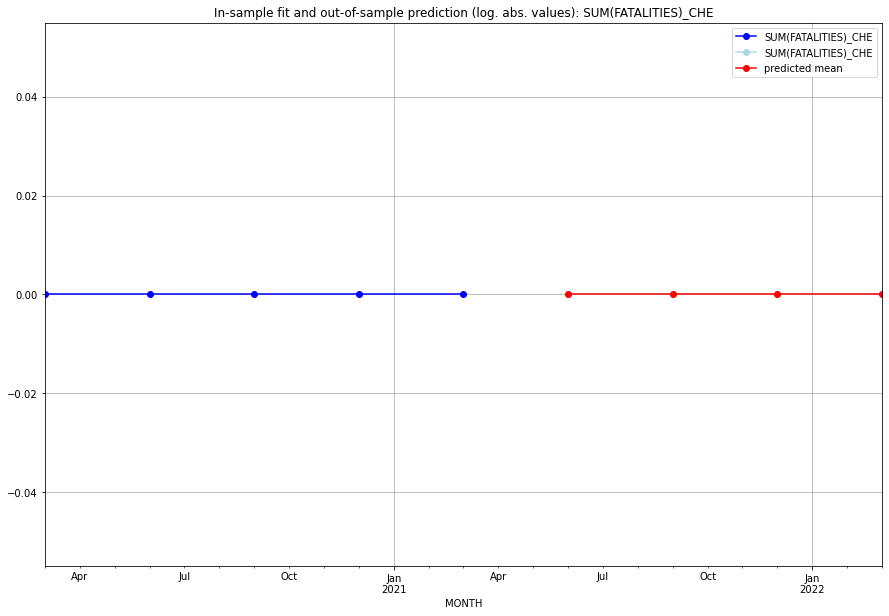

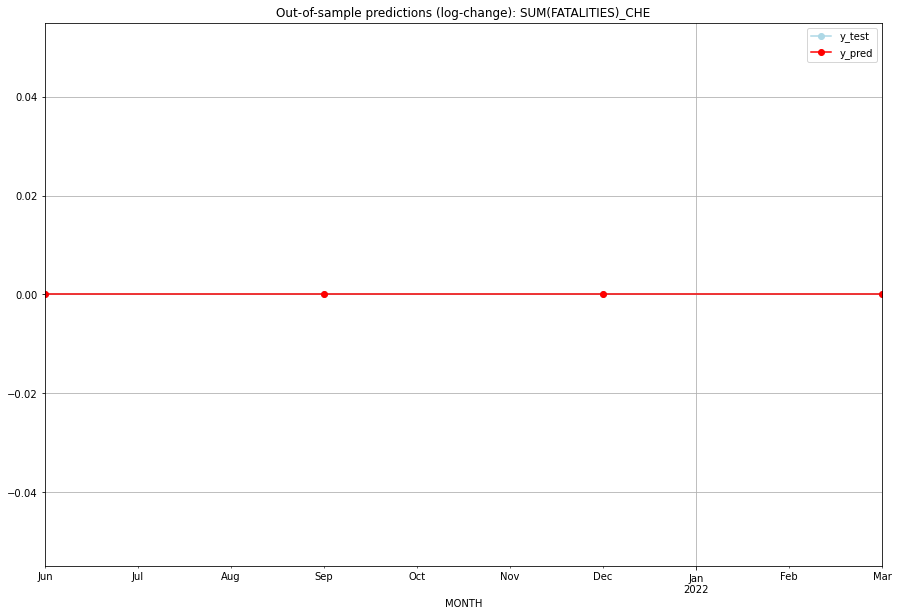

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CHE   
1 2021-07-01       0.0         0.0           0.0             0.0   CHE   
2 2021-10-01       0.0         0.0           0.0             0.0   CHE   
3 2022-01-01       0.0         0.0           0.0             0.0   CHE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## CHL (40/234) #########
0
Neighbor countries: ['ARG', 'BOL', 'PER']
Getting Data for CHL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5861070332076367, 'fold_results': [1.080931813829671, 0.0912822525856023]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CHL   No. Observations:                   13
Model:                SARIMAX(0, 1, 3)   Log Likelihood                     nan
Date:                 Wed, 19 Oct 2022   AIC                                nan
Time:                         10:28:49   BIC                                nan
Sample:                     01-31-2018   HQIC                               nan
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.3748        n

<Figure size 432x288 with 0 Axes>

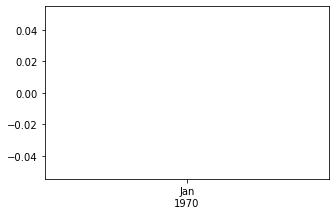

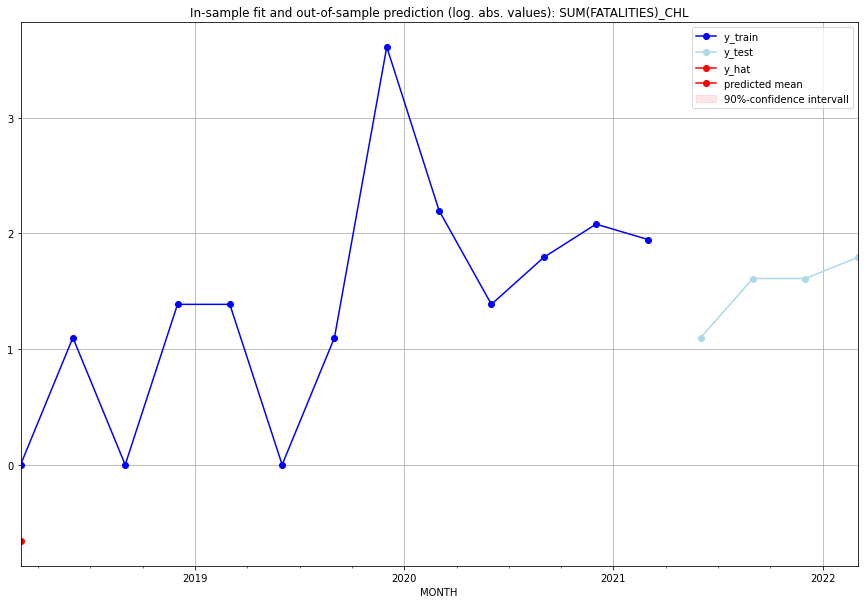

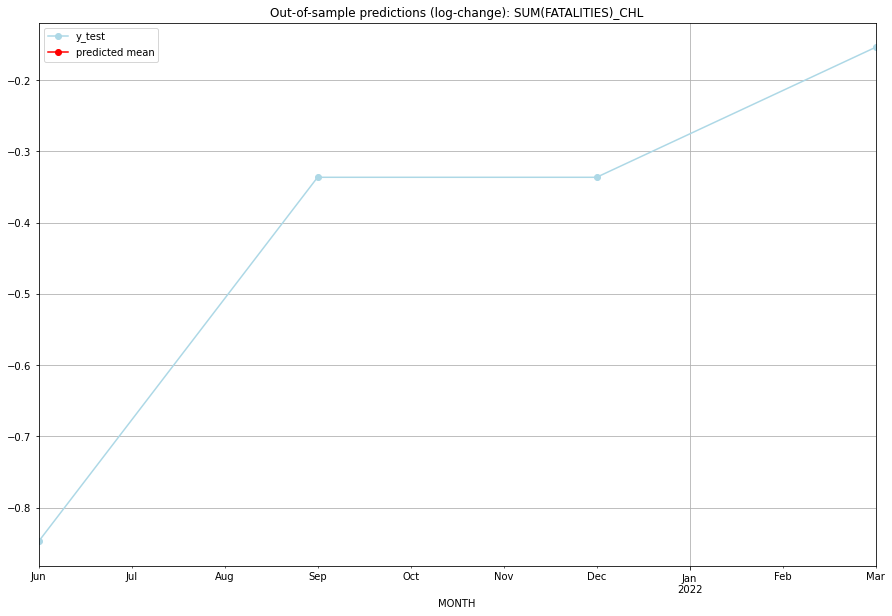

TADDA: nan
Evaluation finished.
Model Prediction failed --> Prediction with Naive Model 


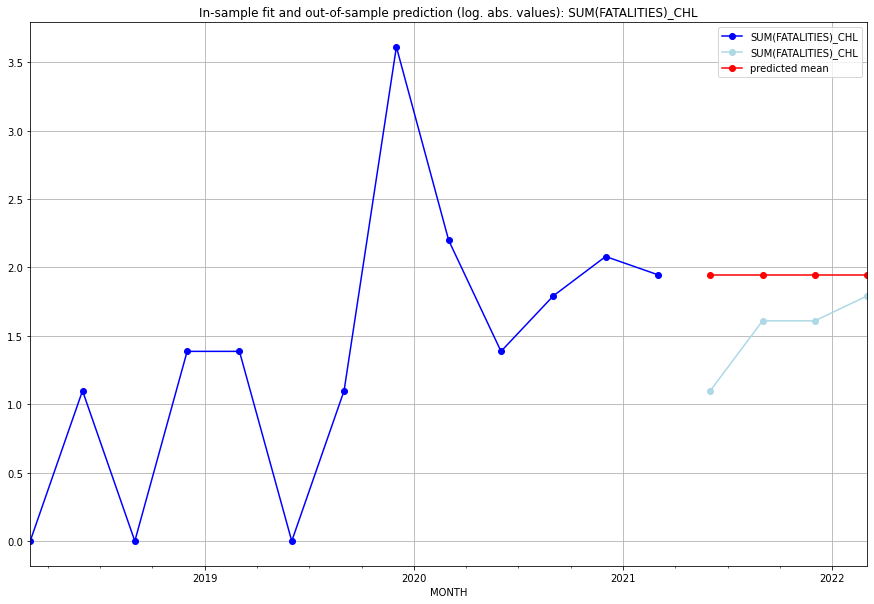

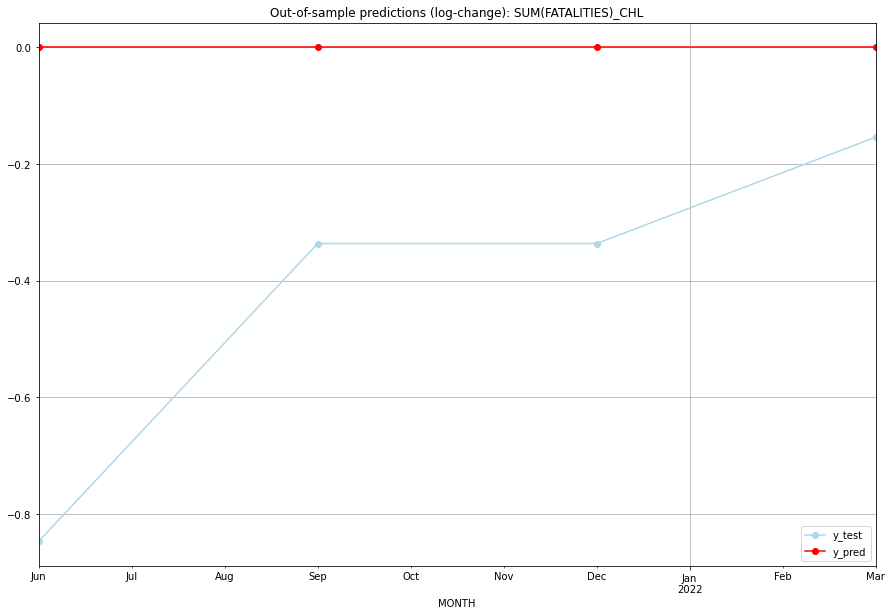

TADDA: 0.41859825336422135
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   1.94591    1.098612           0.0       -0.847298   CHL   
1 2021-07-01   1.94591    1.609438           0.0       -0.336472   CHL   
2 2021-10-01   1.94591    1.609438           0.0       -0.336472   CHL   
3 2022-01-01   1.94591    1.791759           0.0       -0.154151   CHL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## CHN (41/234) #########
0
Neighbor countries: ['RUS', 'PRK', 'MNG', 'AFG', 'IND', 'KAZ', 'KGZ', 'PAK', 'TJK', 'BTN', 'MMR', 'NPL', 'LAO', 'VNM', 'HKG', 'MAC']
Getting Data for CHN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 128)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.4071481805523829, 'fold_results': [0.4071481805523829, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CHN   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -16.476
Date:                 Wed, 19 Oct 2022   AIC                             44.952
Time:                         10:28:59   BIC                             48.342
Sample:                     01-31-2018   HQIC                            44.256
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0685      0.177      0.386 

<Figure size 432x288 with 0 Axes>

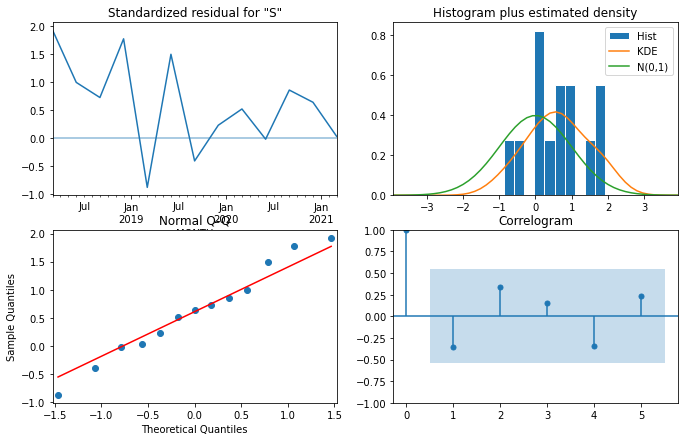

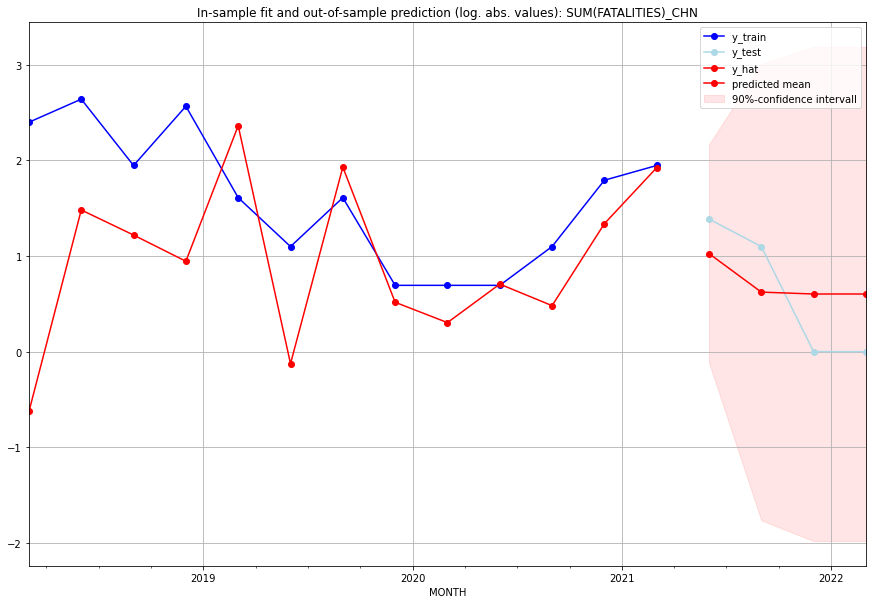

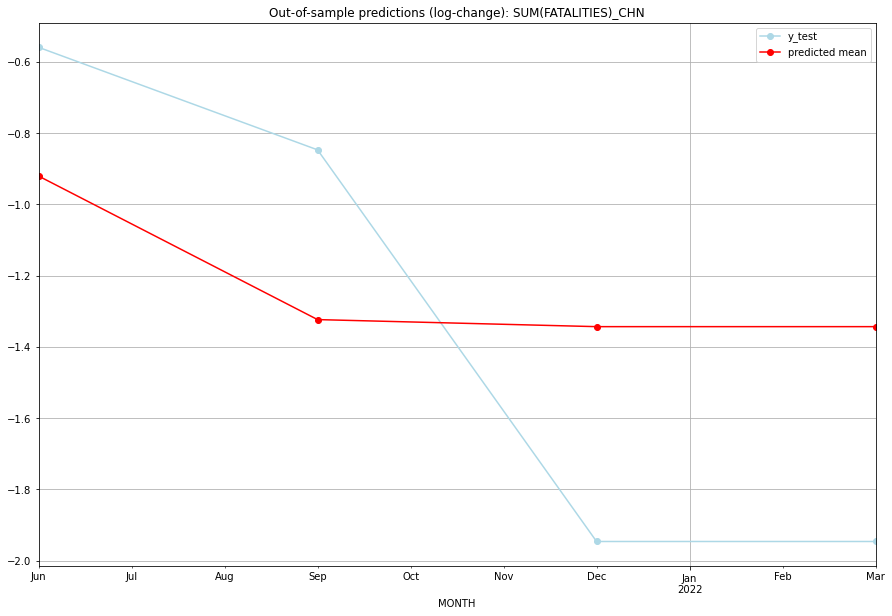

TADDA: 0.5106657913051931
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.787519         3.0     -0.920758       -0.559616   CHN   
1 2021-07-01  0.863504         2.0     -1.323452       -0.847298   CHN   
2 2021-10-01  0.827015         0.0     -1.343227       -1.945910   CHN   
3 2022-01-01  0.827015         0.0     -1.343227       -1.945910   CHN   

                                          PARAMETERS  
0  {'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## CIV (42/234) #########
0
Neighbor countries: ['BFA', 'MLI', 'GIN', 'GHA', 'LBR']
Getting Data for CIV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 40)
y: (100, 1)
------------------------------------------------
Training started.

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8420044824981547, 'fold_results': [0.8957373440213926, 0.47954063748963416, 1.438671149070079, 0.7355741100311812, 0.6604991718784862]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CIV   No. Observations:                   96
Model:                SARIMAX(2, 1, 0)   Log Likelihood                -171.852
Date:                 Wed, 19 Oct 2022   AIC                            355.703
Time:                         10:29:19   BIC                            371.026
Sample:                     04-30-1997   HQIC                           361.895
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

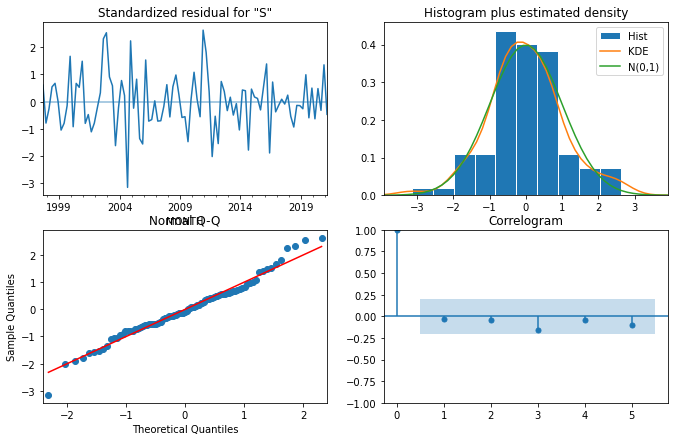

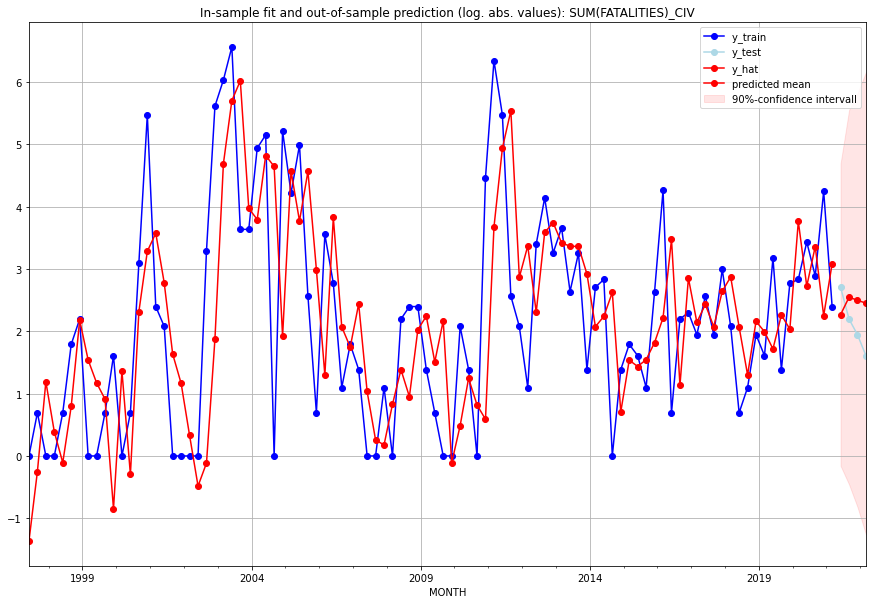

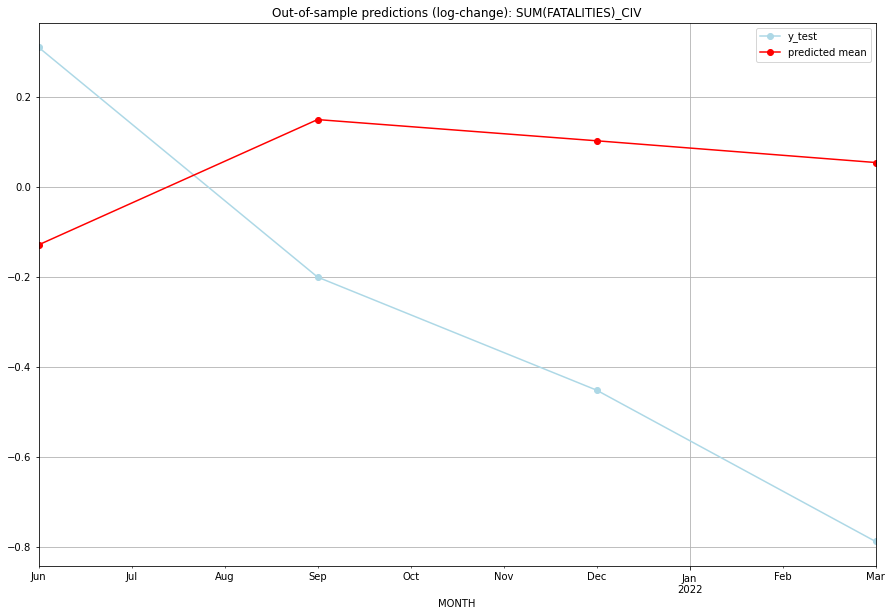

TADDA: 0.655275160698243
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   8.668436        14.0     -0.129029        0.310155   CIV   
1 2021-07-01  11.773620         8.0      0.149487       -0.200671   CIV   
2 2021-10-01  11.185717         6.0      0.102369       -0.451985   CIV   
3 2022-01-01  10.610695         4.0      0.054031       -0.788457   CIV   

                                          PARAMETERS  
0  {'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## CMR (43/234) #########
0
Neighbor countries: ['COG', 'GAB', 'GNQ', 'CAF', 'NGA', 'TCD']
Getting Data for CMR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 48)
y: (100, 1)
------------------------------------------------
Traini

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.37413537448256007, 'fold_results': [0.2140109561211283, 0.22448282551315835, 0.7104273886417107, 0.34458265628512663, 0.3771730458516762]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CMR   No. Observations:                   96
Model:                SARIMAX(0, 1, 3)   Log Likelihood                -146.779
Date:                 Wed, 19 Oct 2022   AIC                            303.557
Time:                         10:29:40   BIC                            316.326
Sample:                     04-30-1997   HQIC                           308.717
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

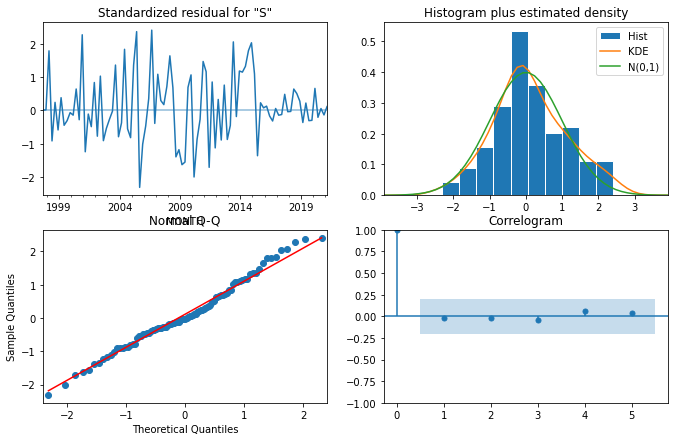

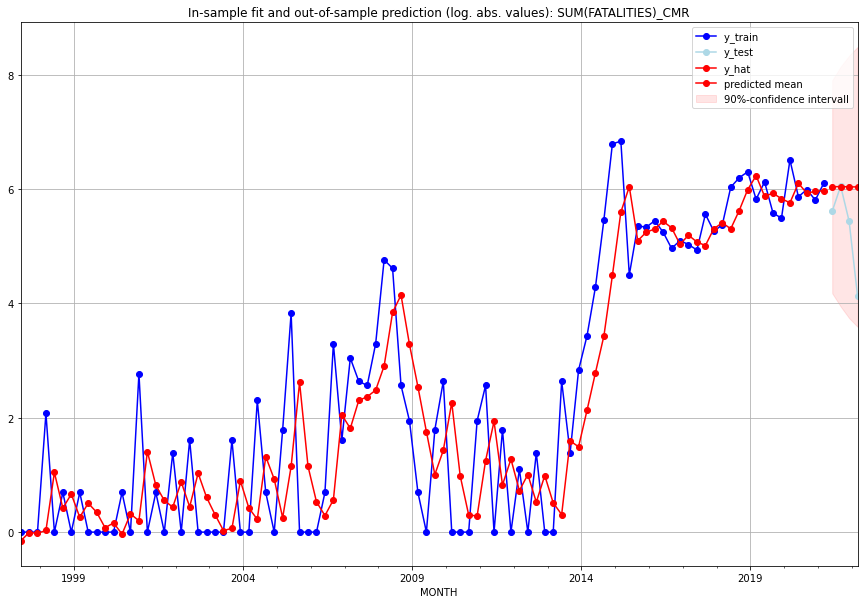

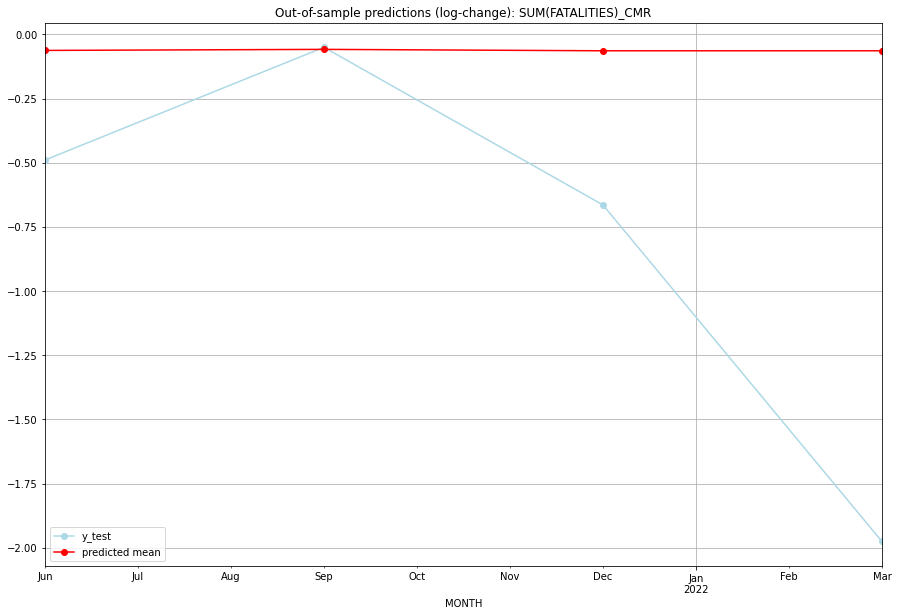

TADDA: 0.7366866020082392
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  418.875124       273.0     -0.062601       -0.489430   CMR   
1 2021-07-01  420.600186       424.0     -0.058501       -0.050469   CMR   
2 2021-10-01  418.284450       229.0     -0.064009       -0.664479   CMR   
3 2022-01-01  418.284450        61.0     -0.064009       -1.975424   CMR   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## COD (44/234) #########
0
Neighbor countries: ['COG', 'AGO', 'ZMB', 'RWA', 'UGA', 'CAF', 'BDI', 'TZA', 'SSD']
Getting Data for COD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 72)
y: (100, 1)
----------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.33325516356732693, 'fold_results': [0.297198721299448, 0.32551496276824077, 0.3534509987212131, 0.2842448177721719, 0.4058663172755608]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COD   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -155.947
Date:                 Wed, 19 Oct 2022   AIC                            313.894
Time:                         10:30:07   BIC                            316.448
Sample:                     04-30-1997   HQIC                           314.926
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

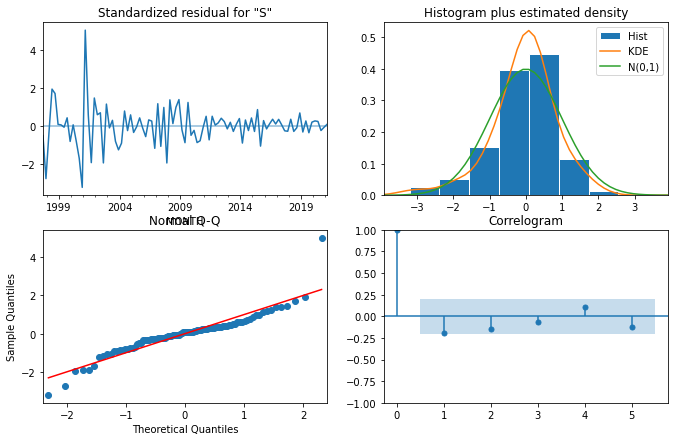

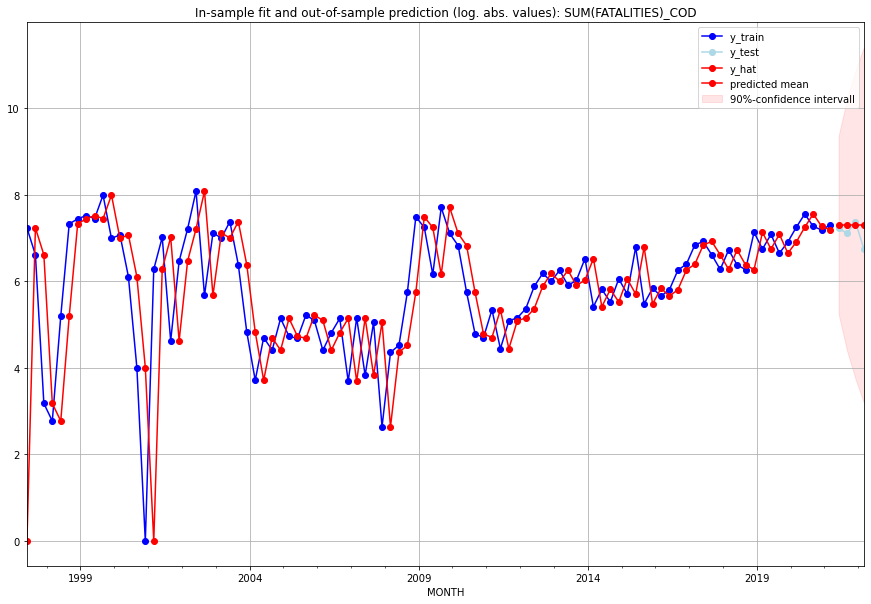

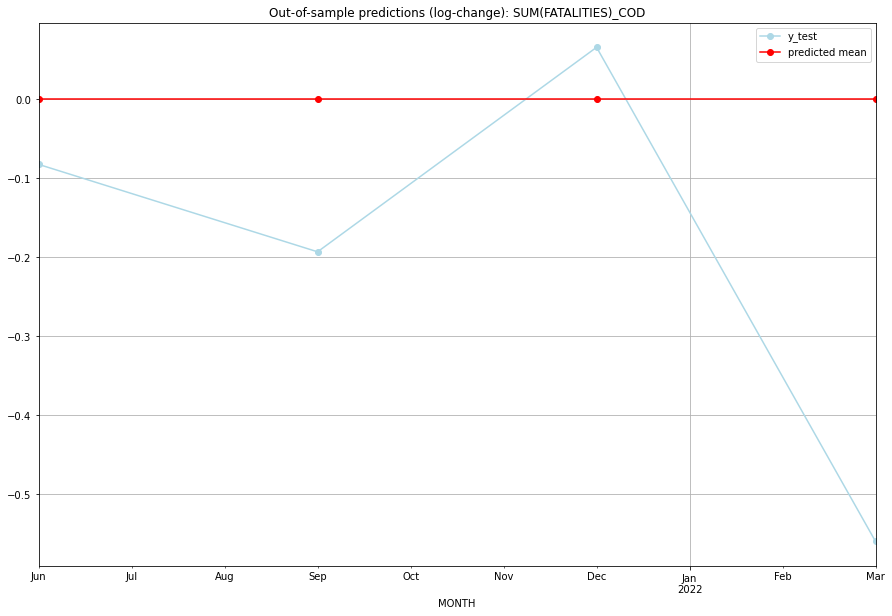

TADDA: 0.2253172761857154
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01    1480.0      1363.0           0.0       -0.082296   COD   
1 2021-07-01    1480.0      1220.0           0.0       -0.193047   COD   
2 2021-10-01    1480.0      1581.0           0.0        0.065972   COD   
3 2022-01-01    1480.0       845.0           0.0       -0.559953   COD   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:25
######## COG (45/234) #########
0
Neighbor countries: ['COD', 'CAF', 'CMR', 'GAB', 'AGO']
Getting Data for COG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 40)
y: (100, 1)
------------------------------------------------
Training started.

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 1.15930458370117, 'fold_results': [1.4630506199436188, 1.1796247178237735, 1.170532806781055, 0.9158904115324116, 1.0674243624249906]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COG   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -187.421
Date:                 Wed, 19 Oct 2022   AIC                            376.843
Time:                         10:30:27   BIC                            379.396
Sample:                     04-30-1997   HQIC                           377.874
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------

<Figure size 432x288 with 0 Axes>

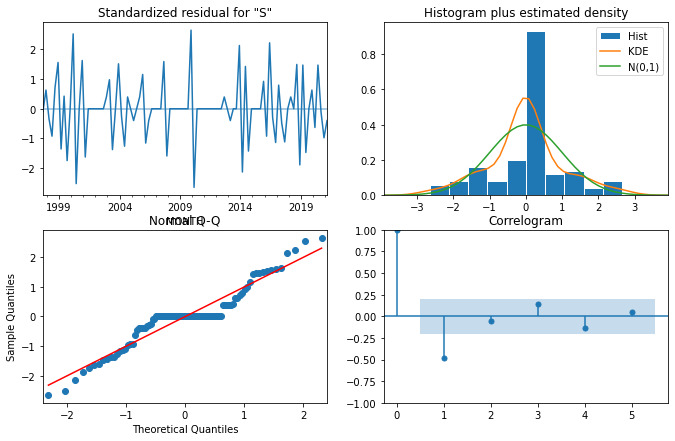

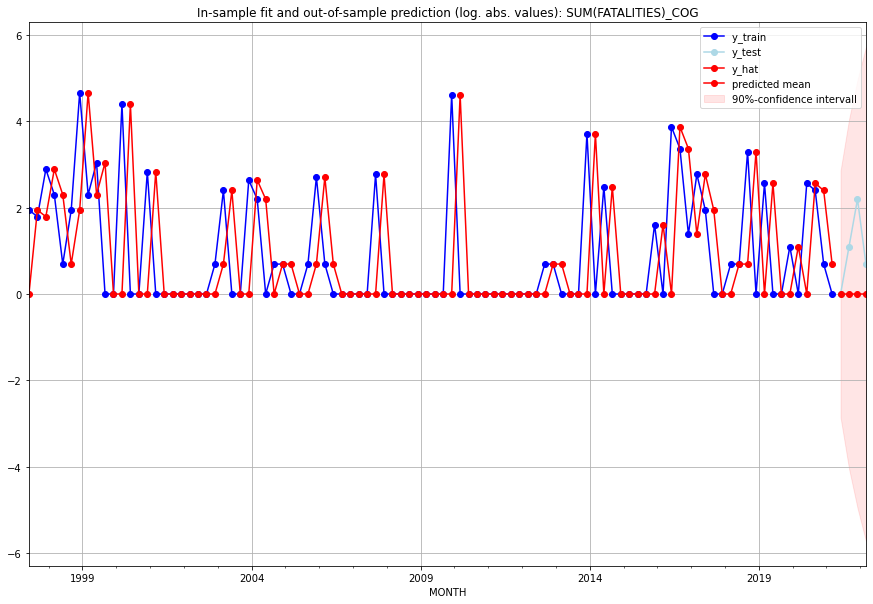

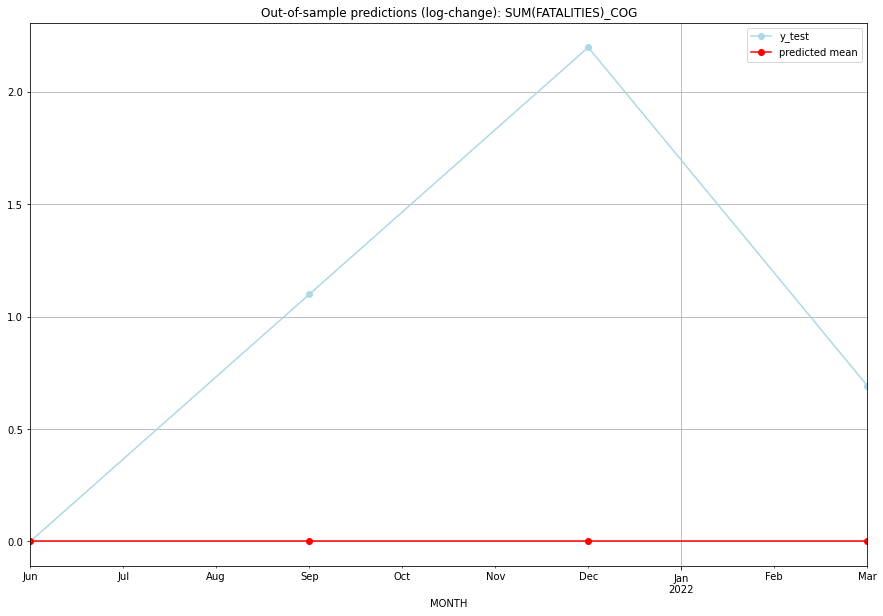

TADDA: 0.9972460116410689
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   COG   
1 2021-07-01       0.0         2.0           0.0        1.098612   COG   
2 2021-10-01       0.0         8.0           0.0        2.197225   COG   
3 2022-01-01       0.0         1.0           0.0        0.693147   COG   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:23
######## COK (46/234) #########
0
Neighbor countries: []
Getting Data for COK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient dat

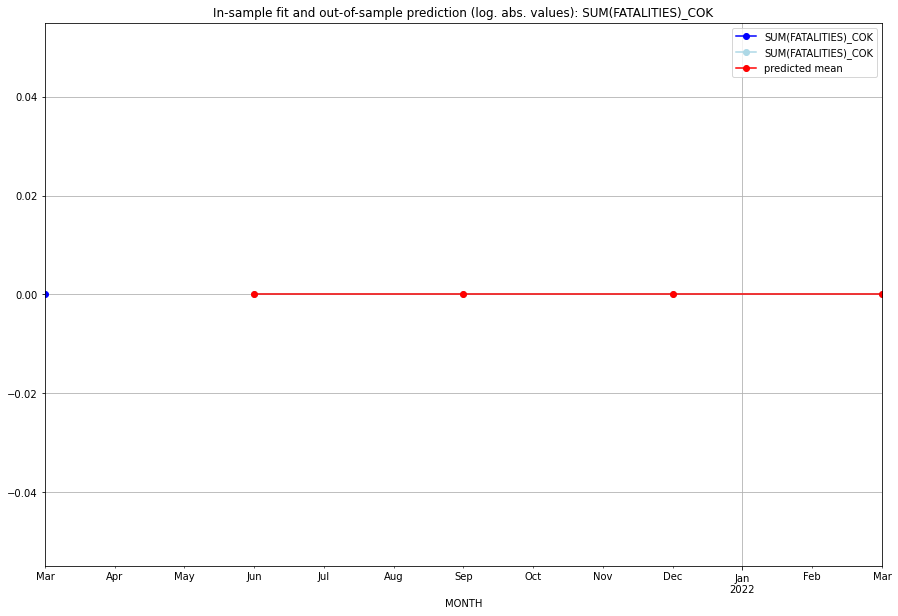

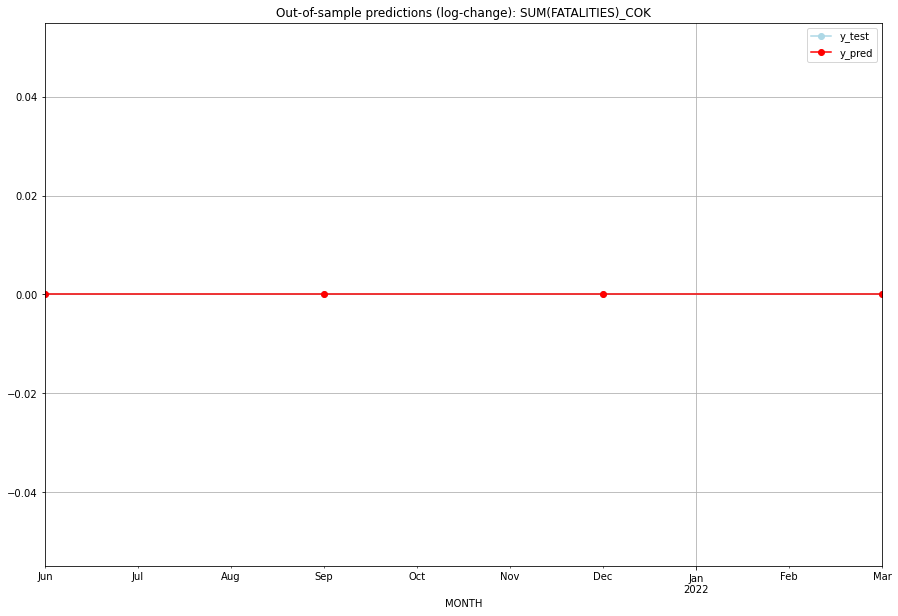

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   COK   
1 2021-07-01       0.0         0.0           0.0             0.0   COK   
2 2021-10-01       0.0         0.0           0.0             0.0   COK   
3 2022-01-01       0.0         0.0           0.0             0.0   COK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## COL (47/234) #########
0
Neighbor countries: ['VEN', 'PAN', 'BRA', 'PER', 'ECU']
Getting Data for COL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.12210238658042227, 'fold_results': [0.12210238658042227, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COL   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                   2.669
Date:                 Wed, 19 Oct 2022   AIC                             12.662
Time:                         10:30:40   BIC                             17.747
Sample:                     01-31-2018   HQIC                            11.617
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0184      0.061      0.30

<Figure size 432x288 with 0 Axes>

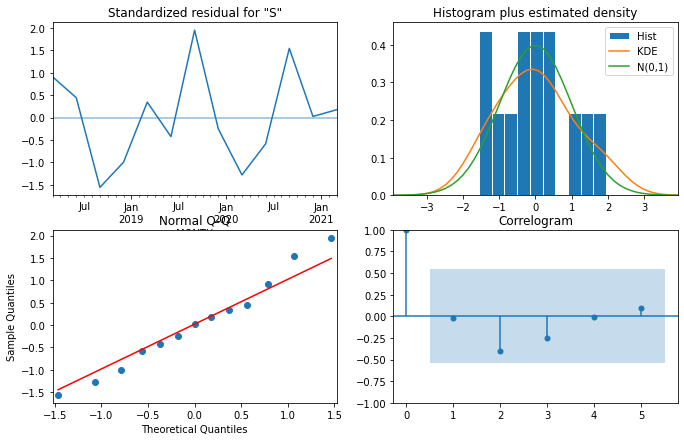

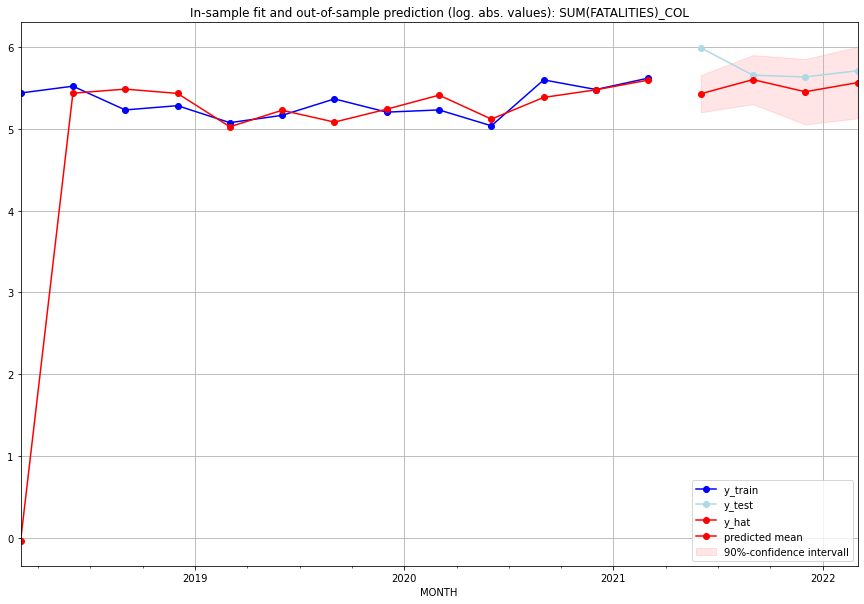

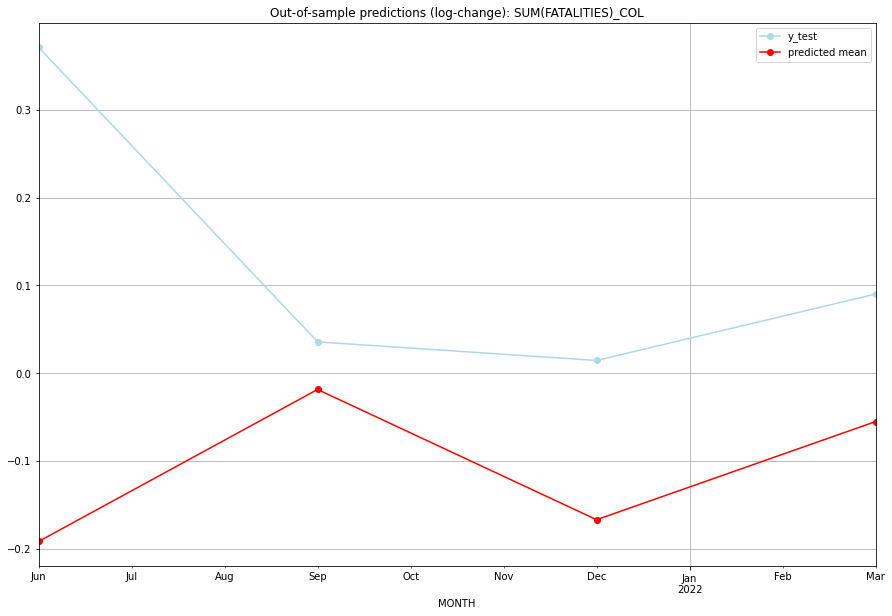

TADDA: 0.3440968470887844
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  226.832531       399.0     -0.191790        0.371064   COL   
1 2021-07-01  269.896517       285.0     -0.018664        0.035591   COL   
2 2021-10-01  232.556614       279.0     -0.166976        0.014389   COL   
3 2022-01-01  260.170195       301.0     -0.055229        0.090026   COL   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## COM (48/234) #########
0
Neighbor countries: []
Getting Data for COM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.03465735902799726, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COM   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 118.056
Date:                 Wed, 19 Oct 2022   AIC                           -234.112
Time:                         10:30:49   BIC                           -231.547
Sample:                     04-30-1997   HQIC                          -233.075
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0050      

<Figure size 432x288 with 0 Axes>

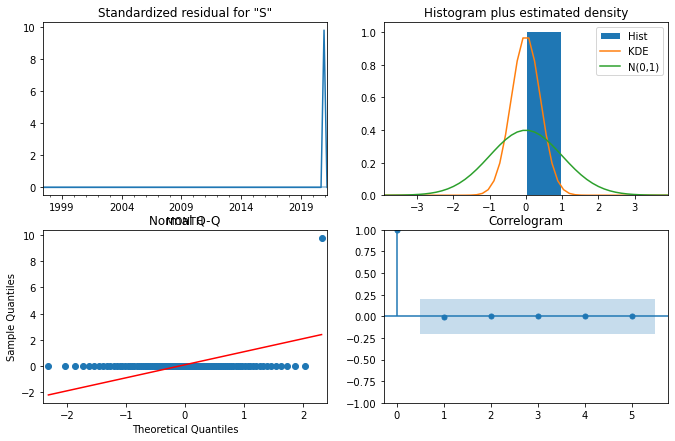

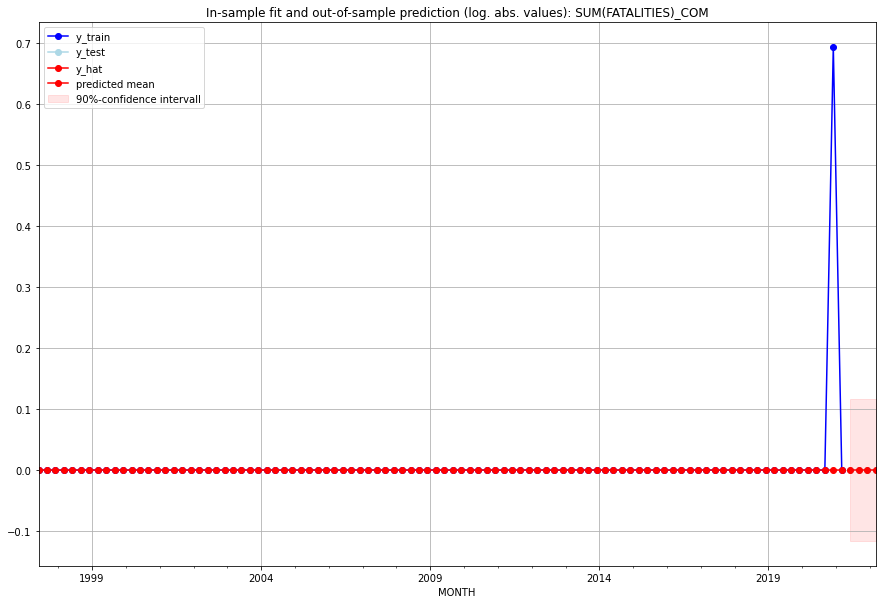

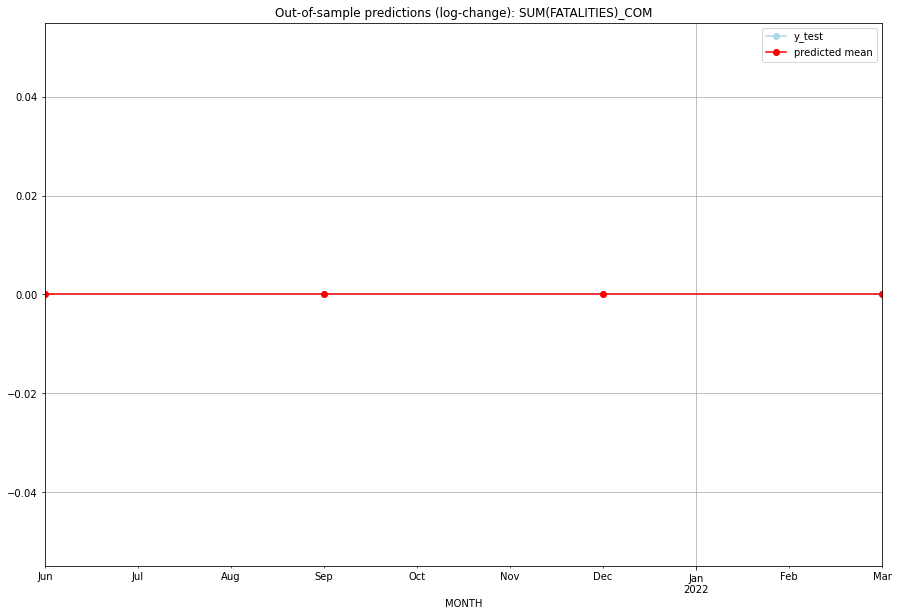

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   COM   
1 2021-07-01       0.0         0.0           0.0             0.0   COM   
2 2021-10-01       0.0         0.0           0.0             0.0   COM   
3 2022-01-01       0.0         0.0           0.0             0.0   COM   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## CPV (49/234) #########
0
Neighbor countries: []
Getting Data for CPV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-

<Figure size 432x288 with 0 Axes>

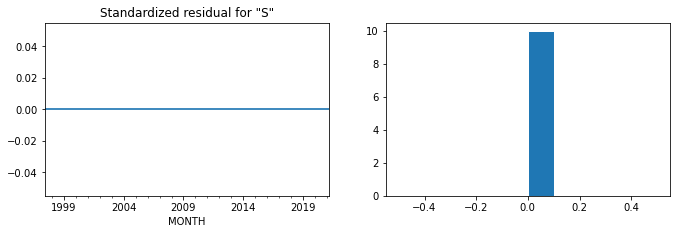

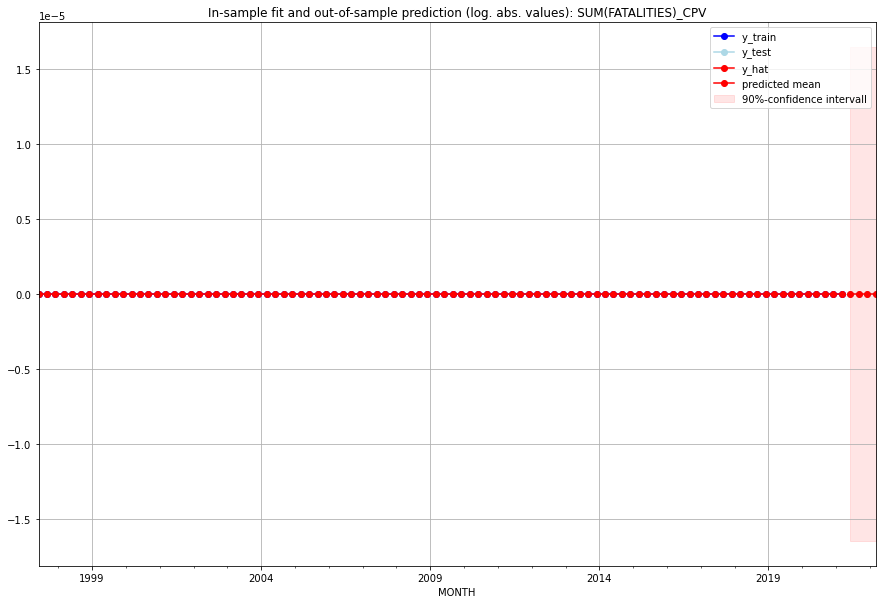

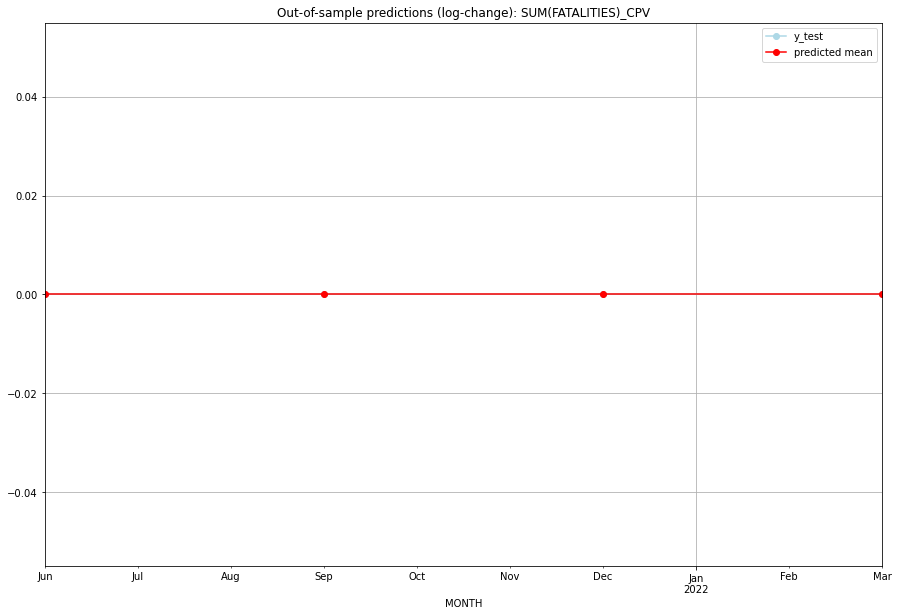

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CPV   
1 2021-07-01       0.0         0.0           0.0             0.0   CPV   
2 2021-10-01       0.0         0.0           0.0             0.0   CPV   
3 2022-01-01       0.0         0.0           0.0             0.0   CPV   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:04
######## CRI (50/234) #########
0
Neighbor countries: ['NIC', 'PAN']
Getting Data for CRI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 16)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.7472283371510894, 'fold_results': [1.0102229268998546, 0.48423374740232417]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CRI   No. Observations:                   13
Model:                SARIMAX(0, 0, 3)   Log Likelihood                 -14.486
Date:                 Wed, 19 Oct 2022   AIC                             40.971
Time:                         10:31:06   BIC                             44.361
Sample:                     01-31-2018   HQIC                            40.274
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0561      0

<Figure size 432x288 with 0 Axes>

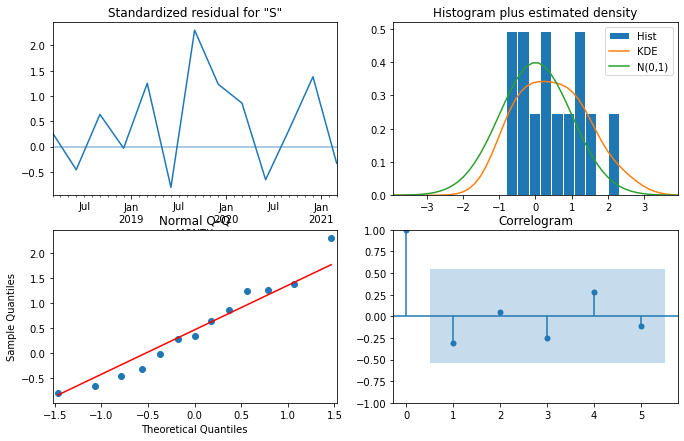

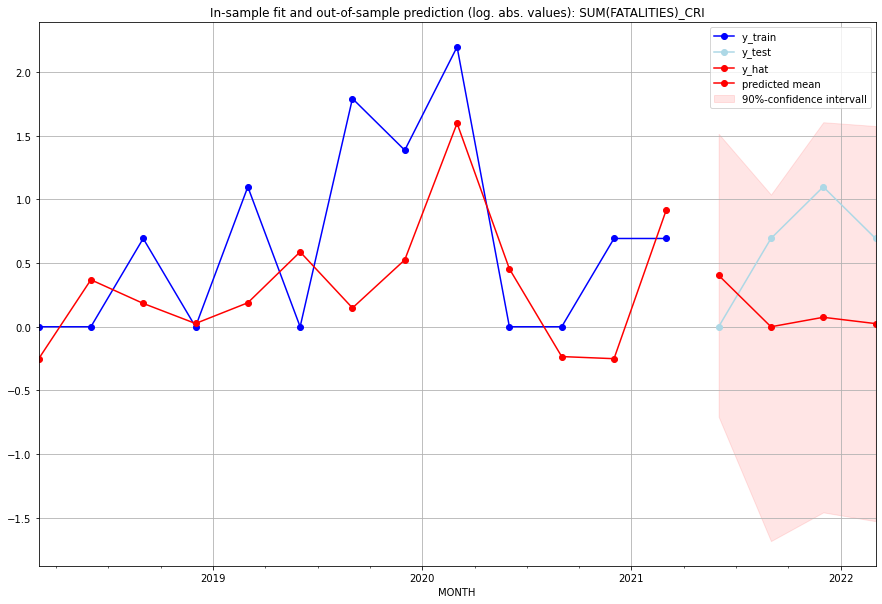

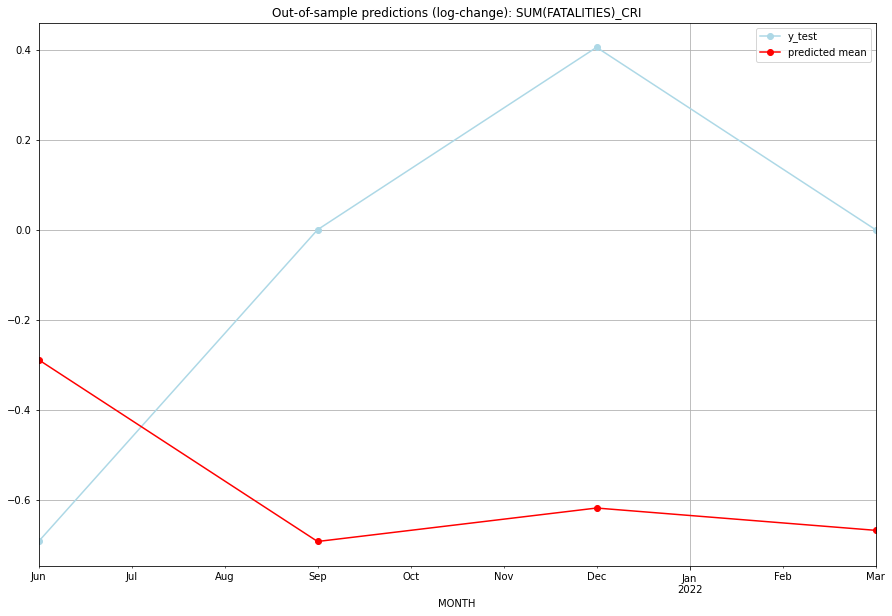

TADDA: 0.8521390671017414
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.497912         0.0     -0.289075       -0.693147   CRI   
1 2021-07-01  0.000000         1.0     -0.693147        0.000000   CRI   
2 2021-10-01  0.077218         2.0     -0.618766        0.405465   CRI   
3 2022-01-01  0.025117         1.0     -0.668341        0.000000   CRI   

                                          PARAMETERS  
0  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## CUB (51/234) #########
0
Neighbor countries: []
Getting Data for CUB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3106133312235001, 'fold_results': [0.34657359027997264, 0.2746530721670275]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CUB   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -10.086
Date:                 Wed, 19 Oct 2022   AIC                             22.172
Time:                         10:31:10   BIC                             22.657
Sample:                     01-31-2018   HQIC                            21.993
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3145      0

<Figure size 432x288 with 0 Axes>

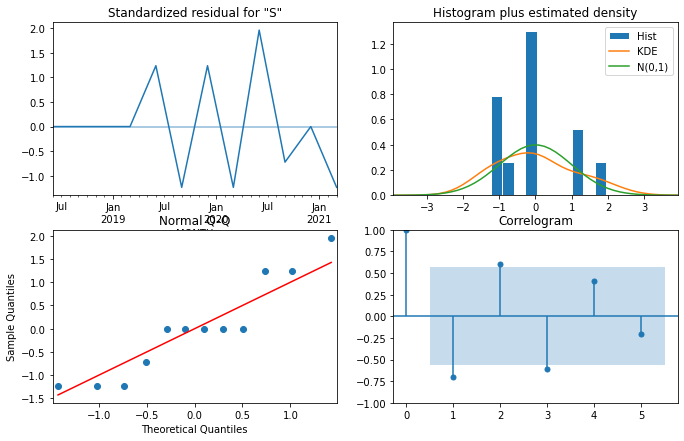

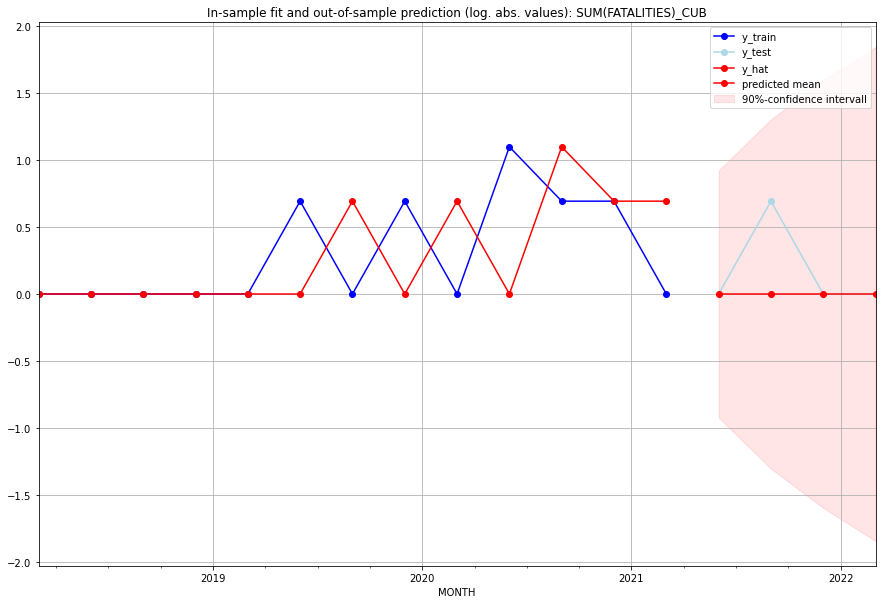

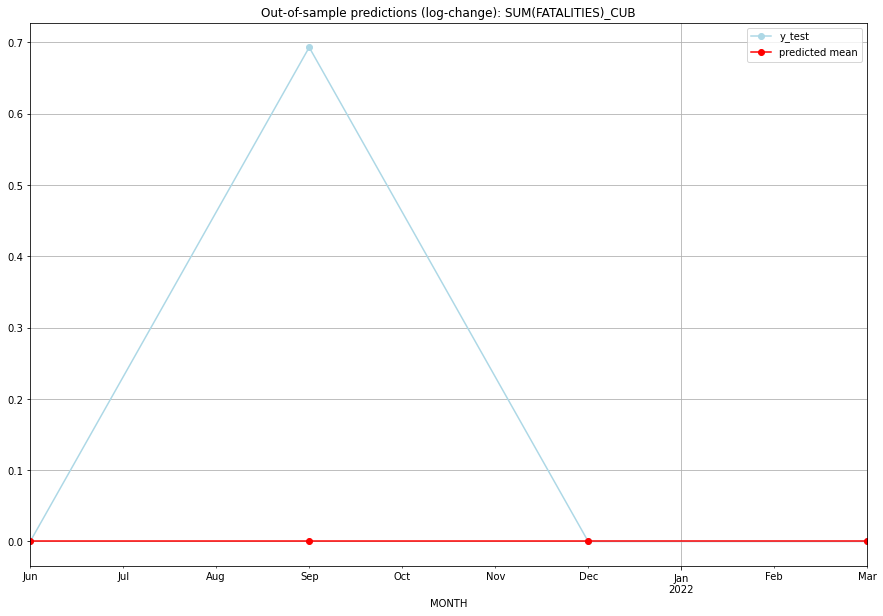

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   CUB   
1 2021-07-01       0.0         1.0           0.0        0.693147   CUB   
2 2021-10-01       0.0         0.0           0.0        0.000000   CUB   
3 2022-01-01       0.0         0.0           0.0        0.000000   CUB   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## CUW (52/234) #########
0
Neighbor countries: []
Getting Data for CUW
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV neces

<Figure size 432x288 with 0 Axes>

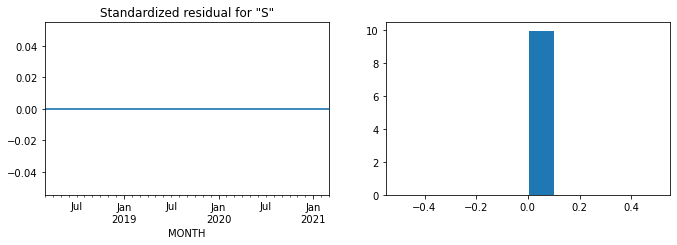

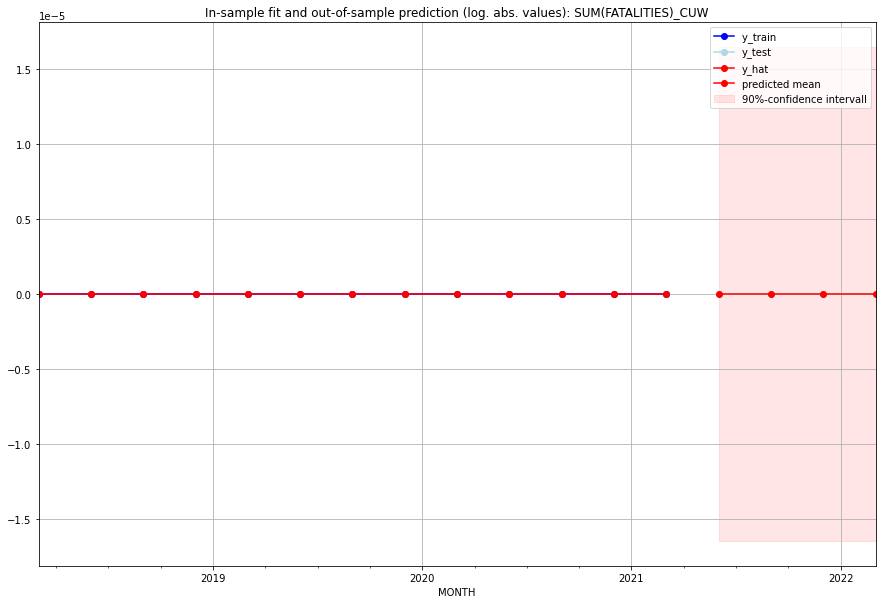

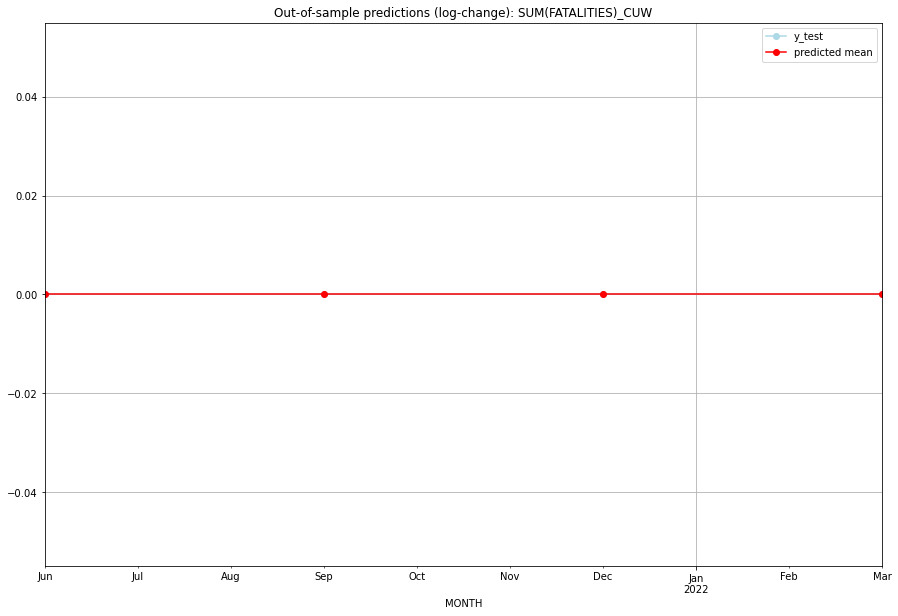

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CUW   
1 2021-07-01       0.0         0.0           0.0             0.0   CUW   
2 2021-10-01       0.0         0.0           0.0             0.0   CUW   
3 2022-01-01       0.0         0.0           0.0             0.0   CUW   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:05
######## CYM (53/234) #########
0
Neighbor countries: []
Getting Data for CYM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (13, 0)
y: (13, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CYM   No. Observations:                    9
Model:      

<Figure size 432x288 with 0 Axes>

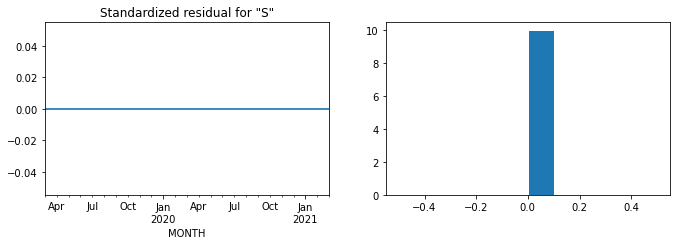

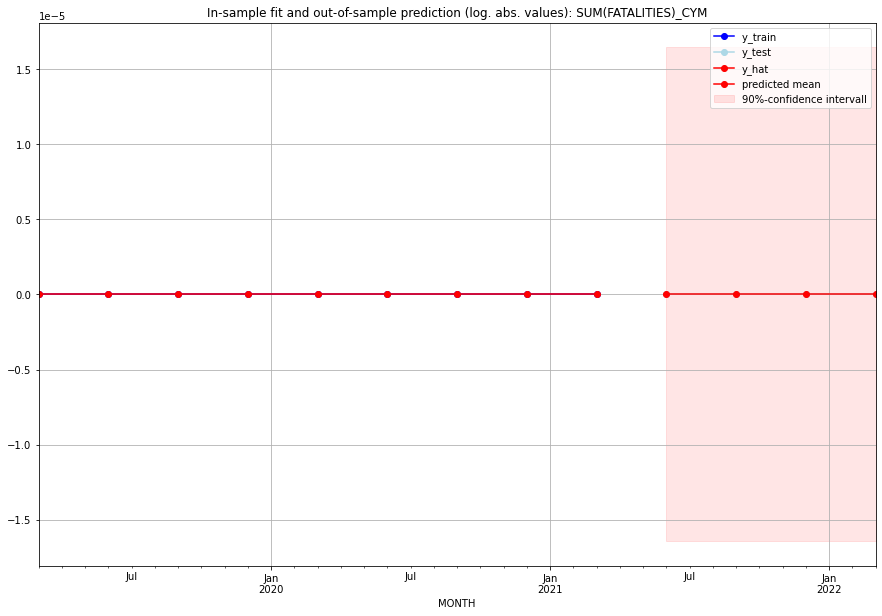

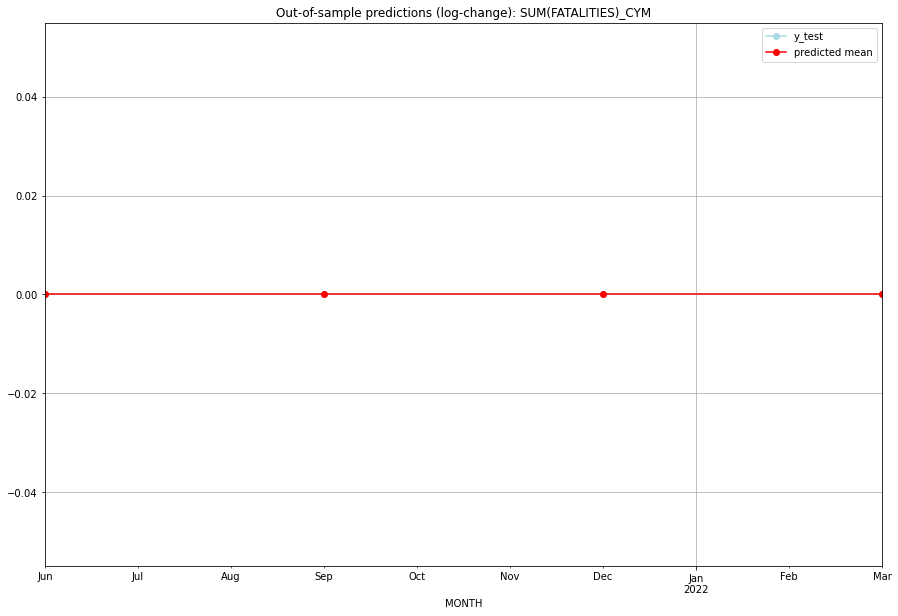

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CYM   
1 2021-07-01       0.0         0.0           0.0             0.0   CYM   
2 2021-10-01       0.0         0.0           0.0             0.0   CYM   
3 2022-01-01       0.0         0.0           0.0             0.0   CYM   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## CYP (54/234) #########
0
Neighbor countries: ['XNC']
Getting Data for CYP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 8)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CYP   No. Observations:                   13
Model: 

<Figure size 432x288 with 0 Axes>

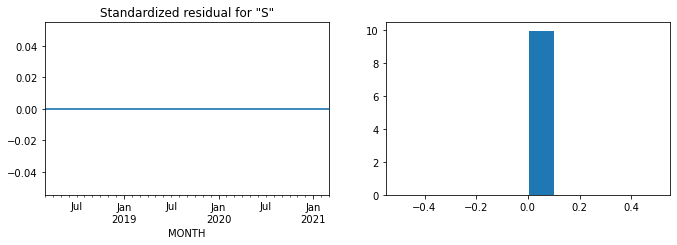

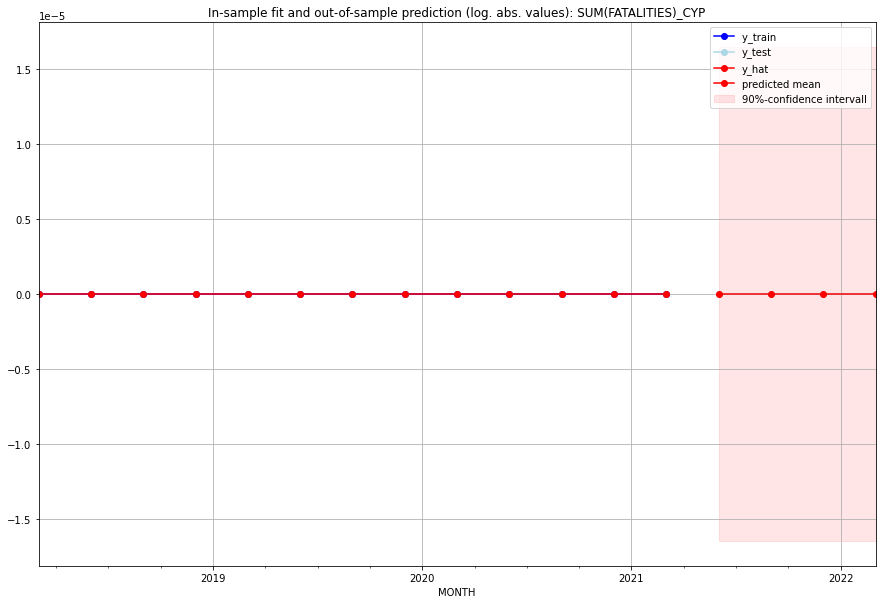

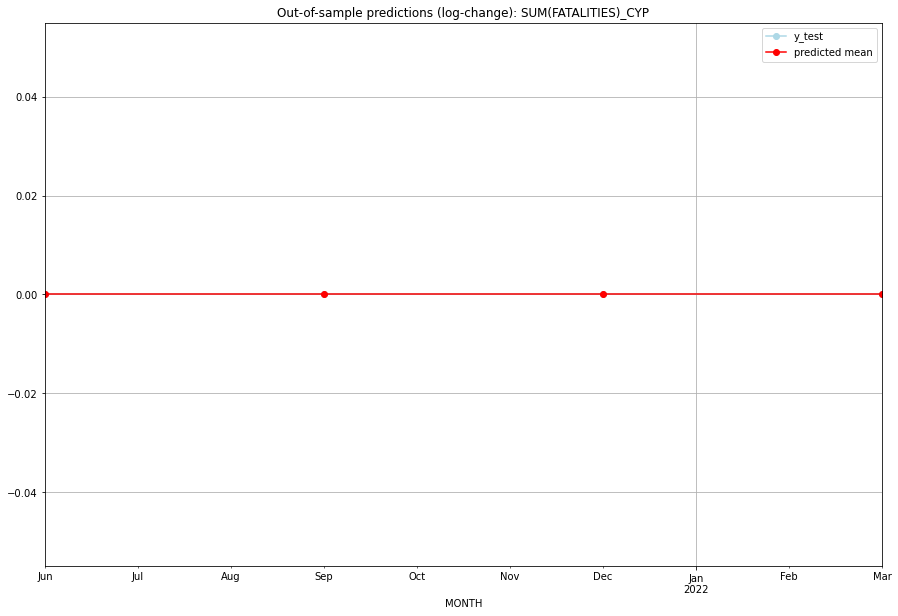

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CYP   
1 2021-07-01       0.0         0.0           0.0             0.0   CYP   
2 2021-10-01       0.0         0.0           0.0             0.0   CYP   
3 2022-01-01       0.0         0.0           0.0             0.0   CYP   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## CZE (55/234) #########
0
Neighbor countries: ['DEU', 'SVK', 'AUT', 'POL']
Getting Data for CZE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 32)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


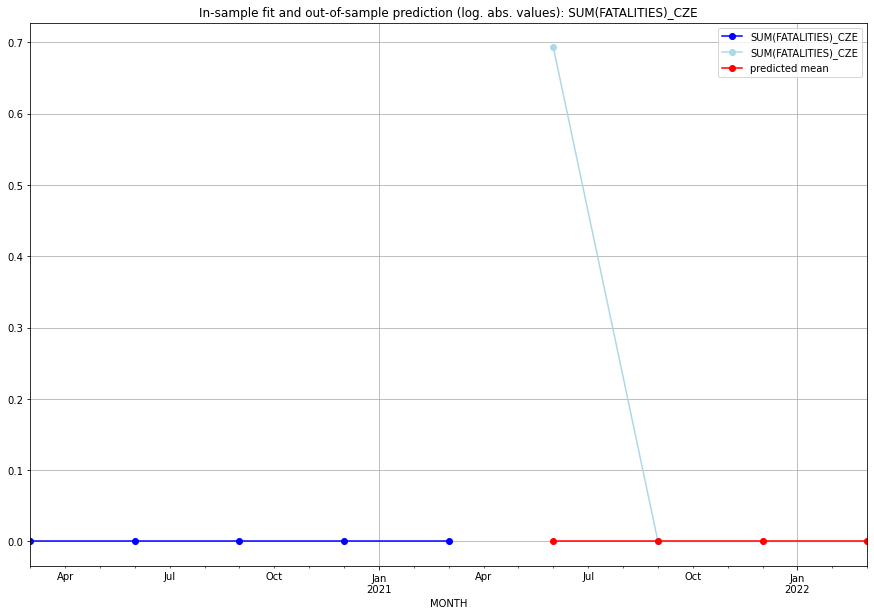

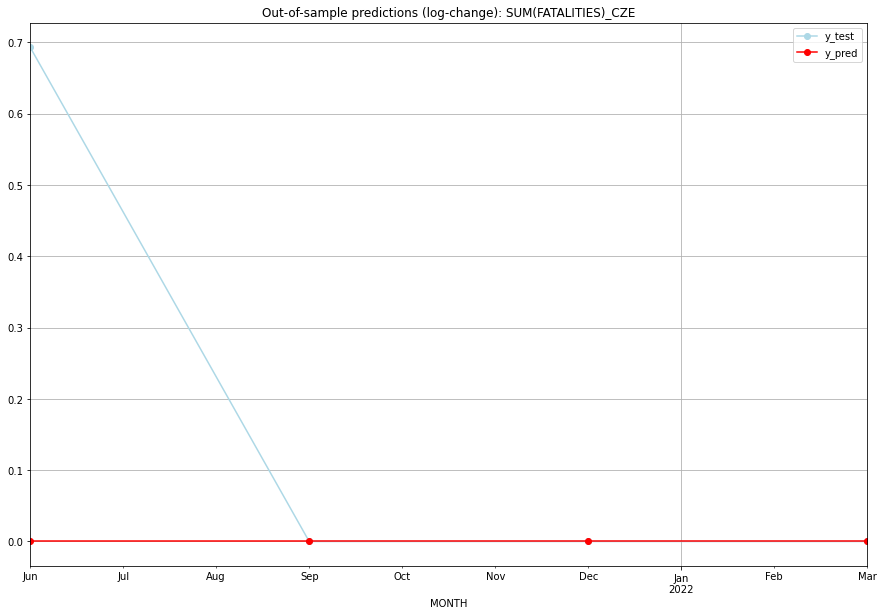

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.693147           0.0        0.693147   CZE   
1 2021-07-01       0.0    0.000000           0.0        0.000000   CZE   
2 2021-10-01       0.0    0.000000           0.0        0.000000   CZE   
3 2022-01-01       0.0    0.000000           0.0        0.000000   CZE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## DEU (56/234) #########
0
Neighbor countries: ['BEL', 'NLD', 'FRA', 'LUX', 'CZE', 'POL', 'DNK', 'AUT', 'CHE']
Getting Data for DEU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 72)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


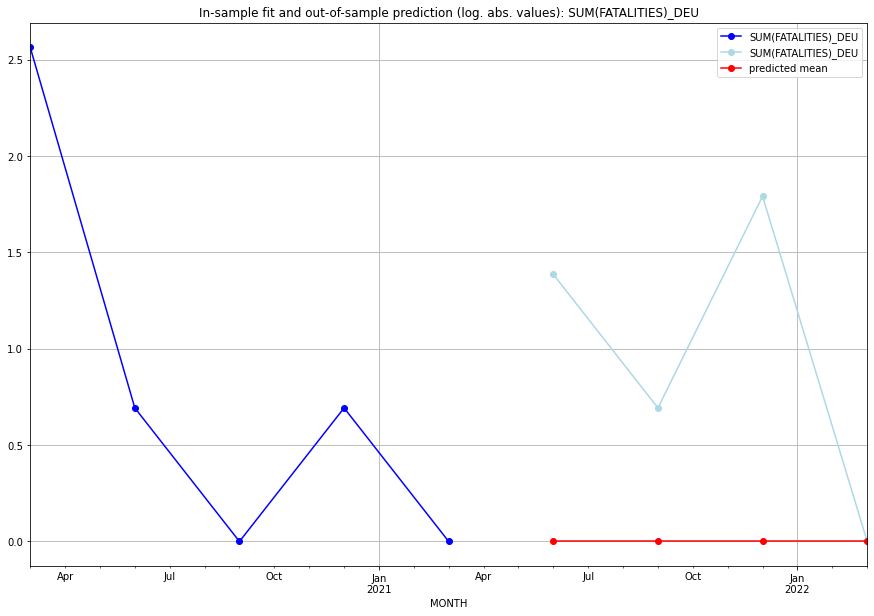

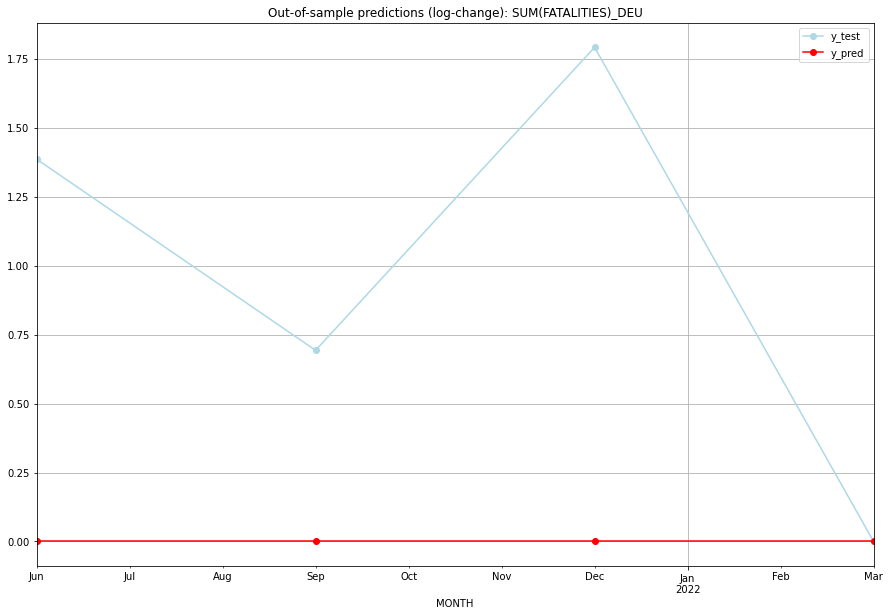

TADDA: 0.9678002527269727
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    1.386294           0.0        1.386294   DEU   
1 2021-07-01       0.0    0.693147           0.0        0.693147   DEU   
2 2021-10-01       0.0    1.791759           0.0        1.791759   DEU   
3 2022-01-01       0.0    0.000000           0.0        0.000000   DEU   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:06
######## DJI (57/234) #########
0
Neighbor countries: ['ETH', 'SOM', 'ERI']
Getting Data for DJI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.10397207708399178, 'fold_results': [0.0, 0.0, 0.0, 0.5198603854199589, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DJI   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -101.745
Date:                 Wed, 19 Oct 2022   AIC                            205.489
Time:                         10:31:56   BIC                            208.054
Sample:                     04-30-1997   HQIC                           206.526
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.4876      0

<Figure size 432x288 with 0 Axes>

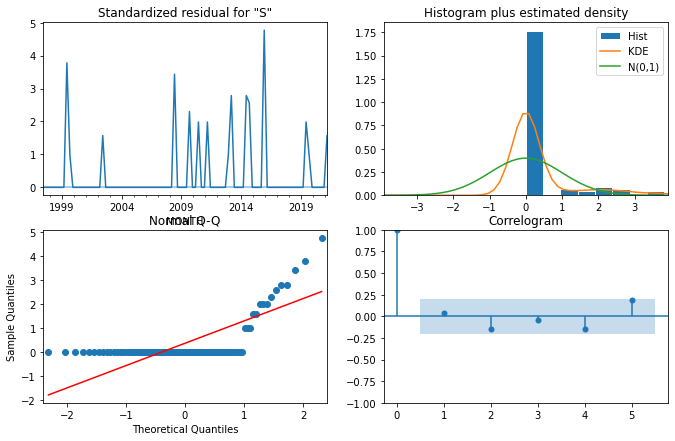

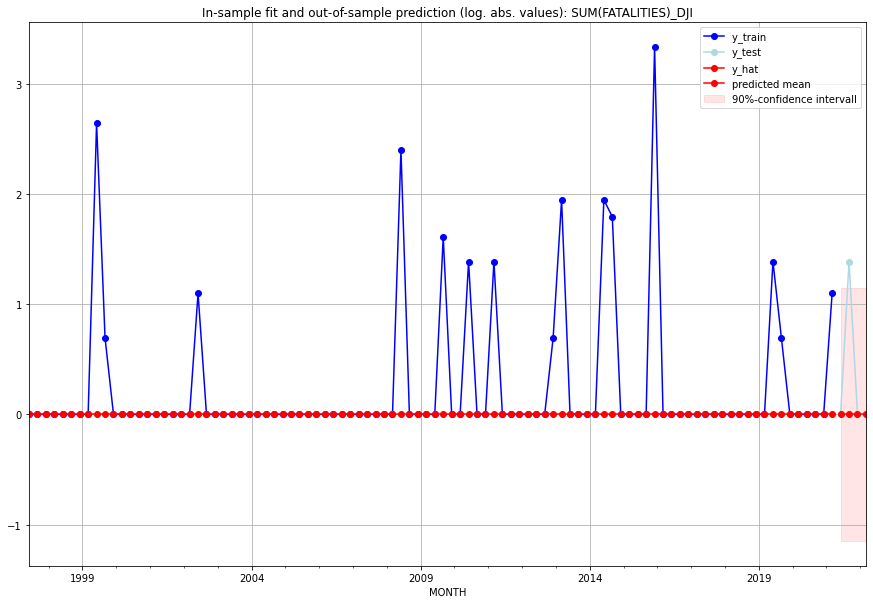

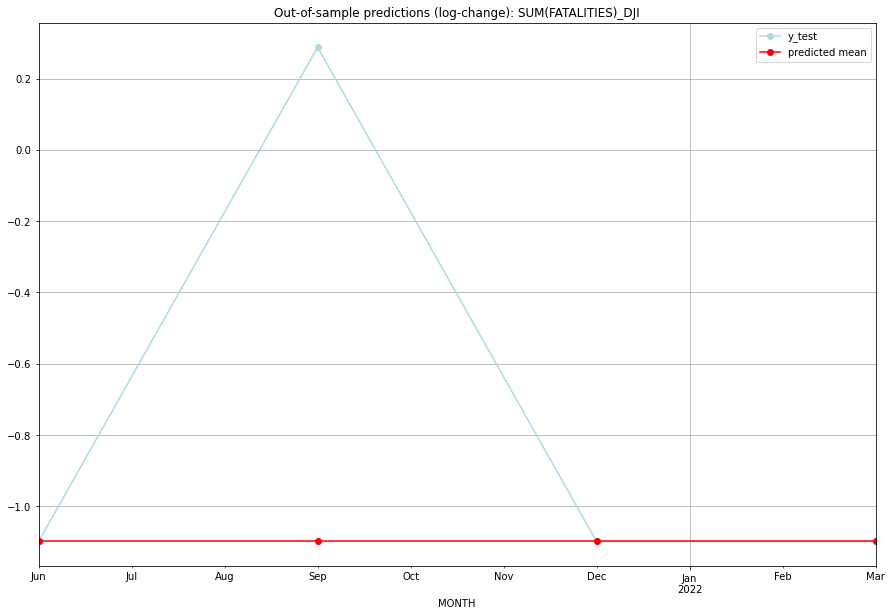

TADDA: 0.6212266624470001
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -1.098612       -1.098612   DJI   
1 2021-07-01       0.0         3.0     -1.098612        0.287682   DJI   
2 2021-10-01       0.0         0.0     -1.098612       -1.098612   DJI   
3 2022-01-01       0.0         0.0     -1.098612       -1.098612   DJI   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## DMA (58/234) #########
0
Neighbor countries: []
Getting Data for DMA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08664339756999316, 'fold_results': [0.17328679513998632, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DMA   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:32:03   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.24

<Figure size 432x288 with 0 Axes>

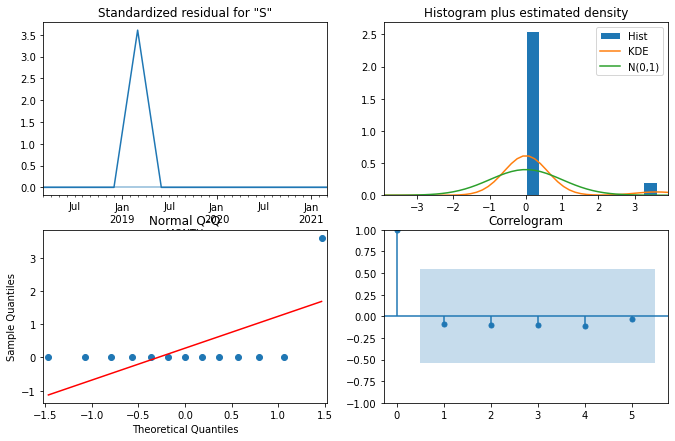

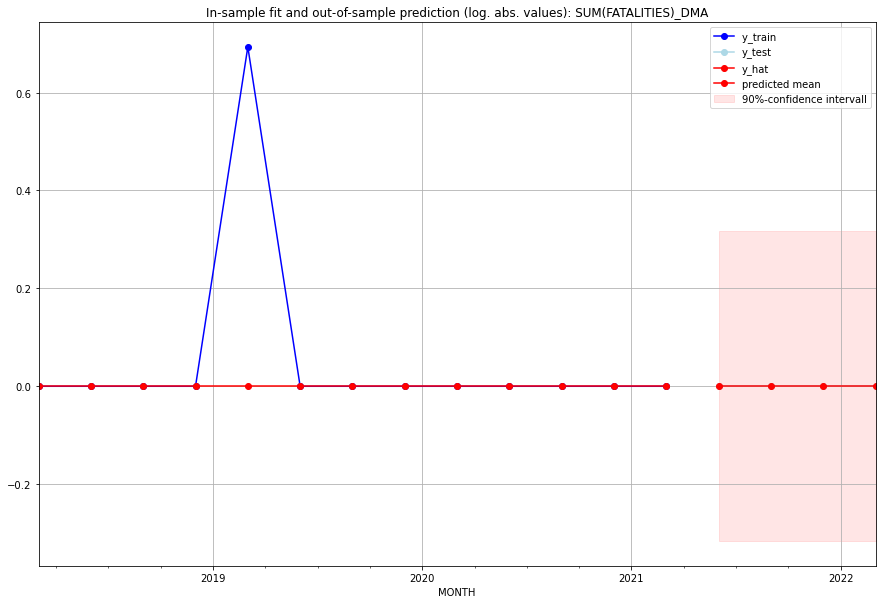

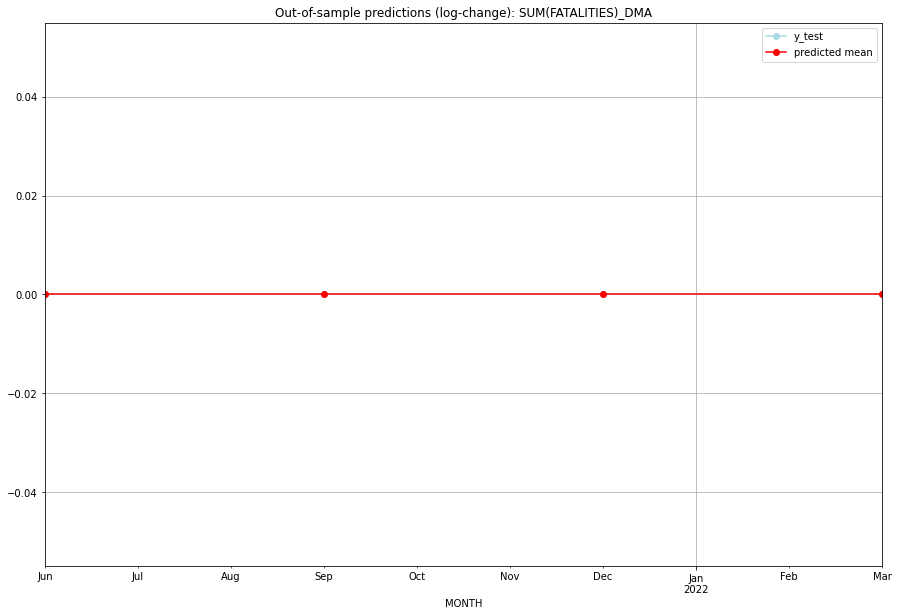

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   DMA   
1 2021-07-01       0.0         0.0           0.0             0.0   DMA   
2 2021-10-01       0.0         0.0           0.0             0.0   DMA   
3 2022-01-01       0.0         0.0           0.0             0.0   DMA   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## DNK (59/234) #########
0
Neighbor countries: ['DEU']
Getting Data for DNK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cros

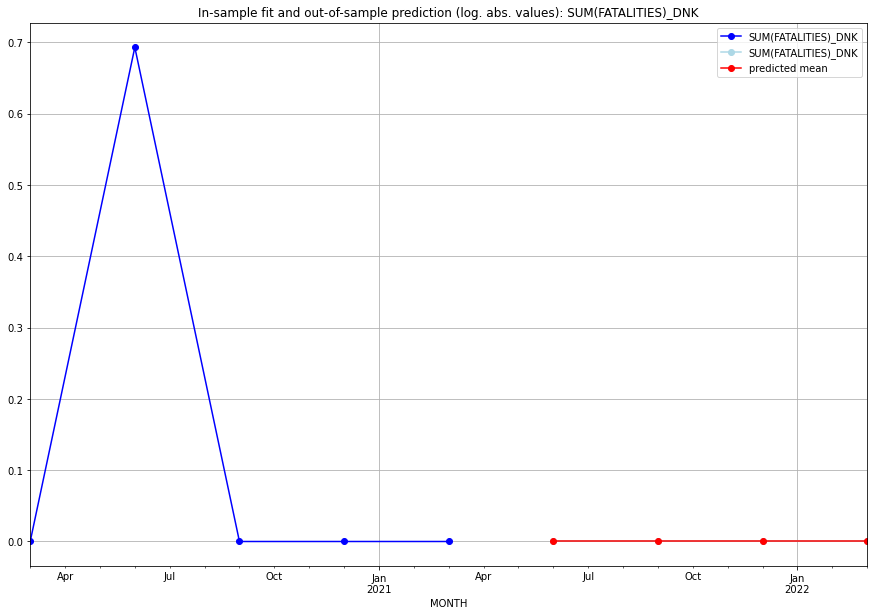

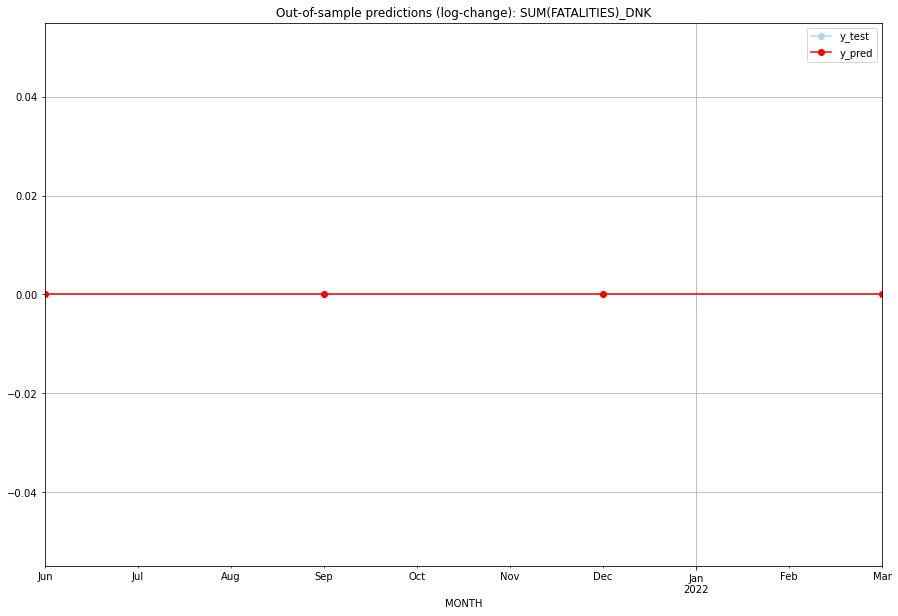

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   DNK   
1 2021-07-01       0.0         0.0           0.0             0.0   DNK   
2 2021-10-01       0.0         0.0           0.0             0.0   DNK   
3 2022-01-01       0.0         0.0           0.0             0.0   DNK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## DOM (60/234) #########
0
Neighbor countries: ['HTI']
Getting Data for DOM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 8)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.042692853315589585, 'fold_results': [0.042692853315589585, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DOM   No. Observations:                   13
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -9.606
Date:                 Wed, 19 Oct 2022   AIC                             29.213
Time:                         10:32:22   BIC                             32.037
Sample:                     01-31-2018   HQIC                            28.632
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.1300      0.529      2.

<Figure size 432x288 with 0 Axes>

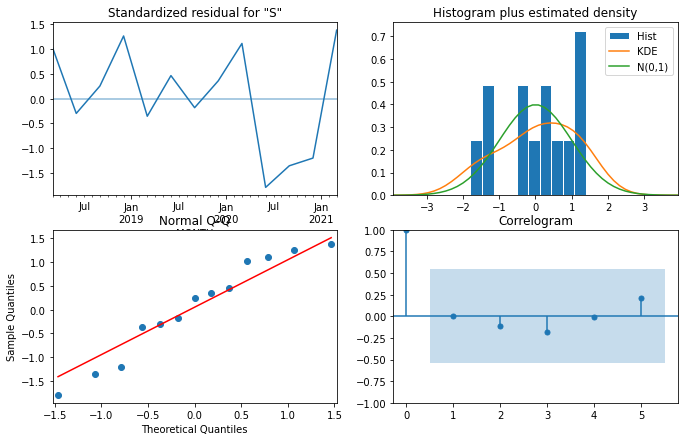

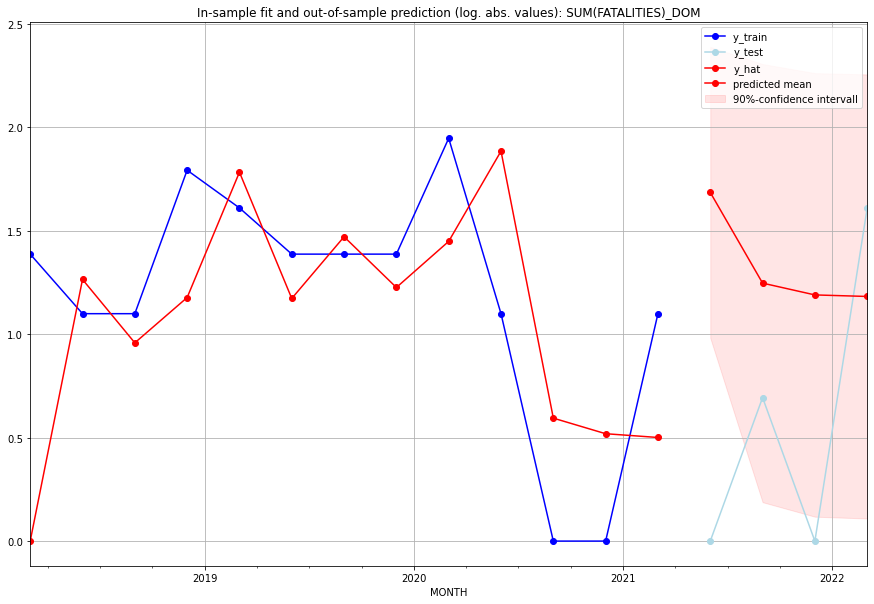

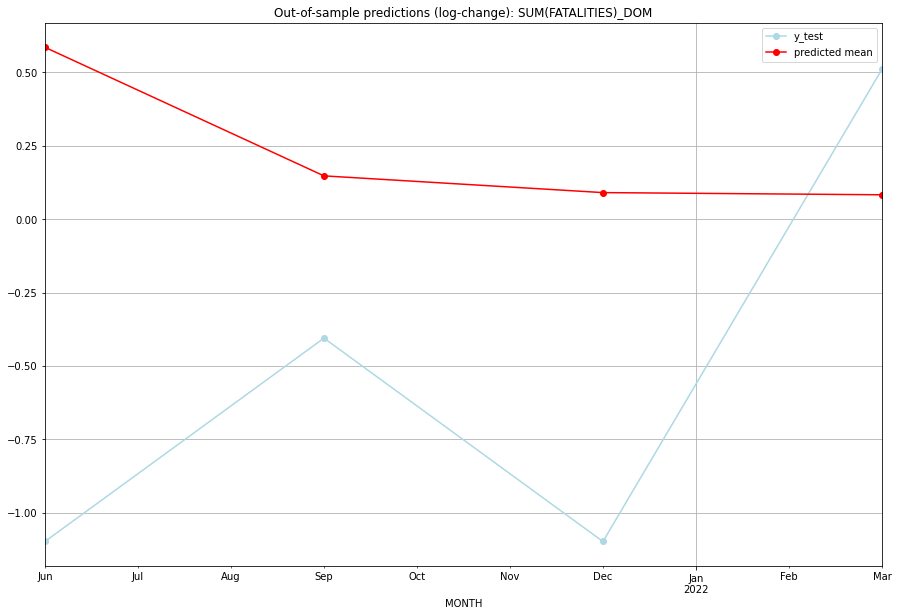

TADDA: 1.1695987990158212
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  4.389392         0.0      0.585820       -1.098612   DOM   
1 2021-07-01  2.477167         1.0      0.147606       -0.405465   DOM   
2 2021-10-01  2.284499         0.0      0.090602       -1.098612   DOM   
3 2022-01-01  2.260200         4.0      0.083176        0.510826   DOM   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## DZA (61/234) #########
0
Neighbor countries: ['TUN', 'MLI', 'MRT', 'LBY', 'NER', 'MAR', 'ESH']
Getting Data for DZA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 56)
y: (100, 1)
------------------------------------------------
Tra

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5770516427951243, 'fold_results': [0.6314321610770641, 0.9116659600151598, 0.49990888710286907, 0.6061358035703155, 0.2361154022102132]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DZA   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -109.174
Date:                 Wed, 19 Oct 2022   AIC                            220.349
Time:                         10:32:44   BIC                            222.903
Sample:                     04-30-1997   HQIC                           221.381
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

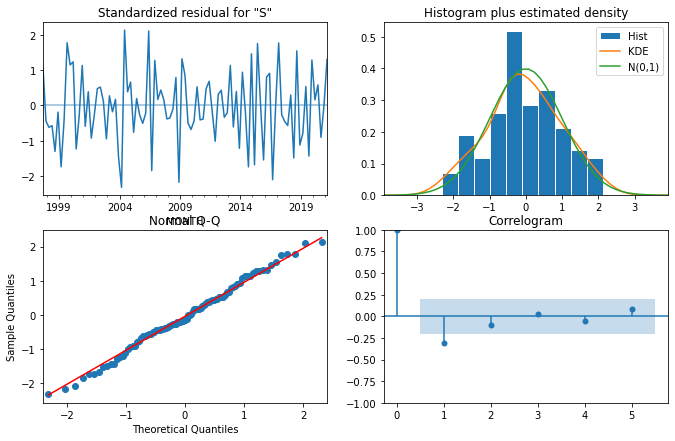

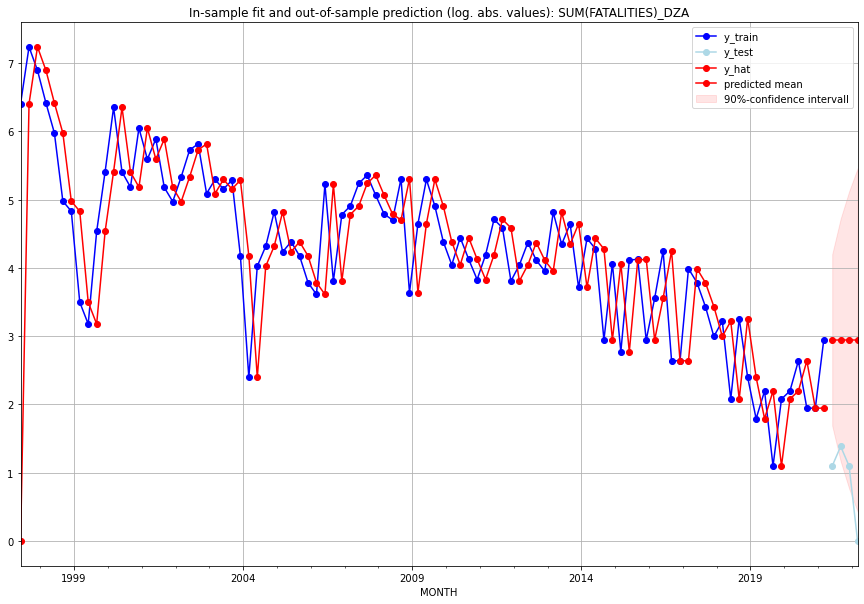

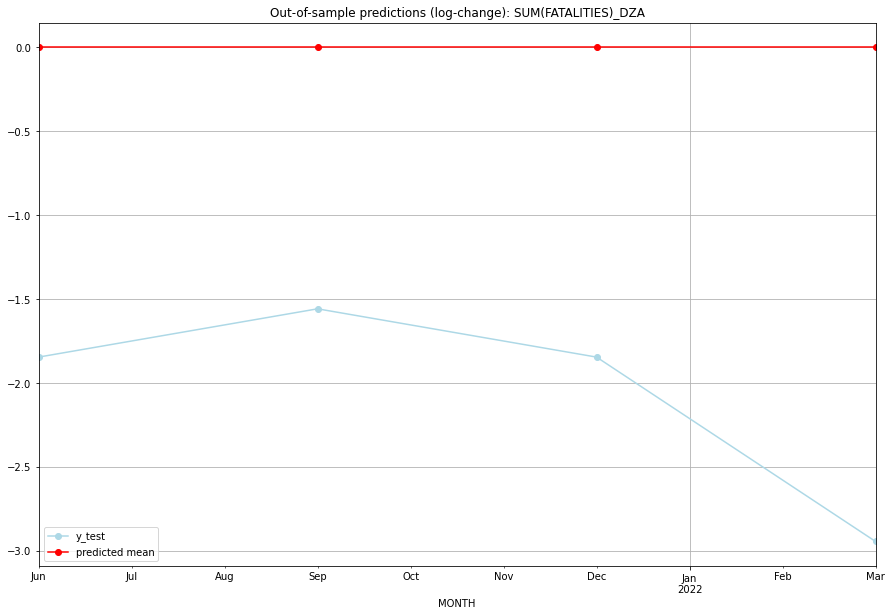

TADDA: 2.048559244552413
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      18.0         2.0           0.0       -1.845827   DZA   
1 2021-07-01      18.0         3.0           0.0       -1.558145   DZA   
2 2021-10-01      18.0         2.0           0.0       -1.845827   DZA   
3 2022-01-01      18.0         0.0           0.0       -2.944439   DZA   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## ECU (62/234) #########
0
Neighbor countries: ['PER', 'COL']
Getting Data for ECU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 16)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.34673949757785305, 'fold_results': [0.34673949757785305, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ECU   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -10.114
Date:                 Wed, 19 Oct 2022   AIC                             38.227
Time:                         10:32:54   BIC                             43.312
Sample:                     01-31-2018   HQIC                            37.182
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0980      0.151     -0.65

<Figure size 432x288 with 0 Axes>

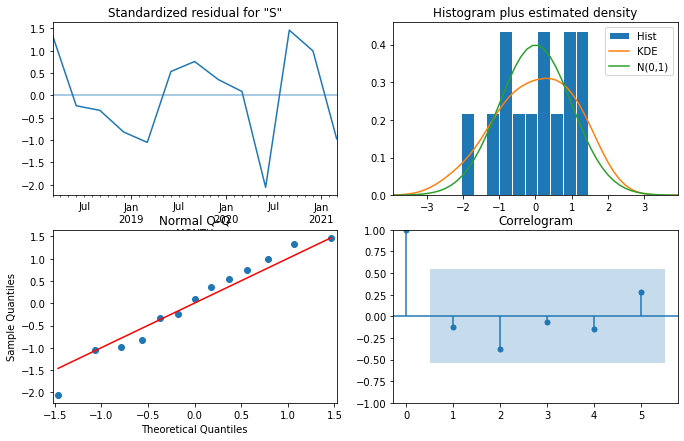

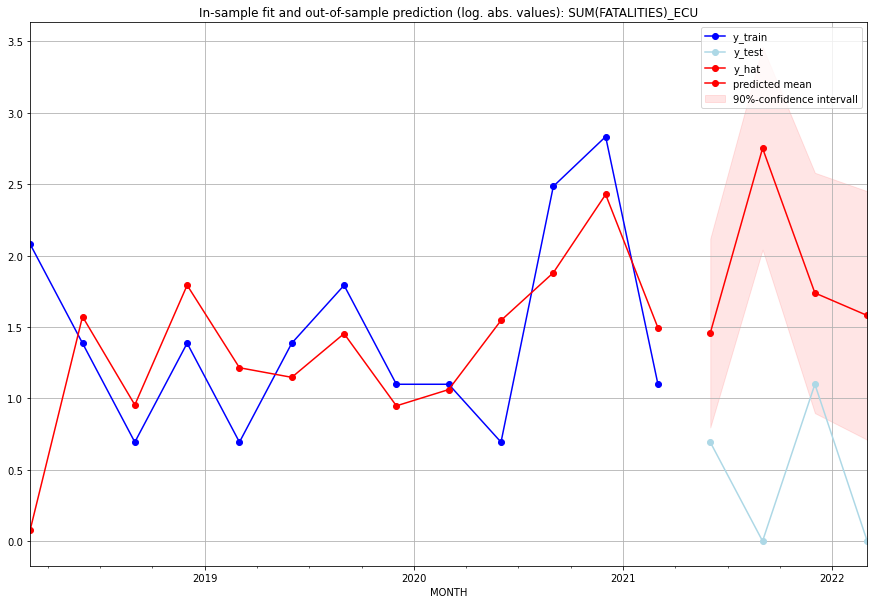

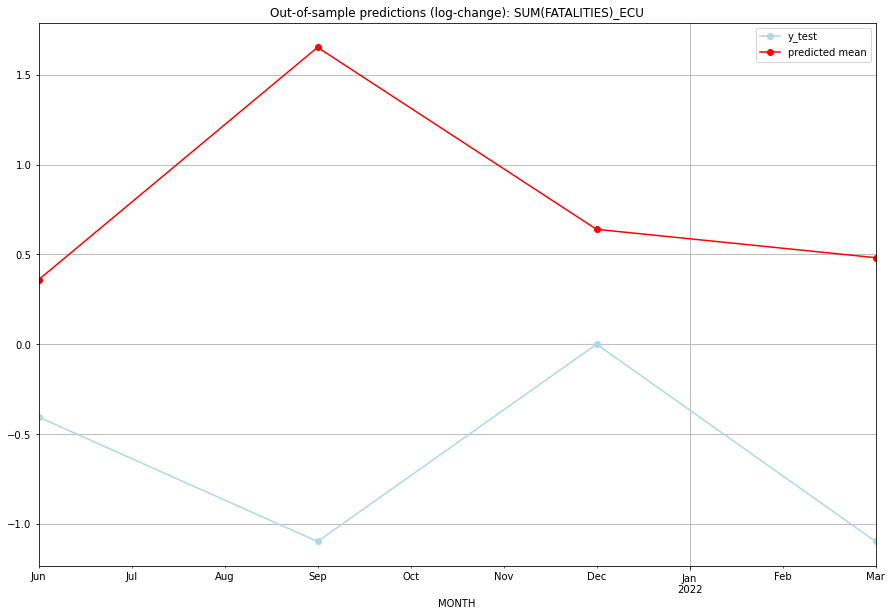

TADDA: 2.057609654229701
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   3.295616         1.0      0.358983       -0.405465   ECU   
1 2021-07-01  14.671053         0.0      1.653203       -1.098612   ECU   
2 2021-10-01   4.687498         2.0      0.639658        0.000000   ECU   
3 2022-01-01   3.857248         0.0      0.481860       -1.098612   ECU   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## EGY (63/234) #########
0
Neighbor countries: ['LBY', 'SDN', 'ISR', 'PSE']
Getting Data for EGY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 32)
y: (100, 1)
------------------------------------------------
Training started.
St

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.23219354200681383, 'fold_results': [0.1701350037740783, 0.39930661699189884, 0.2359534470824629, 0.17443082483900985, 0.18114181734661927]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_EGY   No. Observations:                   96
Model:                SARIMAX(3, 0, 1)   Log Likelihood                -159.049
Date:                 Wed, 19 Oct 2022   AIC                            332.098
Time:                         10:33:14   BIC                            350.049
Sample:                     04-30-1997   HQIC                           339.354
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------

<Figure size 432x288 with 0 Axes>

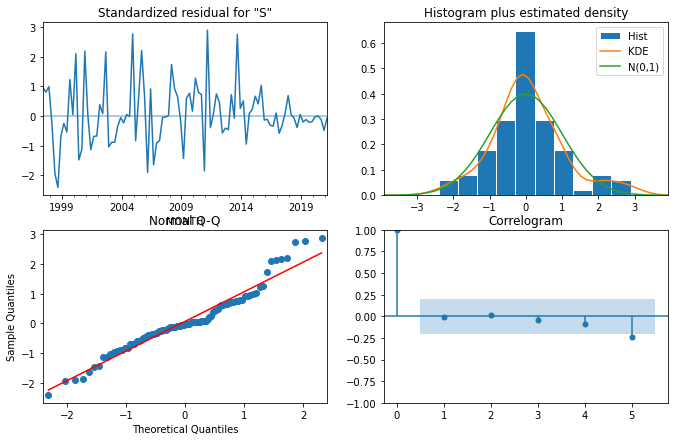

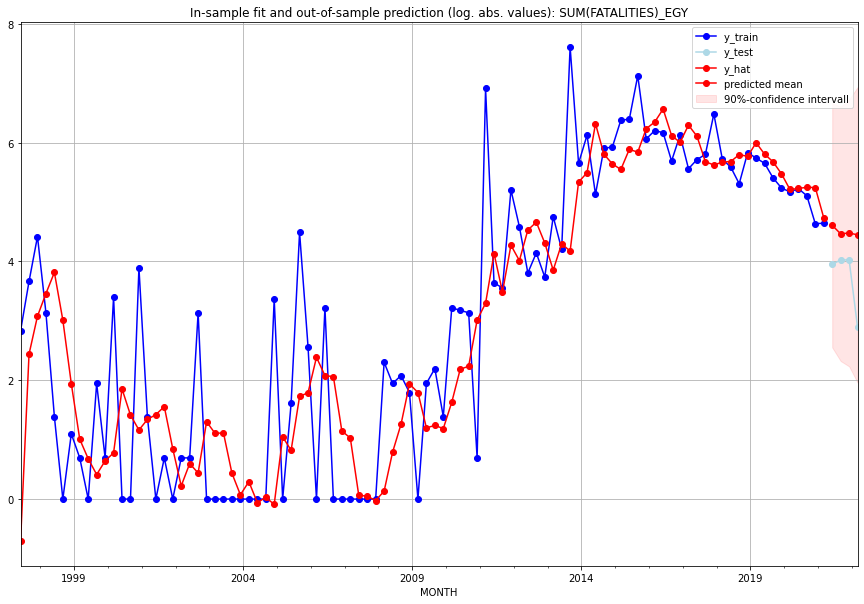

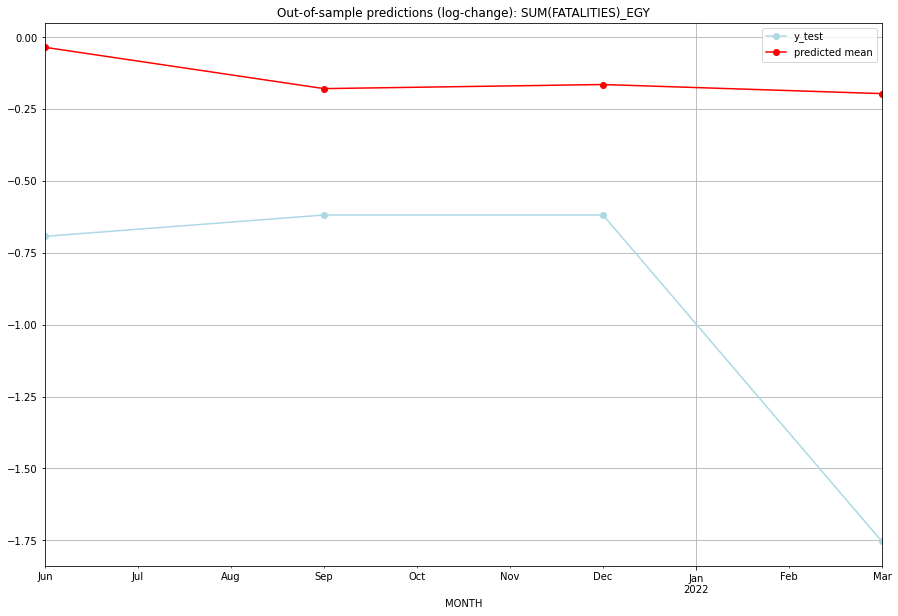

TADDA: 0.7767552650158143
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  99.316701        51.0     -0.036059       -0.693147   EGY   
1 2021-07-01  85.897073        55.0     -0.179667       -0.619039   EGY   
2 2021-10-01  87.141906        55.0     -0.165443       -0.619039   EGY   
3 2022-01-01  84.399077        17.0     -0.197056       -1.754019   EGY   

                                          PARAMETERS  
0  {'params': [2, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## ERI (64/234) #########
0
Neighbor countries: ['ETH', 'SDN', 'DJI']
Getting Data for ERI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.42676326309645063, 'fold_results': [1.1603062752420317, 0.30222543642400035, 0.44793986730701374, 0.0, 0.22334473650920722]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ERI   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -215.023
Date:                 Wed, 19 Oct 2022   AIC                            438.047
Time:                         10:33:27   BIC                            448.304
Sample:                     04-30-1997   HQIC                           442.193
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

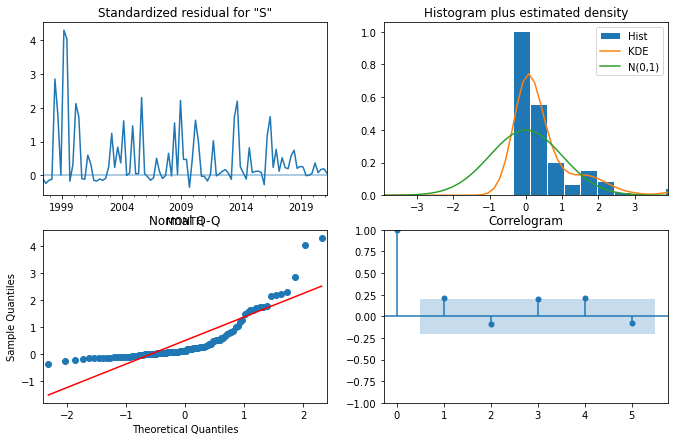

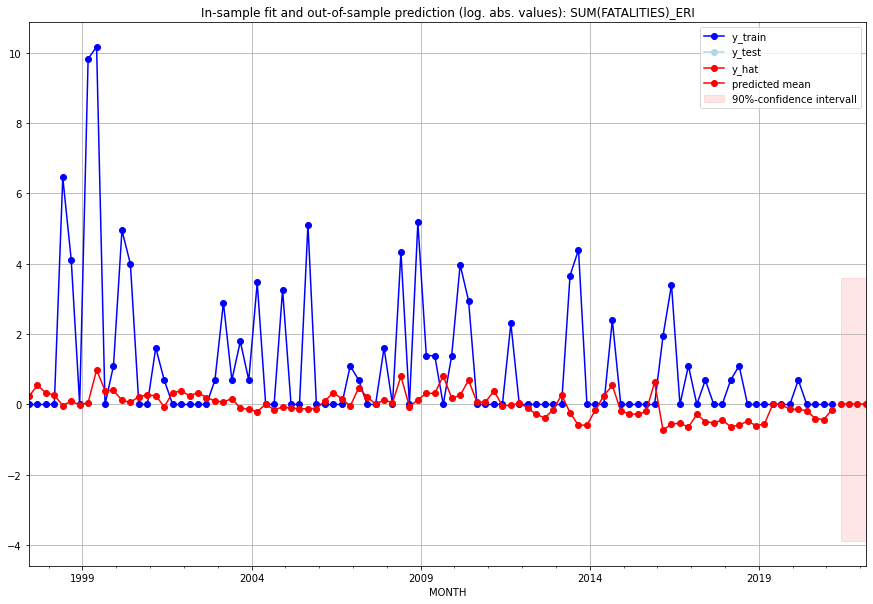

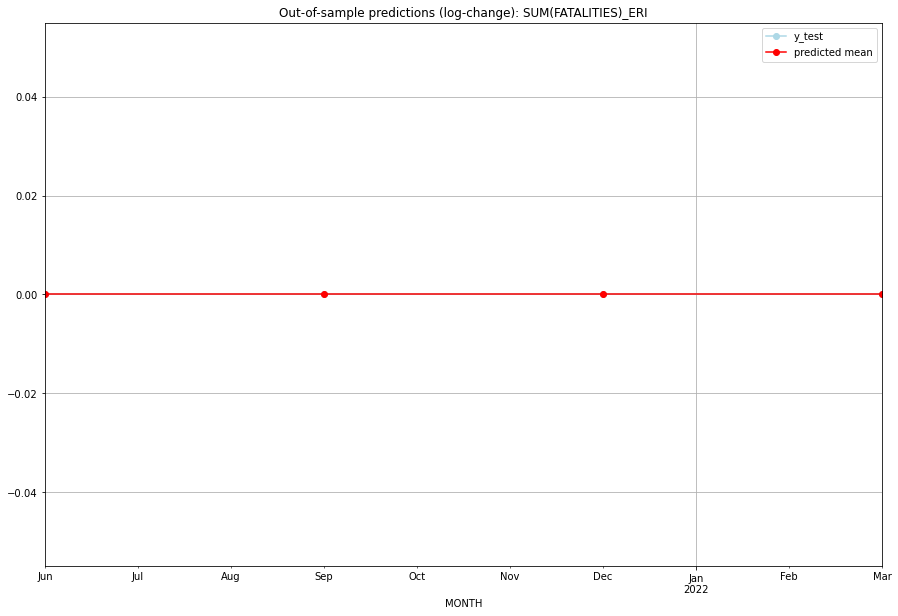

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ERI   
1 2021-07-01       0.0         0.0           0.0             0.0   ERI   
2 2021-10-01       0.0         0.0           0.0             0.0   ERI   
3 2022-01-01       0.0         0.0           0.0             0.0   ERI   

                                          PARAMETERS  
0  {'params': [3, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## ESH (65/234) #########
0
Neighbor countries: ['MRT', 'DZA', 'MAR']
Getting Data for ESH
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CP

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.29740842935118755, 'fold_results': [0.5198597307213739, 0.0, 0.0, 0.44793986730701374, 0.51924254872755]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ESH   No. Observations:                   96
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -73.133
Date:                 Wed, 19 Oct 2022   AIC                            152.266
Time:                         10:33:47   BIC                            159.959
Sample:                     04-30-1997   HQIC                           155.376
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

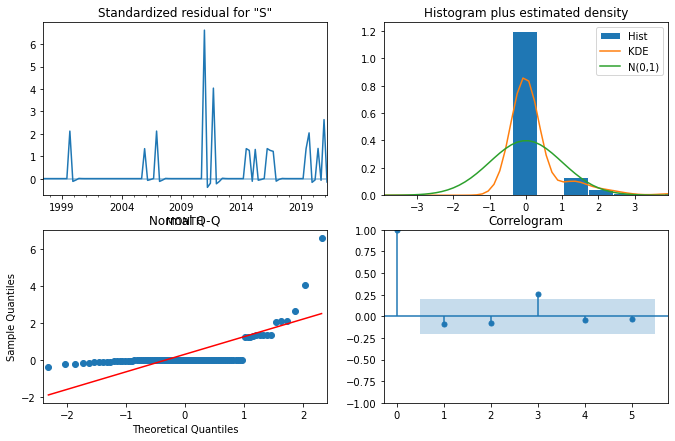

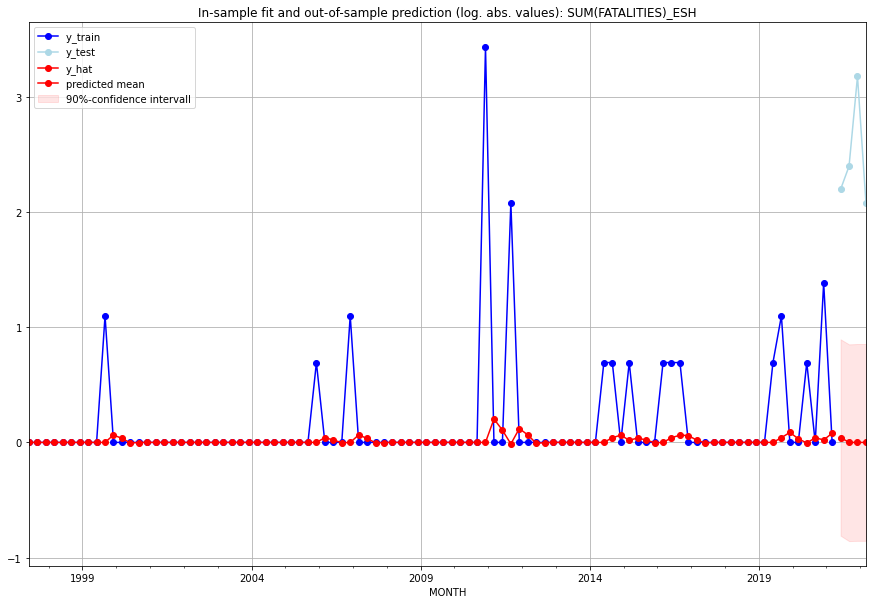

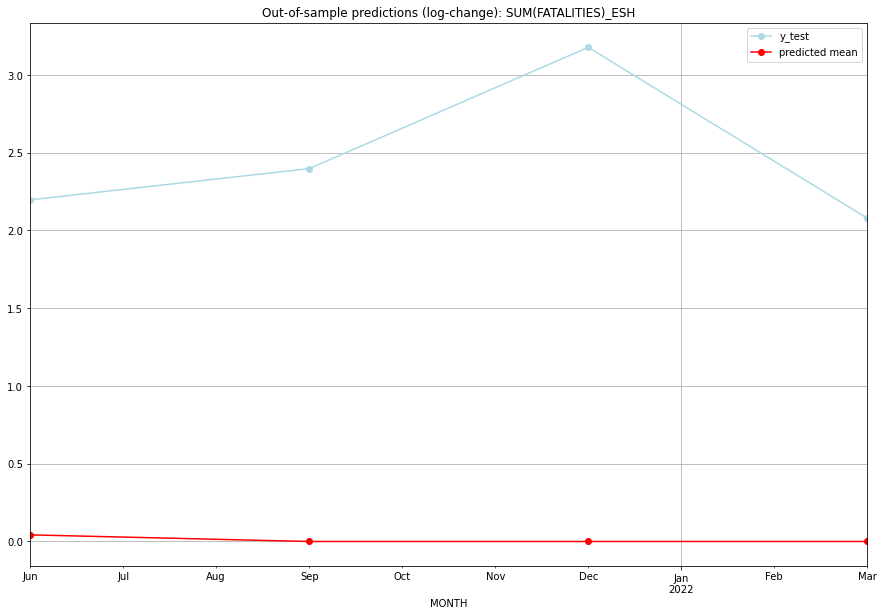

TADDA: 2.4525075792988114
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.043505         8.0      0.042585        2.197225   ESH   
1 2021-07-01  0.000000        10.0      0.000000        2.397895   ESH   
2 2021-10-01  0.000000        23.0      0.000000        3.178054   ESH   
3 2022-01-01  0.000000         7.0      0.000000        2.079442   ESH   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## ESP (66/234) #########
0
Neighbor countries: ['PRT', 'FRA', 'GIB', 'AND', 'MAR']
Getting Data for ESP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 40)
y: (9, 1)
------------------------------------------------
Training started.
Gri

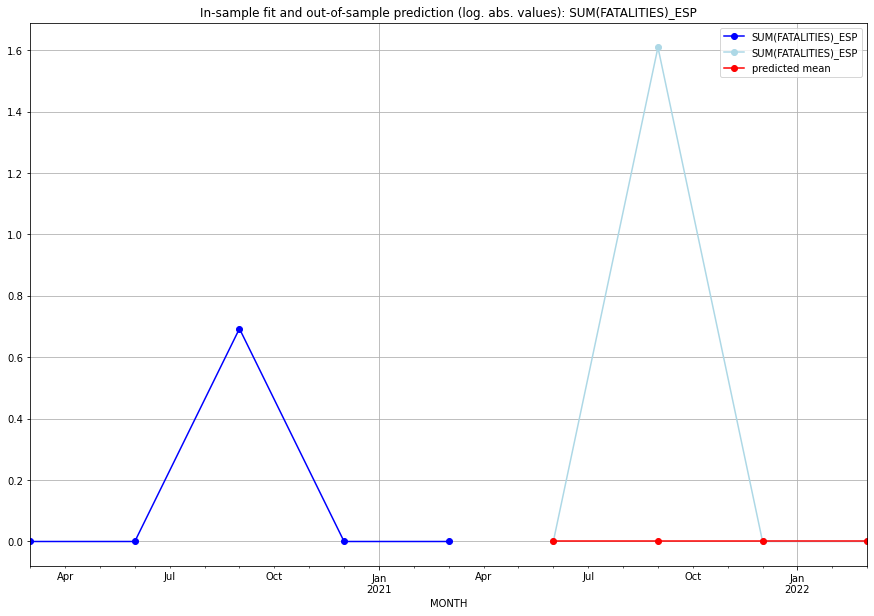

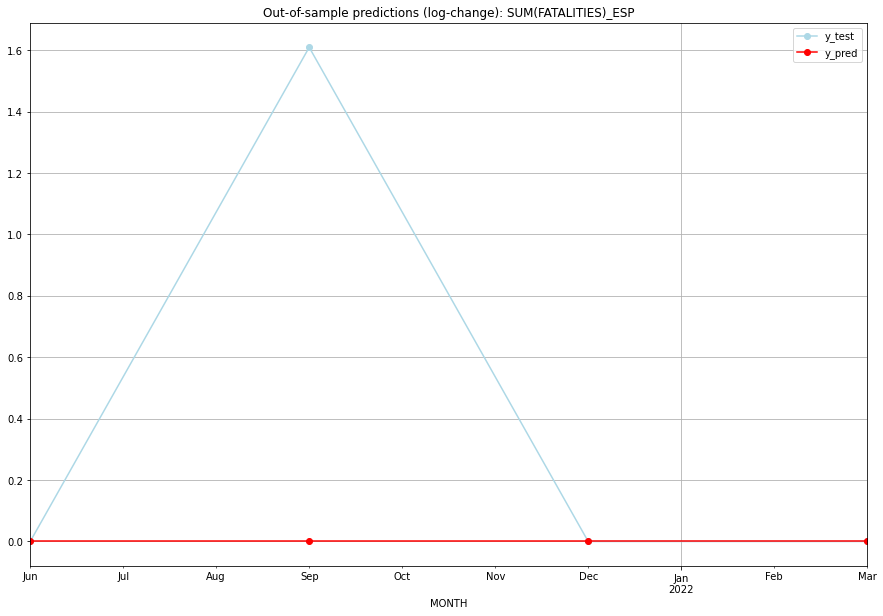

TADDA: 0.4023594781085251
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   ESP   
1 2021-07-01       0.0    1.609438           0.0        1.609438   ESP   
2 2021-10-01       0.0    0.000000           0.0        0.000000   ESP   
3 2022-01-01       0.0    0.000000           0.0        0.000000   ESP   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## EST (67/234) #########
0
Neighbor countries: ['RUS', 'LVA']
Getting Data for EST
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 16)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


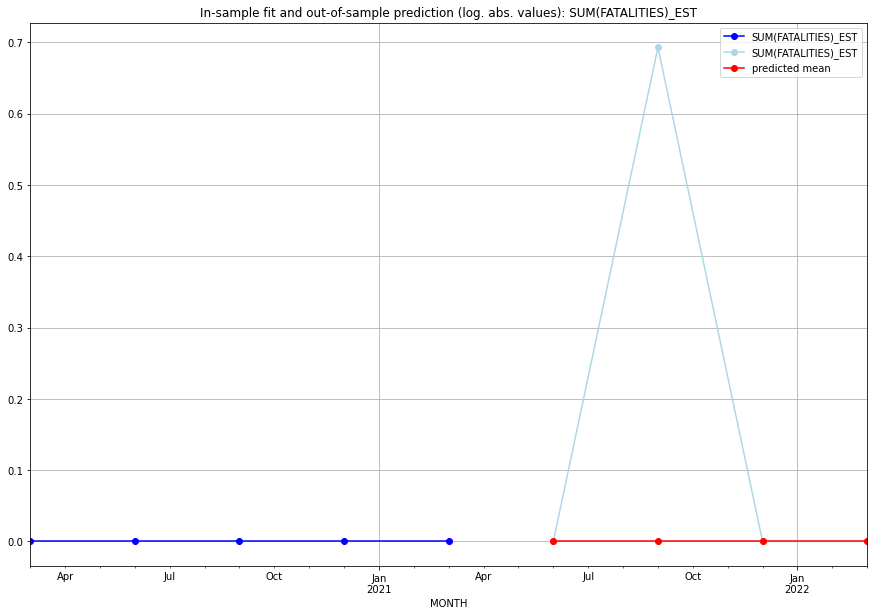

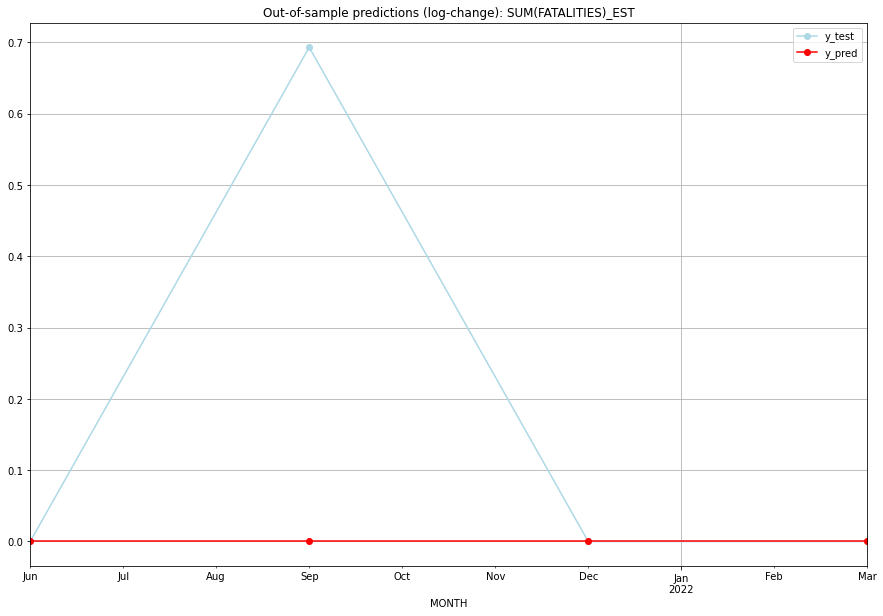

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   EST   
1 2021-07-01       0.0    0.693147           0.0        0.693147   EST   
2 2021-10-01       0.0    0.000000           0.0        0.000000   EST   
3 2022-01-01       0.0    0.000000           0.0        0.000000   EST   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## ETH (68/234) #########
0
Neighbor countries: ['KEN', 'SSD', 'XIT', 'ERI', 'SDN', 'DJI', 'SOM']
Getting Data for ETH
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 56)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6409561358119289, 'fold_results': [0.260483918560221, 0.8378980042255535, 0.1556018807539341, 0.9154933696767482, 1.0353035058431874]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ETH   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -183.904
Date:                 Wed, 19 Oct 2022   AIC                            375.808
Time:                         10:34:16   BIC                            386.023
Sample:                     04-30-1997   HQIC                           379.935
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

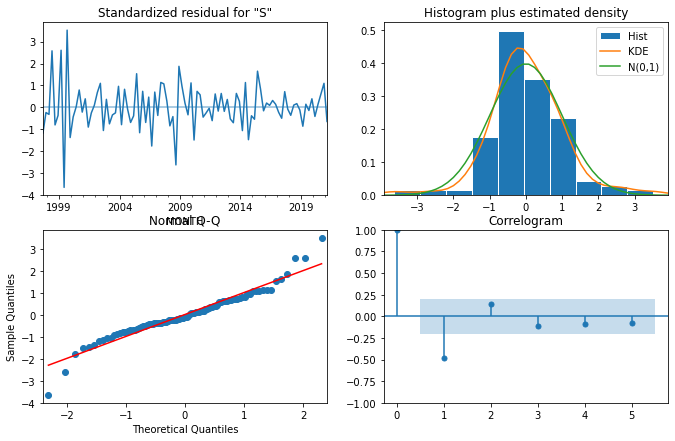

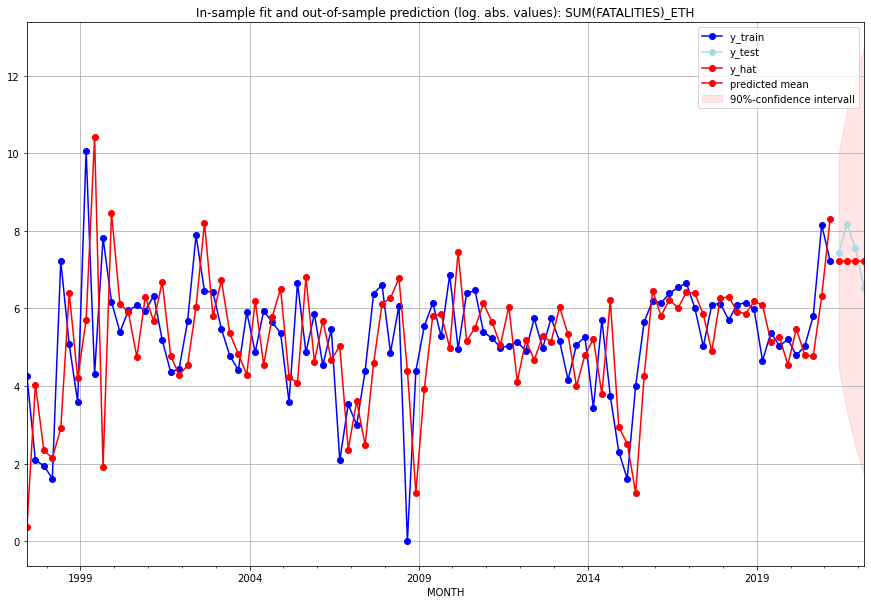

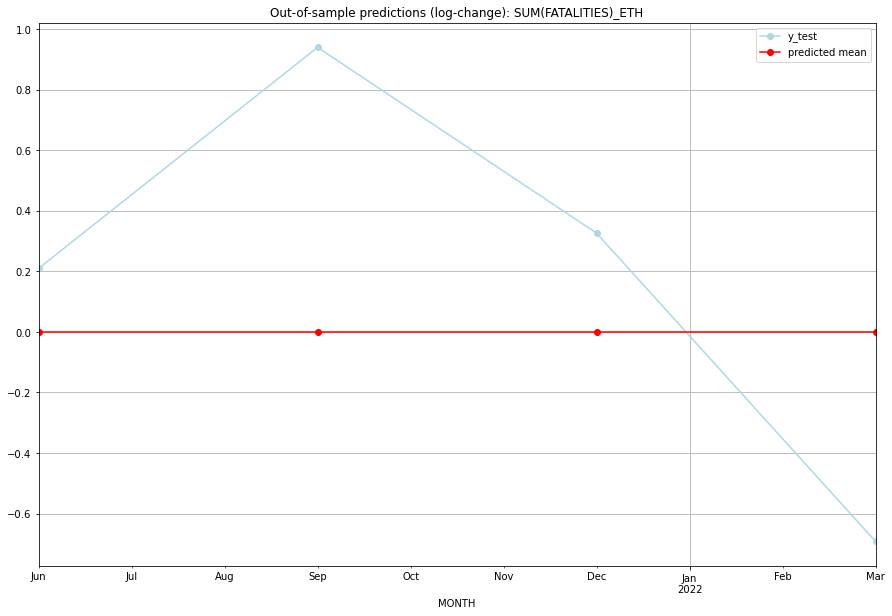

TADDA: 0.54221792584276
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01    1370.0      1690.0 -1.776357e-15        0.209780   ETH   
1 2021-07-01    1370.0      3510.0 -1.776357e-15        0.940360   ETH   
2 2021-10-01    1370.0      1899.0 -1.776357e-15        0.326313   ETH   
3 2022-01-01    1370.0       685.0 -1.776357e-15       -0.692418   ETH   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## FIN (69/234) #########
0
Neighbor countries: ['RUS', 'NOR', 'SWE']
Getting Data for FIN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 24)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed

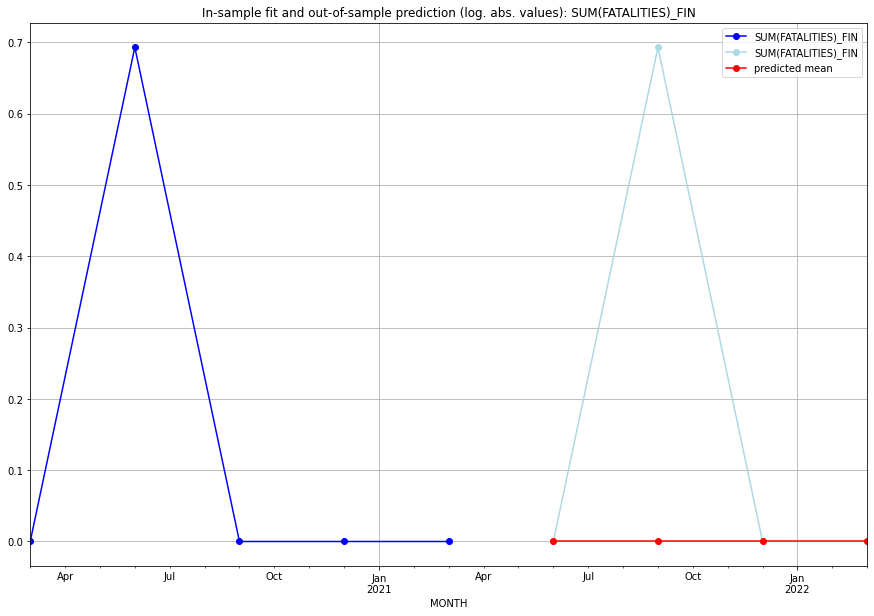

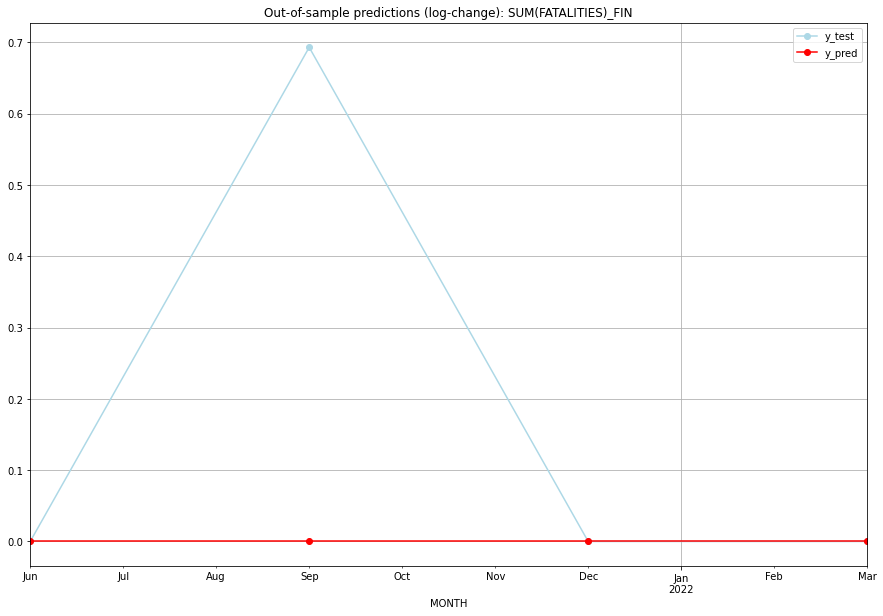

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   FIN   
1 2021-07-01       0.0    0.693147           0.0        0.693147   FIN   
2 2021-10-01       0.0    0.000000           0.0        0.000000   FIN   
3 2022-01-01       0.0    0.000000           0.0        0.000000   FIN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## FJI (70/234) #########
0
Neighbor countries: []
Getting Data for FJI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


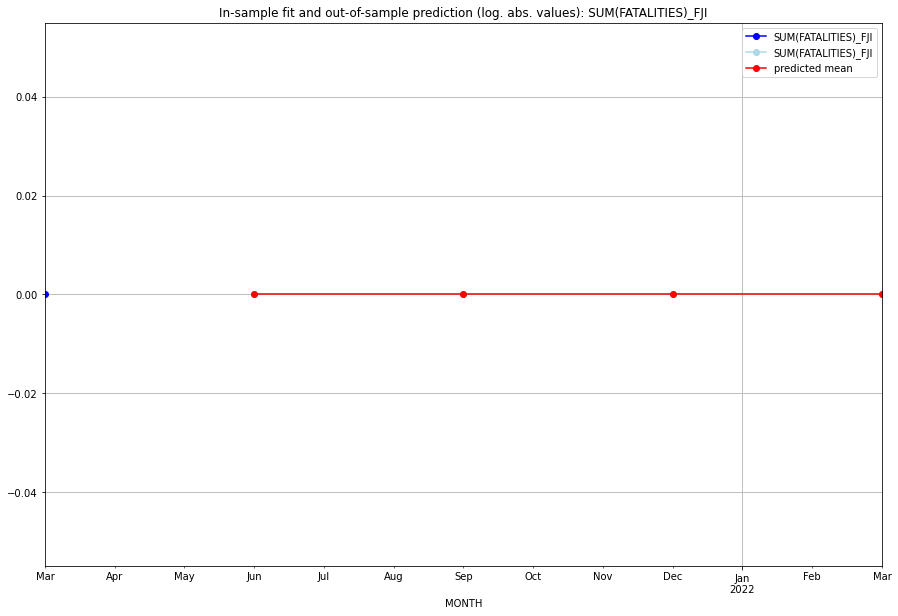

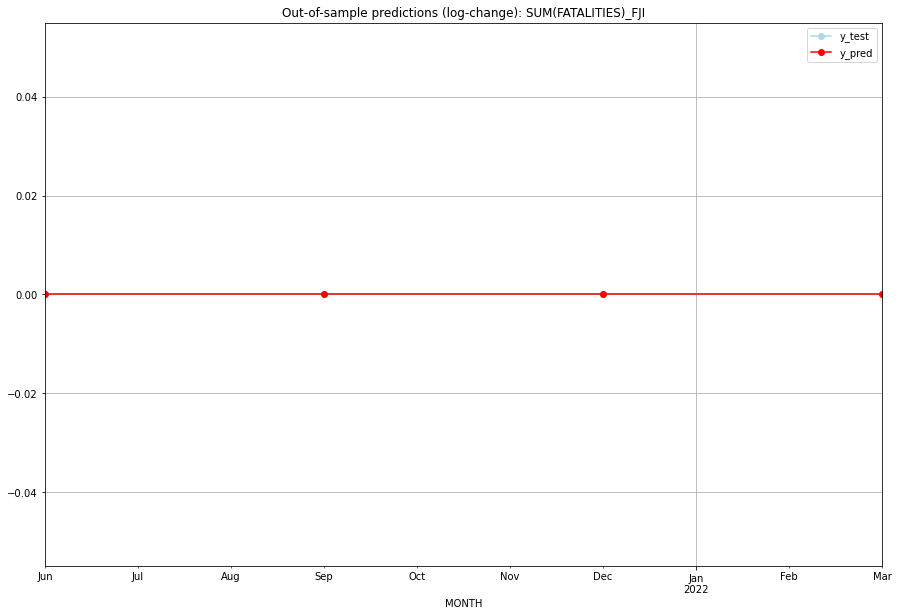

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FJI   
1 2021-07-01       0.0         0.0           0.0             0.0   FJI   
2 2021-10-01       0.0         0.0           0.0             0.0   FJI   
3 2022-01-01       0.0         0.0           0.0             0.0   FJI   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## FLK (71/234) #########
0
Neighbor countries: []
Getting Data for FLK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


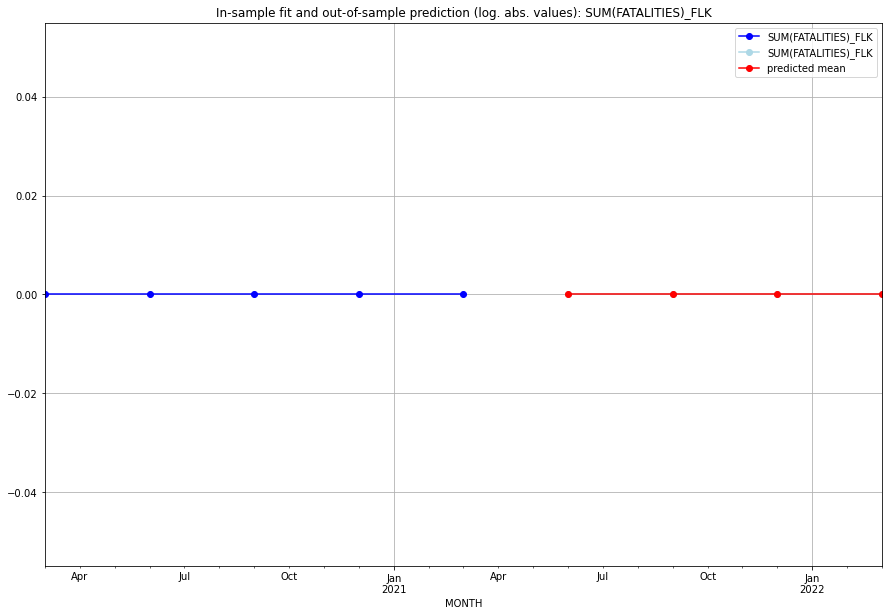

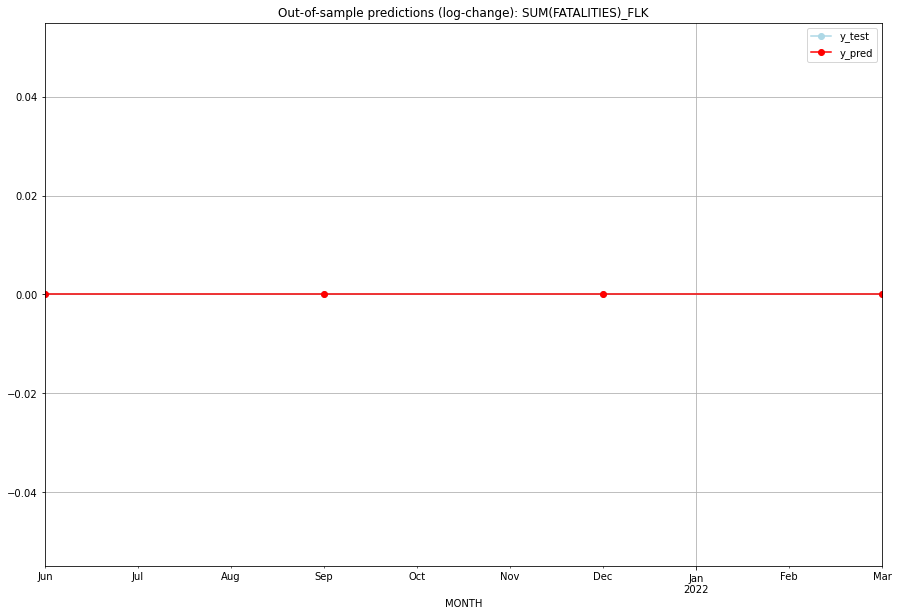

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FLK   
1 2021-07-01       0.0         0.0           0.0             0.0   FLK   
2 2021-10-01       0.0         0.0           0.0             0.0   FLK   
3 2022-01-01       0.0         0.0           0.0             0.0   FLK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## FRA (72/234) #########
0
Neighbor countries: ['ESP', 'AND', 'ITA', 'MCO', 'CHE', 'BEL', 'DEU', 'LUX']
Getting Data for FRA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


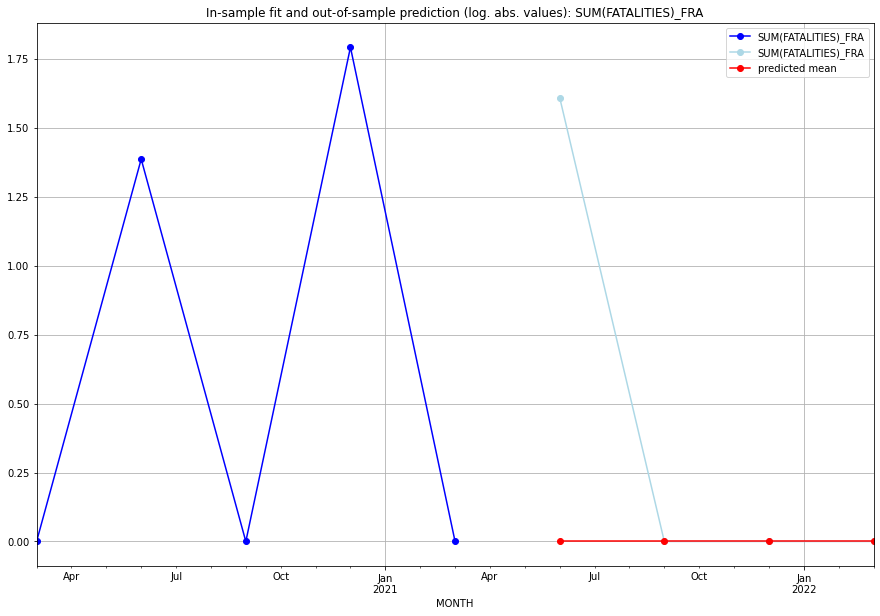

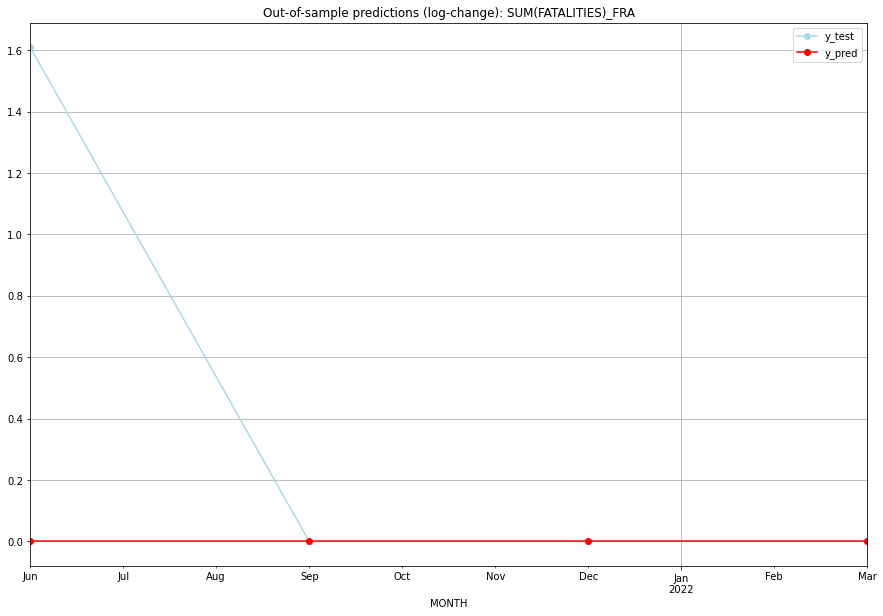

TADDA: 0.4023594781085251
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    1.609438           0.0        1.609438   FRA   
1 2021-07-01       0.0    0.000000           0.0        0.000000   FRA   
2 2021-10-01       0.0    0.000000           0.0        0.000000   FRA   
3 2022-01-01       0.0    0.000000           0.0        0.000000   FRA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## FRO (73/234) #########
0
Neighbor countries: []
Getting Data for FRO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


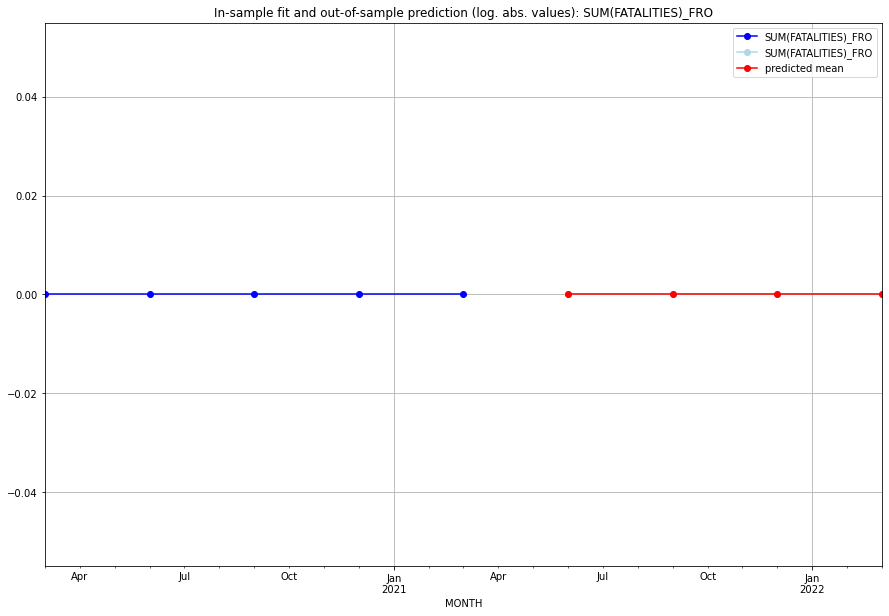

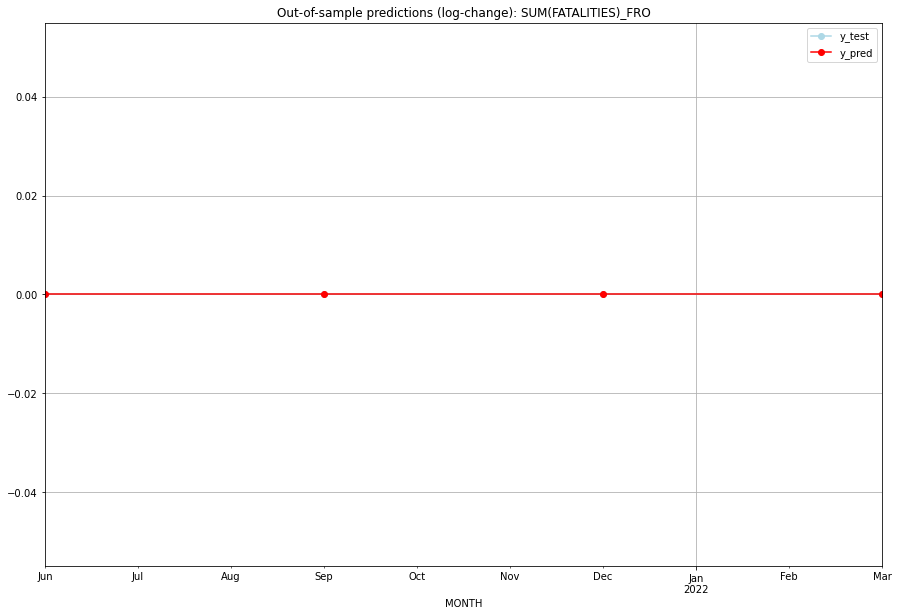

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FRO   
1 2021-07-01       0.0         0.0           0.0             0.0   FRO   
2 2021-10-01       0.0         0.0           0.0             0.0   FRO   
3 2022-01-01       0.0         0.0           0.0             0.0   FRO   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## FSM (74/234) #########
0
Neighbor countries: []
Getting Data for FSM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


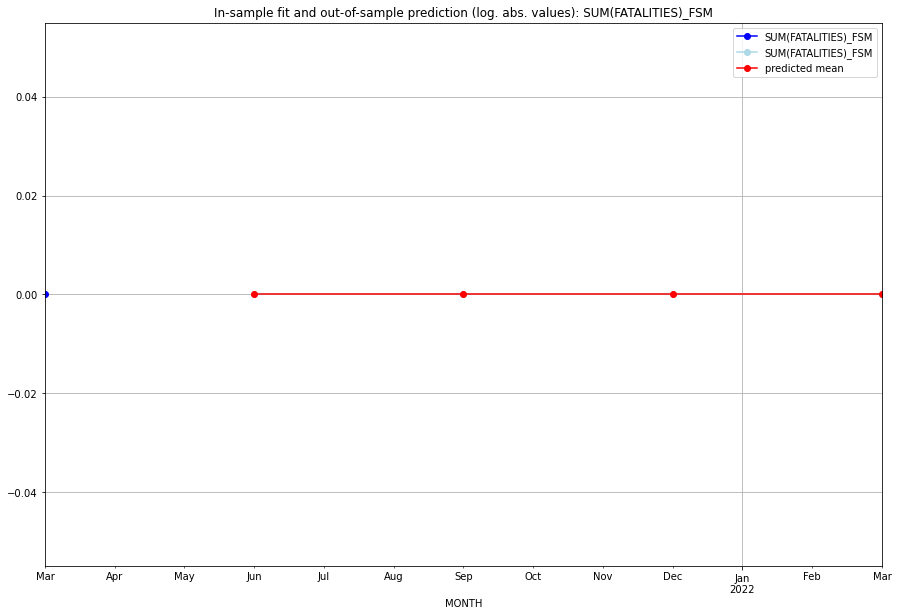

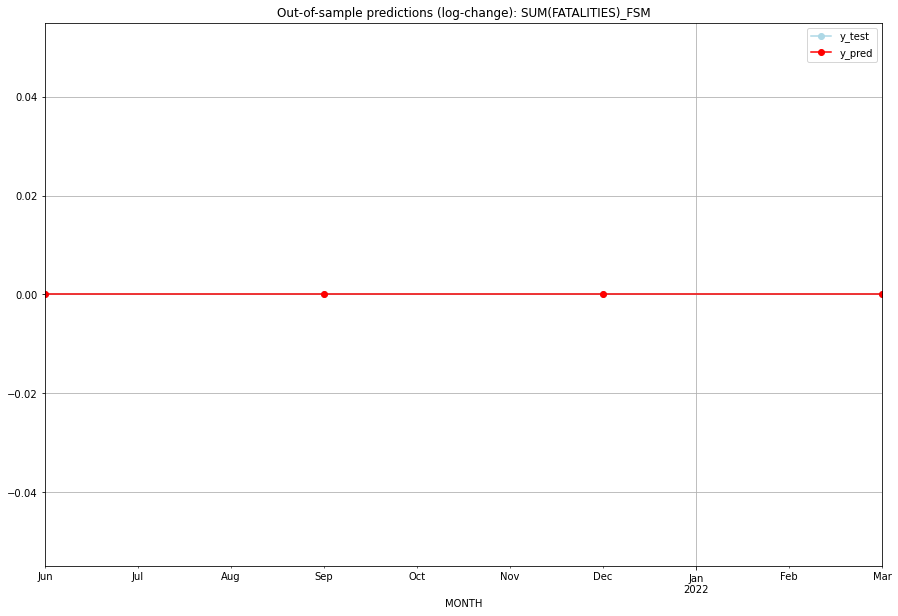

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FSM   
1 2021-07-01       0.0         0.0           0.0             0.0   FSM   
2 2021-10-01       0.0         0.0           0.0             0.0   FSM   
3 2022-01-01       0.0         0.0           0.0             0.0   FSM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## GAB (75/234) #########
0
Neighbor countries: ['GNQ', 'COG', 'CMR']
Getting Data for GAB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3635987547491645, 'fold_results': [0.5200010015242823, 0.00221175660303038, 0.17328697001456111, 0.6212262683280748, 0.5012677772758738]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GAB   No. Observations:                   96
Model:                SARIMAX(2, 0, 3)   Log Likelihood                 -63.442
Date:                 Wed, 19 Oct 2022   AIC                            138.883
Time:                         10:34:48   BIC                            154.270
Sample:                     04-30-1997   HQIC                           145.103
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

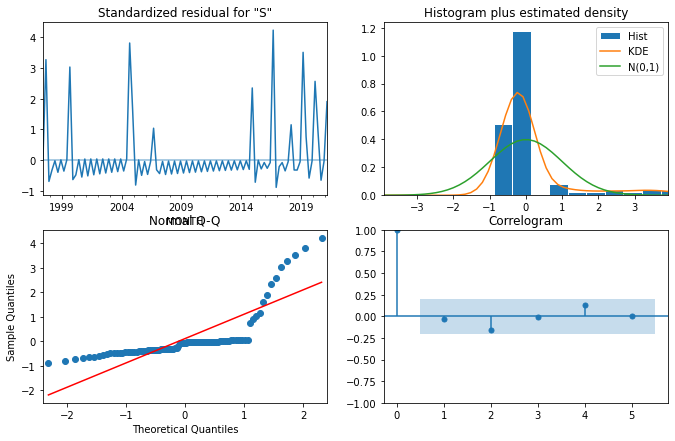

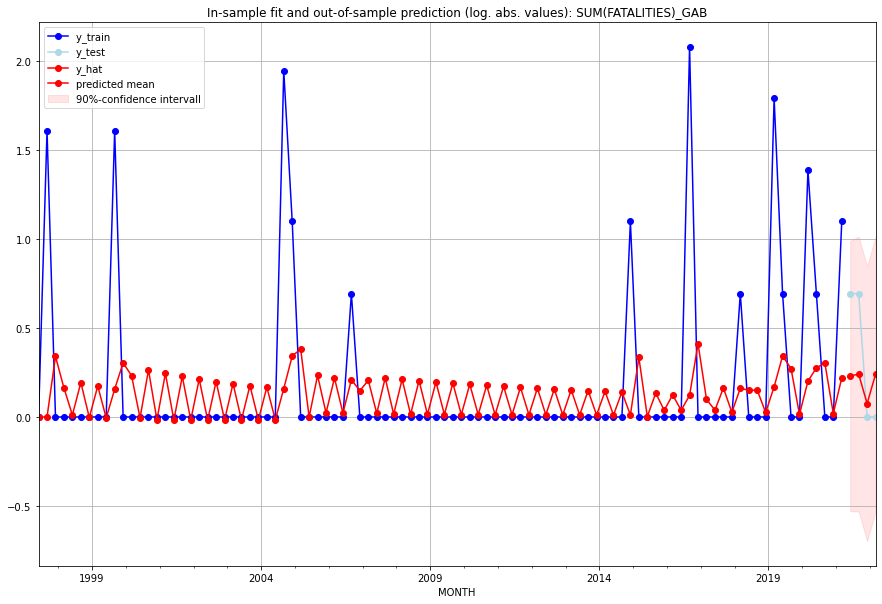

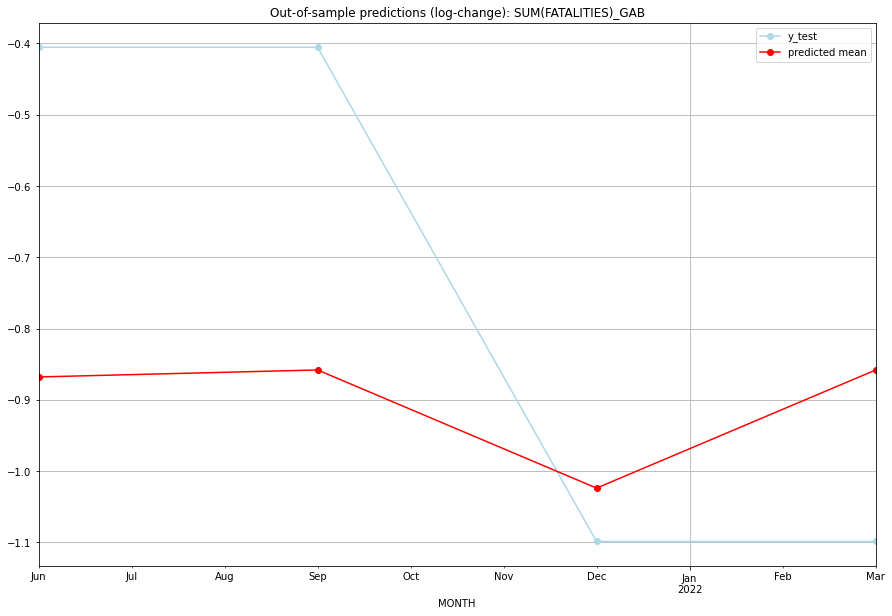

TADDA: 0.3075763845494407
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.259585         1.0     -0.867830       -0.405465   GAB   
1 2021-07-01  0.271999         1.0     -0.858023       -0.405465   GAB   
2 2021-10-01  0.077769         0.0     -1.023719       -1.098612   GAB   
3 2022-01-01  0.271872         0.0     -0.858123       -1.098612   GAB   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## GBR (76/234) #########
0
Neighbor countries: ['IRL']
Getting Data for GBR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficien

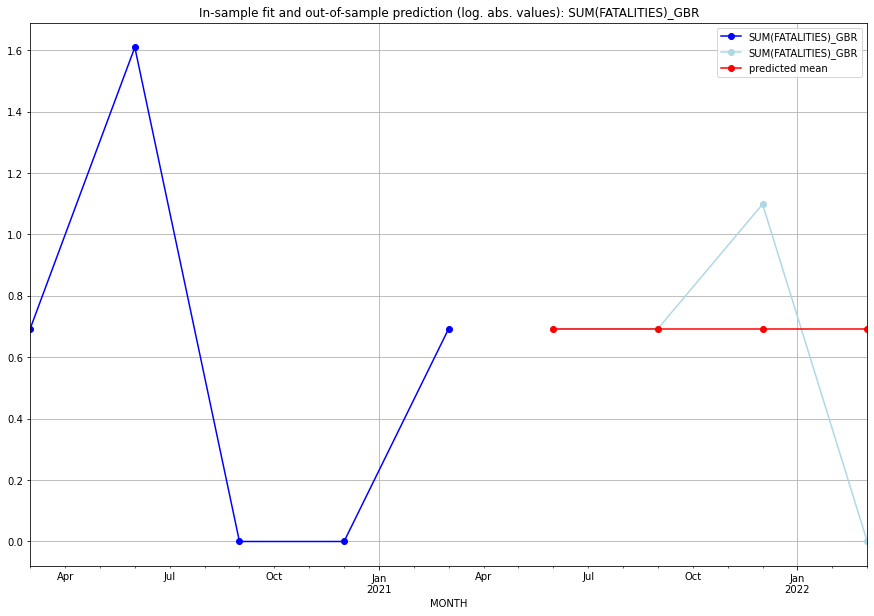

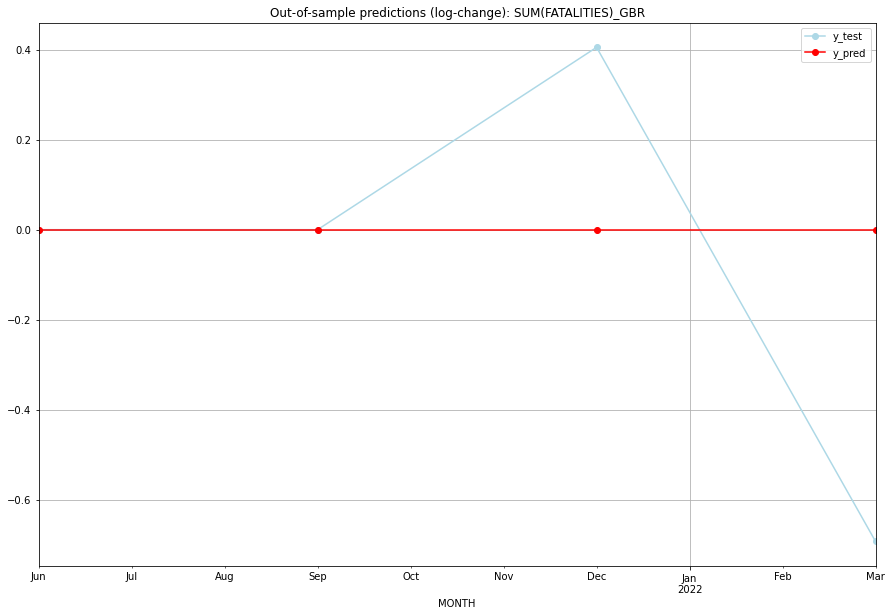

TADDA: 0.27465307216702745
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.693147    0.693147           0.0        0.000000   GBR   
1 2021-07-01  0.693147    0.693147           0.0        0.000000   GBR   
2 2021-10-01  0.693147    1.098612           0.0        0.405465   GBR   
3 2022-01-01  0.693147    0.000000           0.0       -0.693147   GBR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## GEO (77/234) #########
0
Neighbor countries: ['ARM', 'TUR', 'RUS', 'AZE']
Getting Data for GEO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 32)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.23585844509461393, 'fold_results': [0.23585844509461393, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GEO   No. Observations:                   13
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -4.466
Date:                 Wed, 19 Oct 2022   AIC                             20.932
Time:                         10:35:08   BIC                             24.322
Sample:                     01-31-2018   HQIC                            20.235
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0076      0.047     -0.16

<Figure size 432x288 with 0 Axes>

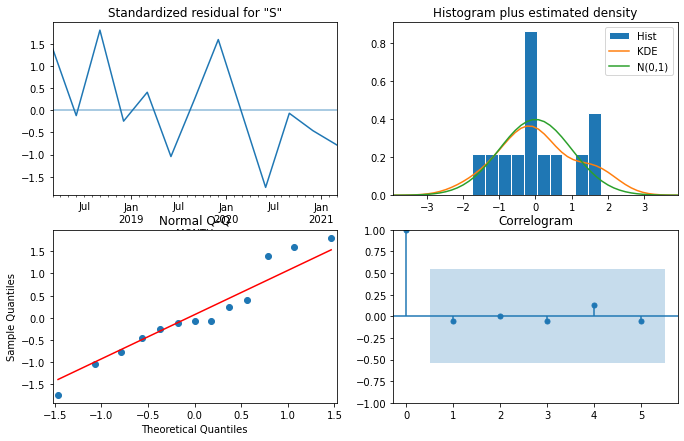

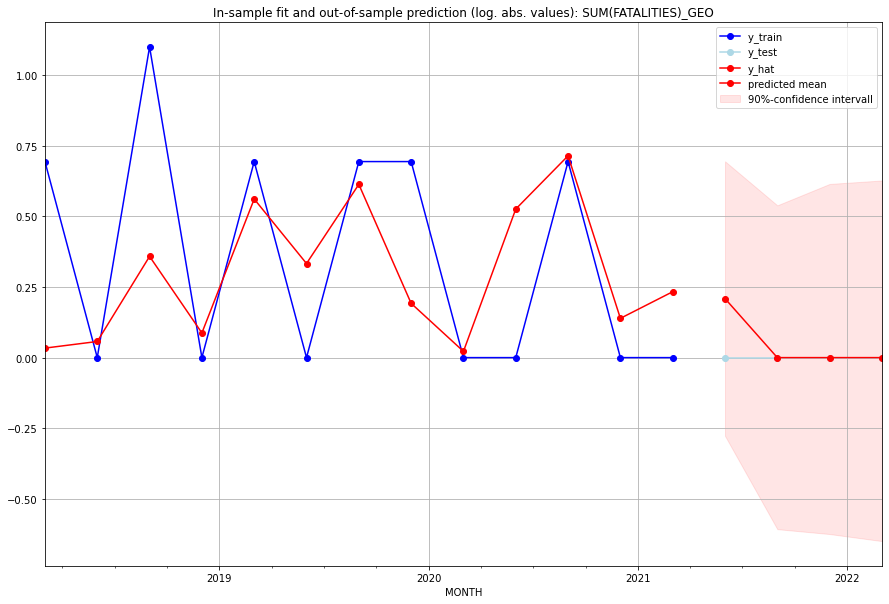

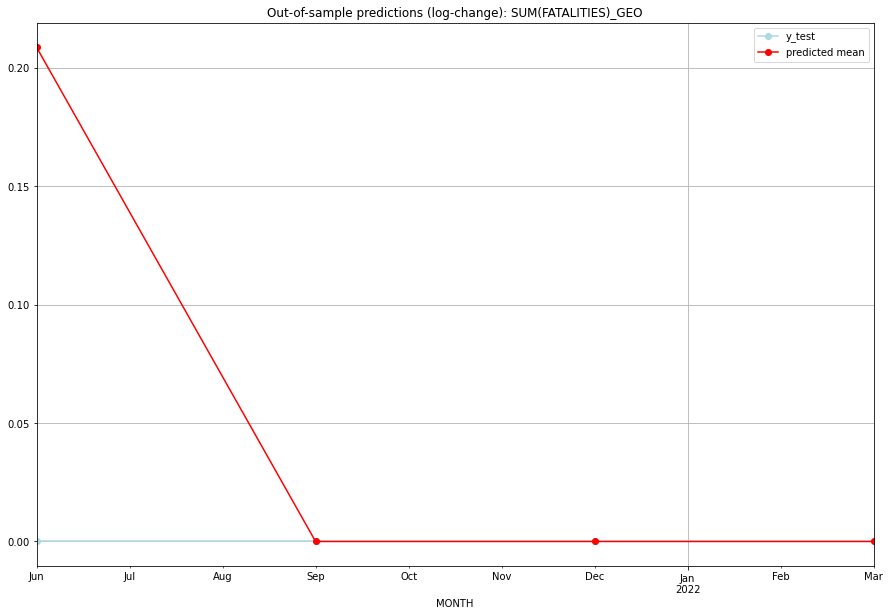

TADDA: 0.052168147606357976
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.232042         0.0      0.208673             0.0   GEO   
1 2021-07-01  0.000000         0.0      0.000000             0.0   GEO   
2 2021-10-01  0.000000         0.0      0.000000             0.0   GEO   
3 2022-01-01  0.000000         0.0      0.000000             0.0   GEO   

                                          PARAMETERS  
0  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## GGY (78/234) #########
0
Neighbor countries: []
Getting Data for GGY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV ne

<Figure size 432x288 with 0 Axes>

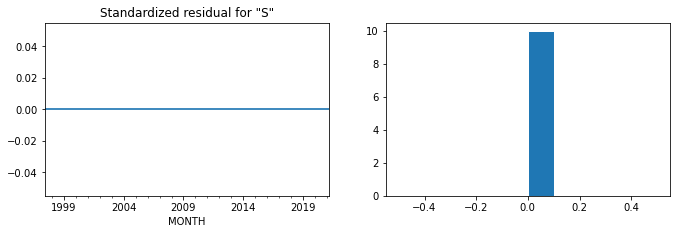

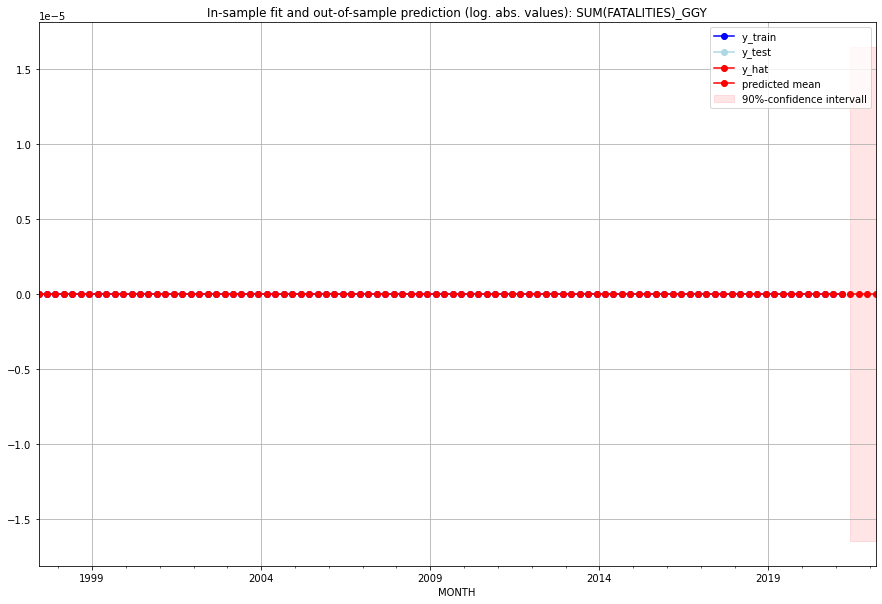

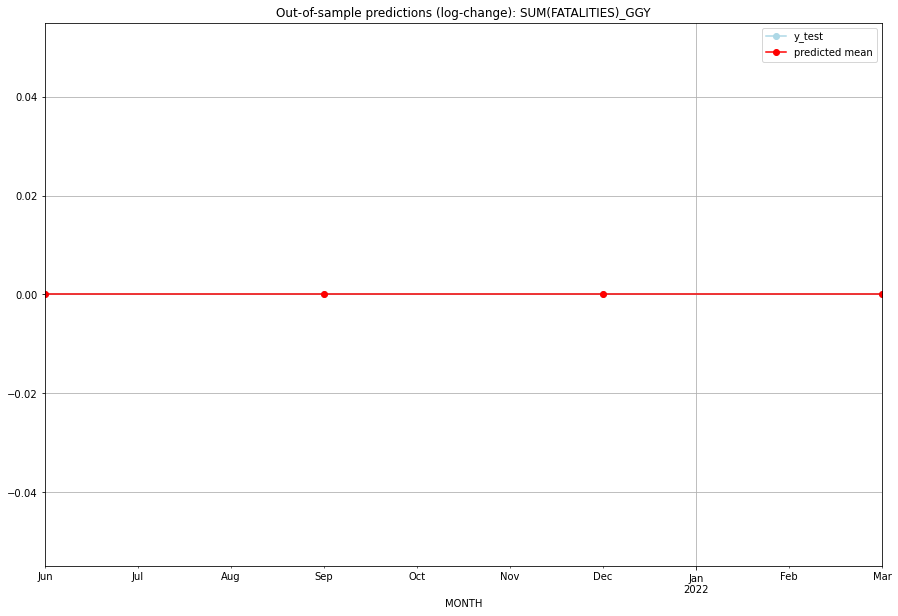

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GGY   
1 2021-07-01       0.0         0.0           0.0             0.0   GGY   
2 2021-10-01       0.0         0.0           0.0             0.0   GGY   
3 2022-01-01       0.0         0.0           0.0             0.0   GGY   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:04
######## GHA (79/234) #########
0
Neighbor countries: ['CIV', 'BFA', 'TGO']
Getting Data for GHA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7428600917156762, 'fold_results': [0.4500747274196346, 0.9466559636345395, 1.6948483054823171, 0.25992903788389243, 0.36279242415799756]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GHA   No. Observations:                   96
Model:                SARIMAX(1, 1, 0)   Log Likelihood                -144.737
Date:                 Wed, 19 Oct 2022   AIC                            299.475
Time:                         10:35:33   BIC                            312.244
Sample:                     04-30-1997   HQIC                           304.634
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

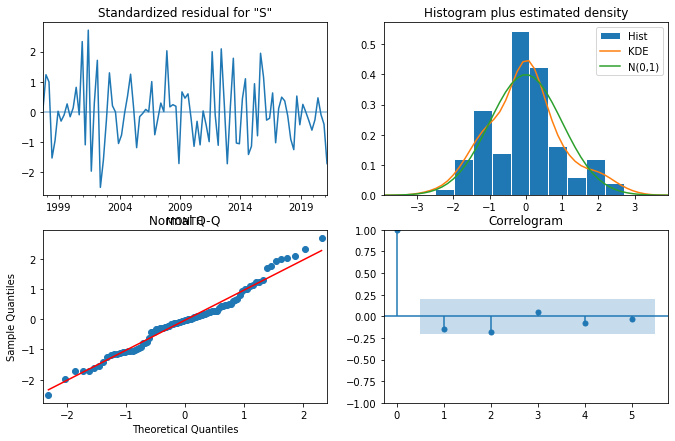

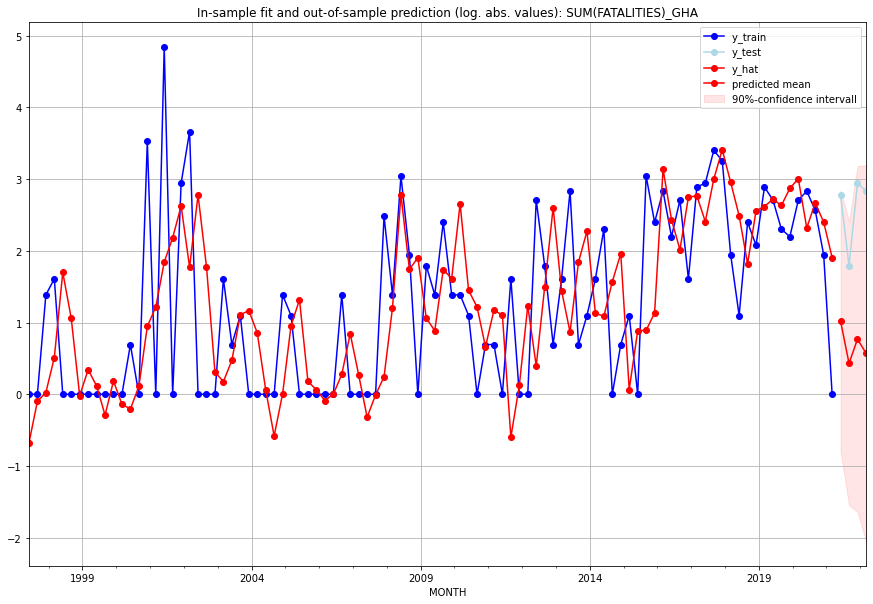

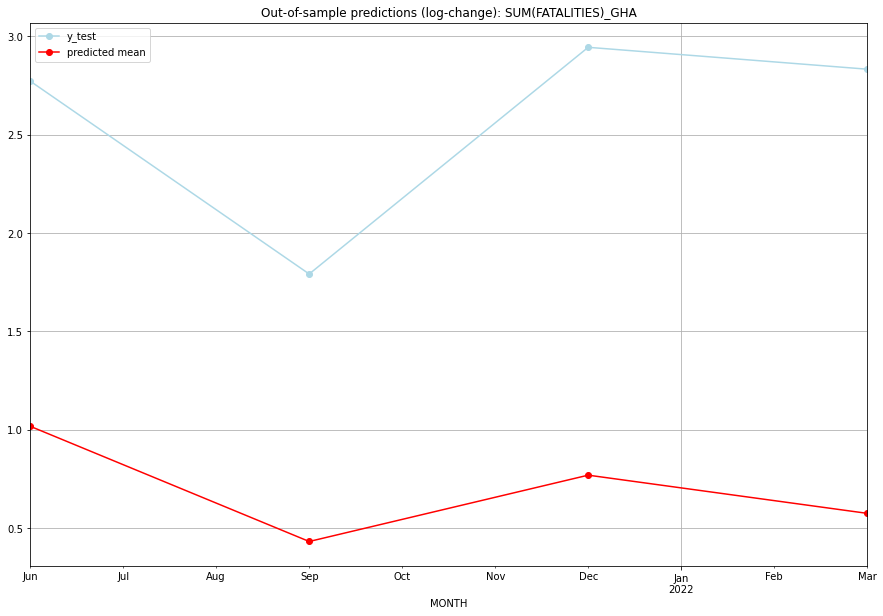

TADDA: 1.887256999896109
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.766274        15.0      1.017501        2.772589   GHA   
1 2021-07-01  0.539891         5.0      0.431711        1.791759   GHA   
2 2021-10-01  1.157519        18.0      0.768959        2.944439   GHA   
3 2022-01-01  0.776777        16.0      0.574801        2.833213   GHA   

                                          PARAMETERS  
0  {'params': [3, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## GIB (80/234) #########
0
Neighbor countries: ['ESP']
Getting Data for GIB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient

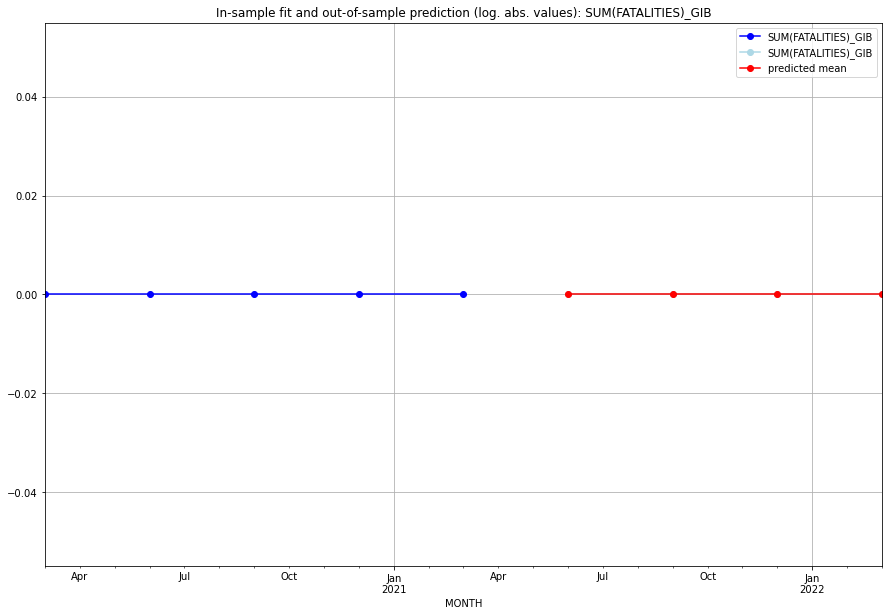

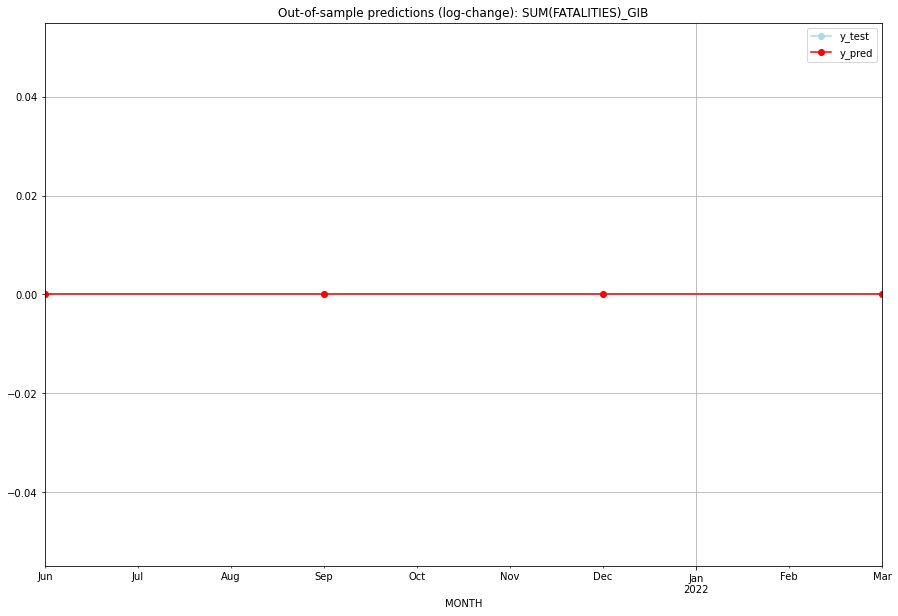

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GIB   
1 2021-07-01       0.0         0.0           0.0             0.0   GIB   
2 2021-10-01       0.0         0.0           0.0             0.0   GIB   
3 2022-01-01       0.0         0.0           0.0             0.0   GIB   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:08
######## GIN (81/234) #########
0
Neighbor countries: ['GNB', 'SEN', 'MLI', 'SLE', 'CIV', 'LBR']
Getting Data for GIN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 48)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.7946495184218165, 'fold_results': [0.7457340972449158, 0.6688383817666853, 0.3027689177741474, 1.0872936202062233, 1.168612575117111]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GIN   No. Observations:                   96
Model:                SARIMAX(1, 1, 1)   Log Likelihood                -163.420
Date:                 Wed, 19 Oct 2022   AIC                            338.841
Time:                         10:35:58   BIC                            354.164
Sample:                     04-30-1997   HQIC                           345.033
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

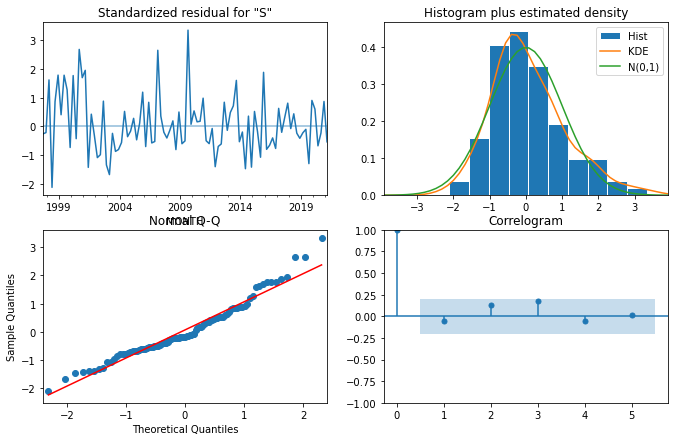

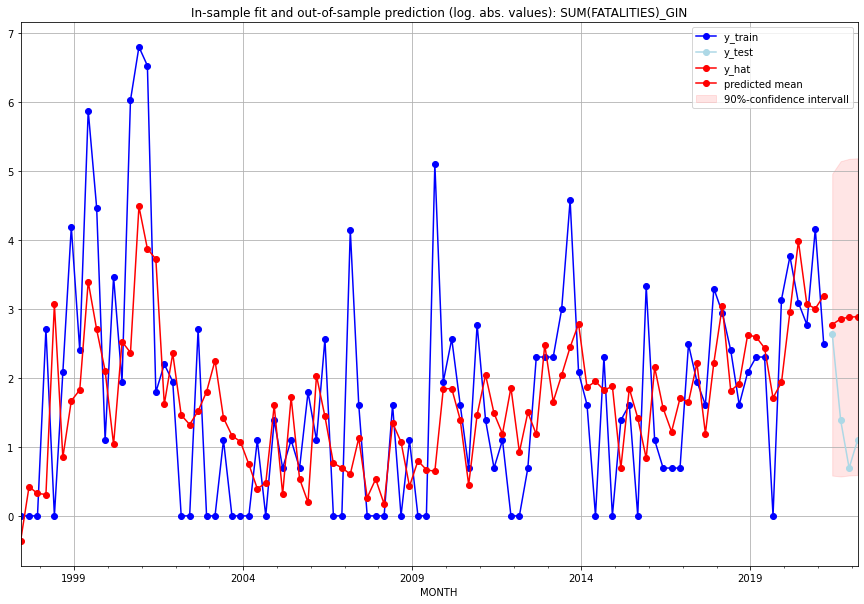

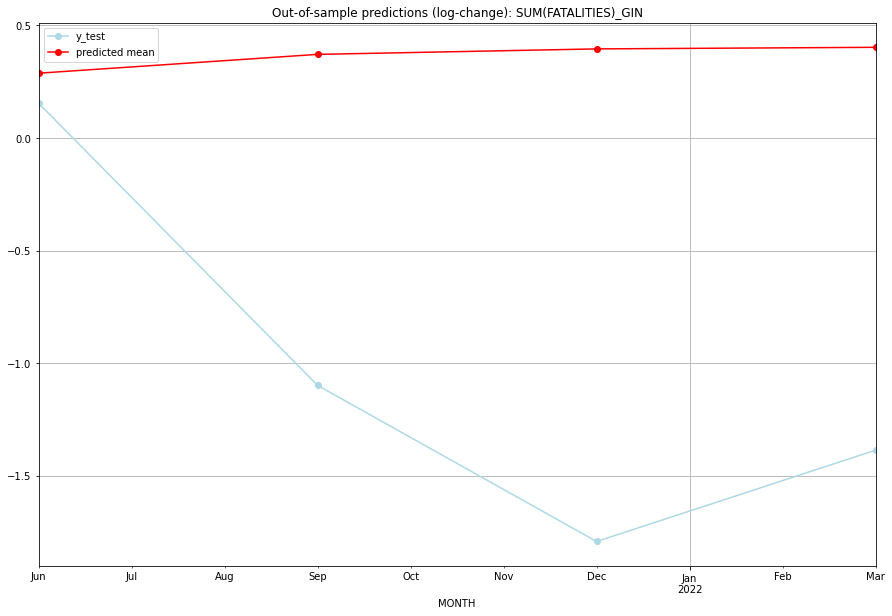

TADDA: 1.6869711231366882
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  14.996996        13.0      0.287494        0.154151   GIN   
1 2021-07-01  16.391702         3.0      0.371087       -1.098612   GIN   
2 2021-10-01  16.819592         1.0      0.395392       -1.791759   GIN   
3 2022-01-01  16.945971         2.0      0.402459       -1.386294   GIN   

                                          PARAMETERS  
0  {'params': [3, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## GLP (82/234) #########
0
Neighbor countries: []
Getting Data for GLP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV n

<Figure size 432x288 with 0 Axes>

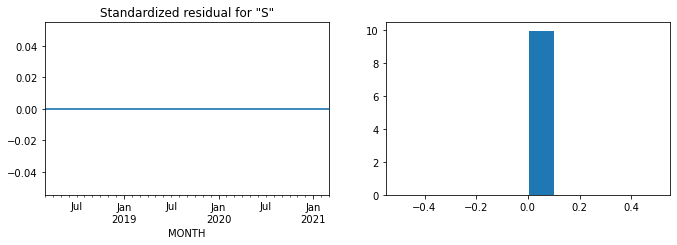

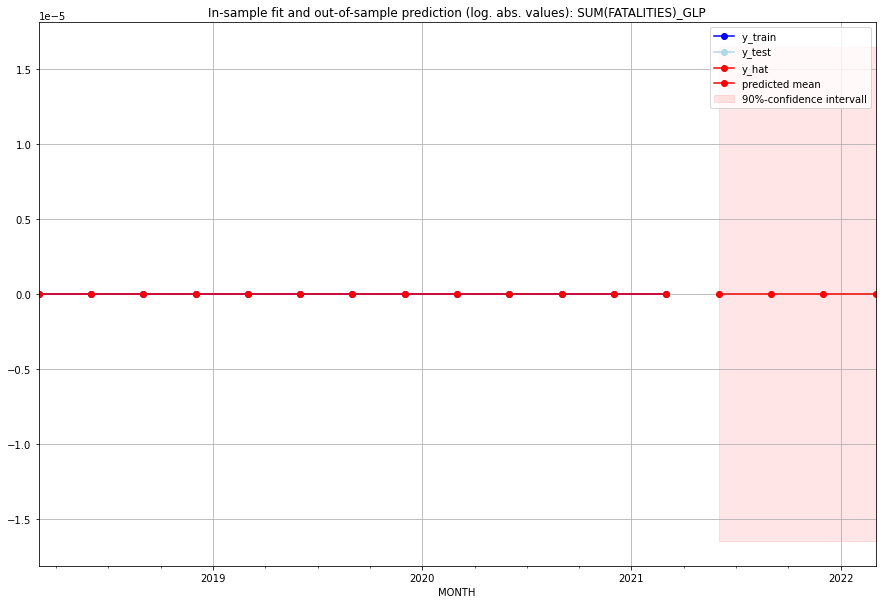

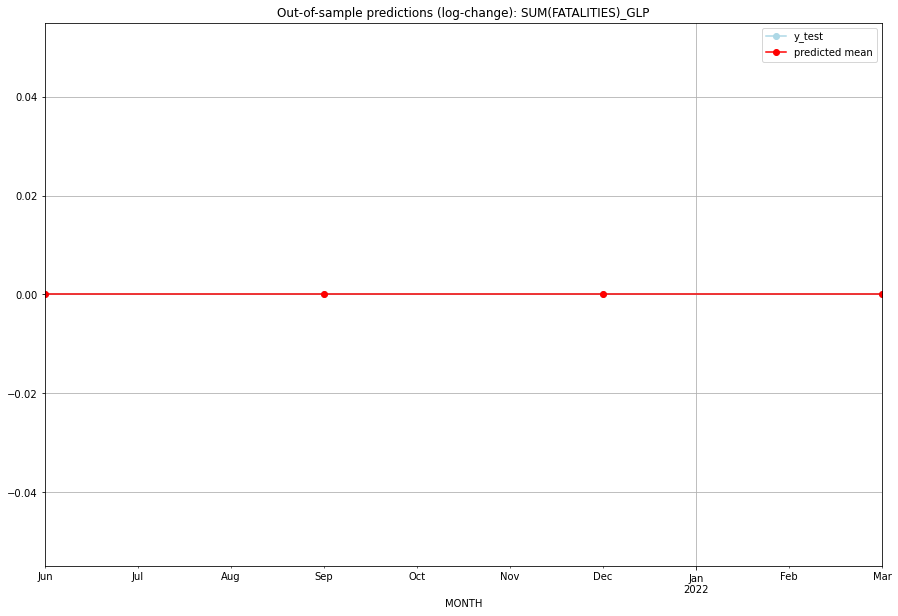

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GLP   
1 2021-07-01       0.0         0.0           0.0             0.0   GLP   
2 2021-10-01       0.0         0.0           0.0             0.0   GLP   
3 2022-01-01       0.0         0.0           0.0             0.0   GLP   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:05
######## GMB (83/234) #########
0
Neighbor countries: ['SEN']
Getting Data for GMB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 8)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4366016668755856, 'fold_results': [0.4023594781085251, 0.7666456860273737, 0.3602273839548194, 0.30619201156763687, 0.3475837747195728]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GMB   No. Observations:                   96
Model:                SARIMAX(0, 0, 3)   Log Likelihood                -115.814
Date:                 Wed, 19 Oct 2022   AIC                            245.628
Time:                         10:36:36   BIC                            263.578
Sample:                     04-30-1997   HQIC                           252.884
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

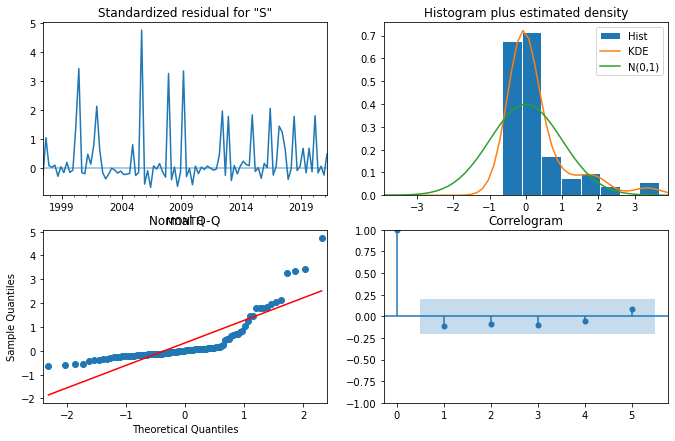

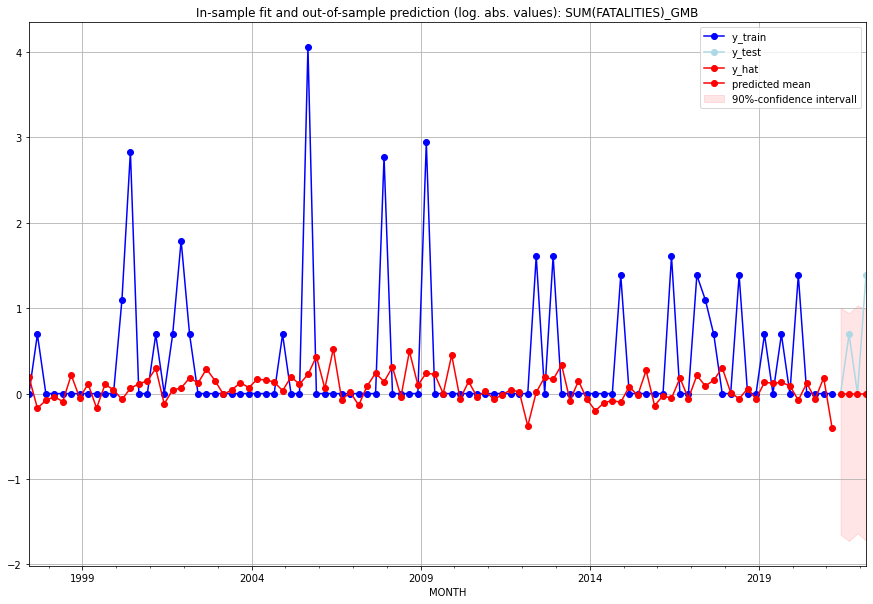

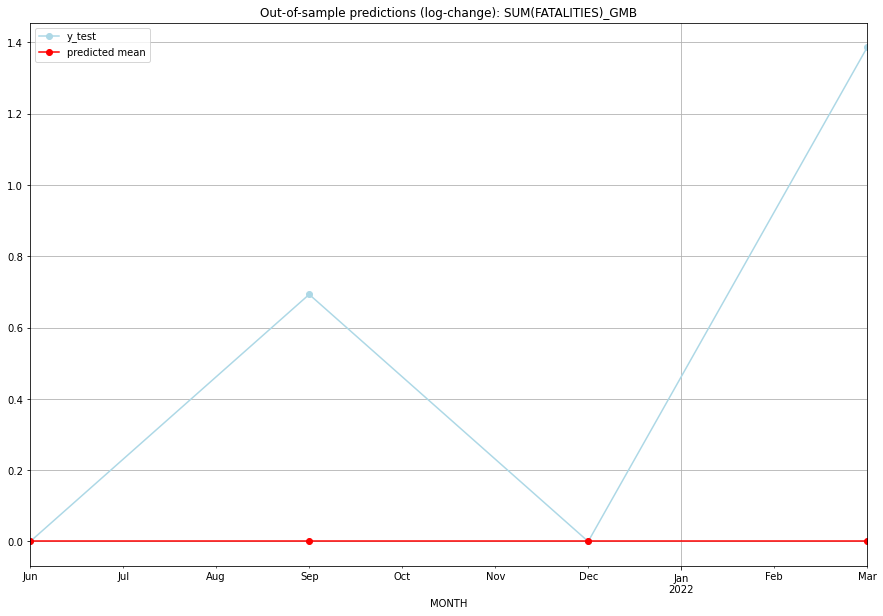

TADDA: 0.5198603854199589
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   GMB   
1 2021-07-01       0.0         1.0           0.0        0.693147   GMB   
2 2021-10-01       0.0         0.0           0.0        0.000000   GMB   
3 2022-01-01       0.0         3.0           0.0        1.386294   GMB   

                                          PARAMETERS  
0  {'params': [3, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:30
######## GNB (84/234) #########
0
Neighbor countries: ['SEN', 'GIN']
Getting Data for GNB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 16)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14978661367769958, 'fold_results': [0.0, 0.0, 6.560425886295985e-142, 0.17328679513998632, 0.5756462732485115]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GNB   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -158.739
Date:                 Wed, 19 Oct 2022   AIC                            319.478
Time:                         10:36:49   BIC                            322.032
Sample:                     04-30-1997   HQIC                           320.510
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

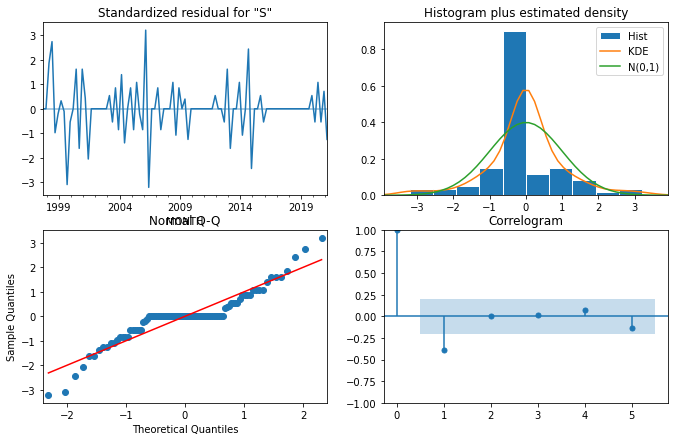

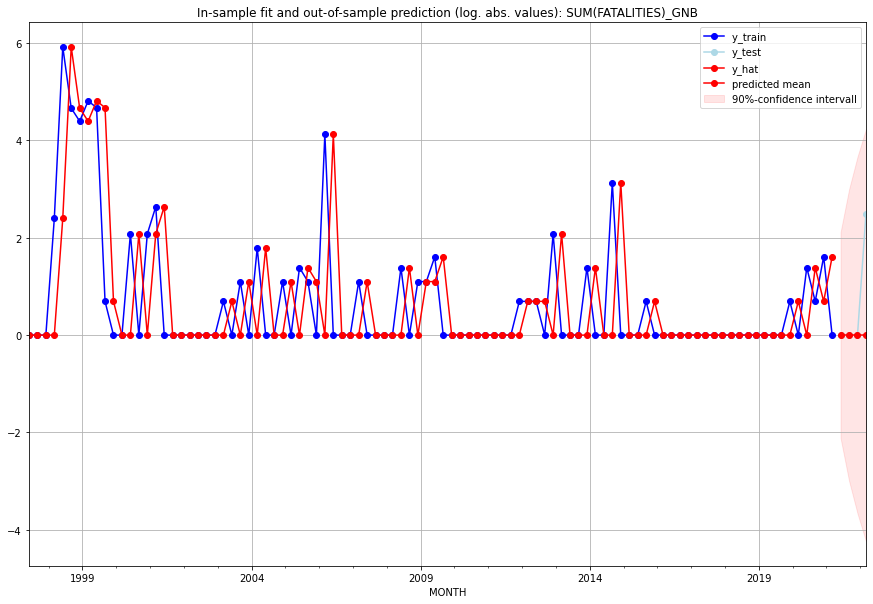

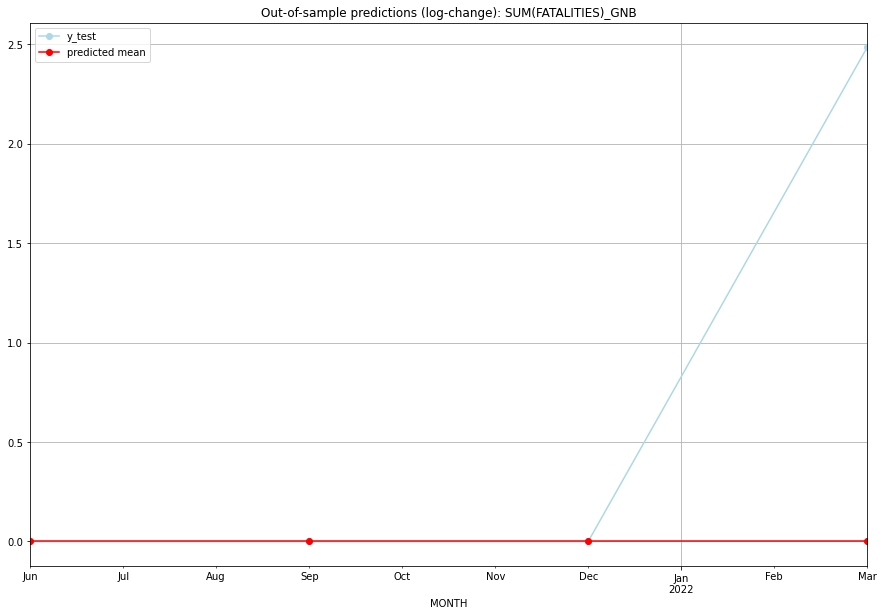

TADDA: 0.6212266624470001
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   GNB   
1 2021-07-01       0.0         0.0           0.0        0.000000   GNB   
2 2021-10-01       0.0         0.0           0.0        0.000000   GNB   
3 2022-01-01       0.0        11.0           0.0        2.484907   GNB   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## GNQ (85/234) #########
0
Neighbor countries: ['CMR', 'GAB']
Getting Data for GNQ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 16)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.21383330595080277, 'fold_results': [1.3877787807814457e-17, 0.7225929394740411, 0.17328679513998638, 0.17328679513998632, 5.551115123125783e-17]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GNQ   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -94.703
Date:                 Wed, 19 Oct 2022   AIC                            193.405
Time:                         10:37:18   BIC                            198.513
Sample:                     04-30-1997   HQIC                           195.469
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------

<Figure size 432x288 with 0 Axes>

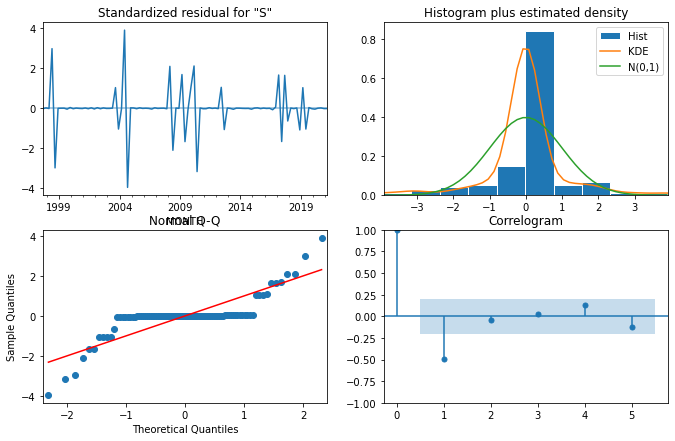

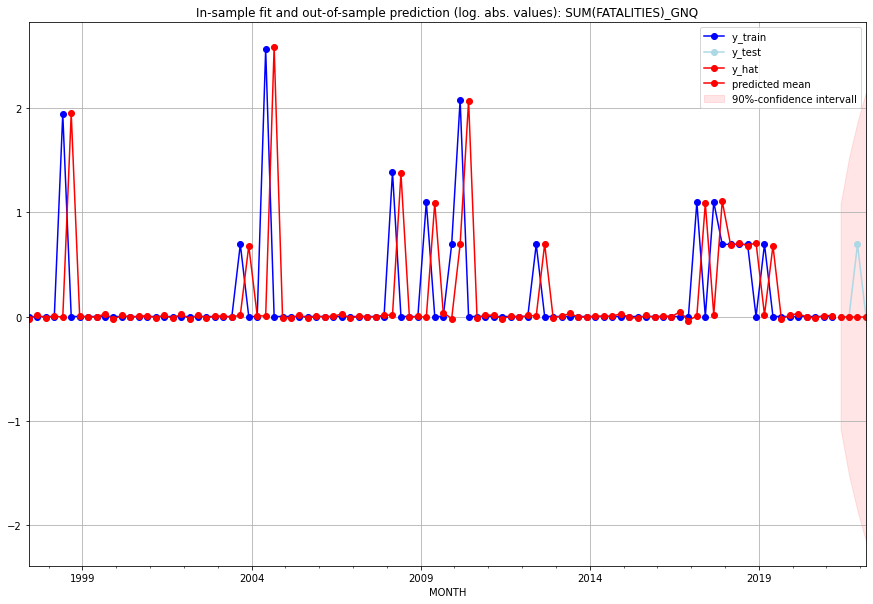

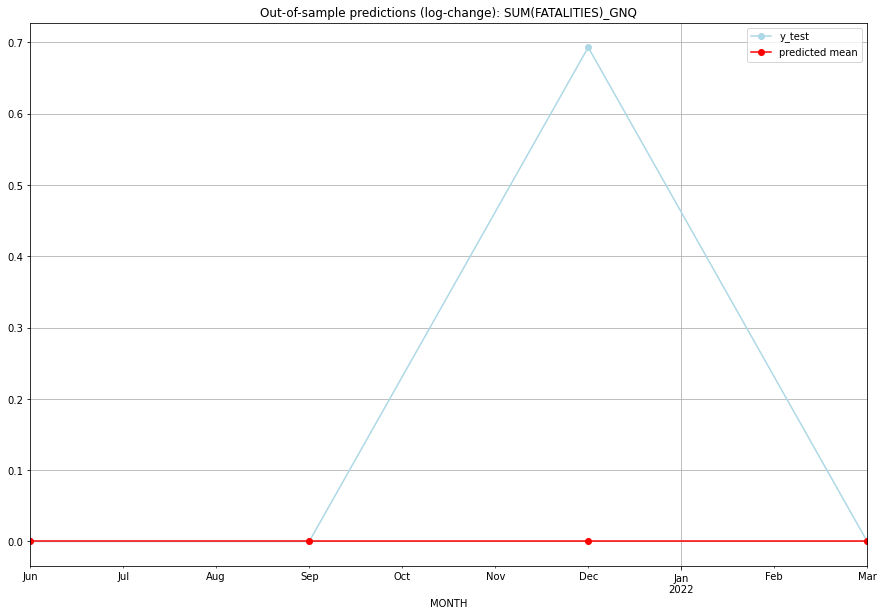

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   GNQ   
1 2021-07-01       0.0         0.0           0.0        0.000000   GNQ   
2 2021-10-01       0.0         1.0           0.0        0.693147   GNQ   
3 2022-01-01       0.0         0.0           0.0        0.000000   GNQ   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:28
######## GRC (86/234) #########
0
Neighbor countries: ['ALB', 'MKD', 'BGR', 'TUR']
Getting Data for GRC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 32)
y: (17, 1)
------------------------------------------------
Training started.
Start G

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4085376288938771, 'fold_results': [0.4697716692515167, 0.3473035885362375]}
Retraining model failed.
No model fitted --> Prediction with Naive Model 


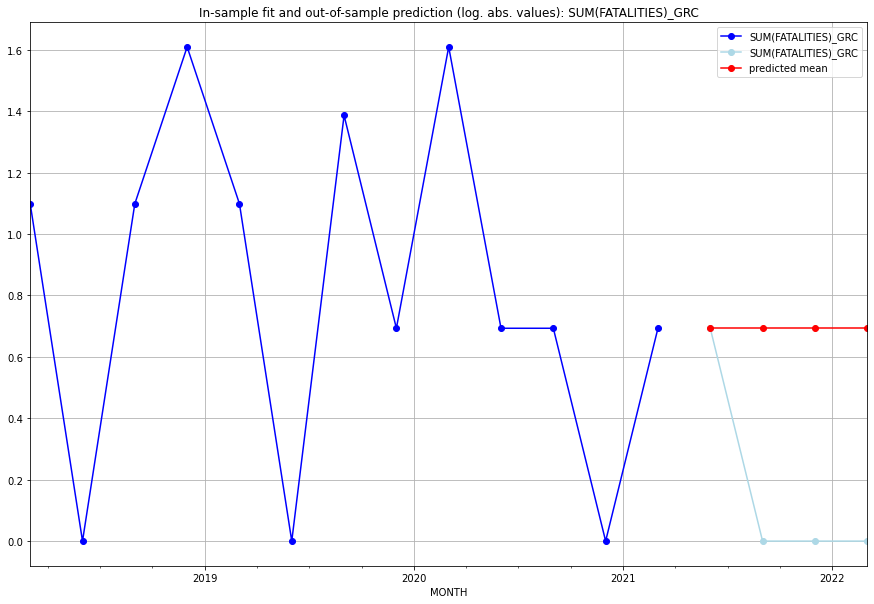

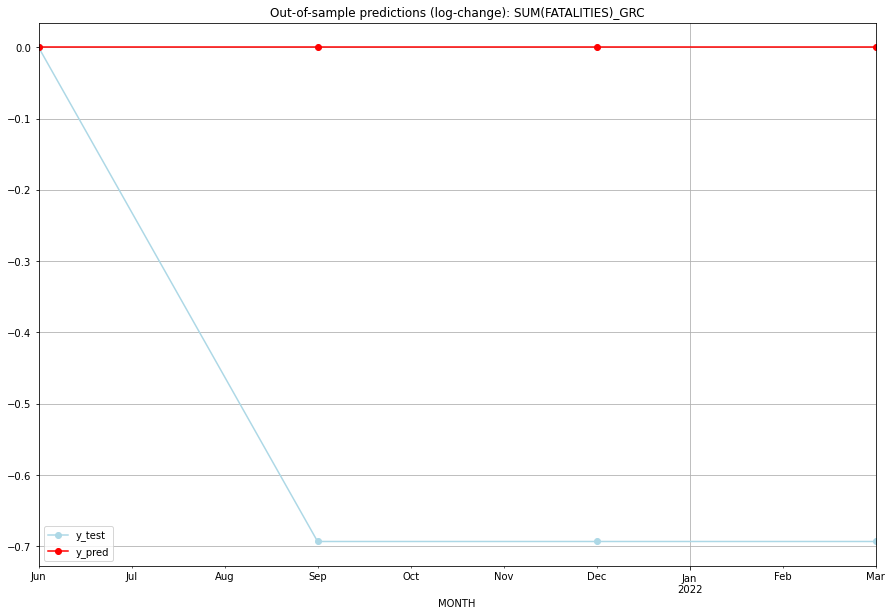

TADDA: 0.5198603854199589
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.693147    0.693147           0.0        0.000000   GRC   
1 2021-07-01  0.693147    0.000000           0.0       -0.693147   GRC   
2 2021-10-01  0.693147    0.000000           0.0       -0.693147   GRC   
3 2022-01-01  0.693147    0.000000           0.0       -0.693147   GRC   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:08
######## GRD (87/234) #########
0
Neighbor countries: []
Getting Data for GRD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GRD   No. Observations:              

<Figure size 432x288 with 0 Axes>

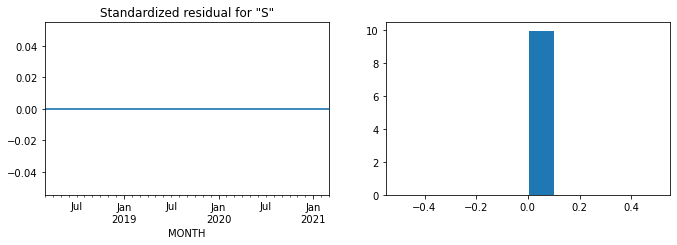

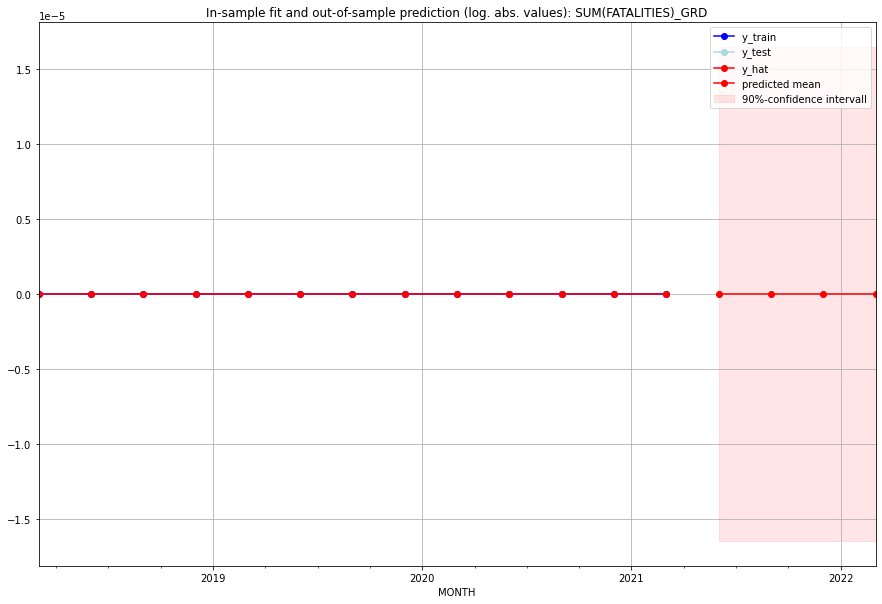

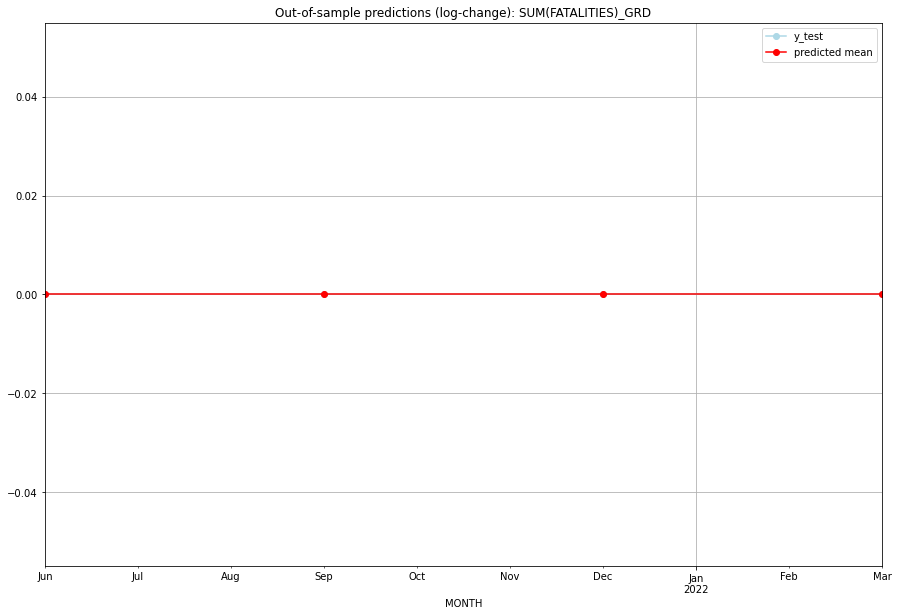

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GRD   
1 2021-07-01       0.0         0.0           0.0             0.0   GRD   
2 2021-10-01       0.0         0.0           0.0             0.0   GRD   
3 2022-01-01       0.0         0.0           0.0             0.0   GRD   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## GRL (88/234) #########
0
Neighbor countries: ['CAN']
Getting Data for GRL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


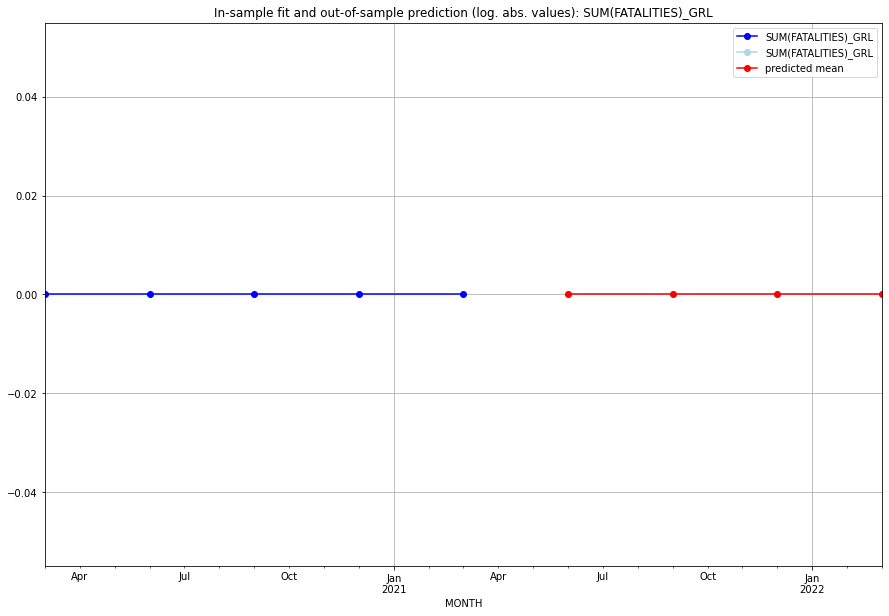

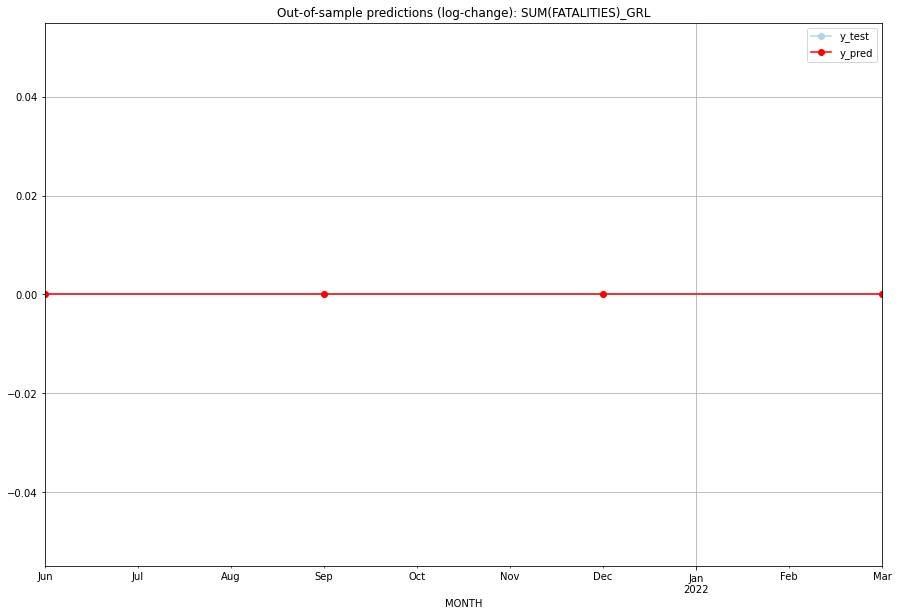

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GRL   
1 2021-07-01       0.0         0.0           0.0             0.0   GRL   
2 2021-10-01       0.0         0.0           0.0             0.0   GRL   
3 2022-01-01       0.0         0.0           0.0             0.0   GRL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## GTM (89/234) #########
0
Neighbor countries: ['SLV', 'BLZ', 'MEX', 'HND']
Getting Data for GTM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 32)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.34477306982983214, 'fold_results': [0.34477306982983214, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GTM   No. Observations:                   13
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -5.698
Date:                 Wed, 19 Oct 2022   AIC                             21.396
Time:                         10:37:44   BIC                             24.221
Sample:                     01-31-2018   HQIC                            20.816
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4766      0.174      8.48

<Figure size 432x288 with 0 Axes>

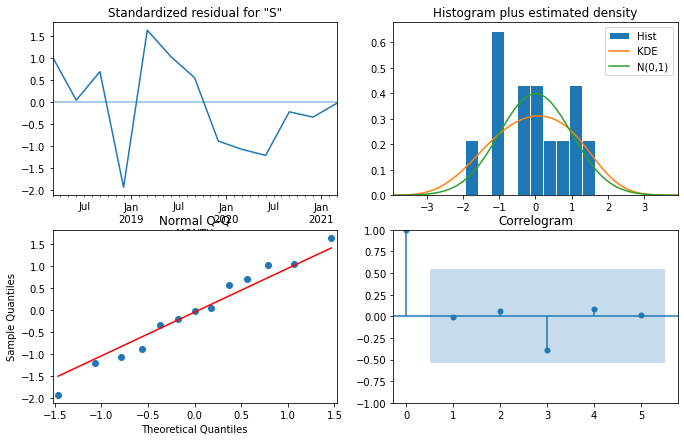

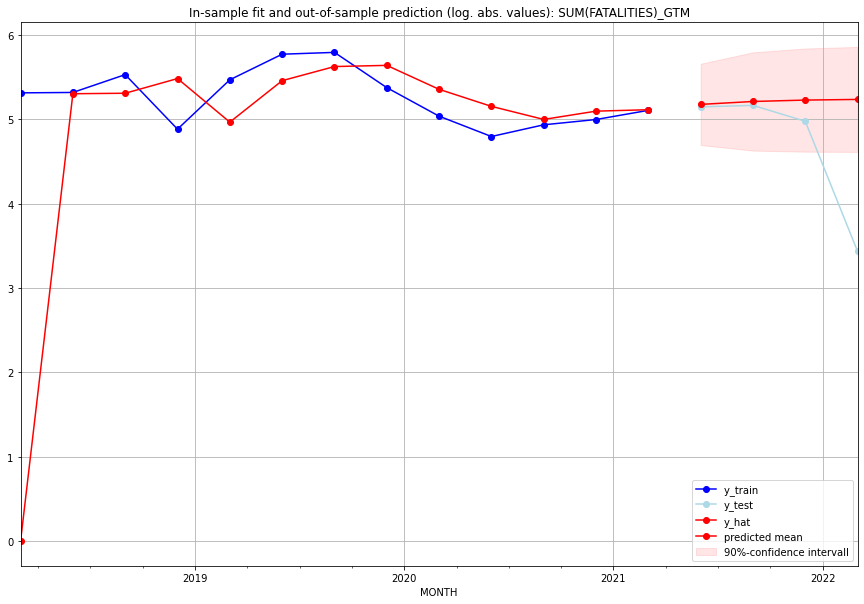

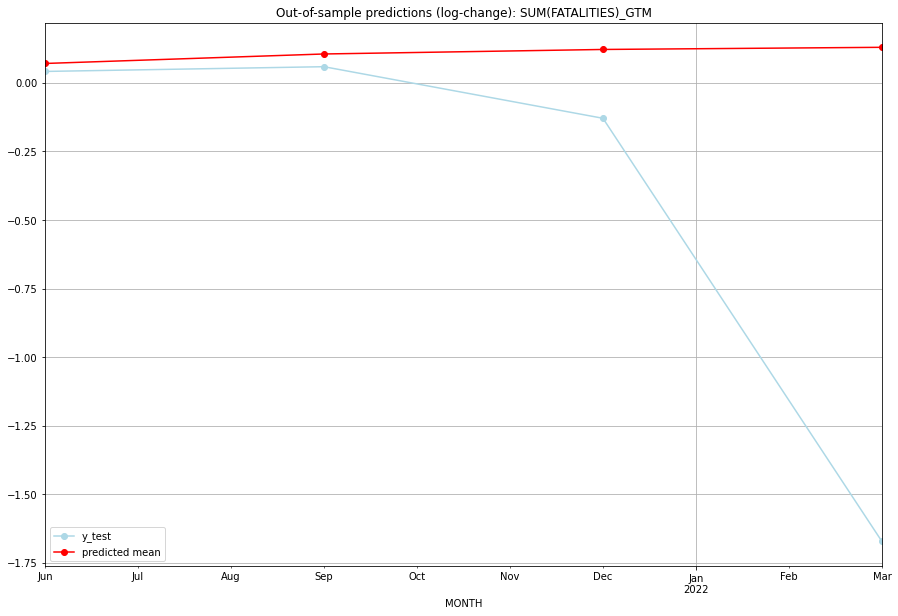

TADDA: 0.5947539865184099
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  176.070251       171.0      0.070601        0.041549   GTM   
1 2021-07-01  182.305079       174.0      0.105206        0.058841   GTM   
2 2021-10-01  185.350923       144.0      0.121686       -0.129212   GTM   
3 2022-01-01  186.817990        30.0      0.129528       -1.671958   GTM   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## GUF (90/234) #########
0
Neighbor countries: ['BRA', 'SUR']
Getting Data for GUF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 16)
y: (17, 1)
------------------------------------------------
Training started.
y_train is a

<Figure size 432x288 with 0 Axes>

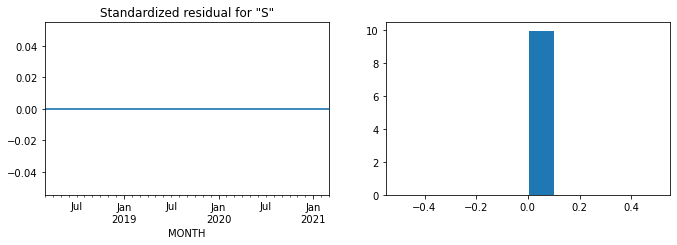

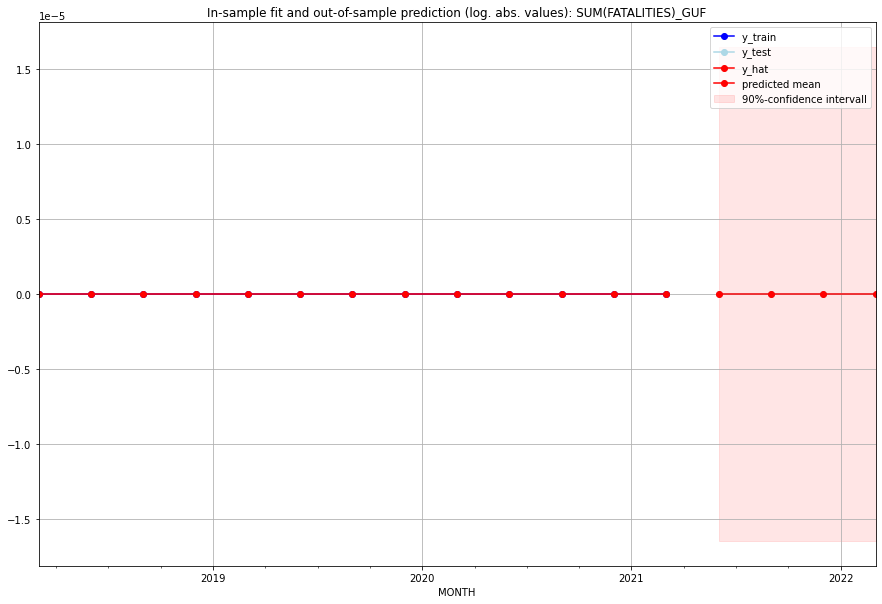

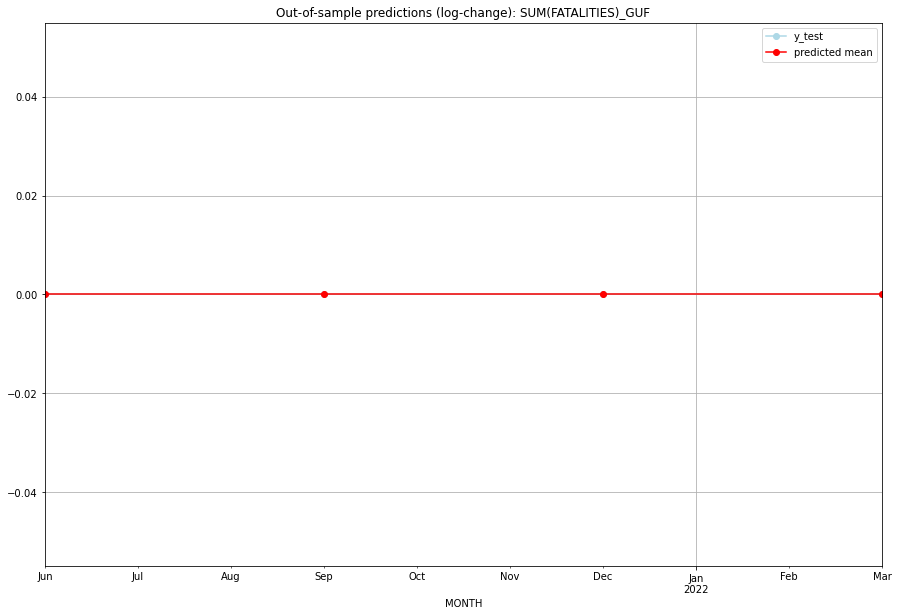

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GUF   
1 2021-07-01       0.0         0.0           0.0             0.0   GUF   
2 2021-10-01       0.0         0.0           0.0             0.0   GUF   
3 2022-01-01       0.0         0.0           0.0             0.0   GUF   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## GUM (91/234) #########
0
Neighbor countries: []
Getting Data for GUM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


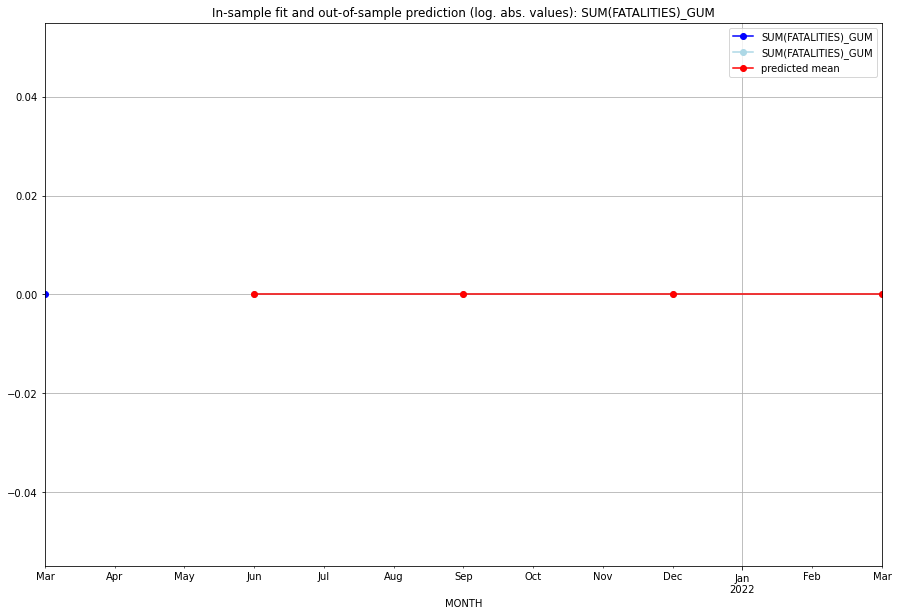

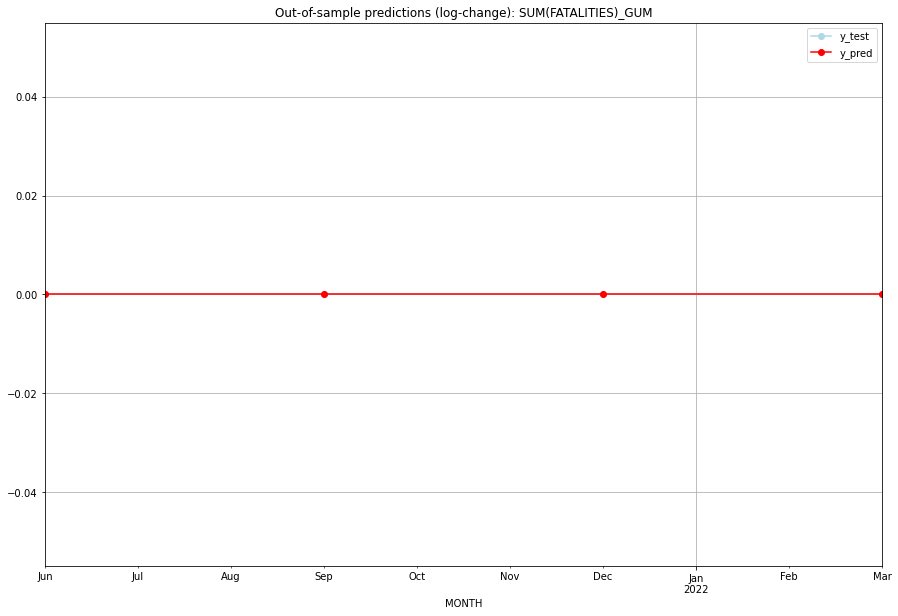

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GUM   
1 2021-07-01       0.0         0.0           0.0             0.0   GUM   
2 2021-10-01       0.0         0.0           0.0             0.0   GUM   
3 2022-01-01       0.0         0.0           0.0             0.0   GUM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## GUY (92/234) #########
0
Neighbor countries: ['BRA', 'VEN', 'SUR']
Getting Data for GUY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3050967218438657, 'fold_results': [0.34657359027997264, 0.26361985340775873]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GUY   No. Observations:                   13
Model:                SARIMAX(2, 0, 3)   Log Likelihood                  -7.572
Date:                 Wed, 19 Oct 2022   AIC                             31.145
Time:                         10:38:01   BIC                             35.664
Sample:                     01-31-2018   HQIC                            30.216
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0232      

<Figure size 432x288 with 0 Axes>

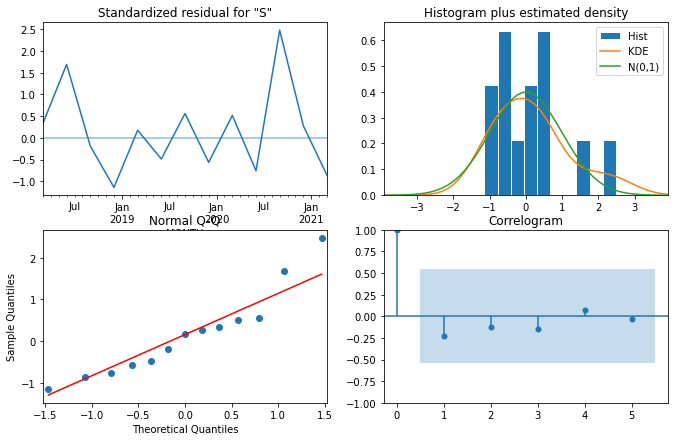

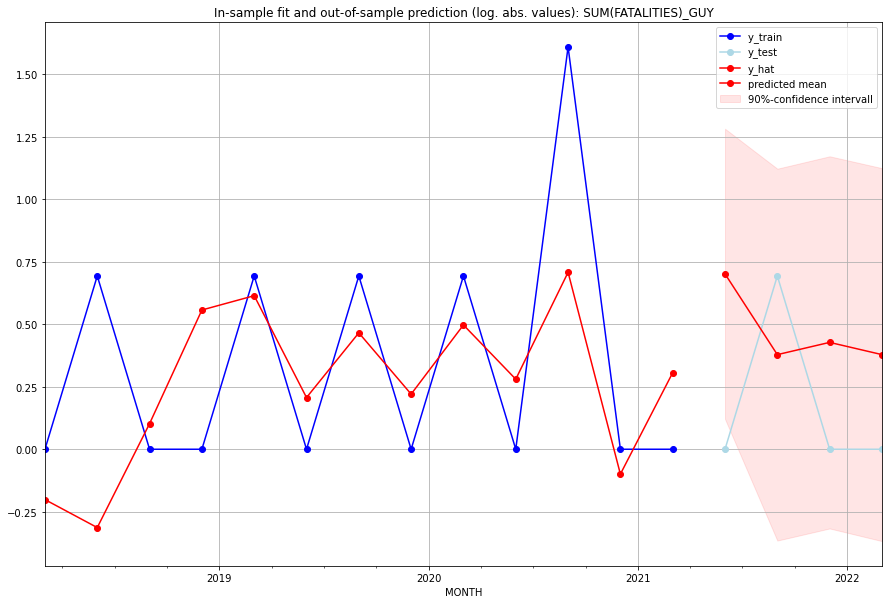

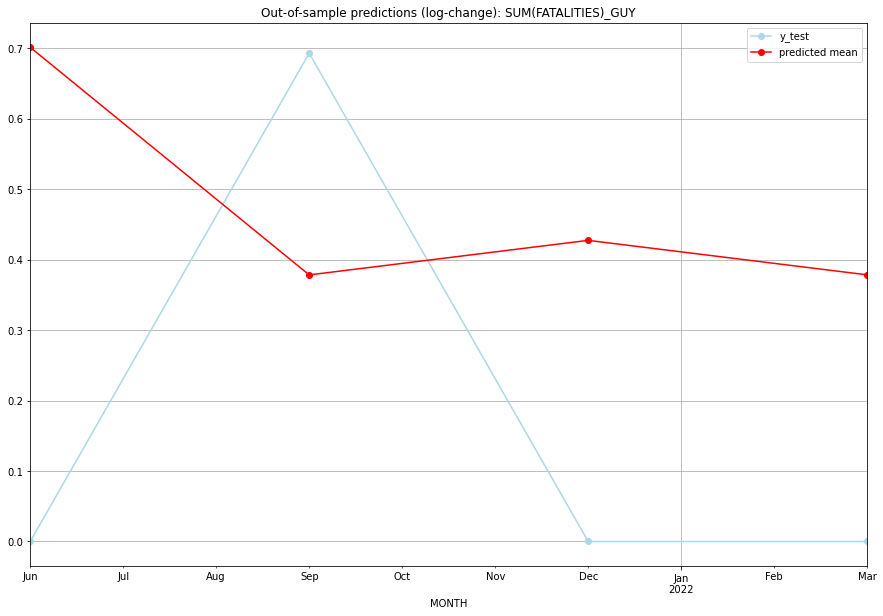

TADDA: 0.4555630566658706
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.016857         0.0      0.701540        0.000000   GUY   
1 2021-07-01  0.460006         1.0      0.378440        0.693147   GUY   
2 2021-10-01  0.533382         0.0      0.427476        0.000000   GUY   
3 2022-01-01  0.460136         0.0      0.378529        0.000000   GUY   

                                          PARAMETERS  
0  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## HKG (93/234) #########
0
Neighbor countries: ['CHN']
Getting Data for HKG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 8)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08664339756999316, 'fold_results': [0.17328679513998632, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HKG   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:38:10   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.24

<Figure size 432x288 with 0 Axes>

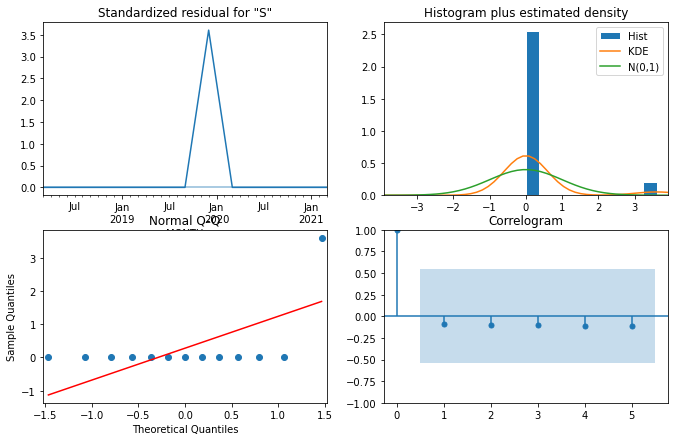

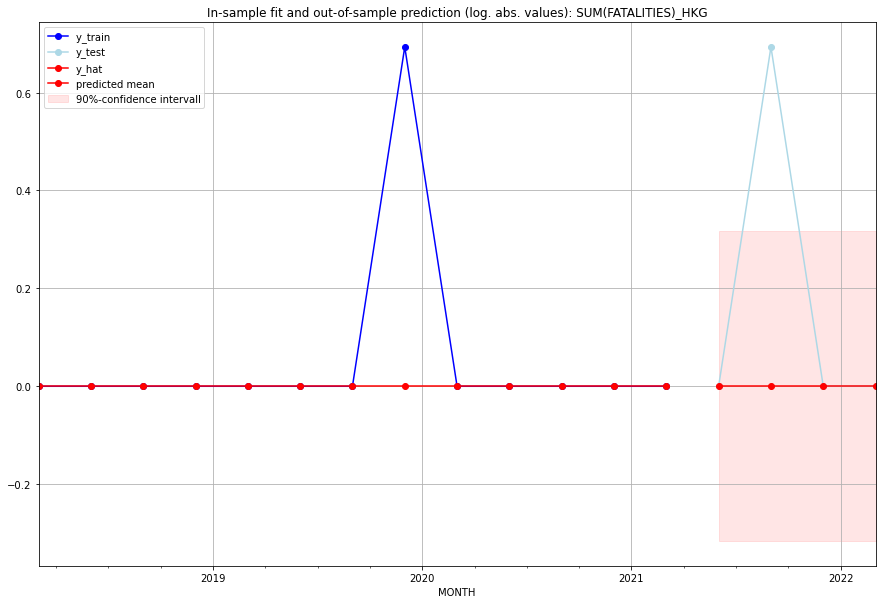

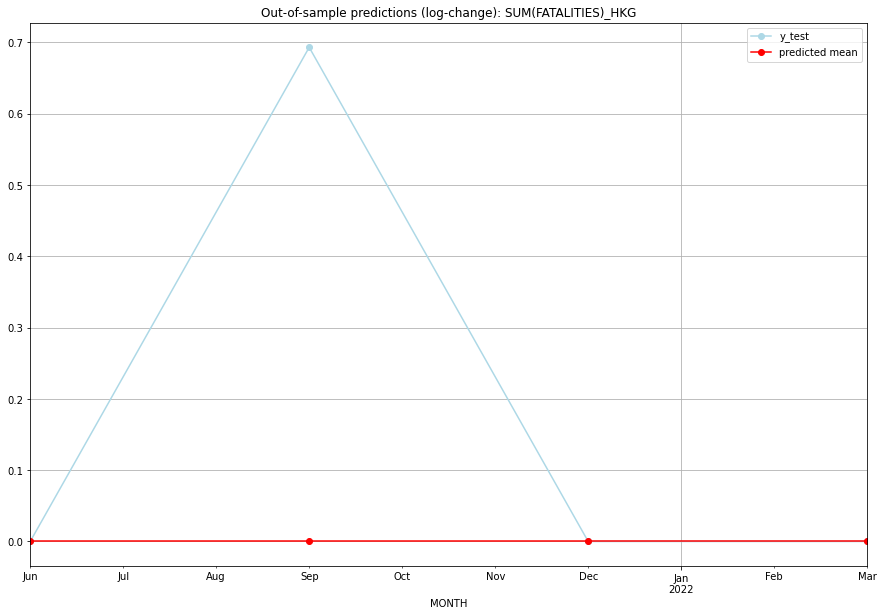

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   HKG   
1 2021-07-01       0.0         1.0           0.0        0.693147   HKG   
2 2021-10-01       0.0         0.0           0.0        0.000000   HKG   
3 2022-01-01       0.0         0.0           0.0        0.000000   HKG   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## HND (94/234) #########
0
Neighbor countries: ['SLV', 'GTM', 'NIC']
Getting Data for HND
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEAR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3286827741364765, 'fold_results': [0.3927014664844761, 0.2646640817884769]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HND   No. Observations:                   13
Model:                SARIMAX(2, 1, 2)   Log Likelihood                  -4.723
Date:                 Wed, 19 Oct 2022   AIC                             23.445
Time:                         10:38:21   BIC                             26.840
Sample:                     01-31-2018   HQIC                            22.189
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0280      0.

<Figure size 432x288 with 0 Axes>

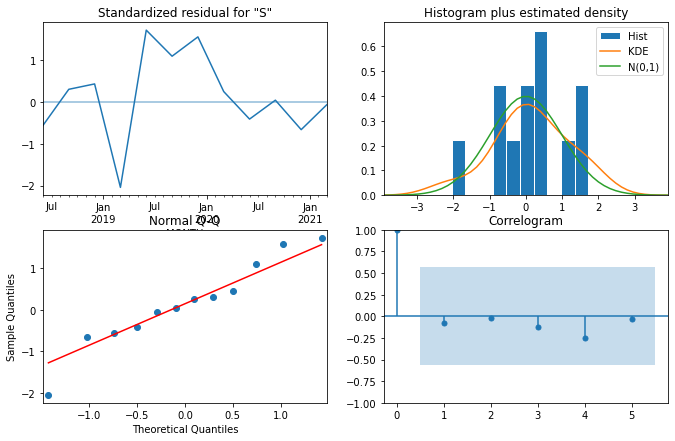

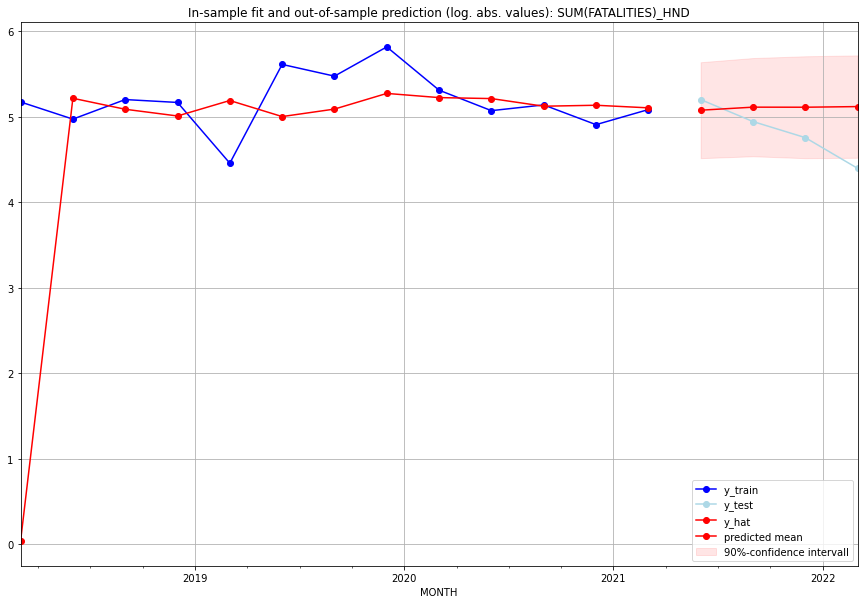

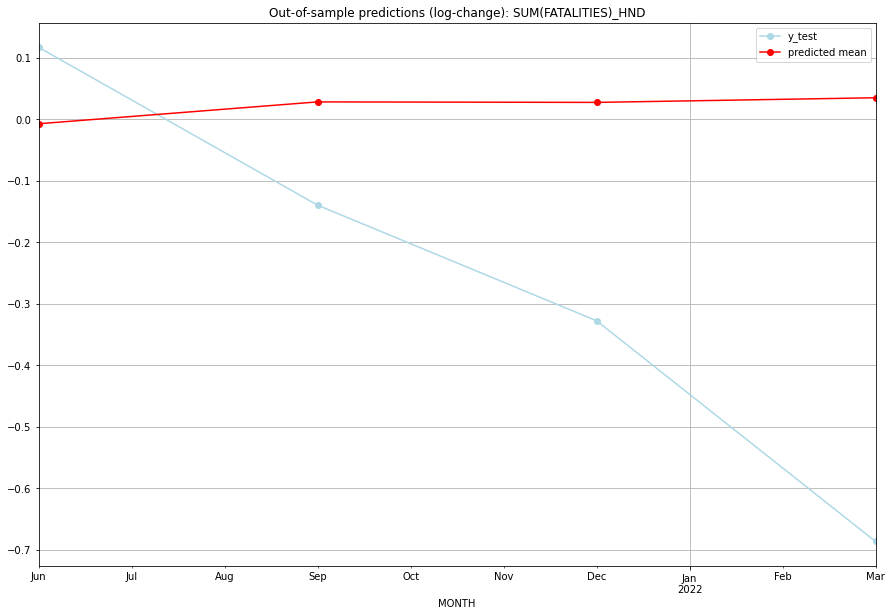

TADDA: 0.36692172380207544
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  158.830841       180.0     -0.007288        0.117093   HND   
1 2021-07-01  164.618529       139.0      0.028283       -0.139762   HND   
2 2021-10-01  164.482924       115.0      0.027464       -0.327814   HND   
3 2022-01-01  165.734222        80.0      0.034997       -0.686955   HND   

                                          PARAMETERS  
0  {'params': [2, (2, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## HRV (95/234) #########
0
Neighbor countries: ['HUN', 'SVN', 'SRB', 'BIH', 'MNE']
Getting Data for HRV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.1732867951399863, 'fold_results': [0.3465735902799726, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HRV   No. Observations:                   13
Model:                SARIMAX(0, 0, 3)   Log Likelihood                  -2.283
Date:                 Wed, 19 Oct 2022   AIC                             14.565
Time:                         10:38:35   BIC                             17.390
Sample:                     01-31-2018   HQIC                            13.985
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0191      0.033      0.585 

<Figure size 432x288 with 0 Axes>

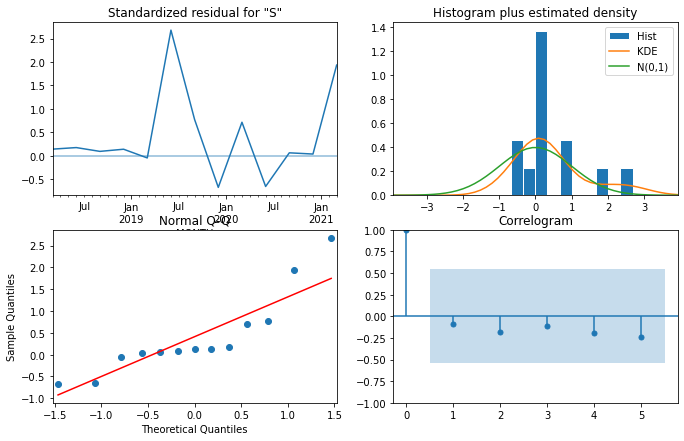

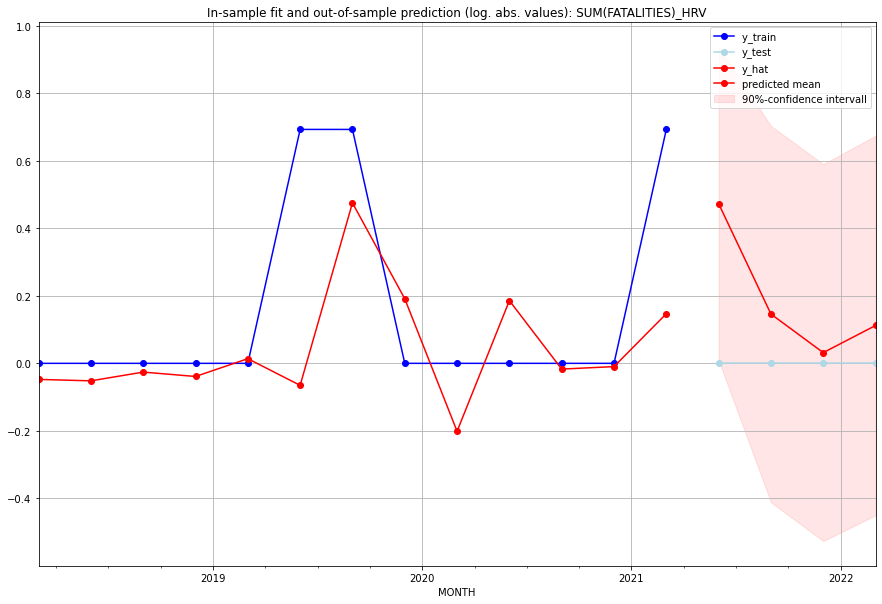

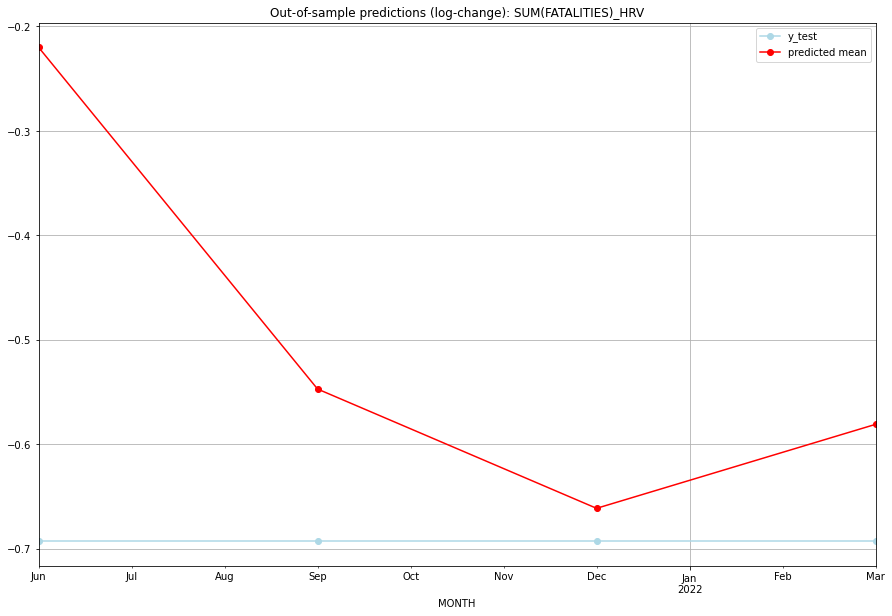

TADDA: 0.19078241956646144
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.605140         0.0     -0.219936       -0.693147   HRV   
1 2021-07-01  0.157175         0.0     -0.547165       -0.693147   HRV   
2 2021-10-01  0.032270         0.0     -0.661387       -0.693147   HRV   
3 2022-01-01  0.118711         0.0     -0.580970       -0.693147   HRV   

                                          PARAMETERS  
0  {'params': [1, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## HTI (96/234) #########
0
Neighbor countries: ['DOM']
Getting Data for HTI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 8)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.21734972283551024, 'fold_results': [0.2626393030057721, 0.17206014266524838]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HTI   No. Observations:                   13
Model:                SARIMAX(1, 1, 0)   Log Likelihood                 -13.078
Date:                 Wed, 19 Oct 2022   AIC                             32.156
Time:                         10:38:49   BIC                             33.611
Sample:                     01-31-2018   HQIC                            31.617
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0335      

<Figure size 432x288 with 0 Axes>

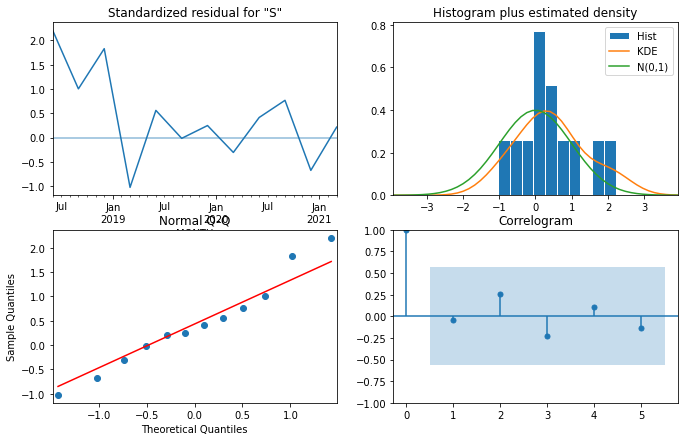

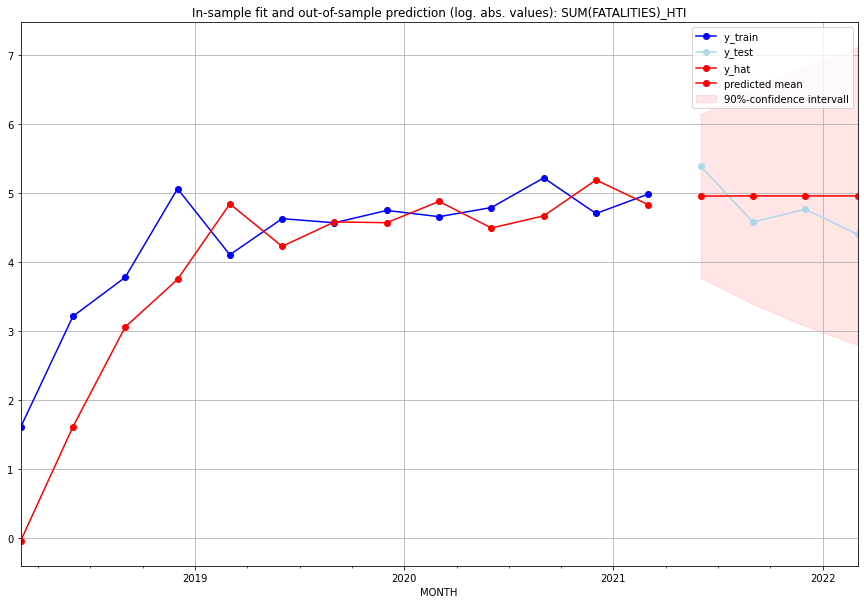

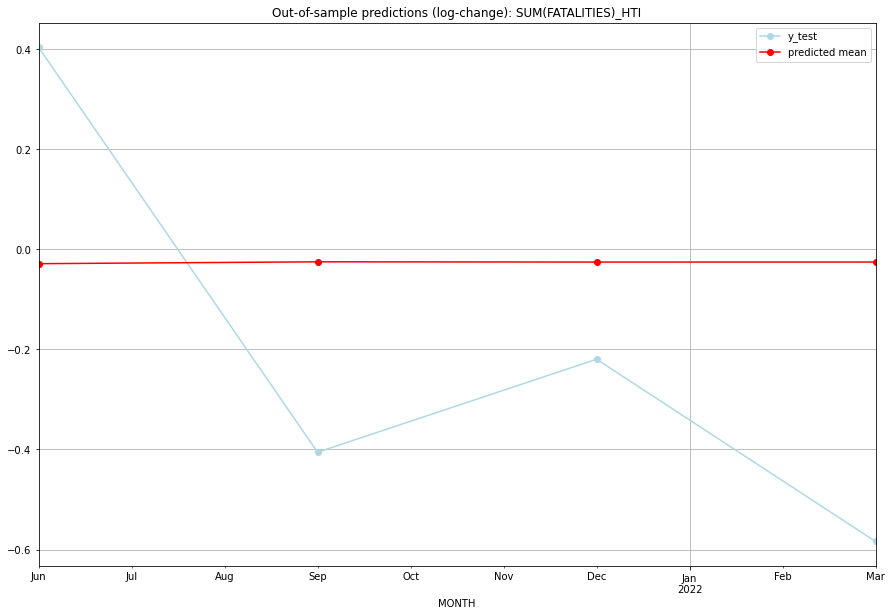

TADDA: 0.3983675130433084
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  141.811448       219.0     -0.028907        0.403195   HTI   
1 2021-07-01  142.343237        97.0     -0.025191       -0.405465   HTI   
2 2021-10-01  142.274751       117.0     -0.025668       -0.219748   HTI   
3 2022-01-01  142.283555        81.0     -0.025607       -0.583713   HTI   

                                          PARAMETERS  
0  {'params': [1, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## HUN (97/234) #########
0
Neighbor countries: ['SVK', 'HRV', 'ROU', 'UKR', 'AUT', 'SVN', 'SRB']
Getting Data for HUN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 56)
y: (9, 1)
----------------------------------------------

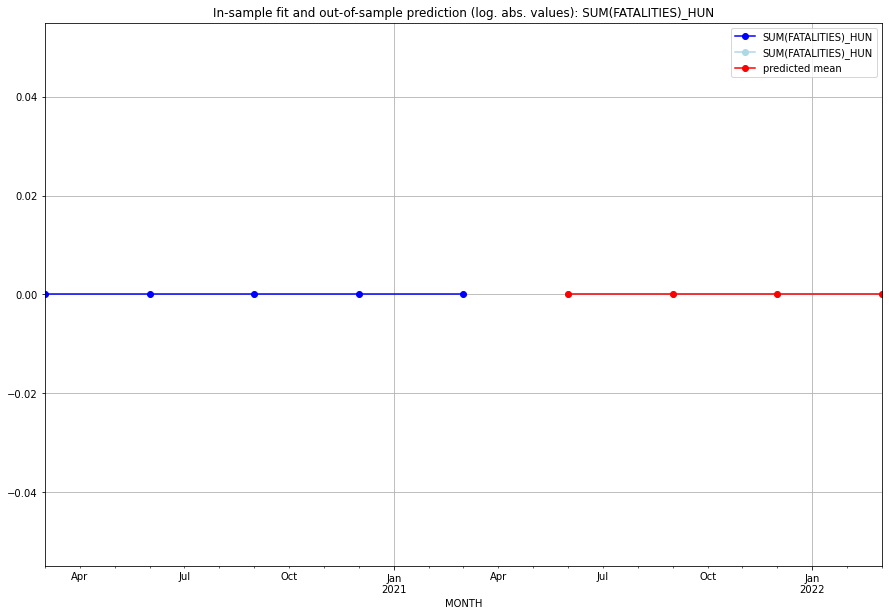

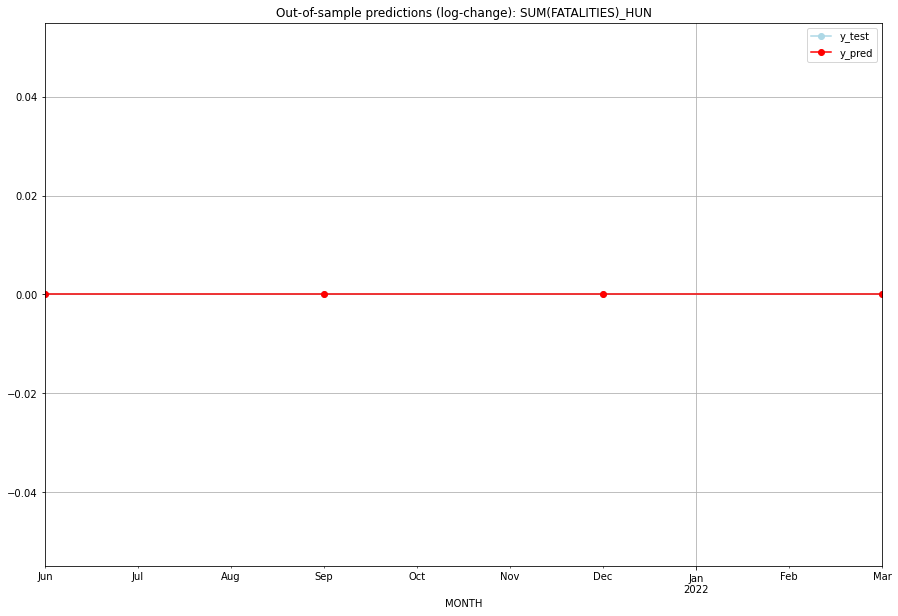

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   HUN   
1 2021-07-01       0.0         0.0           0.0             0.0   HUN   
2 2021-10-01       0.0         0.0           0.0             0.0   HUN   
3 2022-01-01       0.0         0.0           0.0             0.0   HUN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## IDN (98/234) #########
0
Neighbor countries: ['MYS', 'TLS', 'PNG']
Getting Data for IDN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (29, 24)
y: (29, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5363456384099896, 'fold_results': [0.6854016916900609, 0.694415330400328, nan, 0.3669235631783514, 0.3986419683712181]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IDN   No. Observations:                   25
Model:                SARIMAX(2, 1, 3)   Log Likelihood                 -20.426
Date:                 Wed, 19 Oct 2022   AIC                             58.853
Time:                         10:39:04   BIC                             69.455
Sample:                     01-31-2015   HQIC                            61.666
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

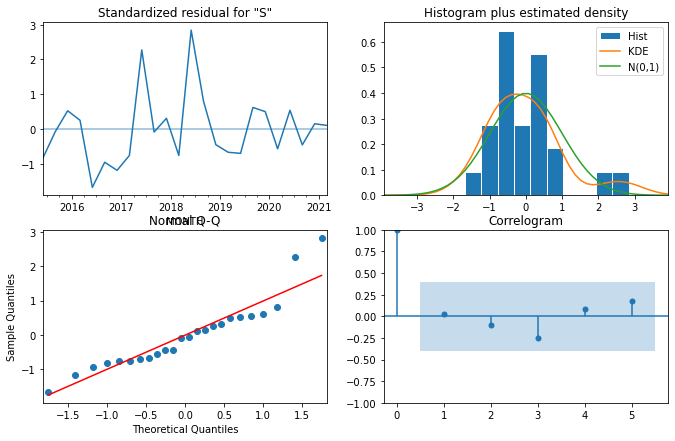

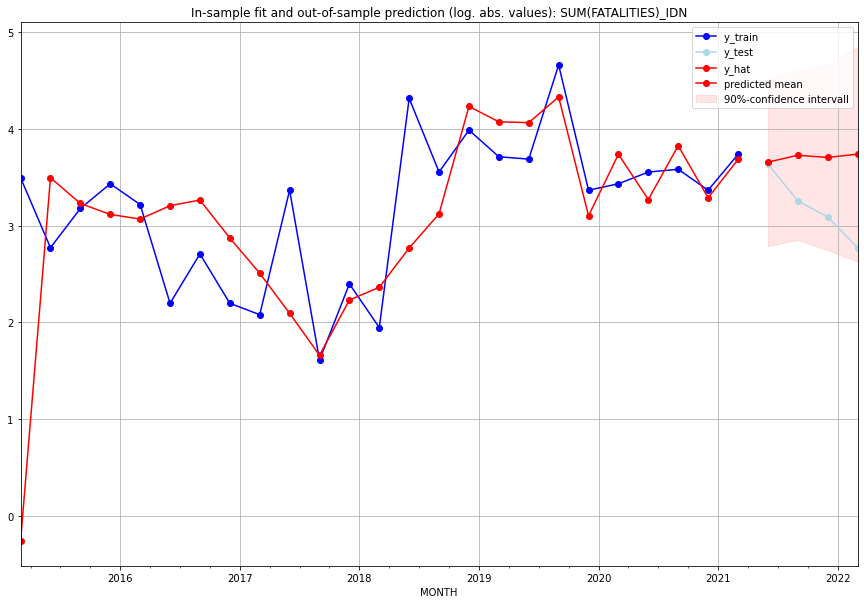

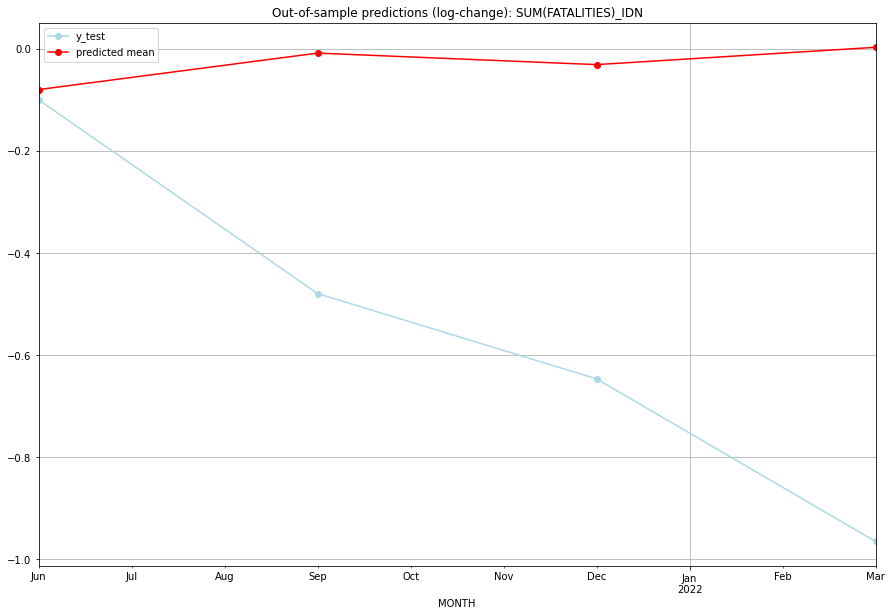

TADDA: 0.5191249184644925
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  37.765002        37.0     -0.080152       -0.100083   IDN   
1 2021-07-01  40.635538        25.0     -0.008716       -0.479573   IDN   
2 2021-10-01  39.707359        21.0     -0.031261       -0.646627   IDN   
3 2022-01-01  41.110671        15.0      0.002632       -0.965081   IDN   

                                          PARAMETERS  
0  {'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## IMN (99/234) #########
0
Neighbor countries: []
Getting Data for IMN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV

<Figure size 432x288 with 0 Axes>

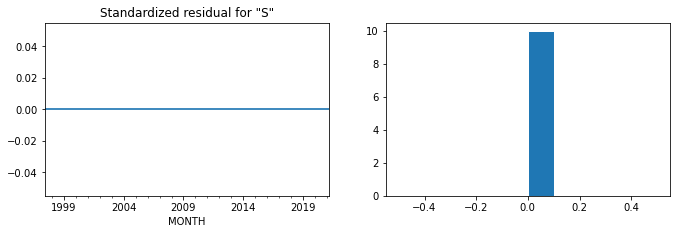

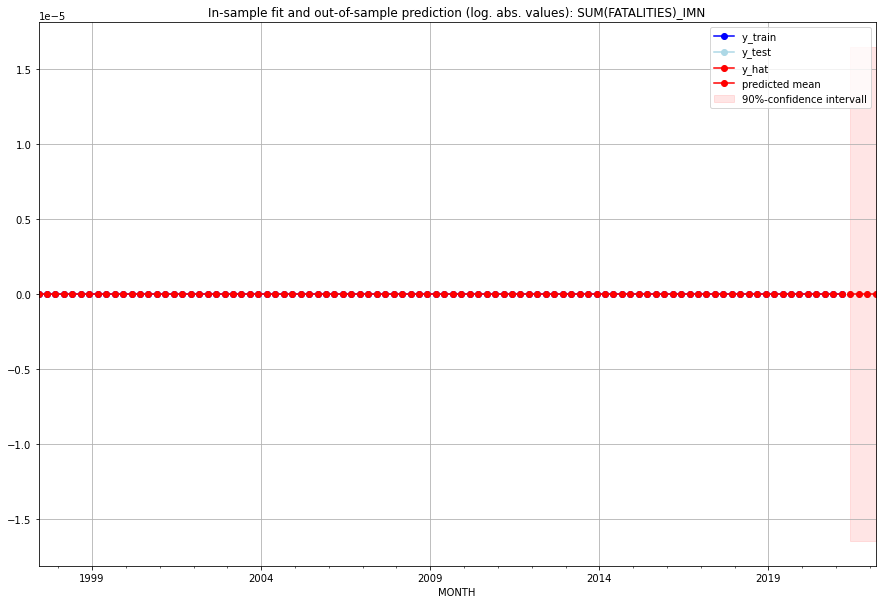

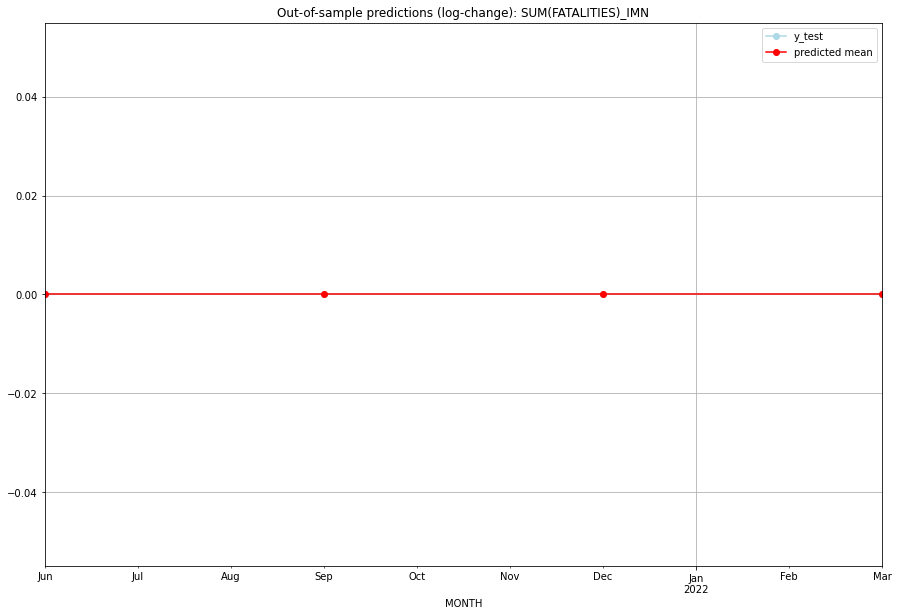

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   IMN   
1 2021-07-01       0.0         0.0           0.0             0.0   IMN   
2 2021-10-01       0.0         0.0           0.0             0.0   IMN   
3 2022-01-01       0.0         0.0           0.0             0.0   IMN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## IND (100/234) #########
0
Neighbor countries: ['PAK', 'CHN', 'MMR', 'BGD', 'BTN', 'NPL', 'LKA']
Getting Data for IND
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 56)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.19847857448446135, 'fold_results': [0.21466840237776275, nan, 0.20482741247520675, 0.17593990860041453]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IND   No. Observations:                   21
Model:                SARIMAX(1, 0, 2)   Log Likelihood                  -3.997
Date:                 Wed, 19 Oct 2022   AIC                             17.994
Time:                         10:39:19   BIC                             23.216
Sample:                     01-31-2016   HQIC                            19.127
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------


<Figure size 432x288 with 0 Axes>

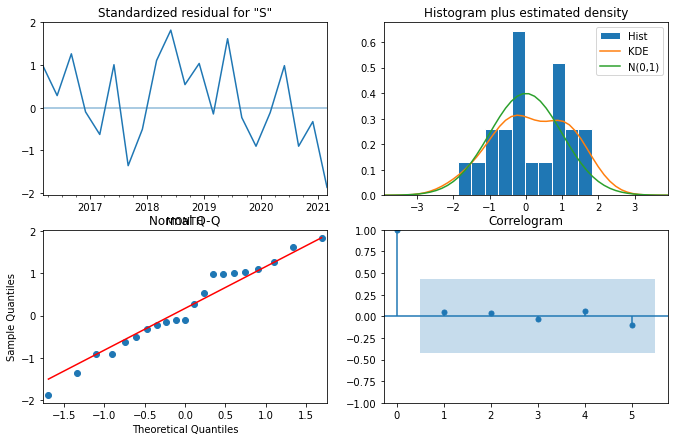

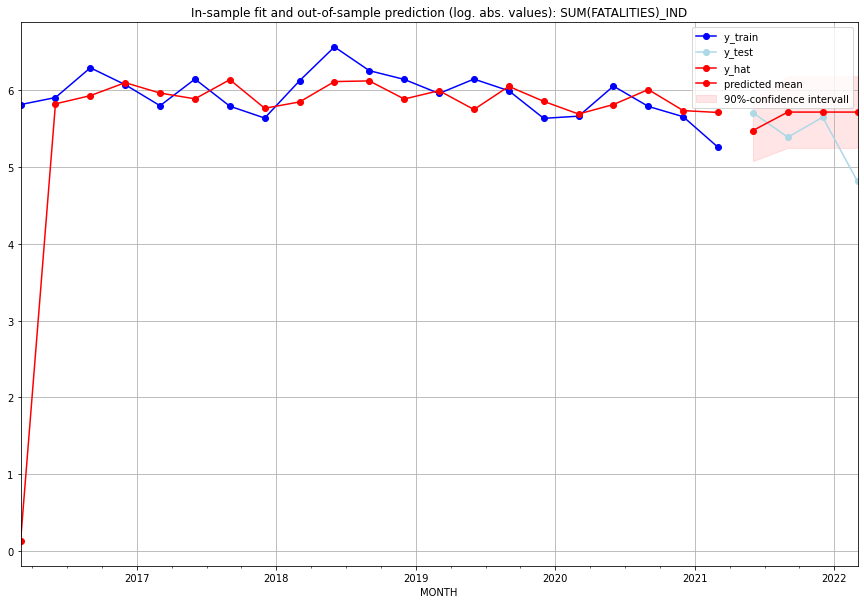

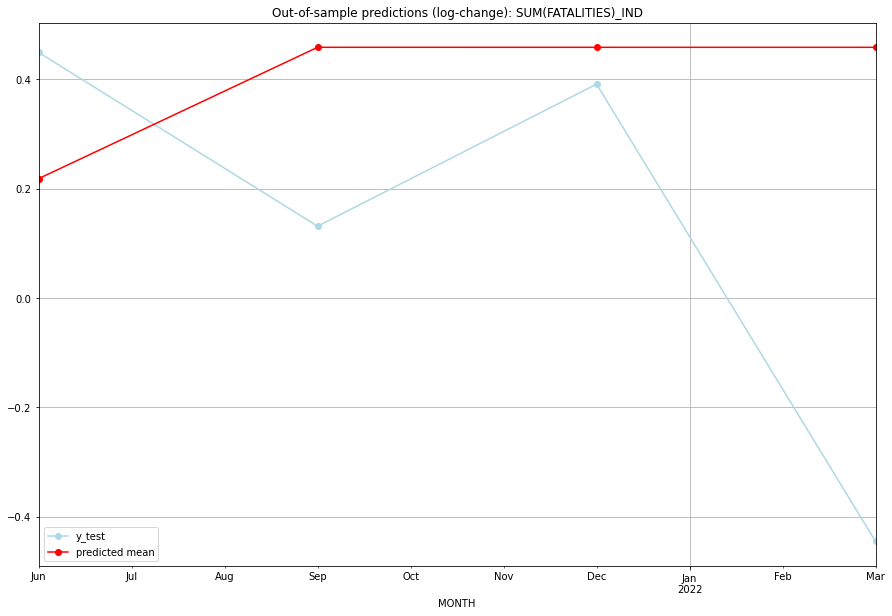

TADDA: 0.4972153201866307
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  237.893210       300.0      0.218521        0.449615   IND   
1 2021-07-01  302.805363       218.0      0.458892        0.131576   IND   
2 2021-10-01  302.801983       283.0      0.458881        0.391479   IND   
3 2022-01-01  302.798603       122.0      0.458870       -0.445311   IND   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## IRL (101/234) #########
0
Neighbor countries: ['GBR']
Getting Data for IRL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. 

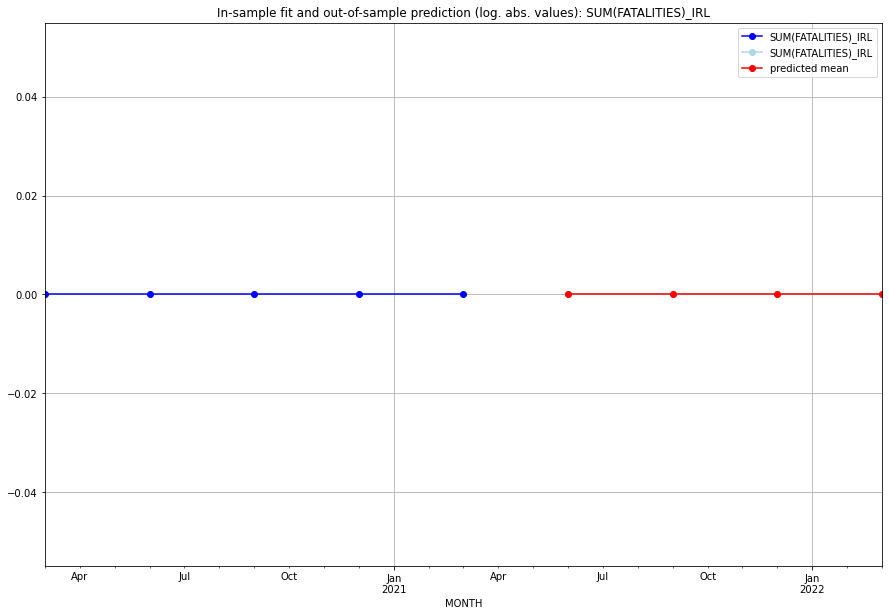

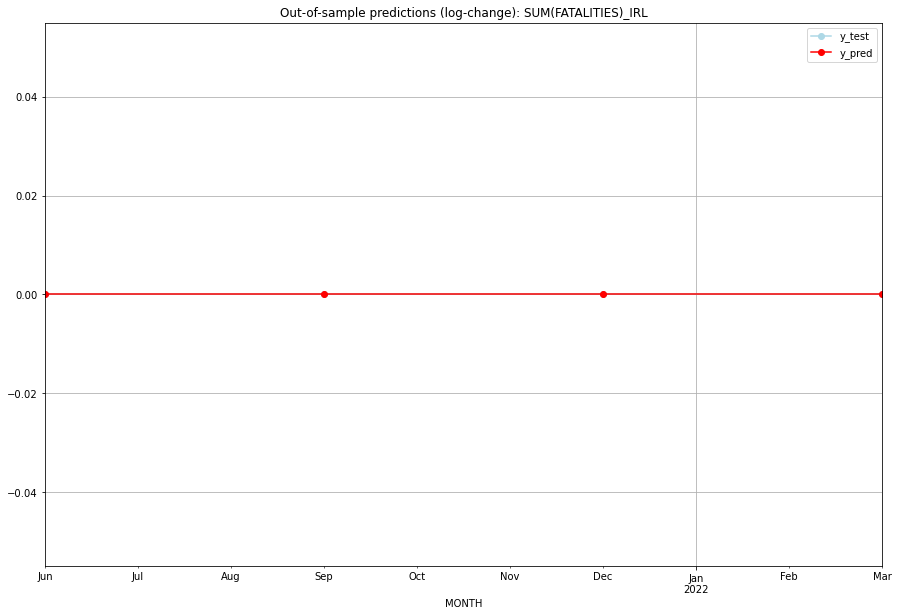

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   IRL   
1 2021-07-01       0.0         0.0           0.0             0.0   IRL   
2 2021-10-01       0.0         0.0           0.0             0.0   IRL   
3 2022-01-01       0.0         0.0           0.0             0.0   IRL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## IRN (102/234) #########
0
Neighbor countries: ['IRQ', 'TKM', 'AFG', 'PAK', 'AZE', 'TUR', 'ARM']
Getting Data for IRN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 56)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.8917668002849736, 'fold_results': [0.929329533503037, 0.8405654950357838, nan, 0.9054053723161]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IRN   No. Observations:                   21
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -30.514
Date:                 Wed, 19 Oct 2022   AIC                             69.028
Time:                         10:39:36   BIC                             73.011
Sample:                     01-31-2016   HQIC                            69.805
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1   

<Figure size 432x288 with 0 Axes>

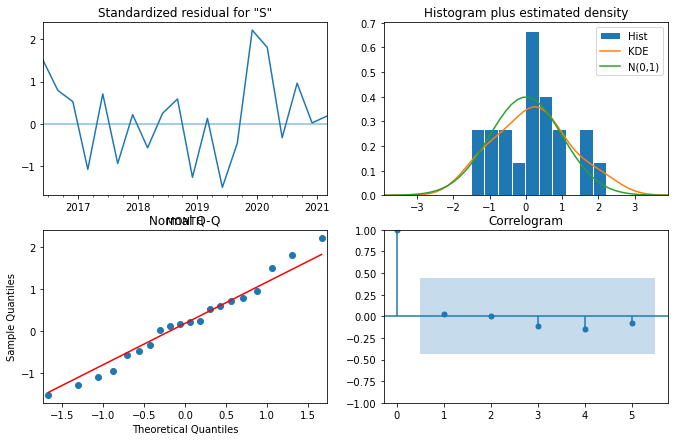

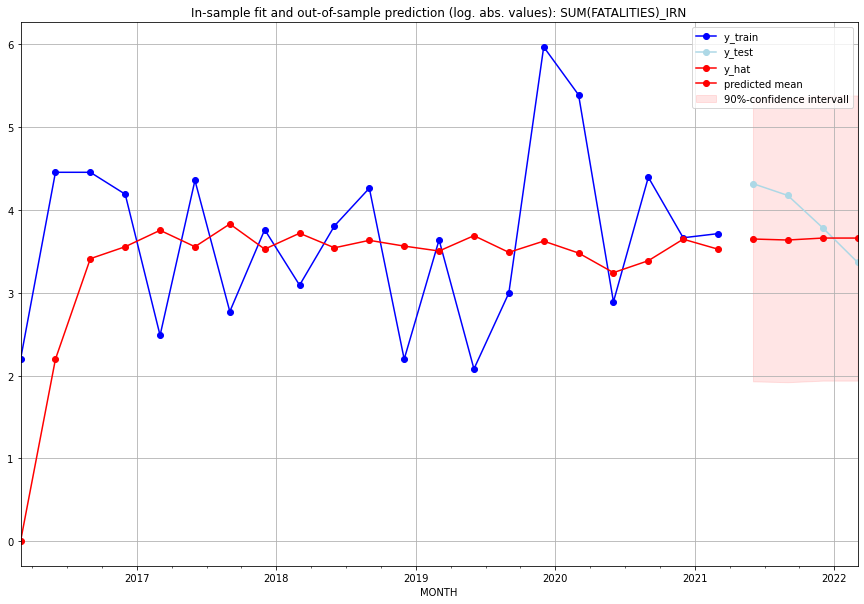

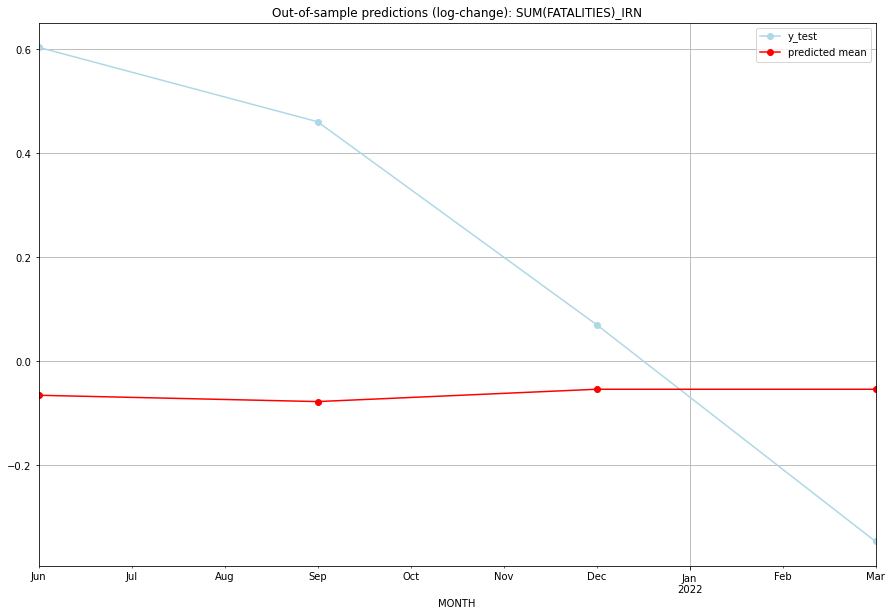

TADDA: 0.45498792669386434
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  37.415576        74.0     -0.065109        0.603916   IRN   
1 2021-07-01  36.951383        64.0     -0.077266        0.460815   IRN   
2 2021-10-01  37.861179        43.0     -0.053576        0.070618   IRN   
3 2022-01-01  37.861179        28.0     -0.053576       -0.346276   IRN   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## IRQ (103/234) #########
0
Neighbor countries: ['SYR', 'TUR', 'IRN', 'JOR', 'SAU', 'KWT']
Getting Data for IRQ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 48)
y: (25, 1)
------------------------------------------------
Train

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.41733362666364254, 'fold_results': [0.608265642826264, 0.473243169566925, 0.23493259611158224, 0.35289309814979886]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IRQ   No. Observations:                   21
Model:                SARIMAX(2, 0, 0)   Log Likelihood                  -8.850
Date:                 Wed, 19 Oct 2022   AIC                             29.699
Time:                         10:39:54   BIC                             35.966
Sample:                     01-31-2016   HQIC                            31.059
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

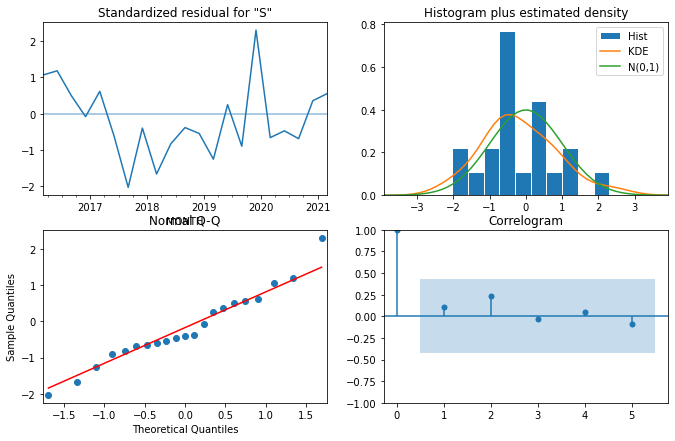

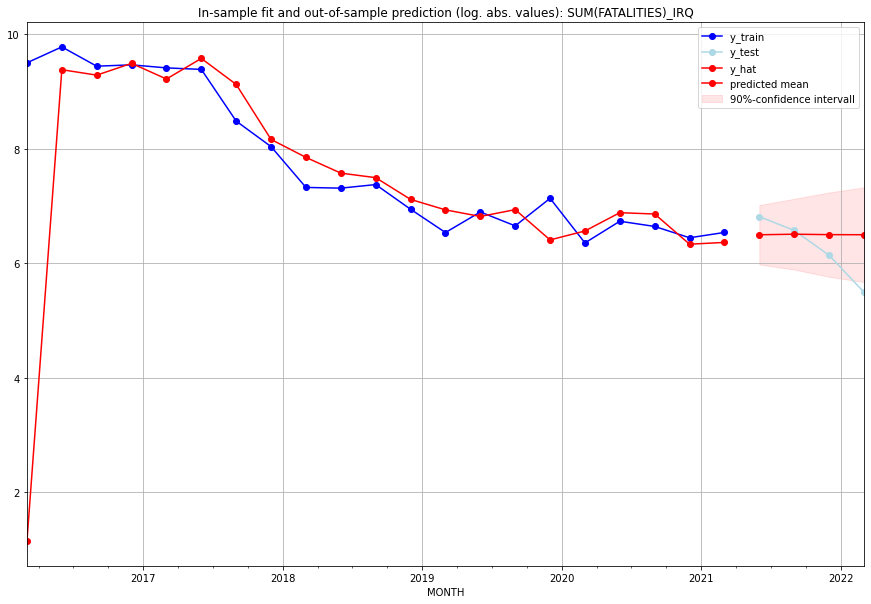

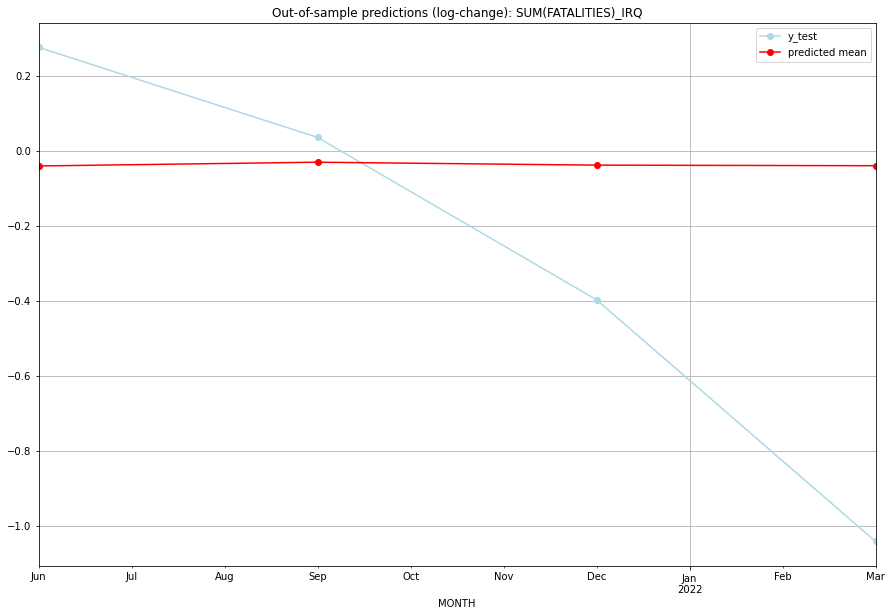

TADDA: 0.4537808508903878
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  660.662615       907.0     -0.040485        0.276003   IRQ   
1 2021-07-01  667.323715       713.0     -0.030469        0.035642   IRQ   
2 2021-10-01  662.109485       462.0     -0.038301       -0.397514   IRQ   
3 2022-01-01  661.101445       242.0     -0.039822       -1.042180   IRQ   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## ISL (104/234) #########
0
Neighbor countries: []
Getting Data for ISL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insuf

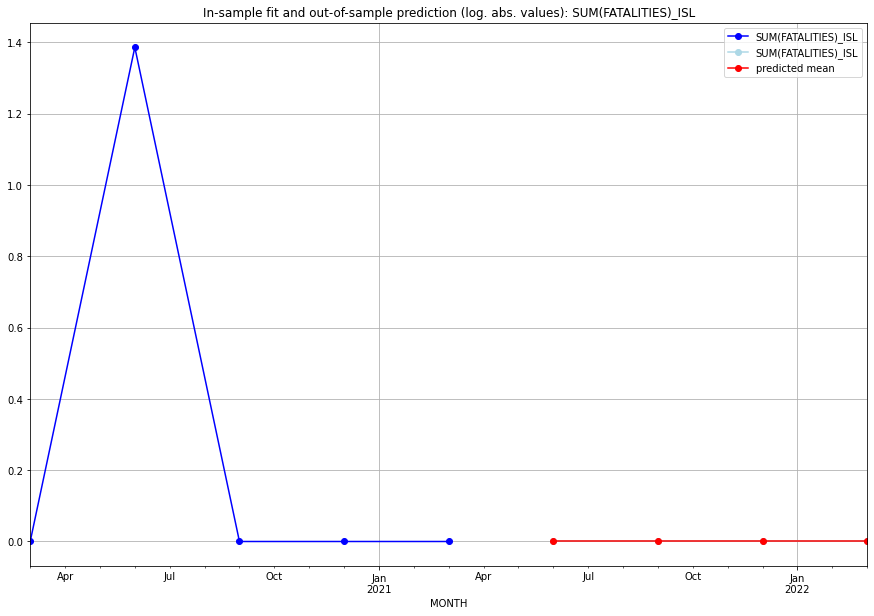

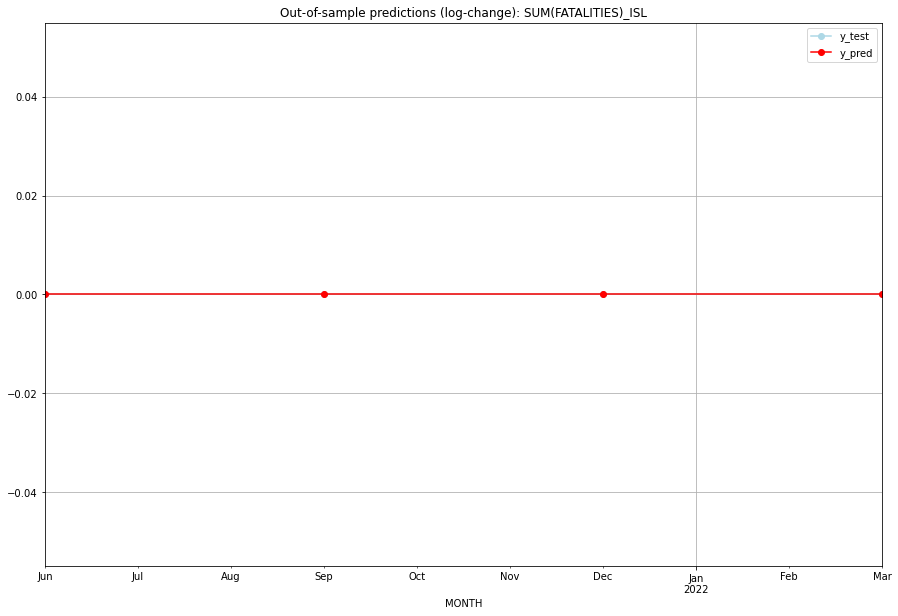

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ISL   
1 2021-07-01       0.0         0.0           0.0             0.0   ISL   
2 2021-10-01       0.0         0.0           0.0             0.0   ISL   
3 2022-01-01       0.0         0.0           0.0             0.0   ISL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## ISR (105/234) #########
0
Neighbor countries: ['JOR', 'LBN', 'SYR', 'EGY', 'PSE']
Getting Data for ISR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 40)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.2872049076345138, 'fold_results': [2.2129225589092023, 0.4382146814023611, 0.7479327680373132, 1.7497496221891786]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ISR   No. Observations:                   21
Model:                SARIMAX(2, 0, 1)   Log Likelihood                 -30.074
Date:                 Wed, 19 Oct 2022   AIC                             74.148
Time:                         10:40:10   BIC                             81.459
Sample:                     01-31-2016   HQIC                            75.734
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

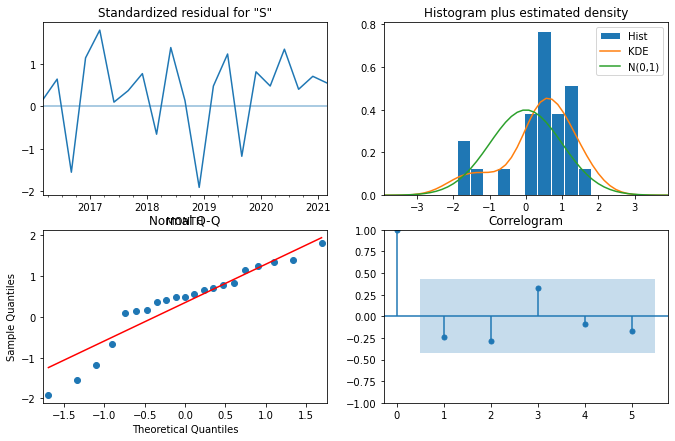

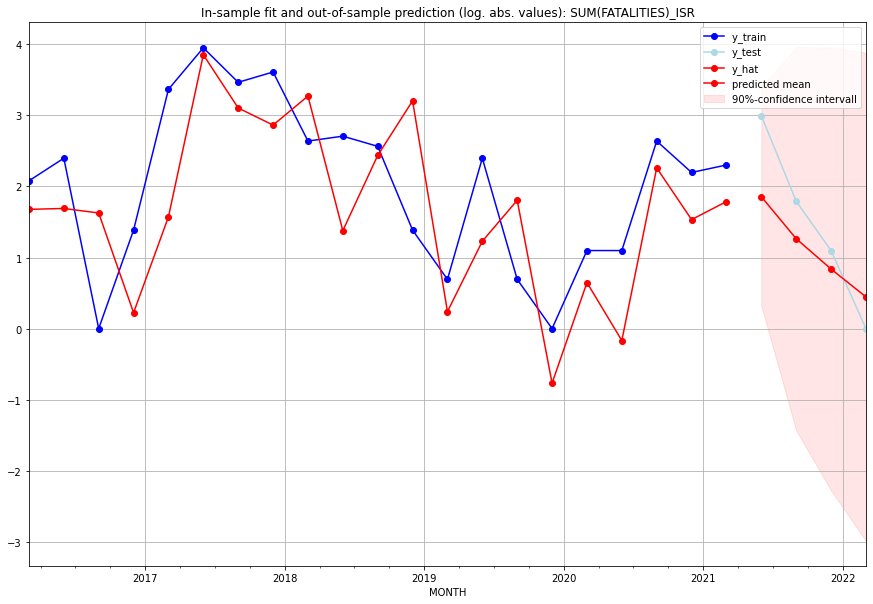

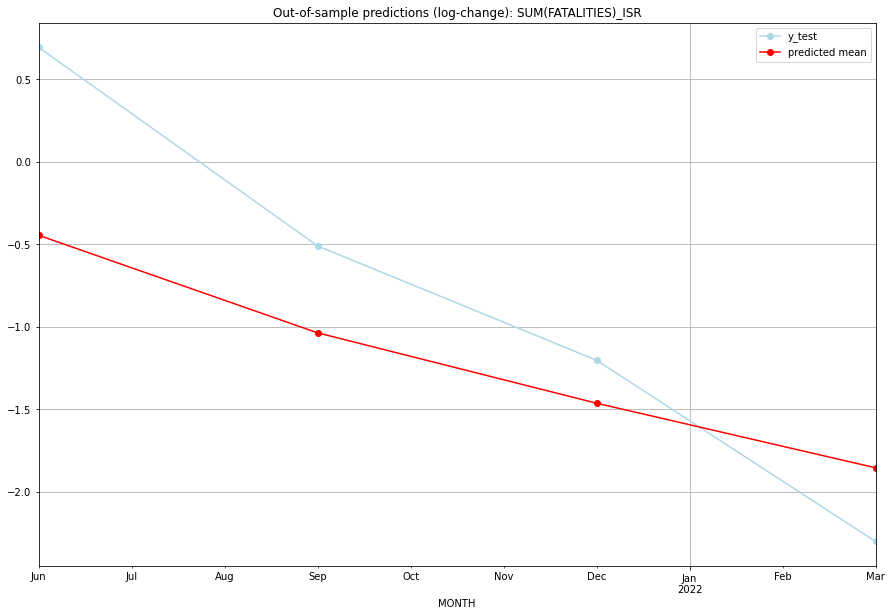

TADDA: 0.7048110404577385
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  5.400982        19.0     -0.446134        0.693147   ISR   
1 2021-07-01  2.543040         5.0     -1.037600       -0.510826   ISR   
2 2021-10-01  1.312514         2.0     -1.464250       -1.203973   ISR   
3 2022-01-01  0.563268         0.0     -1.855807       -2.302585   ISR   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## ITA (106/234) #########
0
Neighbor countries: ['CHE', 'SMR', 'FRA', 'TUN', 'AUT', 'SVN', 'VAT']
Getting Data for ITA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 56)
y: (9, 1)
------------------------------------------------
Traini

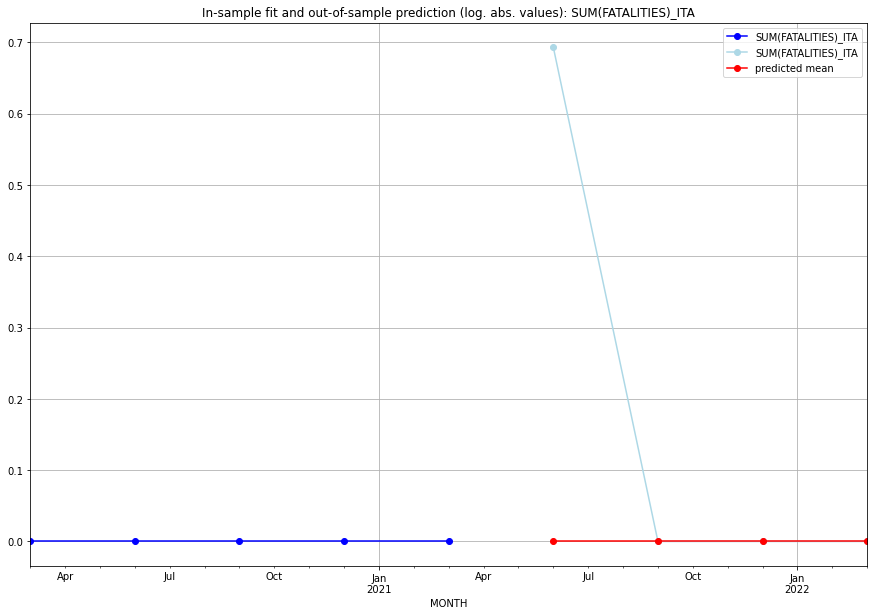

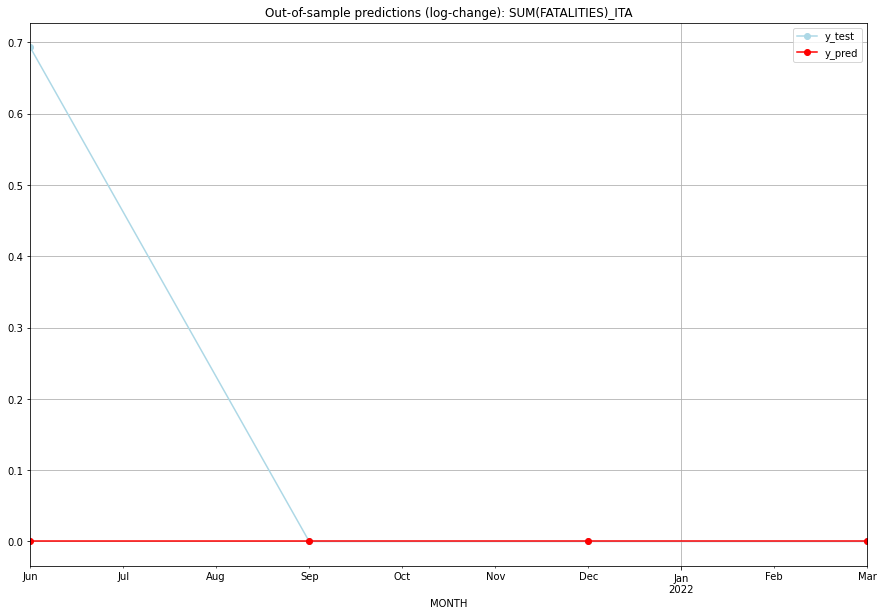

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.693147           0.0        0.693147   ITA   
1 2021-07-01       0.0    0.000000           0.0        0.000000   ITA   
2 2021-10-01       0.0    0.000000           0.0        0.000000   ITA   
3 2022-01-01       0.0    0.000000           0.0        0.000000   ITA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## JAM (107/234) #########
0
Neighbor countries: []
Getting Data for JAM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.11720750533180913, 'fold_results': [0.16710978973756596, 0.06730522092605229]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_JAM   No. Observations:                   13
Model:                SARIMAX(3, 1, 1)   Log Likelihood                   3.116
Date:                 Wed, 19 Oct 2022   AIC                              3.768
Time:                         10:40:22   BIC                              6.193
Sample:                     01-31-2018   HQIC                             2.870
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0097     

<Figure size 432x288 with 0 Axes>

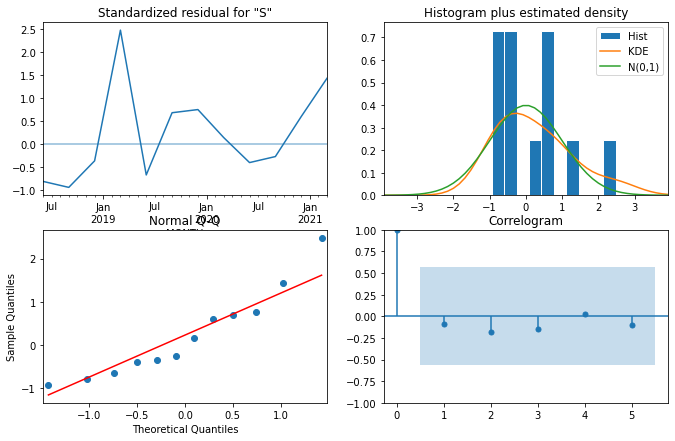

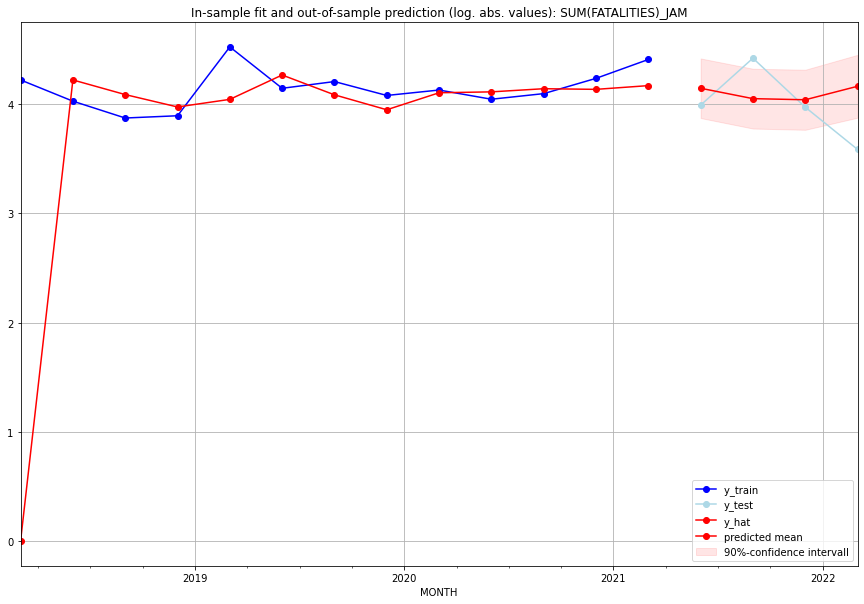

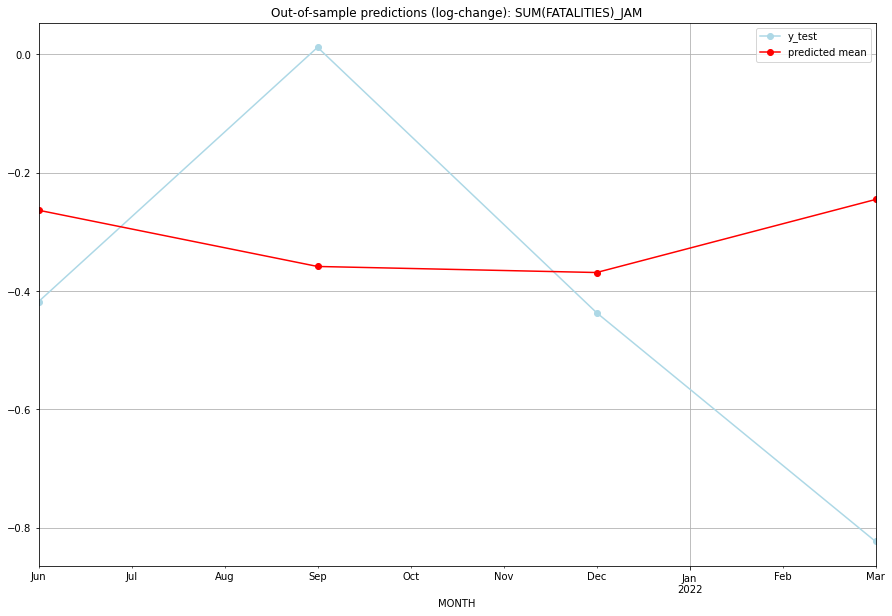

TADDA: 0.3823050987799349
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  62.020285        53.0     -0.263263       -0.417735   JAM   
1 2021-07-01  56.305894        82.0     -0.358316        0.012121   JAM   
2 2021-10-01  55.722298        52.0     -0.368552       -0.436427   JAM   
3 2022-01-01  63.176580        35.0     -0.245081       -0.823200   JAM   

                                          PARAMETERS  
0  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## JEY (108/234) #########
0
Neighbor countries: []
Getting Data for JEY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSC

<Figure size 432x288 with 0 Axes>

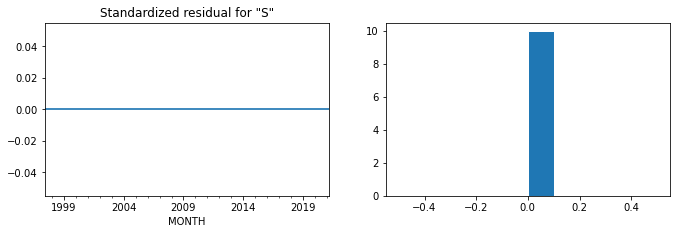

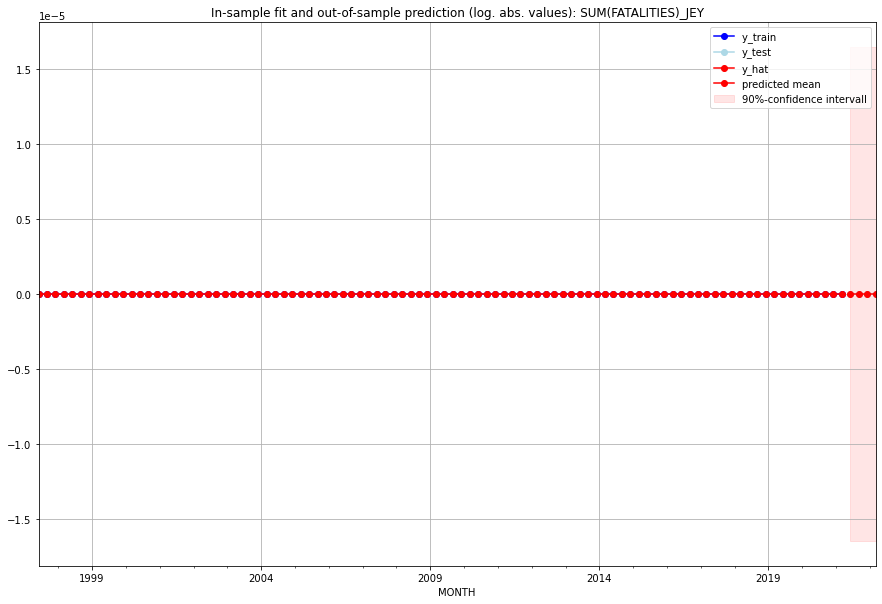

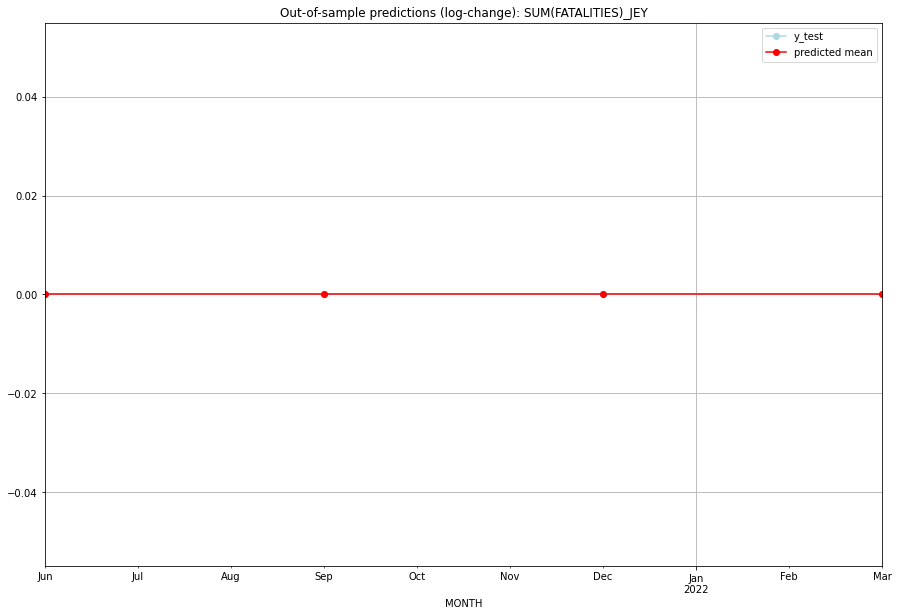

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   JEY   
1 2021-07-01       0.0         0.0           0.0             0.0   JEY   
2 2021-10-01       0.0         0.0           0.0             0.0   JEY   
3 2022-01-01       0.0         0.0           0.0             0.0   JEY   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:05
######## JOR (109/234) #########
0
Neighbor countries: ['IRQ', 'SAU', 'SYR', 'ISR', 'PSE']
Getting Data for JOR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 40)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6745891226188256, 'fold_results': [0.6606957604688368, 0.7489330683884978, 0.566134722143927, 0.7225929394740411]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_JOR   No. Observations:                   21
Model:                SARIMAX(1, 0, 0)   Log Likelihood                 -32.316
Date:                 Wed, 19 Oct 2022   AIC                             68.632
Time:                         10:40:44   BIC                             70.721
Sample:                     01-31-2016   HQIC                            69.085
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

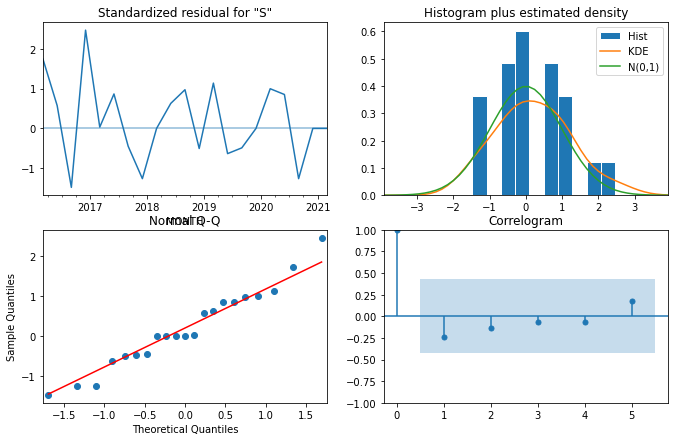

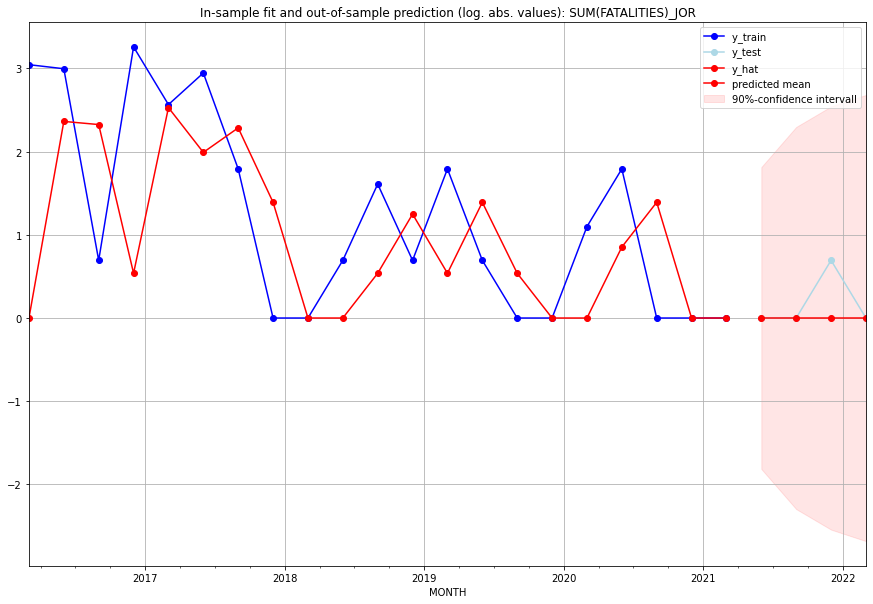

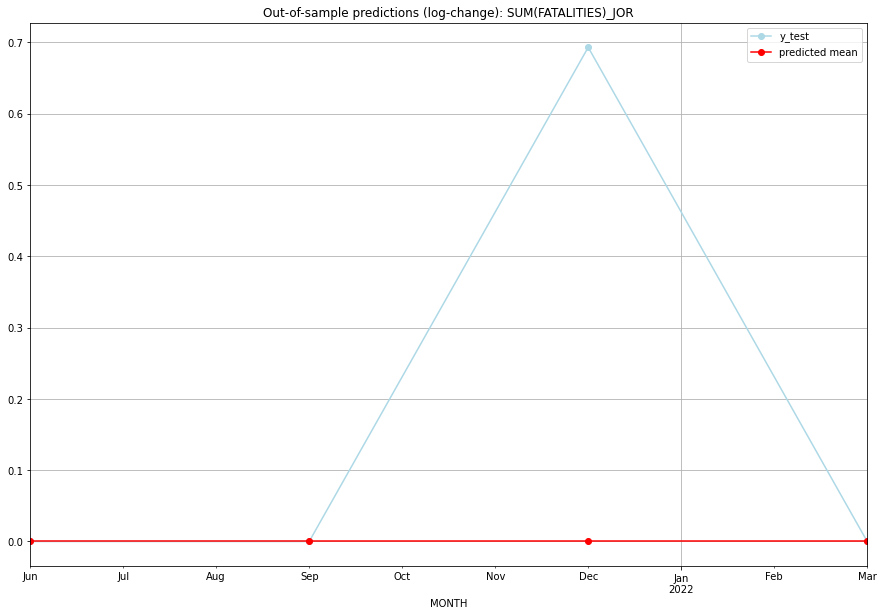

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   JOR   
1 2021-07-01       0.0         0.0           0.0        0.000000   JOR   
2 2021-10-01       0.0         1.0           0.0        0.693147   JOR   
3 2022-01-01       0.0         0.0           0.0        0.000000   JOR   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## JPN (110/234) #########
0
Neighbor countries: []
Getting Data for JPN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV nece

<Figure size 432x288 with 0 Axes>

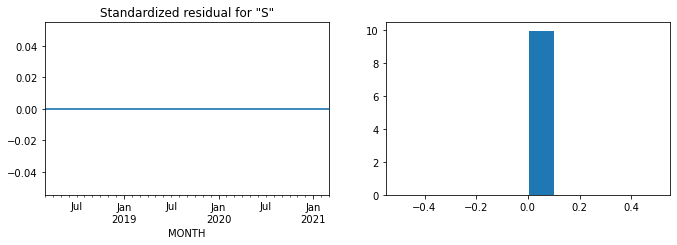

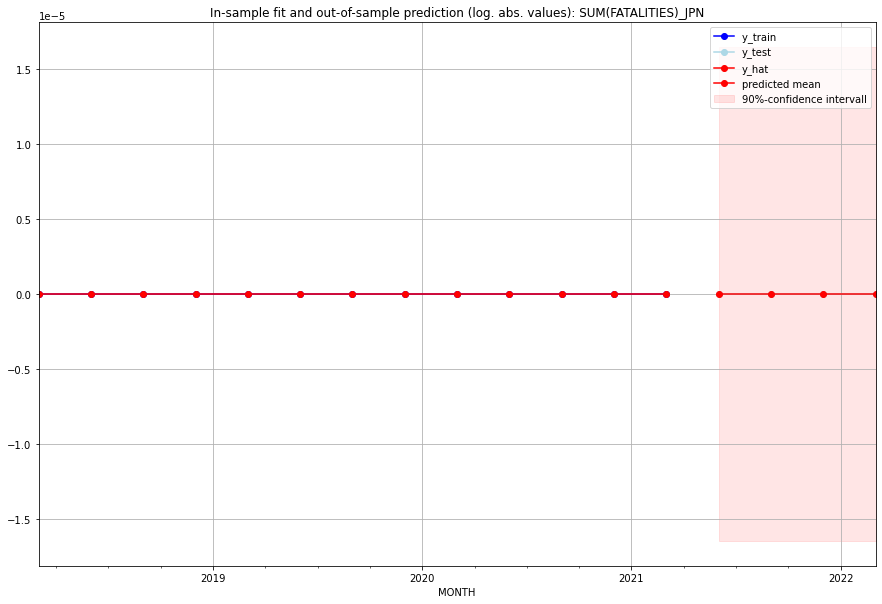

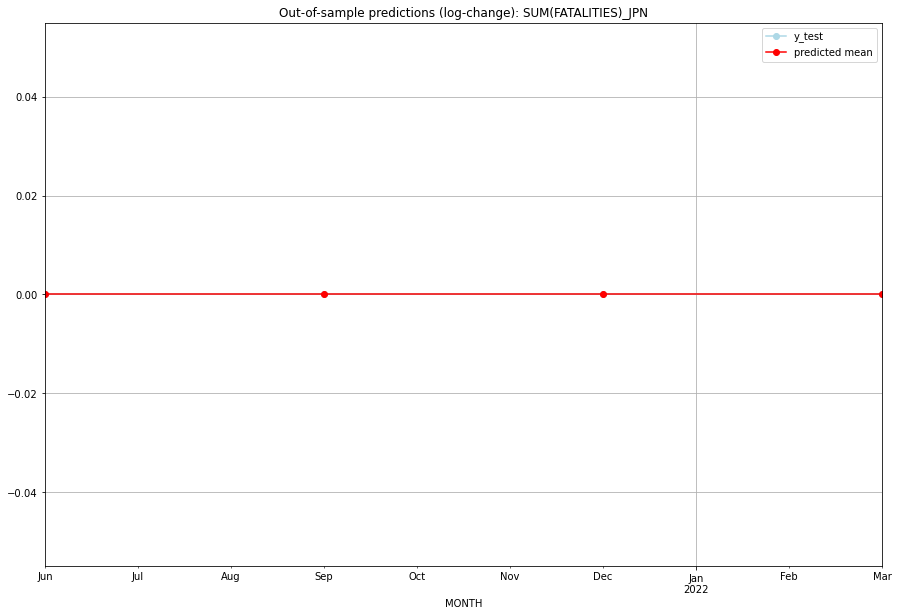

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   JPN   
1 2021-07-01       0.0         0.0           0.0             0.0   JPN   
2 2021-10-01       0.0         0.0           0.0             0.0   JPN   
3 2022-01-01       0.0         0.0           0.0             0.0   JPN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## KAZ (111/234) #########
0
Neighbor countries: ['RUS', 'UZB', 'KGZ', 'CHN', 'TKM']
Getting Data for KAZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6760459492609645, 'fold_results': [0.7225929394740411, 0.6294989590478878]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KAZ   No. Observations:                   13
Model:                SARIMAX(3, 1, 2)   Log Likelihood                 -12.131
Date:                 Wed, 19 Oct 2022   AIC                             42.263
Time:                         10:40:52   BIC                             46.627
Sample:                     01-31-2018   HQIC                            40.647
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.4181      0.

<Figure size 432x288 with 0 Axes>

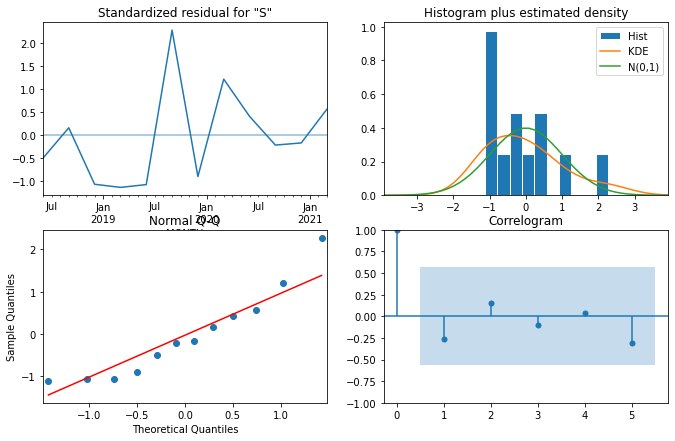

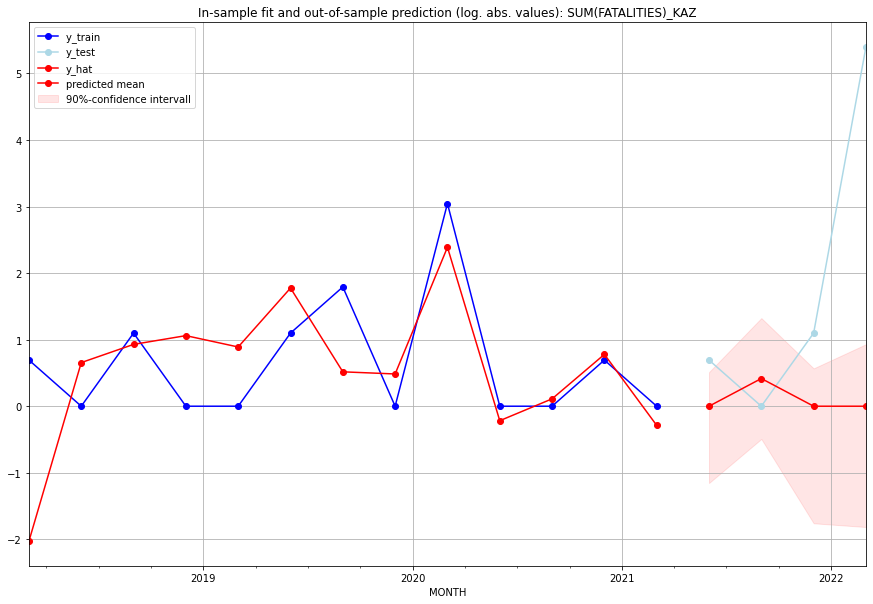

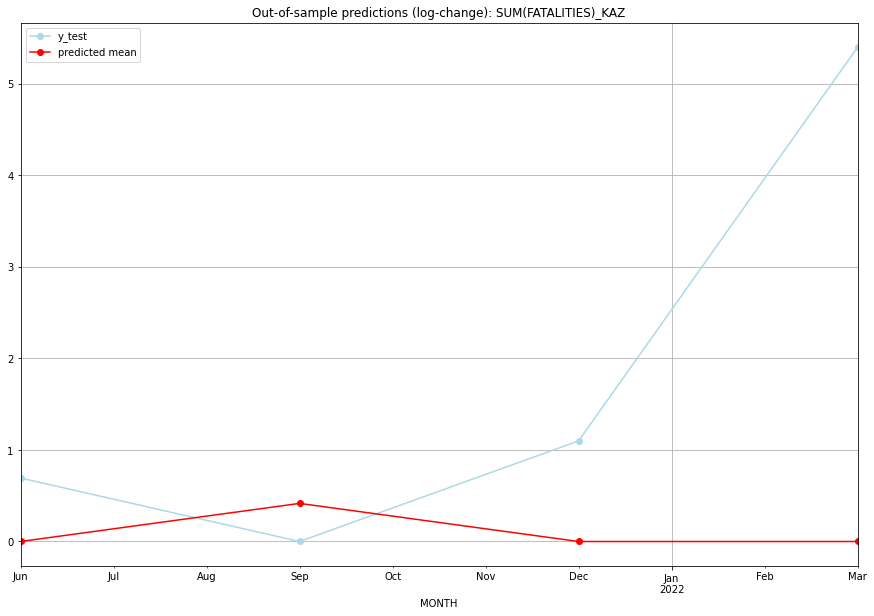

TADDA: 1.9015064980199194
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.000000         1.0      0.000000        0.693147   KAZ   
1 2021-07-01  0.516043         0.0      0.416104        0.000000   KAZ   
2 2021-10-01  0.000000         2.0      0.000000        1.098612   KAZ   
3 2022-01-01  0.000000       220.0      0.000000        5.398163   KAZ   

                                          PARAMETERS  
0  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## KEN (112/234) #########
0
Neighbor countries: ['TZA', 'ETH', 'SOM', 'UGA', 'SSD', 'XIT']
Getting Data for KEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 48)
y: (100, 1)
------------------------------------------------
Training 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.445935637561613, 'fold_results': [0.306231181530469, 0.9538376987142125, 0.28035590457073156, 0.4456861343407885, 0.2435672686518633]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KEN   No. Observations:                   96
Model:                SARIMAX(1, 0, 3)   Log Likelihood                -126.580
Date:                 Wed, 19 Oct 2022   AIC                            263.159
Time:                         10:41:18   BIC                            275.981
Sample:                     04-30-1997   HQIC                           268.342
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

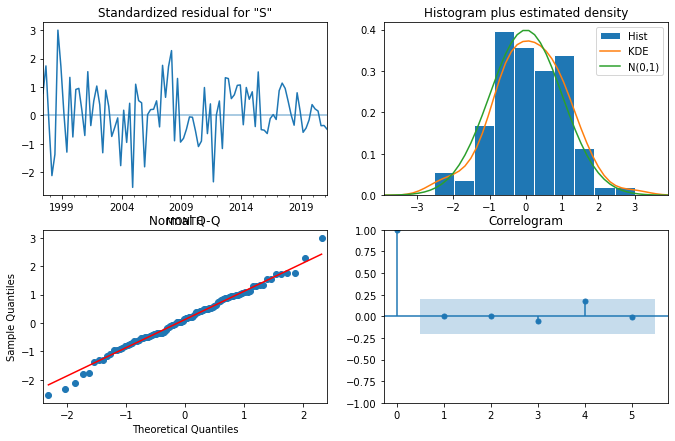

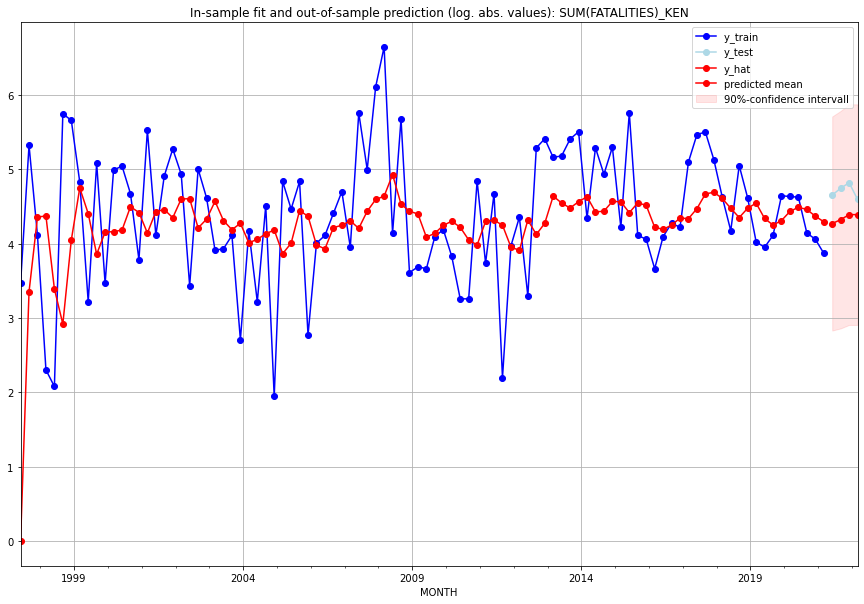

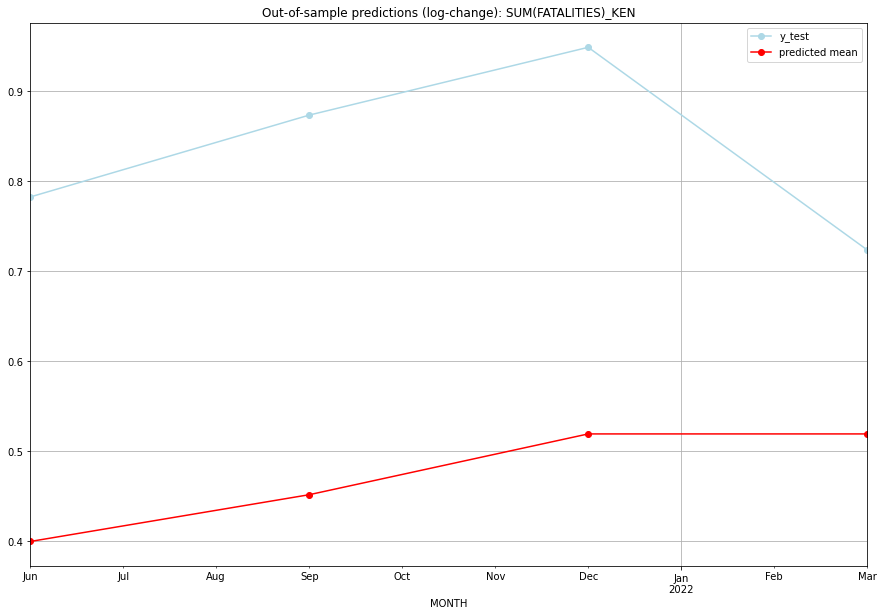

TADDA: 0.3597053870291804
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  70.600518       104.0      0.399901        0.782759   KEN   
1 2021-07-01  74.420964       114.0      0.451884        0.873731   KEN   
2 2021-10-01  79.692275       123.0      0.519442        0.949081   KEN   
3 2022-01-01  79.692201        98.0      0.519441        0.723919   KEN   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:25
######## KGZ (113/234) #########
0
Neighbor countries: ['TJK', 'UZB', 'KAZ', 'CHN']
Getting Data for KGZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 32)
y: (17, 1)
------------------------------------------------
Training started.
St

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5445291229464205, 'fold_results': [0.8144051737258136, 0.27465307216702745]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KGZ   No. Observations:                   13
Model:                SARIMAX(0, 0, 3)   Log Likelihood                 -13.412
Date:                 Wed, 19 Oct 2022   AIC                             38.824
Time:                         10:41:27   BIC                             42.213
Sample:                     01-31-2018   HQIC                            38.127
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0028      0

<Figure size 432x288 with 0 Axes>

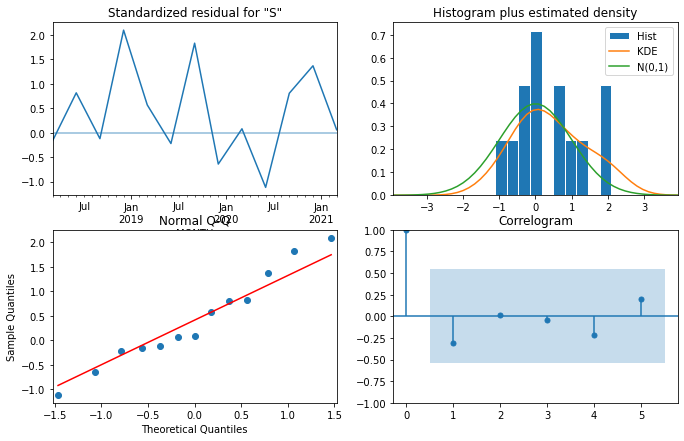

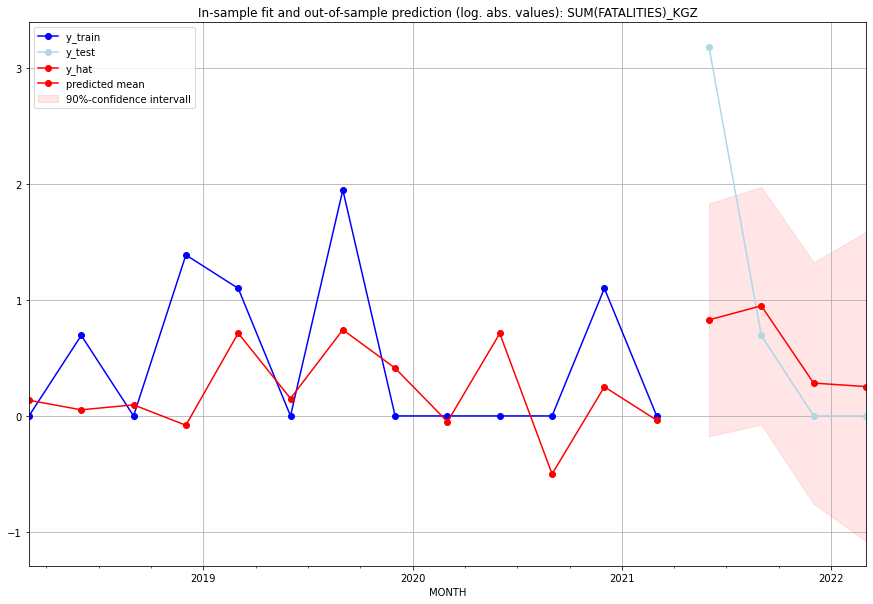

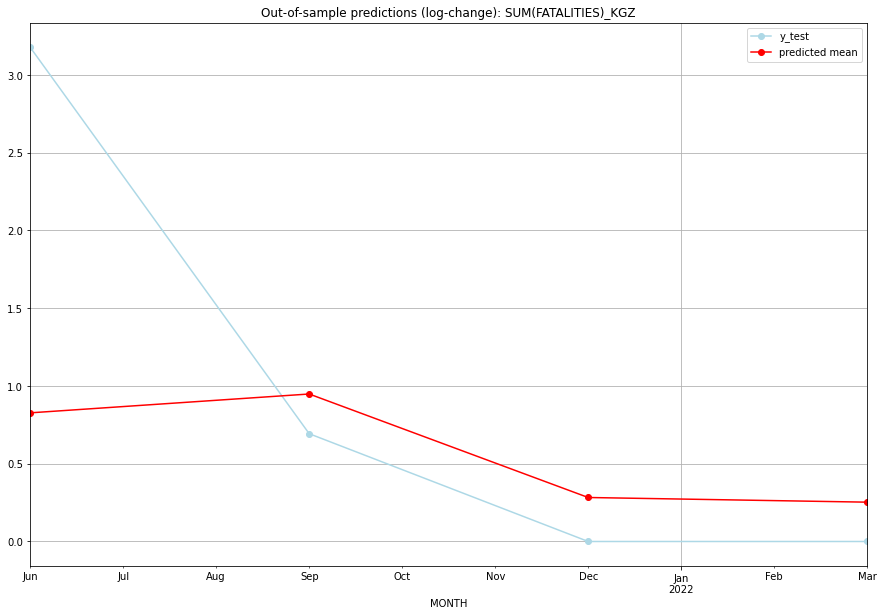

TADDA: 0.7854692798263591
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.287168        23.0      0.827314        3.178054   KGZ   
1 2021-07-01  1.581794         1.0      0.948484        0.693147   KGZ   
2 2021-10-01  0.326981         0.0      0.282907        0.000000   KGZ   
3 2022-01-01  0.287746         0.0      0.252894        0.000000   KGZ   

                                          PARAMETERS  
0  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## KHM (114/234) #########
0
Neighbor countries: ['VNM', 'THA', 'LAO']
Getting Data for KHM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 24)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEAR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5076653573671532, 'fold_results': [0.7840635377771316, 0.3479032132794122, 0.4955725629574407, 0.4663751349337859, 0.44441233788799583]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KHM   No. Observations:                   45
Model:                SARIMAX(0, 1, 1)   Log Likelihood                 -54.117
Date:                 Wed, 19 Oct 2022   AIC                            114.233
Time:                         10:41:45   BIC                            119.586
Sample:                     01-31-2010   HQIC                           116.218
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

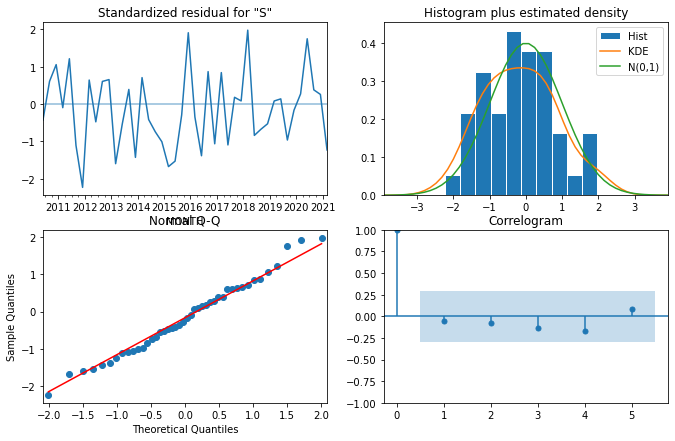

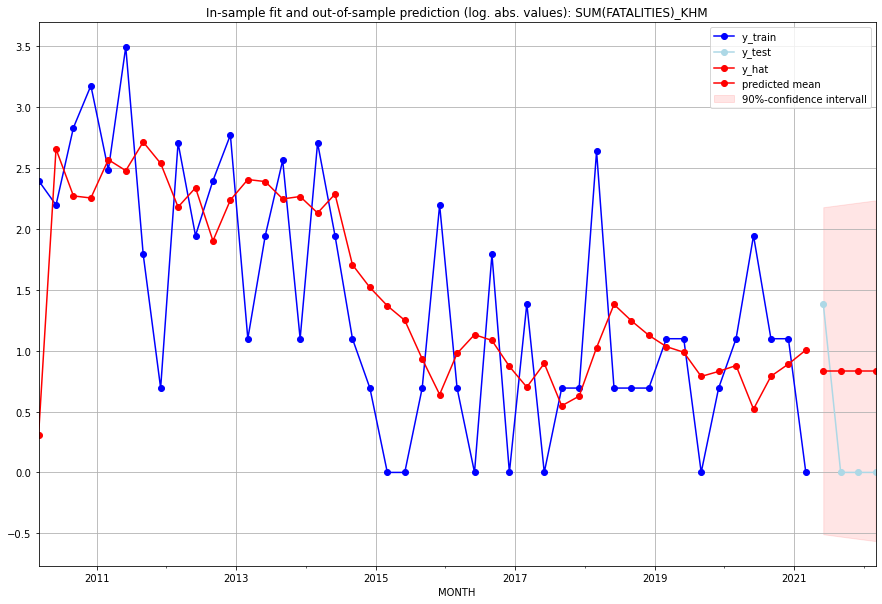

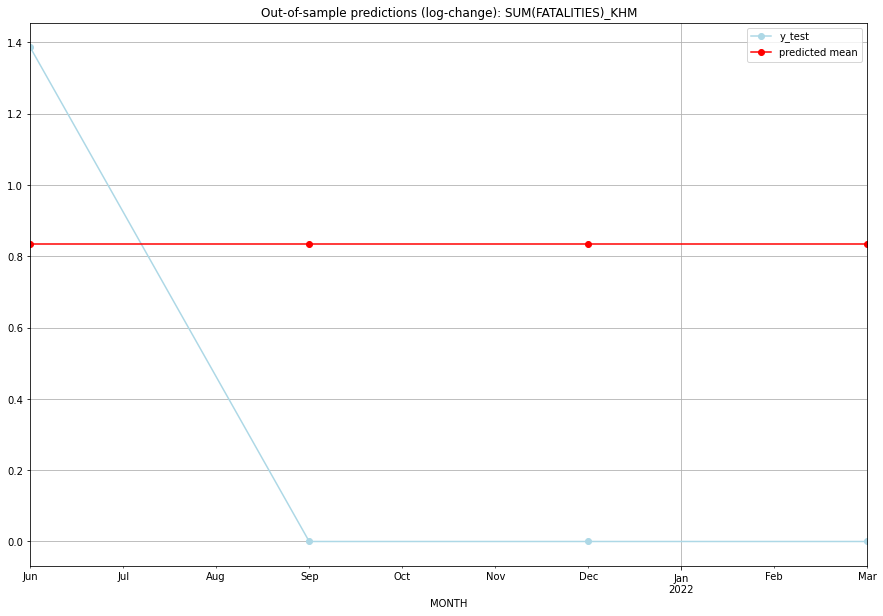

TADDA: 0.7643710678051956
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.306186         3.0      0.835595        1.386294   KHM   
1 2021-07-01  1.306186         0.0      0.835595        0.000000   KHM   
2 2021-10-01  1.306186         0.0      0.835595        0.000000   KHM   
3 2022-01-01  1.306186         0.0      0.835595        0.000000   KHM   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## KNA (115/234) #########
0
Neighbor countries: []
Getting Data for KNA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU core

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KNA   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:41:55   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

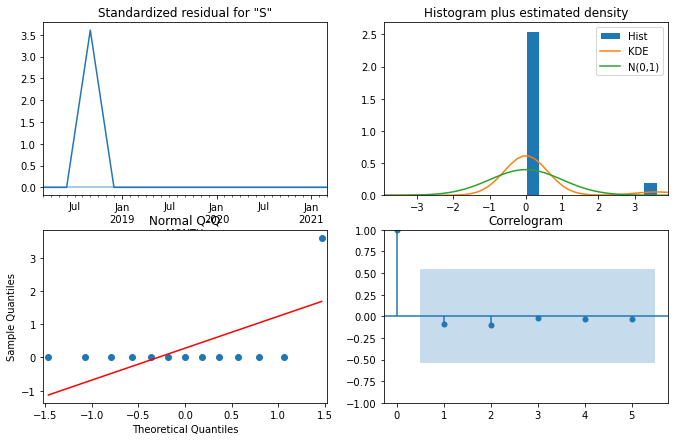

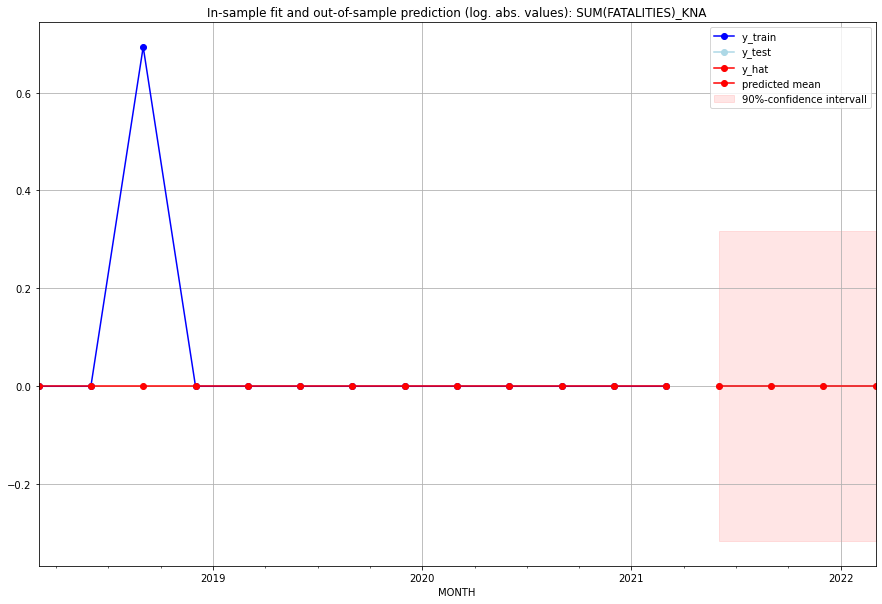

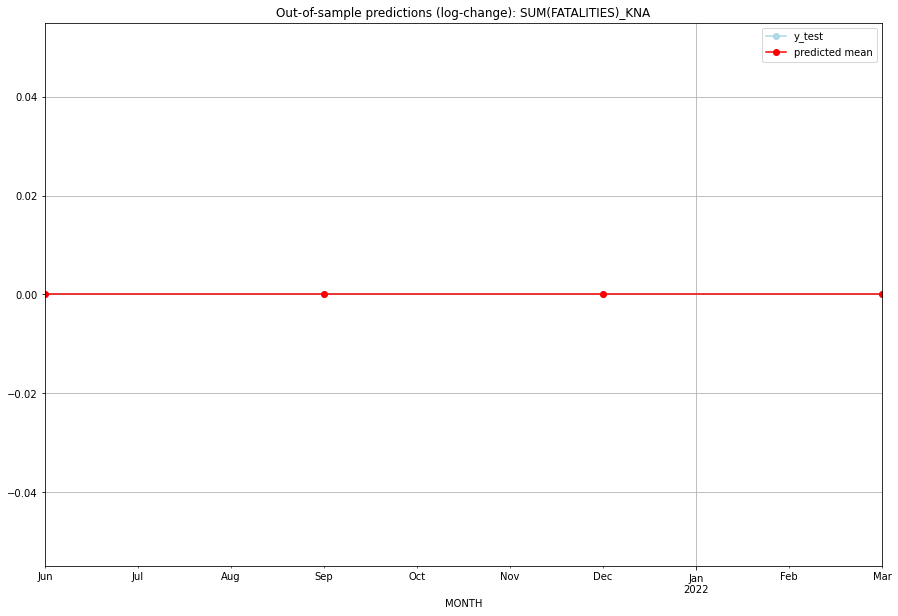

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   KNA   
1 2021-07-01       0.0         0.0           0.0             0.0   KNA   
2 2021-10-01       0.0         0.0           0.0             0.0   KNA   
3 2022-01-01       0.0         0.0           0.0             0.0   KNA   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## KOR (116/234) #########
0
Neighbor countries: ['PRK']
Getting Data for KOR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 8)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best

<Figure size 432x288 with 0 Axes>

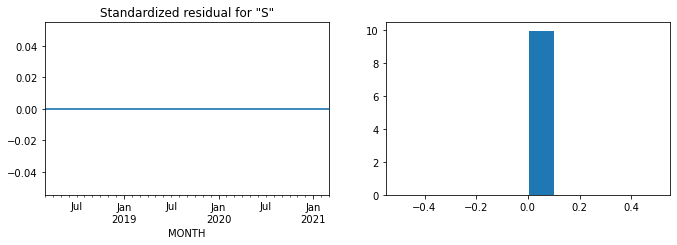

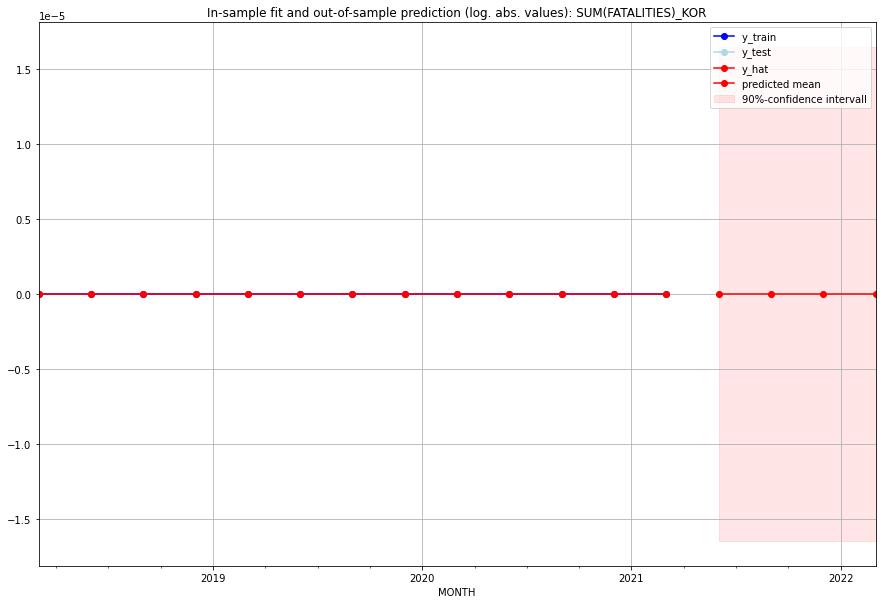

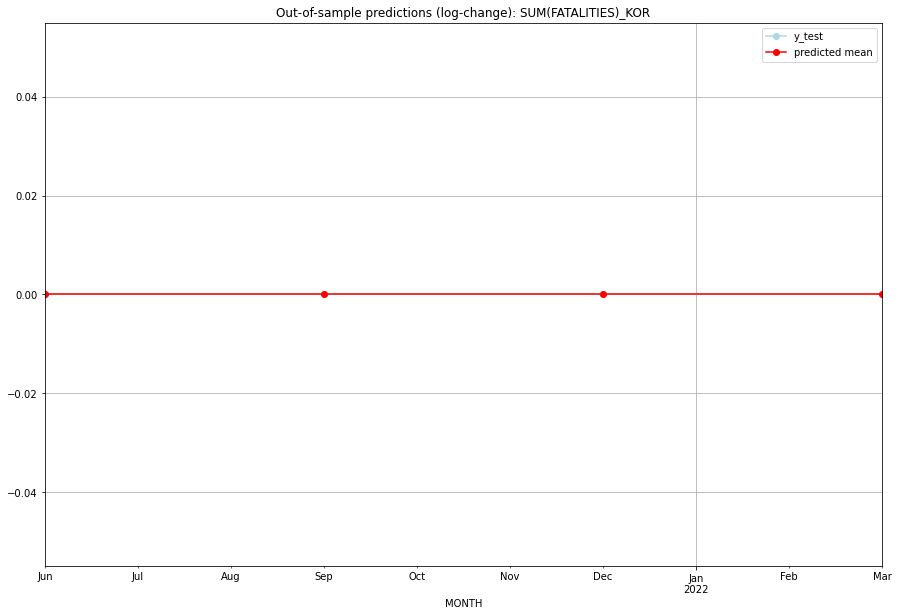

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   KOR   
1 2021-07-01       0.0         0.0           0.0             0.0   KOR   
2 2021-10-01       0.0         0.0           0.0             0.0   KOR   
3 2022-01-01       0.0         0.0           0.0             0.0   KOR   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## KWT (117/234) #########
0
Neighbor countries: ['SAU', 'IRQ']
Getting Data for KWT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 16)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.04332169878499658, 'fold_results': [0.0, 0.0, 0.0, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KWT   No. Observations:                   21
Model:                         SARIMAX   Log Likelihood                   9.867
Date:                 Wed, 19 Oct 2022   AIC                            -17.733
Time:                         10:42:13   BIC                            -16.689
Sample:                     01-31-2016   HQIC                           -17.506
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0229      0.002

<Figure size 432x288 with 0 Axes>

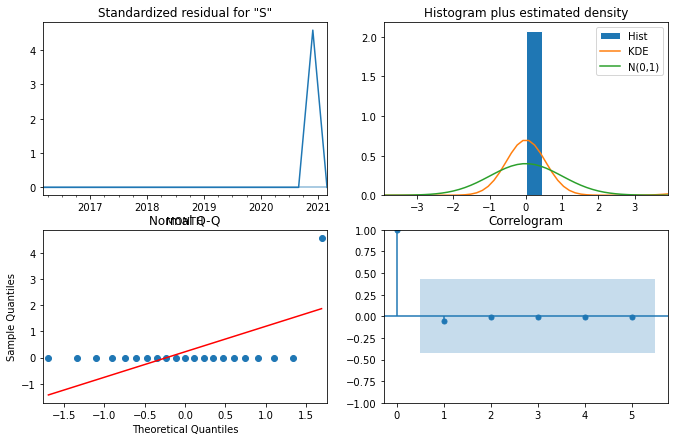

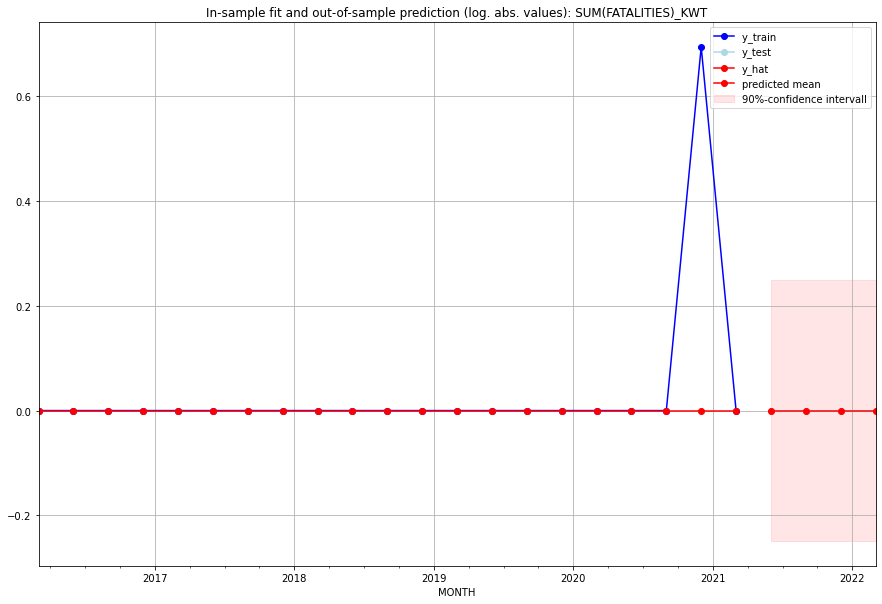

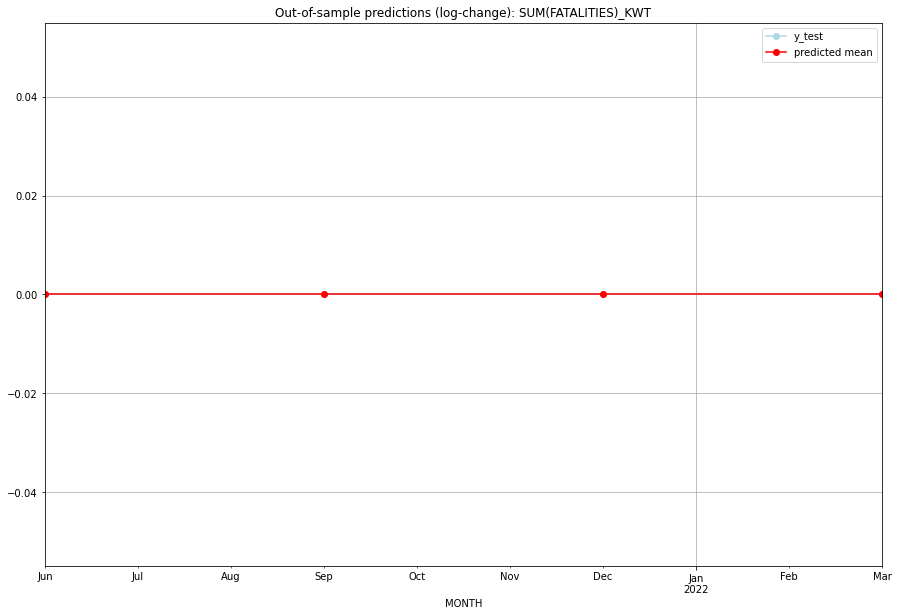

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   KWT   
1 2021-07-01       0.0         0.0           0.0             0.0   KWT   
2 2021-10-01       0.0         0.0           0.0             0.0   KWT   
3 2022-01-01       0.0         0.0           0.0             0.0   KWT   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## LAO (118/234) #########
0
Neighbor countries: ['CHN', 'VNM', 'THA', 'KHM', 'MMR']
Getting Data for LAO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 40)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARC

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3685507030503316, 'fold_results': [0.8590511590722238, 0.2688348063340184, 0.0, 0.34657359027997264, 0.3682939595654431]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LAO   No. Observations:                   45
Model:                SARIMAX(2, 0, 0)   Log Likelihood                 -42.791
Date:                 Wed, 19 Oct 2022   AIC                             97.582
Time:                         10:42:34   BIC                            108.422
Sample:                     01-31-2010   HQIC                           101.623
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

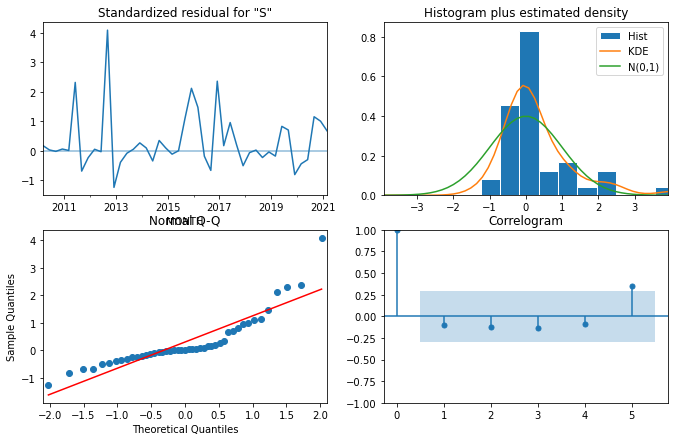

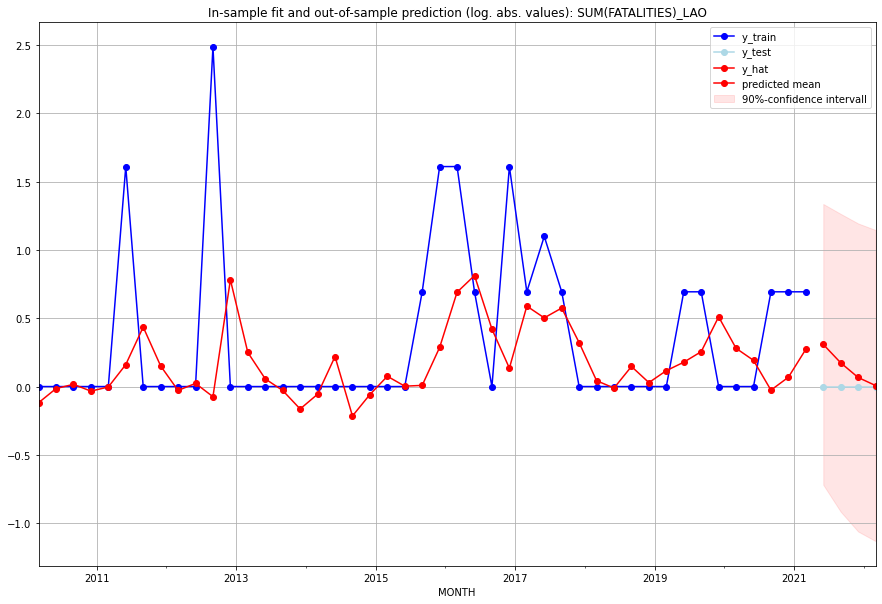

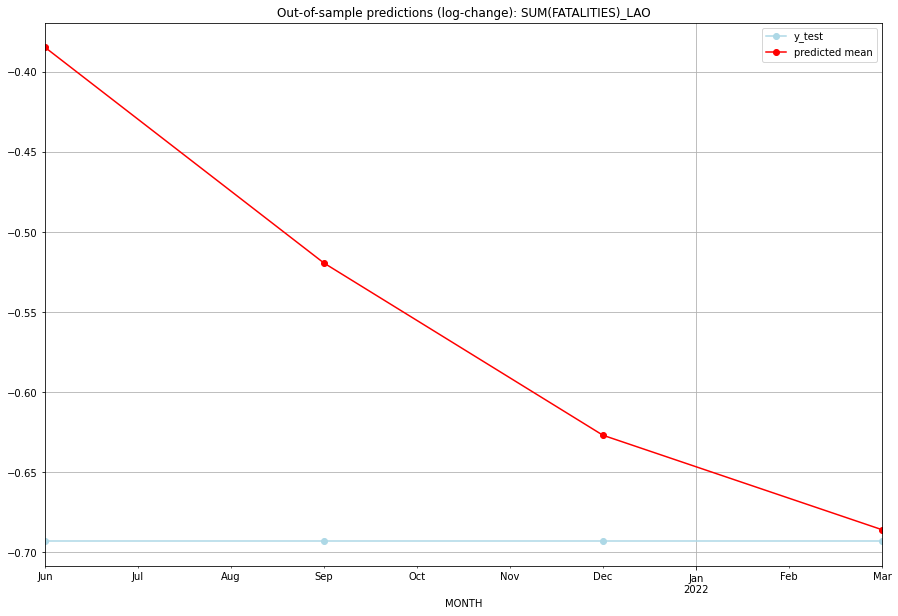

TADDA: 0.13896801311458626
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.361266         0.0     -0.384732       -0.693147   LAO   
1 2021-07-01  0.189790         0.0     -0.519370       -0.693147   LAO   
2 2021-10-01  0.068554         0.0     -0.626841       -0.693147   LAO   
3 2022-01-01  0.007401         0.0     -0.685774       -0.693147   LAO   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## LBN (119/234) #########
0
Neighbor countries: ['SYR', 'ISR']
Getting Data for LBN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 16)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.929653131443875, 'fold_results': [1.2571342297845731, 0.7106452735149539, 0.7510077690921715, 0.9998252533838017]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBN   No. Observations:                   21
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -32.921
Date:                 Wed, 19 Oct 2022   AIC                             67.842
Time:                         10:42:42   BIC                             68.838
Sample:                     01-31-2016   HQIC                            68.036
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

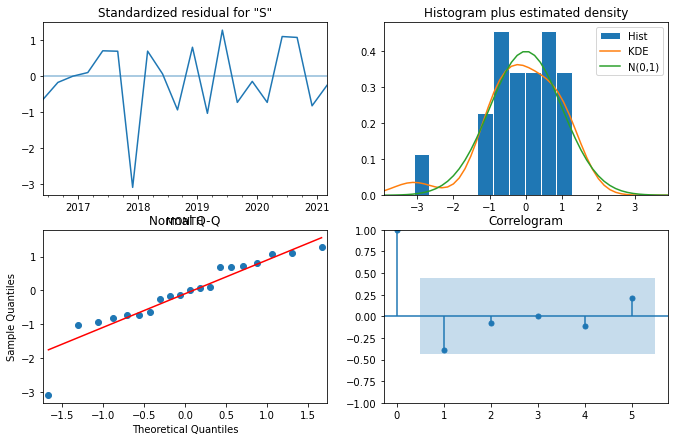

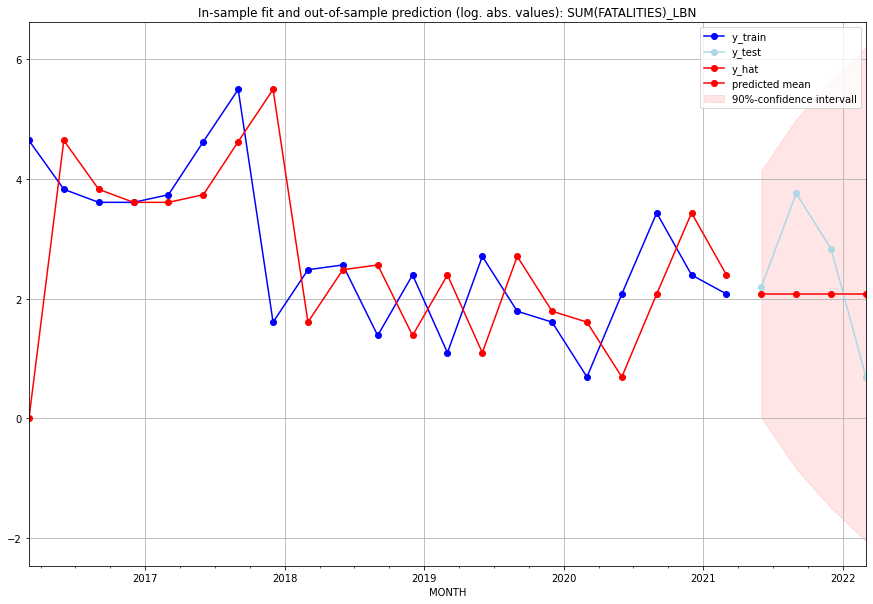

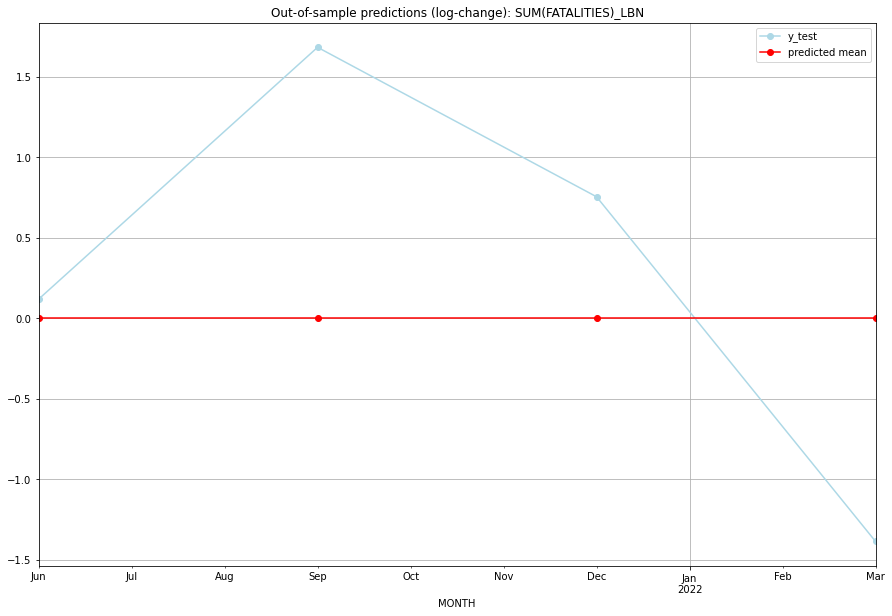

TADDA: 0.984901943291595
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       7.0         8.0           0.0        0.117783   LBN   
1 2021-07-01       7.0        42.0           0.0        1.681759   LBN   
2 2021-10-01       7.0        16.0           0.0        0.753772   LBN   
3 2022-01-01       7.0         1.0           0.0       -1.386294   LBN   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:05
######## LBR (120/234) #########
0
Neighbor countries: ['CIV', 'GIN', 'SLE']
Getting Data for LBR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEA

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5134065333062019, 'fold_results': [0.9516656224425801, 0.5198603854199589, 0.17328679513998638, 0.5756462732485114, 0.34657359027997264]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBR   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -183.270
Date:                 Wed, 19 Oct 2022   AIC                            368.540
Time:                         10:43:02   BIC                            371.094
Sample:                     04-30-1997   HQIC                           369.572
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

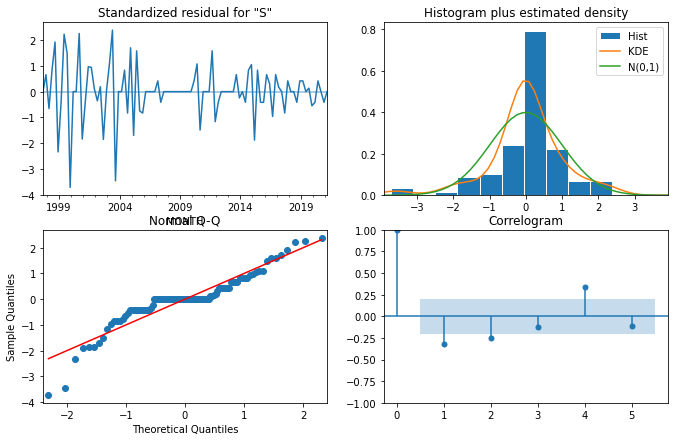

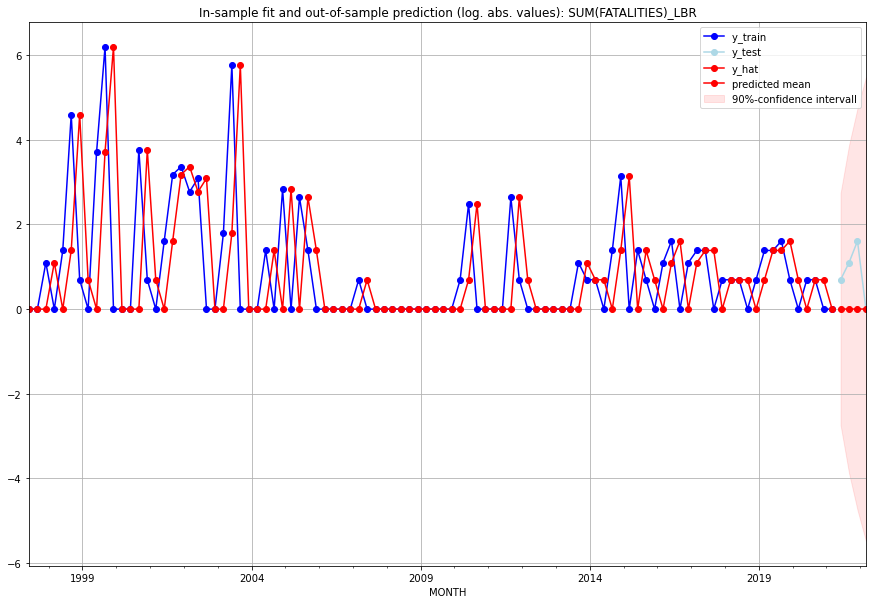

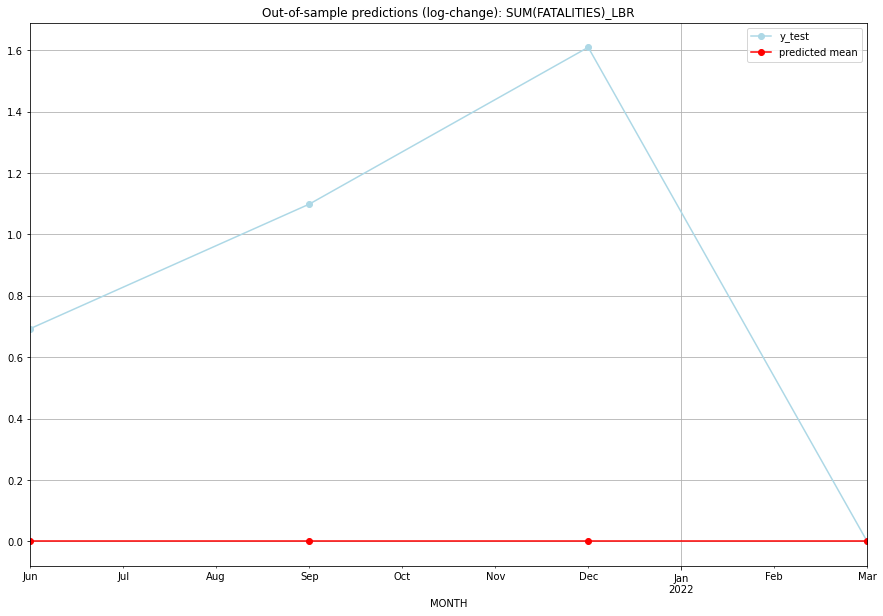

TADDA: 0.8502993454155389
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         1.0  1.232595e-32        0.693147   LBR   
1 2021-07-01       0.0         2.0  1.232595e-32        1.098612   LBR   
2 2021-10-01       0.0         4.0  1.232595e-32        1.609438   LBR   
3 2022-01-01       0.0         0.0  1.232595e-32        0.000000   LBR   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:24
######## LBY (121/234) #########
0
Neighbor countries: ['TUN', 'DZA', 'NER', 'TCD', 'EGY', 'SDN']
Getting Data for LBY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 48)
y: (100, 1)
------------------------------------------------
Training 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5979598051338174, 'fold_results': [0.5422958664494744, 0.2237634352850295, 0.2344737884934811, 0.4880459062353144, 1.5012200292057876]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBY   No. Observations:                   96
Model:                SARIMAX(1, 0, 2)   Log Likelihood                -157.923
Date:                 Wed, 19 Oct 2022   AIC                            325.846
Time:                         10:43:20   BIC                            338.668
Sample:                     04-30-1997   HQIC                           331.029
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

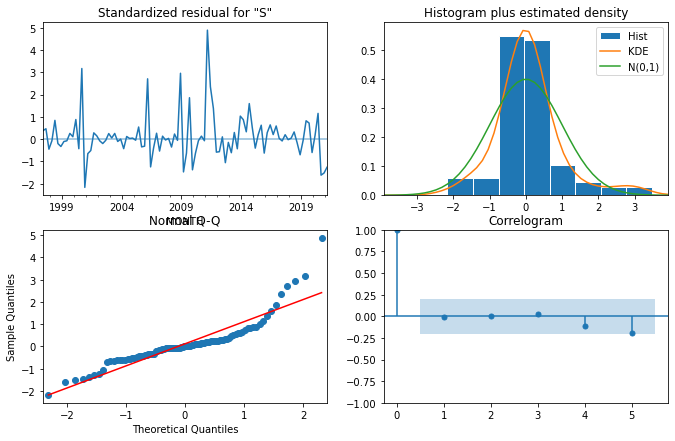

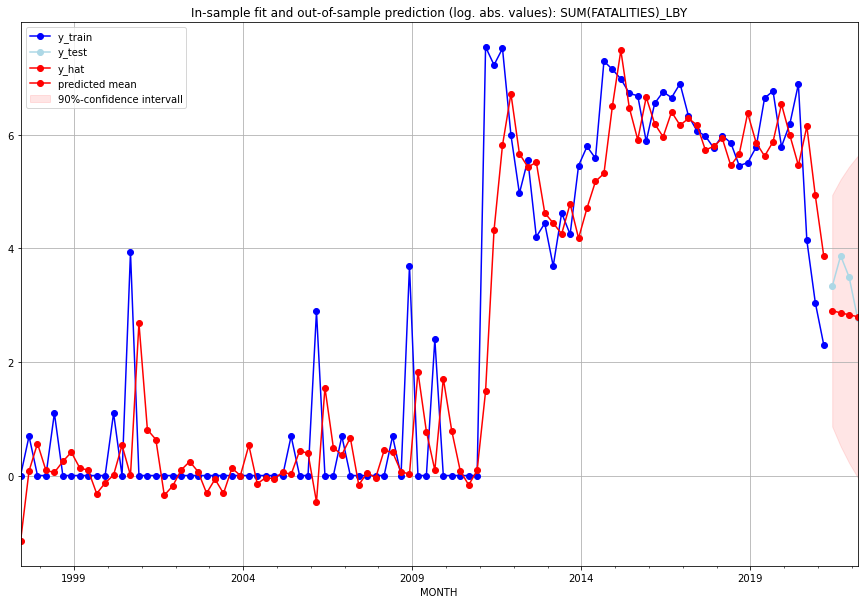

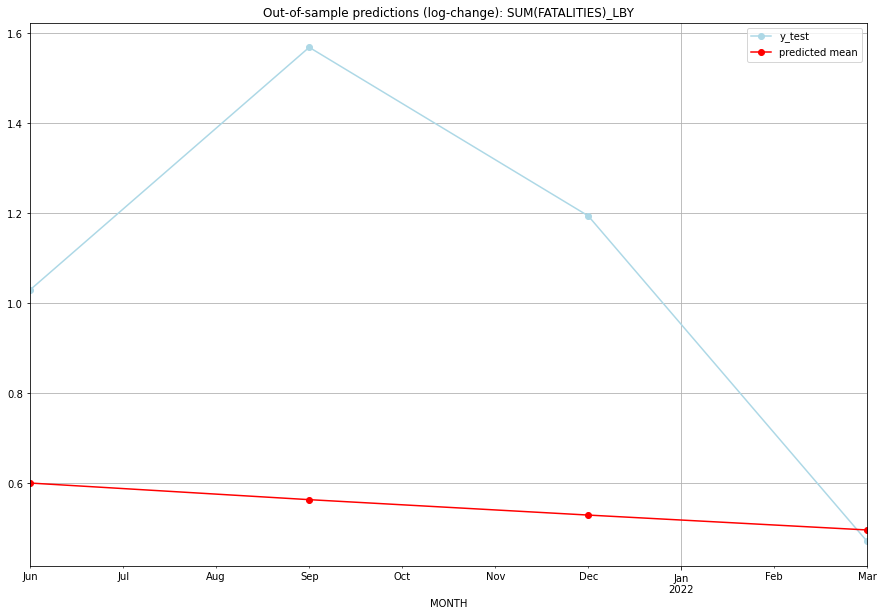

TADDA: 0.5315216206380385
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  17.220085        27.0      0.599939        1.029619   LBY   
1 2021-07-01  16.559346        47.0      0.563001        1.568616   LBY   
2 2021-10-01  15.968025        32.0      0.528746        1.193922   LBY   
3 2022-01-01  15.415134        15.0      0.495619        0.470004   LBY   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## LCA (122/234) #########
0
Neighbor countries: []
Getting Data for LCA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV 

<Figure size 432x288 with 0 Axes>

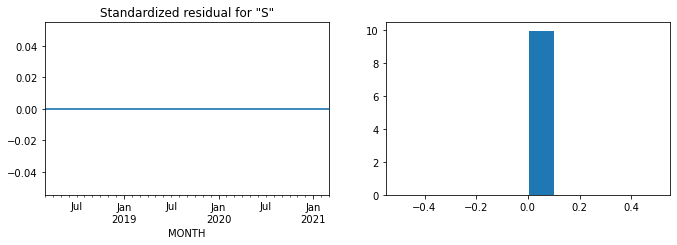

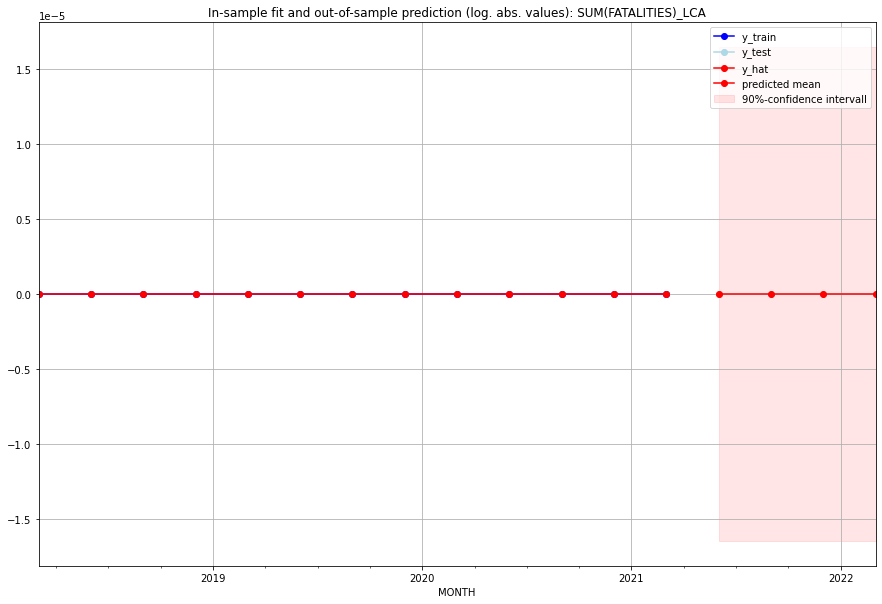

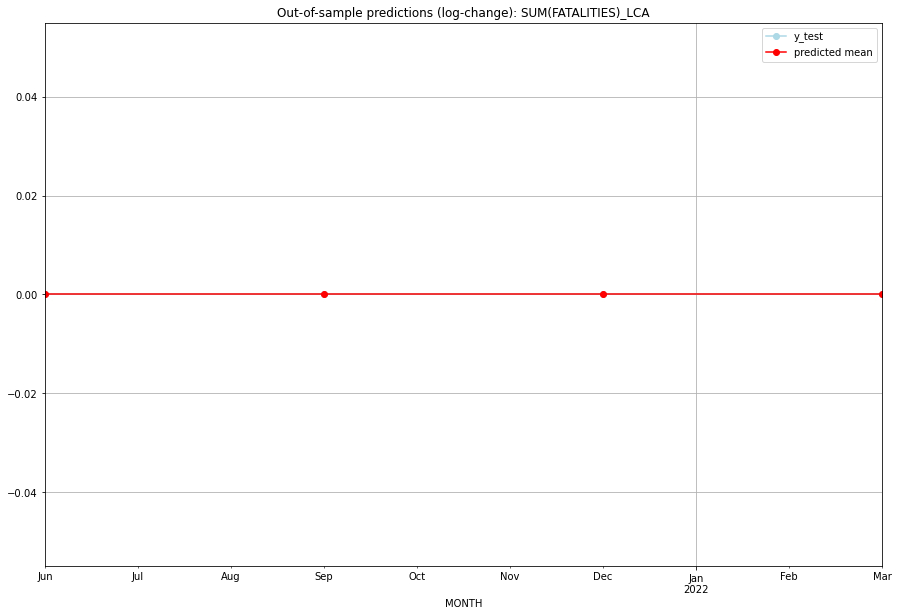

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LCA   
1 2021-07-01       0.0         0.0           0.0             0.0   LCA   
2 2021-10-01       0.0         0.0           0.0             0.0   LCA   
3 2022-01-01       0.0         0.0           0.0             0.0   LCA   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## LIE (123/234) #########
0
Neighbor countries: ['AUT', 'CHE']
Getting Data for LIE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 16)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


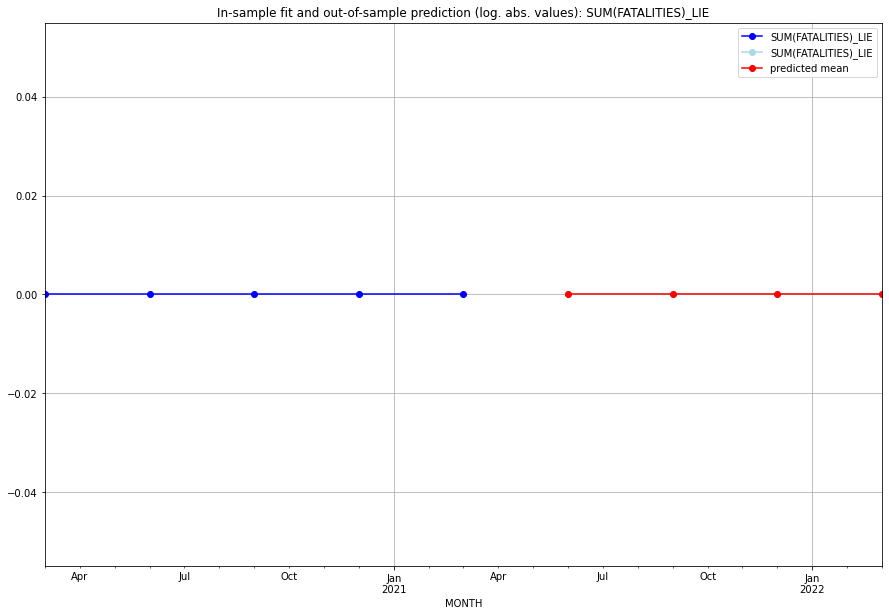

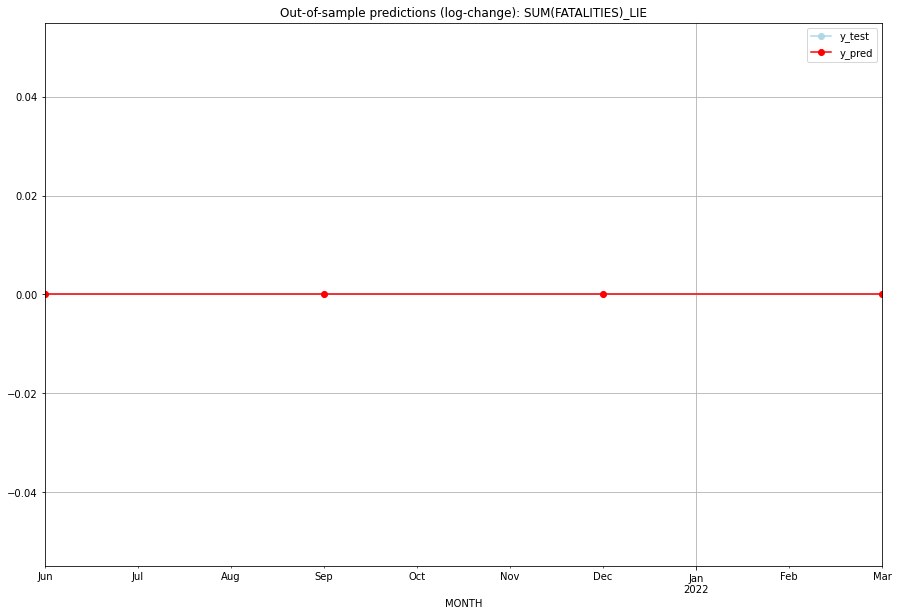

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LIE   
1 2021-07-01       0.0         0.0           0.0             0.0   LIE   
2 2021-10-01       0.0         0.0           0.0             0.0   LIE   
3 2022-01-01       0.0         0.0           0.0             0.0   LIE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## LKA (124/234) #########
0
Neighbor countries: ['IND']
Getting Data for LKA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 8)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.8229931221817521, 'fold_results': [0.5544144400136934, 0.4380451427660091, 1.3157024093861878, 1.4579892847034548, 0.34881433403941564]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LKA   No. Observations:                   45
Model:                SARIMAX(3, 1, 1)   Log Likelihood                 -60.535
Date:                 Wed, 19 Oct 2022   AIC                            133.071
Time:                         10:43:42   BIC                            143.776
Sample:                     01-31-2010   HQIC                           137.041
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

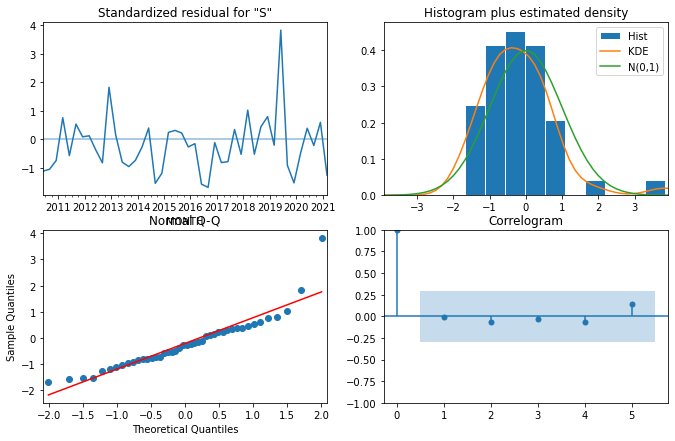

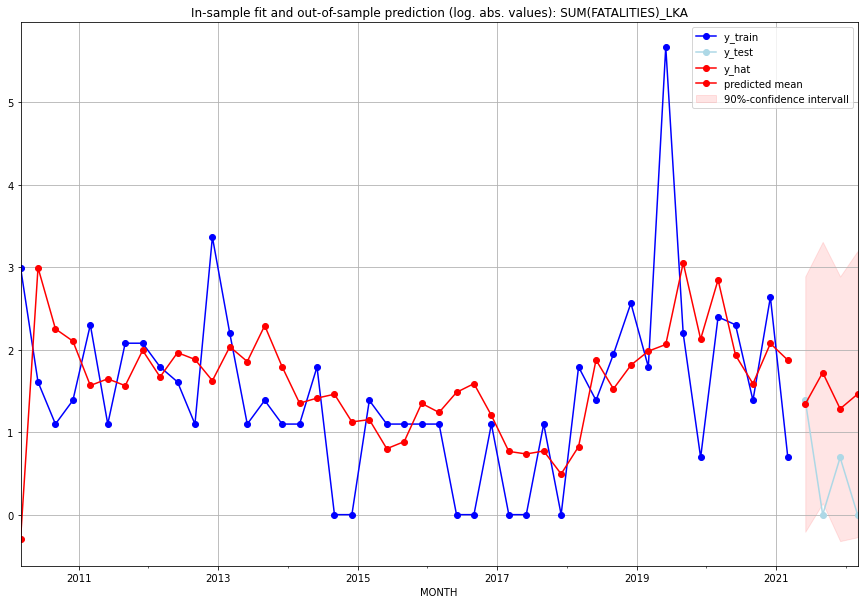

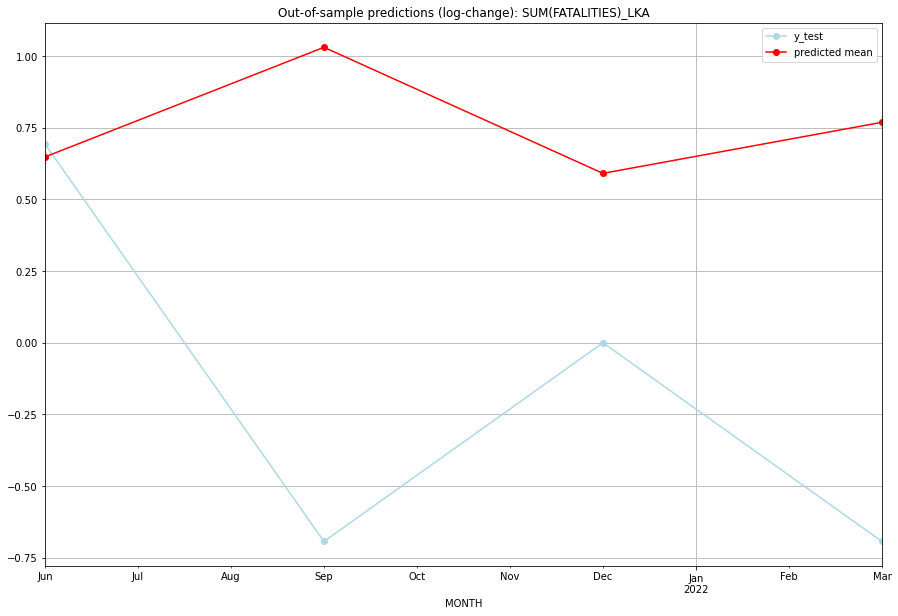

TADDA: 1.4050701027003216
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.823350         3.0      0.647980        0.693147   LKA   
1 2021-07-01  4.603803         0.0      1.030298       -0.693147   LKA   
2 2021-10-01  2.610672         1.0      0.590747        0.000000   LKA   
3 2022-01-01  3.314083         0.0      0.768738       -0.693147   LKA   

                                          PARAMETERS  
0  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## LSO (125/234) #########
0
Neighbor countries: ['ZAF']
Getting Data for LSO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 8)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 C

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.46479119719300127, 'fold_results': [0.5755675030380288, 0.6617343181441198, 0.32264499009521047, 0.44302257671585954, 0.3209865979717882]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LSO   No. Observations:                   96
Model:                SARIMAX(2, 1, 3)   Log Likelihood                -100.921
Date:                 Wed, 19 Oct 2022   AIC                            217.842
Time:                         10:43:55   BIC                            238.273
Sample:                     04-30-1997   HQIC                           226.098
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

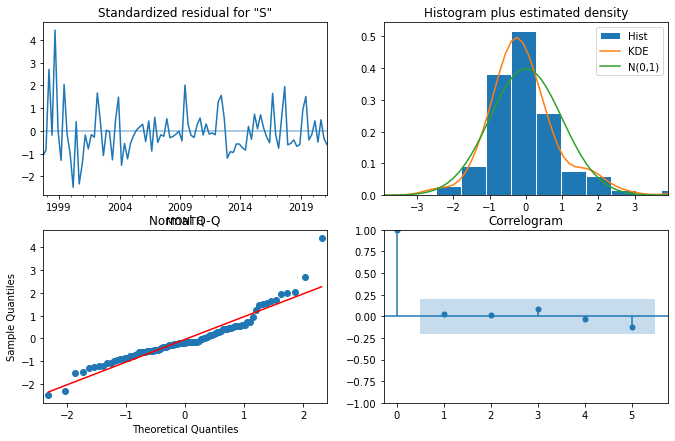

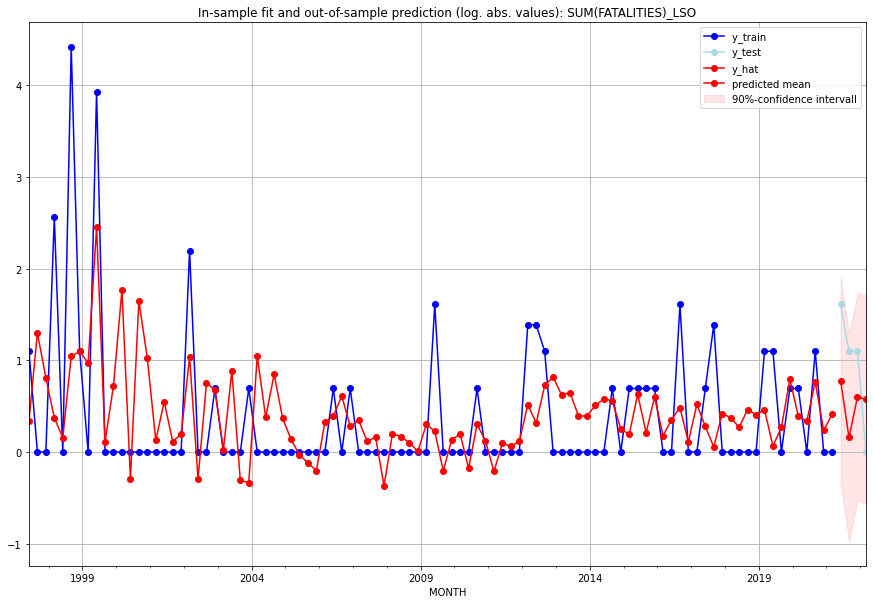

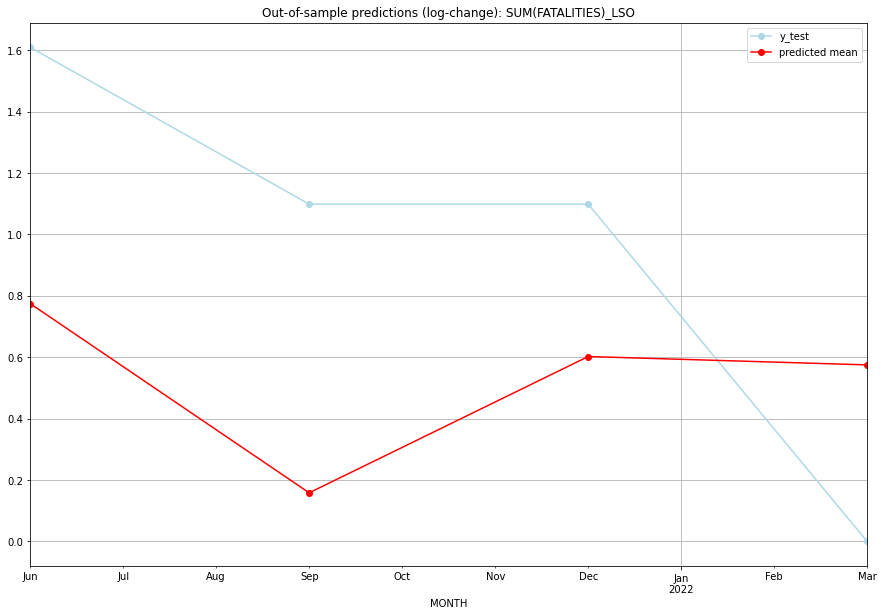

TADDA: 0.711555008941076
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.169945         4.0      0.774702        1.609438   LSO   
1 2021-07-01  0.171790         2.0      0.158532        1.098612   LSO   
2 2021-10-01  0.826441         2.0      0.602369        1.098612   LSO   
3 2022-01-01  0.777416         0.0      0.575160        0.000000   LSO   

                                          PARAMETERS  
0  {'params': [2, (2, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## LTU (126/234) #########
0
Neighbor countries: ['BLR', 'POL', 'LVA', 'RUS']
Getting Data for LTU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 32)
y: (9, 1)
------------------------------------------------
Training started.
GridSearch

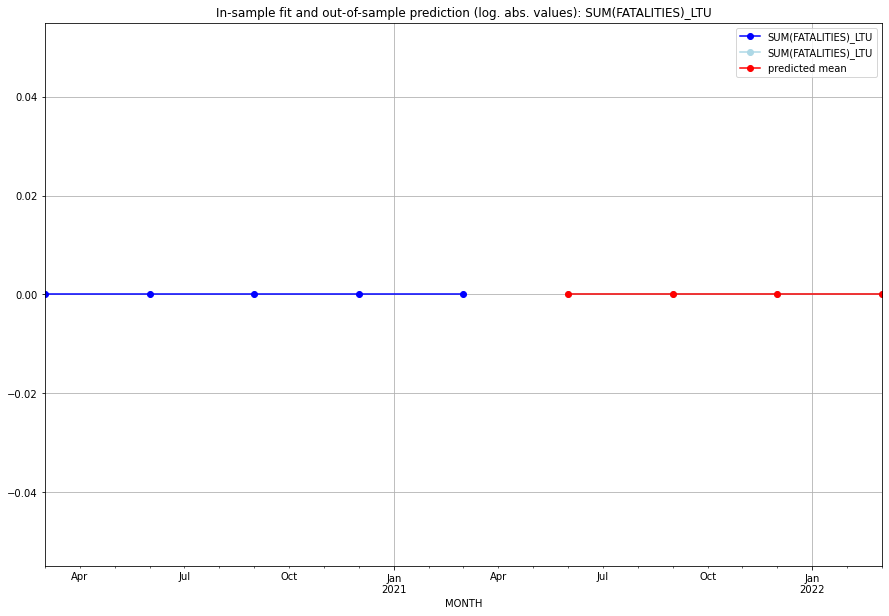

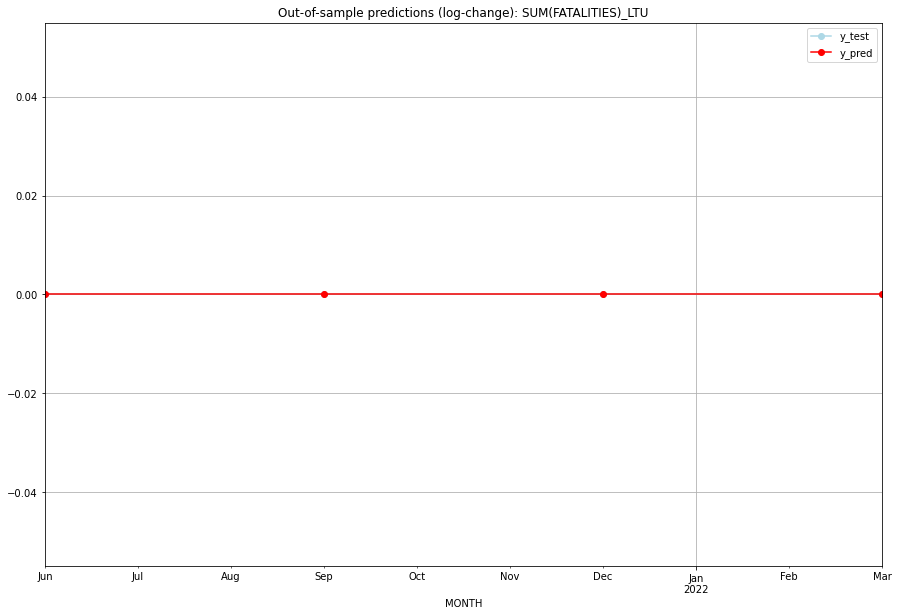

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LTU   
1 2021-07-01       0.0         0.0           0.0             0.0   LTU   
2 2021-10-01       0.0         0.0           0.0             0.0   LTU   
3 2022-01-01       0.0         0.0           0.0             0.0   LTU   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## LUX (127/234) #########
0
Neighbor countries: ['BEL', 'DEU', 'FRA']
Getting Data for LUX
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 24)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


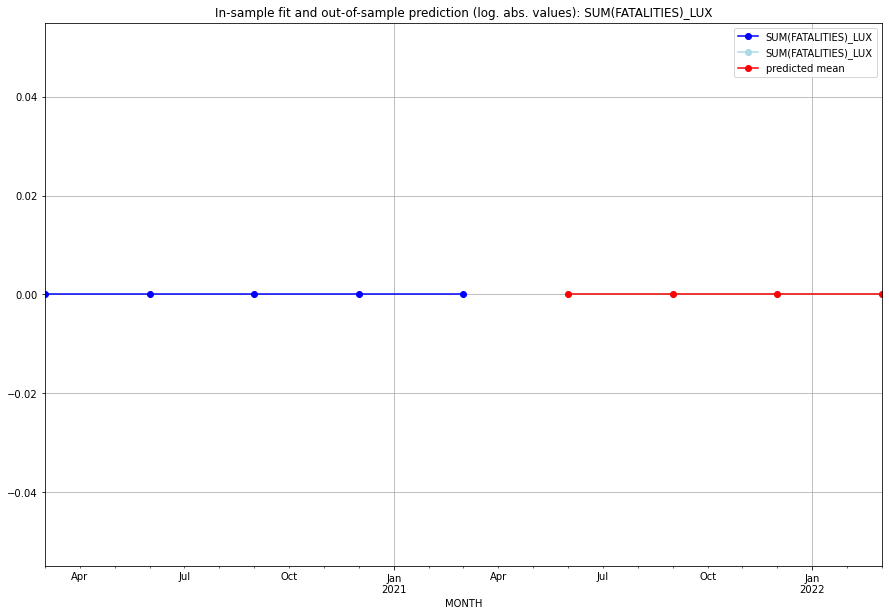

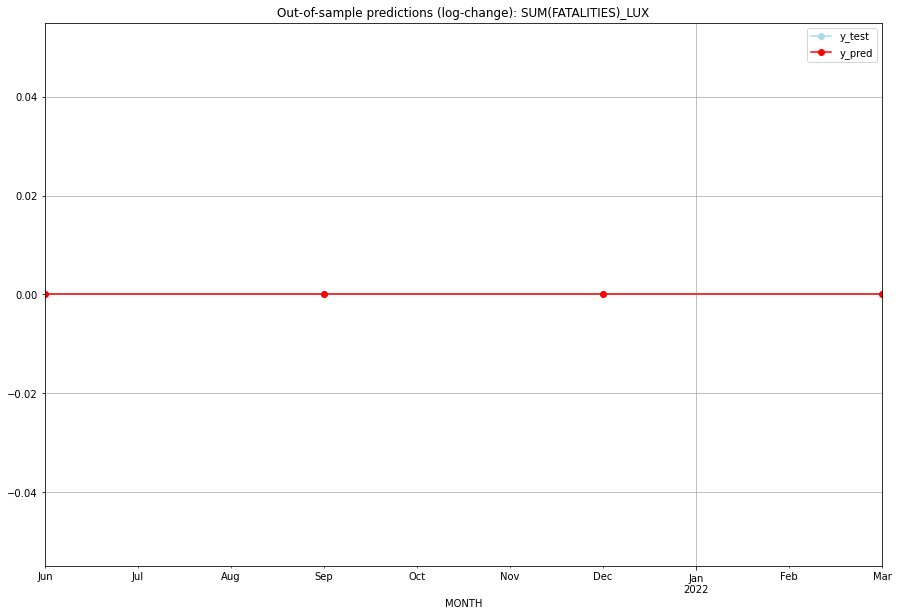

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LUX   
1 2021-07-01       0.0         0.0           0.0             0.0   LUX   
2 2021-10-01       0.0         0.0           0.0             0.0   LUX   
3 2022-01-01       0.0         0.0           0.0             0.0   LUX   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## LVA (128/234) #########
0
Neighbor countries: ['LTU', 'BLR', 'RUS', 'EST']
Getting Data for LVA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 32)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


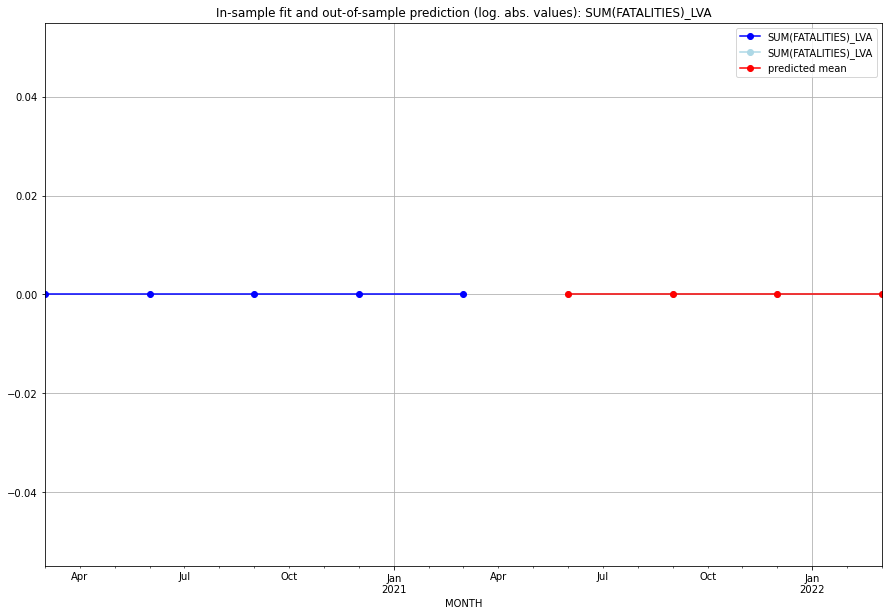

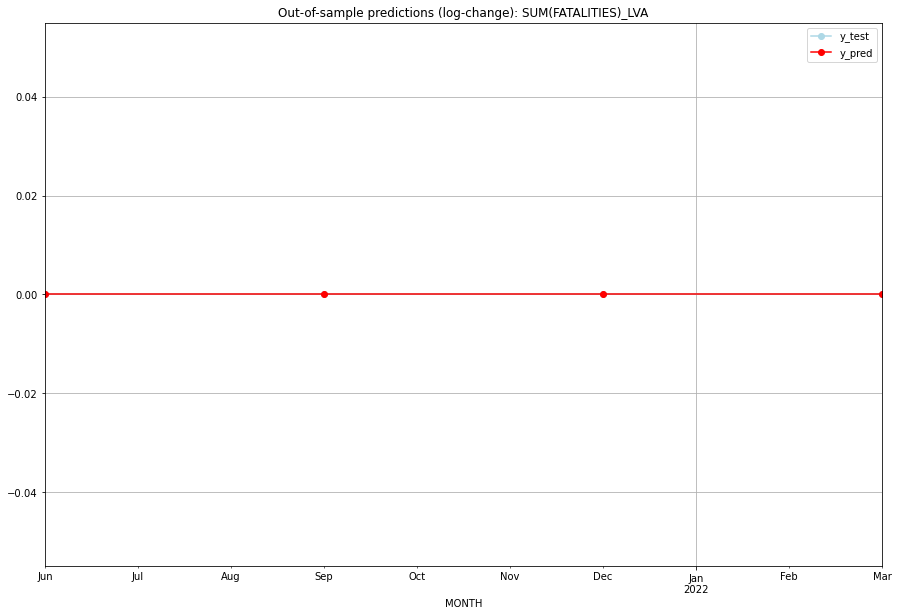

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LVA   
1 2021-07-01       0.0         0.0           0.0             0.0   LVA   
2 2021-10-01       0.0         0.0           0.0             0.0   LVA   
3 2022-01-01       0.0         0.0           0.0             0.0   LVA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## MAC (129/234) #########
0
Neighbor countries: ['CHN']
Getting Data for MAC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 8)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MAC   No. Observations:                   13
M

<Figure size 432x288 with 0 Axes>

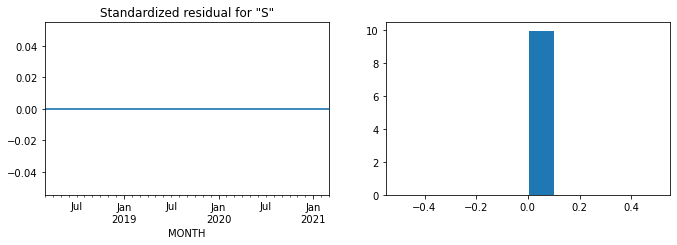

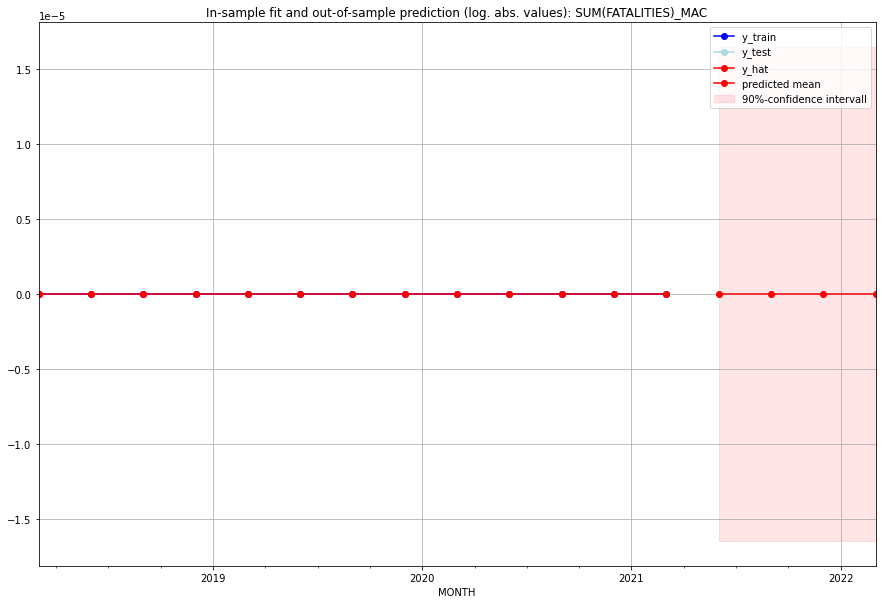

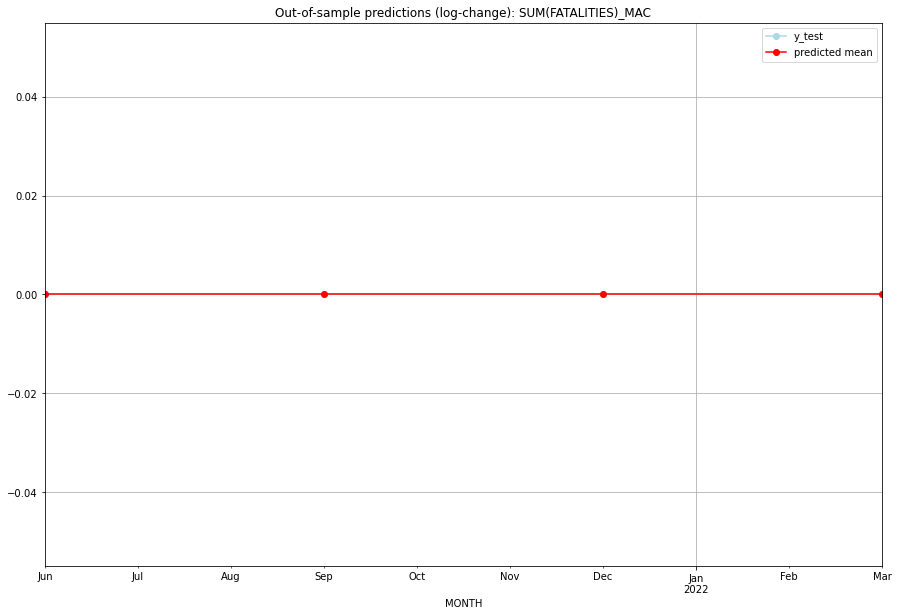

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MAC   
1 2021-07-01       0.0         0.0           0.0             0.0   MAC   
2 2021-10-01       0.0         0.0           0.0             0.0   MAC   
3 2022-01-01       0.0         0.0           0.0             0.0   MAC   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## MAR (130/234) #########
0
Neighbor countries: ['DZA', 'ESP', 'ESH']
Getting Data for MAR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4329346376844968, 'fold_results': [0.34657359027997264, 0.5198603854199589, 0.8502993454155389, 0.44793986730701374, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MAR   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -114.279
Date:                 Wed, 19 Oct 2022   AIC                            230.558
Time:                         10:44:27   BIC                            233.122
Sample:                     04-30-1997   HQIC                           231.594
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

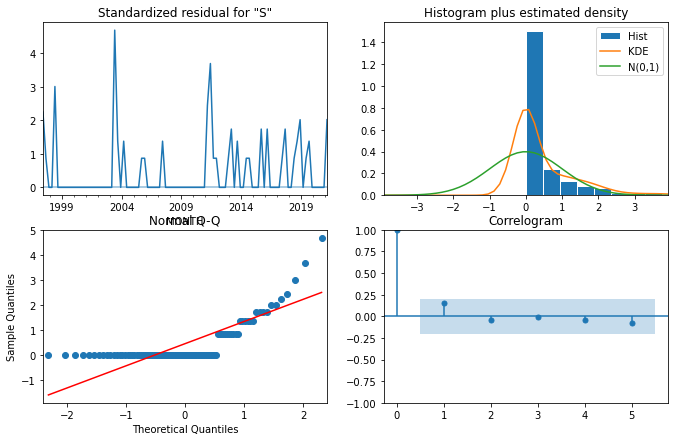

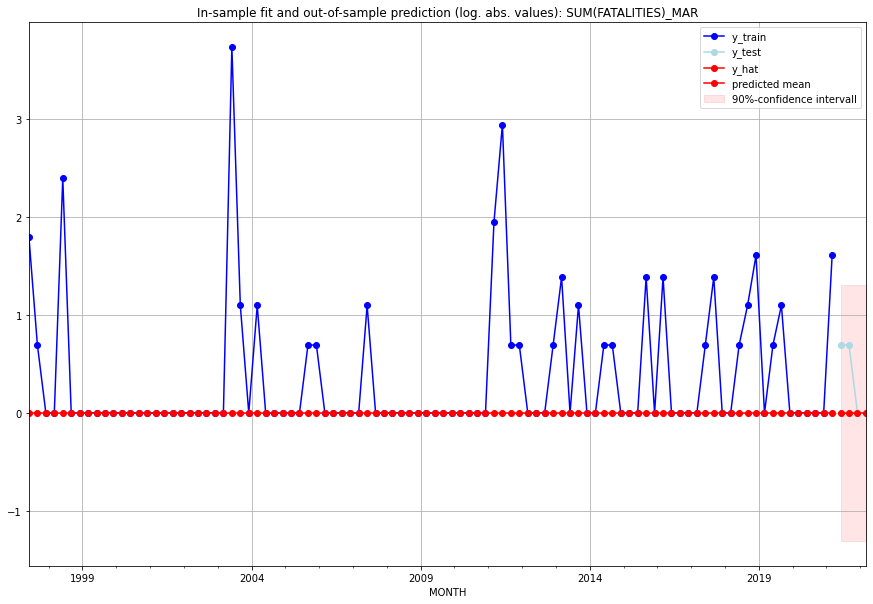

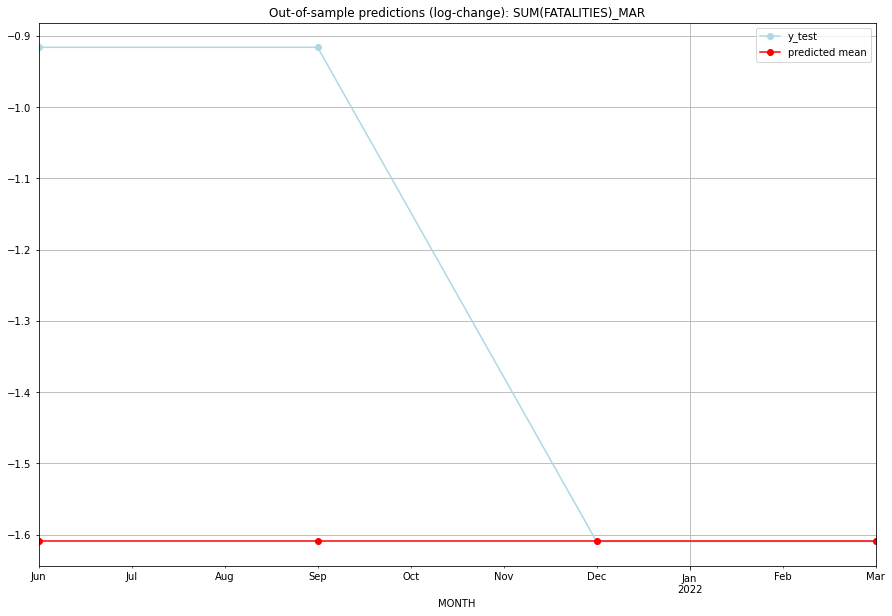

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         1.0     -1.609438       -0.916291   MAR   
1 2021-07-01       0.0         1.0     -1.609438       -0.916291   MAR   
2 2021-10-01       0.0         0.0     -1.609438       -1.609438   MAR   
3 2022-01-01       0.0         0.0     -1.609438       -1.609438   MAR   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:24
######## MCO (131/234) #########
0
Neighbor countries: ['FRA']
Getting Data for MCO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insuffici

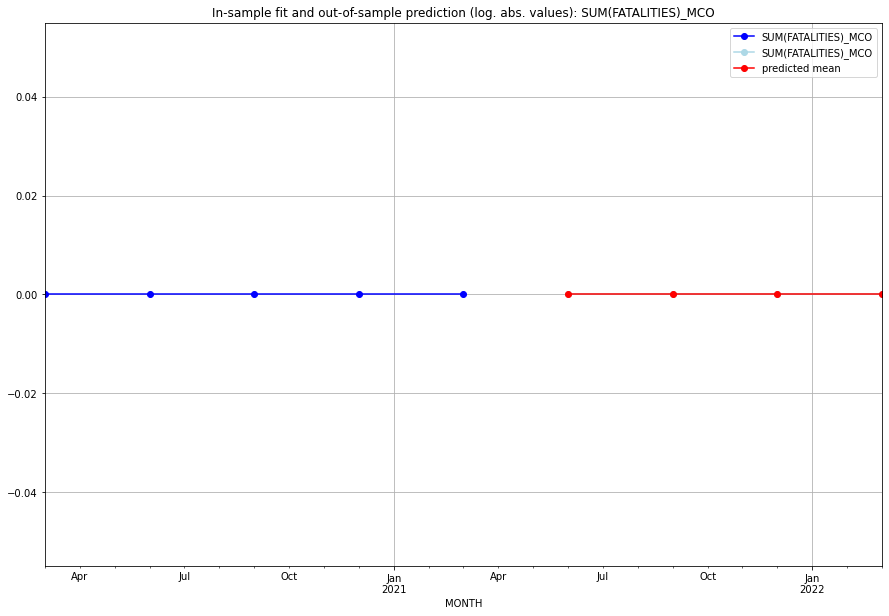

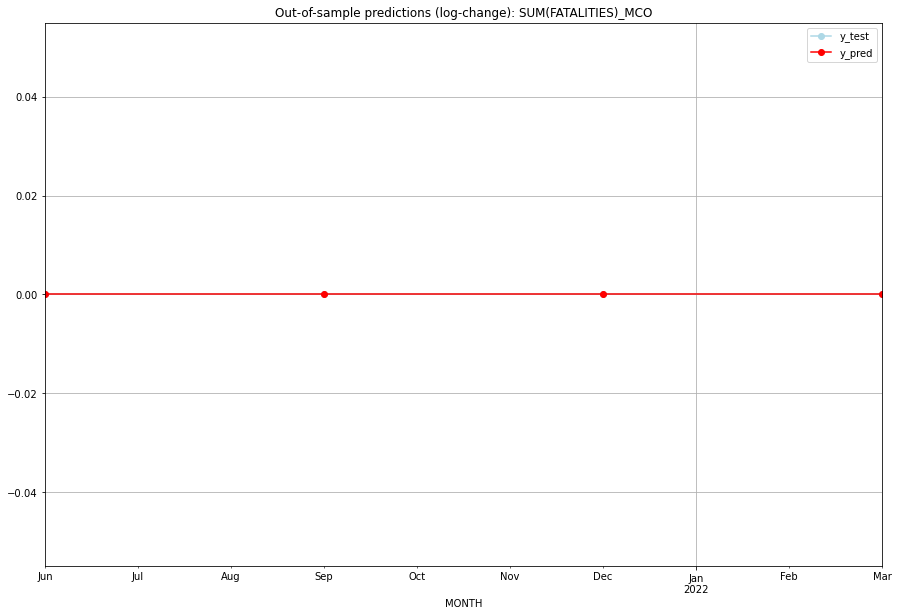

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MCO   
1 2021-07-01       0.0         0.0           0.0             0.0   MCO   
2 2021-10-01       0.0         0.0           0.0             0.0   MCO   
3 2022-01-01       0.0         0.0           0.0             0.0   MCO   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## MDA (132/234) #########
0
Neighbor countries: ['UKR', 'ROU']
Getting Data for MDA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 16)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MDA   No. Observations:               

<Figure size 432x288 with 0 Axes>

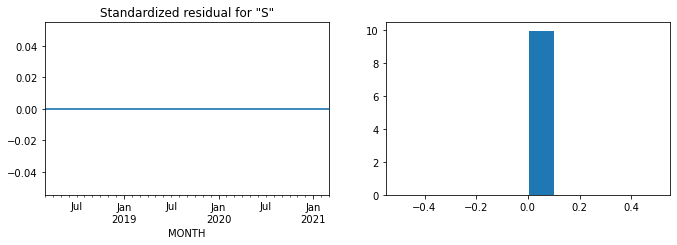

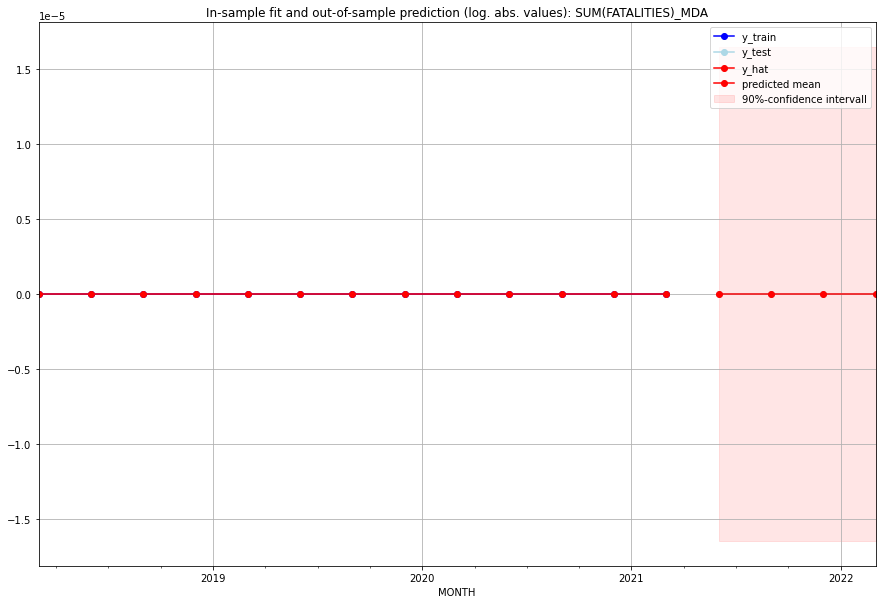

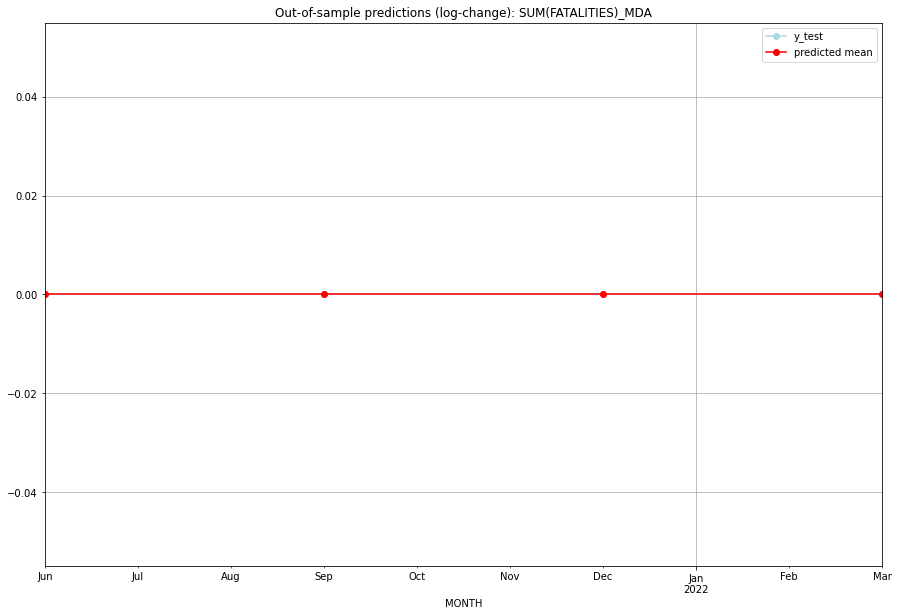

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MDA   
1 2021-07-01       0.0         0.0           0.0             0.0   MDA   
2 2021-10-01       0.0         0.0           0.0             0.0   MDA   
3 2022-01-01       0.0         0.0           0.0             0.0   MDA   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:04
######## MDG (133/234) #########
0
Neighbor countries: []
Getting Data for MDG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5198251236504798, 'fold_results': [0.5889215808461217, 0.5802577220367702, 0.3539264287852101, 0.8230520695423247, 0.25296781704197246]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MDG   No. Observations:                   96
Model:                SARIMAX(0, 1, 2)   Log Likelihood                -139.572
Date:                 Wed, 19 Oct 2022   AIC                            285.145
Time:                         10:44:49   BIC                            292.807
Sample:                     04-30-1997   HQIC                           288.241
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

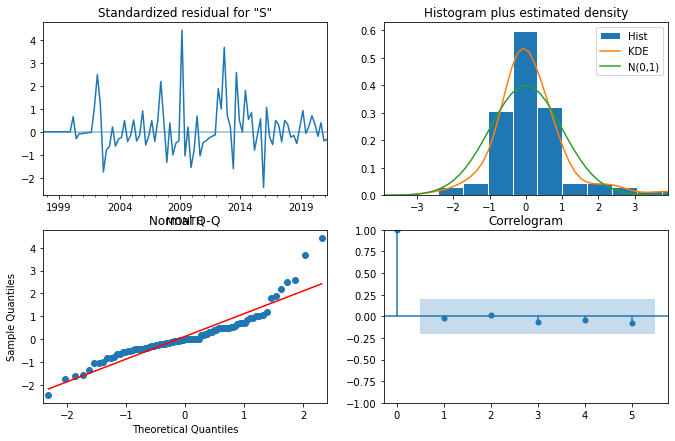

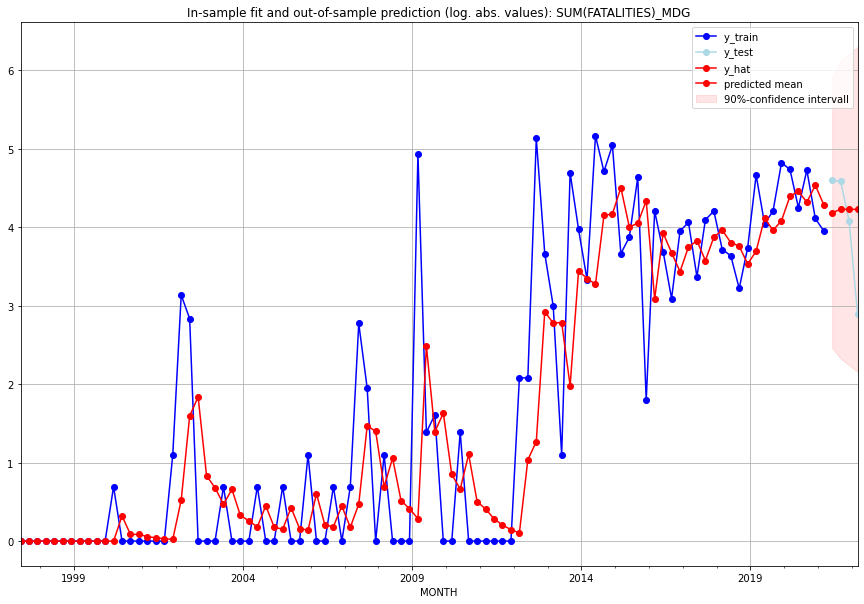

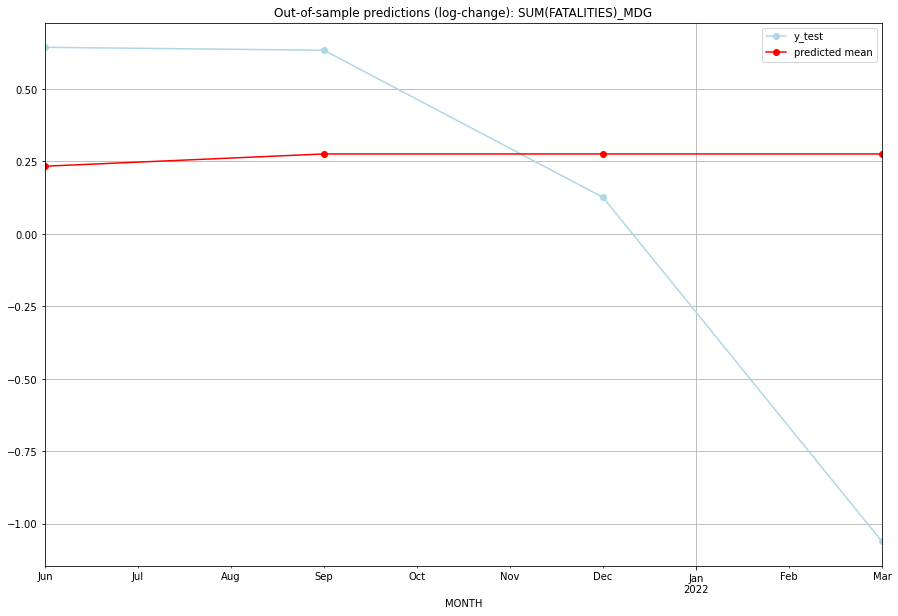

TADDA: 0.6326178361954025
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  64.689653        98.0      0.233698        0.643876   MDG   
1 2021-07-01  67.527778        97.0      0.275995        0.633724   MDG   
2 2021-10-01  67.527778        58.0      0.275995        0.126294   MDG   
3 2022-01-01  67.527778        17.0      0.275995       -1.060872   MDG   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## MDV (134/234) #########
0
Neighbor countries: []
Getting Data for MDV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficie

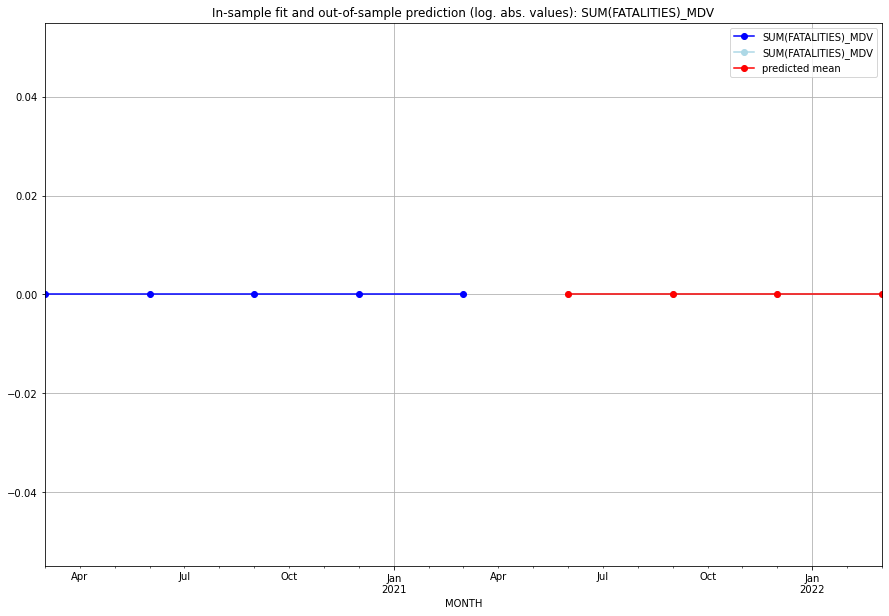

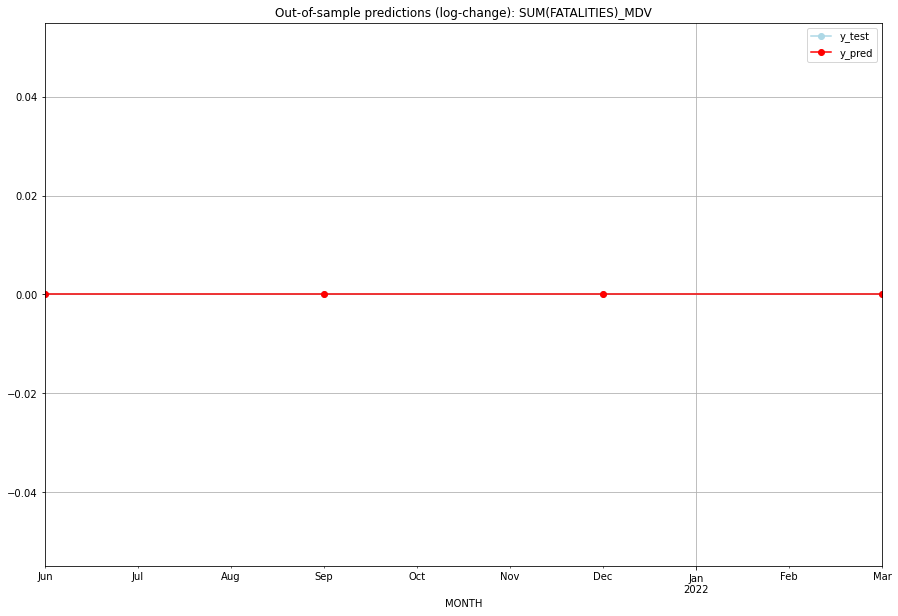

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MDV   
1 2021-07-01       0.0         0.0           0.0             0.0   MDV   
2 2021-10-01       0.0         0.0           0.0             0.0   MDV   
3 2022-01-01       0.0         0.0           0.0             0.0   MDV   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## MEX (135/234) #########
0
Neighbor countries: ['USA', 'BLZ', 'GTM']
Getting Data for MEX
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.07058273660689807, 'fold_results': [0.06431303975345481, 0.07685243346034132]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MEX   No. Observations:                   13
Model:                SARIMAX(1, 0, 3)   Log Likelihood                  -0.263
Date:                 Wed, 19 Oct 2022   AIC                             16.525
Time:                         10:45:02   BIC                             21.045
Sample:                     01-31-2018   HQIC                            15.596
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0346     

<Figure size 432x288 with 0 Axes>

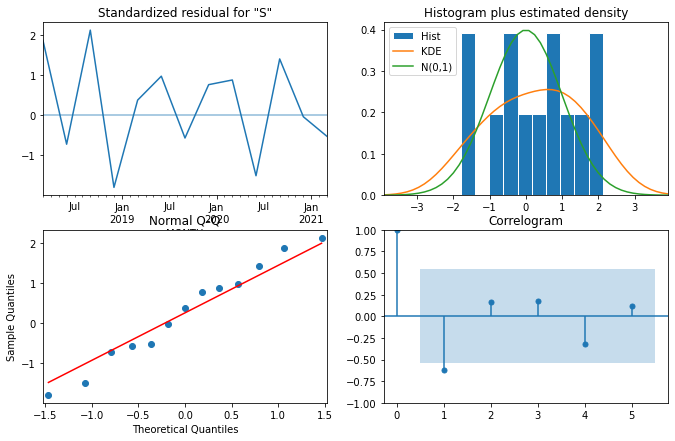

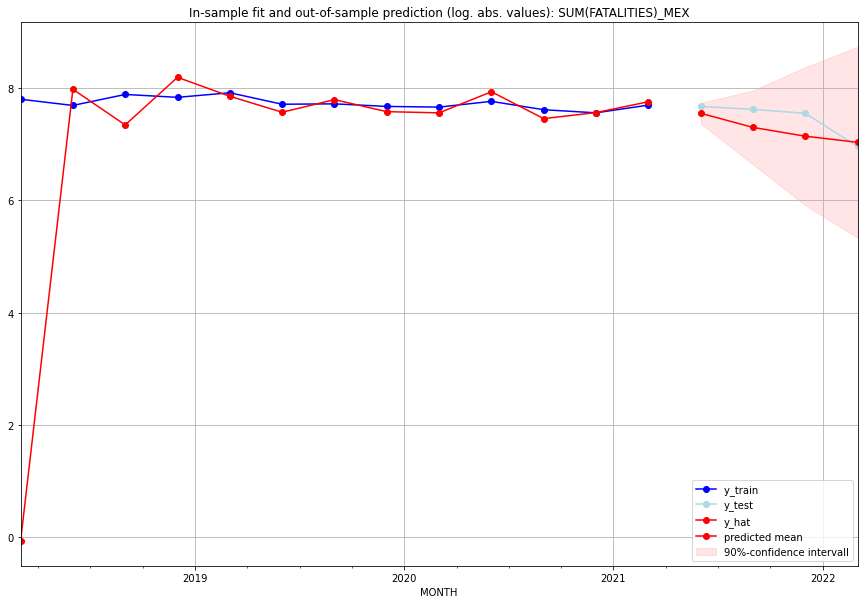

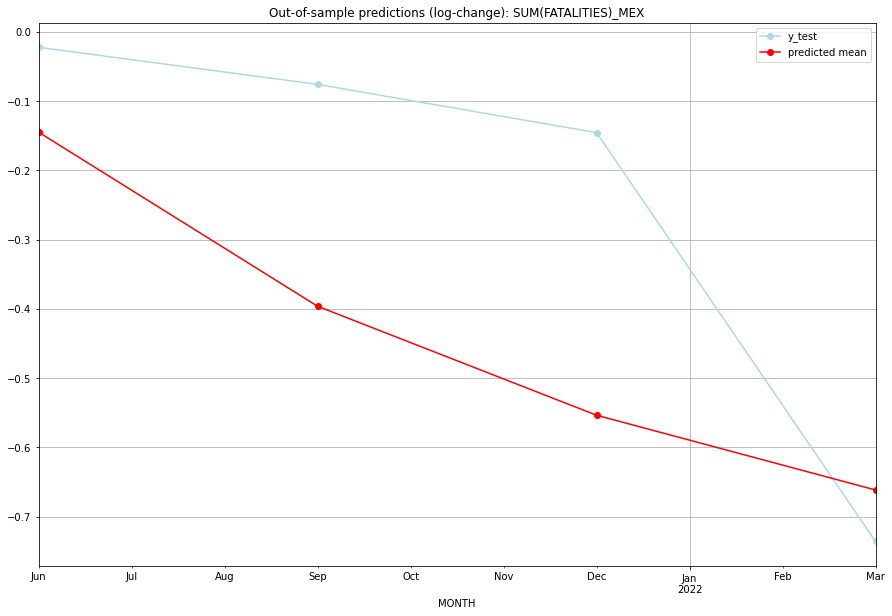

TADDA: 0.23129193038212548
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1900.174415      2148.0     -0.145076       -0.022545   MEX   
1 2021-07-01  1477.671418      2036.0     -0.396404       -0.076070   MEX   
2 2021-10-01  1262.484457      1899.0     -0.553675       -0.145694   MEX   
3 2022-01-01  1133.242994      1052.0     -0.661582       -0.735905   MEX   

                                          PARAMETERS  
0  {'params': [3, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## MKD (136/234) #########
0
Neighbor countries: ['ALB', 'XKO', 'BGR', 'GRC', 'SRB']
Getting Data for MKD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Tr

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MKD   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:45:18   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

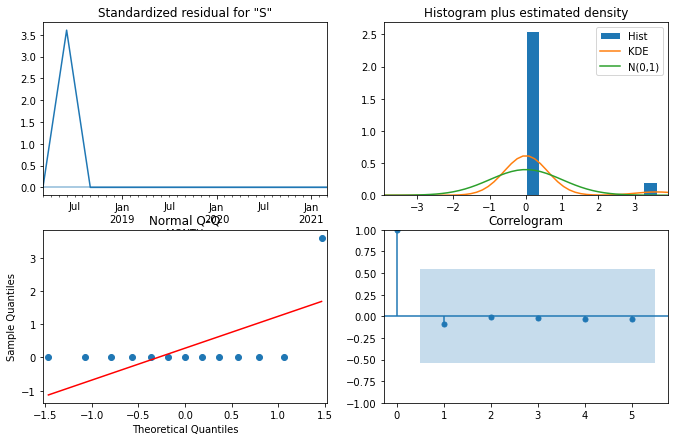

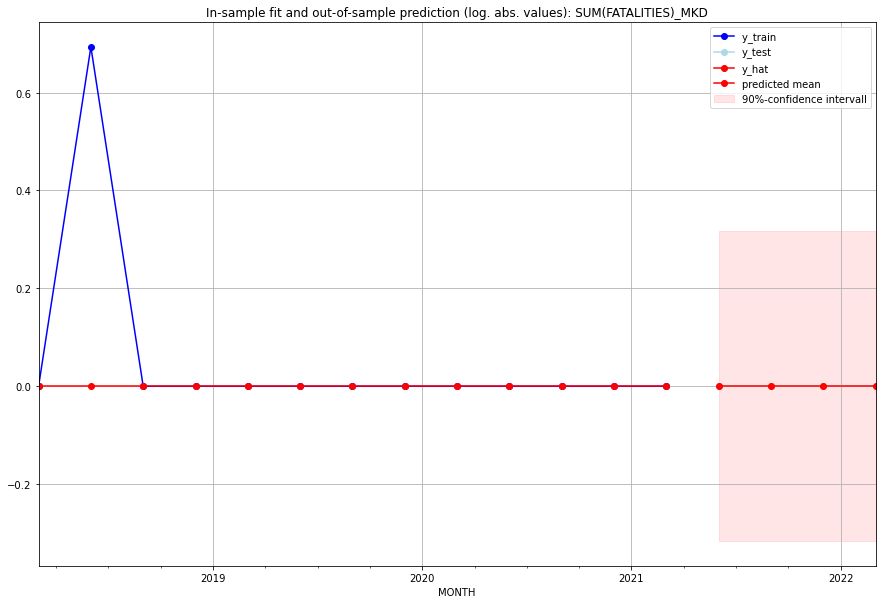

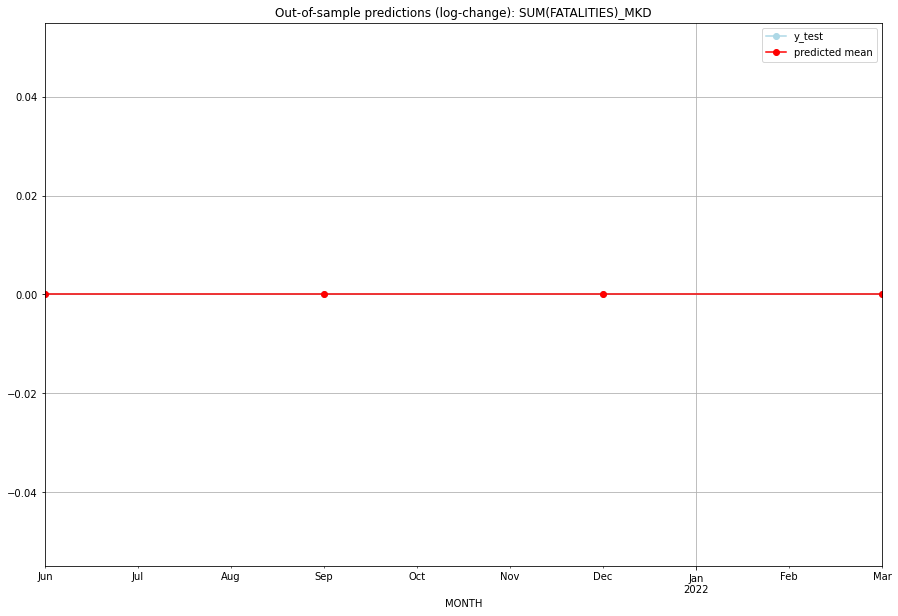

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MKD   
1 2021-07-01       0.0         0.0           0.0             0.0   MKD   
2 2021-10-01       0.0         0.0           0.0             0.0   MKD   
3 2022-01-01       0.0         0.0           0.0             0.0   MKD   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## MLI (137/234) #########
0
Neighbor countries: ['NER', 'GIN', 'MRT', 'SEN', 'BFA', 'CIV', 'DZA']
Getting Data for MLI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 56)
y: (100, 1)
------------------------------------------------
Training started.

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5752259569357879, 'fold_results': [0.33012554616390677, 1.0198335636514622, 0.7117067491805988, 0.22545909372759199, 0.5890048319553798]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MLI   No. Observations:                   96
Model:                SARIMAX(3, 1, 0)   Log Likelihood                -152.838
Date:                 Wed, 19 Oct 2022   AIC                            313.676
Time:                         10:45:36   BIC                            323.891
Sample:                     04-30-1997   HQIC                           317.804
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

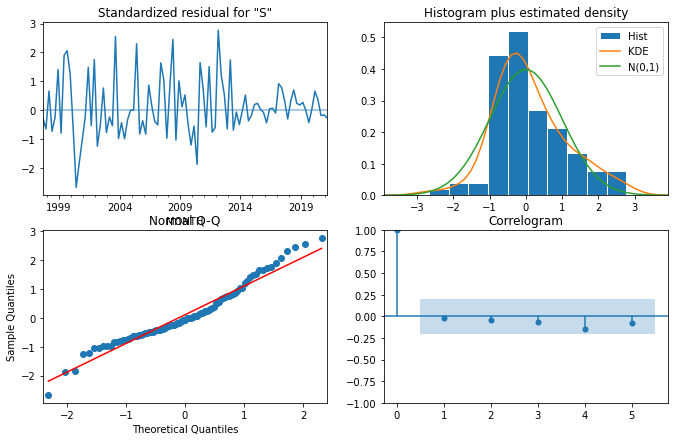

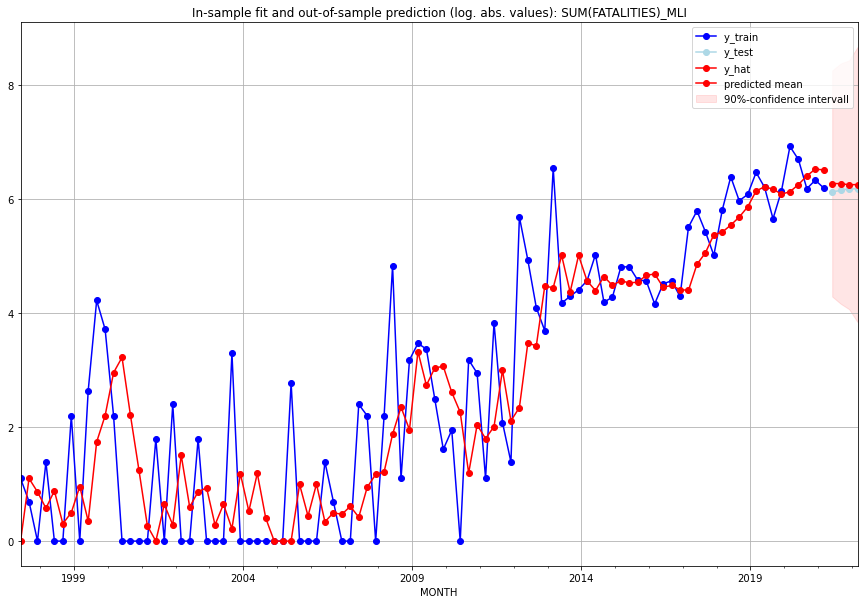

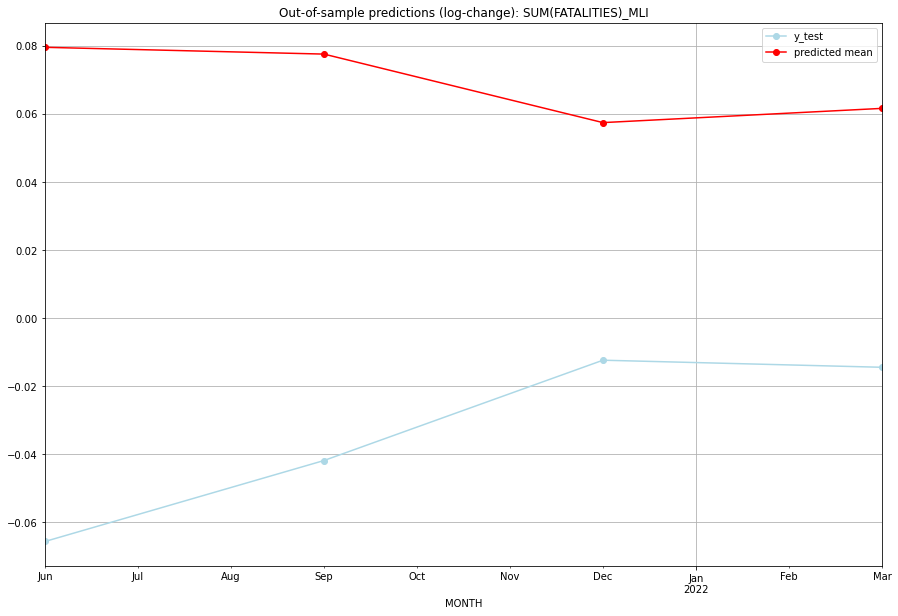

TADDA: 0.17166034776672645
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  527.410111       456.0      0.079557       -0.065632   MLI   
1 2021-07-01  526.357986       467.0      0.077564       -0.041847   MLI   
2 2021-10-01  515.849086       481.0      0.057436       -0.012371   MLI   
3 2022-01-01  518.013450       480.0      0.061614       -0.014448   MLI   

                                          PARAMETERS  
0  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## MLT (138/234) #########
0
Neighbor countries: []
Getting Data for MLT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insu

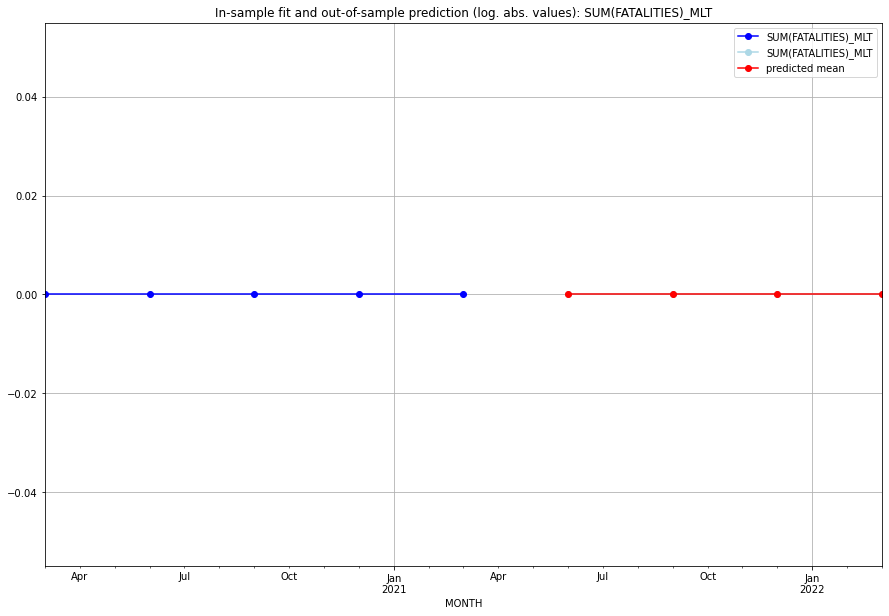

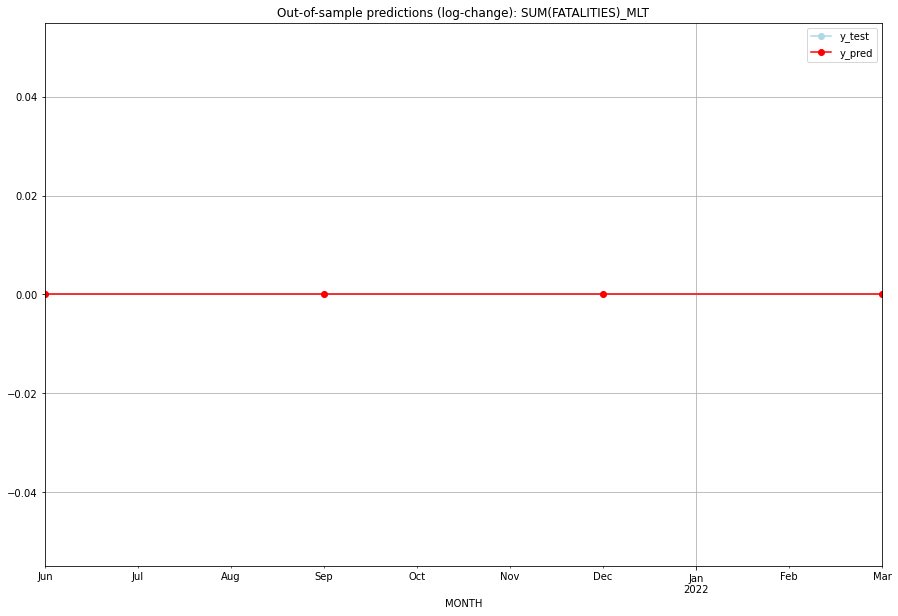

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MLT   
1 2021-07-01       0.0         0.0           0.0             0.0   MLT   
2 2021-10-01       0.0         0.0           0.0             0.0   MLT   
3 2022-01-01       0.0         0.0           0.0             0.0   MLT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## MMR (139/234) #########
0
Neighbor countries: ['BGD', 'IND', 'CHN', 'LAO', 'THA']
Getting Data for MMR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 40)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8382573915454709, 'fold_results': [0.58848334258273, 1.3170815354506846, 0.21020633647039644, 1.5155939581051991, 0.559921785118344]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MMR   No. Observations:                   45
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -63.029
Date:                 Wed, 19 Oct 2022   AIC                            128.058
Time:                         10:46:06   BIC                            129.842
Sample:                     01-31-2010   HQIC                           128.720
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

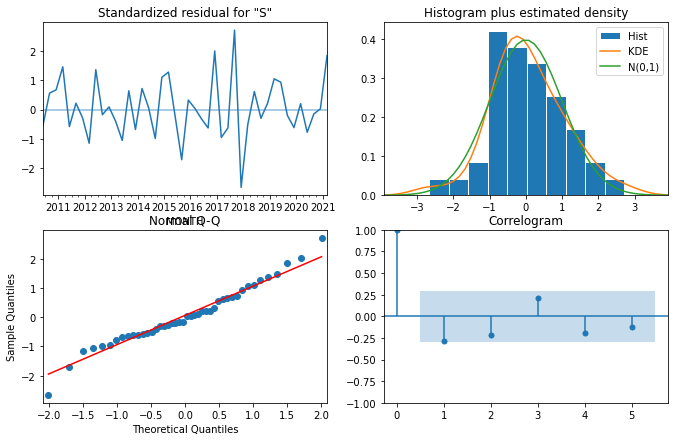

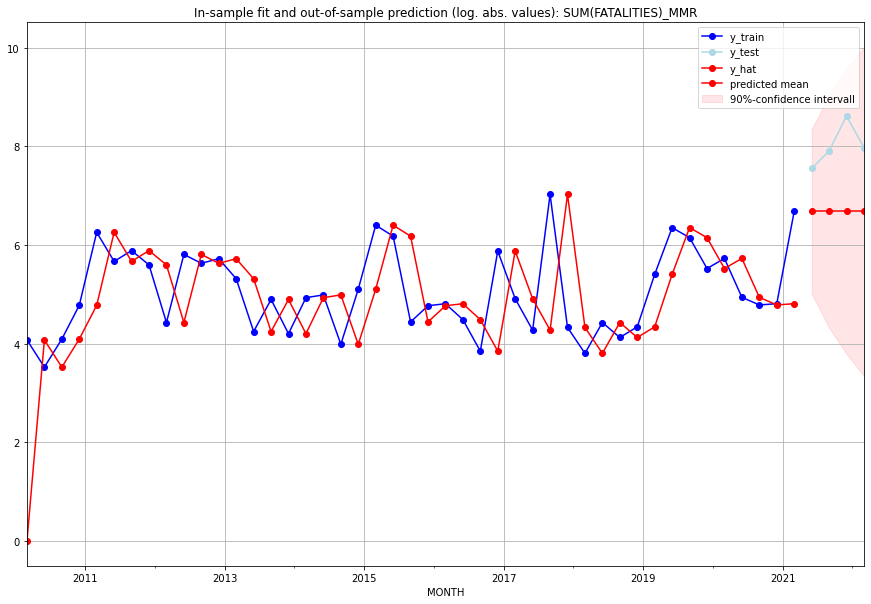

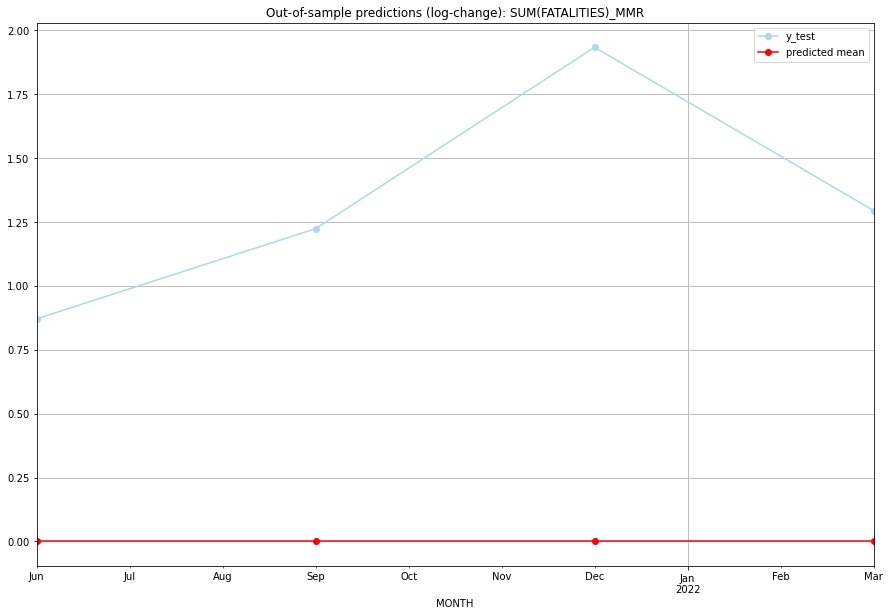

TADDA: 1.3305675037394713
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     798.0      1908.0           0.0        0.870974   MMR   
1 2021-07-01     798.0      2715.0           0.0        1.223555   MMR   
2 2021-10-01     798.0      5521.0           0.0        1.933134   MMR   
3 2022-01-01     798.0      2915.0           0.0        1.294607   MMR   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:28
######## MNE (140/234) #########
0
Neighbor countries: ['BIH', 'ALB', 'XKO', 'SRB', 'HRV']
Getting Data for MNE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training started.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MNE   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                  -2.997
Date:                 Wed, 19 Oct 2022   AIC                              7.993
Time:                         10:46:13   BIC                              8.558
Sample:                     01-31-2018   HQIC                             7.877
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0928      0.015      6.245      0.000       0.064       0

<Figure size 432x288 with 0 Axes>

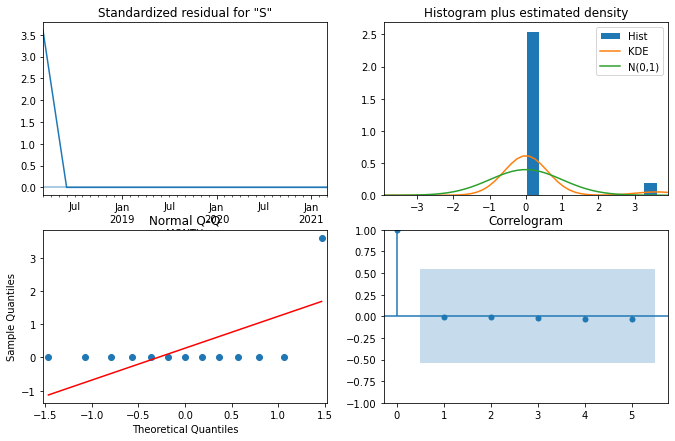

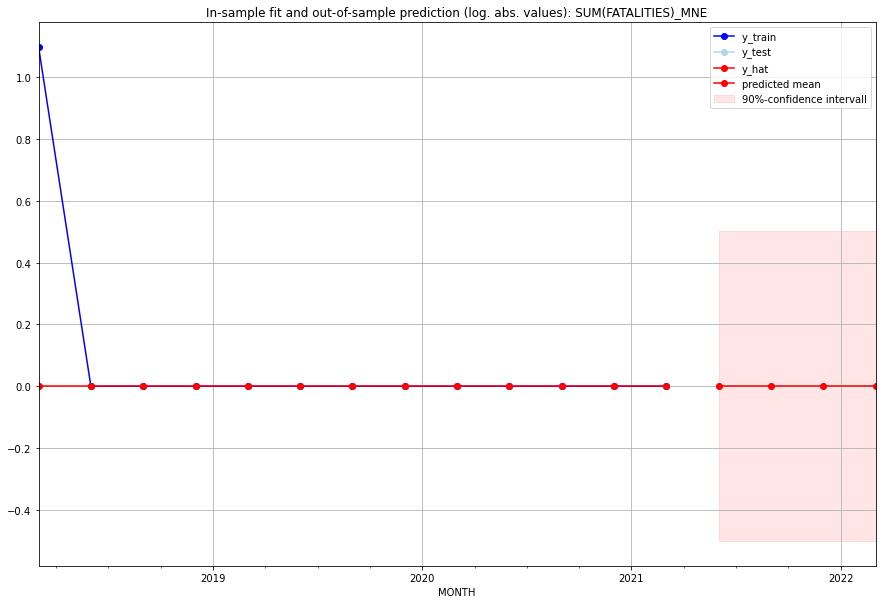

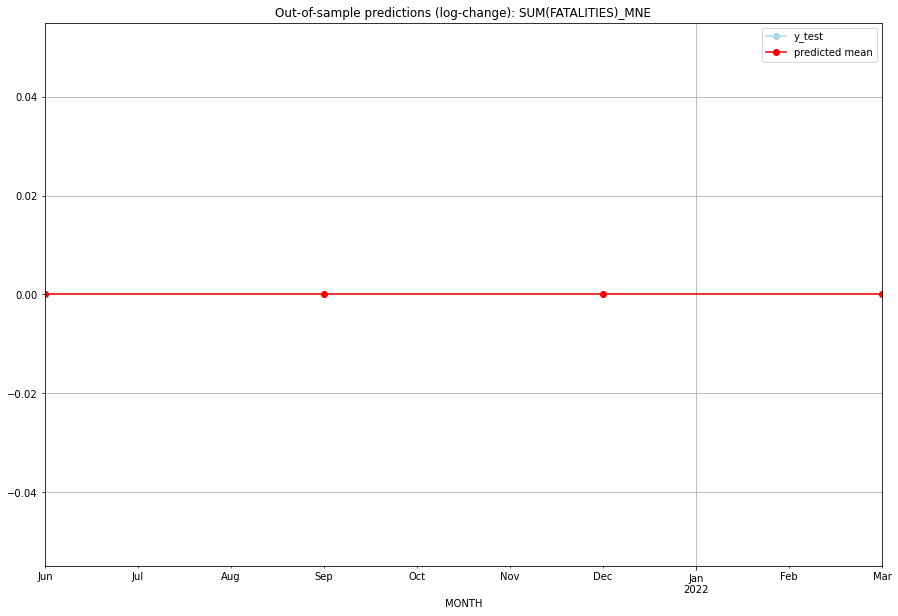

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MNE   
1 2021-07-01       0.0         0.0           0.0             0.0   MNE   
2 2021-10-01       0.0         0.0           0.0             0.0   MNE   
3 2022-01-01       0.0         0.0           0.0             0.0   MNE   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## MNG (141/234) #########
0
Neighbor countries: ['CHN', 'RUS']
Getting Data for MNG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 16)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MNG   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:46:26   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

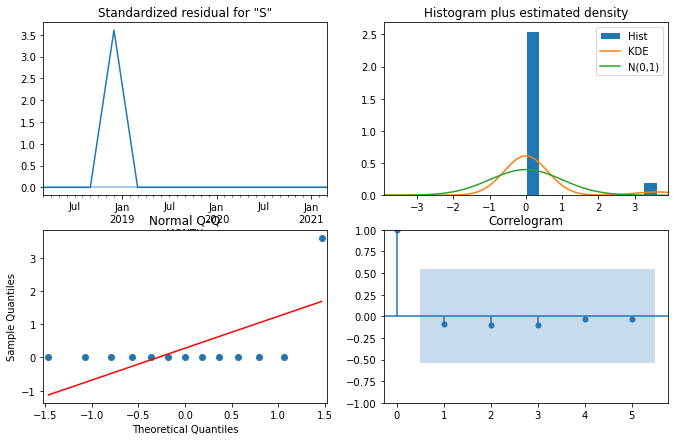

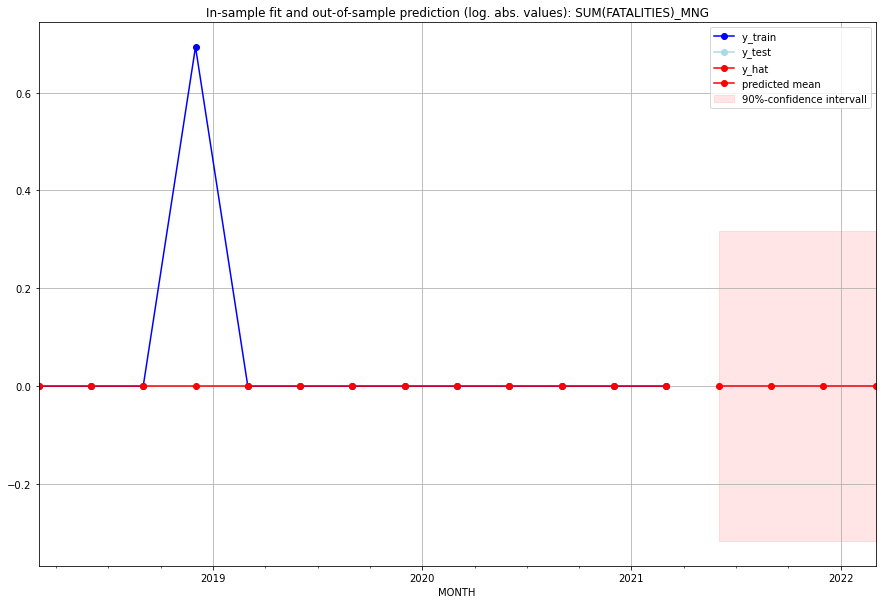

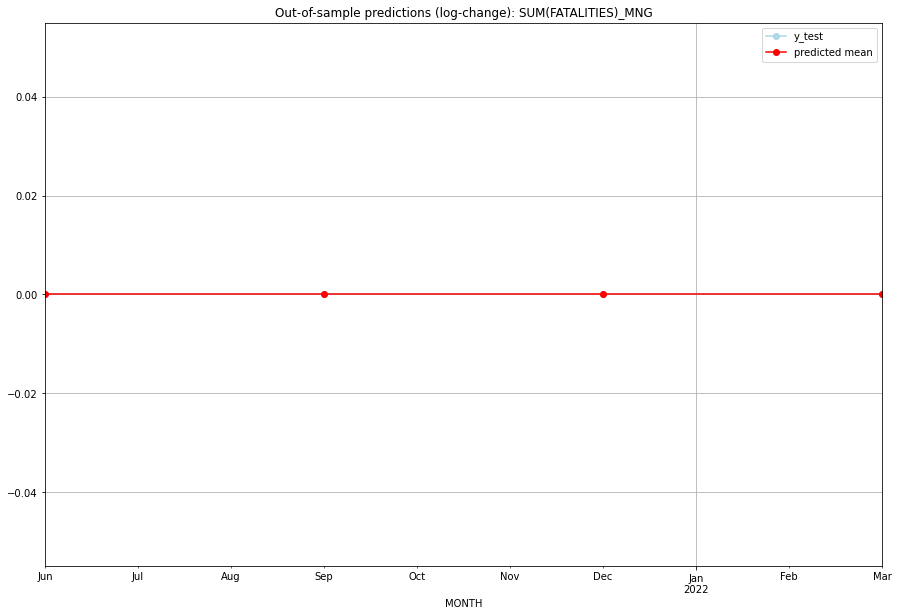

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MNG   
1 2021-07-01       0.0         0.0           0.0             0.0   MNG   
2 2021-10-01       0.0         0.0           0.0             0.0   MNG   
3 2022-01-01       0.0         0.0           0.0             0.0   MNG   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## MNP (142/234) #########
0
Neighbor countries: []
Getting Data for MNP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross va

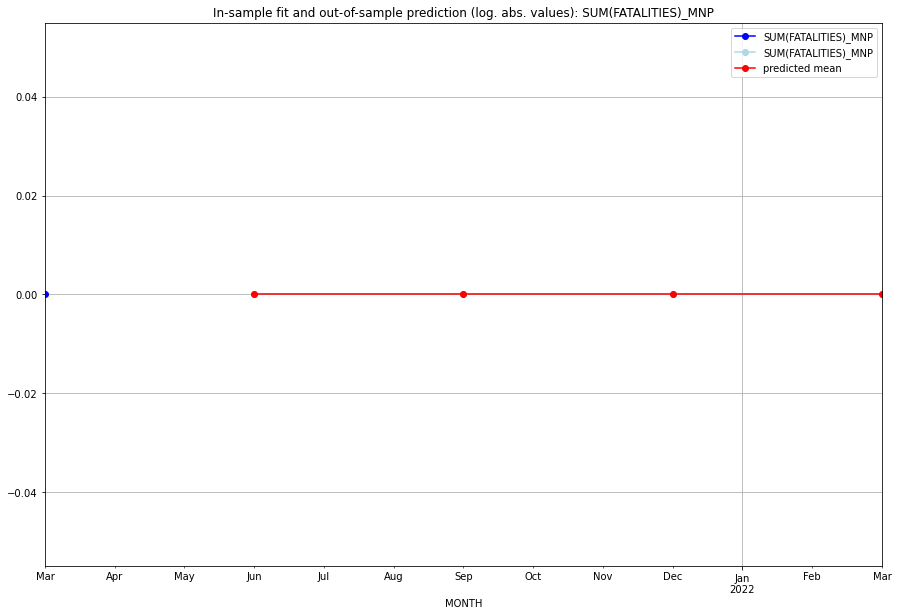

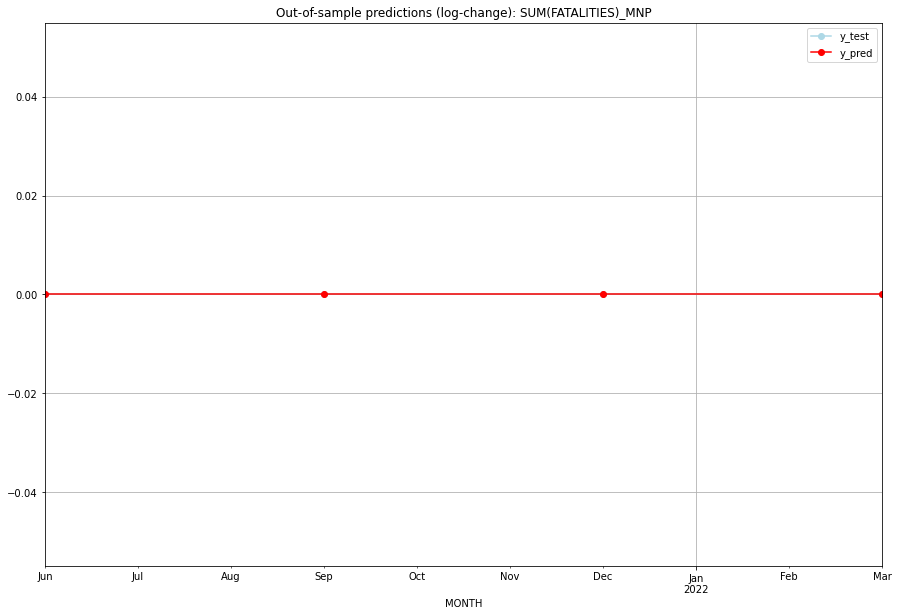

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MNP   
1 2021-07-01       0.0         0.0           0.0             0.0   MNP   
2 2021-10-01       0.0         0.0           0.0             0.0   MNP   
3 2022-01-01       0.0         0.0           0.0             0.0   MNP   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## MOZ (143/234) #########
0
Neighbor countries: ['MWI', 'ZMB', 'ZWE', 'TZA', 'ZAF', 'SWZ']
Getting Data for MOZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 48)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7164632129656635, 'fold_results': [0.7824423781335669, 0.5428824442142791, 0.7168759710017039, 0.9058730908568606, 0.6342421806219072]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MOZ   No. Observations:                   96
Model:                SARIMAX(1, 1, 0)   Log Likelihood                -127.557
Date:                 Wed, 19 Oct 2022   AIC                            263.113
Time:                         10:46:57   BIC                            273.329
Sample:                     04-30-1997   HQIC                           267.241
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

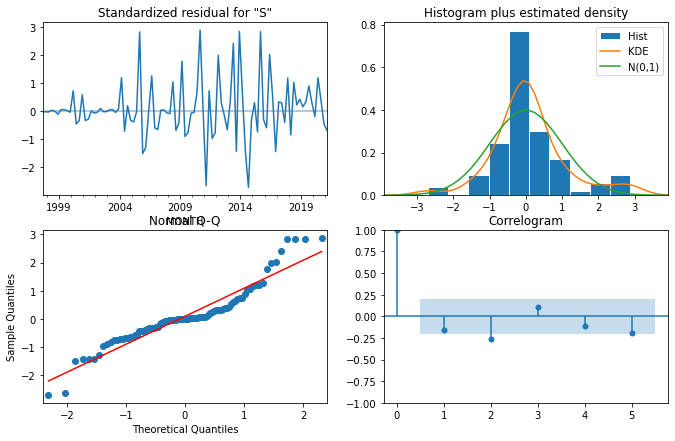

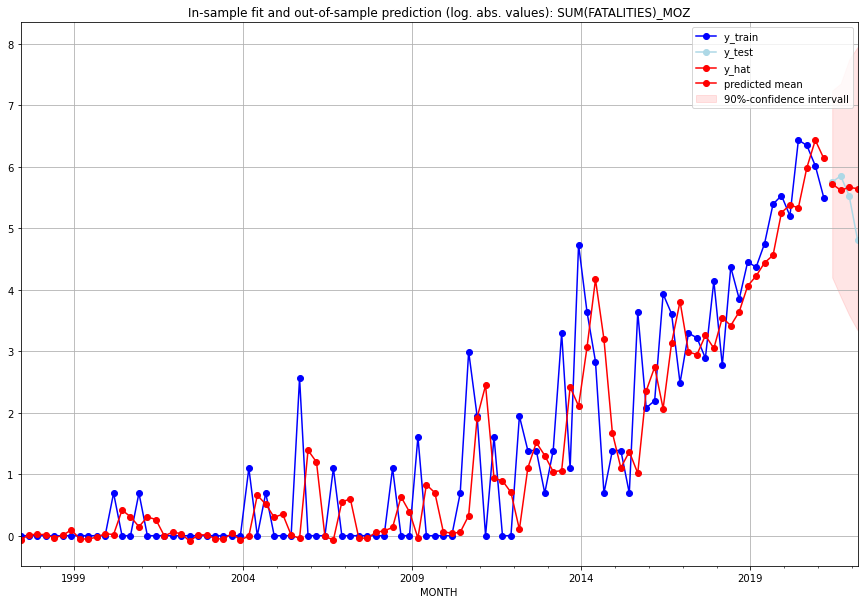

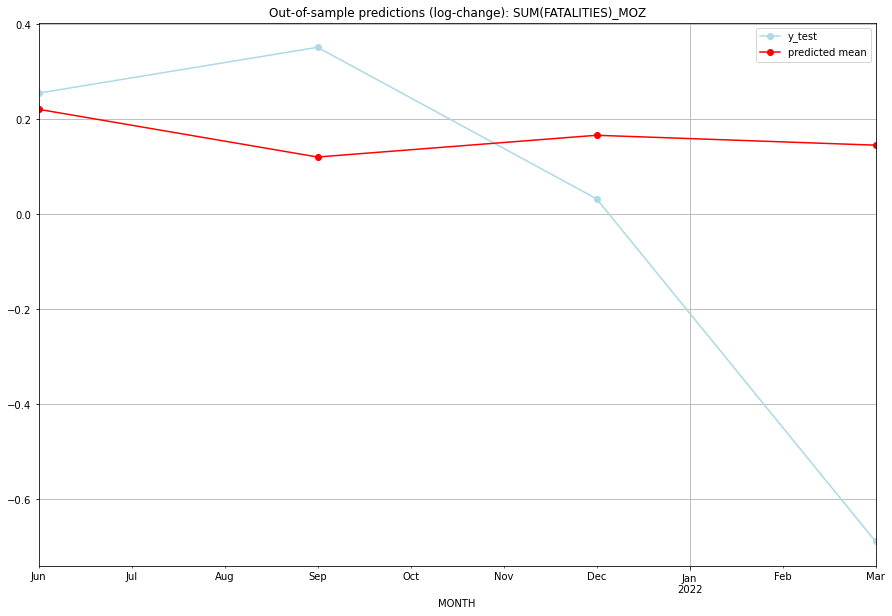

TADDA: 0.3443938582639239
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  304.445482       315.0      0.220513        0.254484   MOZ   
1 2021-07-01  275.257382       347.0      0.120075        0.350944   MOZ   
2 2021-10-01  288.188922       252.0      0.165822        0.032131   MOZ   
3 2022-01-01  282.225513       122.0      0.144985       -0.689074   MOZ   

                                          PARAMETERS  
0  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:26
######## MRT (144/234) #########
0
Neighbor countries: ['DZA', 'ESH', 'MLI', 'SEN']
Getting Data for MRT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 32)
y: (100, 1)
------------------------------------------------
Training star

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3786251492510192, 'fold_results': [0.0, 0.27465307216702745, 0.44793986730701374, 0.4479398673070139, 0.7225929394740411]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MRT   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -141.952
Date:                 Wed, 19 Oct 2022   AIC                            287.904
Time:                         10:47:18   BIC                            293.012
Sample:                     04-30-1997   HQIC                           289.968
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

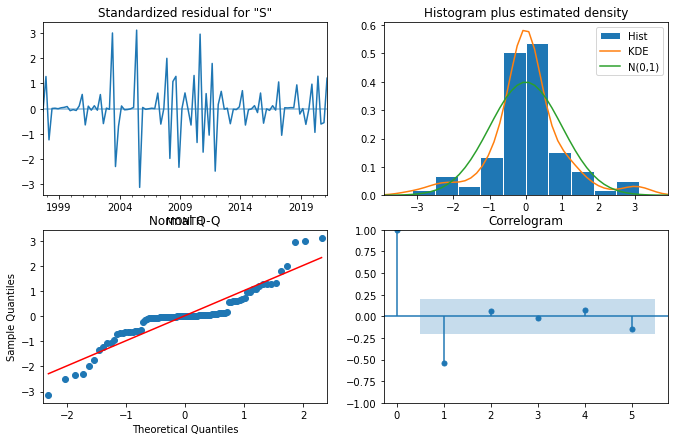

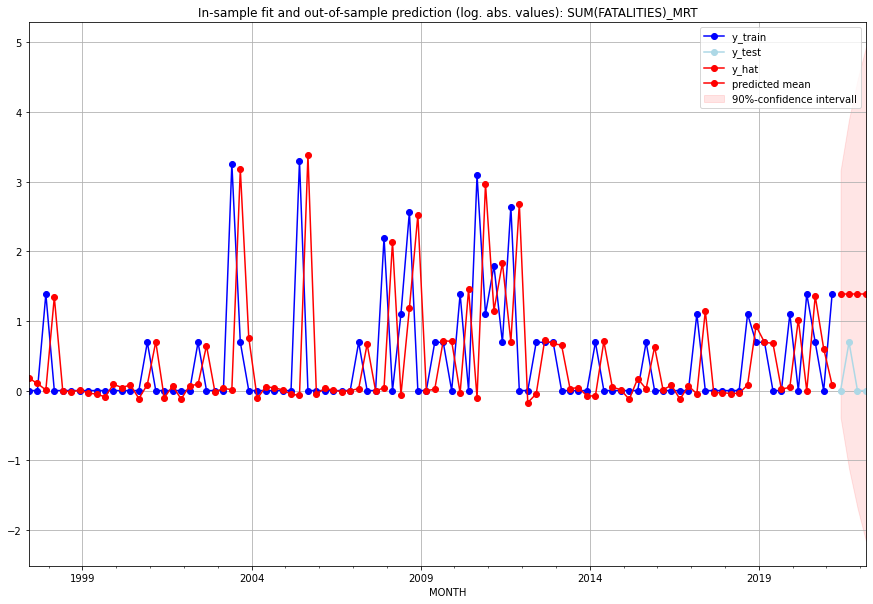

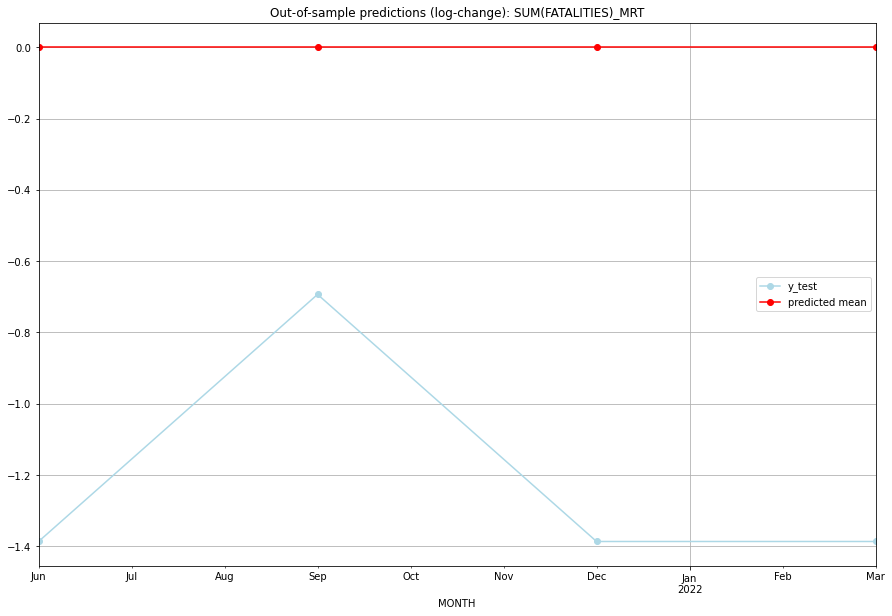

TADDA: 1.2130075659799038
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       3.0         0.0 -4.440892e-16       -1.386294   MRT   
1 2021-07-01       3.0         1.0 -4.440892e-16       -0.693147   MRT   
2 2021-10-01       3.0         0.0 -4.440892e-16       -1.386294   MRT   
3 2022-01-01       3.0         0.0 -4.440892e-16       -1.386294   MRT   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## MSR (145/234) #########
0
Neighbor countries: []
Getting Data for MSR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

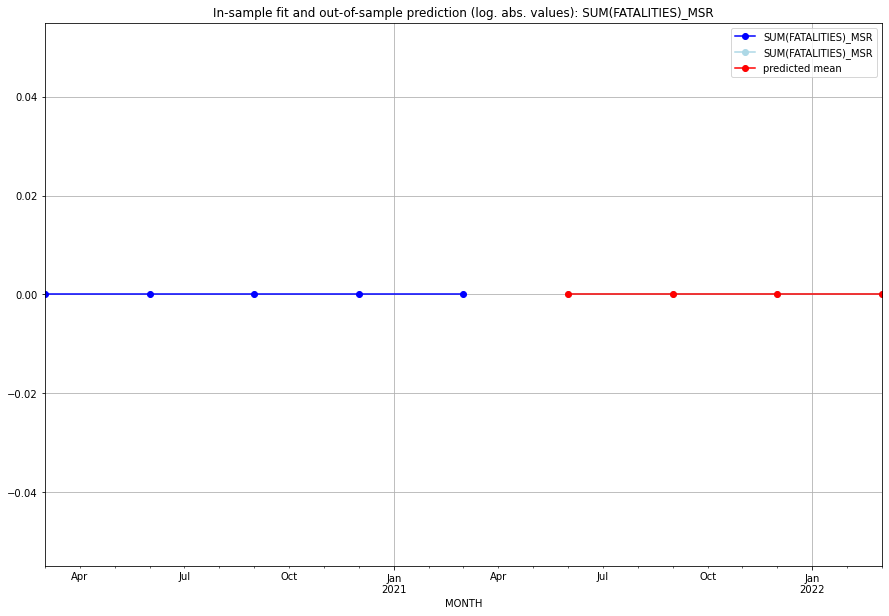

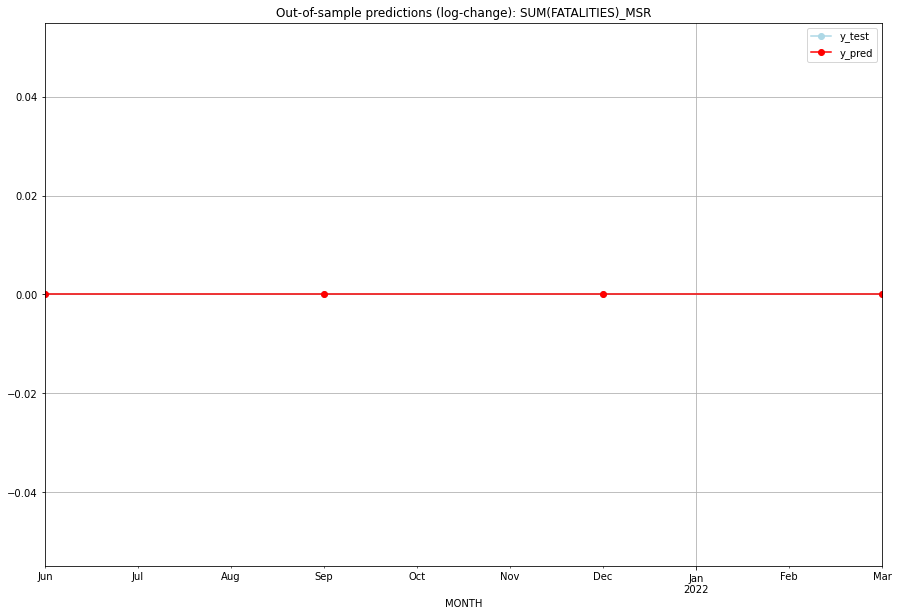

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MSR   
1 2021-07-01       0.0         0.0           0.0             0.0   MSR   
2 2021-10-01       0.0         0.0           0.0             0.0   MSR   
3 2022-01-01       0.0         0.0           0.0             0.0   MSR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## MTQ (146/234) #########
0
Neighbor countries: []
Getting Data for MTQ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MTQ   No. Observations:                   13
Model:

<Figure size 432x288 with 0 Axes>

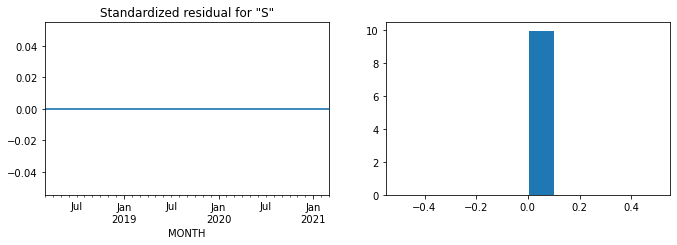

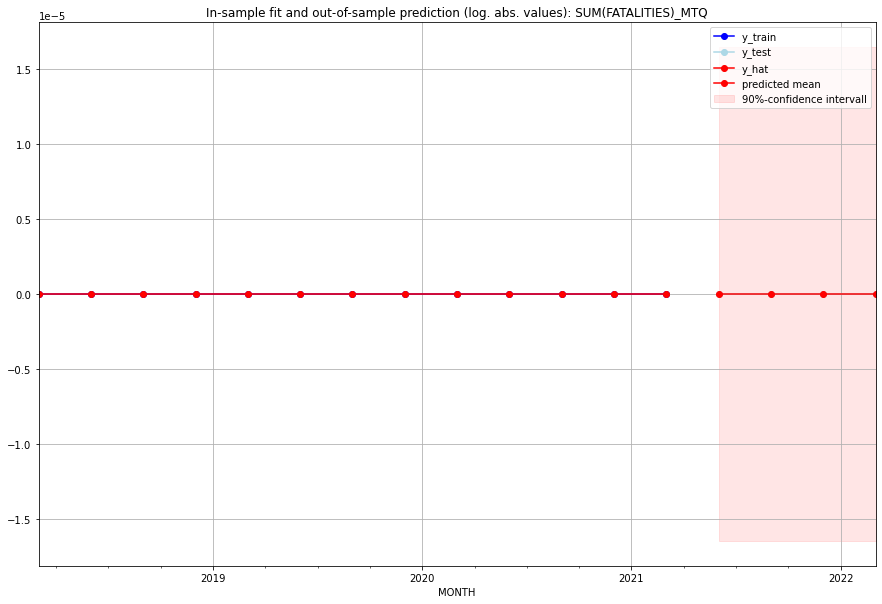

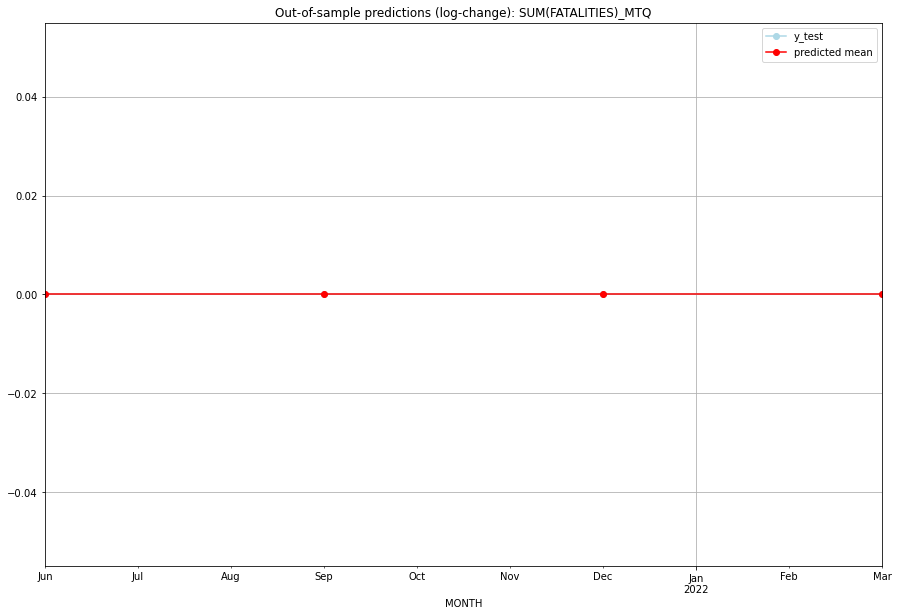

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MTQ   
1 2021-07-01       0.0         0.0           0.0             0.0   MTQ   
2 2021-10-01       0.0         0.0           0.0             0.0   MTQ   
3 2022-01-01       0.0         0.0           0.0             0.0   MTQ   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## MUS (147/234) #########
0
Neighbor countries: []
Getting Data for MUS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.06931471805599453, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.34657359027997264]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MUS   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                  65.322
Date:                 Wed, 19 Oct 2022   AIC                           -128.645
Time:                         10:47:35   BIC                           -126.081
Sample:                     04-30-1997   HQIC                          -127.608
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0150      

<Figure size 432x288 with 0 Axes>

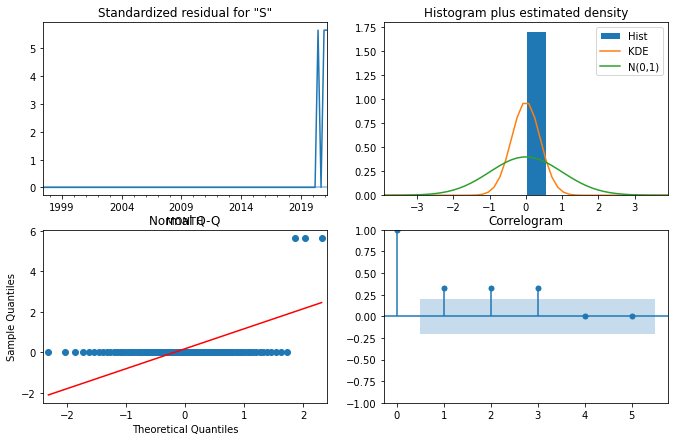

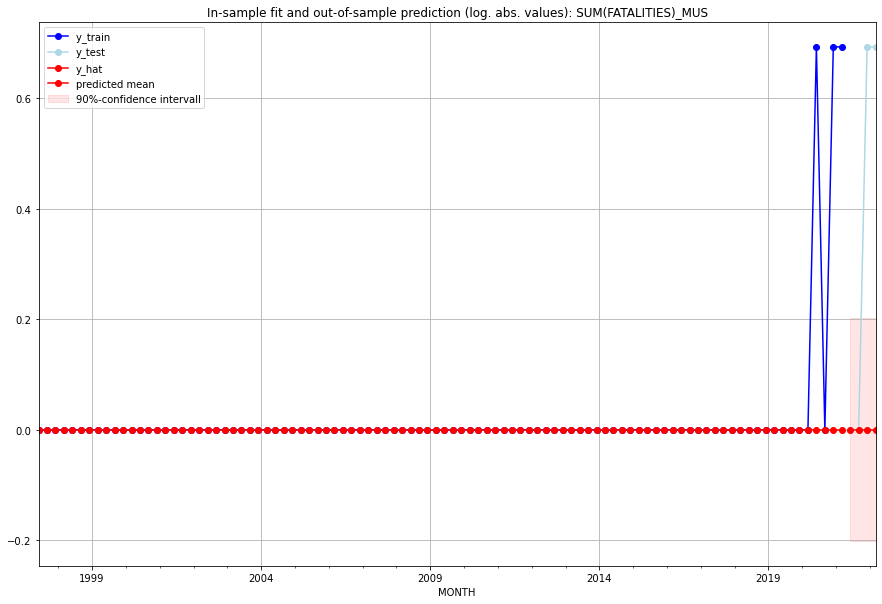

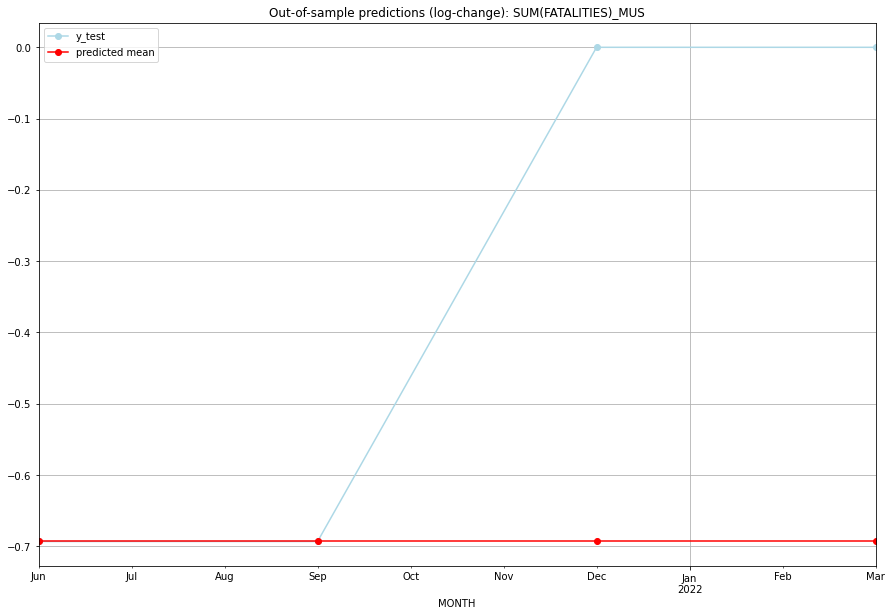

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -0.693147       -0.693147   MUS   
1 2021-07-01       0.0         0.0     -0.693147       -0.693147   MUS   
2 2021-10-01       0.0         1.0     -0.693147        0.000000   MUS   
3 2022-01-01       0.0         1.0     -0.693147        0.000000   MUS   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## MWI (148/234) #########
0
Neighbor countries: ['MOZ', 'ZMB', 'TZA']
Getting Data for MWI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDS

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.851163723593688, 'fold_results': [1.172581998582099, 0.6181210324473607, 0.5037257551355664, 1.3834708594652012, 0.5779189723382119]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MWI   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -119.478
Date:                 Wed, 19 Oct 2022   AIC                            240.957
Time:                         10:47:54   BIC                            243.511
Sample:                     04-30-1997   HQIC                           241.989
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

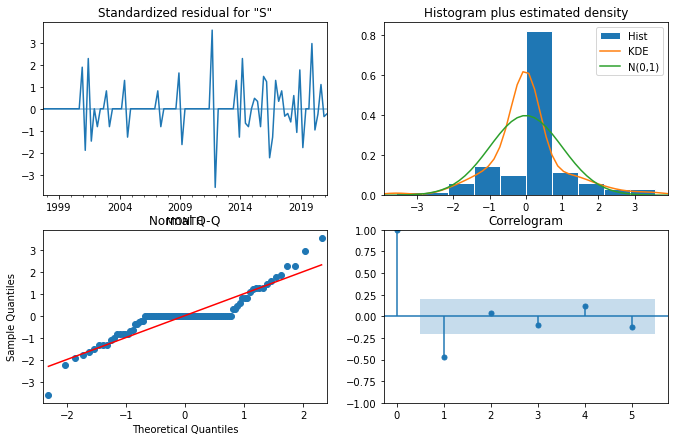

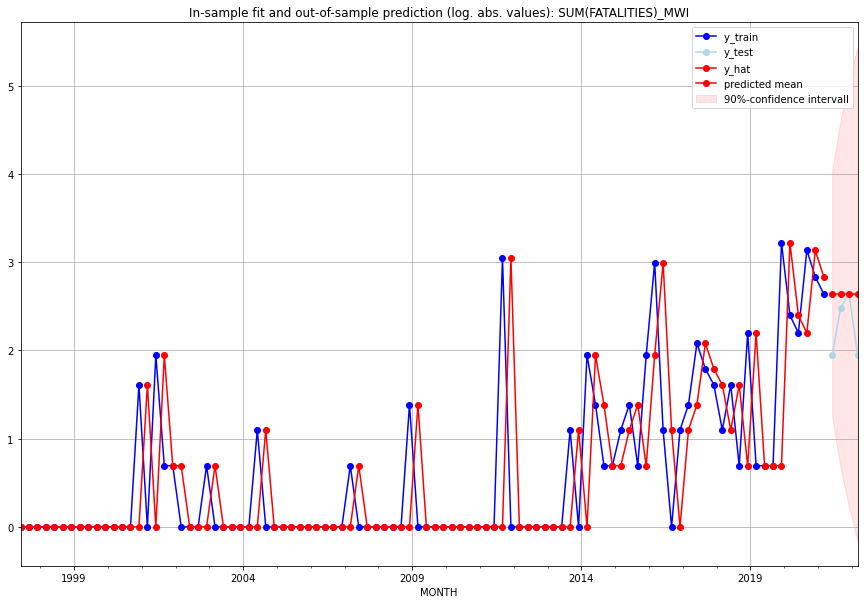

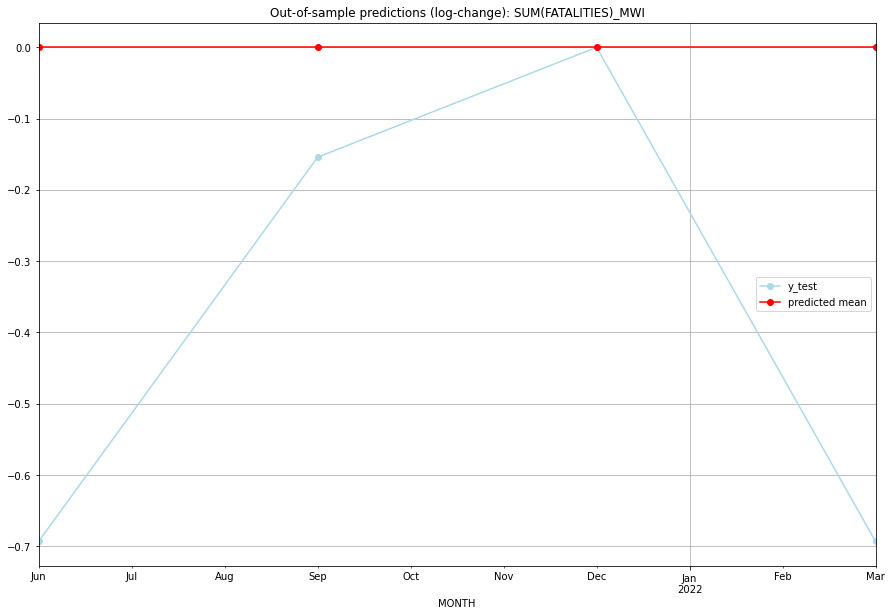

TADDA: 0.3851112602367873
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      13.0         6.0           0.0       -0.693147   MWI   
1 2021-07-01      13.0        11.0           0.0       -0.154151   MWI   
2 2021-10-01      13.0        13.0           0.0        0.000000   MWI   
3 2022-01-01      13.0         6.0           0.0       -0.693147   MWI   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## MYS (149/234) #########
0
Neighbor countries: ['THA', 'IDN', 'BRN']
Getting Data for MYS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEAR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3835445282603393, 'fold_results': [0.5878438142908693, 0.1792452422298093]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MYS   No. Observations:                   13
Model:                SARIMAX(3, 1, 2)   Log Likelihood                  -6.219
Date:                 Wed, 19 Oct 2022   AIC                             30.439
Time:                         10:48:05   BIC                             34.803
Sample:                     01-31-2018   HQIC                            28.823
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.1229      0.

<Figure size 432x288 with 0 Axes>

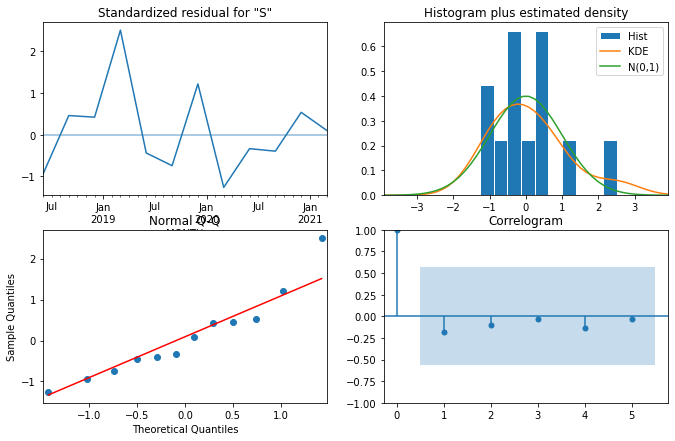

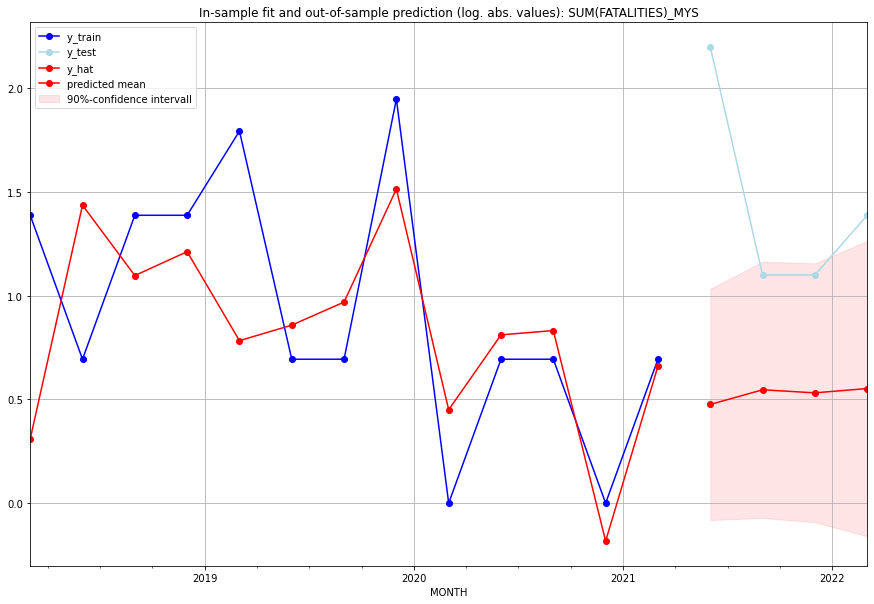

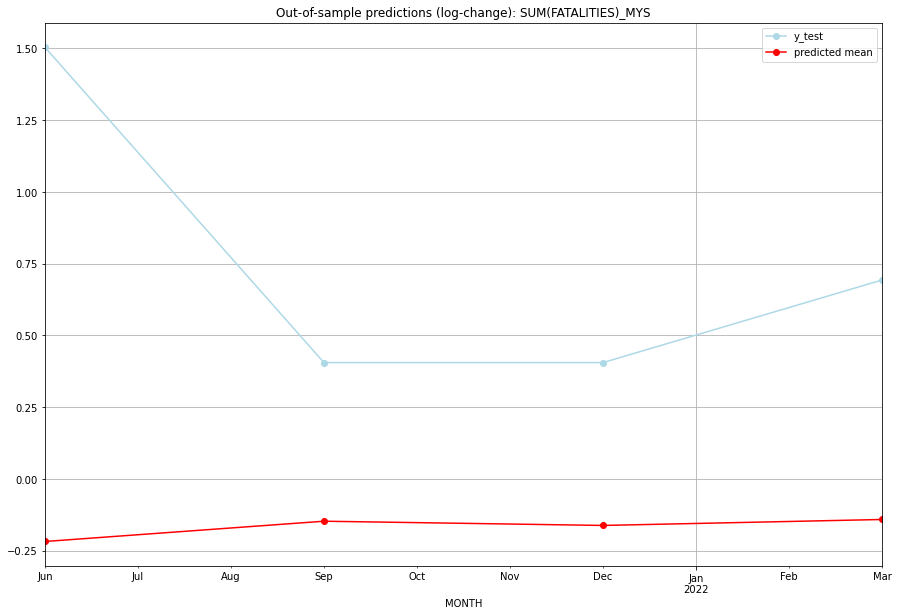

TADDA: 1.0861714229613446
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.608456         8.0     -0.217872        1.504077   MYS   
1 2021-07-01  0.726194         2.0     -0.147228        0.405465   MYS   
2 2021-10-01  0.700940         2.0     -0.161966        0.405465   MYS   
3 2022-01-01  0.736633         3.0     -0.141199        0.693147   MYS   

                                          PARAMETERS  
0  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## MYT (150/234) #########
0
Neighbor countries: []
Getting Data for MYT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV nec

<Figure size 432x288 with 0 Axes>

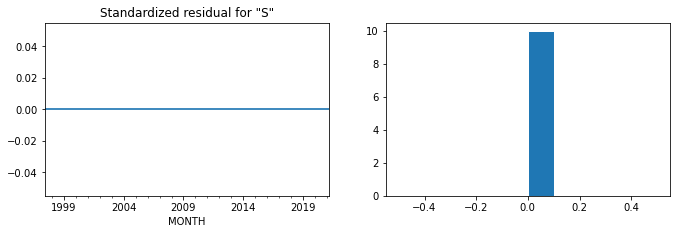

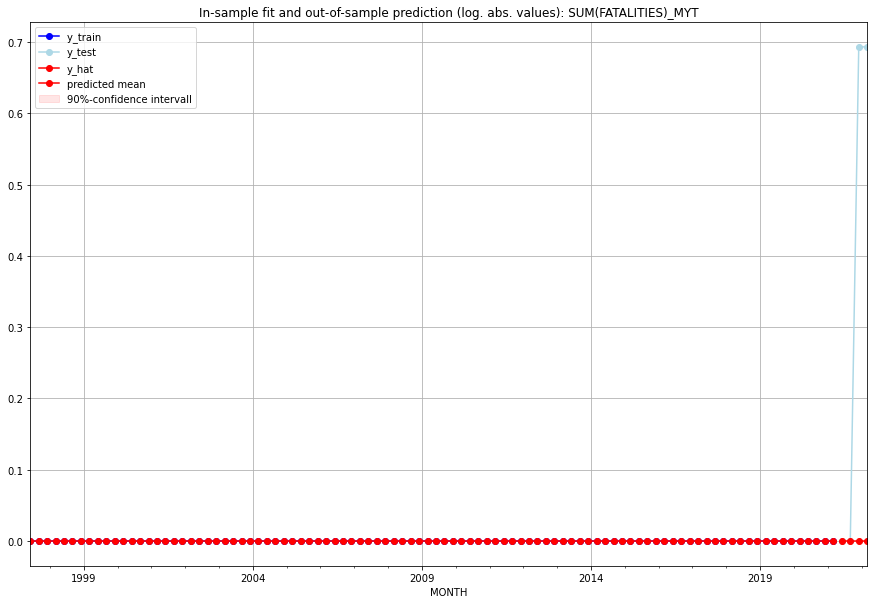

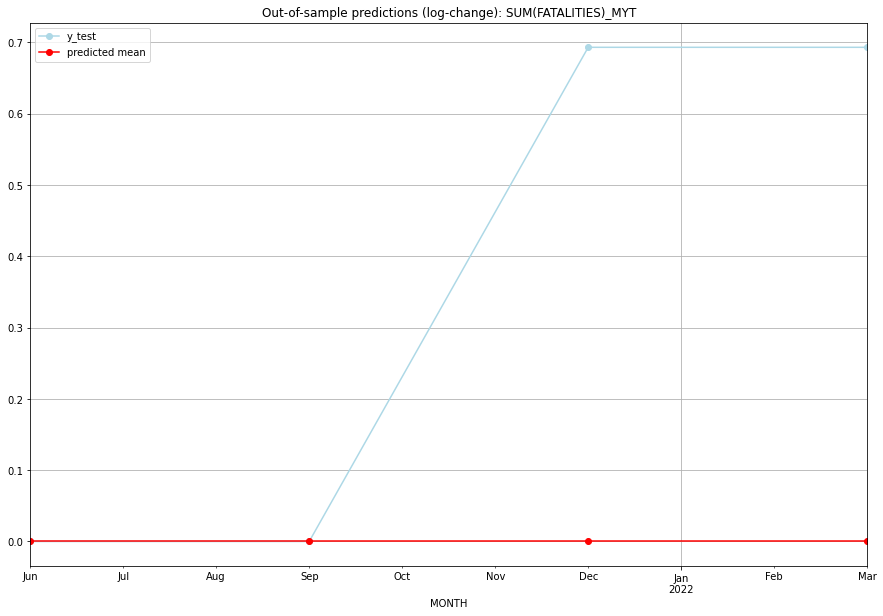

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   MYT   
1 2021-07-01       0.0         0.0           0.0        0.000000   MYT   
2 2021-10-01       0.0         1.0           0.0        0.693147   MYT   
3 2022-01-01       0.0         1.0           0.0        0.693147   MYT   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## NAM (151/234) #########
0
Neighbor countries: ['BWA', 'AGO', 'ZMB', 'ZAF']
Getting Data for NAM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 32)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.22821740957339182, 'fold_results': [0.0, 0.34657359027997264, 0.17328679513998632, 0.6212266624470001, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NAM   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -137.924
Date:                 Wed, 19 Oct 2022   AIC                            277.848
Time:                         10:48:27   BIC                            280.413
Sample:                     04-30-1997   HQIC                           278.885
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

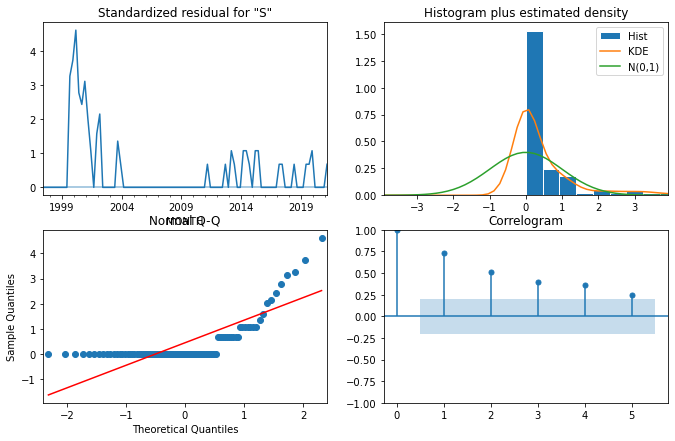

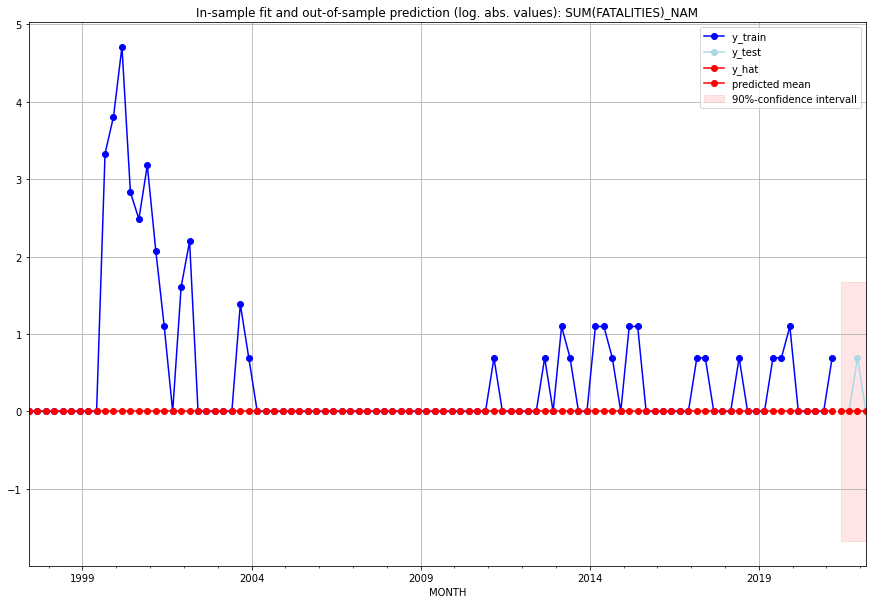

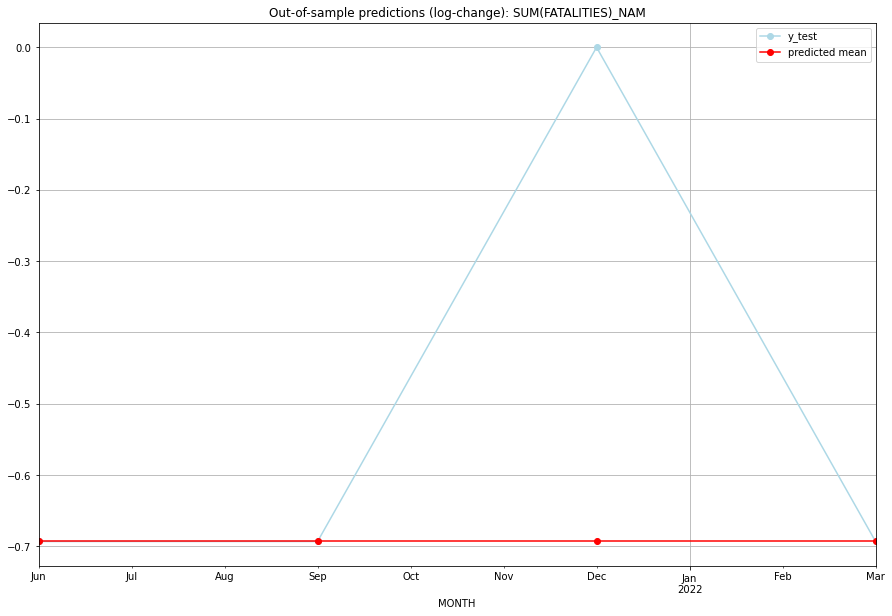

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -0.693147       -0.693147   NAM   
1 2021-07-01       0.0         0.0     -0.693147       -0.693147   NAM   
2 2021-10-01       0.0         1.0     -0.693147        0.000000   NAM   
3 2022-01-01       0.0         0.0     -0.693147       -0.693147   NAM   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## NCL (152/234) #########
0
Neighbor countries: []
Getting Data for NCL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

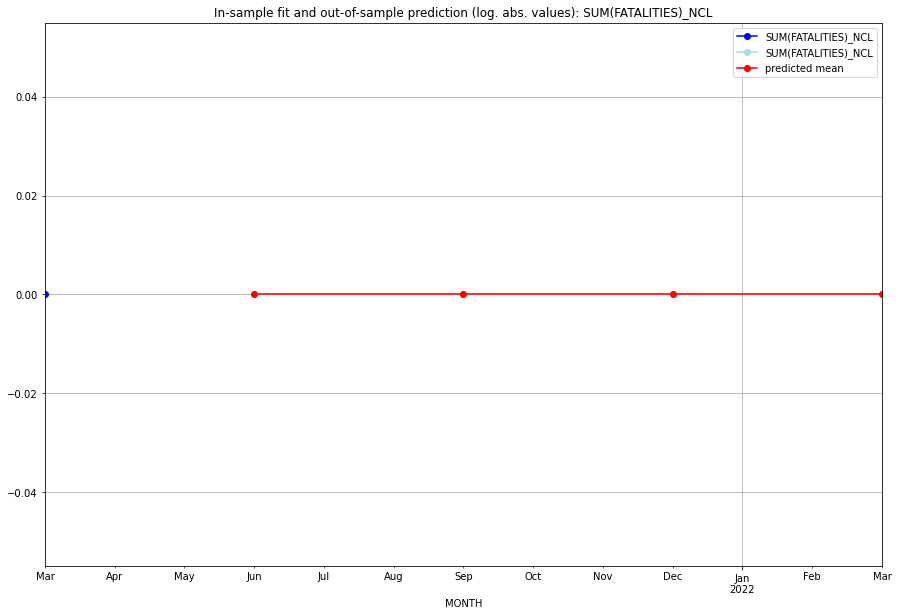

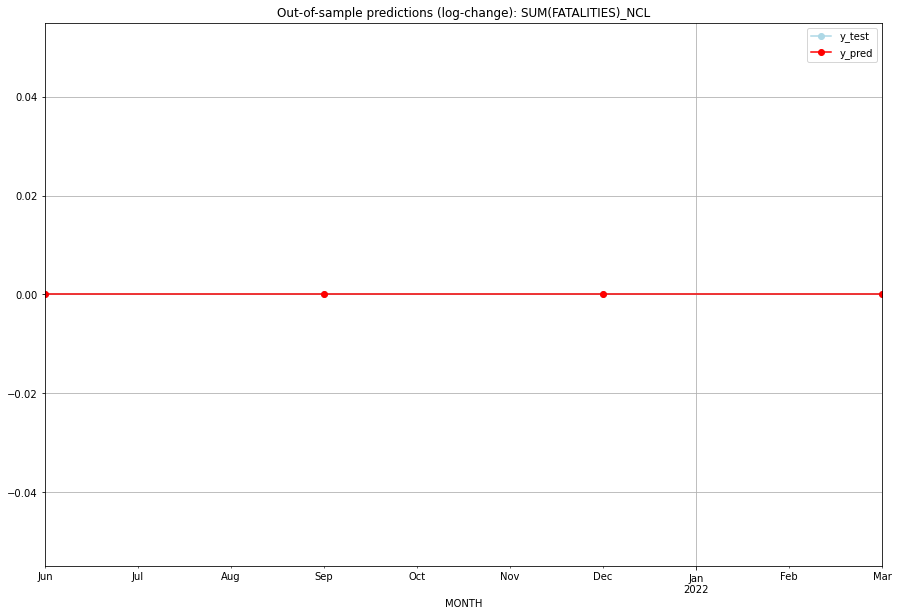

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   NCL   
1 2021-07-01       0.0         0.0           0.0             0.0   NCL   
2 2021-10-01       0.0         0.0           0.0             0.0   NCL   
3 2022-01-01       0.0         0.0           0.0             0.0   NCL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## NER (153/234) #########
0
Neighbor countries: ['DZA', 'LBY', 'MLI', 'TCD', 'NGA', 'BEN', 'BFA']
Getting Data for NER
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 56)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6485871230946987, 'fold_results': [0.6533900158078402, 0.46461893888571404, 0.9961567946965696, 0.4552947571777006, 0.6734751089056688]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NER   No. Observations:                   96
Model:                SARIMAX(3, 1, 0)   Log Likelihood                -166.480
Date:                 Wed, 19 Oct 2022   AIC                            344.959
Time:                         10:48:51   BIC                            360.283
Sample:                     04-30-1997   HQIC                           351.151
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

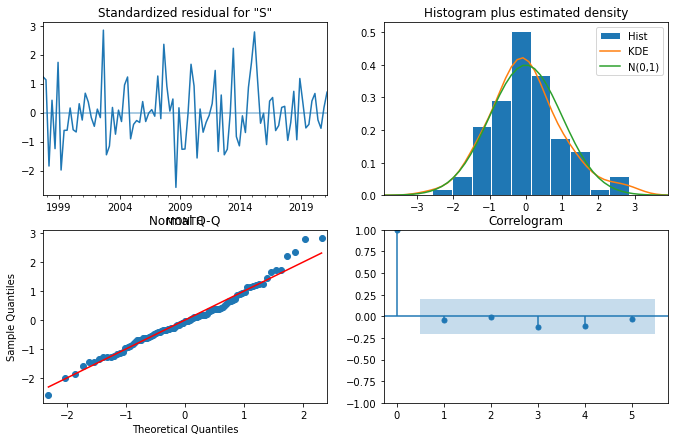

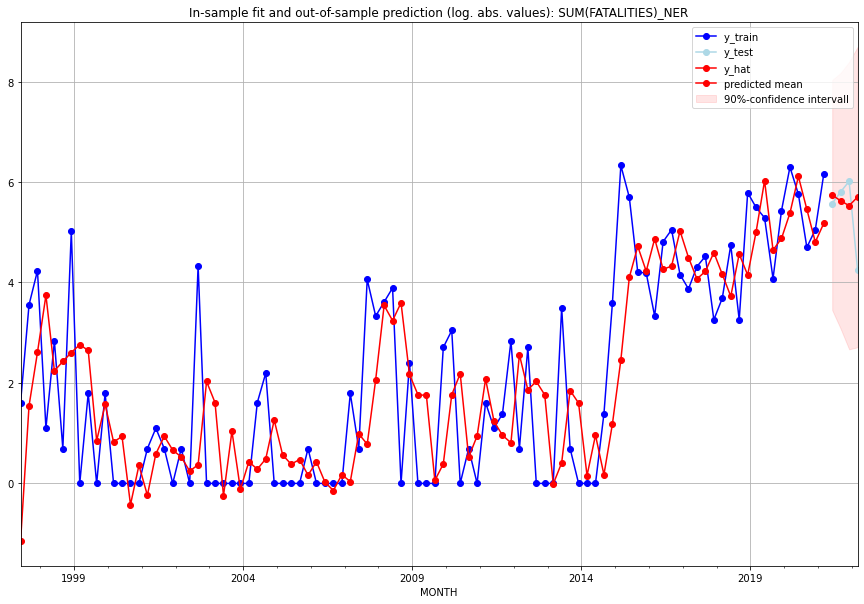

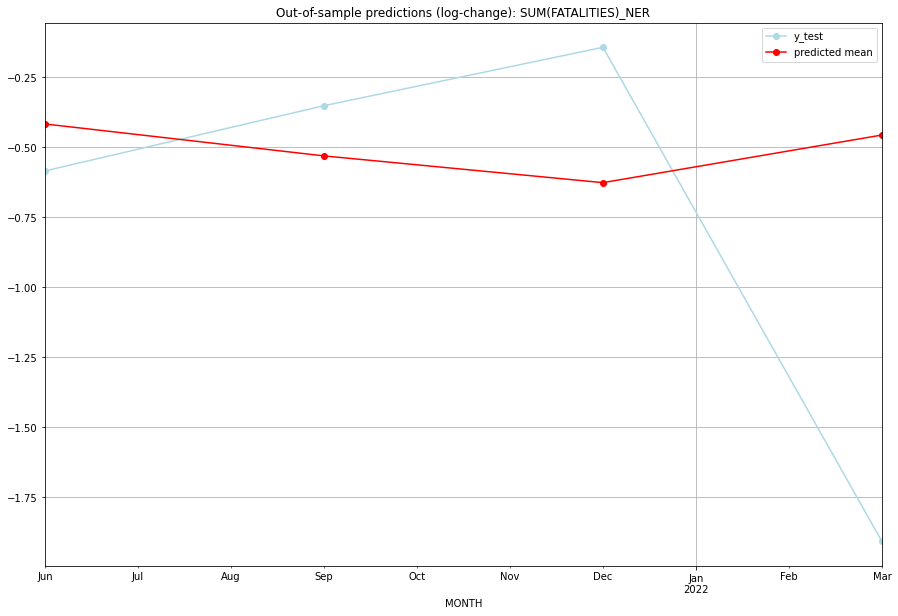

TADDA: 0.5705850092362983
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  310.032503       262.0     -0.417082       -0.584825   NER   
1 2021-07-01  276.507205       331.0     -0.531132       -0.351844   NER   
2 2021-10-01  251.218101       408.0     -0.626685       -0.143264   NER   
3 2022-01-01  297.981846        69.0     -0.456596       -1.908484   NER   

                                          PARAMETERS  
0  {'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## NGA (154/234) #########
0
Neighbor countries: ['NER', 'BEN', 'CMR', 'TCD']
Getting Data for NGA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 32)
y: (100, 1)
------------------------------------------------
Training star

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3922615117355307, 'fold_results': [0.45968339053885554, 0.35804813126652935, 0.26546701876327417, 0.36327246014024706, 0.5148365579687473]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NGA   No. Observations:                   96
Model:                SARIMAX(1, 0, 2)   Log Likelihood                -134.226
Date:                 Wed, 19 Oct 2022   AIC                            282.451
Time:                         10:49:06   BIC                            300.402
Sample:                     04-30-1997   HQIC                           289.707
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------

<Figure size 432x288 with 0 Axes>

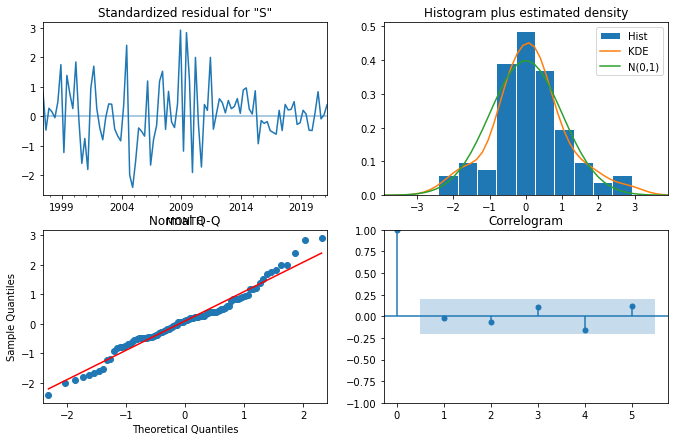

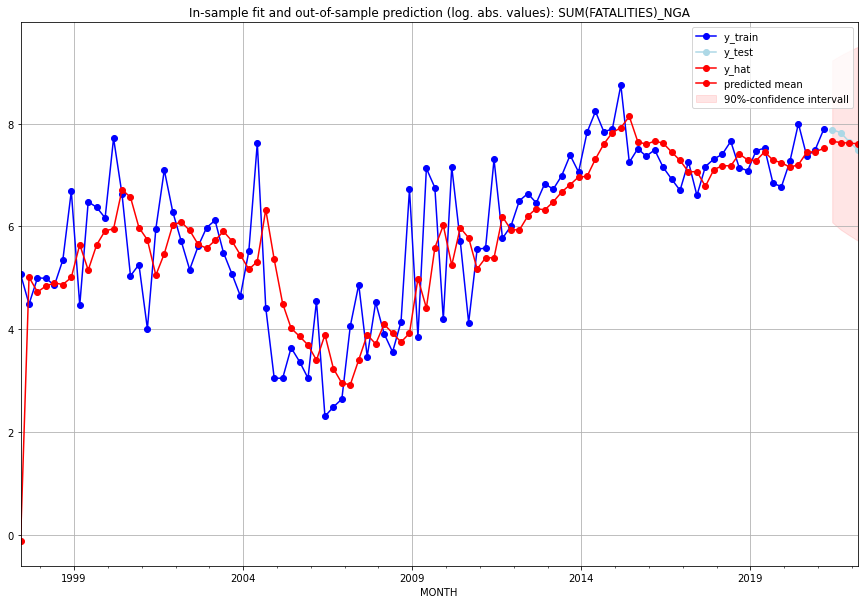

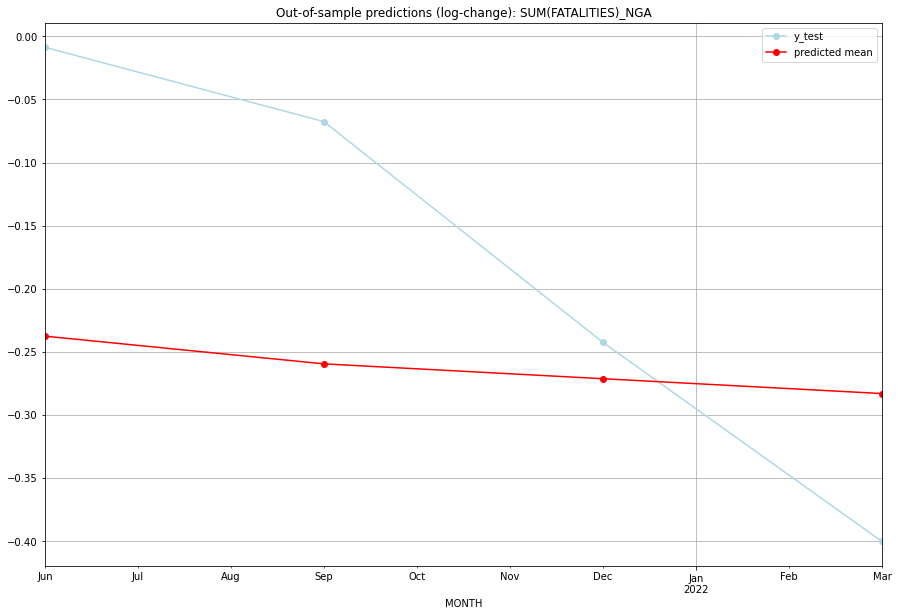

TADDA: 0.14179525144177507
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2111.363857      2655.0     -0.237636       -0.008622   NGA   
1 2021-07-01  2065.475473      2503.0     -0.259599       -0.067554   NGA   
2 2021-10-01  2041.272122      2101.0     -0.271381       -0.242554   NGA   
3 2022-01-01  2017.392014      1794.0     -0.283142       -0.400439   NGA   

                                          PARAMETERS  
0  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## NIC (155/234) #########
0
Neighbor countries: ['HND', 'CRI']
Getting Data for NIC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 16)
y: (17, 1)
------------------------------------------------
Training started.
Start

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5300325275650474, 'fold_results': [0.3182877846267337, 0.7417772705033611]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NIC   No. Observations:                   13
Model:                SARIMAX(0, 1, 2)   Log Likelihood                 -22.476
Date:                 Wed, 19 Oct 2022   AIC                             50.953
Time:                         10:49:12   BIC                             52.407
Sample:                     01-31-2018   HQIC                            50.414
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.1957    114.

<Figure size 432x288 with 0 Axes>

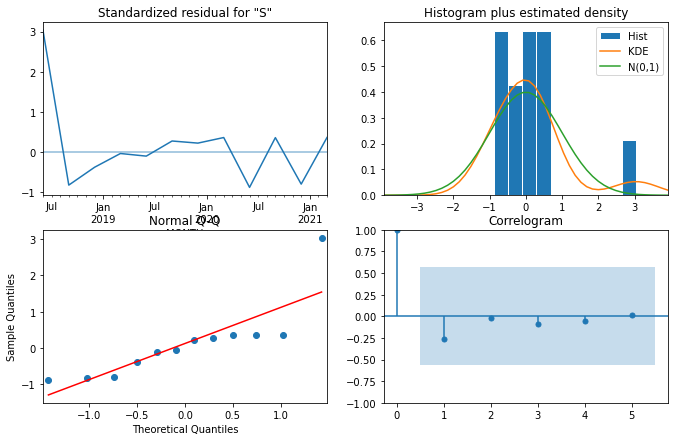

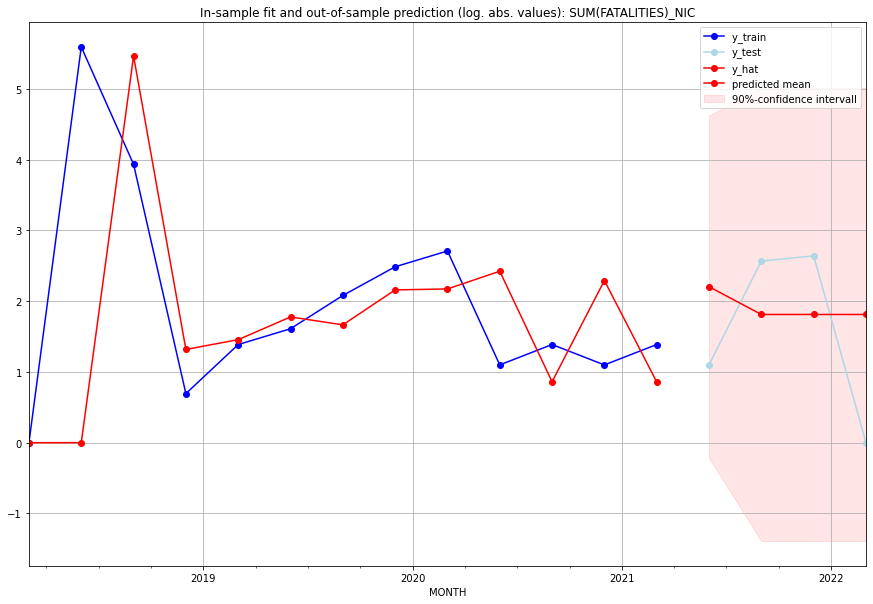

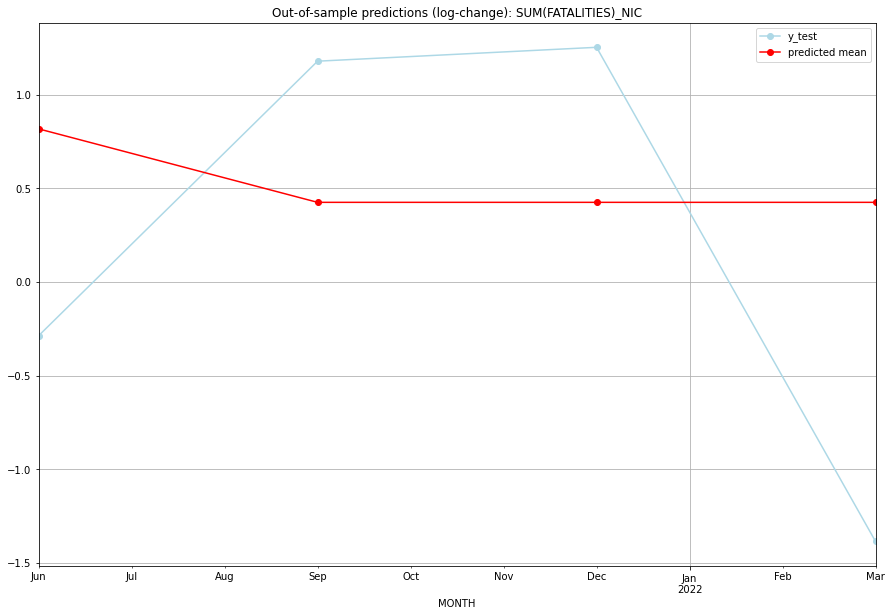

TADDA: 1.4349847445243604
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   8.05726         2.0      0.817272       -0.287682   NIC   
1 2021-07-01   5.11763        12.0      0.424880        1.178655   NIC   
2 2021-10-01   5.11763        13.0      0.424880        1.252763   NIC   
3 2022-01-01   5.11763         0.0      0.424880       -1.386294   NIC   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## NLD (156/234) #########
0
Neighbor countries: ['DEU', 'BEL']
Getting Data for NLD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 16)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. In

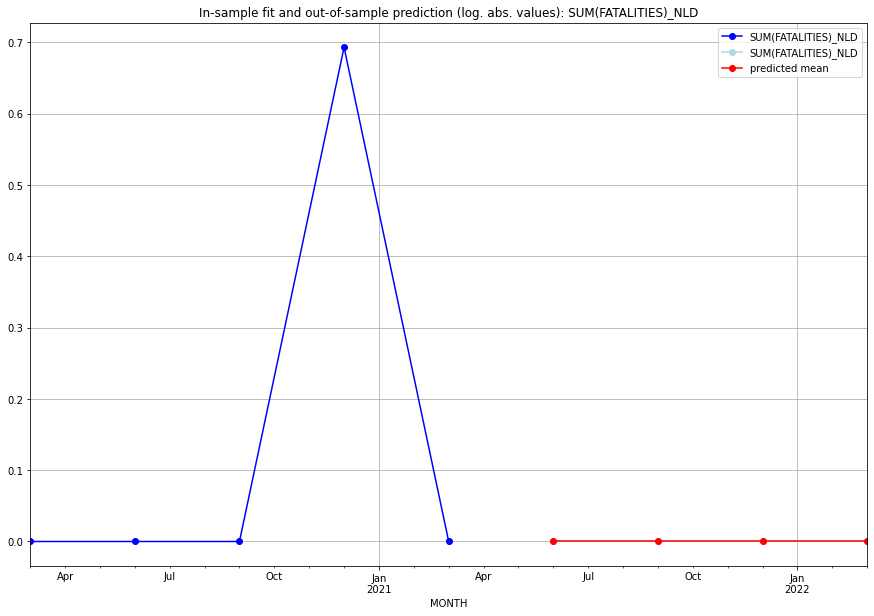

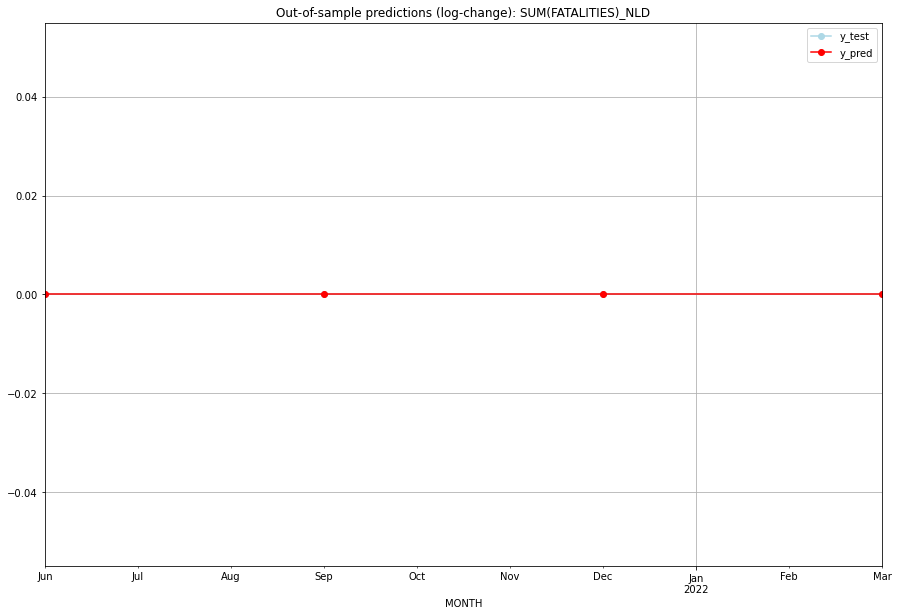

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   NLD   
1 2021-07-01       0.0         0.0           0.0             0.0   NLD   
2 2021-10-01       0.0         0.0           0.0             0.0   NLD   
3 2022-01-01       0.0         0.0           0.0             0.0   NLD   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## NOR (157/234) #########
0
Neighbor countries: ['SWE', 'FIN', 'RUS']
Getting Data for NOR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 24)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


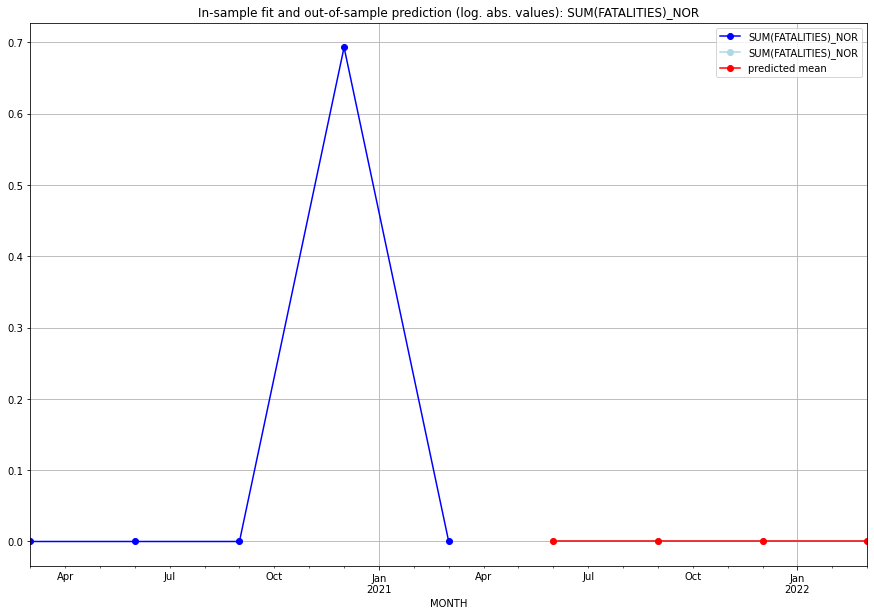

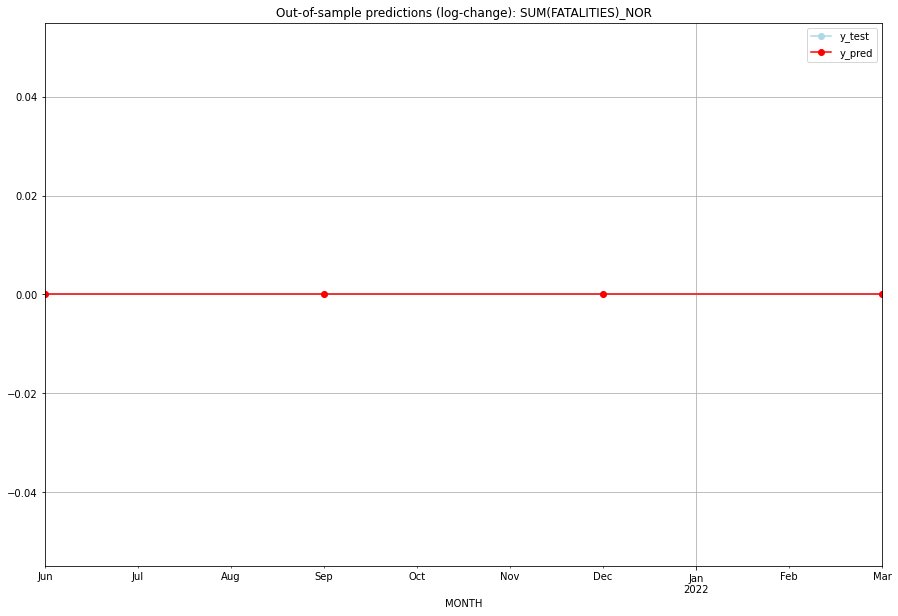

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   NOR   
1 2021-07-01       0.0         0.0           0.0             0.0   NOR   
2 2021-10-01       0.0         0.0           0.0             0.0   NOR   
3 2022-01-01       0.0         0.0           0.0             0.0   NOR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## NPL (158/234) #########
0
Neighbor countries: ['CHN', 'IND']
Getting Data for NPL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 16)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.8007160617019735, 'fold_results': [1.1774051971997335, 0.6483874283017864, 1.0216413603914114, 0.42916432548472155, 0.7269819971322145]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NPL   No. Observations:                   45
Model:                SARIMAX(3, 0, 3)   Log Likelihood                 -54.932
Date:                 Wed, 19 Oct 2022   AIC                            129.863
Time:                         10:49:39   BIC                            147.930
Sample:                     01-31-2010   HQIC                           136.598
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

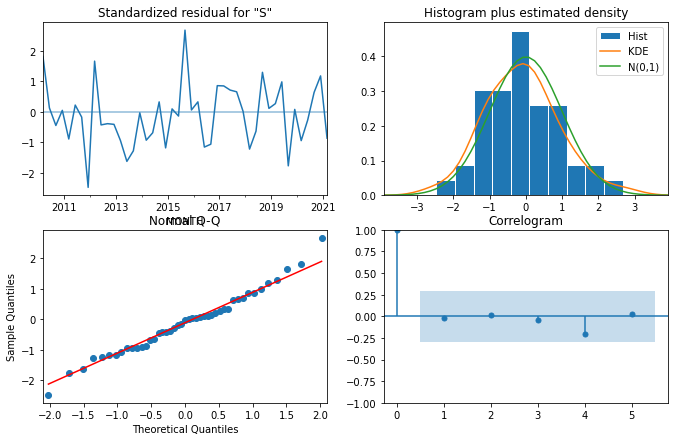

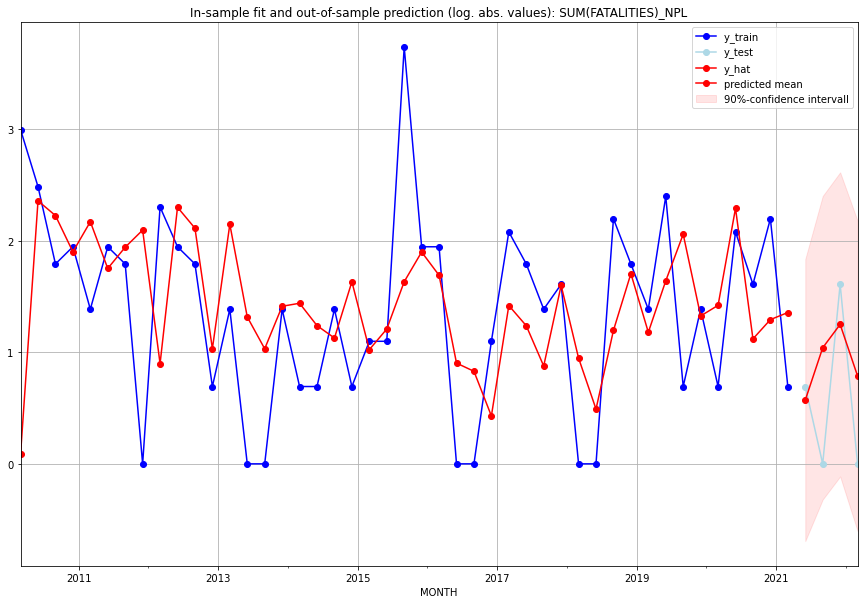

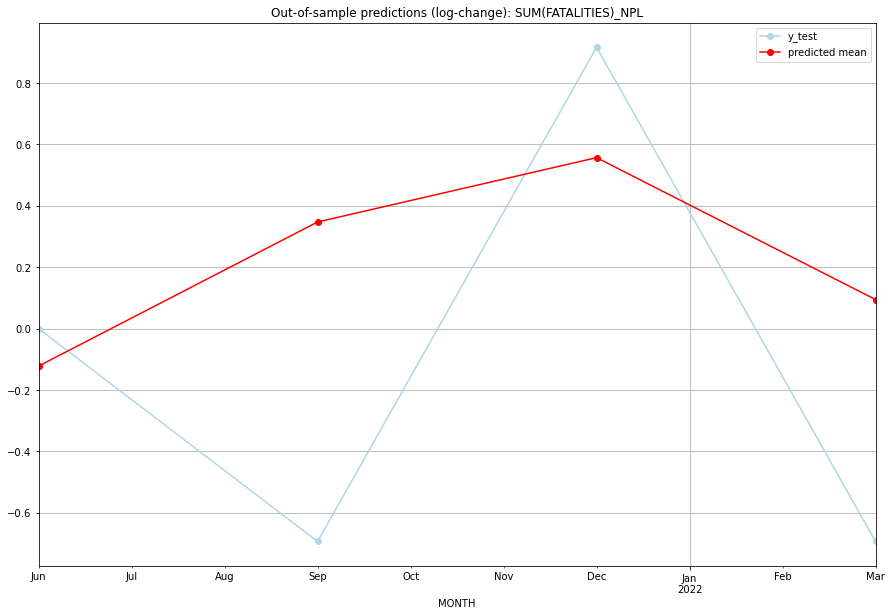

TADDA: 0.6879167703679243
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.770477         1.0     -0.121898        0.000000   NPL   
1 2021-07-01  1.830808         0.0      0.347415       -0.693147   NPL   
2 2021-10-01  2.490714         4.0      0.556959        0.916291   NPL   
3 2022-01-01  1.198562         0.0      0.094656       -0.693147   NPL   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## NZL (159/234) #########
0
Neighbor countries: []
Getting Data for NZL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

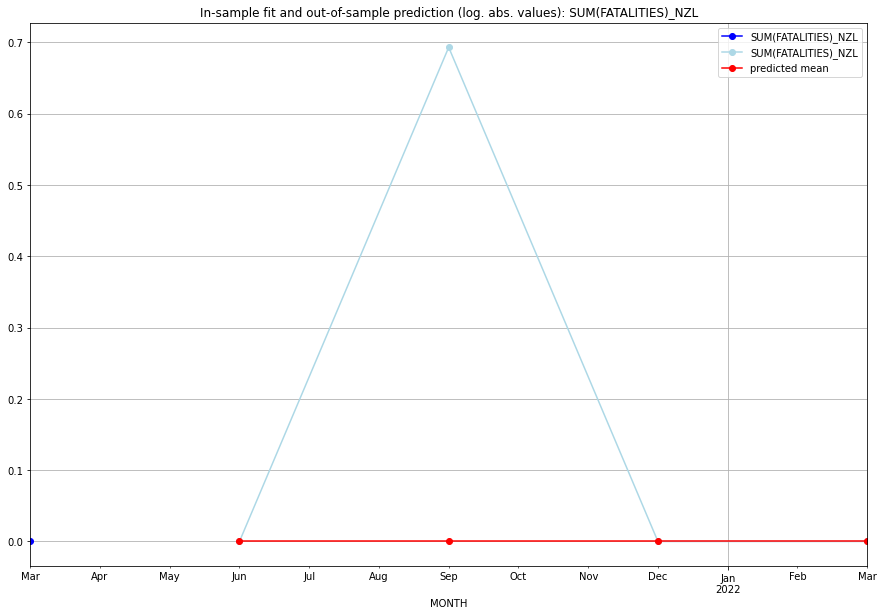

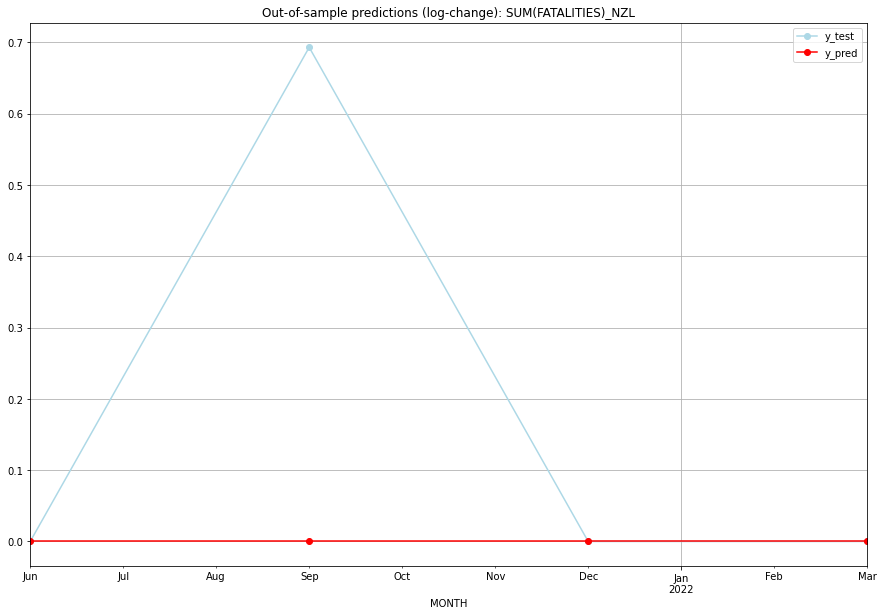

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   NZL   
1 2021-07-01       0.0    0.693147           0.0        0.693147   NZL   
2 2021-10-01       0.0    0.000000           0.0        0.000000   NZL   
3 2022-01-01       0.0    0.000000           0.0        0.000000   NZL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## OMN (160/234) #########
0
Neighbor countries: ['ARE', 'SAU', 'YEM']
Getting Data for OMN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 24)
y: (25, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_OMN   No. Obser

<Figure size 432x288 with 0 Axes>

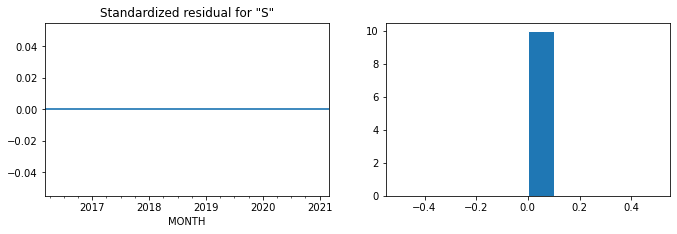

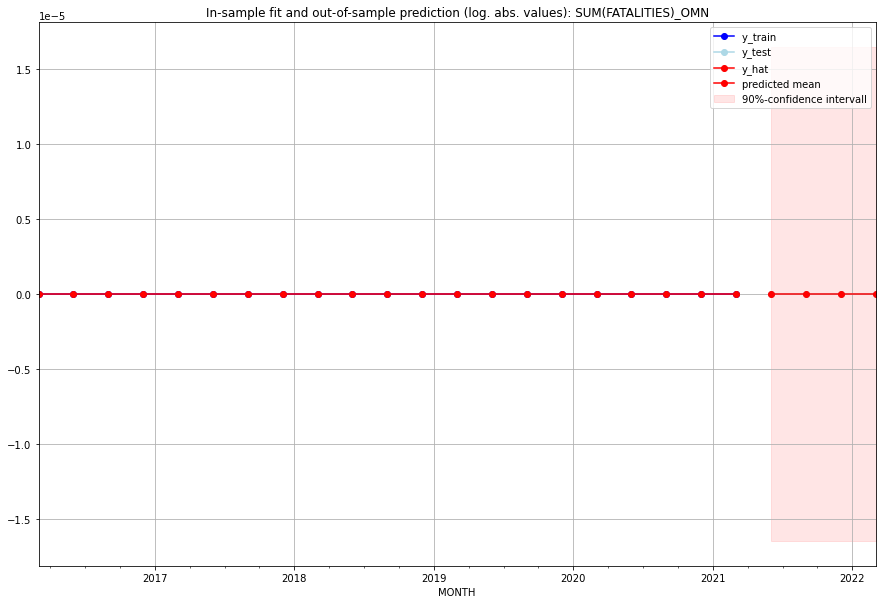

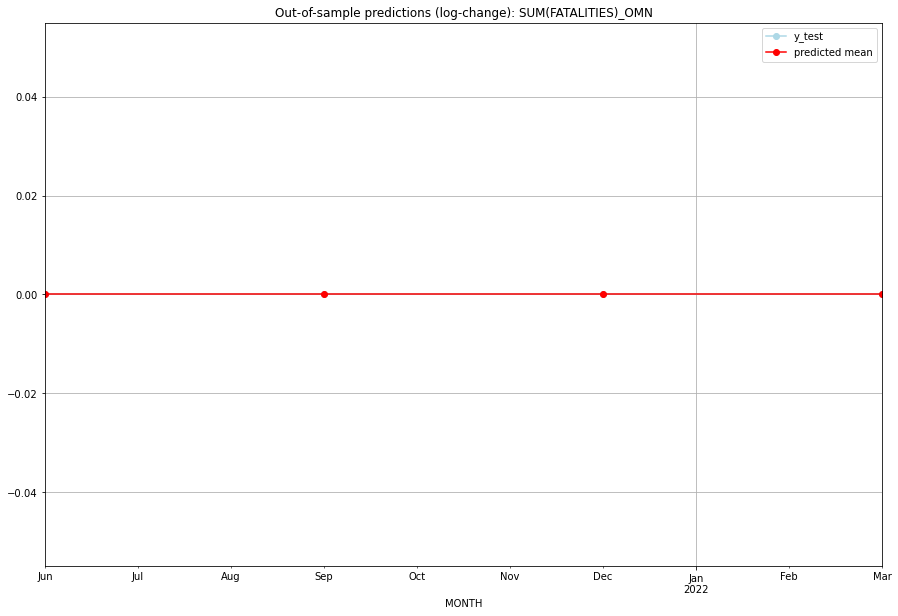

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   OMN   
1 2021-07-01       0.0         0.0           0.0             0.0   OMN   
2 2021-10-01       0.0         0.0           0.0             0.0   OMN   
3 2022-01-01       0.0         0.0           0.0             0.0   OMN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## PAK (161/234) #########
0
Neighbor countries: ['IND', 'AFG', 'IRN', 'CHN']
Getting Data for PAK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 32)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2470003228863597, 'fold_results': [0.2861823212959278, 0.3247519716804186, 0.3050789372906415, 0.18287714972693236, 0.13611123443787831]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PAK   No. Observations:                   45
Model:                SARIMAX(1, 0, 0)   Log Likelihood                 -24.436
Date:                 Wed, 19 Oct 2022   AIC                             54.872
Time:                         10:50:02   BIC                             60.292
Sample:                     01-31-2010   HQIC                            56.893
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

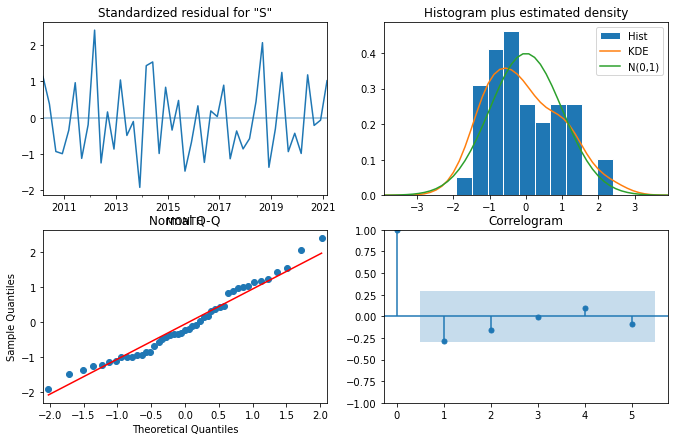

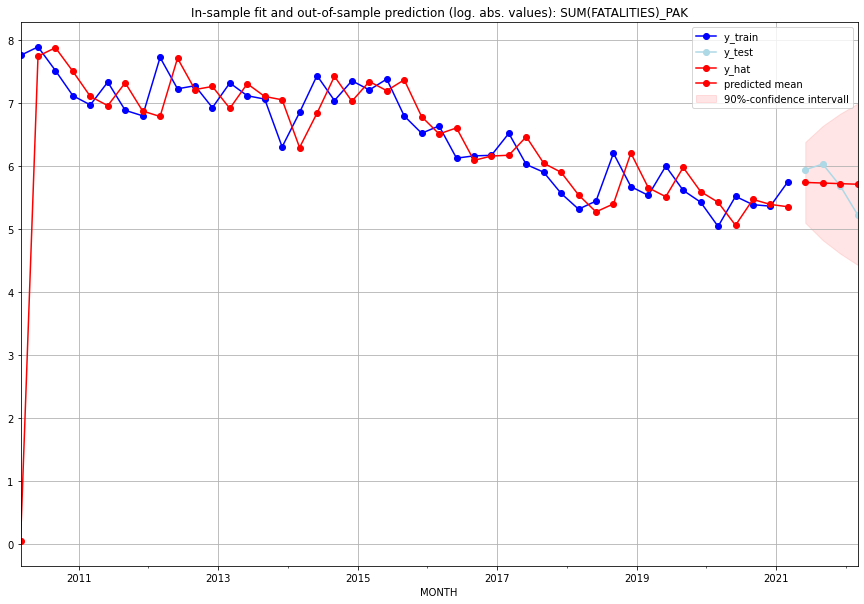

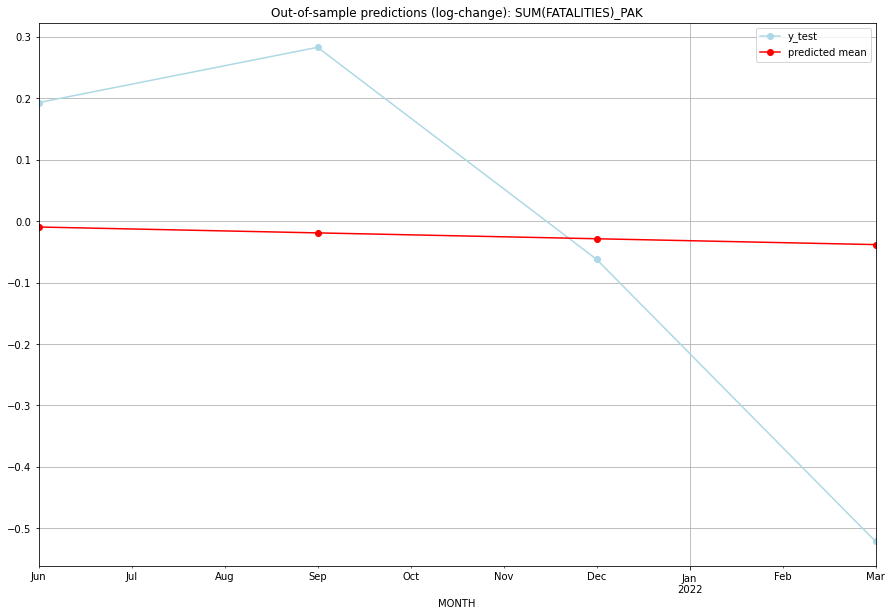

TADDA: 0.2624903973671946
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  310.996050       381.0     -0.009582        0.192848   PAK   
1 2021-07-01  308.025597       417.0     -0.019149        0.282909   PAK   
2 2021-10-01  305.088221       295.0     -0.028699       -0.062213   PAK   
3 2022-01-01  302.183508       186.0     -0.038234       -0.521464   PAK   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## PAN (162/234) #########
0
Neighbor countries: ['CRI', 'COL']
Getting Data for PAN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 16)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDS

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.34236761693907813, 'fold_results': [0.354745740281194, 0.3299894935969622]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PAN   No. Observations:                   13
Model:                SARIMAX(3, 0, 0)   Log Likelihood                  -1.882
Date:                 Wed, 19 Oct 2022   AIC                             17.765
Time:                         10:50:16   BIC                             21.719
Sample:                     01-31-2018   HQIC                            16.952
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0208      0.

<Figure size 432x288 with 0 Axes>

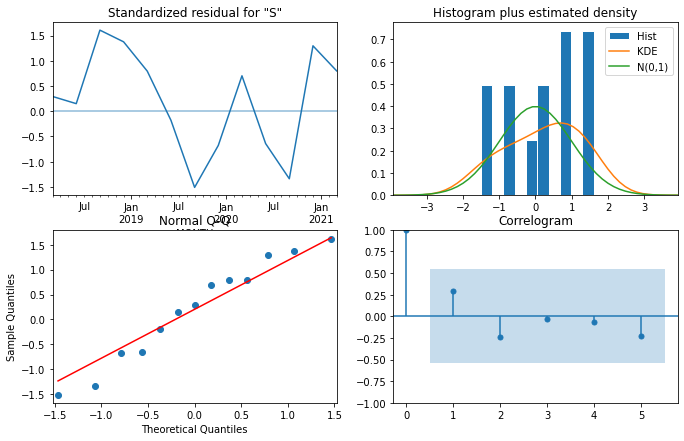

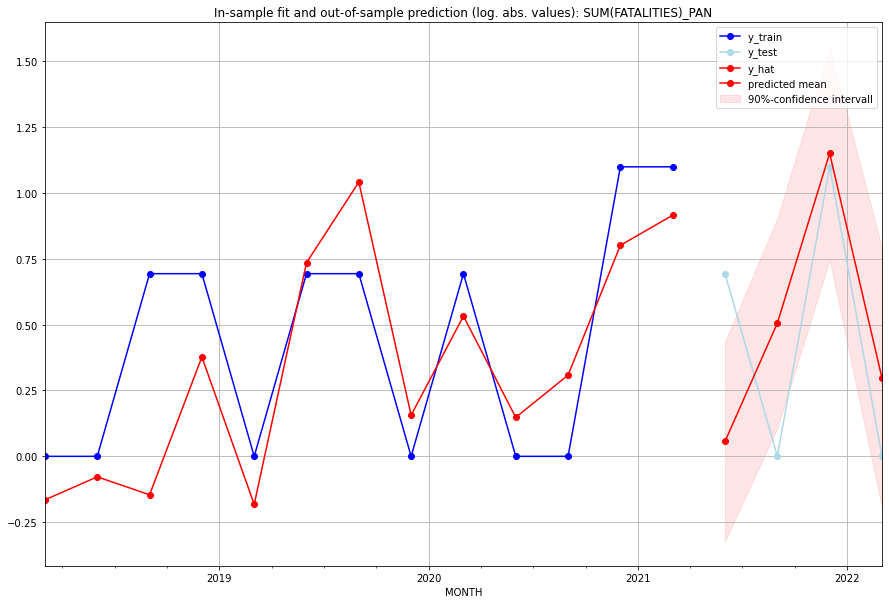

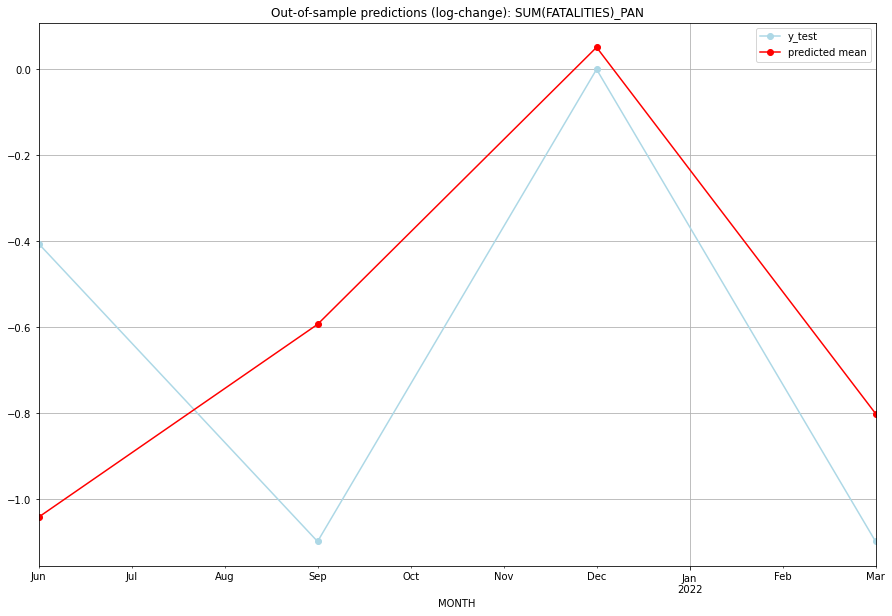

TADDA: 0.3726568145471095
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.058211         1.0     -1.042032       -0.405465   PAN   
1 2021-07-01  0.657422         0.0     -0.593349       -1.098612   PAN   
2 2021-10-01  2.157661         2.0      0.051219        0.000000   PAN   
3 2022-01-01  0.346592         0.0     -0.801035       -1.098612   PAN   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## PER (163/234) #########
0
Neighbor countries: ['BRA', 'COL', 'ECU', 'BOL', 'CHL']
Getting Data for PER
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training started.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.3682918963472645, 'fold_results': [0.2707727876791859, 0.4658110050153431]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PER   No. Observations:                   13
Model:                SARIMAX(2, 0, 1)   Log Likelihood                 -13.400
Date:                 Wed, 19 Oct 2022   AIC                             38.799
Time:                         10:50:28   BIC                             42.189
Sample:                     01-31-2018   HQIC                            38.102
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1234      0.

<Figure size 432x288 with 0 Axes>

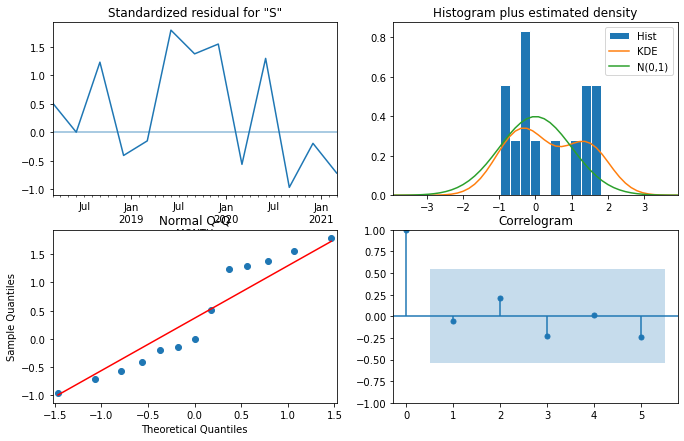

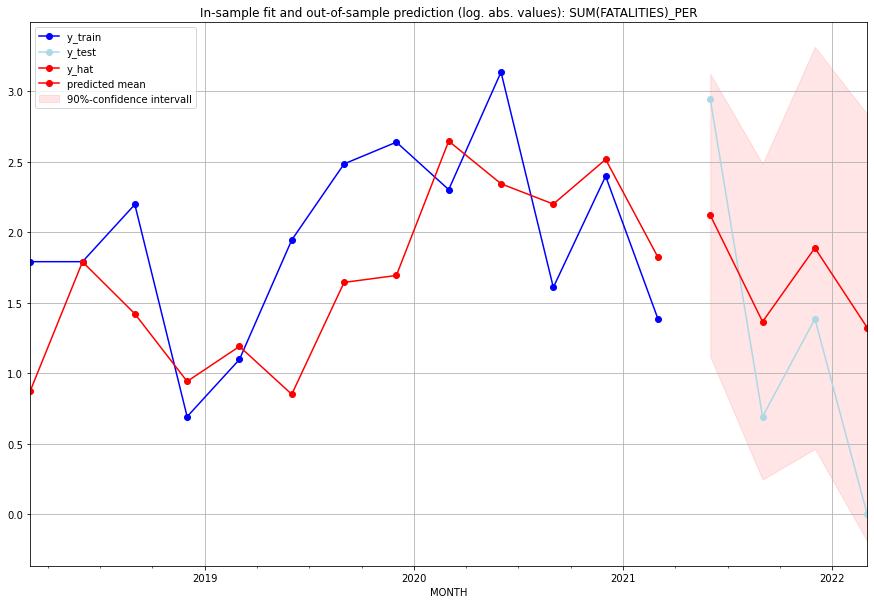

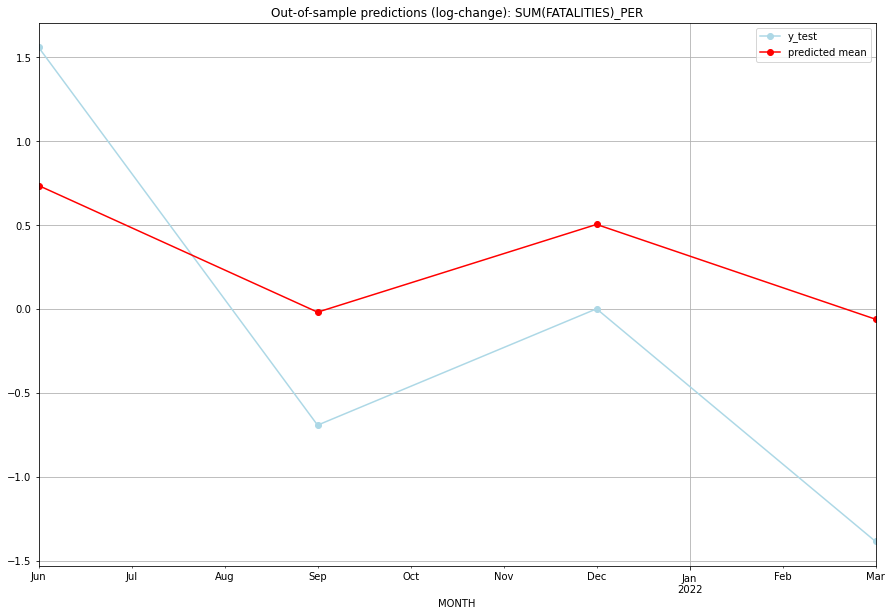

TADDA: 0.830953511123447
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  7.339100        18.0      0.734661        1.558145   PER   
1 2021-07-01  2.921073         1.0     -0.019929       -0.693147   PER   
2 2021-10-01  5.613424         3.0      0.502807        0.000000   PER   
3 2022-01-01  2.759572         0.0     -0.061989       -1.386294   PER   

                                          PARAMETERS  
0  {'params': [2, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## PHL (164/234) #########
0
Neighbor countries: []
Getting Data for PHL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 0)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.19895821170953204, 'fold_results': [0.38443633702911906, 0.15641085552761758, 0.1685553596076632, 0.08643029467372831]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PHL   No. Observations:                   21
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -16.886
Date:                 Wed, 19 Oct 2022   AIC                             35.772
Time:                         10:50:43   BIC                             36.767
Sample:                     01-31-2016   HQIC                            35.966
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

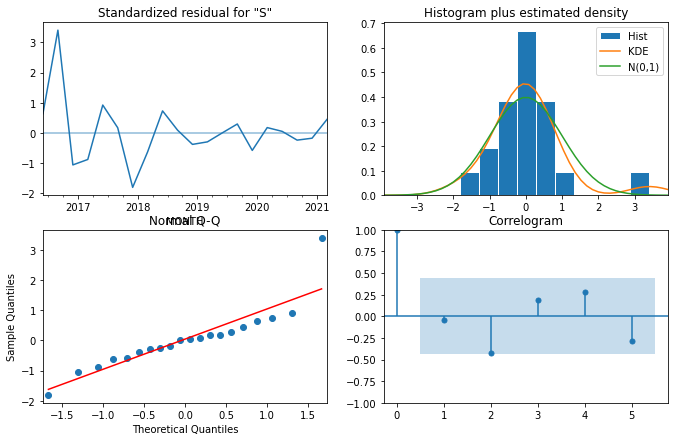

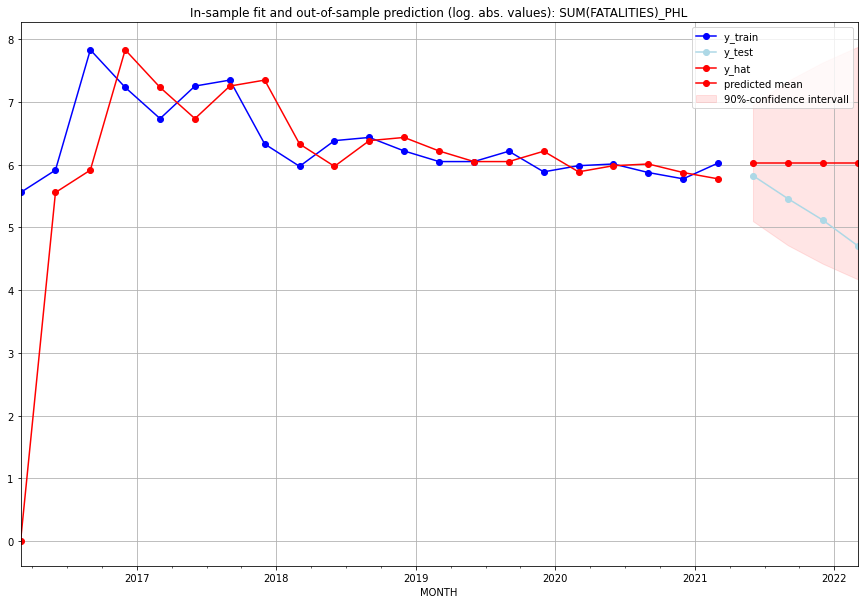

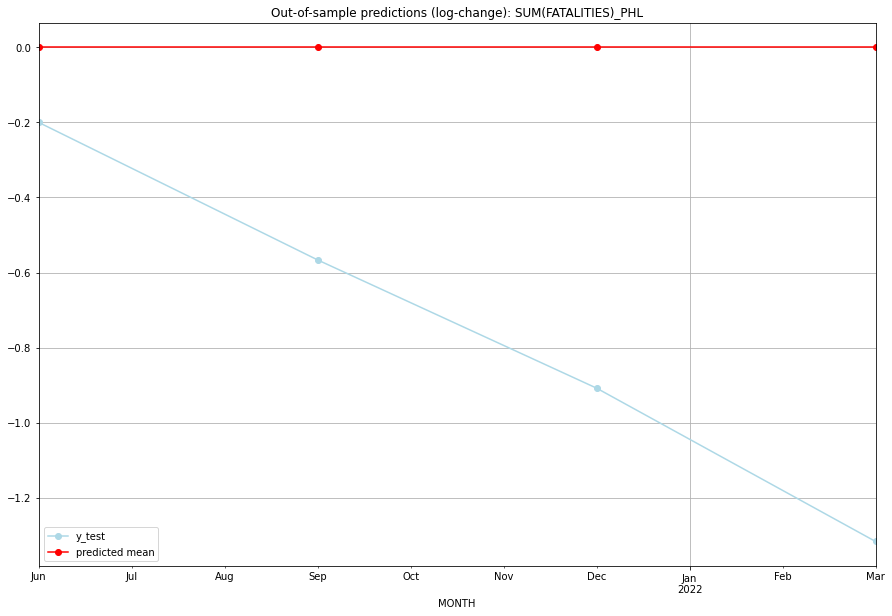

TADDA: 0.7475885650118896
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     413.0       338.0           0.0       -0.199866   PHL   
1 2021-07-01     413.0       234.0           0.0       -0.566280   PHL   
2 2021-10-01     413.0       166.0           0.0       -0.907872   PHL   
3 2022-01-01     413.0       110.0           0.0       -1.316336   PHL   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## PNG (165/234) #########
0
Neighbor countries: ['IDN', 'AUS']
Getting Data for PNG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 16)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. In

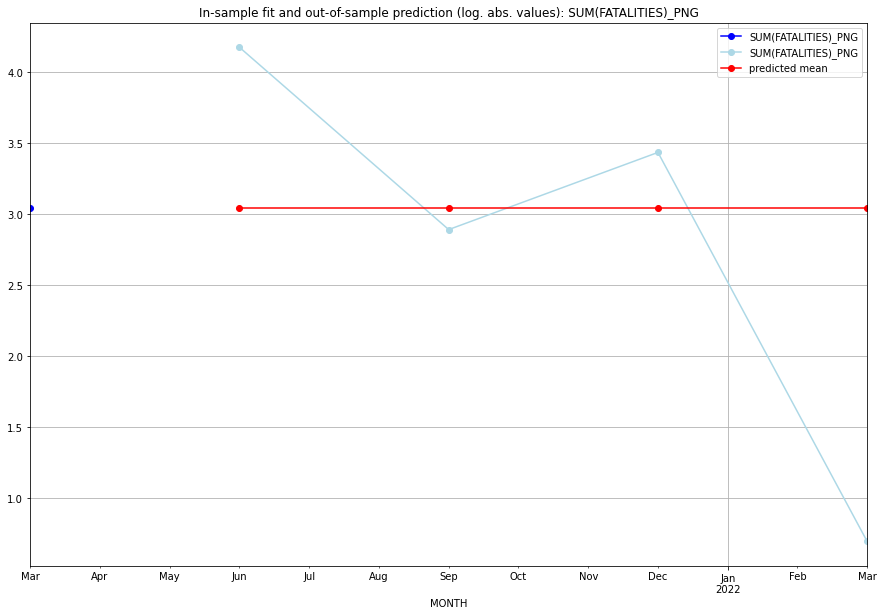

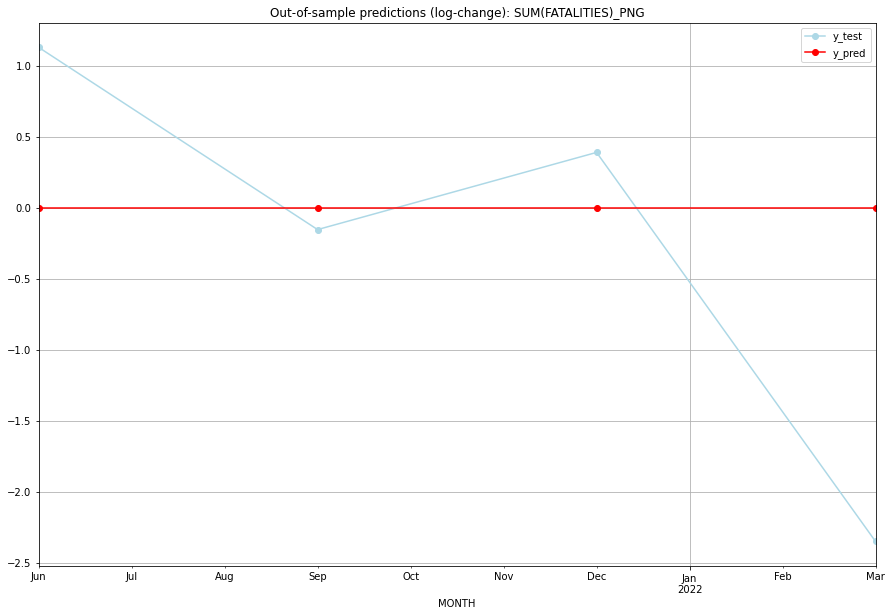

TADDA: 1.0062138839811683
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  3.044522    4.174387           0.0        1.129865   PNG   
1 2021-07-01  3.044522    2.890372           0.0       -0.154151   PNG   
2 2021-10-01  3.044522    3.433987           0.0        0.389465   PNG   
3 2022-01-01  3.044522    0.693147           0.0       -2.351375   PNG   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## POL (166/234) #########
0
Neighbor countries: ['BLR', 'LTU', 'CZE', 'SVK', 'RUS', 'DEU', 'UKR']
Getting Data for POL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 56)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


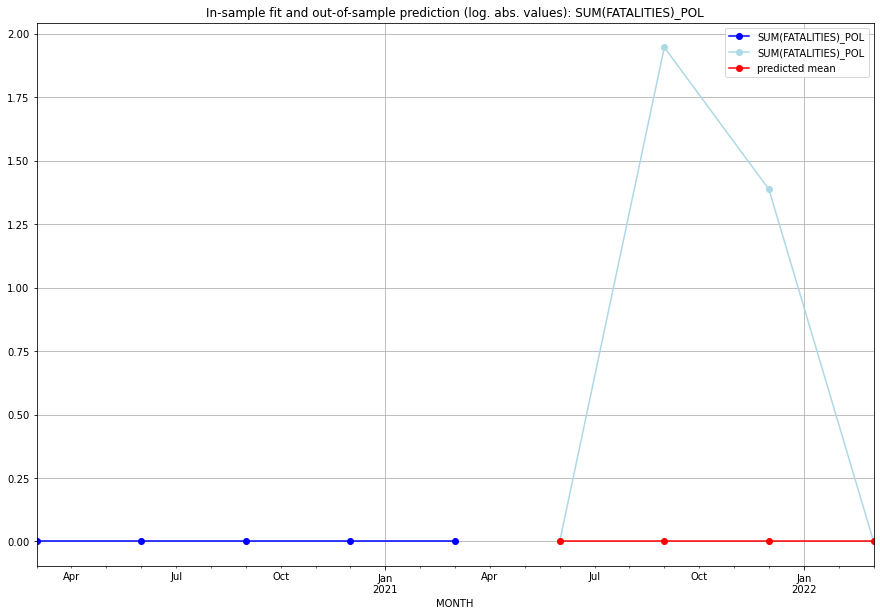

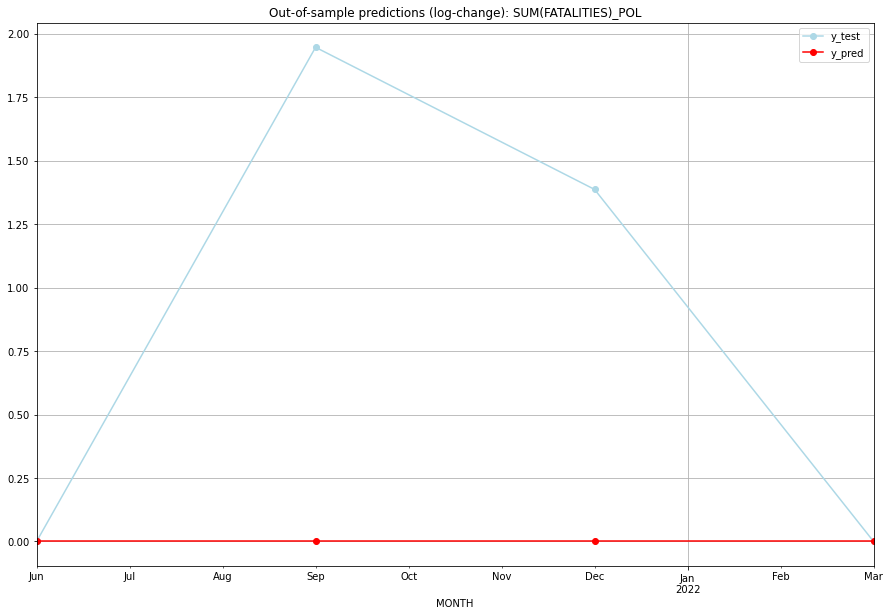

TADDA: 0.8330511275438008
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   POL   
1 2021-07-01       0.0    1.945910           0.0        1.945910   POL   
2 2021-10-01       0.0    1.386294           0.0        1.386294   POL   
3 2022-01-01       0.0    0.000000           0.0        0.000000   POL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## PRI (167/234) #########
0
Neighbor countries: []
Getting Data for PRI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.24362870553587723, 'fold_results': [0.3143955637328293, 0.17286184733892518]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRI   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                  -7.475
Date:                 Wed, 19 Oct 2022   AIC                             16.951
Time:                         10:50:55   BIC                             17.436
Sample:                     01-31-2018   HQIC                            16.771
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.2035      

<Figure size 432x288 with 0 Axes>

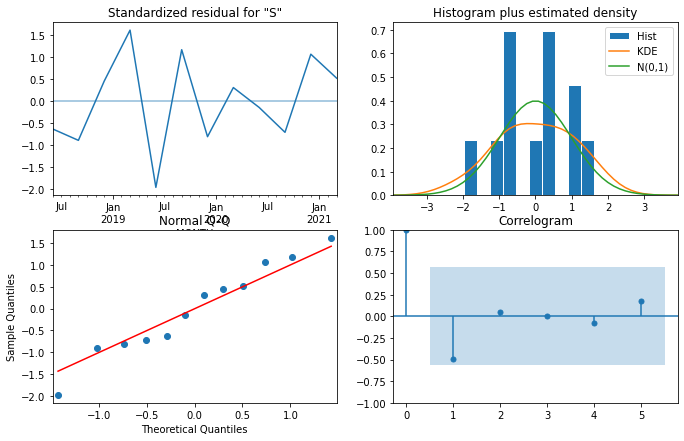

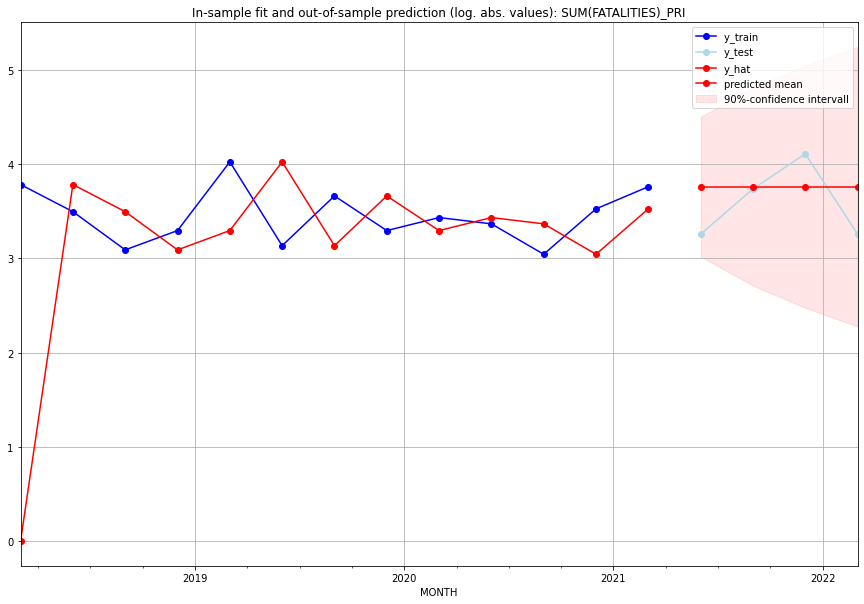

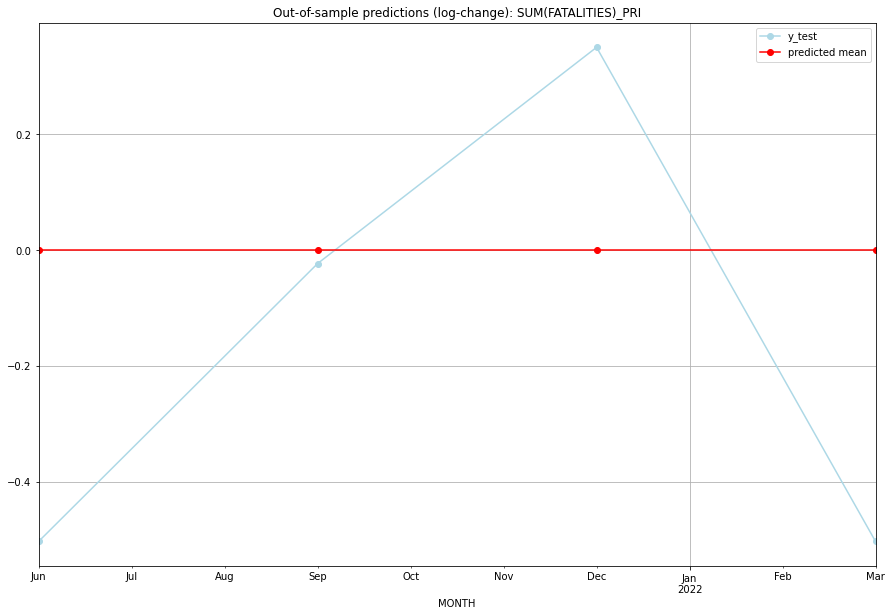

TADDA: 0.3448528503085255
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      42.0        25.0           0.0       -0.503104   PRI   
1 2021-07-01      42.0        41.0           0.0       -0.023530   PRI   
2 2021-10-01      42.0        60.0           0.0        0.349674   PRI   
3 2022-01-01      42.0        25.0           0.0       -0.503104   PRI   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## PRK (168/234) #########
0
Neighbor countries: ['CHN', 'RUS', 'KOR']
Getting Data for PRK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEAR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7033391686831902, 'fold_results': [0.8502993454155389, 0.5563789919508416]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRK   No. Observations:                   13
Model:                SARIMAX(2, 0, 0)   Log Likelihood                 -15.919
Date:                 Wed, 19 Oct 2022   AIC                             43.838
Time:                         10:51:07   BIC                             47.227
Sample:                     01-31-2018   HQIC                            43.141
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.2395      0.

<Figure size 432x288 with 0 Axes>

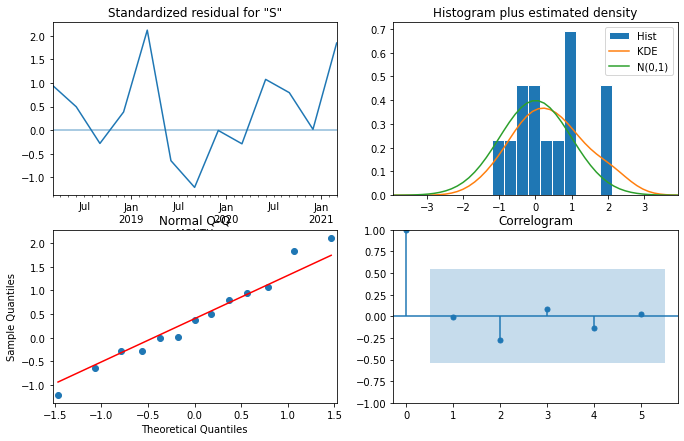

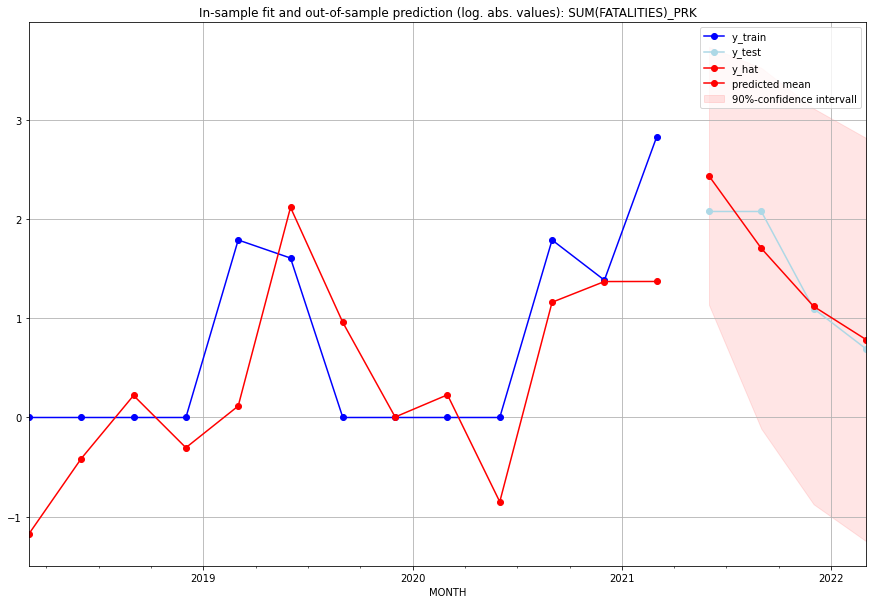

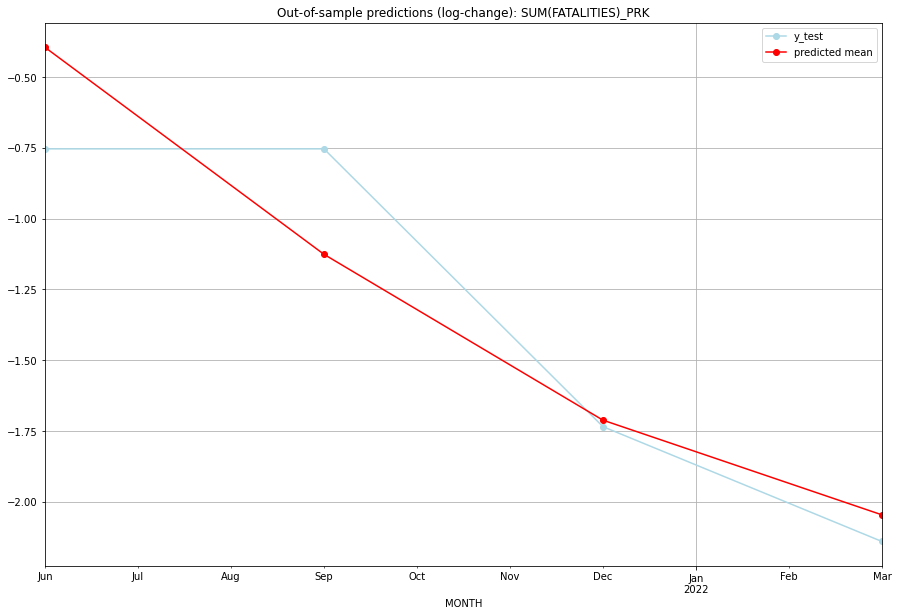

TADDA: 0.21194826423131385
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  10.449604         7.0     -0.395258       -0.753772   PRK   
1 2021-07-01   4.513025         7.0     -1.126100       -0.753772   PRK   
2 2021-10-01   2.069527         2.0     -1.711690       -1.734601   PRK   
3 2022-01-01   1.197208         1.0     -2.046026       -2.140066   PRK   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## PRT (169/234) #########
0
Neighbor countries: ['ESP']
Getting Data for PRT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insu

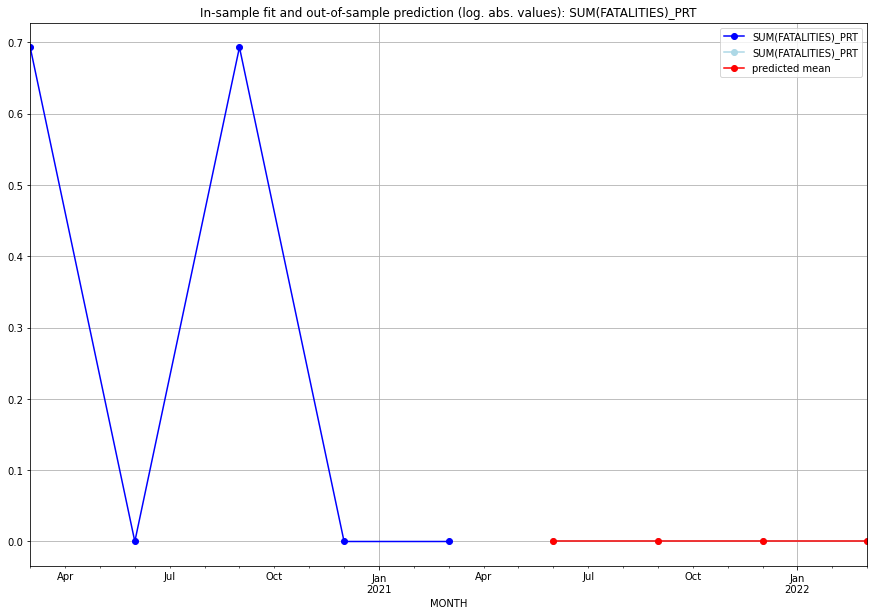

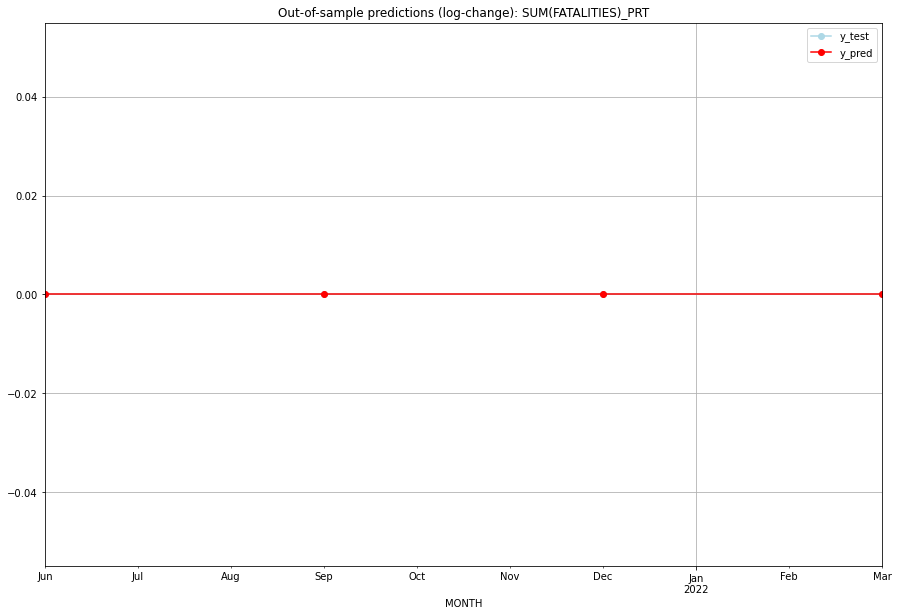

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   PRT   
1 2021-07-01       0.0         0.0           0.0             0.0   PRT   
2 2021-10-01       0.0         0.0           0.0             0.0   PRT   
3 2022-01-01       0.0         0.0           0.0             0.0   PRT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## PRY (170/234) #########
0
Neighbor countries: ['BRA', 'ARG', 'BOL']
Getting Data for PRY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.45514868637923855, 'fold_results': [0.6770125502755533, 0.23328482248292381]}
Retraining model failed.
No model fitted --> Prediction with Naive Model 


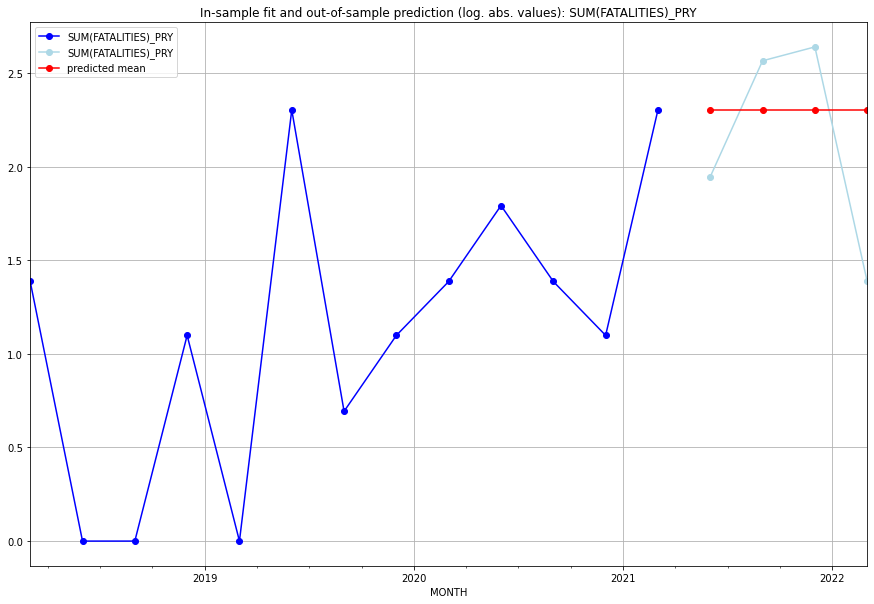

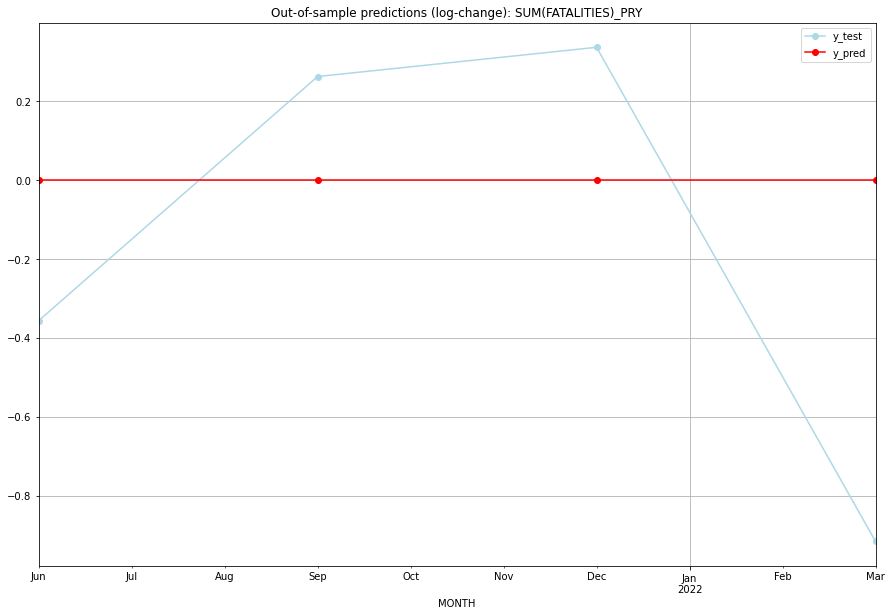

TADDA: 0.46795054422539795
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.302585    1.945910           0.0       -0.356675   PRY   
1 2021-07-01  2.302585    2.564949           0.0        0.262364   PRY   
2 2021-10-01  2.302585    2.639057           0.0        0.336472   PRY   
3 2022-01-01  2.302585    1.386294           0.0       -0.916291   PRY   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## PSE (171/234) #########
0
Neighbor countries: ['EGY', 'ISR', 'JOR']
Getting Data for PSE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 24)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5949948641431192, 'fold_results': [0.11412488404066634, nan, 0.365390949503664, 1.3054687588850271]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PSE   No. Observations:                   21
Model:                SARIMAX(1, 0, 2)   Log Likelihood                 -16.839
Date:                 Wed, 19 Oct 2022   AIC                             43.677
Time:                         10:51:33   BIC                             48.900
Sample:                     01-31-2016   HQIC                            44.811
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1  

<Figure size 432x288 with 0 Axes>

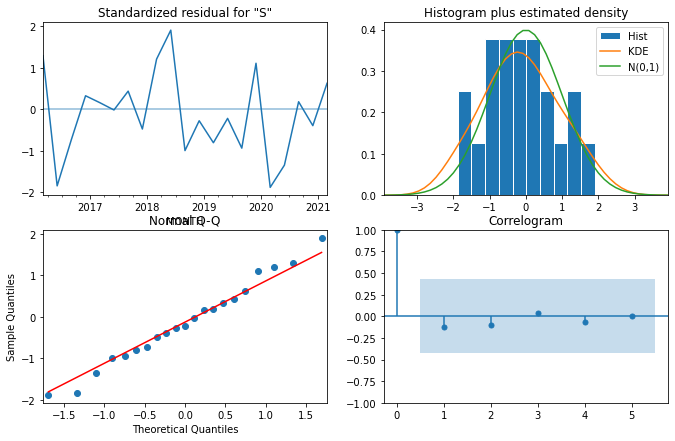

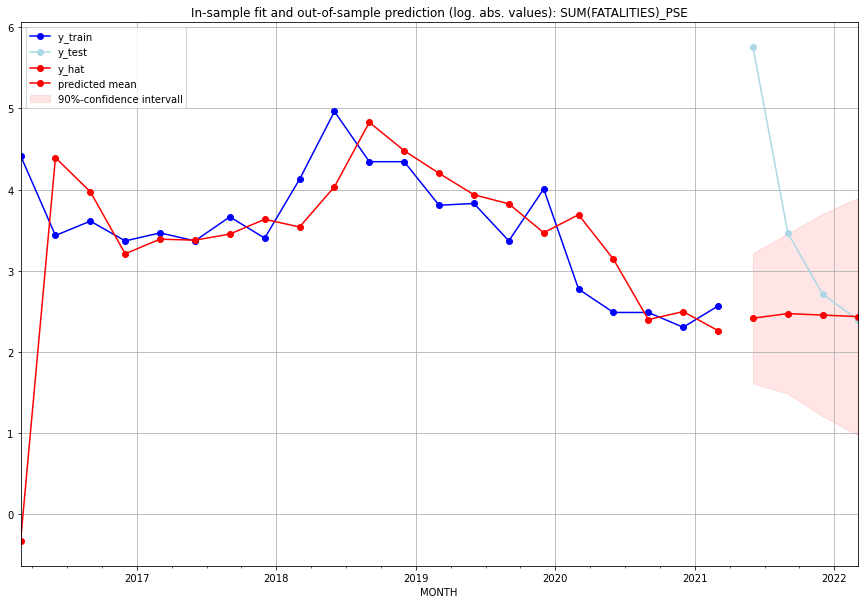

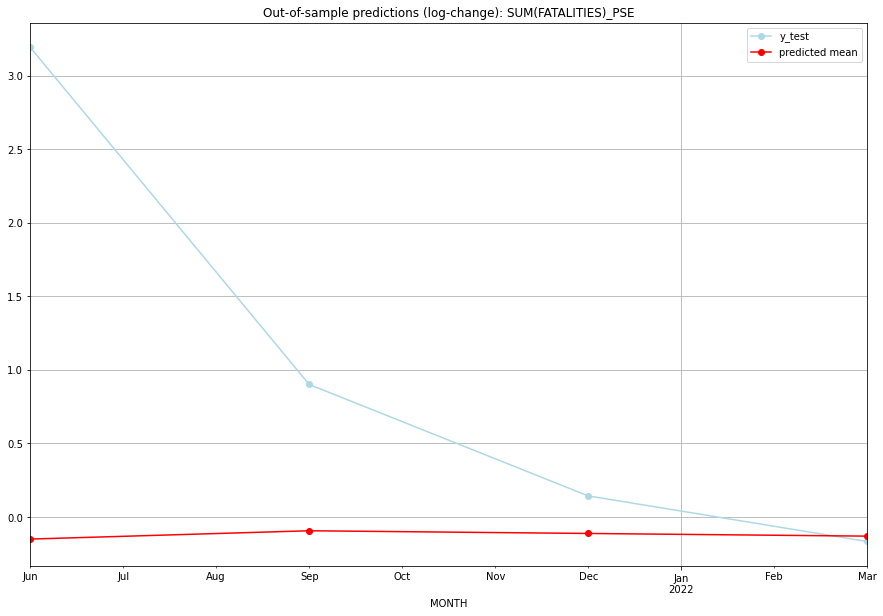

TADDA: 1.2471495753213624
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  10.182026       316.0     -0.150642        3.193952   PSE   
1 2021-07-01  10.832606        31.0     -0.094090        0.900787   PSE   
2 2021-10-01  10.617538        14.0     -0.112433        0.143101   PSE   
3 2022-01-01  10.408090        10.0     -0.130627       -0.167054   PSE   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## PYF (172/234) #########
0
Neighbor countries: []
Getting Data for PYF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficie

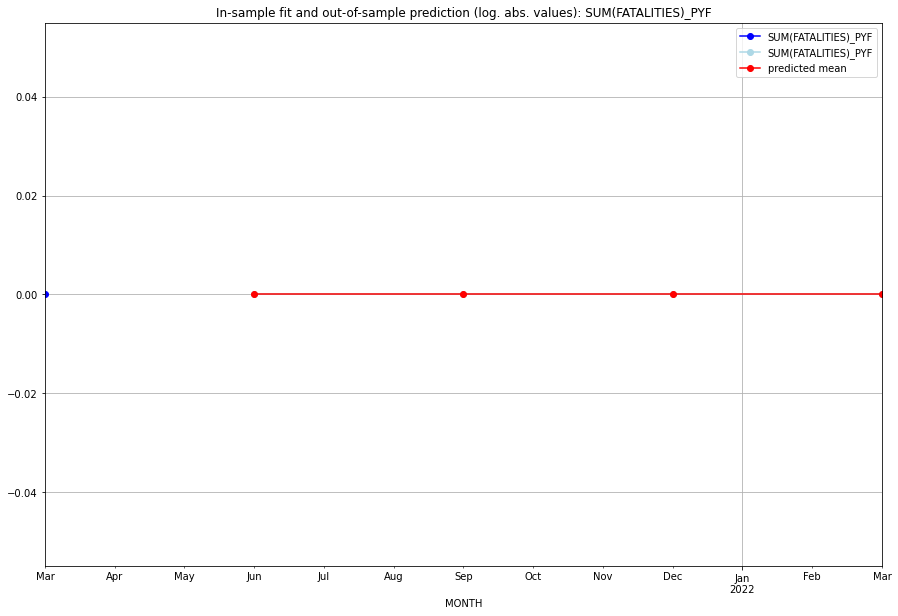

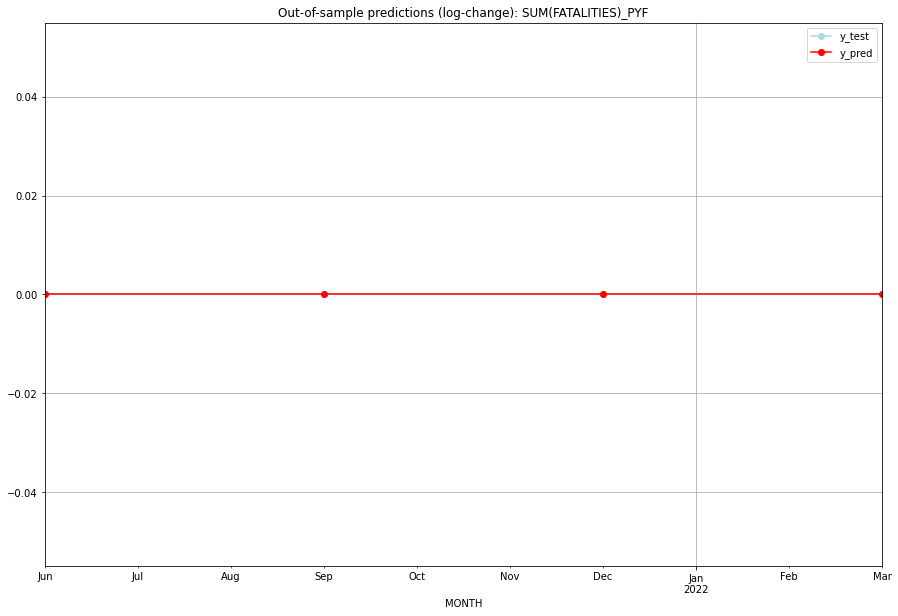

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   PYF   
1 2021-07-01       0.0         0.0           0.0             0.0   PYF   
2 2021-10-01       0.0         0.0           0.0             0.0   PYF   
3 2022-01-01       0.0         0.0           0.0             0.0   PYF   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## QAT (173/234) #########
0
Neighbor countries: ['SAU']
Getting Data for QAT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 8)
y: (21, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_QAT   No. Observations:                   17
M

<Figure size 432x288 with 0 Axes>

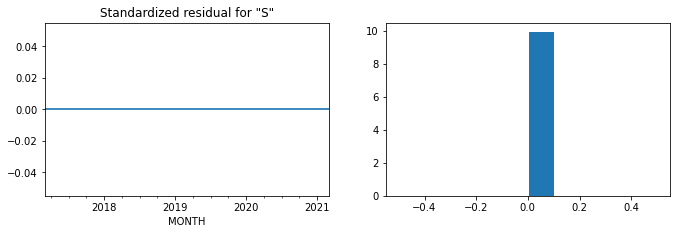

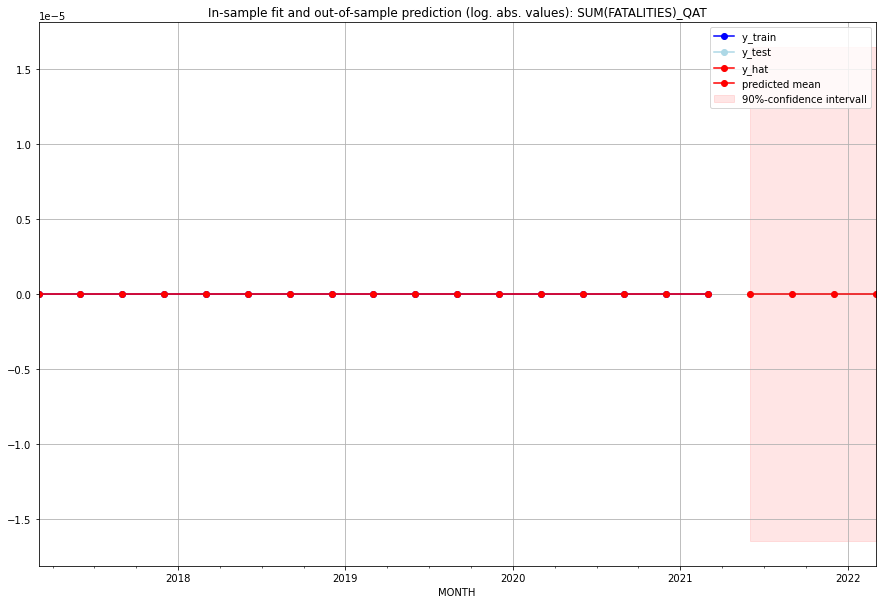

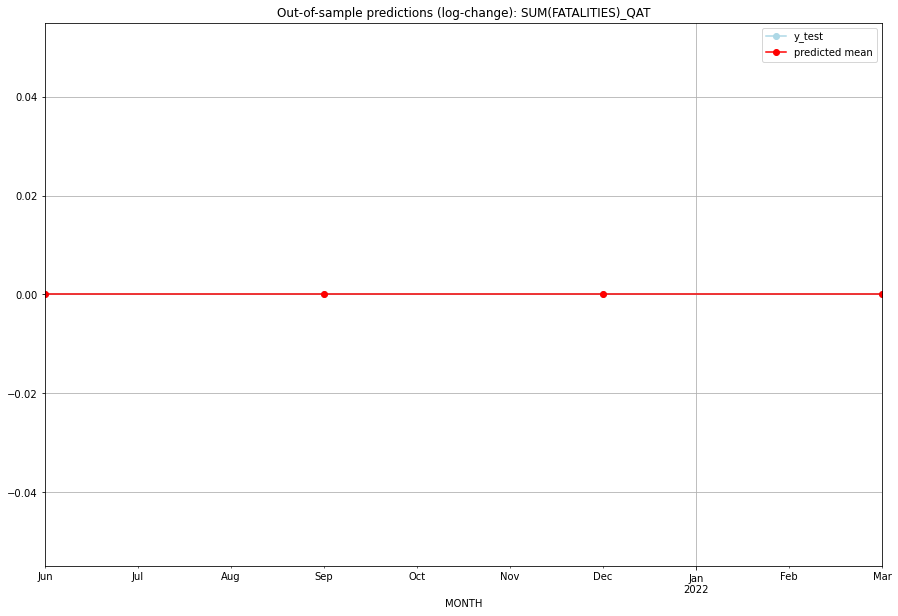

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   QAT   
1 2021-07-01       0.0         0.0           0.0             0.0   QAT   
2 2021-10-01       0.0         0.0           0.0             0.0   QAT   
3 2022-01-01       0.0         0.0           0.0             0.0   QAT   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:04
######## REU (174/234) #########
0
Neighbor countries: []
Getting Data for REU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_REU   No. Observations:                   96
Model:   

<Figure size 432x288 with 0 Axes>

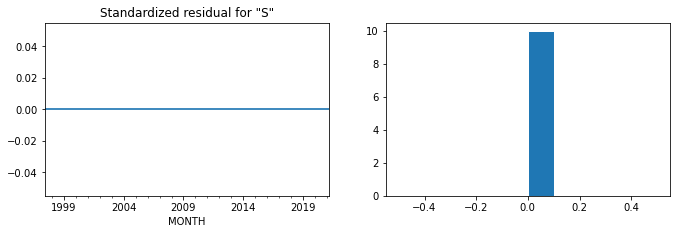

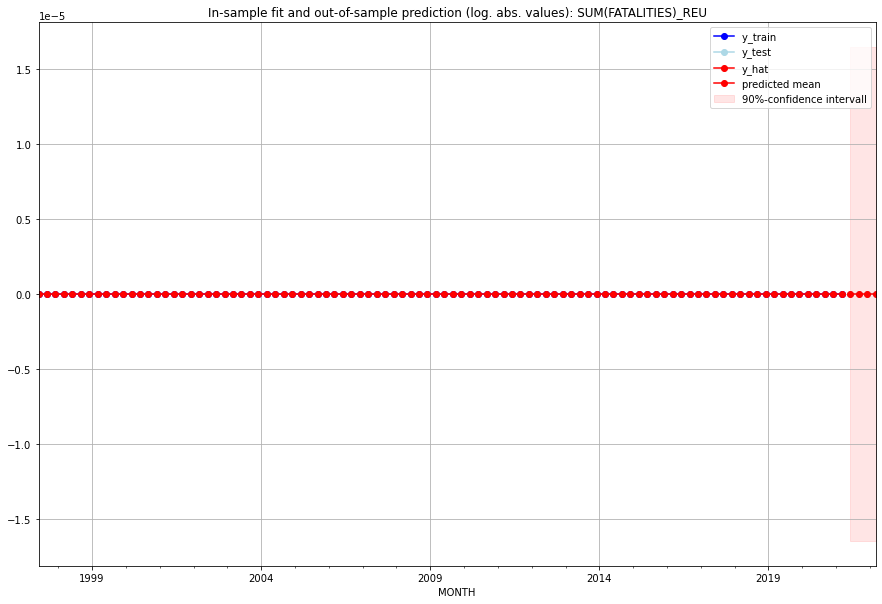

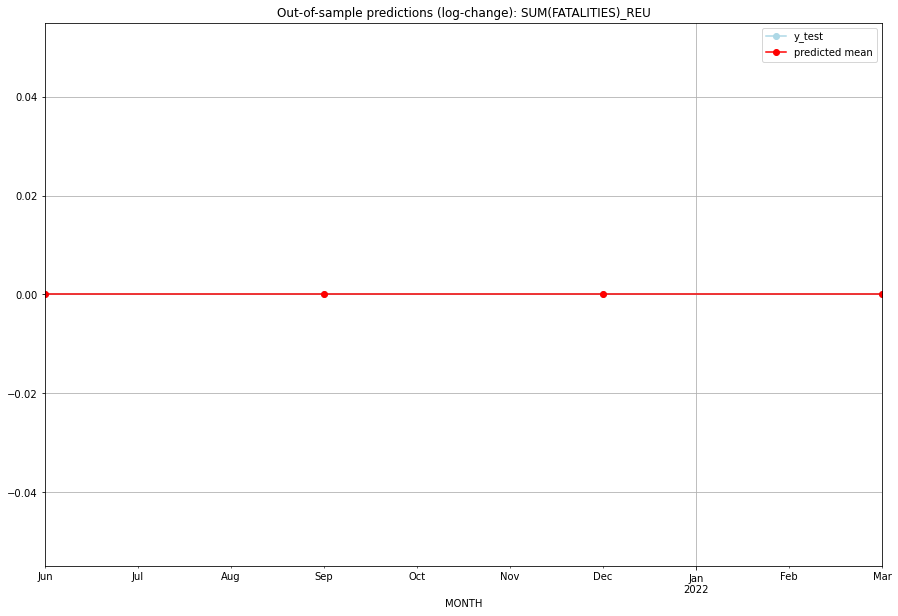

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   REU   
1 2021-07-01       0.0         0.0           0.0             0.0   REU   
2 2021-10-01       0.0         0.0           0.0             0.0   REU   
3 2022-01-01       0.0         0.0           0.0             0.0   REU   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## ROU (175/234) #########
0
Neighbor countries: ['BGR', 'SRB', 'MDA', 'UKR', 'HUN']
Getting Data for ROU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.17328679513998632, 'fold_results': [0.17328679513998632, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ROU   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -6.225
Date:                 Wed, 19 Oct 2022   AIC                             18.449
Time:                         10:51:53   BIC                             20.144
Sample:                     01-31-2018   HQIC                            18.101
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1      -1.029e-05   1.32e+04  -7.77e-1

<Figure size 432x288 with 0 Axes>

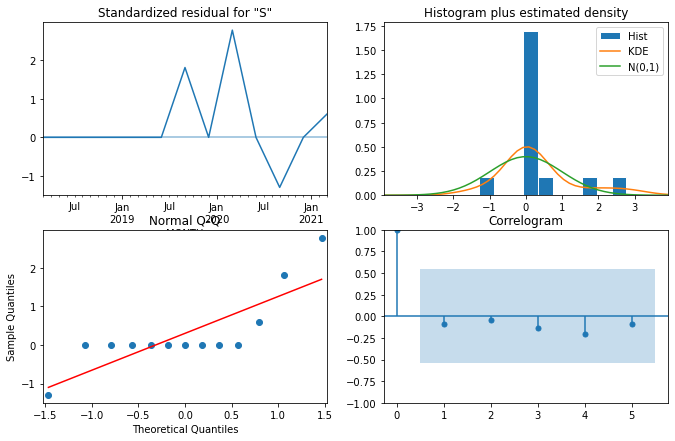

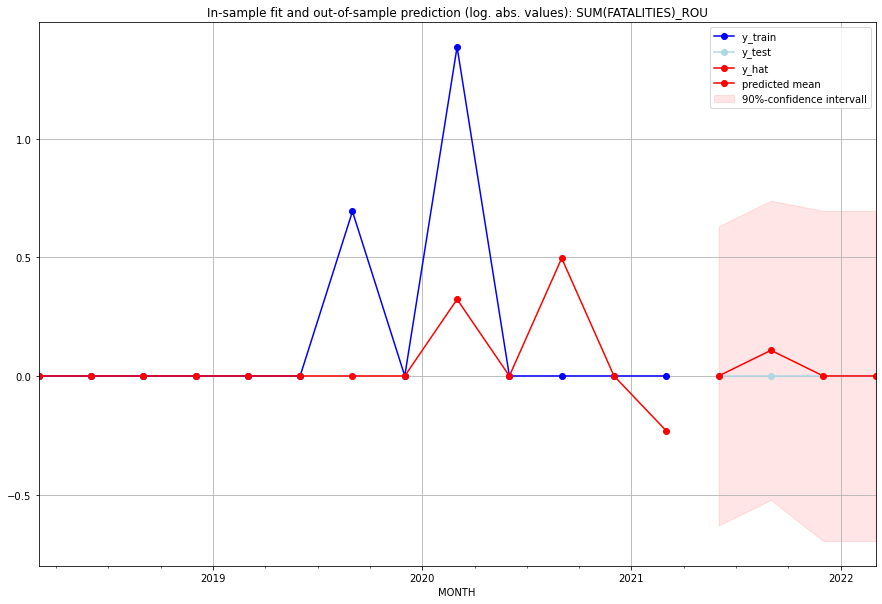

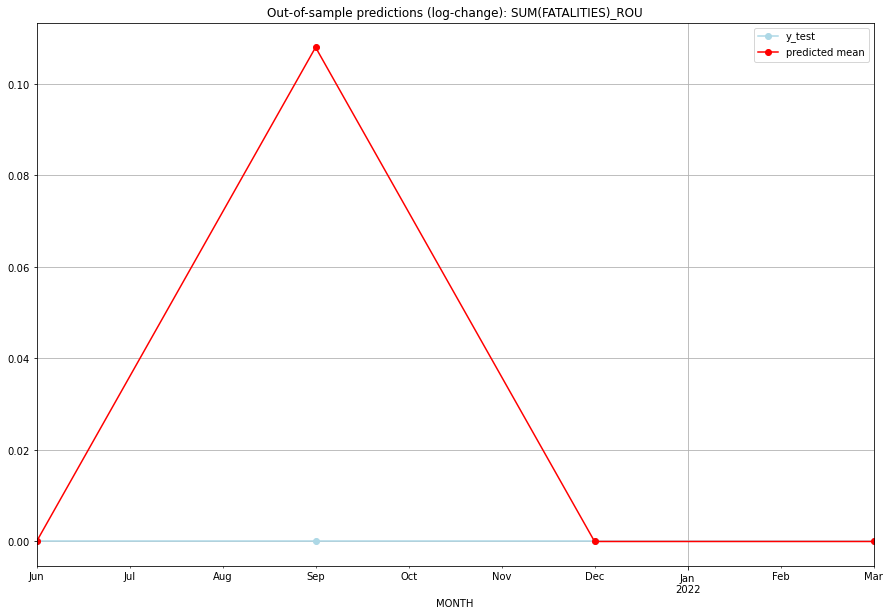

TADDA: 0.02700273021257072
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   0.00000         0.0      0.000000             0.0   ROU   
1 2021-07-01   0.11406         0.0      0.108011             0.0   ROU   
2 2021-10-01   0.00000         0.0      0.000000             0.0   ROU   
3 2022-01-01   0.00000         0.0      0.000000             0.0   ROU   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## RUS (176/234) #########
0
Neighbor countries: ['GEO', 'KAZ', 'AZE', 'CHN', 'MNG', 'LTU', 'POL', 'FIN', 'UKR', 'EST', 'NOR', 'PRK', 'BLR', 'LVA']
Getting Data for RUS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 112)
y: (17, 1)
--

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.2098724878848402, 'fold_results': [0.2098724878848402, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_RUS   No. Observations:                   13
Model:                SARIMAX(1, 0, 2)   Log Likelihood                  -7.978
Date:                 Wed, 19 Oct 2022   AIC                             25.956
Time:                         10:52:03   BIC                             28.781
Sample:                     01-31-2018   HQIC                            25.376
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0008      0.044      0.018 

<Figure size 432x288 with 0 Axes>

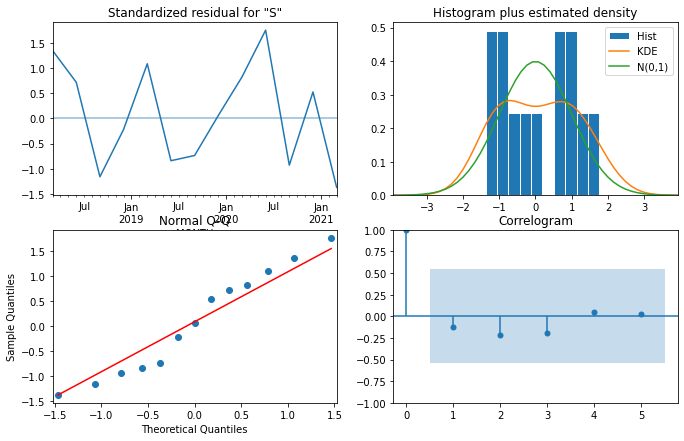

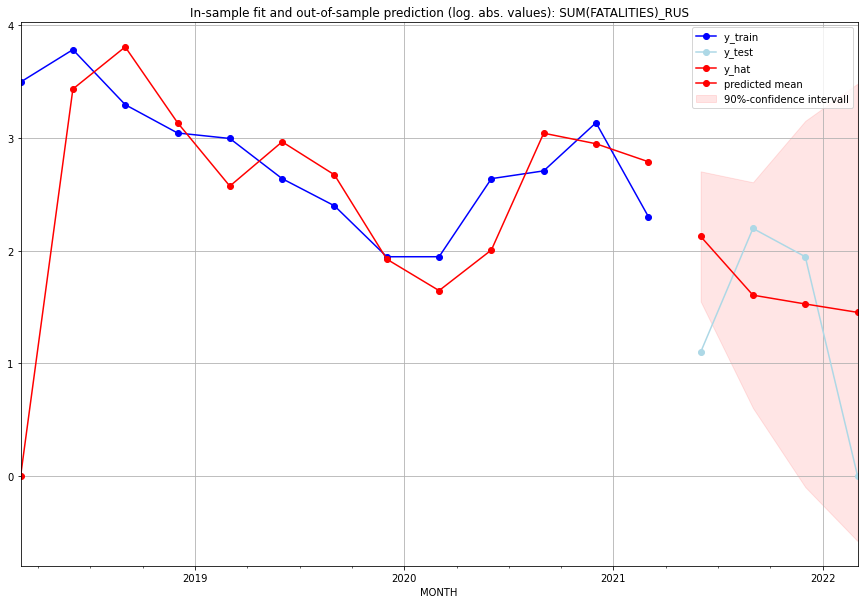

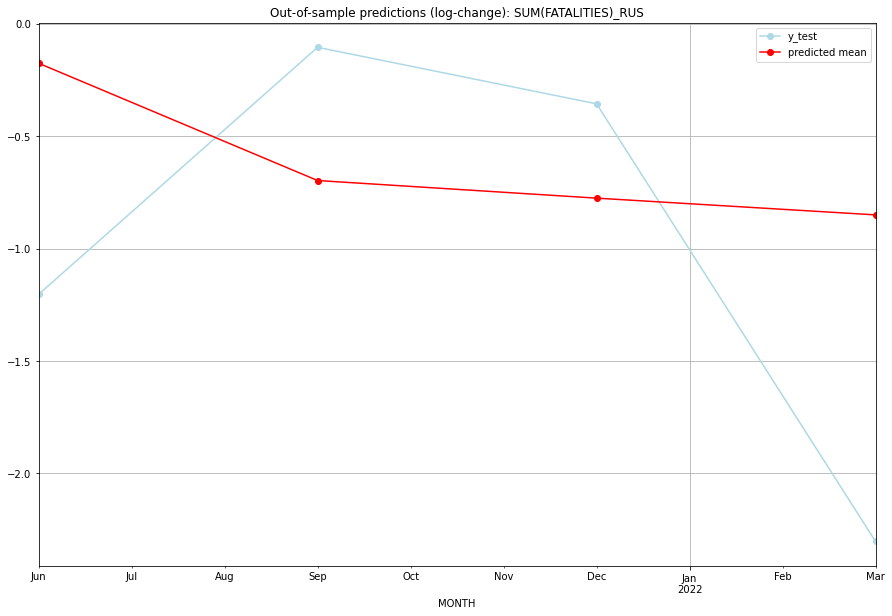

TADDA: 0.8728837295755344
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  7.384850         2.0     -0.176159       -1.203973   RUS   
1 2021-07-01  3.977532         8.0     -0.697651       -0.105361   RUS   
2 2021-10-01  3.602564         6.0     -0.775972       -0.356675   RUS   
3 2022-01-01  3.272220         0.0     -0.850451       -2.302585   RUS   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## RWA (177/234) #########
0
Neighbor countries: ['COD', 'UGA', 'BDI', 'TZA']
Getting Data for RWA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 32)
y: (100, 1)
------------------------------------------------
Training started.
Start

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.0506998693589407, 'fold_results': [0.8531657935926029, 1.0540977442373805, 1.108964049135126, 1.7660174265235546, 0.47125433330603905]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_RWA   No. Observations:                   96
Model:                SARIMAX(0, 1, 1)   Log Likelihood                -171.692
Date:                 Wed, 19 Oct 2022   AIC                            347.383
Time:                         10:52:25   BIC                            352.491
Sample:                     04-30-1997   HQIC                           349.447
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

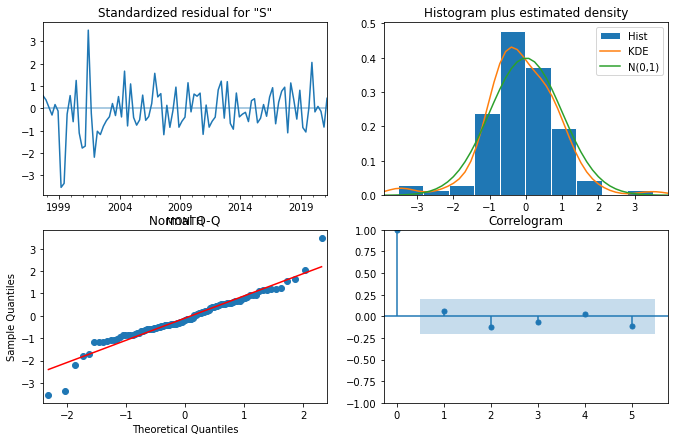

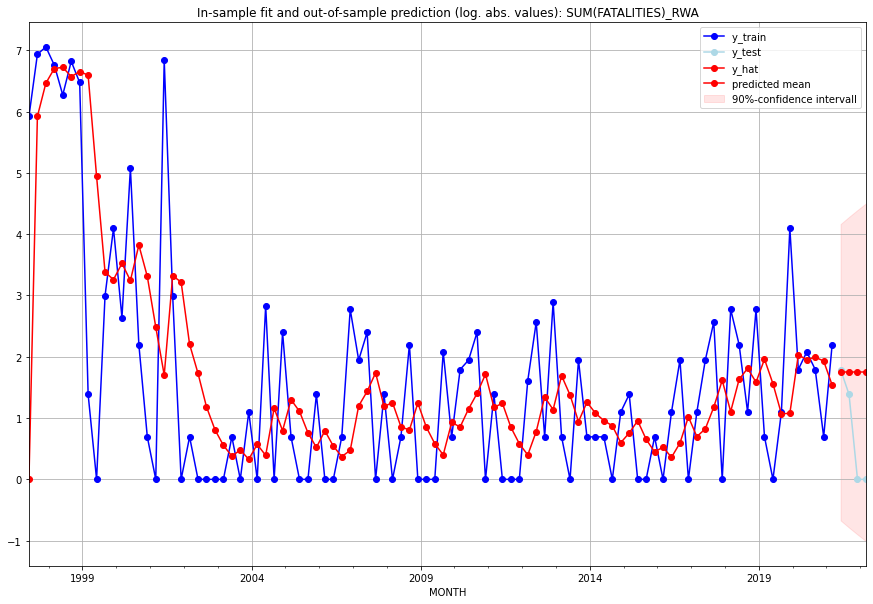

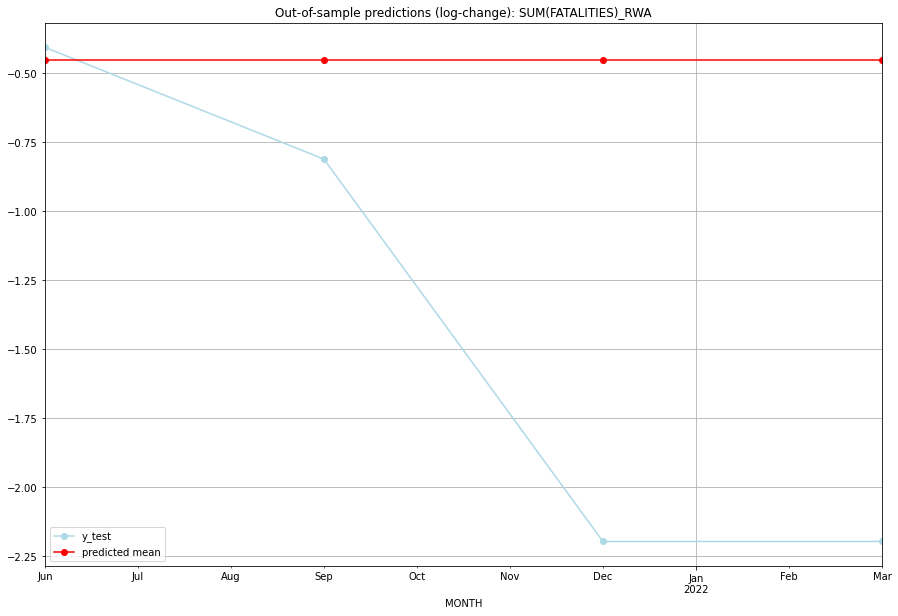

TADDA: 0.9749903434252069
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  4.738789         5.0     -0.449976       -0.405465   RWA   
1 2021-07-01  4.738789         3.0     -0.449976       -0.810930   RWA   
2 2021-10-01  4.738789         0.0     -0.449976       -2.197225   RWA   
3 2022-01-01  4.738789         0.0     -0.449976       -2.197225   RWA   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## SAU (178/234) #########
0
Neighbor countries: ['YEM', 'IRQ', 'JOR', 'ARE', 'BHR', 'KWT', 'OMN', 'QAT']
Getting Data for SAU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (29, 64)
y: (29, 1)
----------------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6244619651367083, 'fold_results': [0.9635781081758265, 0.3198794041421571, 0.05269738089349785, 0.622552513860051, 1.163602418612009]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SAU   No. Observations:                   25
Model:                SARIMAX(1, 0, 0)   Log Likelihood                 -36.957
Date:                 Wed, 19 Oct 2022   AIC                             79.914
Time:                         10:52:41   BIC                             83.571
Sample:                     01-31-2015   HQIC                            80.928
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

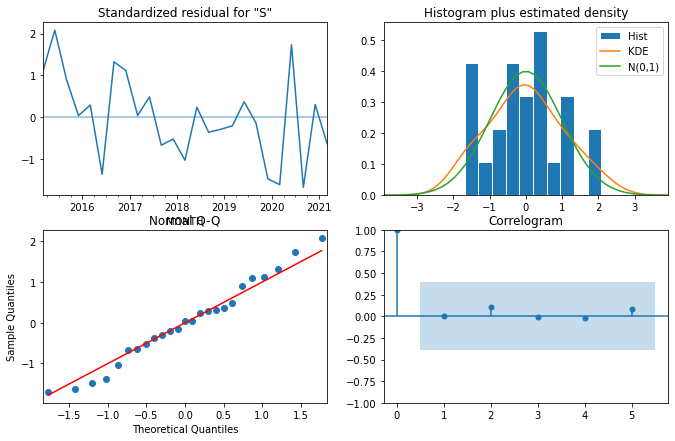

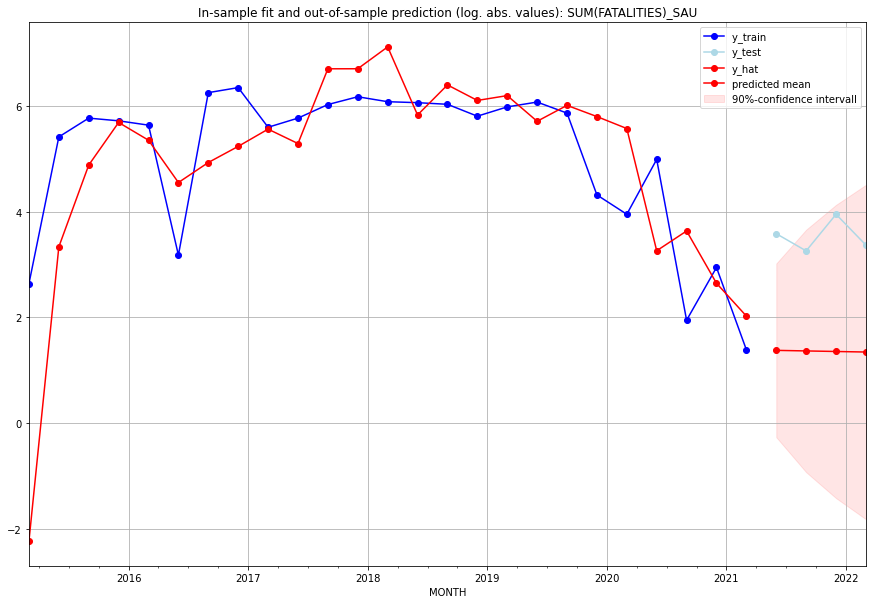

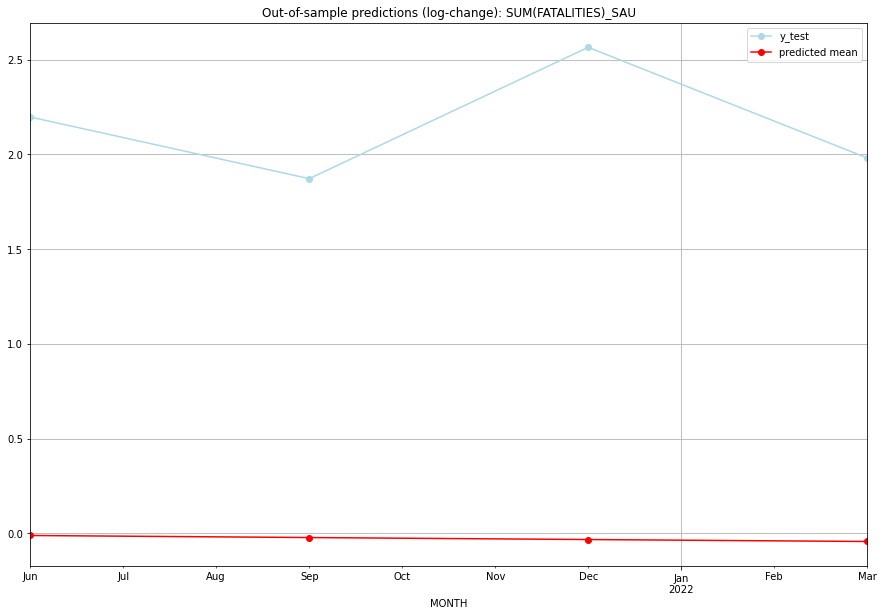

TADDA: 2.2079661363107177
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.955739        35.0     -0.011127        2.197225   SAU   
1 2021-07-01  2.913088        25.0     -0.021967        1.871802   SAU   
2 2021-10-01  2.871976        51.0     -0.032529        2.564949   SAU   
3 2022-01-01  2.832336        28.0     -0.042820        1.981001   SAU   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## SDN (179/234) #########
0
Neighbor countries: ['EGY', 'LBY', 'ERI', 'ETH', 'SSD', 'CAF', 'XKK', 'TCD', 'XAR']
Getting Data for SDN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 72)
y: (100, 1)
-------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5322814077433164, 'fold_results': [1.0198220787170087, 0.4602538055546712, 0.341768898302351, 0.3284208121558514, 0.5111414439867004]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SDN   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -140.812
Date:                 Wed, 19 Oct 2022   AIC                            285.624
Time:                         10:53:07   BIC                            290.732
Sample:                     04-30-1997   HQIC                           287.688
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

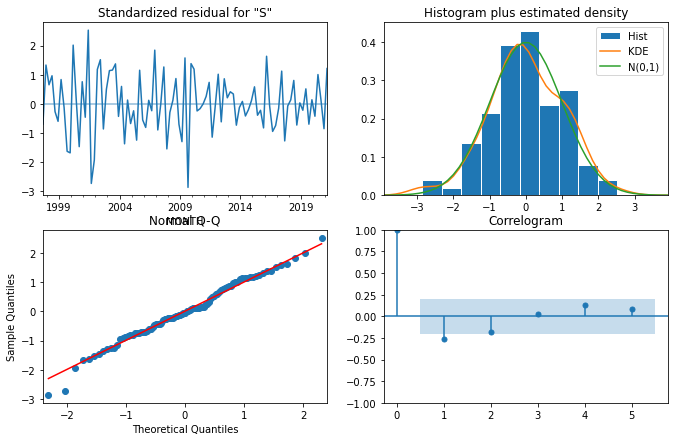

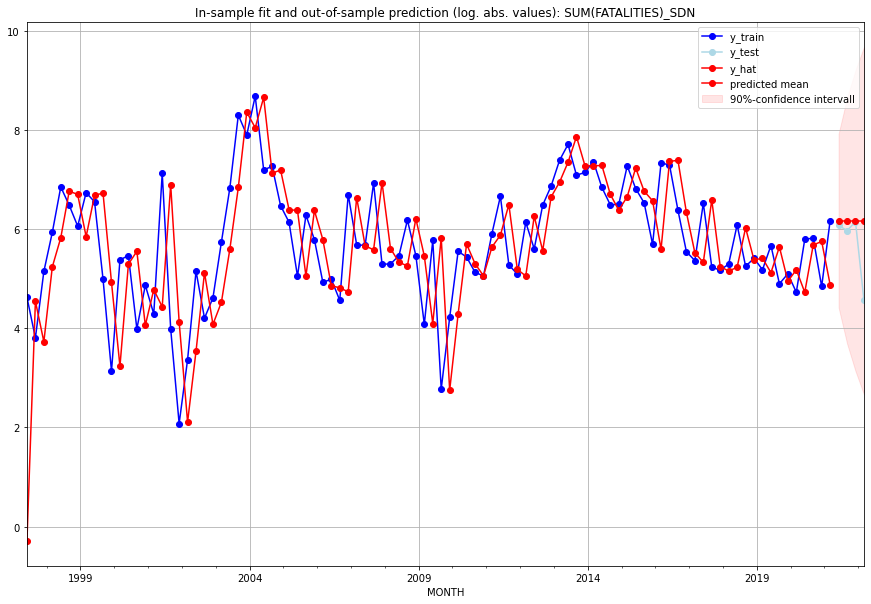

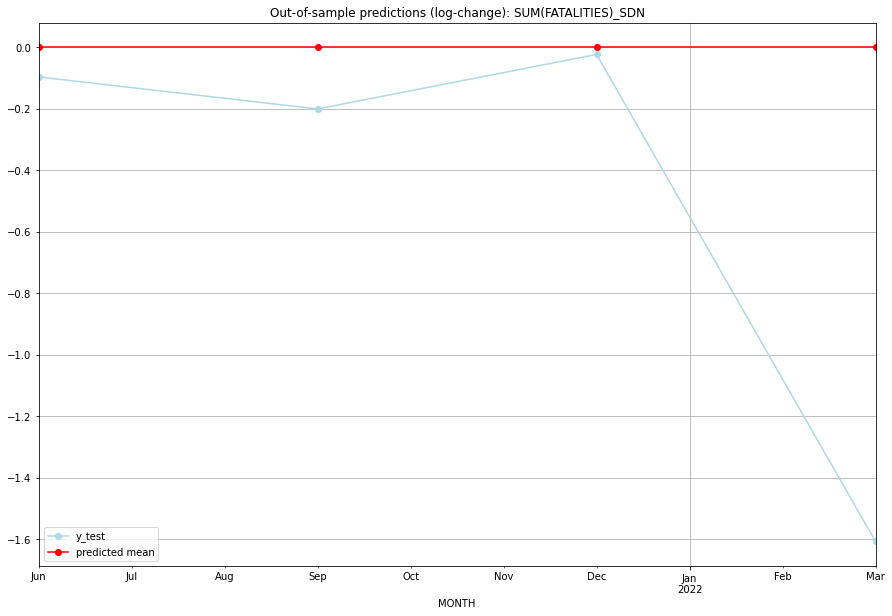

TADDA: 0.48184450784475663
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     478.0       434.0 -8.881784e-16       -0.096355   SDN   
1 2021-07-01     478.0       391.0 -8.881784e-16       -0.200439   SDN   
2 2021-10-01     478.0       467.0 -8.881784e-16       -0.023232   SDN   
3 2022-01-01     478.0        95.0 -8.881784e-16       -1.607352   SDN   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:23
######## SEN (180/234) #########
0
Neighbor countries: ['MRT', 'GMB', 'GNB', 'GIN', 'MLI']
Getting Data for SEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 40)
y: (100, 1)
------------------------------------------------
Training starte

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.8355365270719854, 'fold_results': [1.4644349089400048, 0.1338725993743619, 1.647697501663247, 0.5112196197269674, 0.42045800565534663]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SEN   No. Observations:                   96
Model:                SARIMAX(0, 0, 3)   Log Likelihood                -175.825
Date:                 Wed, 19 Oct 2022   AIC                            365.649
Time:                         10:53:18   BIC                            383.600
Sample:                     04-30-1997   HQIC                           372.905
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

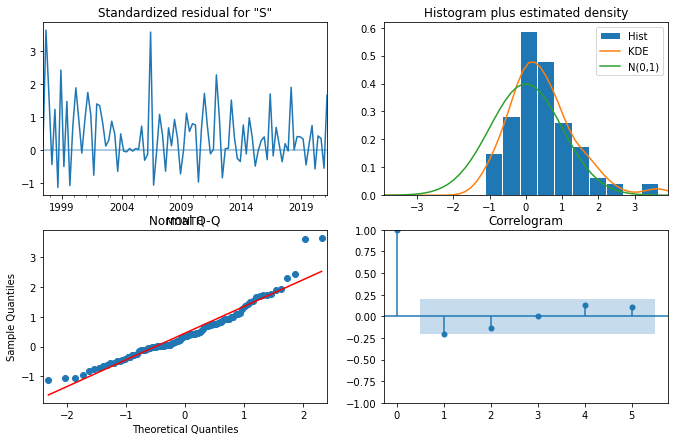

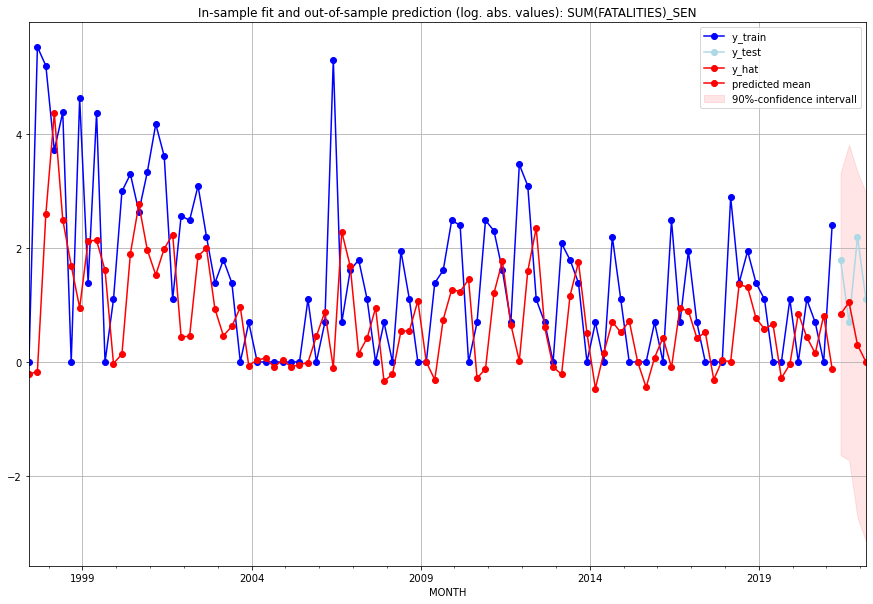

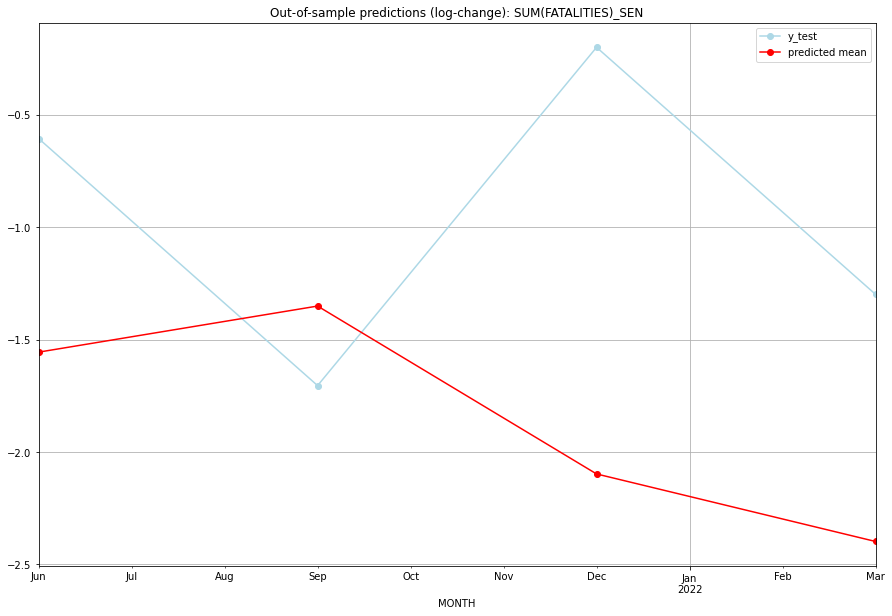

TADDA: 1.074785975295705
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.320598         5.0     -1.556070       -0.606136   SEN   
1 2021-07-01  1.848462         1.0     -1.351116       -1.704748   SEN   
2 2021-10-01  0.350209         8.0     -2.097636       -0.200671   SEN   
3 2022-01-01  0.000000         2.0     -2.397895       -1.299283   SEN   

                                          PARAMETERS  
0  {'params': [3, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## SGP (181/234) #########
0
Neighbor countries: []
Getting Data for SGP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient dat

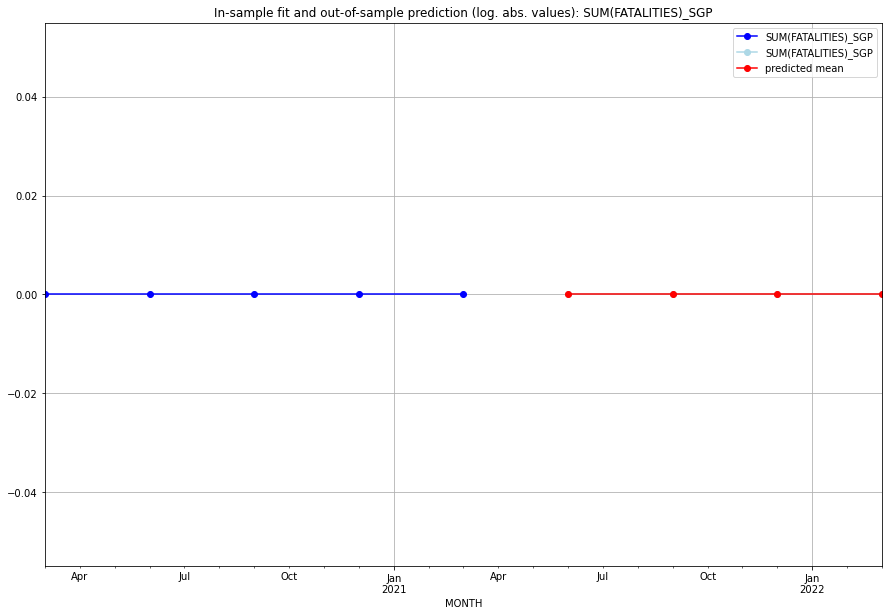

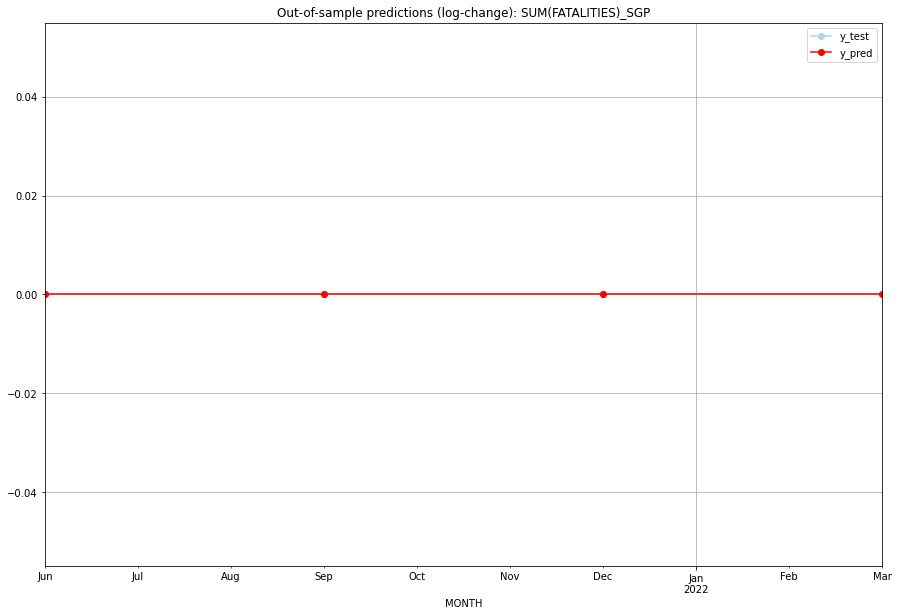

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SGP   
1 2021-07-01       0.0         0.0           0.0             0.0   SGP   
2 2021-10-01       0.0         0.0           0.0             0.0   SGP   
3 2022-01-01       0.0         0.0           0.0             0.0   SGP   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## SHN (182/234) #########
0
Neighbor countries: []
Getting Data for SHN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SHN   No. Observations:                   96
Mode

<Figure size 432x288 with 0 Axes>

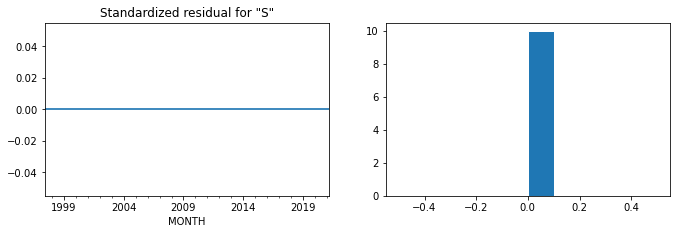

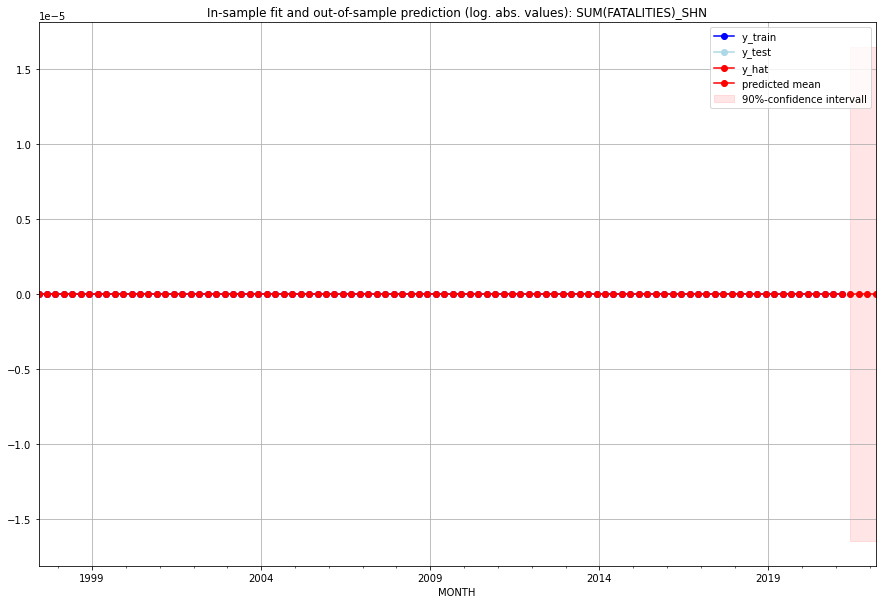

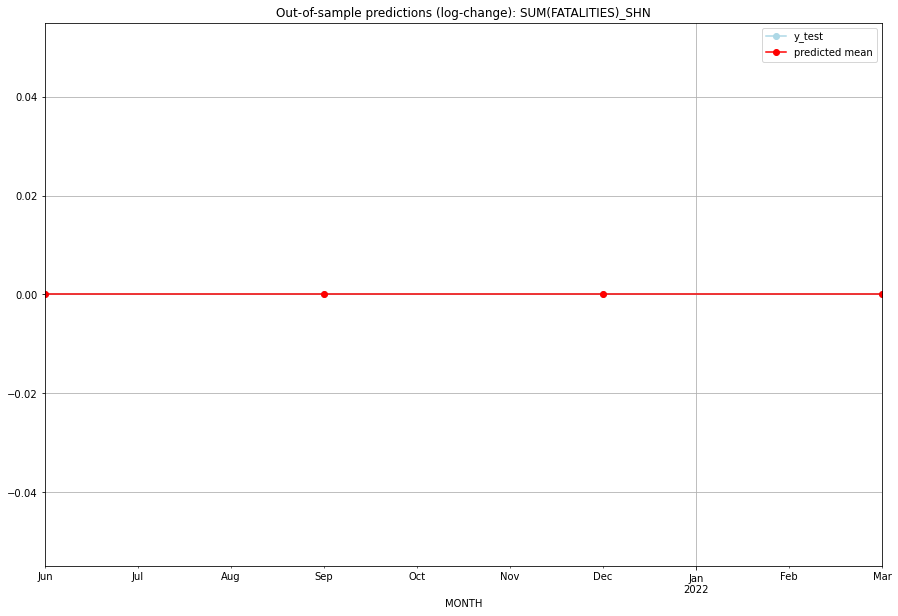

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SHN   
1 2021-07-01       0.0         0.0           0.0             0.0   SHN   
2 2021-10-01       0.0         0.0           0.0             0.0   SHN   
3 2022-01-01       0.0         0.0           0.0             0.0   SHN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:07
######## SJM (183/234) #########
0
Neighbor countries: []
Getting Data for SJM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


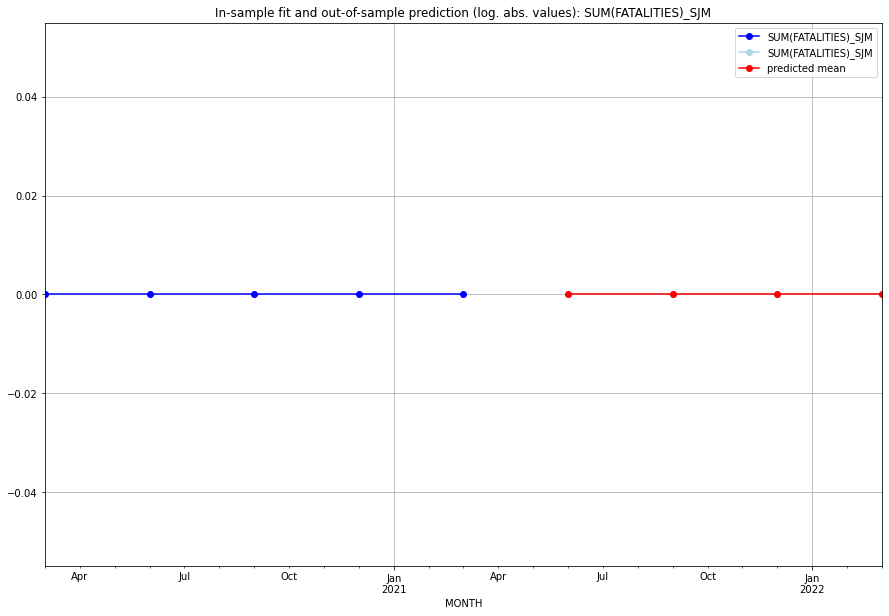

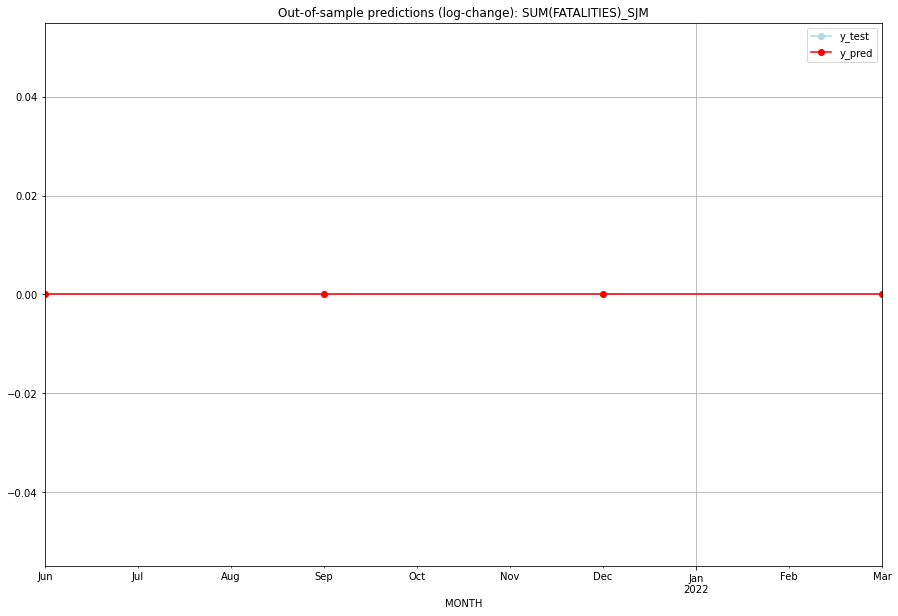

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SJM   
1 2021-07-01       0.0         0.0           0.0             0.0   SJM   
2 2021-10-01       0.0         0.0           0.0             0.0   SJM   
3 2022-01-01       0.0         0.0           0.0             0.0   SJM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## SLB (184/234) #########
0
Neighbor countries: []
Getting Data for SLB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


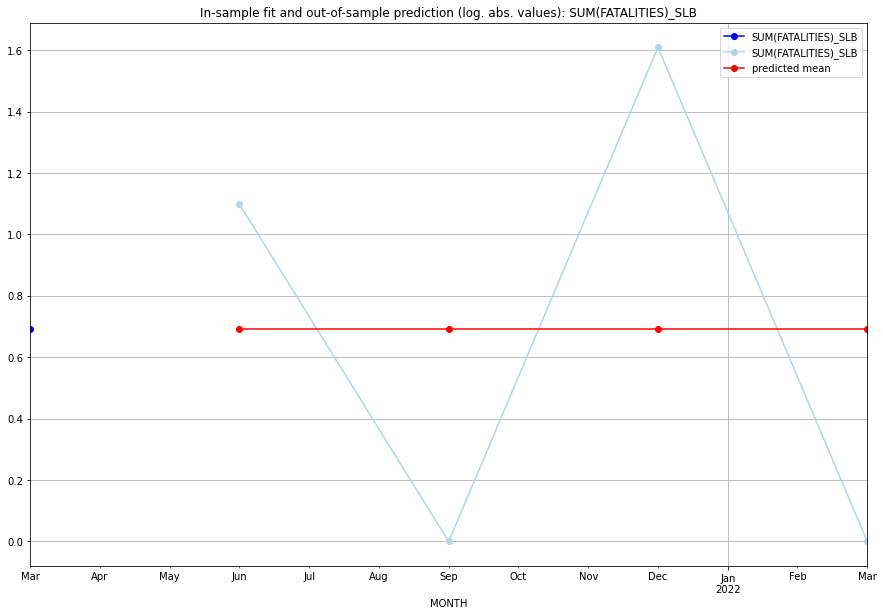

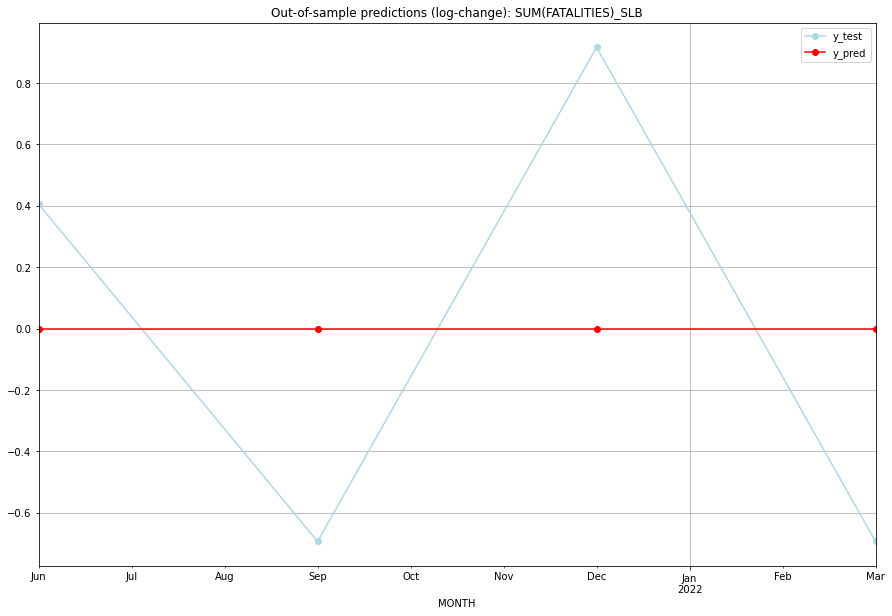

TADDA: 0.6770125502755526
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.693147    1.098612           0.0        0.405465   SLB   
1 2021-07-01  0.693147    0.000000           0.0       -0.693147   SLB   
2 2021-10-01  0.693147    1.609438           0.0        0.916291   SLB   
3 2022-01-01  0.693147    0.000000           0.0       -0.693147   SLB   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## SLE (185/234) #########
0
Neighbor countries: ['GIN', 'LBR']
Getting Data for SLE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 16)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8385010378488336, 'fold_results': [0.6597643324038145, 0.3465735902799727, 0.7489330683884977, 0.6597643324038146, 1.777469865768068]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SLE   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -137.759
Date:                 Wed, 19 Oct 2022   AIC                            277.518
Time:                         10:53:53   BIC                            280.072
Sample:                     04-30-1997   HQIC                           278.550
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

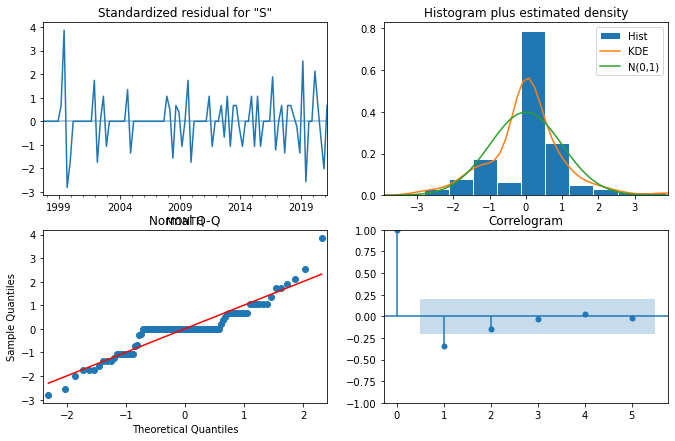

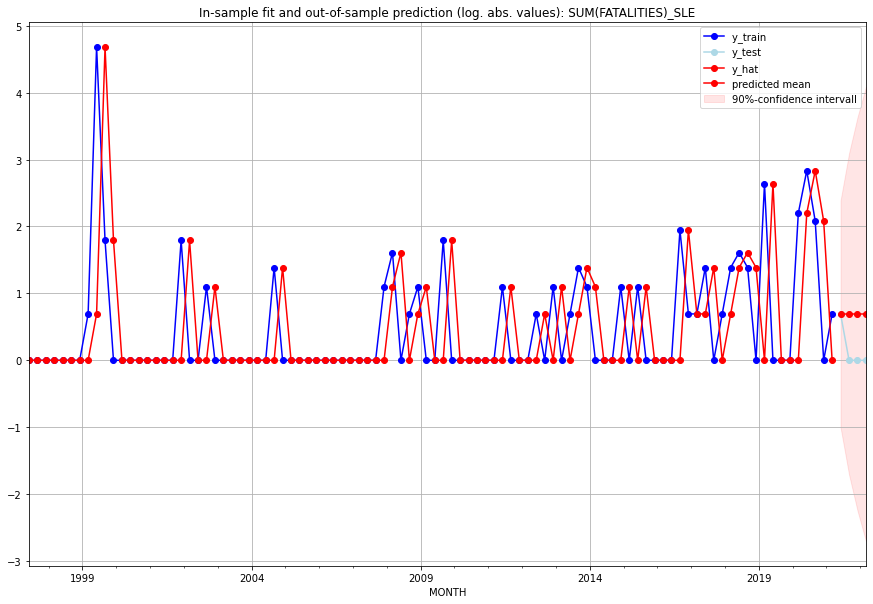

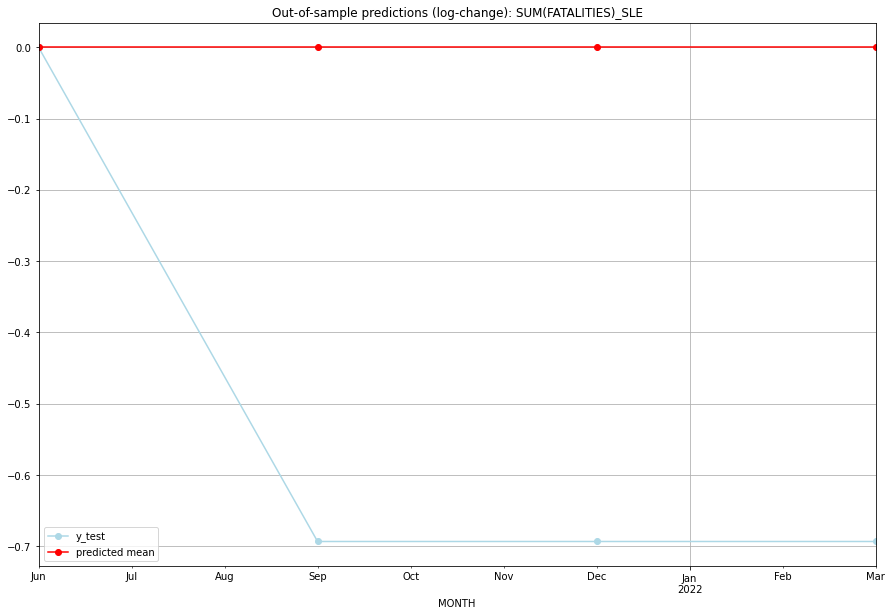

TADDA: 0.5198603854199588
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       1.0         1.0 -1.110223e-16        0.000000   SLE   
1 2021-07-01       1.0         0.0 -1.110223e-16       -0.693147   SLE   
2 2021-10-01       1.0         0.0 -1.110223e-16       -0.693147   SLE   
3 2022-01-01       1.0         0.0 -1.110223e-16       -0.693147   SLE   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## SLV (186/234) #########
0
Neighbor countries: ['GTM', 'HND']
Getting Data for SLV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 16)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV o

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.08643313235350569, 'fold_results': [0.08643313235350569, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SLV   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                  -3.094
Date:                 Wed, 19 Oct 2022   AIC                             22.188
Time:                         10:54:05   BIC                             26.708
Sample:                     01-31-2018   HQIC                            21.259
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0034      0.041      0.08

<Figure size 432x288 with 0 Axes>

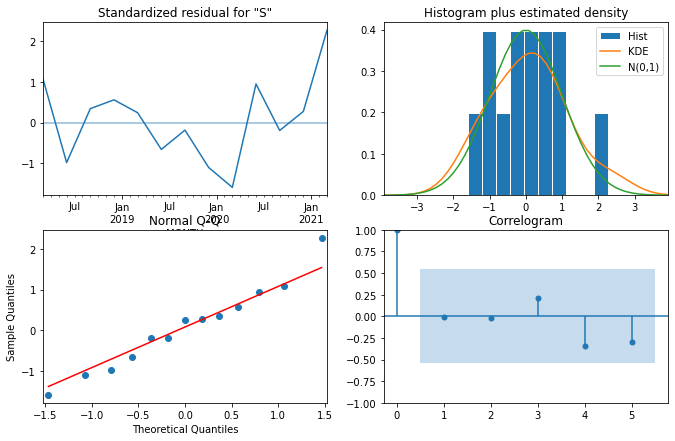

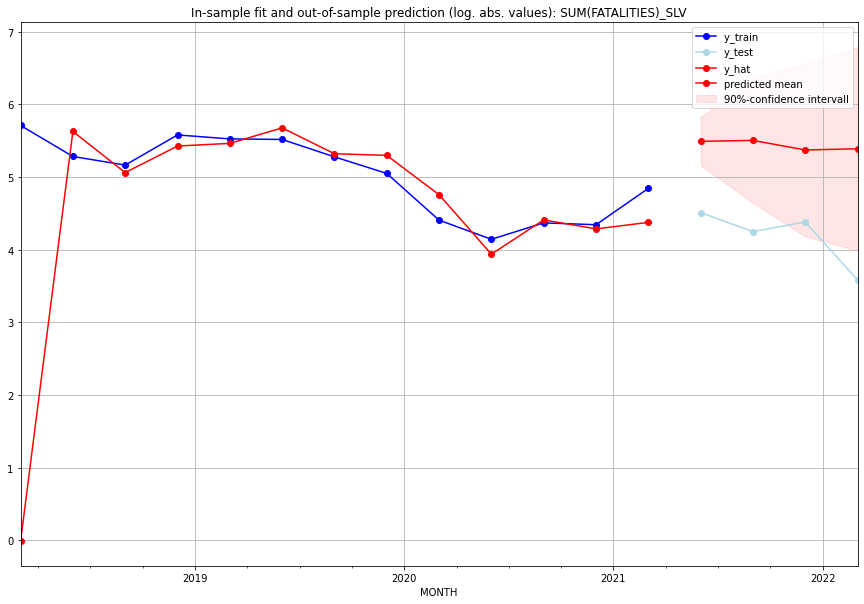

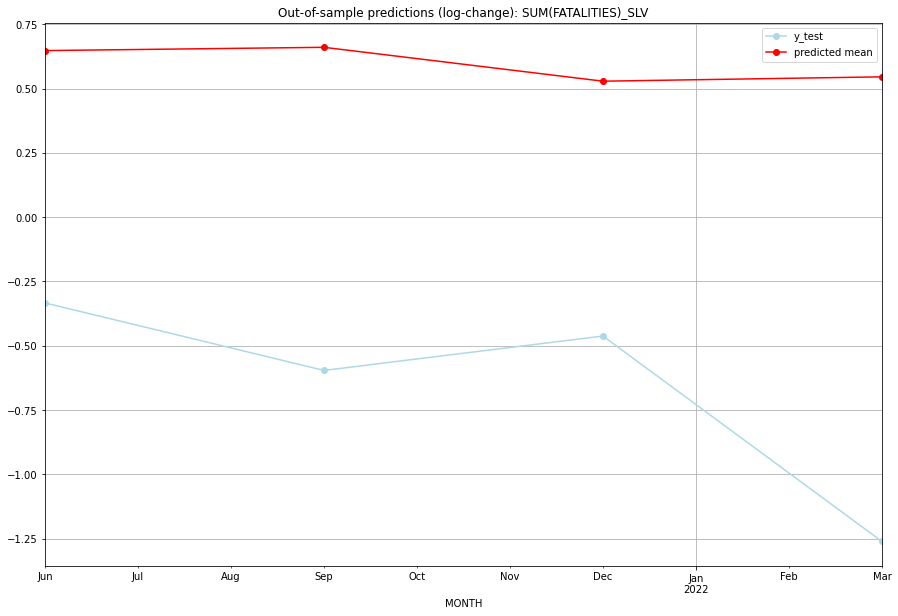

TADDA: 1.8537727406221656
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  241.656246        90.0      0.647459       -0.333328   SLV   
1 2021-07-01  244.767757        69.0      0.660200       -0.595692   SLV   
2 2021-10-01  214.447918        79.0      0.528532       -0.462160   SLV   
3 2022-01-01  218.119618        35.0      0.545431       -1.260668   SLV   

                                          PARAMETERS  
0  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## SMR (187/234) #########
0
Neighbor countries: ['ITA']
Getting Data for SMR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. 

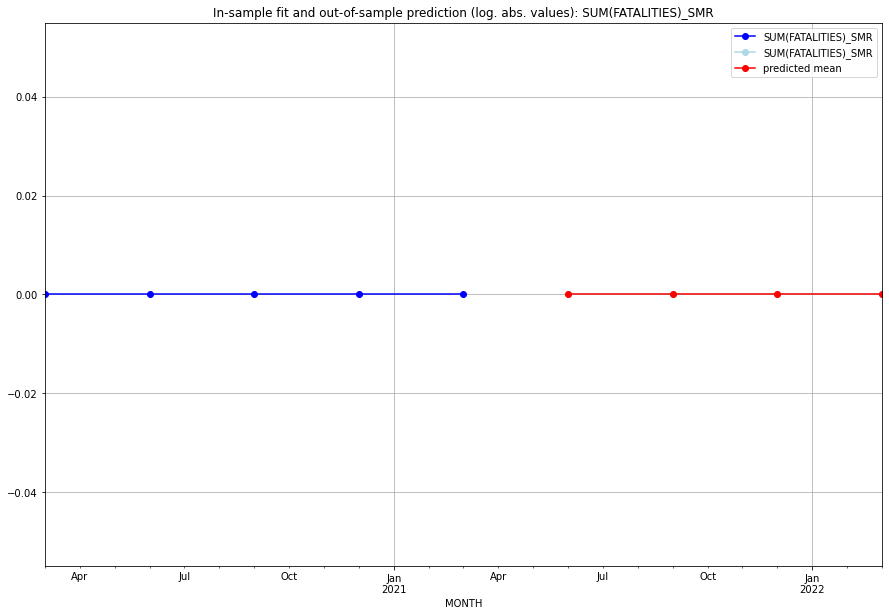

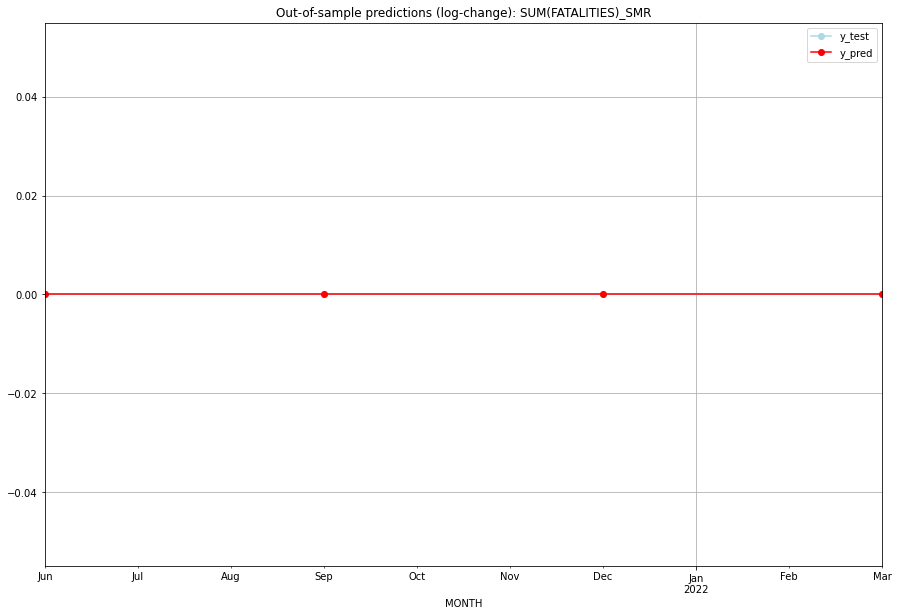

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SMR   
1 2021-07-01       0.0         0.0           0.0             0.0   SMR   
2 2021-10-01       0.0         0.0           0.0             0.0   SMR   
3 2022-01-01       0.0         0.0           0.0             0.0   SMR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## SOM (188/234) #########
0
Neighbor countries: ['KEN', 'ETH', 'DJI']
Getting Data for SOM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.24446892904111905, 'fold_results': [0.4015236277191261, 0.320932698426025, 0.17038178328393783, 0.1474716886728784, 0.18203484710362794]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SOM   No. Observations:                   96
Model:                SARIMAX(1, 0, 1)   Log Likelihood                -127.870
Date:                 Wed, 19 Oct 2022   AIC                            267.741
Time:                         10:54:27   BIC                            283.127
Sample:                     04-30-1997   HQIC                           273.960
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

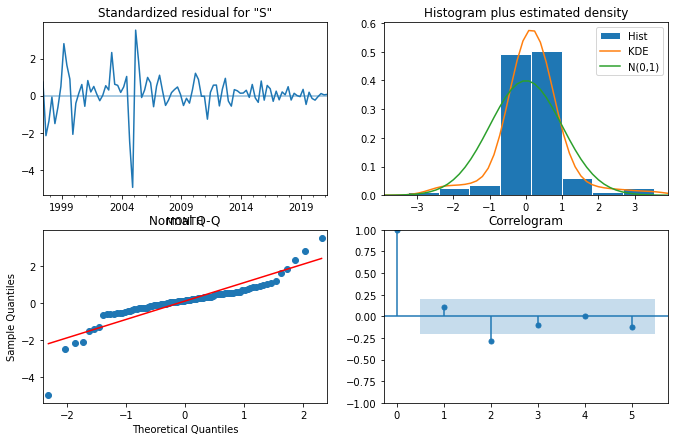

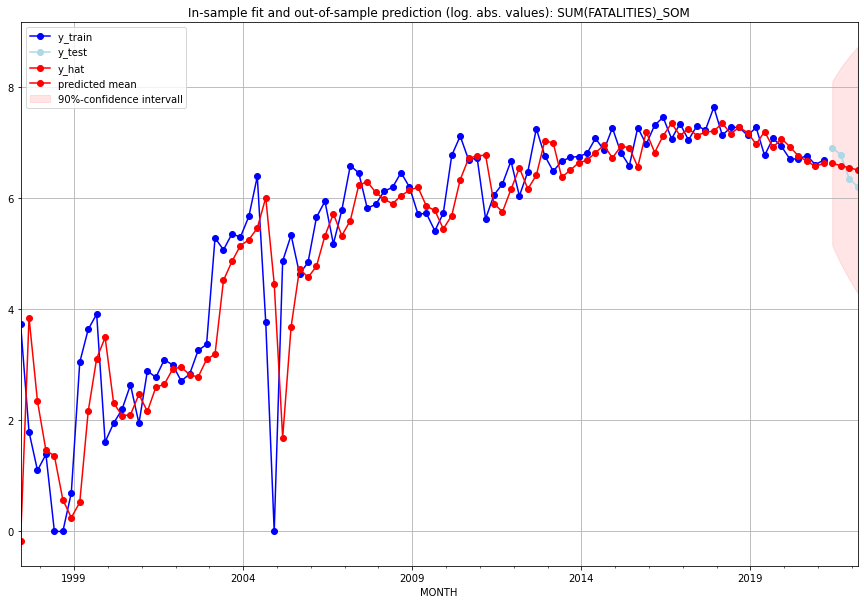

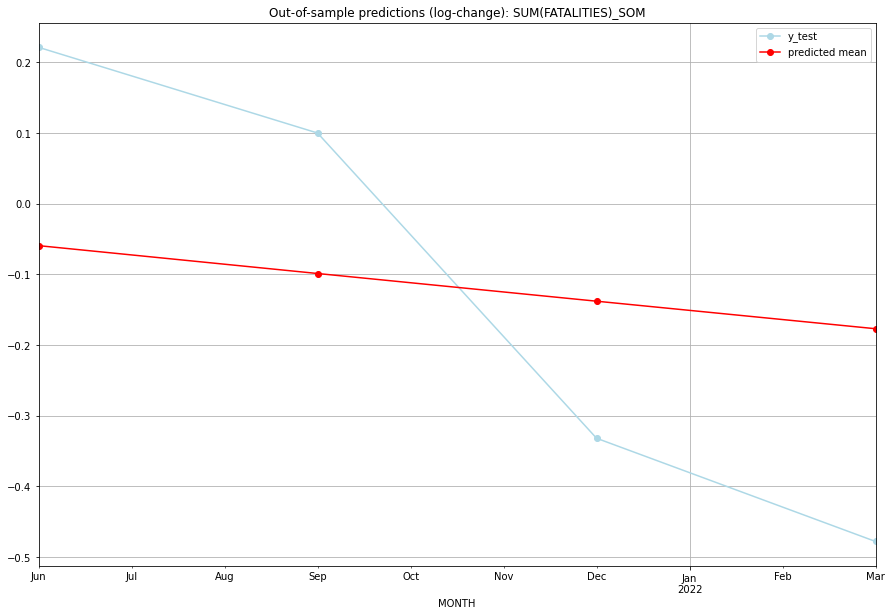

TADDA: 0.2831538460443932
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  752.817298       997.0     -0.059462        0.221142   SOM   
1 2021-07-01  723.677600       883.0     -0.098885        0.099845   SOM   
2 2021-10-01  695.831187       573.0     -0.138069       -0.331982   SOM   
3 2022-01-01  669.214305       495.0     -0.177014       -0.478036   SOM   

                                          PARAMETERS  
0  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## SRB (189/234) #########
0
Neighbor countries: ['BGR', 'XKO', 'MKD', 'MNE', 'HUN', 'ROU', 'BIH', 'HRV']
Getting Data for SRB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 64)
y: (17, 1)
------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08664339756999316, 'fold_results': [0.17328679513998632, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SRB   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                  -9.658
Date:                 Wed, 19 Oct 2022   AIC                             21.316
Time:                         10:54:39   BIC                             21.881
Sample:                     01-31-2018   HQIC                            21.199
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.2587      0.071      3.62

<Figure size 432x288 with 0 Axes>

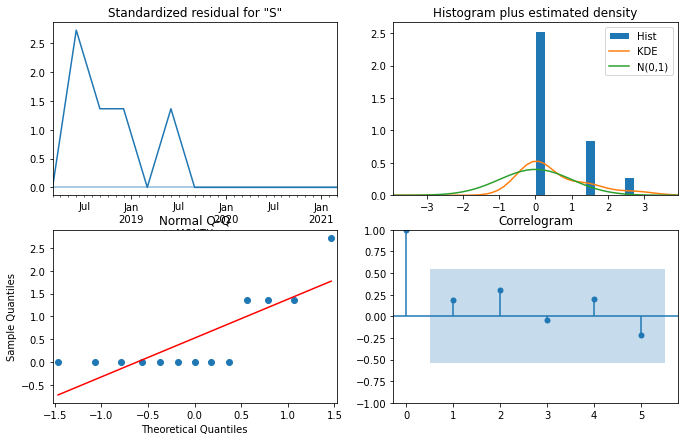

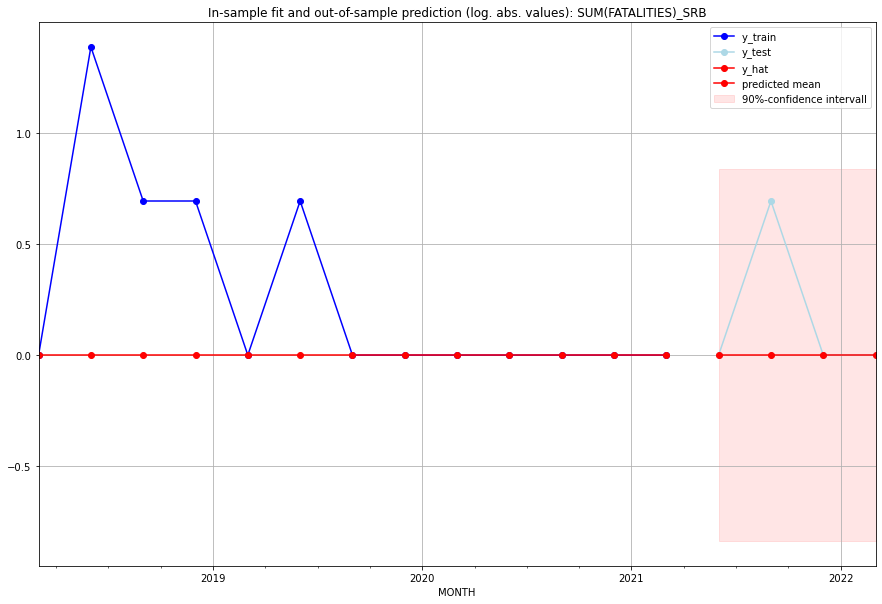

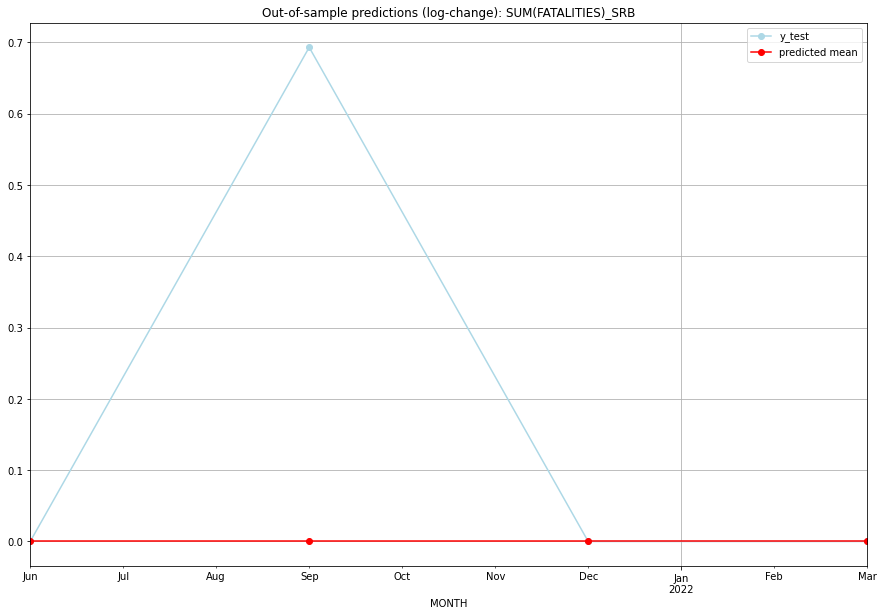

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   SRB   
1 2021-07-01       0.0         1.0           0.0        0.693147   SRB   
2 2021-10-01       0.0         0.0           0.0        0.000000   SRB   
3 2022-01-01       0.0         0.0           0.0        0.000000   SRB   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## SSD (190/234) #########
0
Neighbor countries: ['CAF', 'COD', 'ETH', 'SDN', 'XAR', 'UGA', 'KEN', 'XIT', 'XKK']
Getting Data for SSD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 72)
y: (100, 1)
------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5659082361000781, 'fold_results': [0.554304408866142, 0.17089233394355263, 1.002505250769245, 0.394298130331723, 0.7075410565897278]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SSD   No. Observations:                   96
Model:                SARIMAX(1, 1, 0)   Log Likelihood                -142.618
Date:                 Wed, 19 Oct 2022   AIC                            293.237
Time:                         10:54:59   BIC                            303.452
Sample:                     04-30-1997   HQIC                           297.365
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

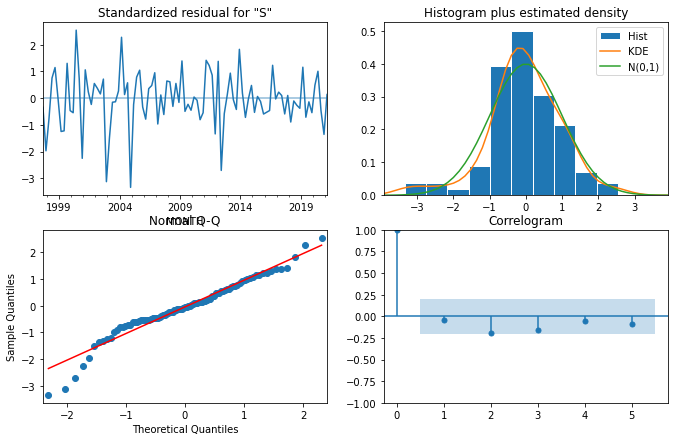

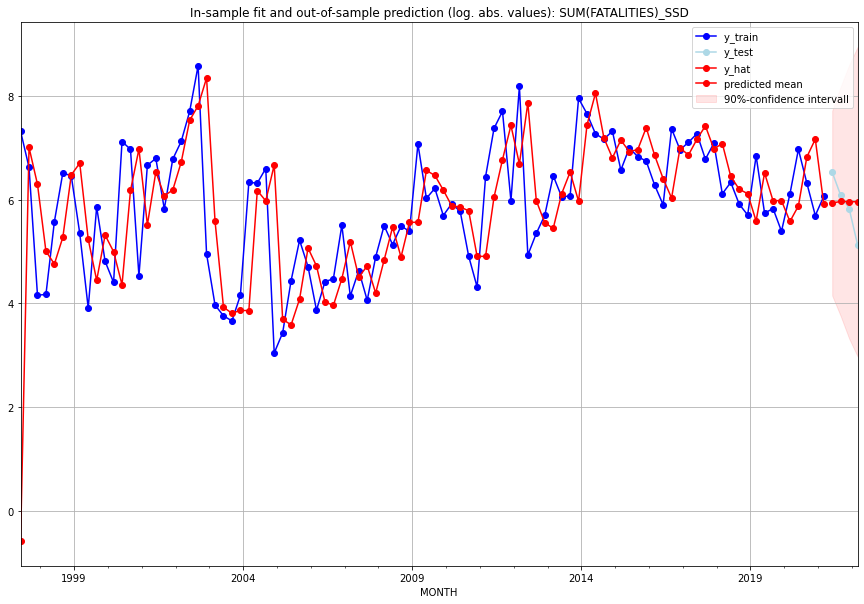

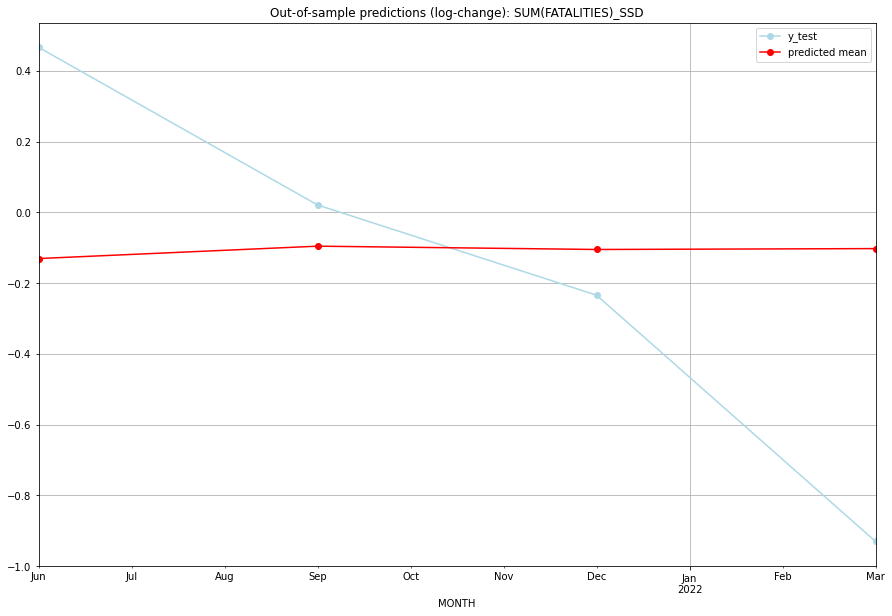

TADDA: 0.47416576009570743
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  377.185789       686.0     -0.130723        0.466226   SSD   
1 2021-07-01  390.646180       439.0     -0.095749        0.020667   SSD   
2 2021-10-01  386.998764       340.0     -0.105106       -0.234226   SSD   
3 2022-01-01  387.971245       169.0     -0.102603       -0.930310   SSD   

                                          PARAMETERS  
0  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## STP (191/234) #########
0
Neighbor countries: []
Getting Data for STP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV o

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_STP   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 118.056
Date:                 Wed, 19 Oct 2022   AIC                           -234.112
Time:                         10:55:15   BIC                           -231.547
Sample:                     04-30-1997   HQIC                          -233.075
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0050      0.000     47.749      0.000     

<Figure size 432x288 with 0 Axes>

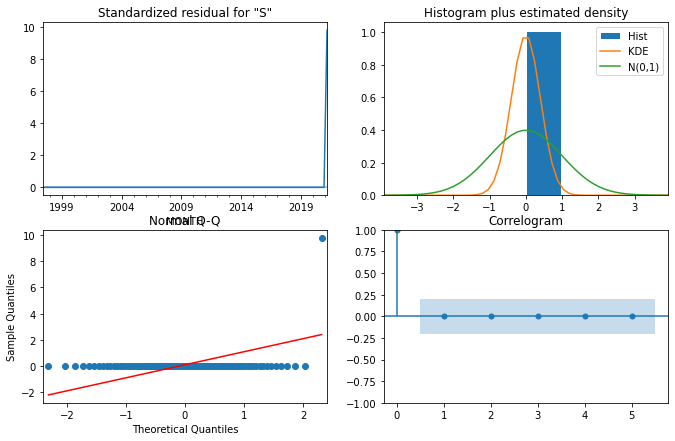

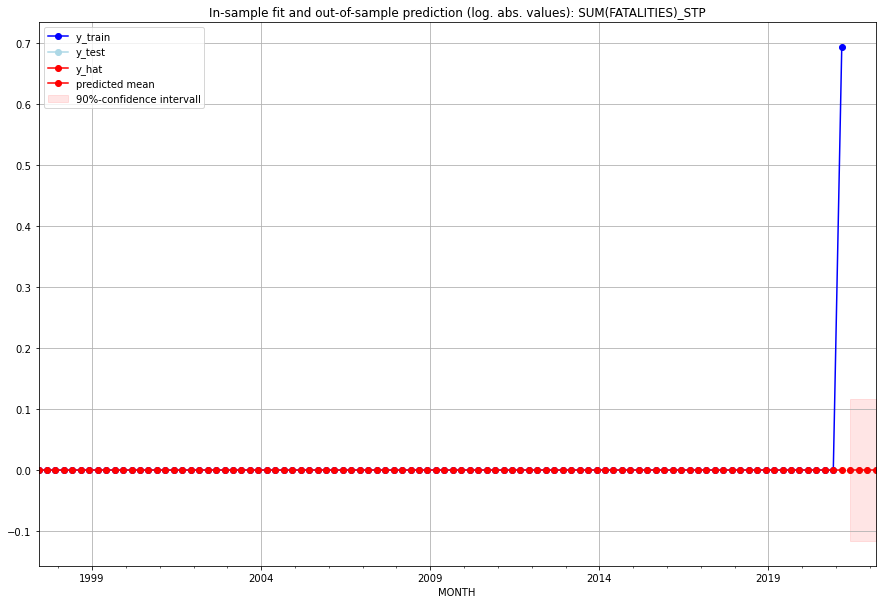

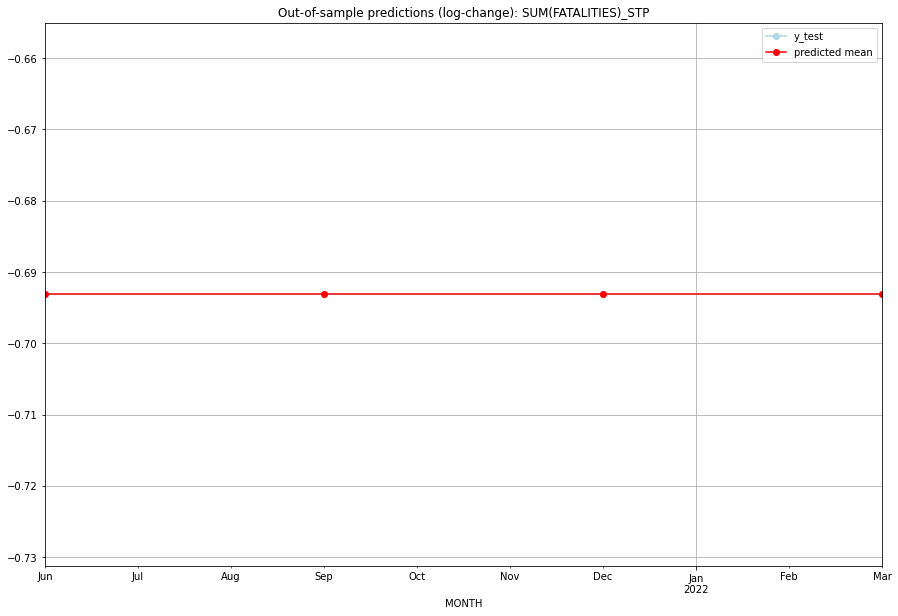

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -0.693147       -0.693147   STP   
1 2021-07-01       0.0         0.0     -0.693147       -0.693147   STP   
2 2021-10-01       0.0         0.0     -0.693147       -0.693147   STP   
3 2022-01-01       0.0         0.0     -0.693147       -0.693147   STP   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## SUR (192/234) #########
0
Neighbor countries: ['GUF', 'GUY', 'BRA']
Getting Data for SUR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5198603854199589, 'fold_results': [0.8664339756999315, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SUR   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                 -11.976
Date:                 Wed, 19 Oct 2022   AIC                             25.952
Time:                         10:55:23   BIC                             26.517
Sample:                     01-31-2018   HQIC                            25.836
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3696      0

<Figure size 432x288 with 0 Axes>

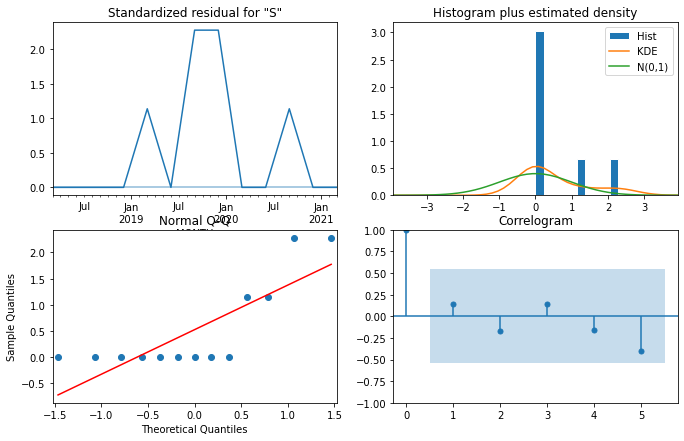

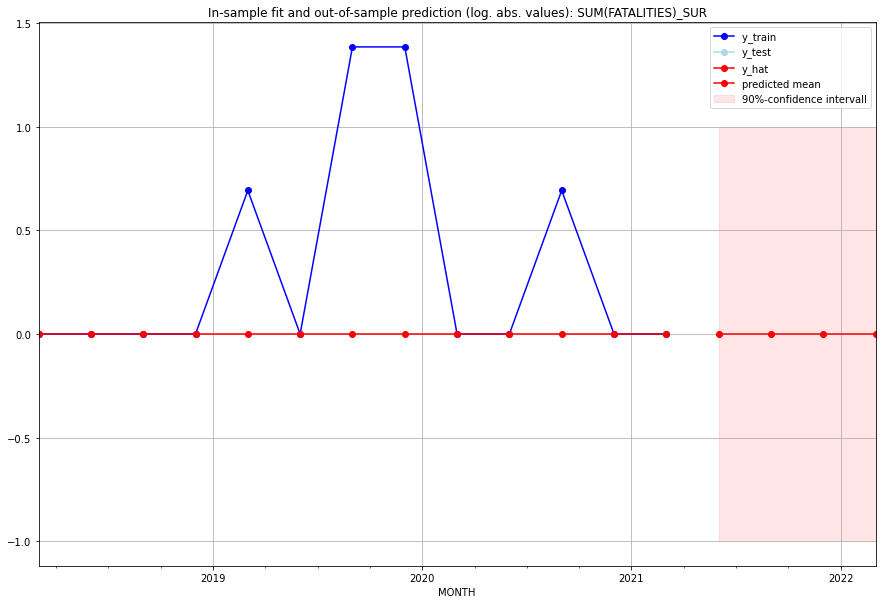

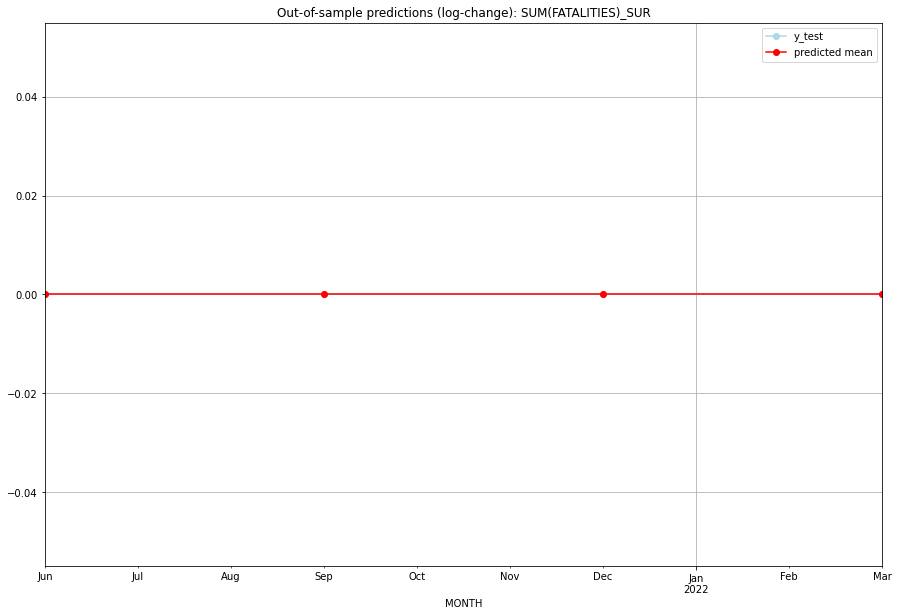

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SUR   
1 2021-07-01       0.0         0.0           0.0             0.0   SUR   
2 2021-10-01       0.0         0.0           0.0             0.0   SUR   
3 2022-01-01       0.0         0.0           0.0             0.0   SUR   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## SVK (193/234) #########
0
Neighbor countries: ['HUN', 'AUT', 'UKR', 'POL', 'CZE']
Getting Data for SVK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 40)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV fail

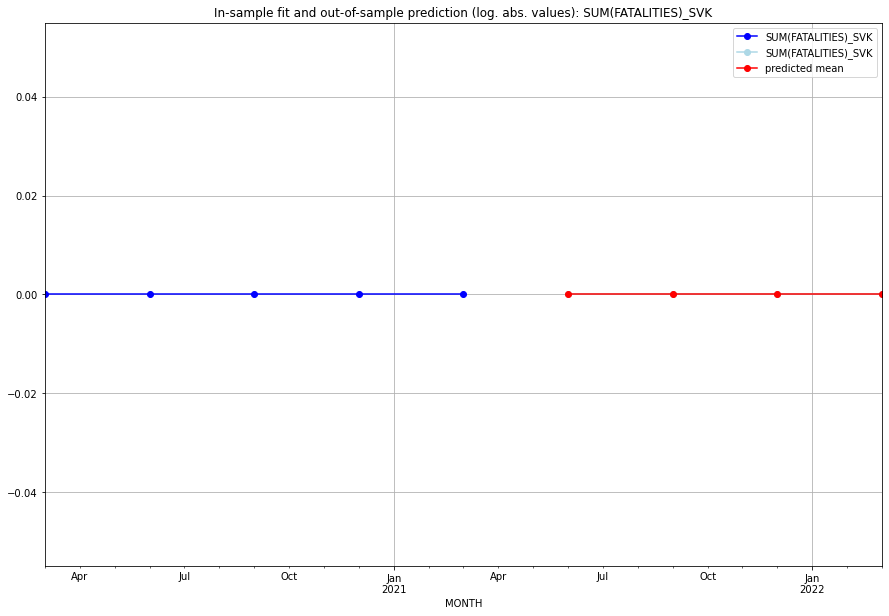

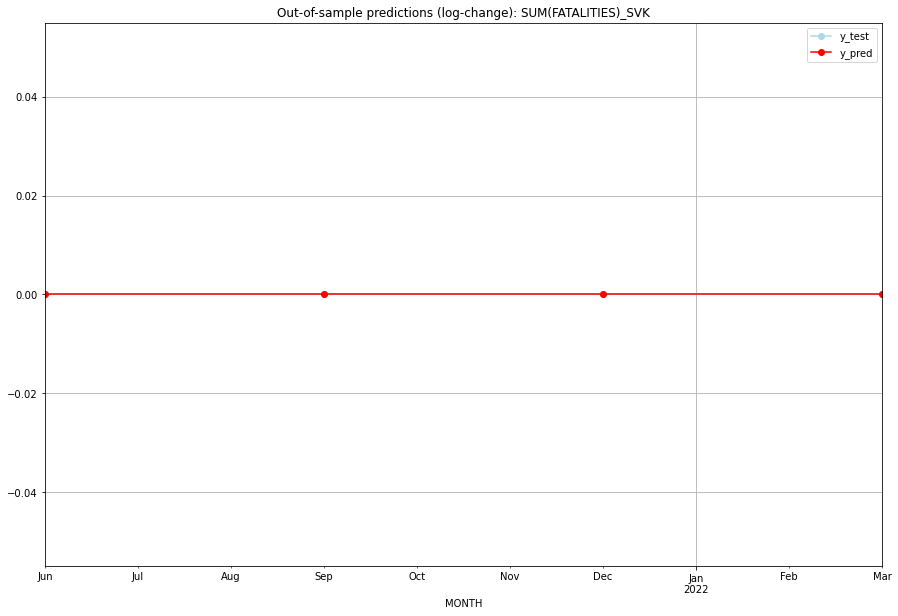

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SVK   
1 2021-07-01       0.0         0.0           0.0             0.0   SVK   
2 2021-10-01       0.0         0.0           0.0             0.0   SVK   
3 2022-01-01       0.0         0.0           0.0             0.0   SVK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## SVN (194/234) #########
0
Neighbor countries: ['AUT', 'HRV', 'ITA', 'HUN']
Getting Data for SVN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 32)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


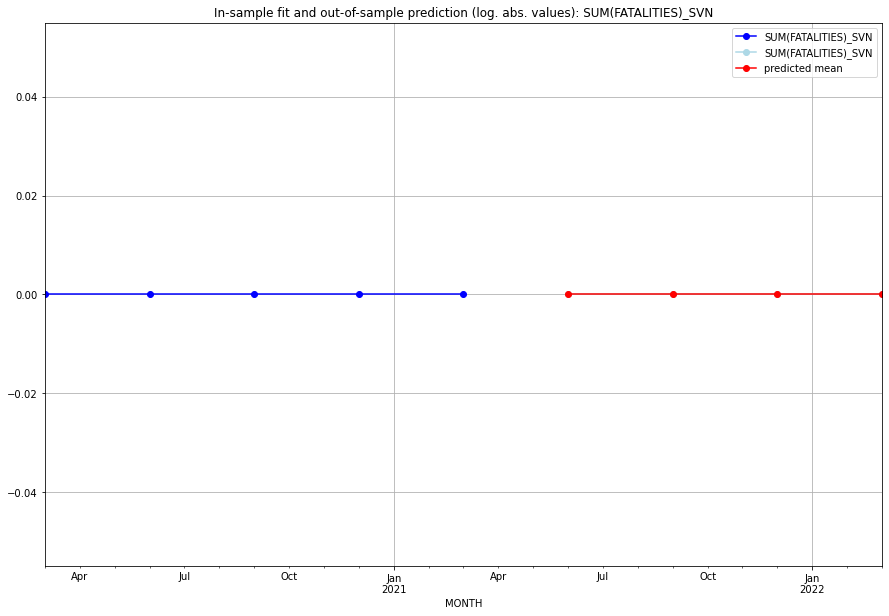

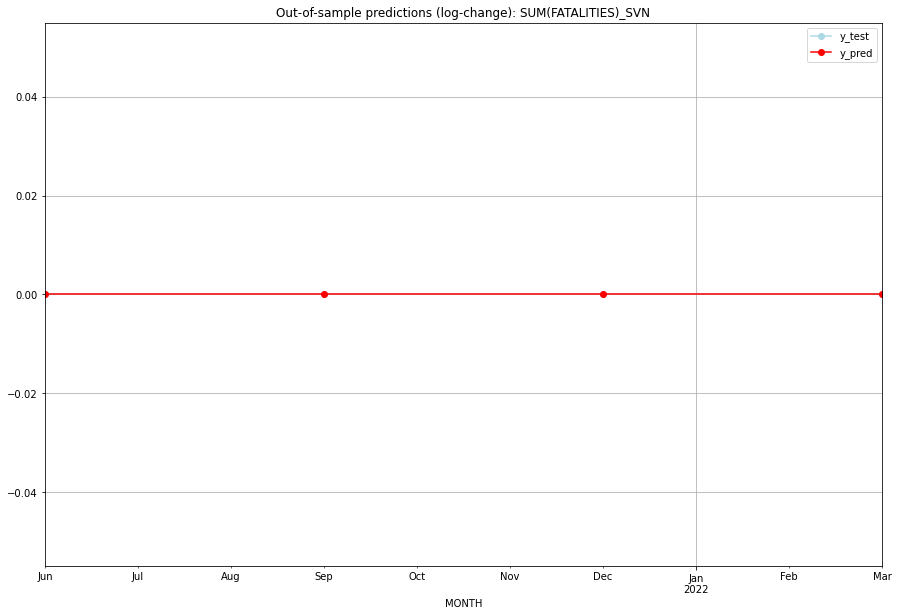

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SVN   
1 2021-07-01       0.0         0.0           0.0             0.0   SVN   
2 2021-10-01       0.0         0.0           0.0             0.0   SVN   
3 2022-01-01       0.0         0.0           0.0             0.0   SVN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## SWE (195/234) #########
0
Neighbor countries: ['FIN', 'NOR']
Getting Data for SWE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 16)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


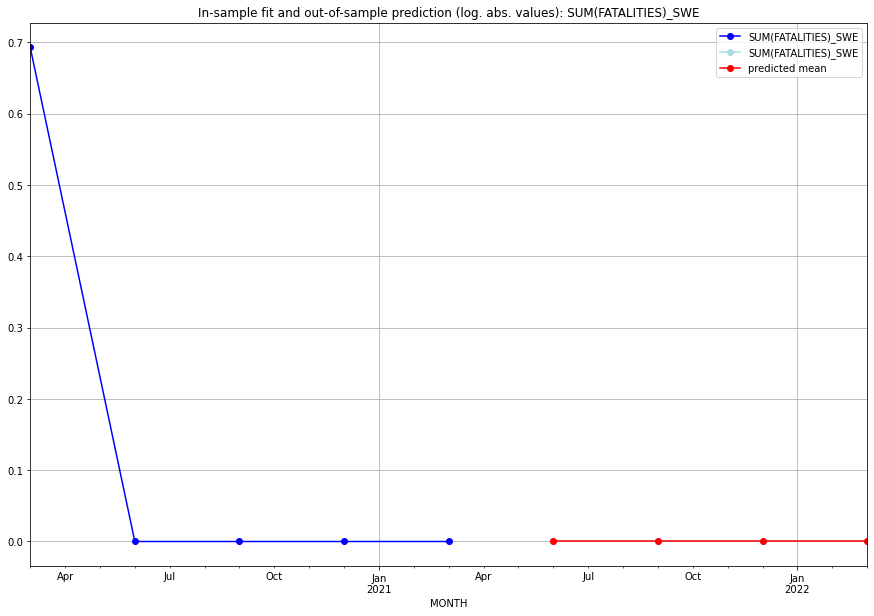

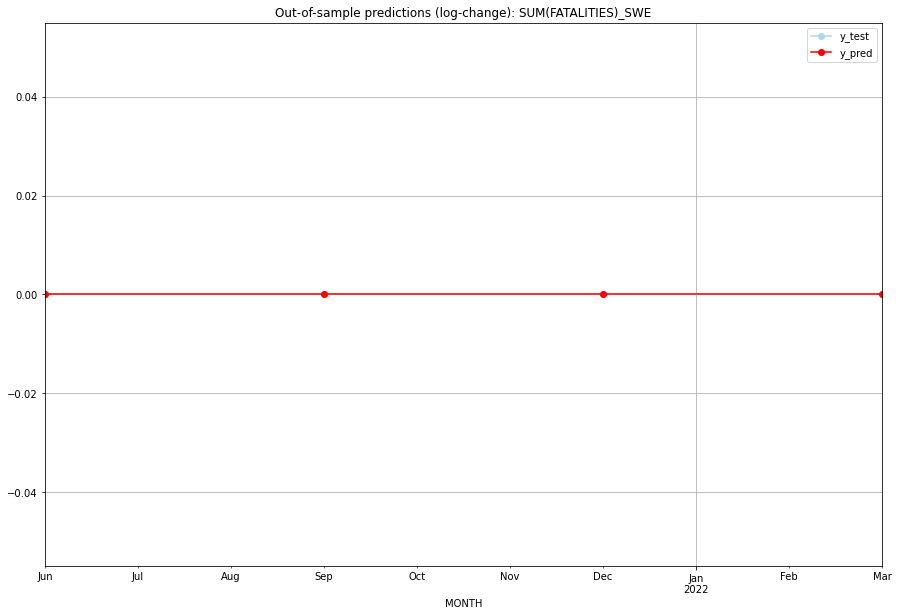

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SWE   
1 2021-07-01       0.0         0.0           0.0             0.0   SWE   
2 2021-10-01       0.0         0.0           0.0             0.0   SWE   
3 2022-01-01       0.0         0.0           0.0             0.0   SWE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## SWZ (196/234) #########
0
Neighbor countries: ['ZAF', 'MOZ']
Getting Data for SWZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 16)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.19356005054539455, 'fold_results': [0.0, 0.0, 0.0, 0.34657359027997264, 0.6212266624470001]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SWZ   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 -46.888
Date:                 Wed, 19 Oct 2022   AIC                             95.776
Time:                         10:56:00   BIC                             98.340
Sample:                     04-30-1997   HQIC                            96.812
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      

<Figure size 432x288 with 0 Axes>

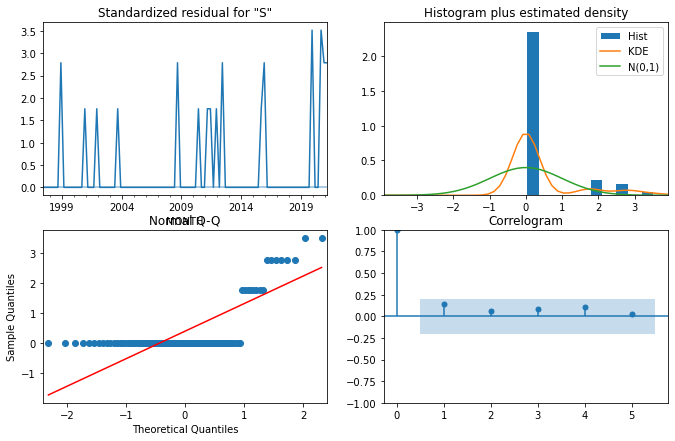

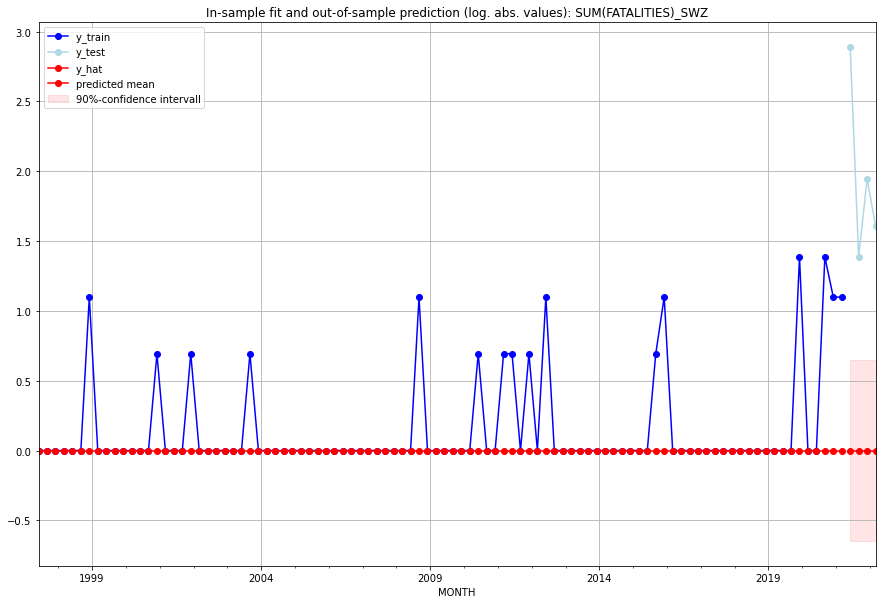

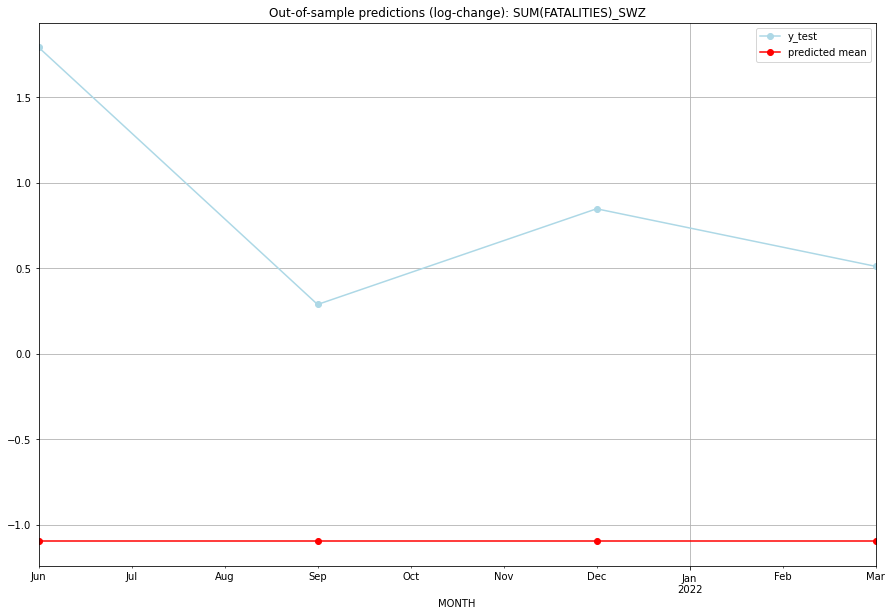

TADDA: 3.056615833794477
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0        17.0     -1.098612        1.791759   SWZ   
1 2021-07-01       0.0         3.0     -1.098612        0.287682   SWZ   
2 2021-10-01       0.0         6.0     -1.098612        0.847298   SWZ   
3 2022-01-01       0.0         4.0     -1.098612        0.510826   SWZ   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:27
######## SXM (197/234) #########
0
Neighbor countries: []
Getting Data for SXM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necess

<Figure size 432x288 with 0 Axes>

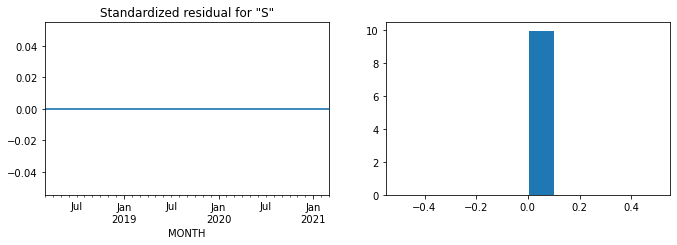

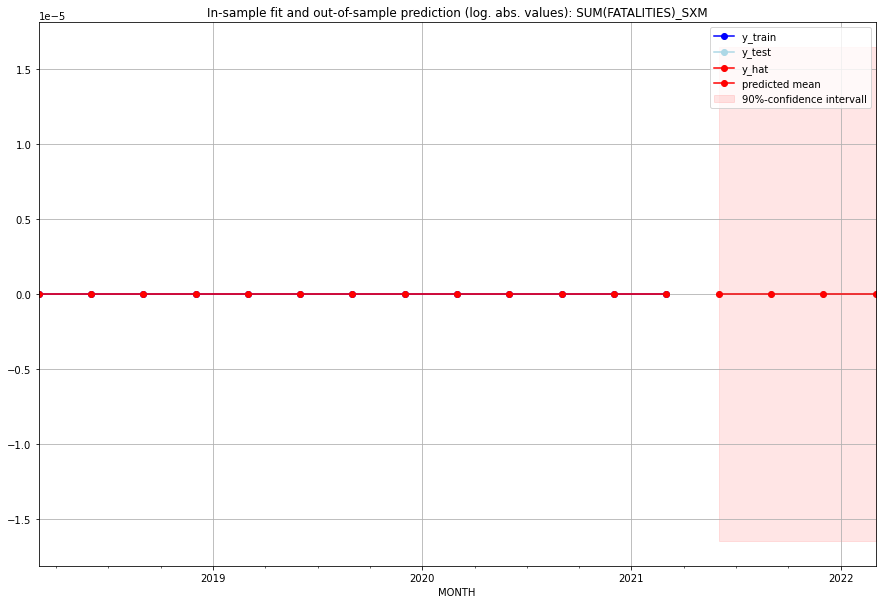

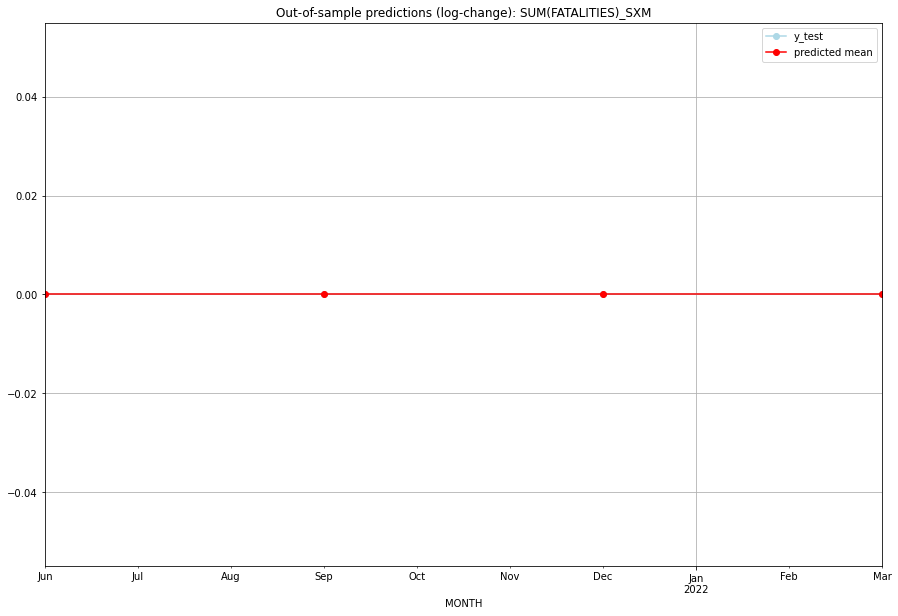

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SXM   
1 2021-07-01       0.0         0.0           0.0             0.0   SXM   
2 2021-10-01       0.0         0.0           0.0             0.0   SXM   
3 2022-01-01       0.0         0.0           0.0             0.0   SXM   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:04
######## SYC (198/234) #########
0
Neighbor countries: []
Getting Data for SYC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SYC   No. Observations:                   96
Model:   

<Figure size 432x288 with 0 Axes>

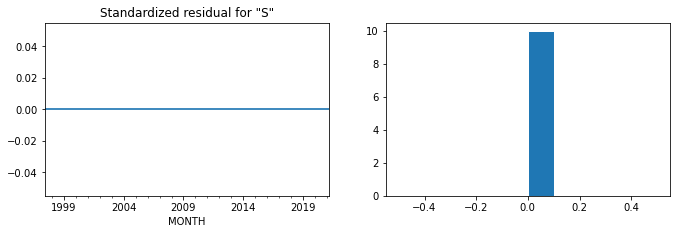

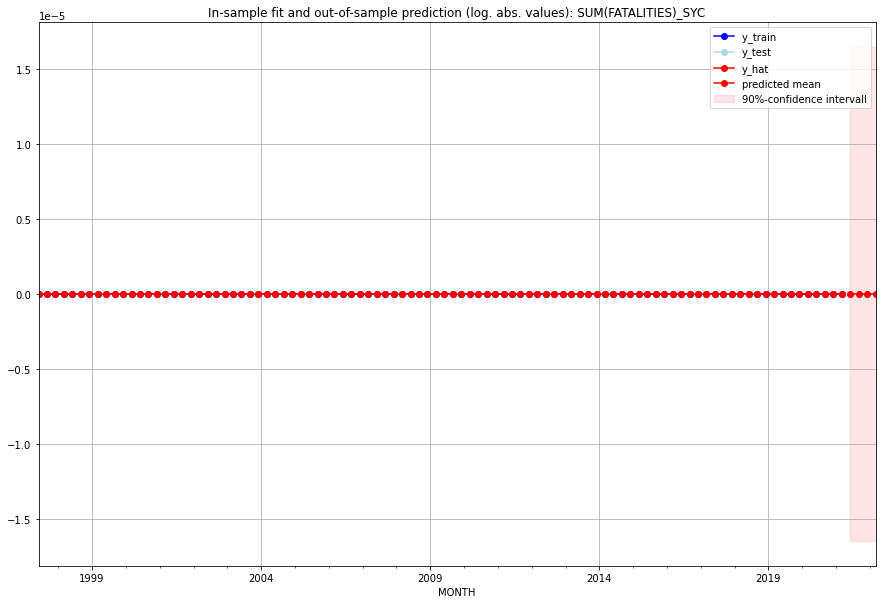

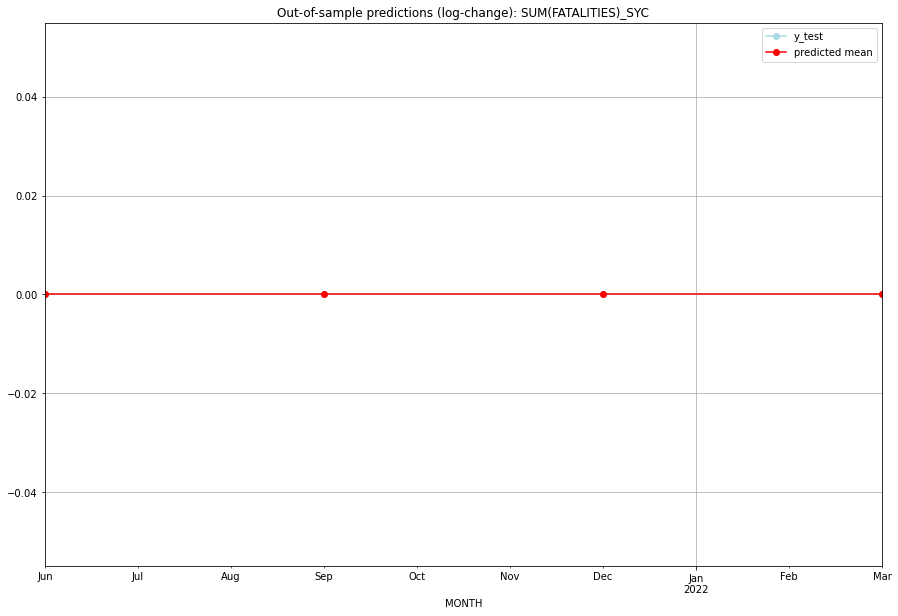

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SYC   
1 2021-07-01       0.0         0.0           0.0             0.0   SYC   
2 2021-10-01       0.0         0.0           0.0             0.0   SYC   
3 2022-01-01       0.0         0.0           0.0             0.0   SYC   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:04
######## SYR (199/234) #########
0
Neighbor countries: ['TUR', 'ISR', 'JOR', 'LBN', 'IRQ']
Getting Data for SYR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 40)
y: (21, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.17586174657916853, 'fold_results': [0.27838798251147123, 0.07333551064686583, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SYR   No. Observations:                   17
Model:                SARIMAX(1, 0, 3)   Log Likelihood                  -3.710
Date:                 Wed, 19 Oct 2022   AIC                             21.420
Time:                         10:56:21   BIC                             27.253
Sample:                     01-31-2017   HQIC                            22.000
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0432

<Figure size 432x288 with 0 Axes>

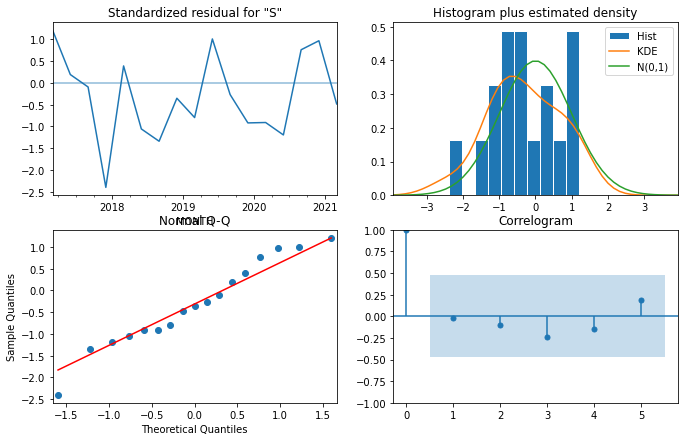

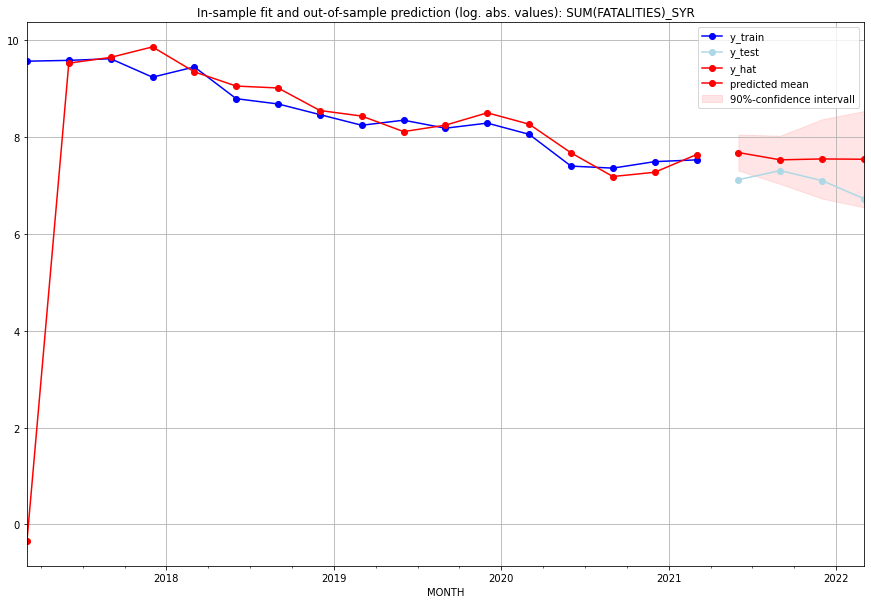

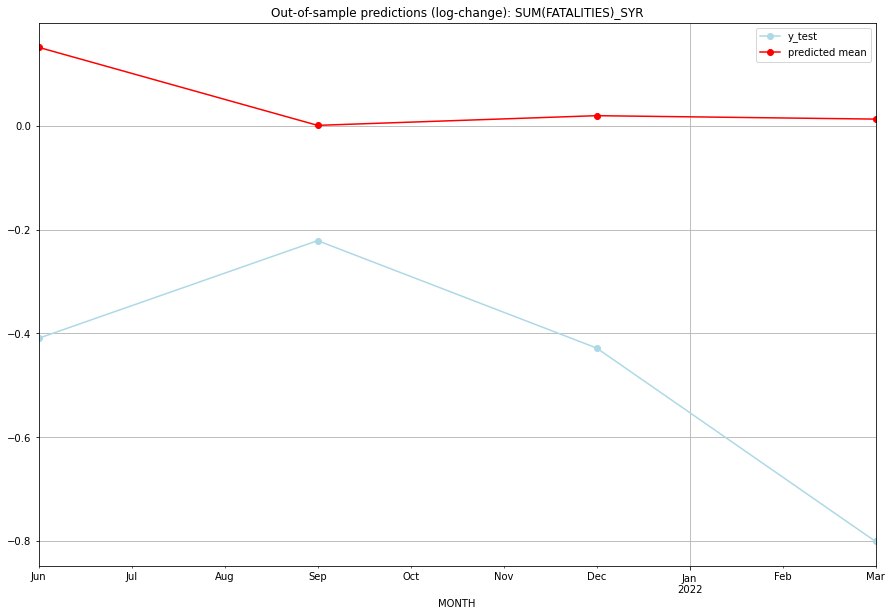

TADDA: 0.5577119582645731
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2172.354582      1239.0      0.151404       -0.409757   SYR   
1 2021-07-01  1868.651482      1496.0      0.000884       -0.221405   SYR   
2 2021-10-01  1903.888582      1216.0      0.019555       -0.428480   SYR   
3 2022-01-01  1891.362848       837.0      0.012958       -0.801606   SYR   

                                          PARAMETERS  
0  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## TCA (200/234) #########
0
Neighbor countries: []
Getting Data for TCA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero

<Figure size 432x288 with 0 Axes>

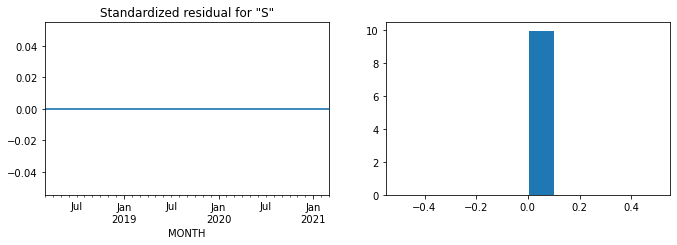

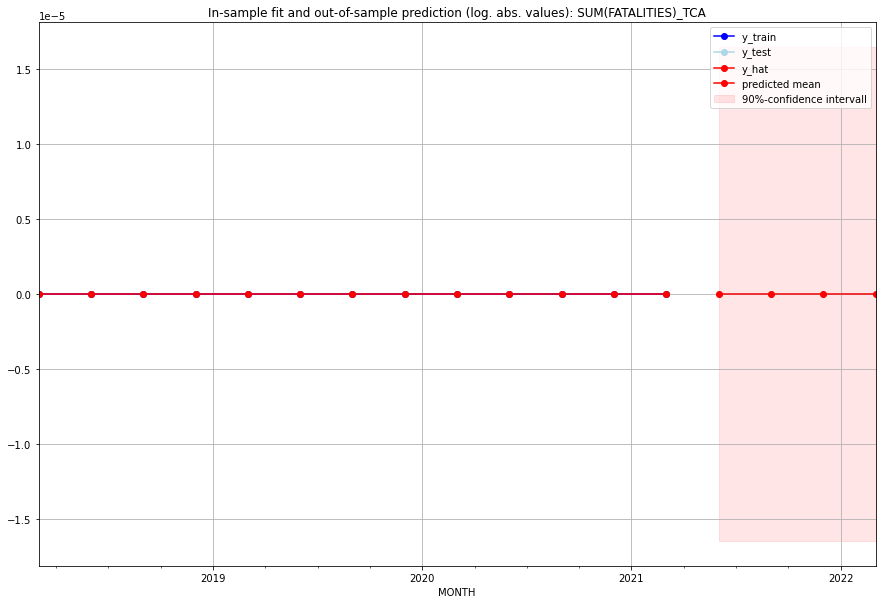

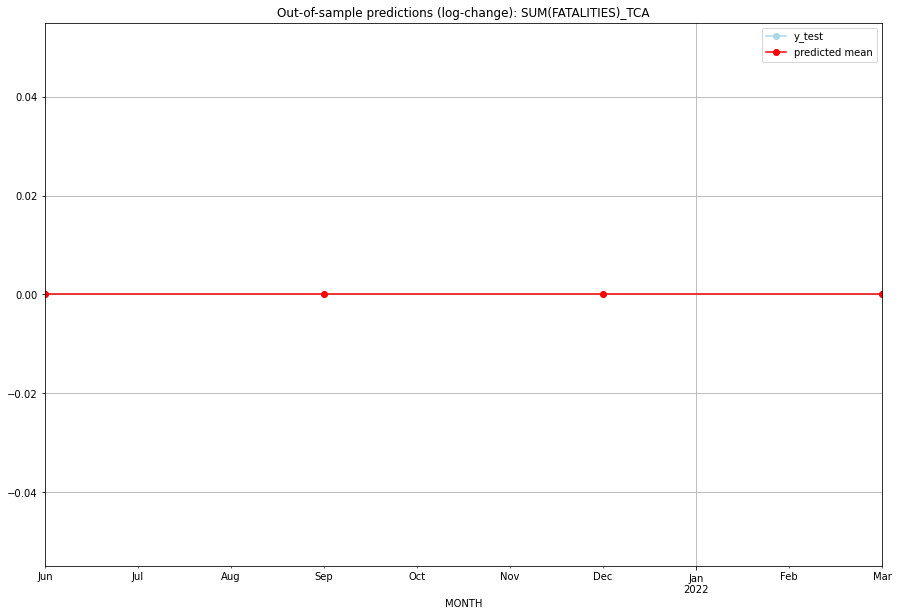

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   TCA   
1 2021-07-01       0.0         0.0           0.0             0.0   TCA   
2 2021-10-01       0.0         0.0           0.0             0.0   TCA   
3 2022-01-01       0.0         0.0           0.0             0.0   TCA   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## TCD (201/234) #########
0
Neighbor countries: ['CMR', 'NER', 'NGA', 'CAF', 'SDN', 'LBY']
Getting Data for TCD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 48)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.0675098720288256, 'fold_results': [1.5619309131620107, 1.08693605080315, 0.8516550618945109, 1.2347287952119501, 0.6022985390725057]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TCD   No. Observations:                   96
Model:                SARIMAX(0, 1, 1)   Log Likelihood                -193.016
Date:                 Wed, 19 Oct 2022   AIC                            392.032
Time:                         10:56:45   BIC                            399.694
Sample:                     04-30-1997   HQIC                           395.128
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

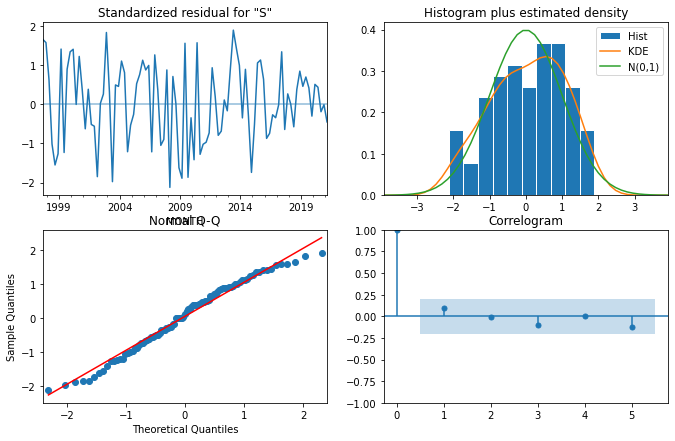

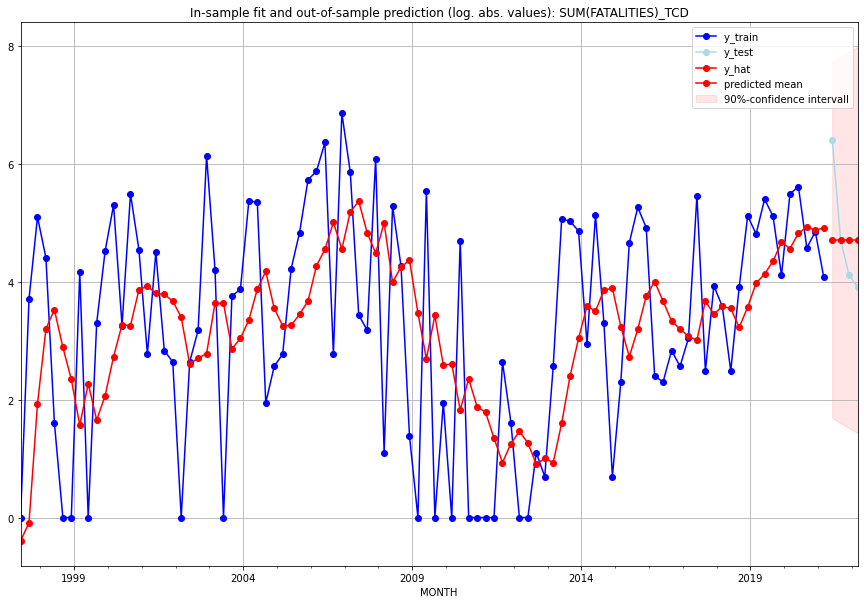

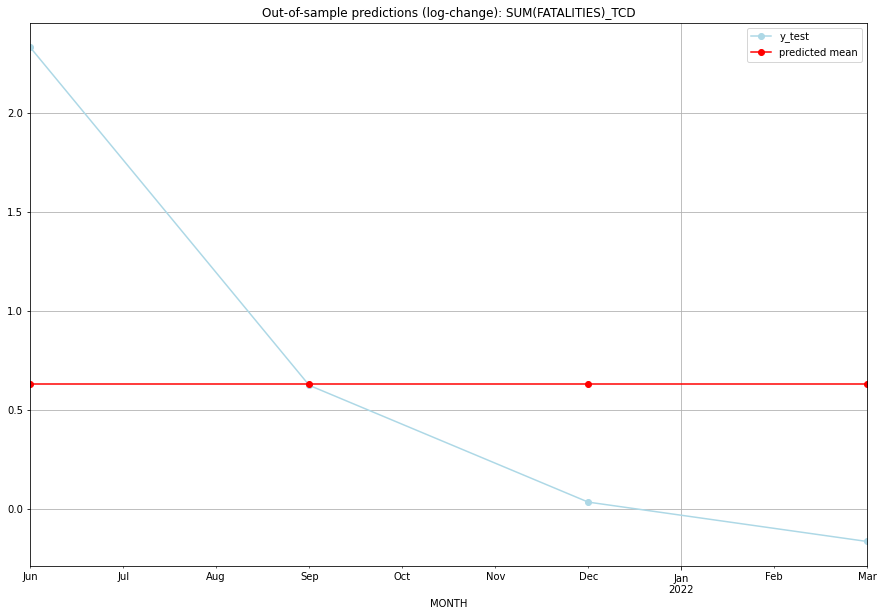

TADDA: 0.9332915540858217
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  109.948593       605.0       0.63153        2.329343   TCD   
1 2021-07-01  109.948593       109.0       0.63153        0.622943   TCD   
2 2021-10-01  109.948593        60.0       0.63153        0.033336   TCD   
3 2022-01-01  109.948593        49.0       0.63153       -0.165514   TCD   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## TGO (202/234) #########
0
Neighbor countries: ['BEN', 'GHA', 'BFA']
Getting Data for TGO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
St

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.857530025490975, 'fold_results': [0.43863762536183826, 1.8381102750608957, 0.5766834773992344, 0.885775309062495, 0.548443440570412]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TGO   No. Observations:                   96
Model:                SARIMAX(2, 0, 2)   Log Likelihood                -117.066
Date:                 Wed, 19 Oct 2022   AIC                            250.132
Time:                         10:57:01   BIC                            270.647
Sample:                     04-30-1997   HQIC                           258.425
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

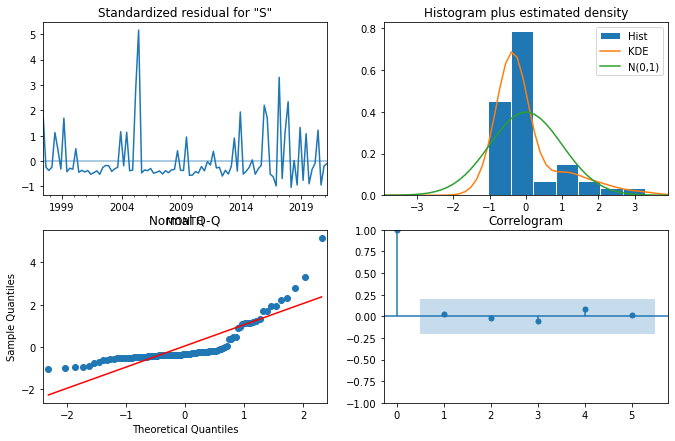

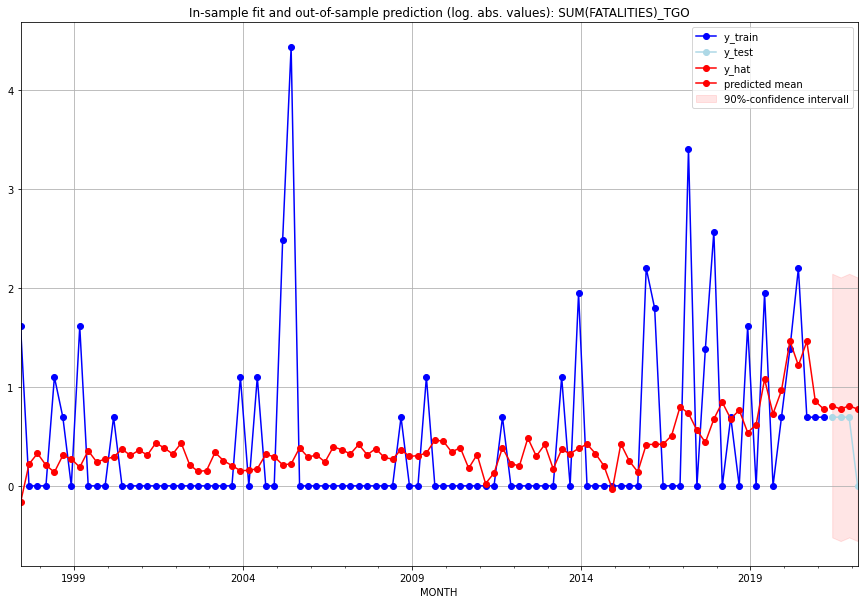

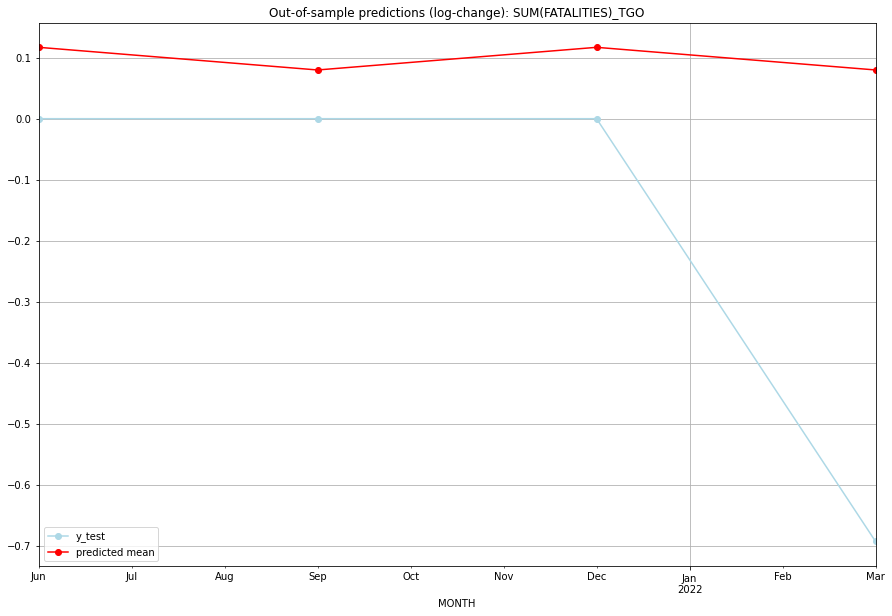

TADDA: 0.2916850198779127
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.248266         1.0      0.117012        0.000000   TGO   
1 2021-07-01  1.166245         1.0      0.079848        0.000000   TGO   
2 2021-10-01  1.248207         1.0      0.116986        0.000000   TGO   
3 2022-01-01  1.166300         0.0      0.079874       -0.693147   TGO   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## THA (203/234) #########
0
Neighbor countries: ['MMR', 'LAO', 'MYS', 'KHM']
Getting Data for THA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 32)
y: (49, 1)
------------------------------------------------
Training started.
Start G

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5234691279465912, 'fold_results': [0.16990269279311543, 0.3254937513396886, 1.1812826796423839, 0.11721505000145105, 0.8234514659563166]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_THA   No. Observations:                   45
Model:                SARIMAX(1, 1, 1)   Log Likelihood                 -25.686
Date:                 Wed, 19 Oct 2022   AIC                             59.371
Time:                         10:57:22   BIC                             66.508
Sample:                     01-31-2010   HQIC                            62.018
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

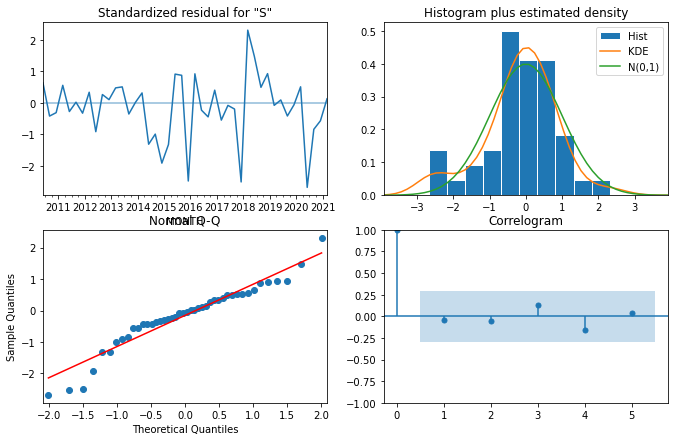

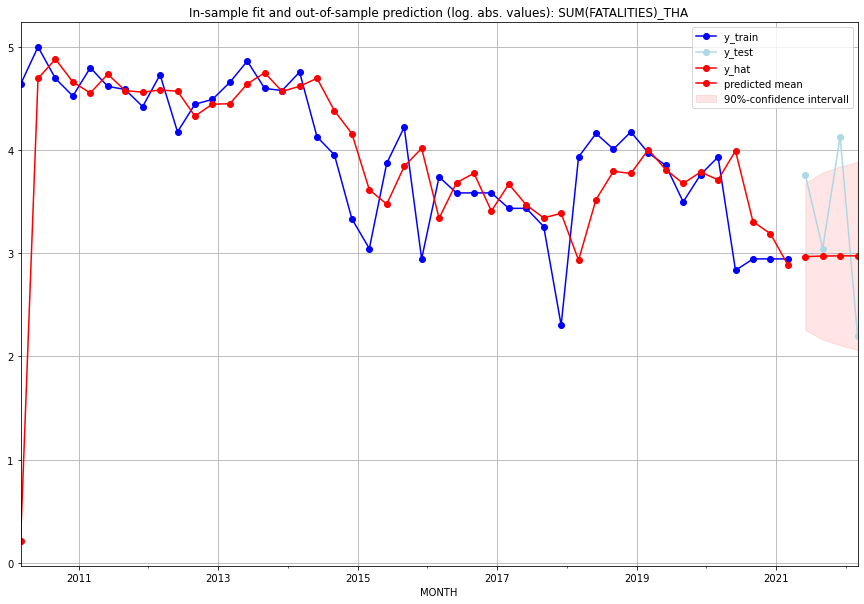

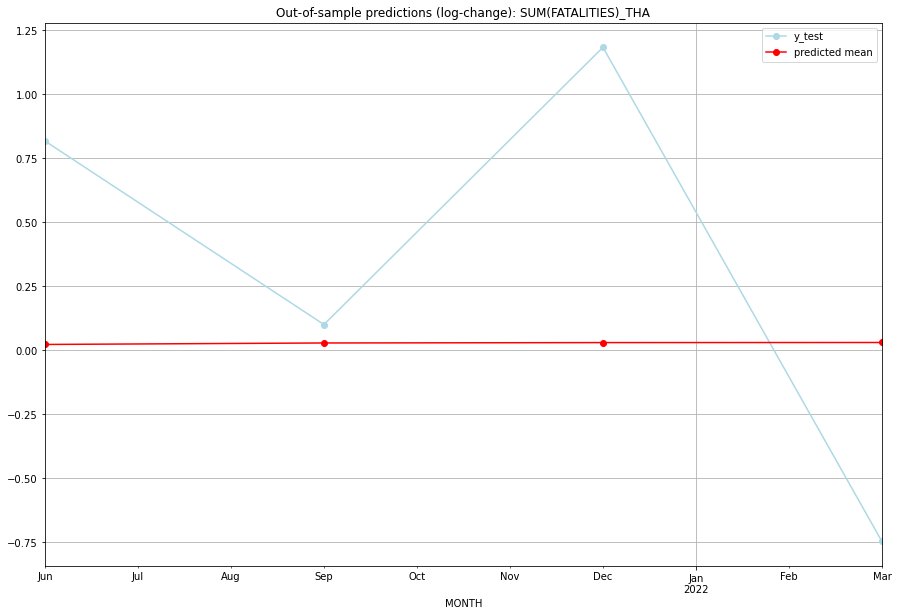

TADDA: 0.7066859851765648
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  18.427915        42.0      0.022272        0.816761   THA   
1 2021-07-01  18.540171        20.0      0.028033        0.100083   THA   
2 2021-10-01  18.569316        61.0      0.029524        1.182695   THA   
3 2022-01-01  18.576862         8.0      0.029909       -0.747214   THA   

                                          PARAMETERS  
0  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## TJK (204/234) #########
0
Neighbor countries: ['AFG', 'CHN', 'KGZ', 'UZB']
Getting Data for TJK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 32)
y: (17, 1)
------------------------------------------------
Training started.
St

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6389717013810744, 'fold_results': [0.6389717013810744, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TJK   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -22.885
Date:                 Wed, 19 Oct 2022   AIC                             55.771
Time:                         10:57:33   BIC                             58.596
Sample:                     01-31-2018   HQIC                            55.190
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.2610      0.358     -0.728 

<Figure size 432x288 with 0 Axes>

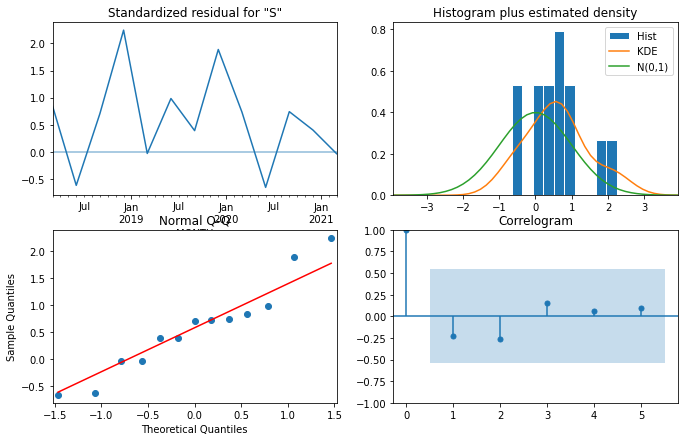

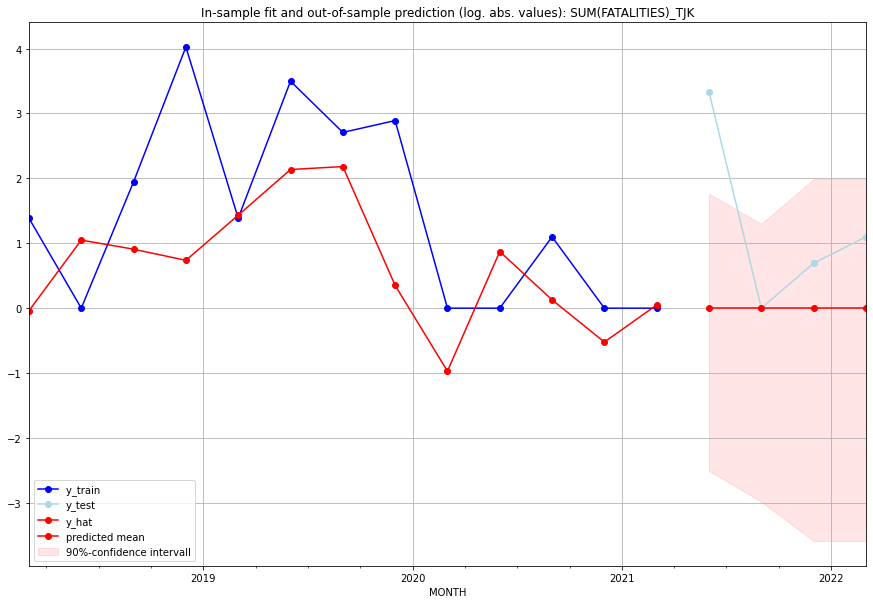

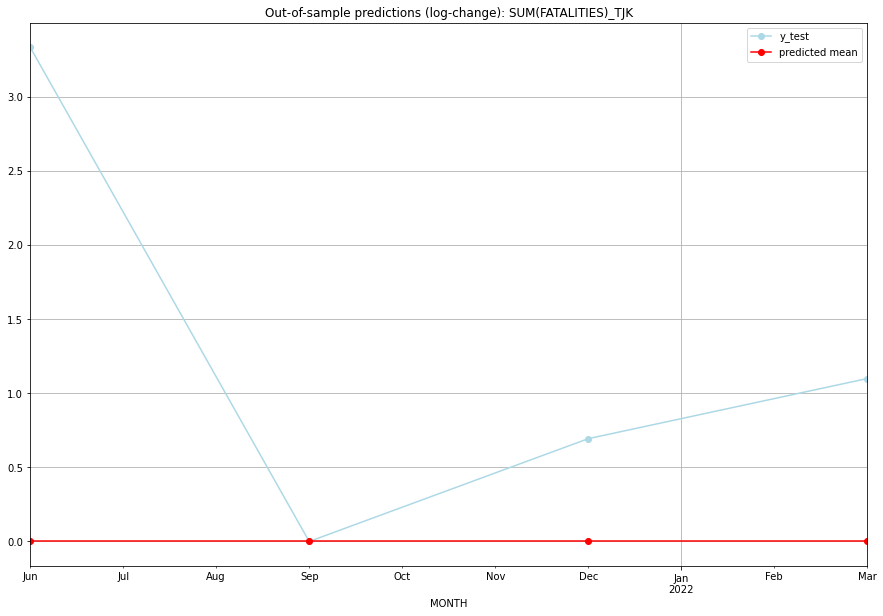

TADDA: 1.2809909948508147
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0        27.0           0.0        3.332205   TJK   
1 2021-07-01       0.0         0.0           0.0        0.000000   TJK   
2 2021-10-01       0.0         1.0           0.0        0.693147   TJK   
3 2022-01-01       0.0         2.0           0.0        1.098612   TJK   

                                          PARAMETERS  
0  {'params': [2, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## TKM (205/234) #########
0
Neighbor countries: ['AFG', 'IRN', 'KAZ', 'UZB']
Getting Data for TKM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 32)
y: (17, 1)
------------------------------------------------
Training started.
Start G

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.26674757909451025, 'fold_results': [0.36020836304903414, 0.17328679513998632]}
Retraining model failed.
No model fitted --> Prediction with Naive Model 


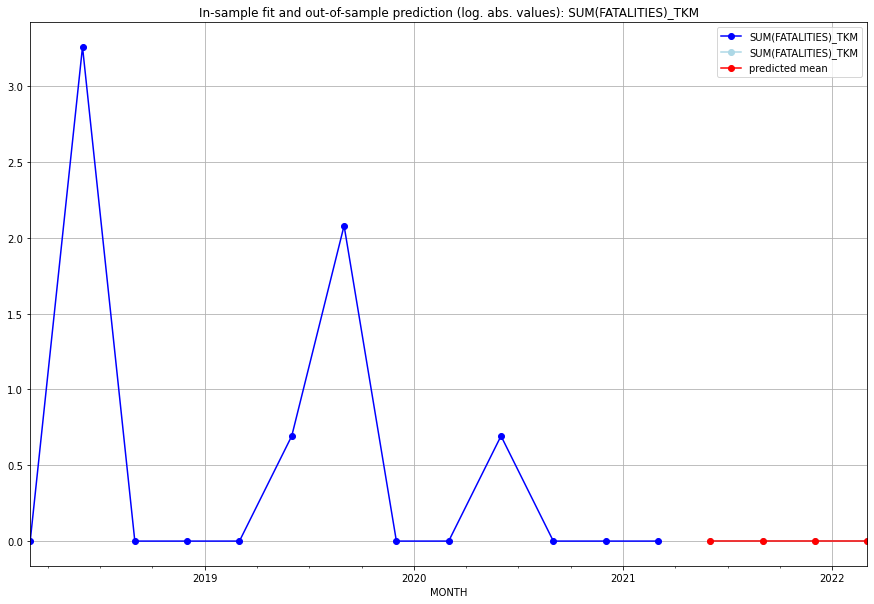

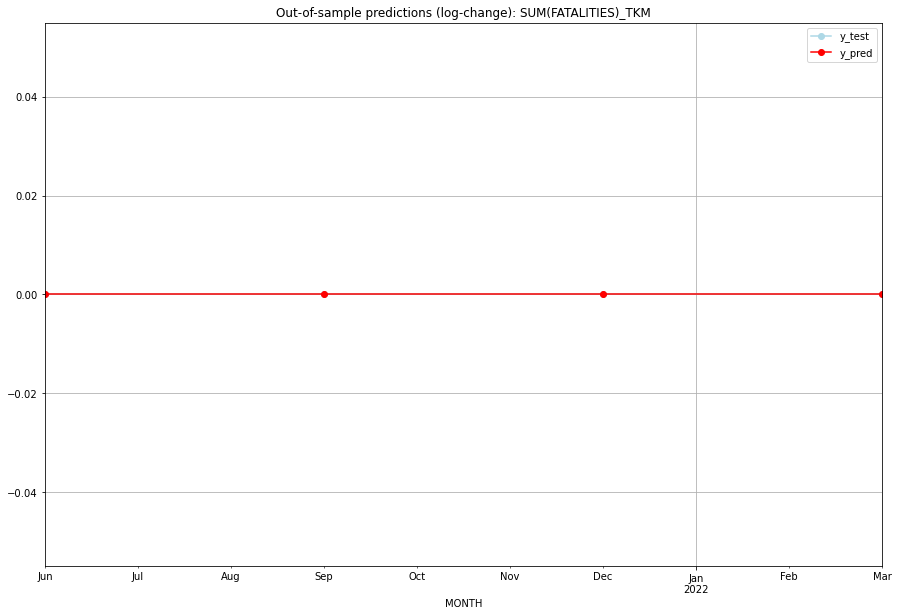

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   TKM   
1 2021-07-01       0.0         0.0           0.0             0.0   TKM   
2 2021-10-01       0.0         0.0           0.0             0.0   TKM   
3 2022-01-01       0.0         0.0           0.0             0.0   TKM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:07
######## TLS (206/234) #########
0
Neighbor countries: ['IDN']
Getting Data for TLS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 8)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TLS   No. Observations:                   96

<Figure size 432x288 with 0 Axes>

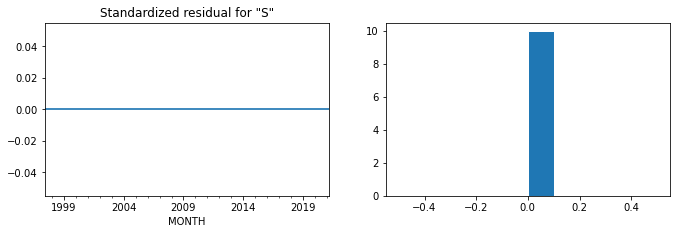

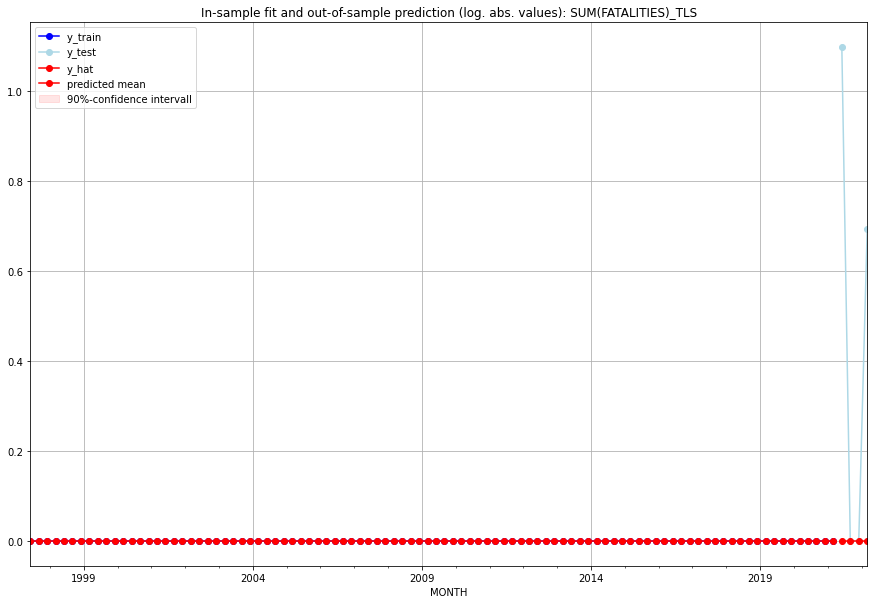

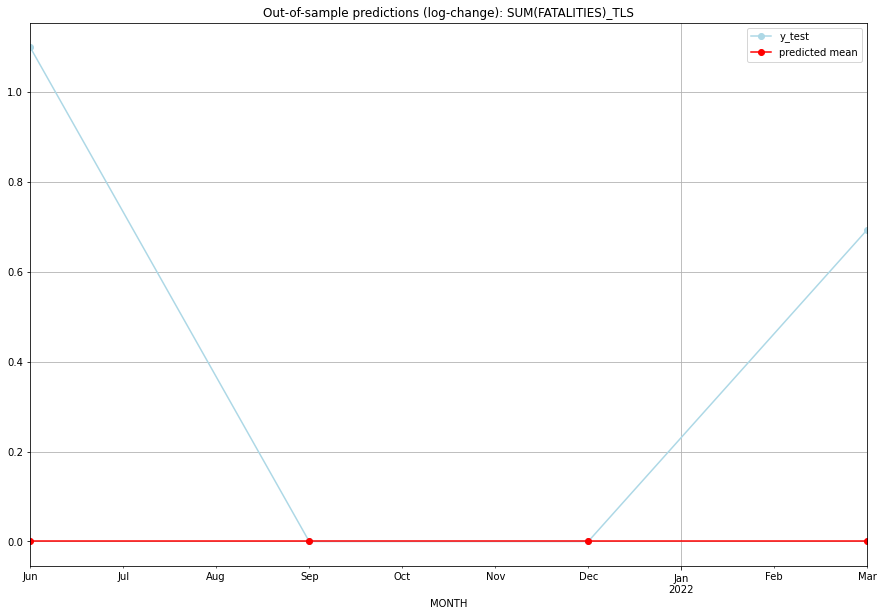

TADDA: 0.44793986730701374
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         2.0           0.0        1.098612   TLS   
1 2021-07-01       0.0         0.0           0.0        0.000000   TLS   
2 2021-10-01       0.0         0.0           0.0        0.000000   TLS   
3 2022-01-01       0.0         1.0           0.0        0.693147   TLS   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:01
######## TON (207/234) #########
0
Neighbor countries: []
Getting Data for TON
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


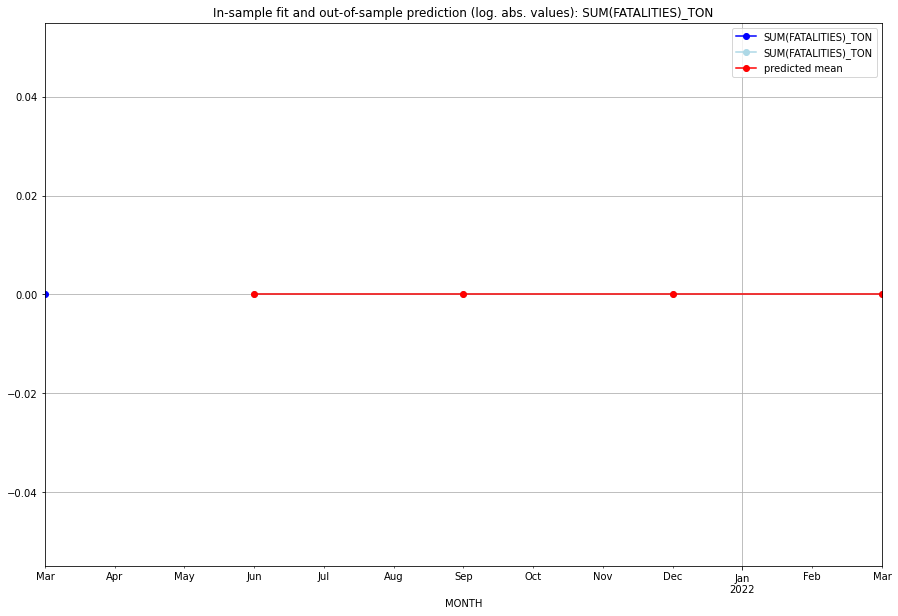

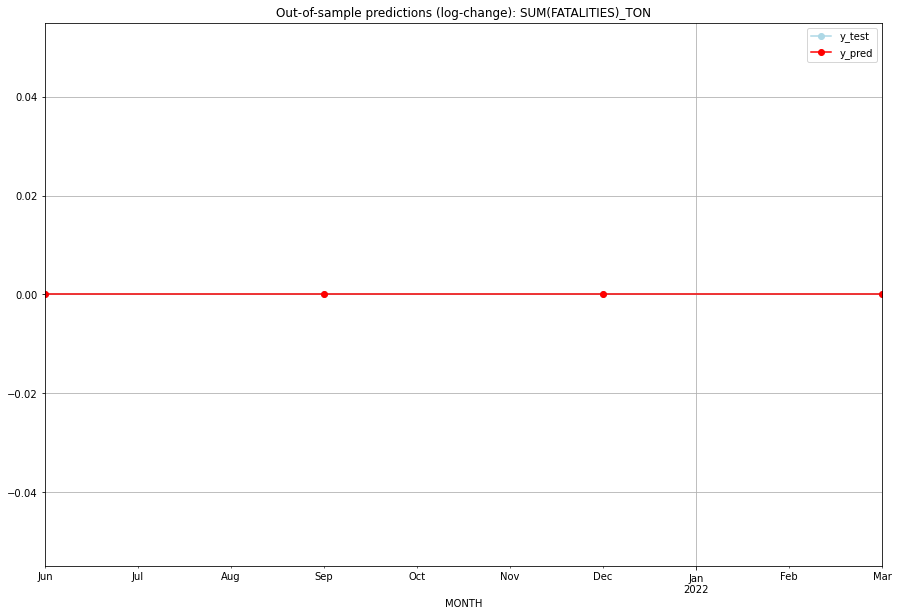

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   TON   
1 2021-07-01       0.0         0.0           0.0             0.0   TON   
2 2021-10-01       0.0         0.0           0.0             0.0   TON   
3 2022-01-01       0.0         0.0           0.0             0.0   TON   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## TTO (208/234) #########
0
Neighbor countries: []
Getting Data for TTO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4228812328890954, 'fold_results': [0.26903485820401307, 0.5767276075741777]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TTO   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -11.427
Date:                 Wed, 19 Oct 2022   AIC                             24.853
Time:                         10:57:58   BIC                             25.338
Sample:                     01-31-2018   HQIC                            24.674
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3932      0

<Figure size 432x288 with 0 Axes>

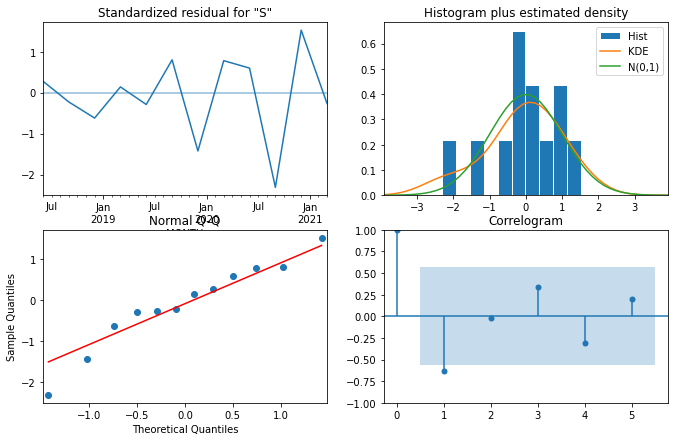

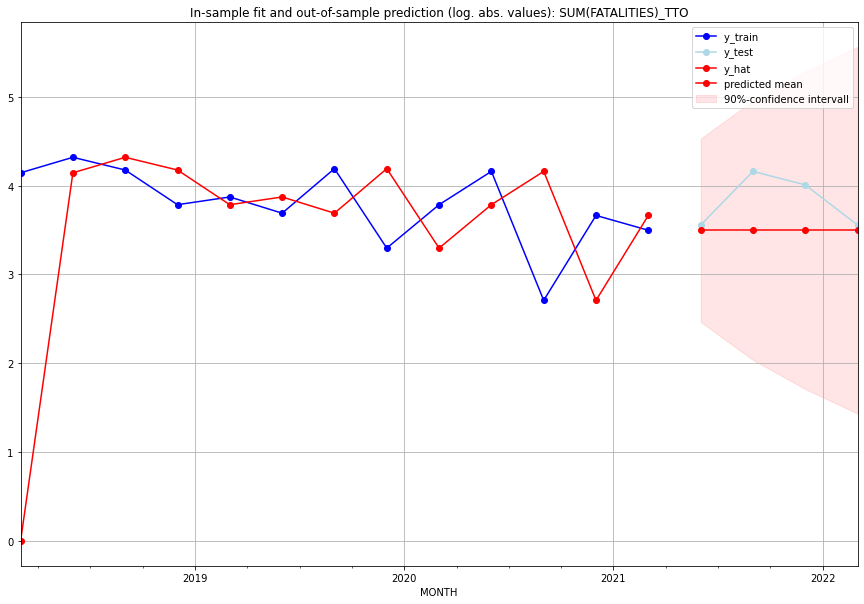

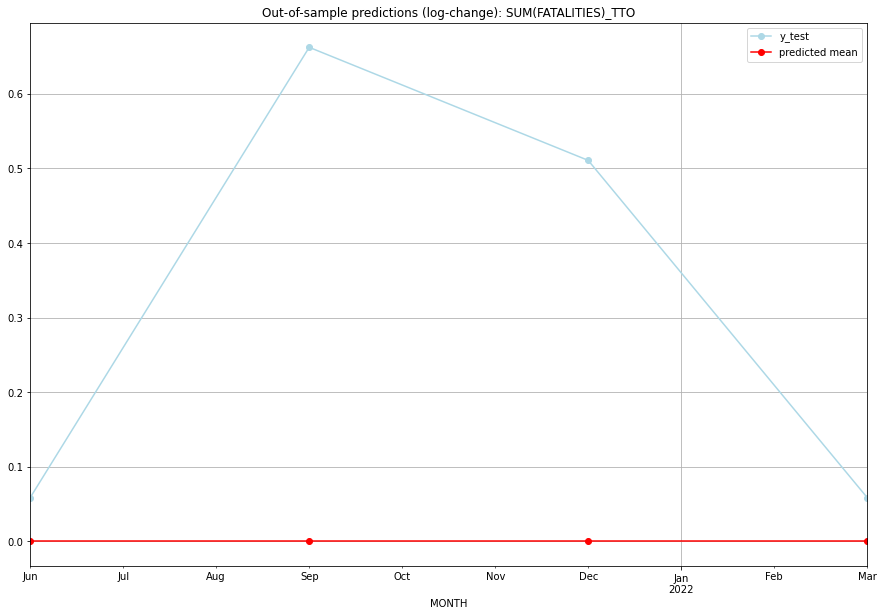

TADDA: 0.32272053642626264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      32.0        34.0           0.0        0.058841   TTO   
1 2021-07-01      32.0        63.0           0.0        0.662376   TTO   
2 2021-10-01      32.0        54.0           0.0        0.510826   TTO   
3 2022-01-01      32.0        34.0           0.0        0.058841   TTO   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## TUN (209/234) #########
0
Neighbor countries: ['DZA', 'LBY', 'ITA']
Getting Data for TUN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDS

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.42243627827504737, 'fold_results': [0.7882012125314662, 0.26047355001465683, 0.37484942476547983, 0.39643913589157204, 0.2922180681720617]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TUN   No. Observations:                   96
Model:                SARIMAX(3, 0, 1)   Log Likelihood                -115.088
Date:                 Wed, 19 Oct 2022   AIC                            246.177
Time:                         10:58:22   BIC                            266.692
Sample:                     04-30-1997   HQIC                           254.469
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------

<Figure size 432x288 with 0 Axes>

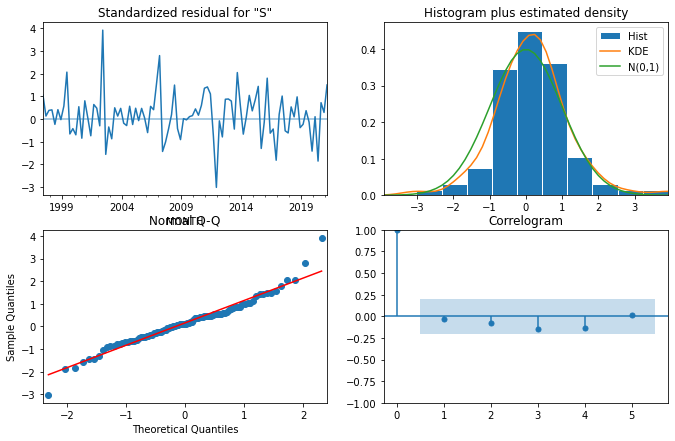

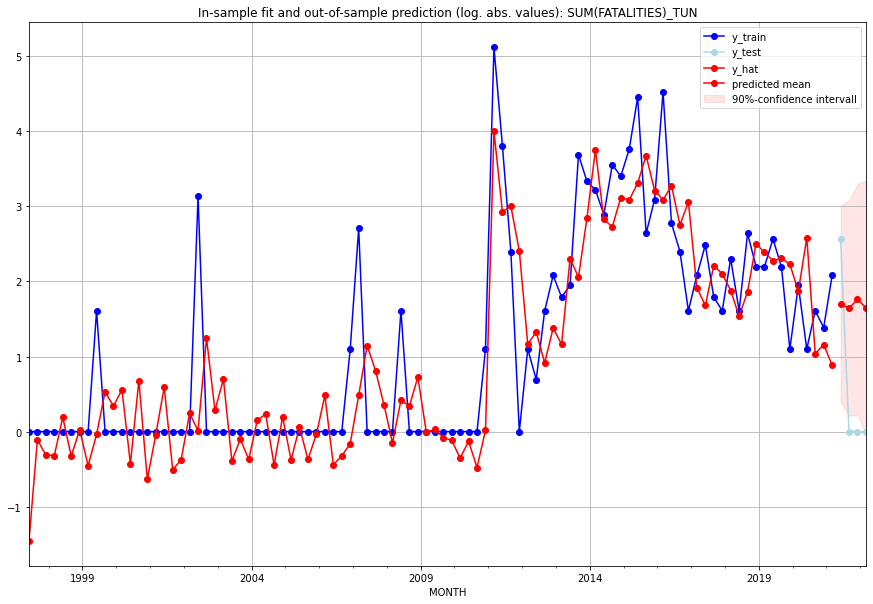

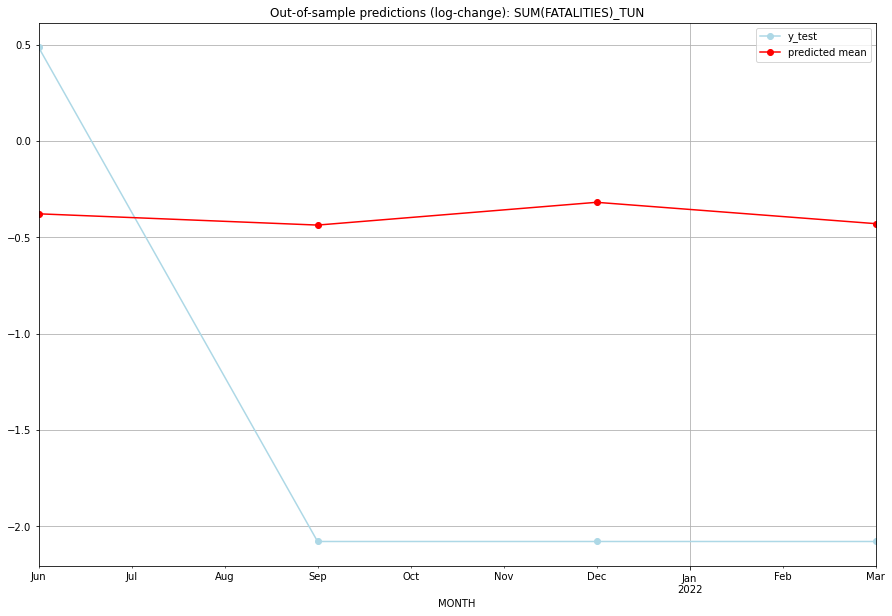

TADDA: 1.573813246118416
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  4.478155        12.0     -0.378673        0.485508   TUN   
1 2021-07-01  4.166808         0.0     -0.437186       -2.079442   TUN   
2 2021-10-01  4.815045         0.0     -0.318993       -2.079442   TUN   
3 2022-01-01  4.205392         0.0     -0.429746       -2.079442   TUN   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## TUR (210/234) #########
0
Neighbor countries: ['GEO', 'BGR', 'GRC', 'SYR', 'IRN', 'IRQ', 'ARM', 'AZE']
Getting Data for TUR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 64)
y: (25, 1)
-----------------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5110683921921817, 'fold_results': [0.3255154083419405, 0.44542819795714994, 0.5605018819547418, 0.7128280805148944]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TUR   No. Observations:                   21
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -23.726
Date:                 Wed, 19 Oct 2022   AIC                             51.451
Time:                         10:58:32   BIC                             53.443
Sample:                     01-31-2016   HQIC                            51.840
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

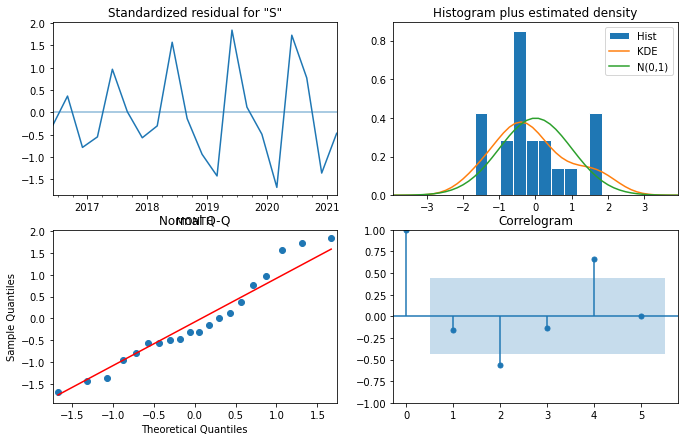

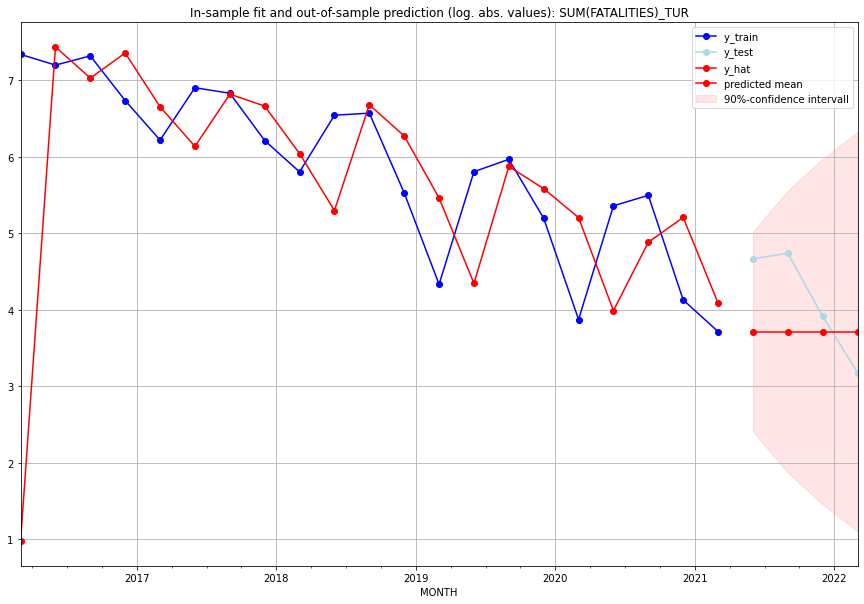

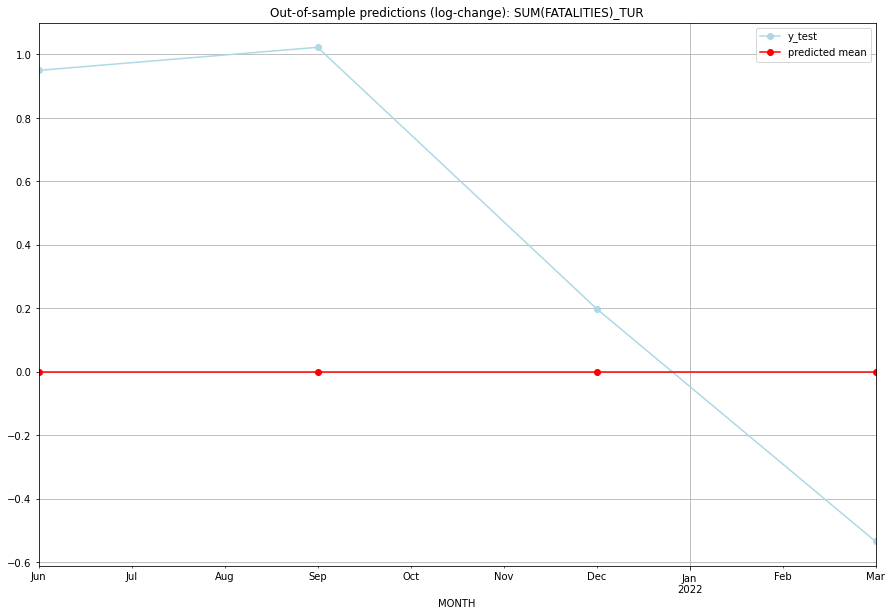

TADDA: 0.6766156460445373
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      40.0       105.0 -4.440892e-16        0.949867   TUR   
1 2021-07-01      40.0       113.0 -4.440892e-16        1.022626   TUR   
2 2021-10-01      40.0        49.0 -4.440892e-16        0.198451   TUR   
3 2022-01-01      40.0        23.0 -4.440892e-16       -0.535518   TUR   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## TWN (211/234) #########
0
Neighbor countries: []
Getting Data for TWN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV neces

<Figure size 432x288 with 0 Axes>

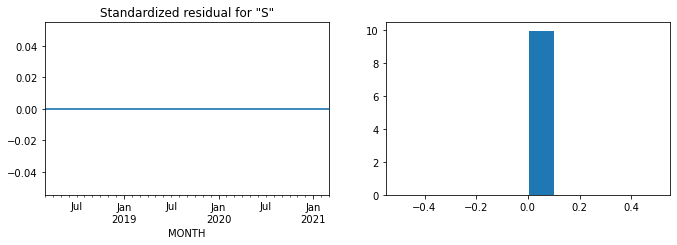

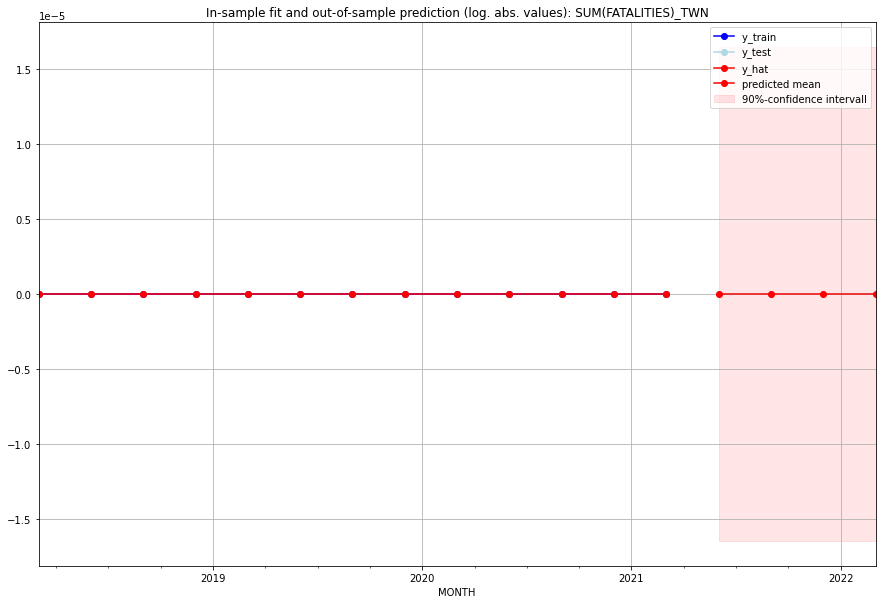

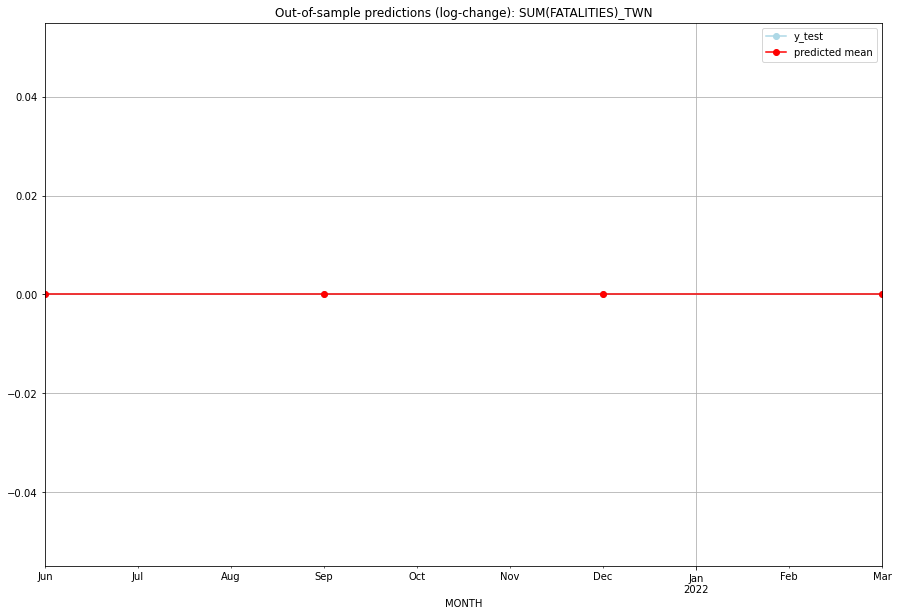

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   TWN   
1 2021-07-01       0.0         0.0           0.0             0.0   TWN   
2 2021-10-01       0.0         0.0           0.0             0.0   TWN   
3 2022-01-01       0.0         0.0           0.0             0.0   TWN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## TZA (212/234) #########
0
Neighbor countries: ['KEN', 'UGA', 'MWI', 'ZMB', 'MOZ', 'COD', 'BDI', 'RWA']
Getting Data for TZA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 64)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.0537668855742883, 'fold_results': [1.1295616399728907, 1.2689306698941785, 0.7271014295932294, 0.706689359546019, 1.4365513288651237]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TZA   No. Observations:                   96
Model:                SARIMAX(1, 1, 3)   Log Likelihood                -159.288
Date:                 Wed, 19 Oct 2022   AIC                            328.576
Time:                         10:59:04   BIC                            341.345
Sample:                     04-30-1997   HQIC                           333.735
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

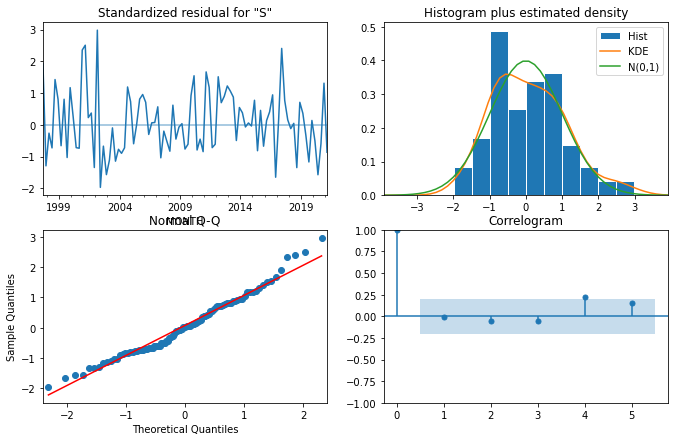

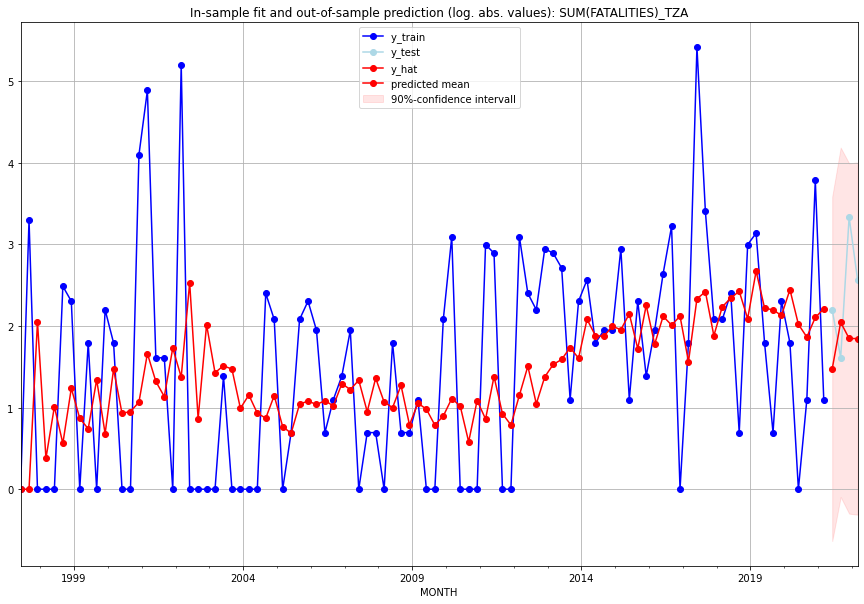

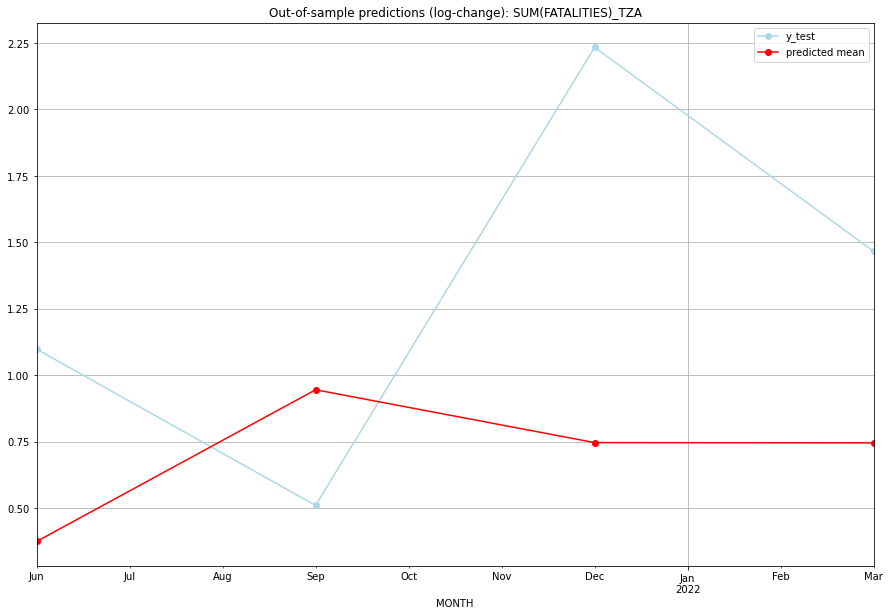

TADDA: 0.8412671095806317
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  3.365976         8.0      0.375229        1.098612   TZA   
1 2021-07-01  6.724725         4.0      0.945814        0.510826   TZA   
2 2021-10-01  5.332993        27.0      0.747161        2.233592   TZA   
3 2022-01-01  5.326098        12.0      0.746071        1.466337   TZA   

                                          PARAMETERS  
0  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:26
######## UGA (213/234) #########
0
Neighbor countries: ['RWA', 'COD', 'SSD', 'KEN', 'TZA']
Getting Data for UGA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 40)
y: (100, 1)
------------------------------------------------
Training started

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.8815672702077129, 'fold_results': [1.5893883465991803, 1.276018193721758, 0.8149519546810537, 0.10608588110843375, 0.6213919749281384]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UGA   No. Observations:                   96
Model:                SARIMAX(0, 1, 3)   Log Likelihood                -134.570
Date:                 Wed, 19 Oct 2022   AIC                            281.141
Time:                         10:59:24   BIC                            296.464
Sample:                     04-30-1997   HQIC                           287.332
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

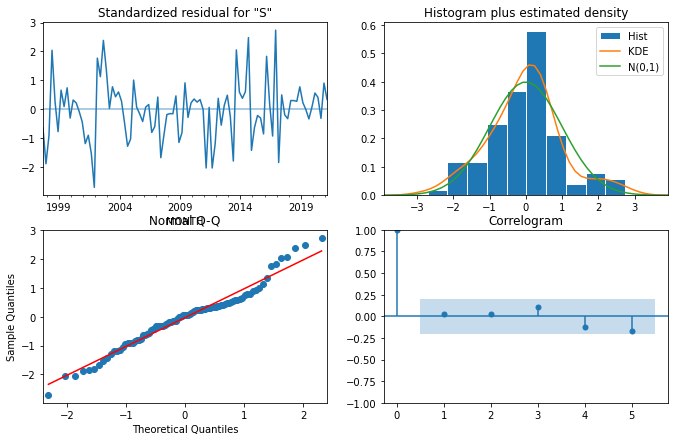

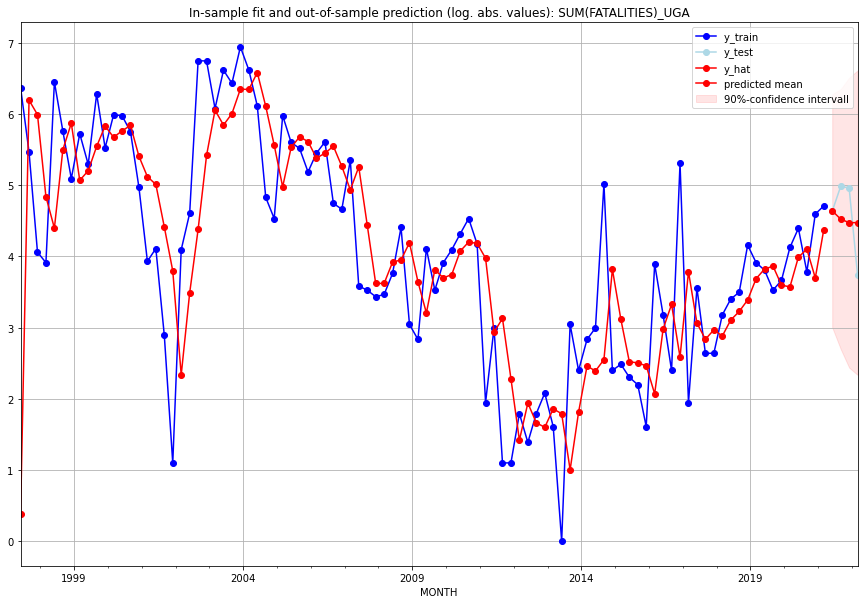

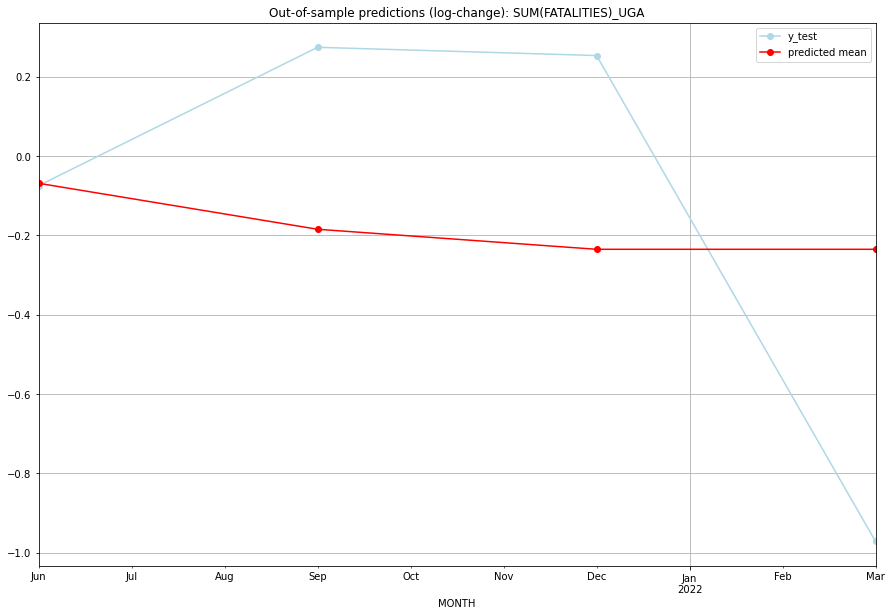

TADDA: 0.5274463643363467
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  102.623691       102.0     -0.068764       -0.074801   UGA   
1 2021-07-01   91.283866       145.0     -0.184661        0.274076   UGA   
2 2021-10-01   86.737985       142.0     -0.235175        0.253314   UGA   
3 2022-01-01   86.737985        41.0     -0.235175       -0.971861   UGA   

                                          PARAMETERS  
0  {'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## UKR (214/234) #########
0
Neighbor countries: ['BLR', 'POL', 'RUS', 'MDA', 'ROU', 'HUN', 'SVK']
Getting Data for UKR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 56)
y: (17, 1)
-------------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.35950336573751424, 'fold_results': [0.4383375764717262, 0.28066915500330225]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UKR   No. Observations:                   13
Model:                SARIMAX(1, 0, 3)   Log Likelihood                  -9.515
Date:                 Wed, 19 Oct 2022   AIC                             31.031
Time:                         10:59:34   BIC                             34.420
Sample:                     01-31-2018   HQIC                            30.334
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0060      

<Figure size 432x288 with 0 Axes>

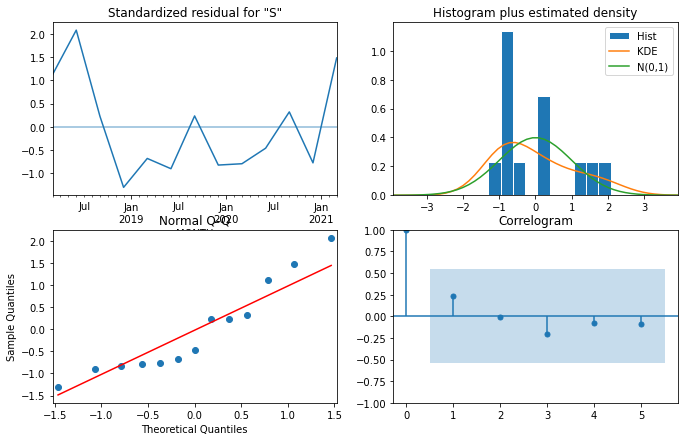

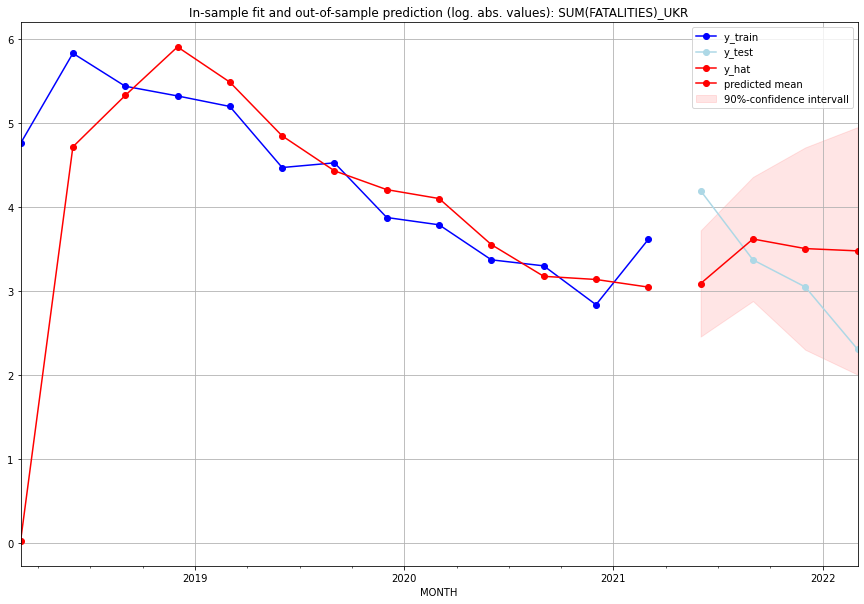

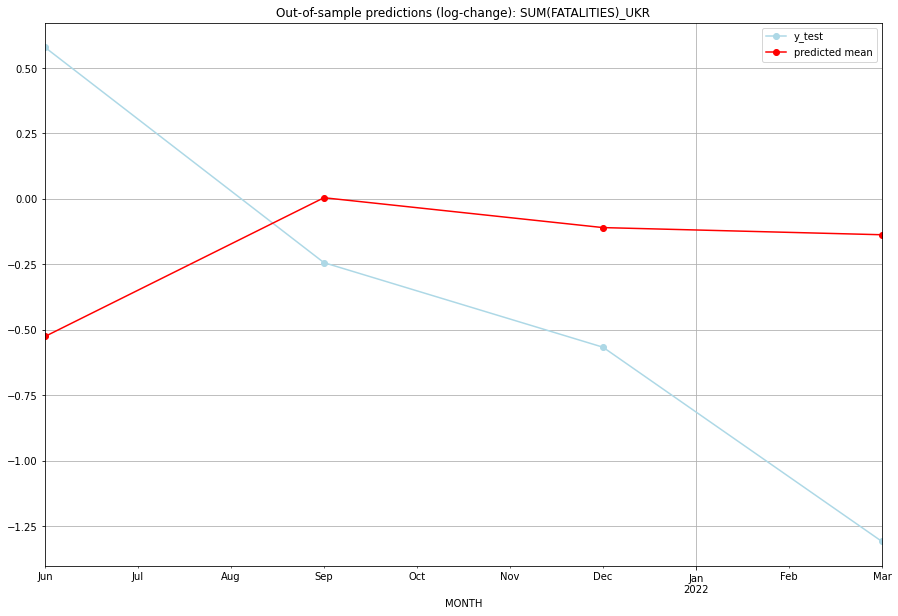

TADDA: 0.8775093816032985
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  20.877003        65.0     -0.525482        0.578737   UKR   
1 2021-07-01  36.161238        28.0      0.004348       -0.243622   UKR   
2 2021-10-01  32.156398        20.0     -0.109682       -0.566395   UKR   
3 2022-01-01  31.261998         9.0     -0.137028       -1.308333   UKR   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## URY (215/234) #########
0
Neighbor countries: ['ARG', 'BRA']
Getting Data for URY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 16)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.2599301927099782, 'fold_results': [0.5198603854199564, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_URY   No. Observations:                   13
Model:                SARIMAX(1, 1, 1)   Log Likelihood                  -1.872
Date:                 Wed, 19 Oct 2022   AIC                             11.744
Time:                         10:59:45   BIC                             13.684
Sample:                     01-31-2018   HQIC                            11.026
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0052      0.188      0.027 

<Figure size 432x288 with 0 Axes>

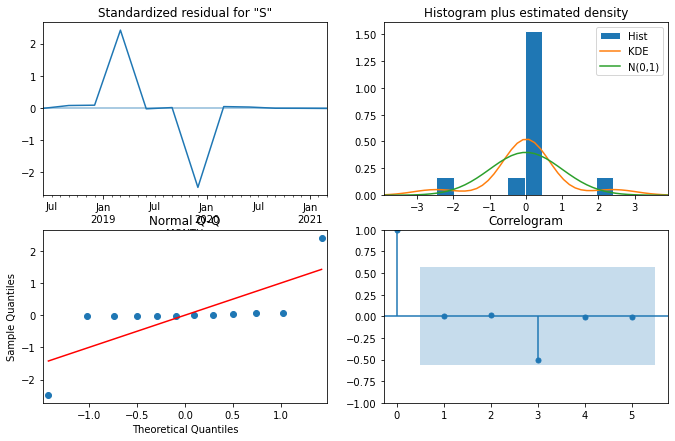

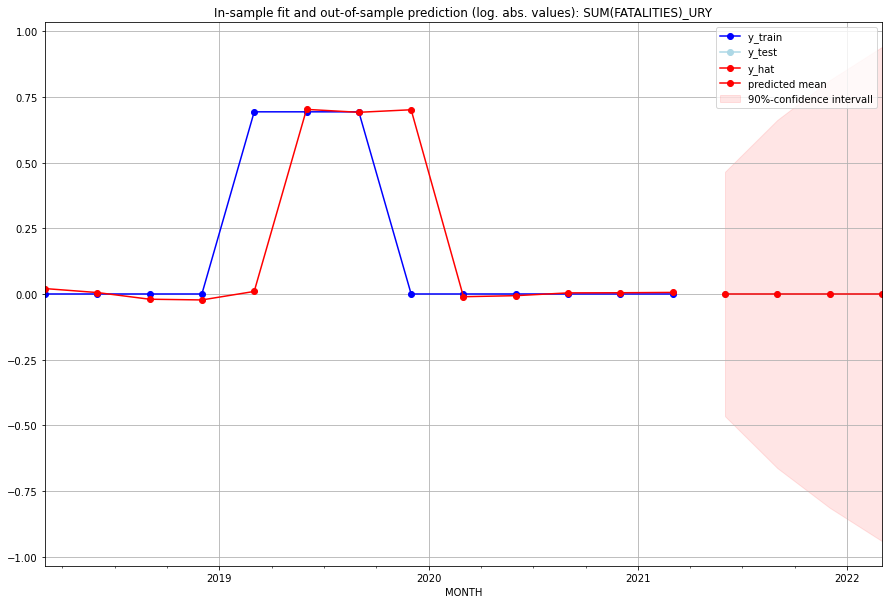

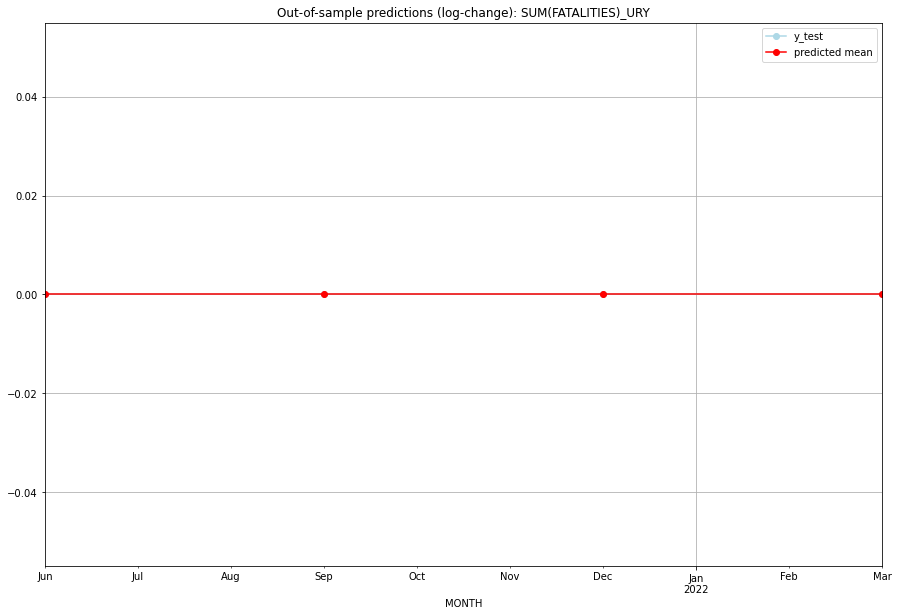

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   URY   
1 2021-07-01       0.0         0.0           0.0             0.0   URY   
2 2021-10-01       0.0         0.0           0.0             0.0   URY   
3 2022-01-01       0.0         0.0           0.0             0.0   URY   

                                          PARAMETERS  
0  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## USA (216/234) #########
0
Neighbor countries: ['CAN', 'MEX']
Getting Data for USA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 16)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data

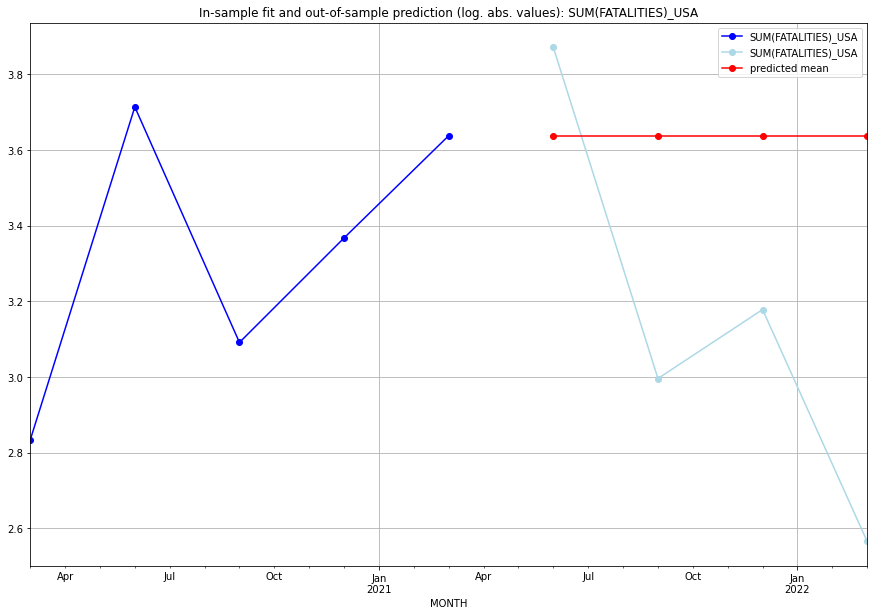

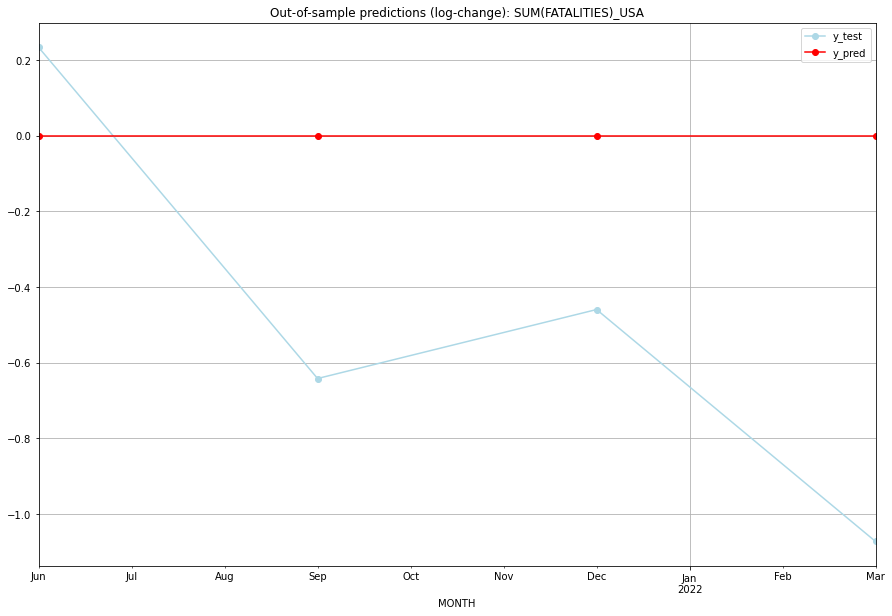

TADDA: 0.6019094672492973
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  3.637586    3.871201           0.0        0.233615   USA   
1 2021-07-01  3.637586    2.995732           0.0       -0.641854   USA   
2 2021-10-01  3.637586    3.178054           0.0       -0.459532   USA   
3 2022-01-01  3.637586    2.564949           0.0       -1.072637   USA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## UZB (217/234) #########
0
Neighbor countries: ['TJK', 'KAZ', 'AFG', 'TKM', 'KGZ']
Getting Data for UZB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 40)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.35858693823537235, 'fold_results': [0.44793986730844726, 0.2692340091622975]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UZB   No. Observations:                   13
Model:                SARIMAX(2, 1, 1)   Log Likelihood                  -6.879
Date:                 Wed, 19 Oct 2022   AIC                             25.758
Time:                         10:59:59   BIC                             28.667
Sample:                     01-31-2018   HQIC                            24.680
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0396      

<Figure size 432x288 with 0 Axes>

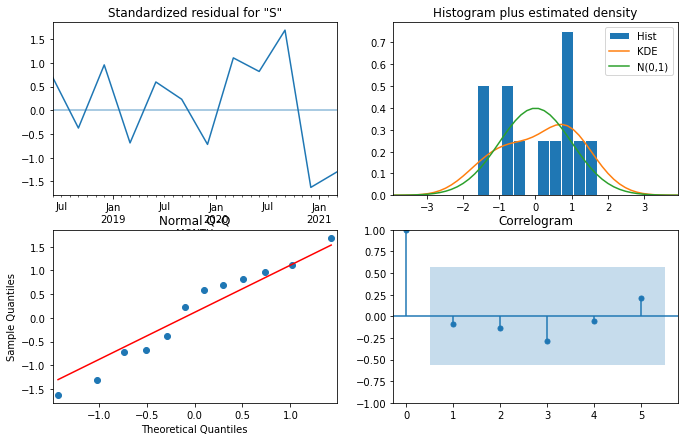

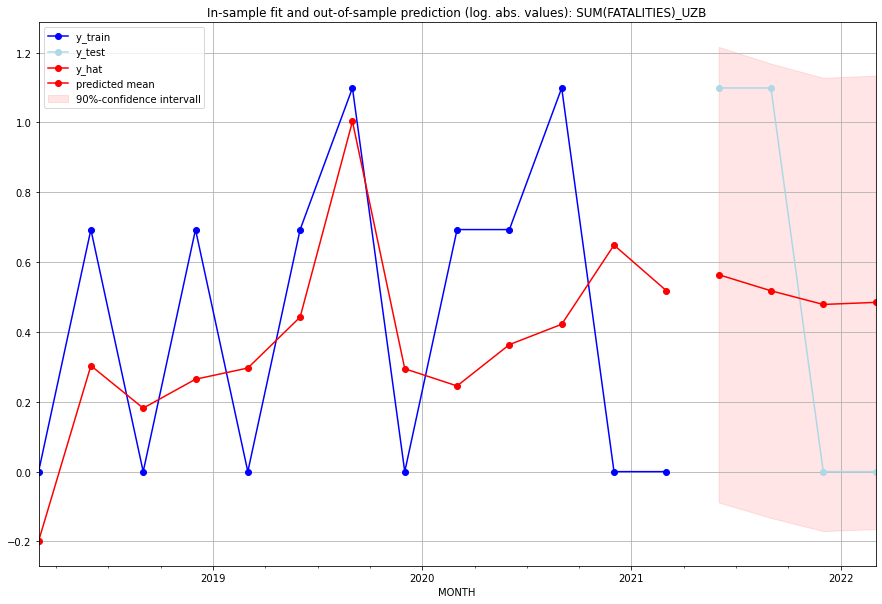

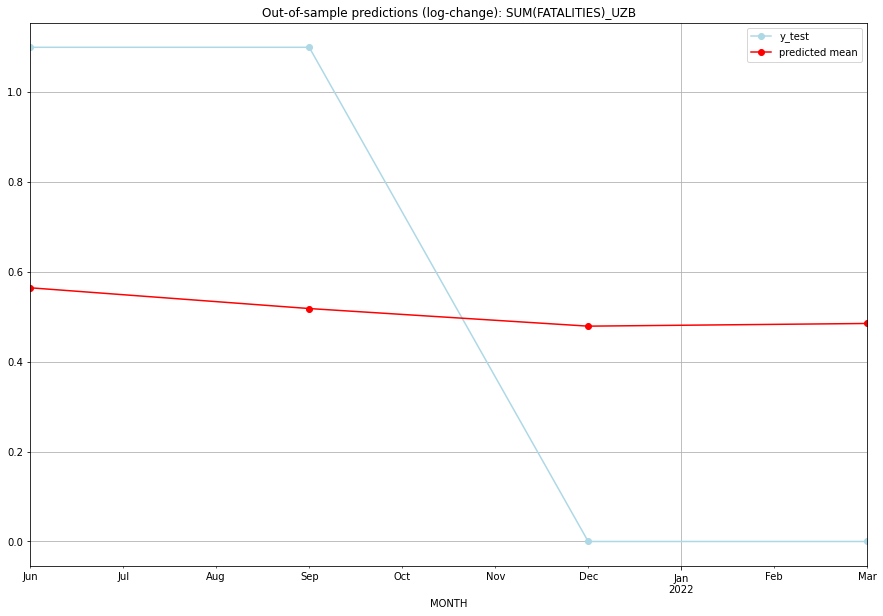

TADDA: 0.5196930210481208
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.757668         2.0      0.563988        1.098612   UZB   
1 2021-07-01  0.678435         2.0      0.517862        1.098612   UZB   
2 2021-10-01  0.614004         0.0      0.478718        0.000000   UZB   
3 2022-01-01  0.623654         0.0      0.484679        0.000000   UZB   

                                          PARAMETERS  
0  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## VAT (218/234) #########
0
Neighbor countries: ['ITA']
Getting Data for VAT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficie

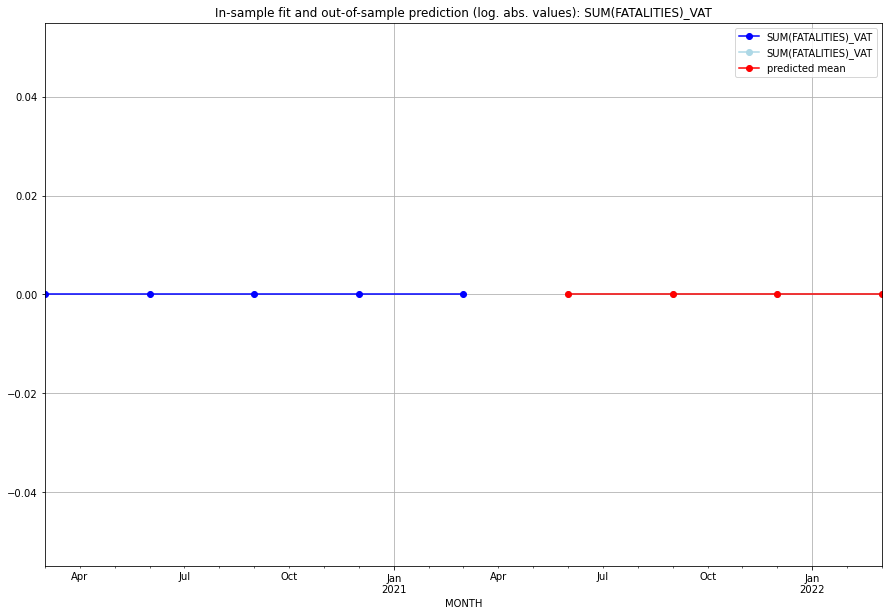

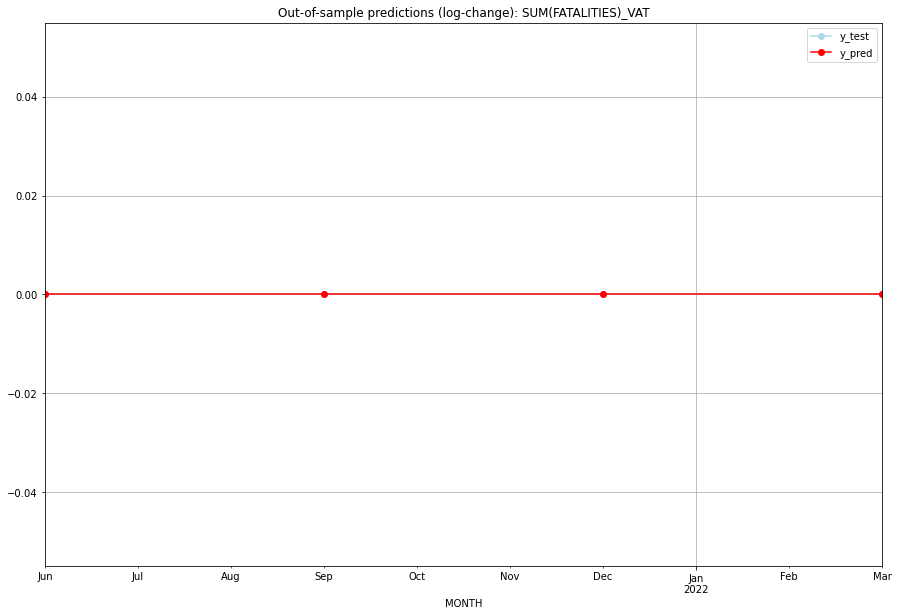

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VAT   
1 2021-07-01       0.0         0.0           0.0             0.0   VAT   
2 2021-10-01       0.0         0.0           0.0             0.0   VAT   
3 2022-01-01       0.0         0.0           0.0             0.0   VAT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## VCT (219/234) #########
0
Neighbor countries: []
Getting Data for VCT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


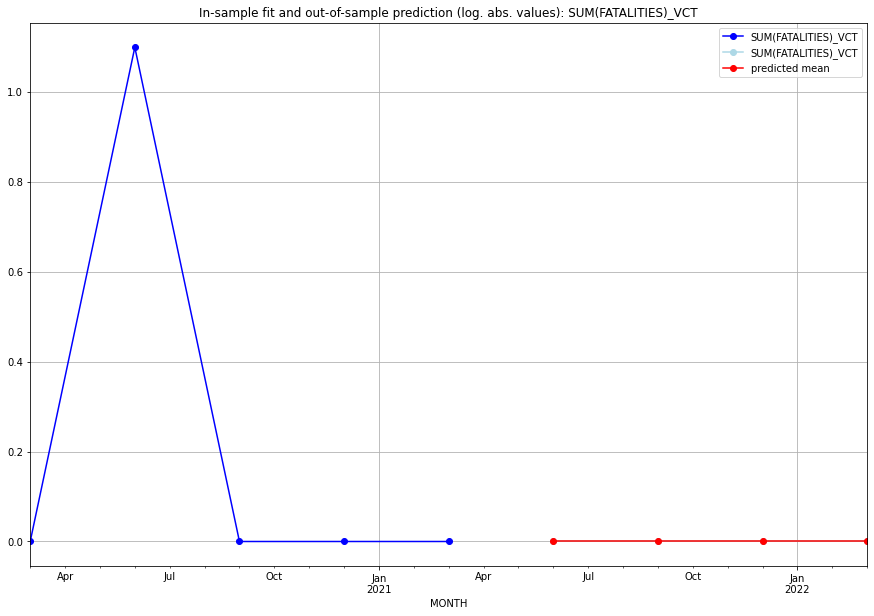

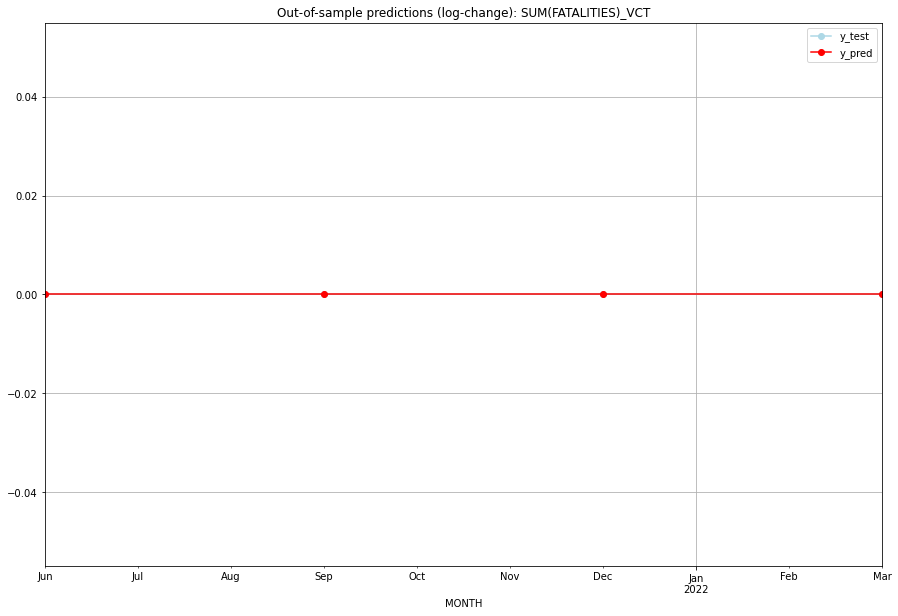

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VCT   
1 2021-07-01       0.0         0.0           0.0             0.0   VCT   
2 2021-10-01       0.0         0.0           0.0             0.0   VCT   
3 2022-01-01       0.0         0.0           0.0             0.0   VCT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:06
######## VEN (220/234) #########
0
Neighbor countries: ['BRA', 'COL', 'GUY']
Getting Data for VEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.46462938885936933, 'fold_results': [0.46462938885936933, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_VEN   No. Observations:                   13
Model:                SARIMAX(1, 0, 2)   Log Likelihood                 -11.150
Date:                 Wed, 19 Oct 2022   AIC                             36.301
Time:                         11:00:19   BIC                             40.255
Sample:                     01-31-2018   HQIC                            35.488
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0434      0.103      0.42

<Figure size 432x288 with 0 Axes>

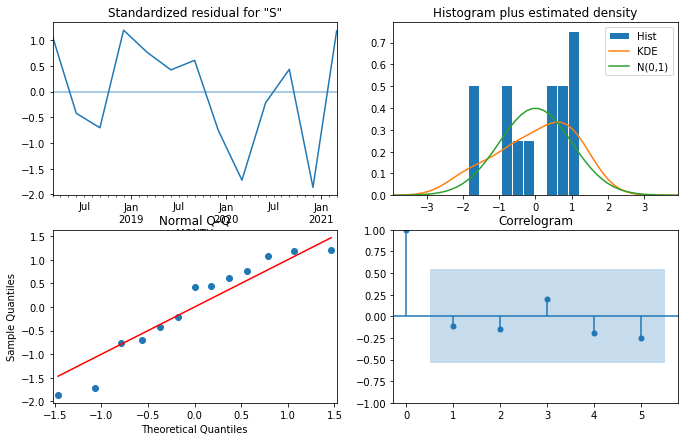

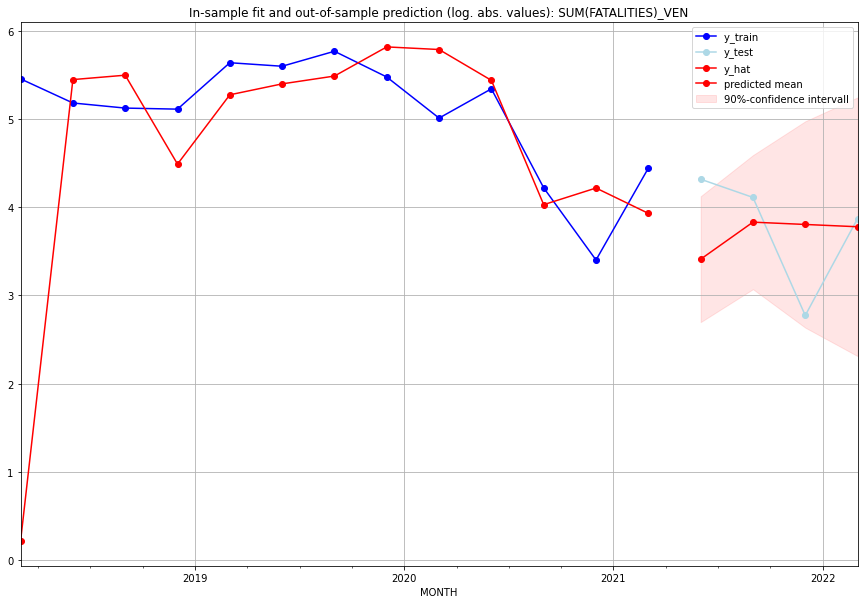

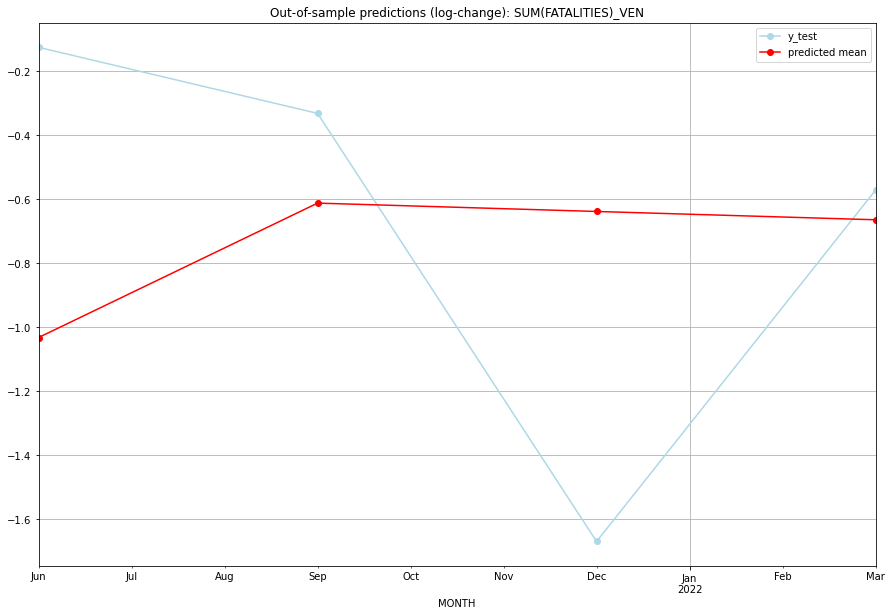

TADDA: 0.5780802579726196
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  29.270990        74.0     -1.032461       -0.125163   VEN   
1 2021-07-01  45.082266        60.0     -0.612223       -0.331777   VEN   
2 2021-10-01  43.893906        15.0     -0.638349       -1.670063   VEN   
3 2022-01-01  42.743248        47.0     -0.664314       -0.571450   VEN   

                                          PARAMETERS  
0  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## VIR (221/234) #########
0
Neighbor countries: []
Getting Data for VIR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficie

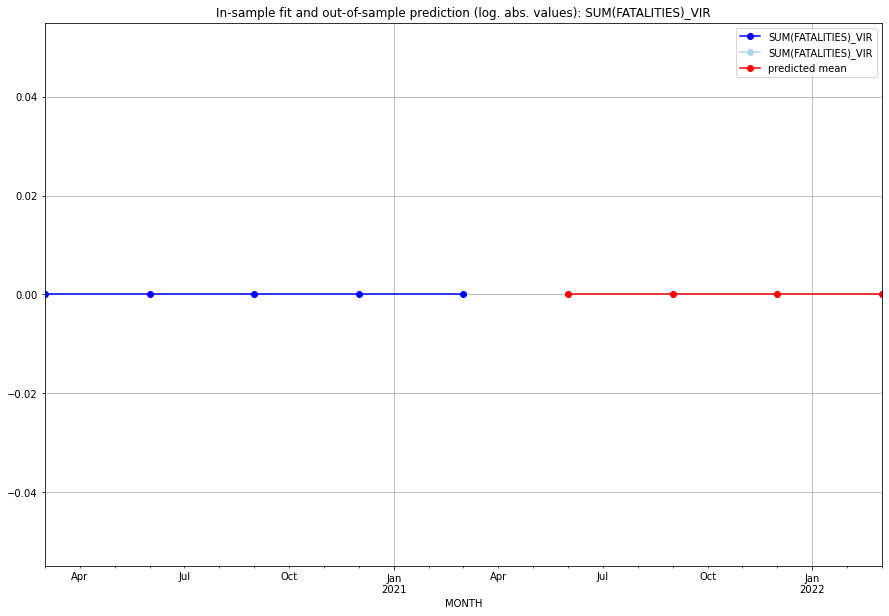

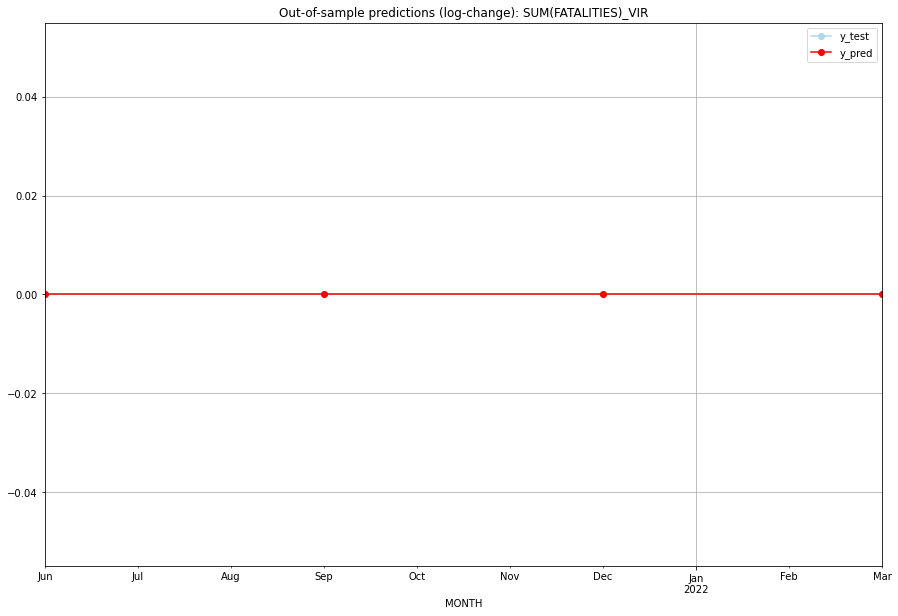

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VIR   
1 2021-07-01       0.0         0.0           0.0             0.0   VIR   
2 2021-10-01       0.0         0.0           0.0             0.0   VIR   
3 2022-01-01       0.0         0.0           0.0             0.0   VIR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## VNM (222/234) #########
0
Neighbor countries: ['KHM', 'CHN', 'LAO']
Getting Data for VNM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 24)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3850741124769021, 'fold_results': [0.40760949234803134, 0.508077829486375, 0.43177220745658385, 0.17328679513998632, 0.40462423795353386]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_VNM   No. Observations:                   45
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -56.794
Date:                 Wed, 19 Oct 2022   AIC                            127.587
Time:                         11:00:39   BIC                            140.234
Sample:                     01-31-2010   HQIC                           132.302
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

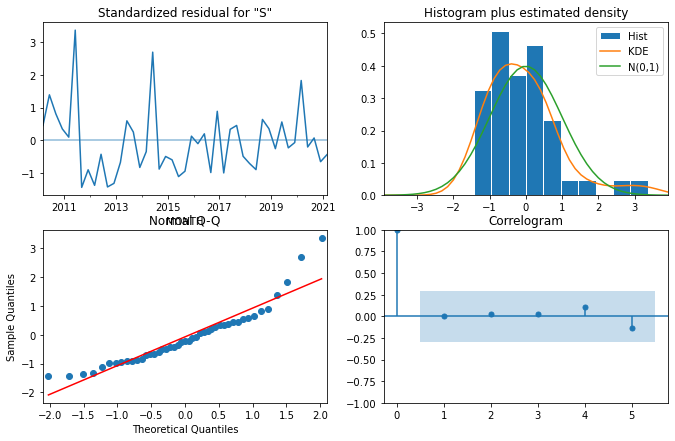

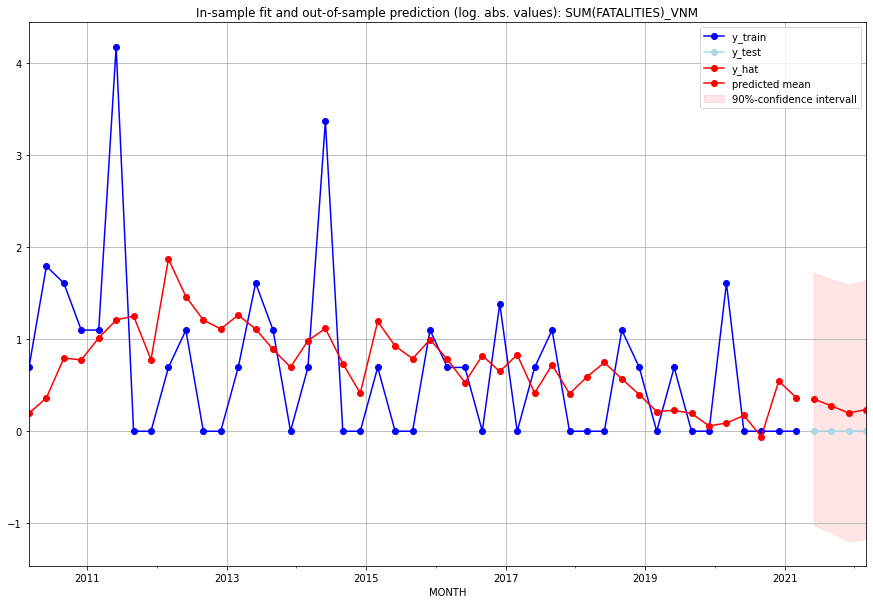

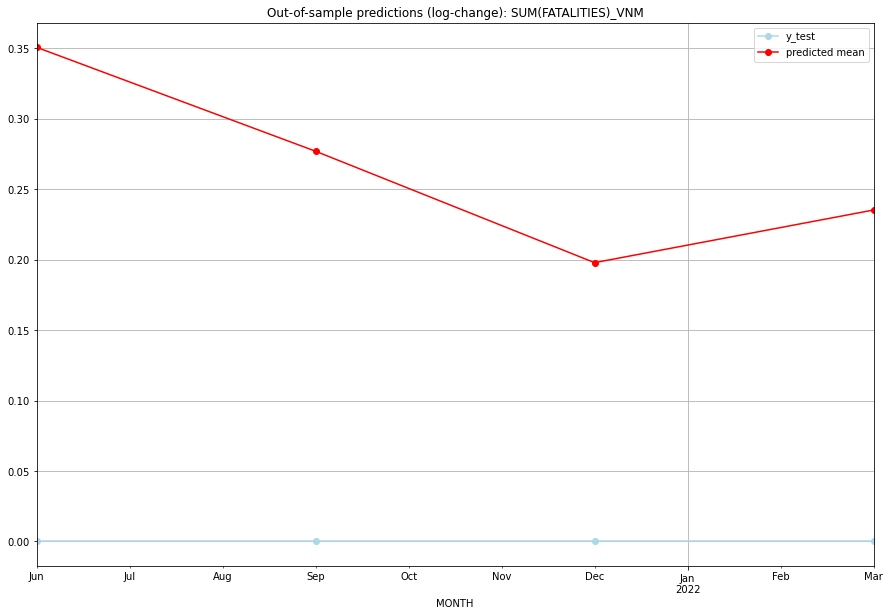

TADDA: 0.2651951349735478
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.420069         0.0      0.350706             0.0   VNM   
1 2021-07-01  0.319103         0.0      0.276952             0.0   VNM   
2 2021-10-01  0.218817         0.0      0.197880             0.0   VNM   
3 2022-01-01  0.265215         0.0      0.235242             0.0   VNM   

                                          PARAMETERS  
0  {'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## VUT (223/234) #########
0
Neighbor countries: []
Getting Data for VUT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

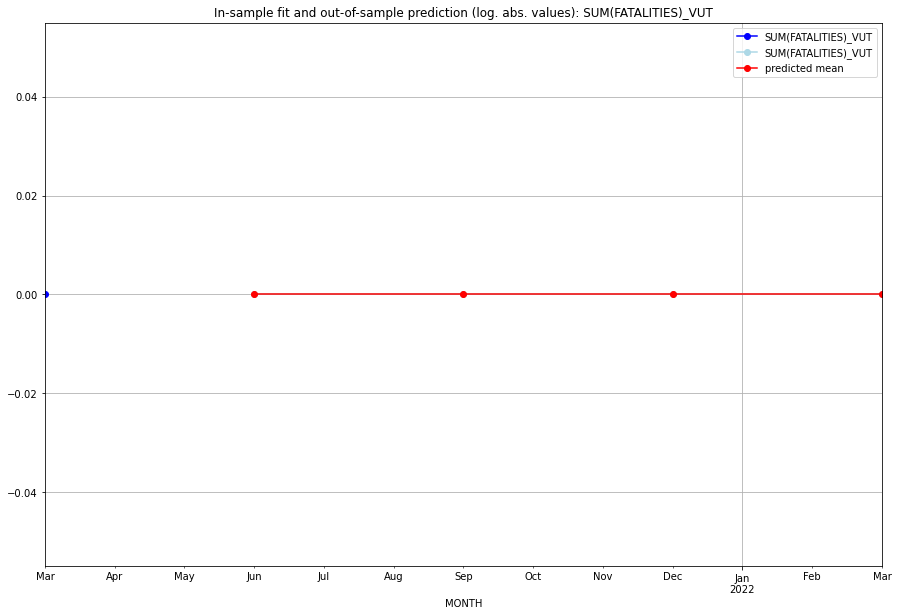

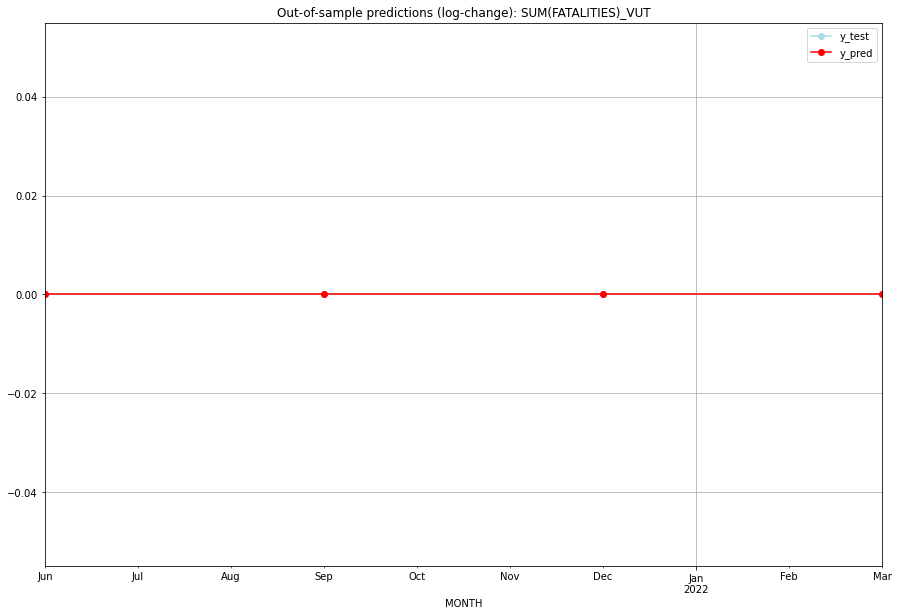

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VUT   
1 2021-07-01       0.0         0.0           0.0             0.0   VUT   
2 2021-10-01       0.0         0.0           0.0             0.0   VUT   
3 2022-01-01       0.0         0.0           0.0             0.0   VUT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## WLF (224/234) #########
0
Neighbor countries: []
Getting Data for WLF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


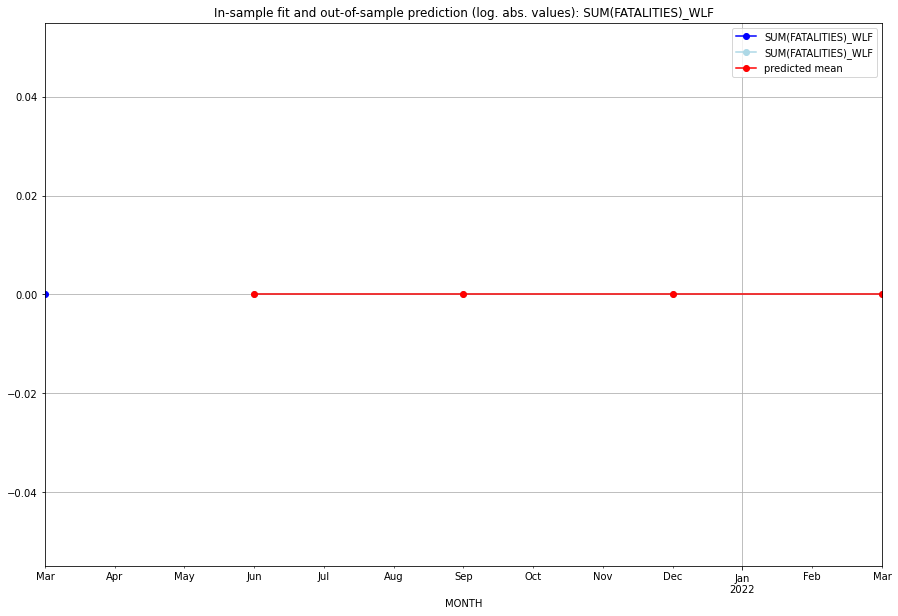

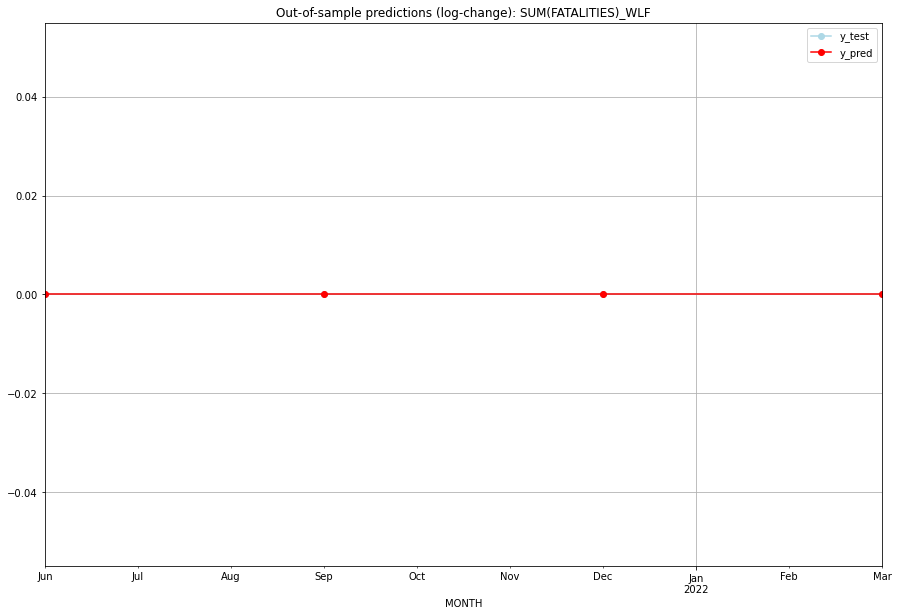

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   WLF   
1 2021-07-01       0.0         0.0           0.0             0.0   WLF   
2 2021-10-01       0.0         0.0           0.0             0.0   WLF   
3 2022-01-01       0.0         0.0           0.0             0.0   WLF   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:00
######## WSM (225/234) #########
0
Neighbor countries: []
Getting Data for WSM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


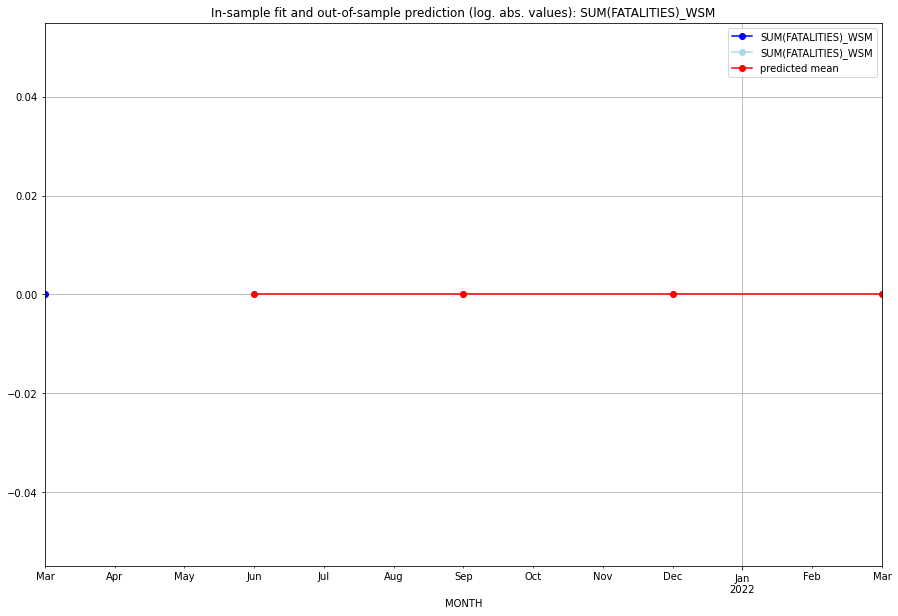

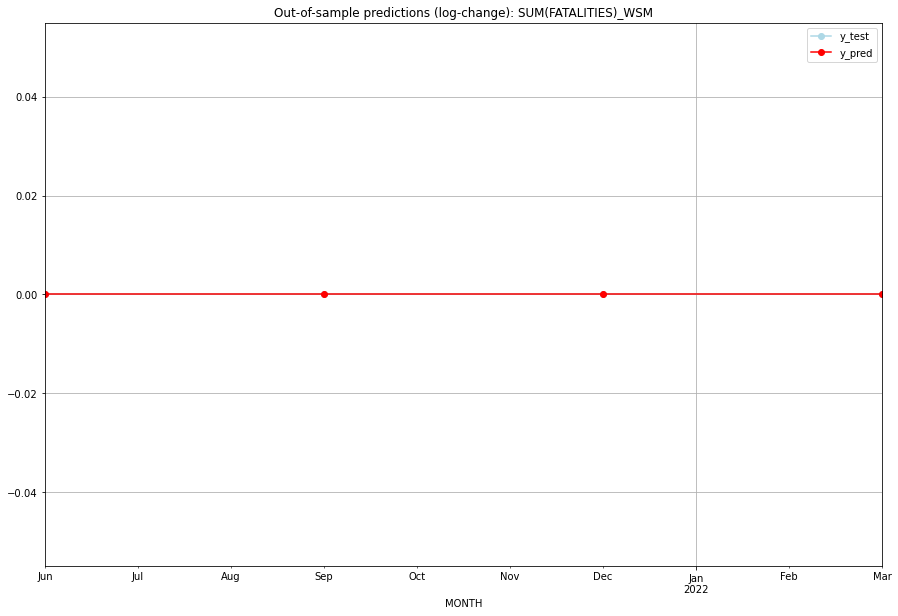

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   WSM   
1 2021-07-01       0.0         0.0           0.0             0.0   WSM   
2 2021-10-01       0.0         0.0           0.0             0.0   WSM   
3 2022-01-01       0.0         0.0           0.0             0.0   WSM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## XAR (226/234) #########
0
Neighbor countries: ['SDN', 'SSD']
Getting Data for XAR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 16)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9948095758469346, 'fold_results': [1.6298647742419154, 0.5904735860969869, 0.8460839133648826, 0.983216085916066, 0.9244095196148225]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XAR   No. Observations:                   96
Model:                SARIMAX(3, 0, 0)   Log Likelihood                -160.495
Date:                 Wed, 19 Oct 2022   AIC                            330.989
Time:                         11:01:12   BIC                            343.811
Sample:                     04-30-1997   HQIC                           336.172
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

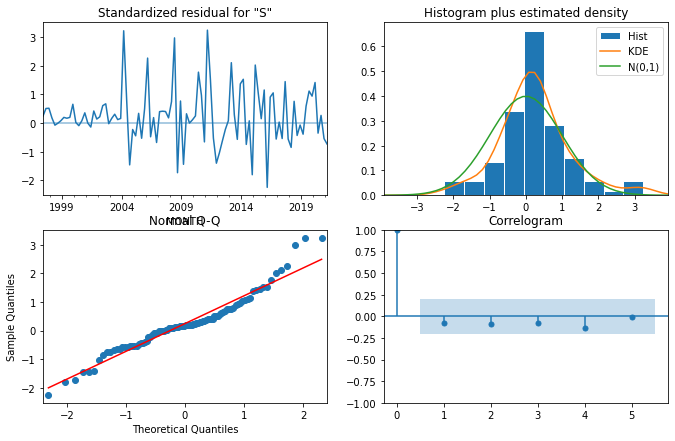

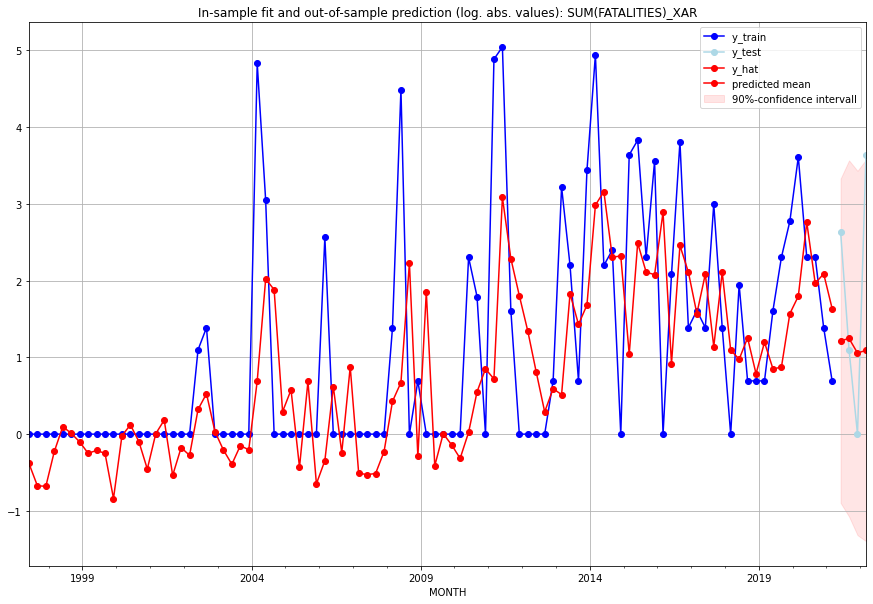

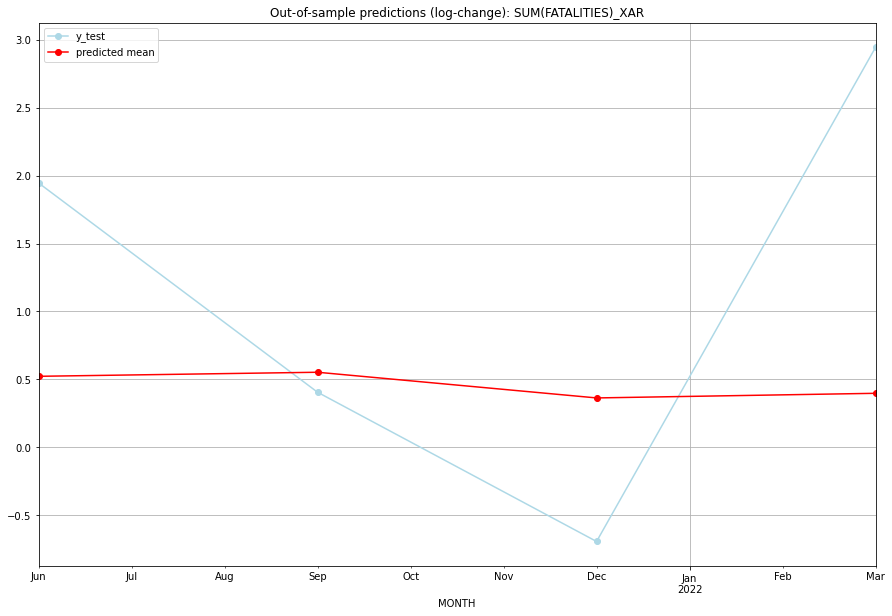

TADDA: 1.3843349322753125
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.373383        13.0      0.522769        1.945910   XAR   
1 2021-07-01  2.475549         2.0      0.552605        0.405465   XAR   
2 2021-10-01  1.876864         0.0      0.363554       -0.693147   XAR   
3 2022-01-01  1.976602        37.0      0.397635        2.944439   XAR   

                                          PARAMETERS  
0  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:28
######## XIT (227/234) #########
0
Neighbor countries: ['ETH', 'KEN', 'SSD']
Getting Data for XIT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSE

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XIT   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 -14.931
Date:                 Wed, 19 Oct 2022   AIC                             31.863
Time:                         11:01:28   BIC                             34.427
Sample:                     04-30-1997   HQIC                            32.899
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0799      0.002     37.614      0.000     

<Figure size 432x288 with 0 Axes>

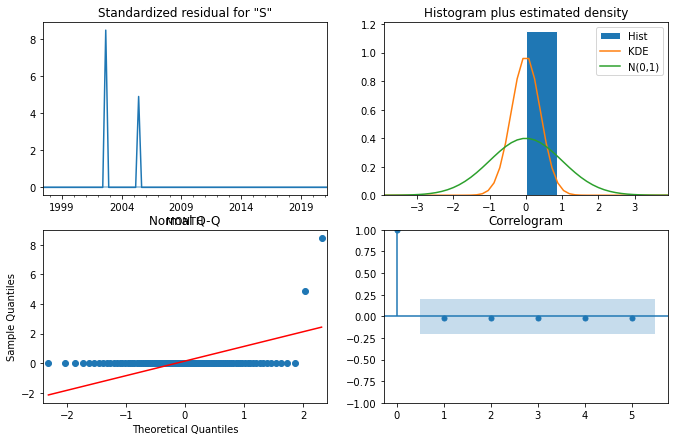

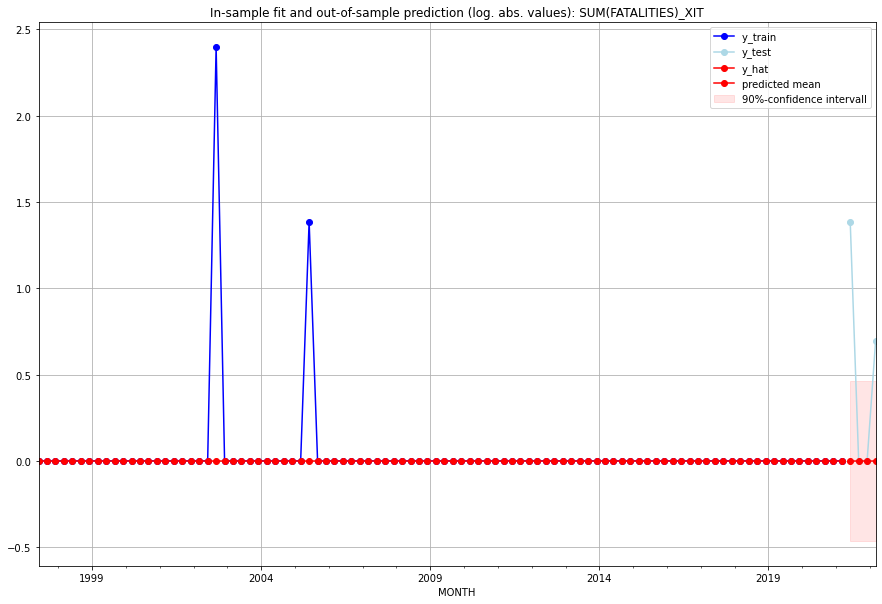

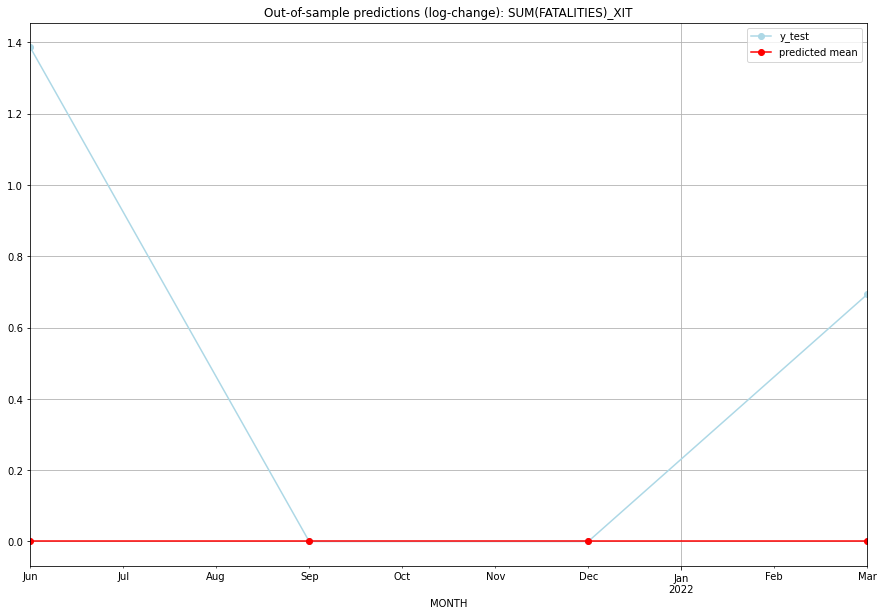

TADDA: 0.5198603854199589
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         3.0           0.0        1.386294   XIT   
1 2021-07-01       0.0         0.0           0.0        0.000000   XIT   
2 2021-10-01       0.0         0.0           0.0        0.000000   XIT   
3 2022-01-01       0.0         1.0           0.0        0.693147   XIT   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## XKK (228/234) #########
0
Neighbor countries: ['CAF', 'SDN', 'SSD']
Getting Data for XKK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSE

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08958797346140275, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.44793986730701374]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XKK   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 -90.179
Date:                 Wed, 19 Oct 2022   AIC                            182.359
Time:                         11:01:47   BIC                            184.923
Sample:                     04-30-1997   HQIC                           183.395
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3832      

<Figure size 432x288 with 0 Axes>

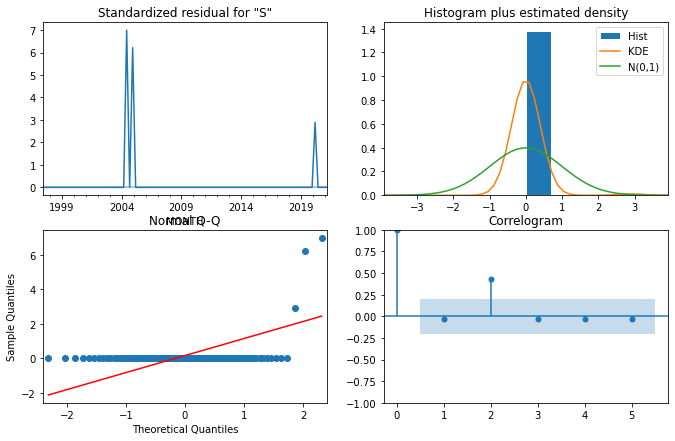

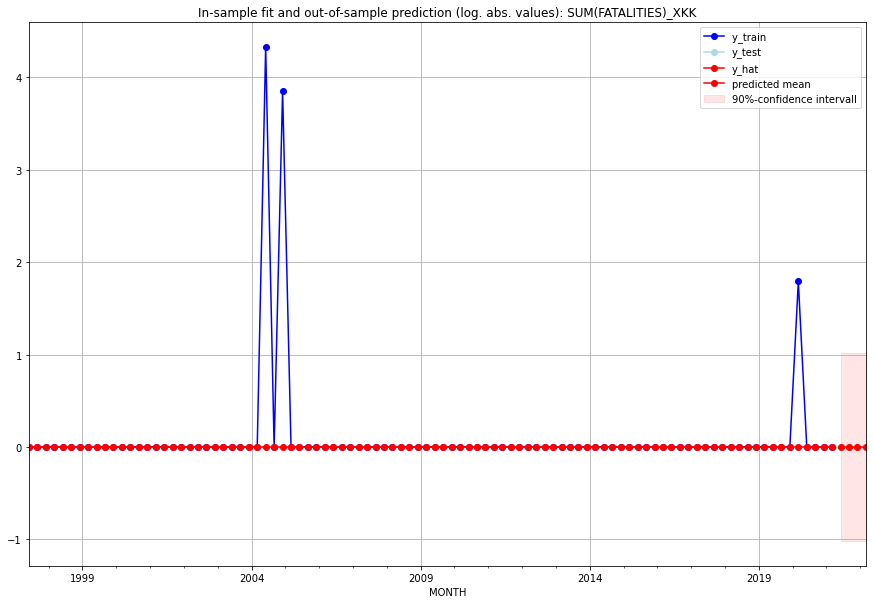

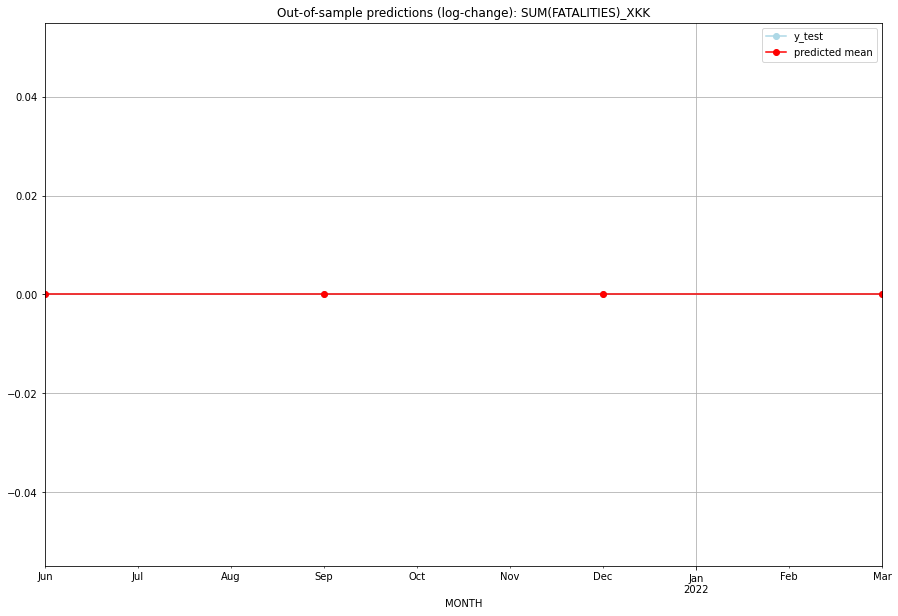

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   XKK   
1 2021-07-01       0.0         0.0           0.0             0.0   XKK   
2 2021-10-01       0.0         0.0           0.0             0.0   XKK   
3 2022-01-01       0.0         0.0           0.0             0.0   XKK   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## XKO (229/234) #########
0
Neighbor countries: ['ALB', 'MNE', 'MKD', 'SRB']
Getting Data for XKO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 32)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XKO   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                  -7.471
Date:                 Wed, 19 Oct 2022   AIC                             16.941
Time:                         11:01:56   BIC                             17.506
Sample:                     01-31-2018   HQIC                            16.825
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1848      0.037      5.048      0.000       0.113       0

<Figure size 432x288 with 0 Axes>

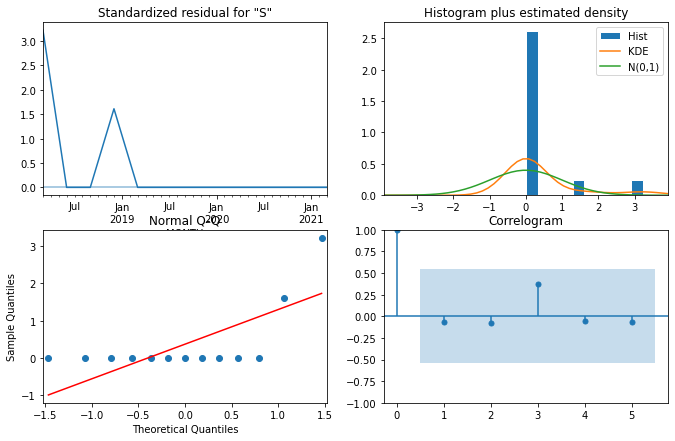

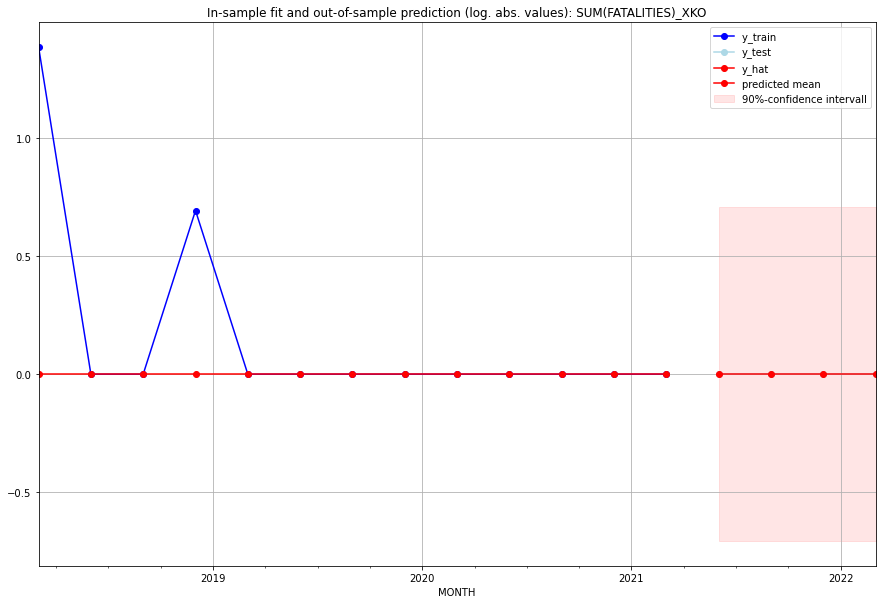

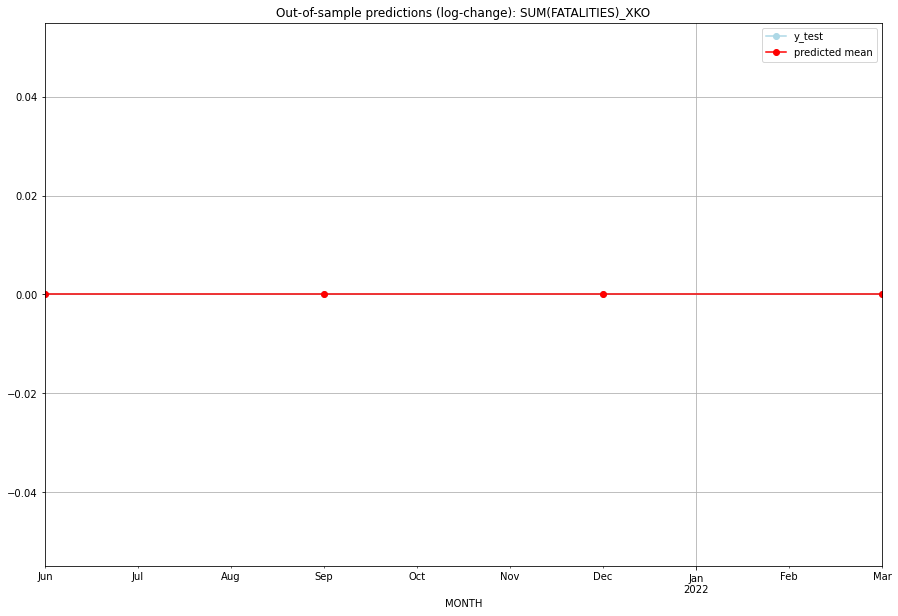

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   XKO   
1 2021-07-01       0.0         0.0           0.0             0.0   XKO   
2 2021-10-01       0.0         0.0           0.0             0.0   XKO   
3 2022-01-01       0.0         0.0           0.0             0.0   XKO   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## XNC (230/234) #########
0
Neighbor countries: ['CYP']
Getting Data for XNC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 8)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 par

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0866433932750534, 'fold_results': [0.1732867865501068, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XNC   No. Observations:                   13
Model:                SARIMAX(2, 0, 0)   Log Likelihood                   0.109
Date:                 Wed, 19 Oct 2022   AIC                              5.782
Time:                         11:02:10   BIC                              7.477
Sample:                     01-31-2018   HQIC                             5.434
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1       1.927e-06    4.2e+04   4.59e-11 

<Figure size 432x288 with 0 Axes>

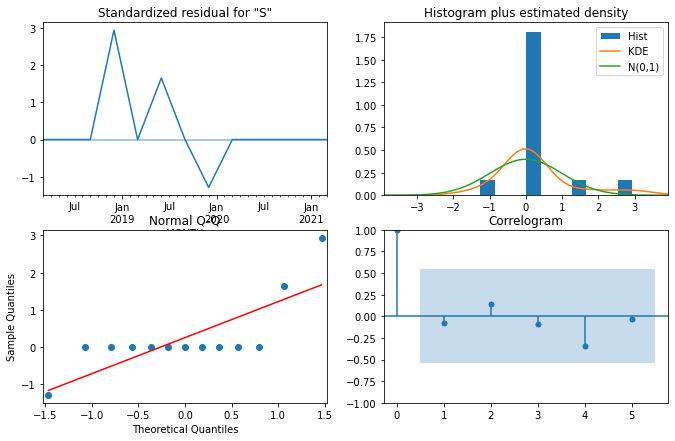

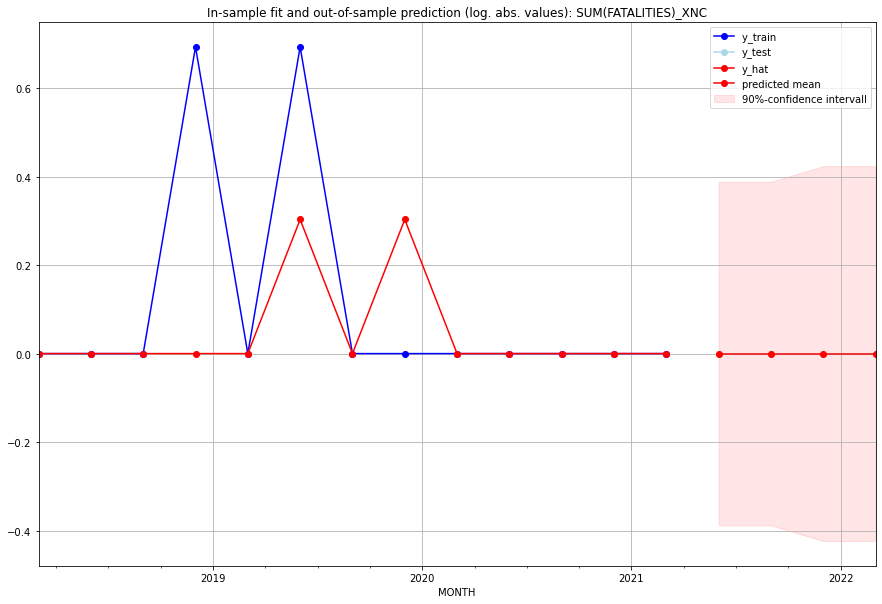

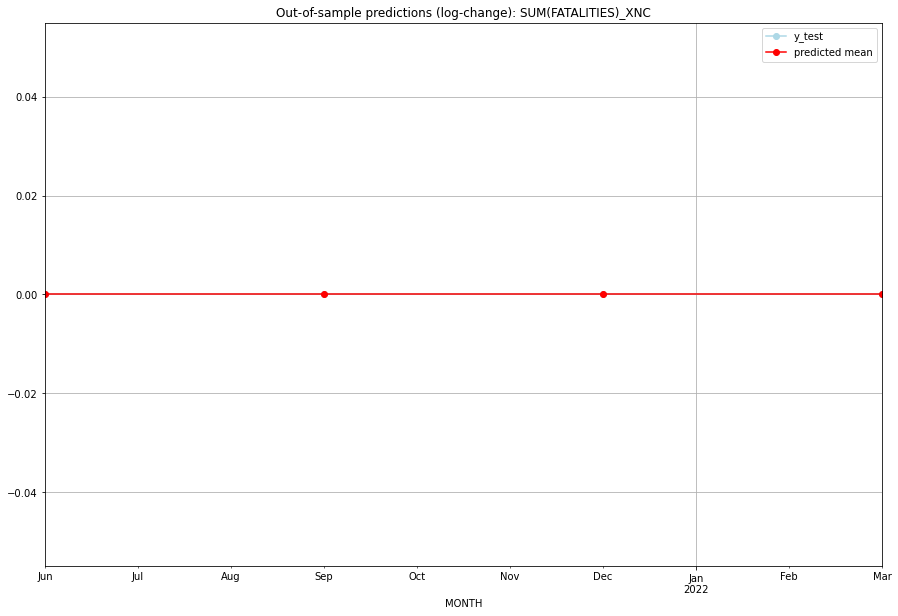

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   XNC   
1 2021-07-01       0.0         0.0           0.0             0.0   XNC   
2 2021-10-01       0.0         0.0           0.0             0.0   XNC   
3 2022-01-01       0.0         0.0           0.0             0.0   XNC   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## YEM (231/234) #########
0
Neighbor countries: ['OMN', 'SAU']
Getting Data for YEM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (29, 16)
y: (29, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.26357098329827855, 'fold_results': [0.2973938111036474, 0.33240705654140523, nan, 0.27850926354669525, 0.14597380200136634]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_YEM   No. Observations:                   25
Model:                SARIMAX(1, 1, 3)   Log Likelihood                  -9.954
Date:                 Wed, 19 Oct 2022   AIC                             29.908
Time:                         11:02:28   BIC                             35.799
Sample:                     01-31-2015   HQIC                            31.471
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

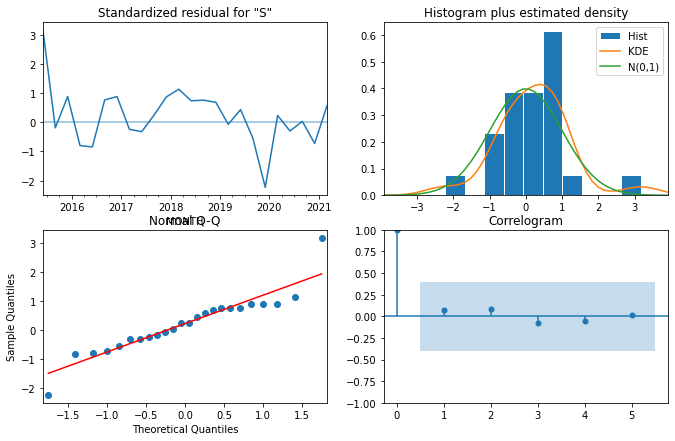

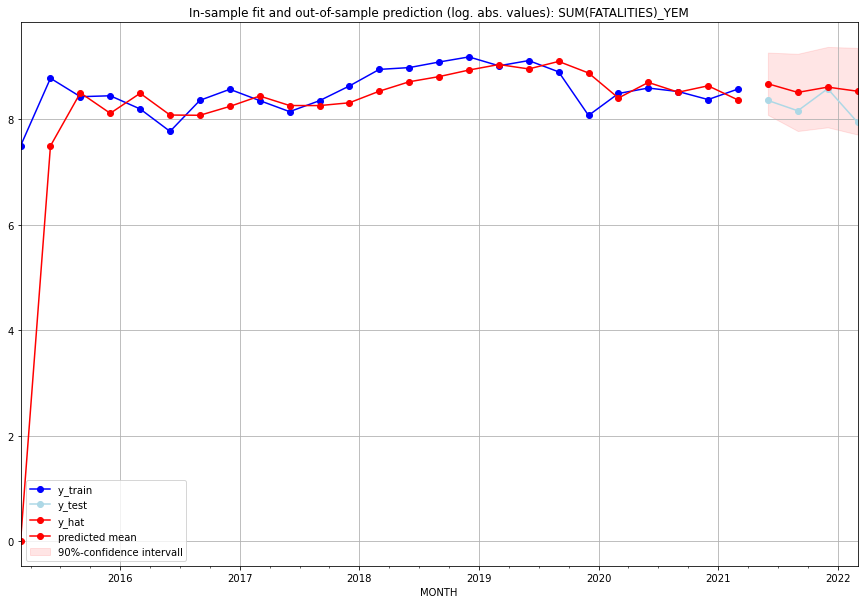

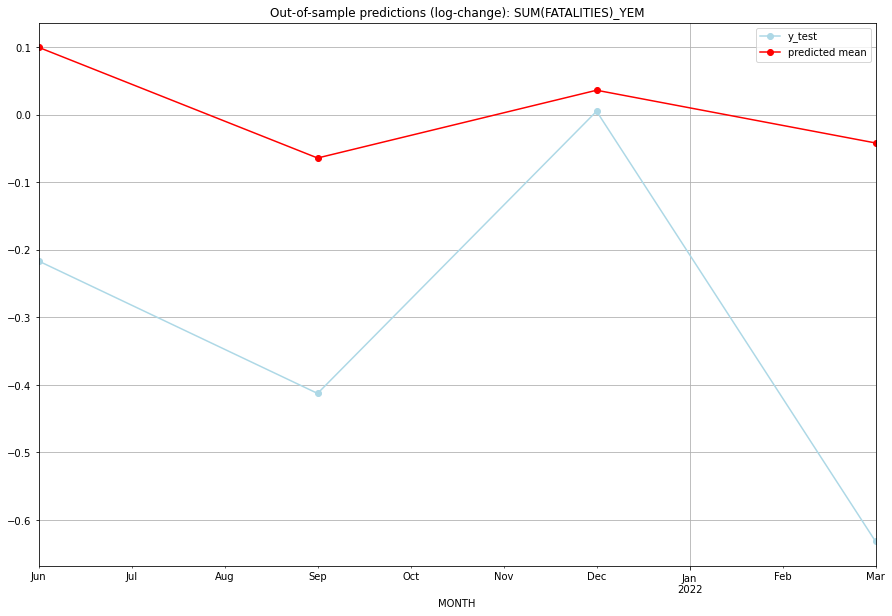

TADDA: 0.34636341656409564
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  5842.648001      4258.0      0.099726       -0.216595   YEM   
1 2021-07-01  4959.459735      3500.0     -0.064131       -0.412581   YEM   
2 2021-10-01  5482.885486      5315.0      0.036185        0.005092   YEM   
3 2022-01-01  5071.126623      2811.0     -0.041869       -0.631733   YEM   

                                          PARAMETERS  
0  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## ZAF (232/234) #########
0
Neighbor countries: ['LSO', 'MOZ', 'SWZ', 'BWA', 'ZWE', 'NAM']
Getting Data for ZAF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 48)
y: (100, 1)
------------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.33656568965559697, 'fold_results': [0.34514824392813237, 0.37321484477082967, 0.3630008886604982, 0.4013793328187625, 0.20008513809976203]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZAF   No. Observations:                   96
Model:                SARIMAX(2, 0, 1)   Log Likelihood                -106.087
Date:                 Wed, 19 Oct 2022   AIC                            226.173
Time:                         11:02:51   BIC                            244.124
Sample:                     04-30-1997   HQIC                           233.429
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------

<Figure size 432x288 with 0 Axes>

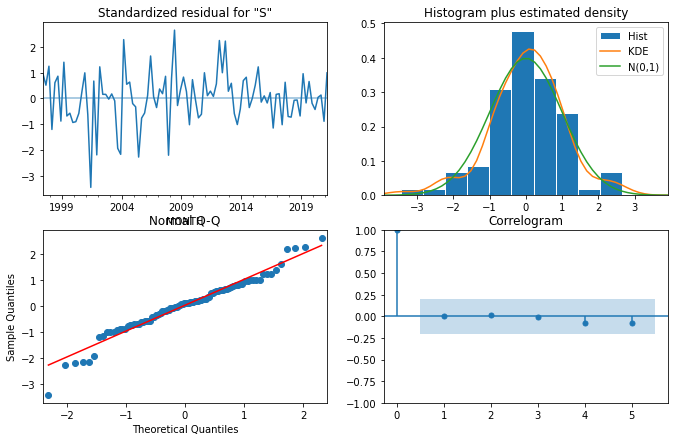

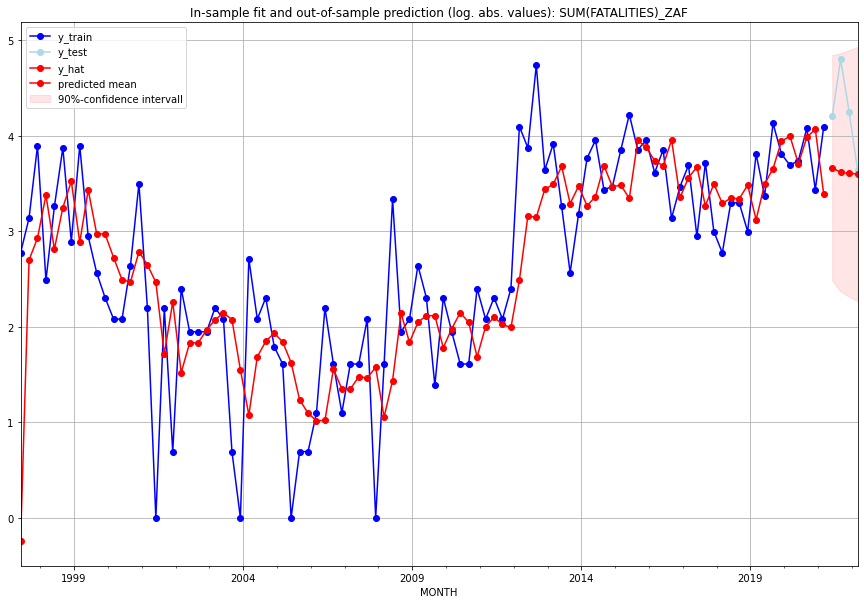

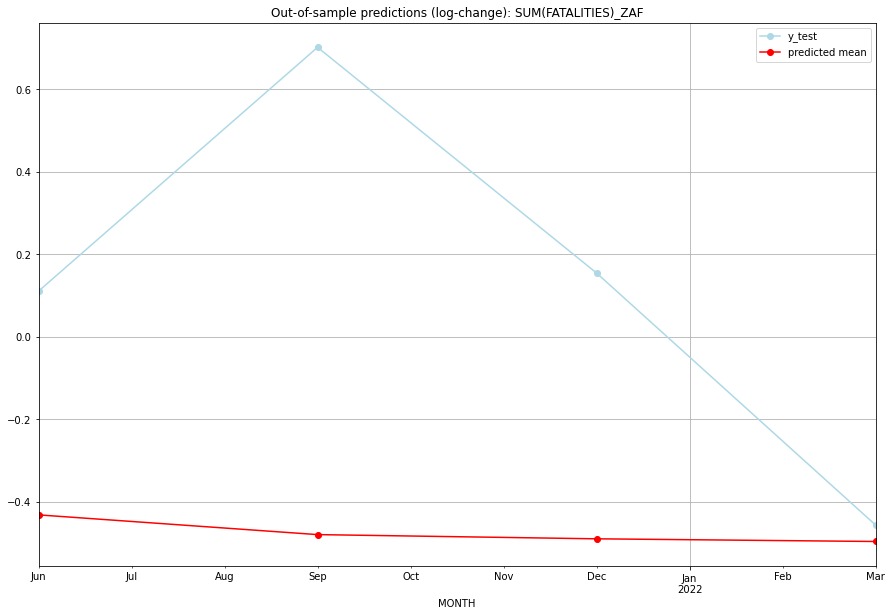

TADDA: 0.9526986648918988
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  37.944815        66.0     -0.432199        0.110348   ZAF   
1 2021-07-01  36.125918       120.0     -0.480029        0.701446   ZAF   
2 2021-10-01  35.749522        69.0     -0.490219        0.154151   ZAF   
3 2022-01-01  35.511644        37.0     -0.496713       -0.456758   ZAF   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## ZMB (233/234) #########
0
Neighbor countries: ['AGO', 'NAM', 'COD', 'MOZ', 'MWI', 'ZWE', 'TZA', 'BWA']
Getting Data for ZMB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 64)
y: (100, 1)
---------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6776182482699197, 'fold_results': [0.5559513091389833, 0.5690153763531255, 0.6618152714647023, 0.6202959866463262, 0.9810132977464612]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZMB   No. Observations:                   96
Model:                SARIMAX(2, 0, 3)   Log Likelihood                -126.269
Date:                 Wed, 19 Oct 2022   AIC                            266.537
Time:                         11:03:08   BIC                            284.488
Sample:                     04-30-1997   HQIC                           273.793
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

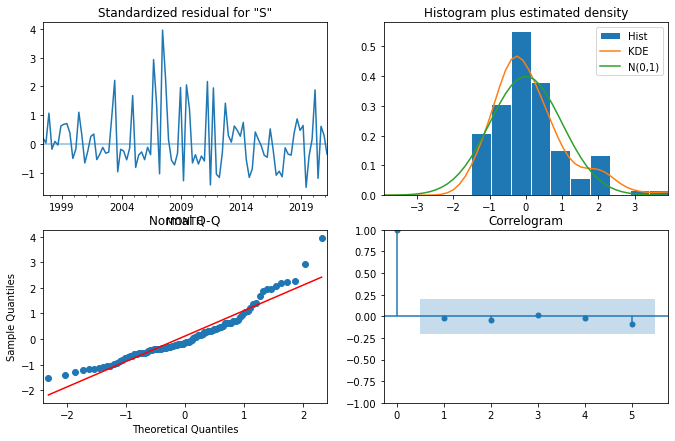

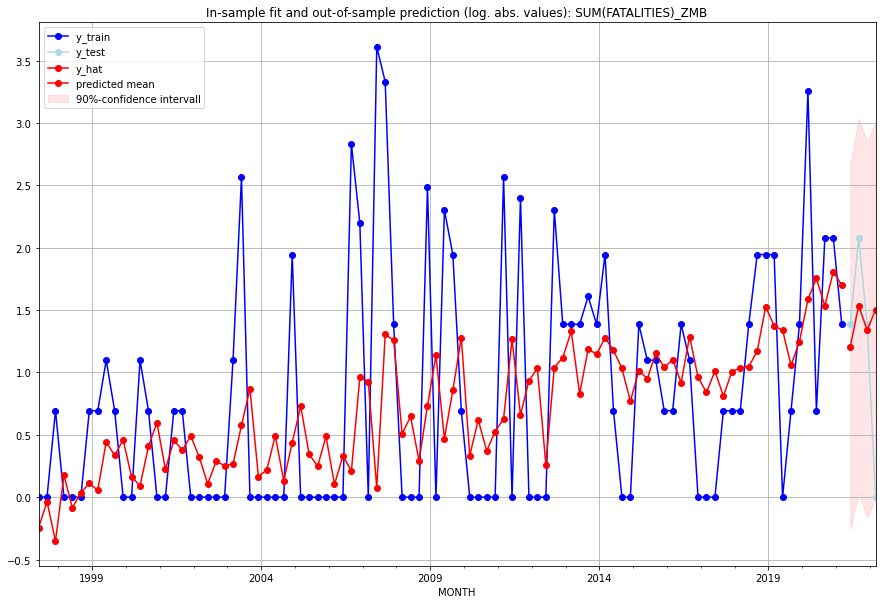

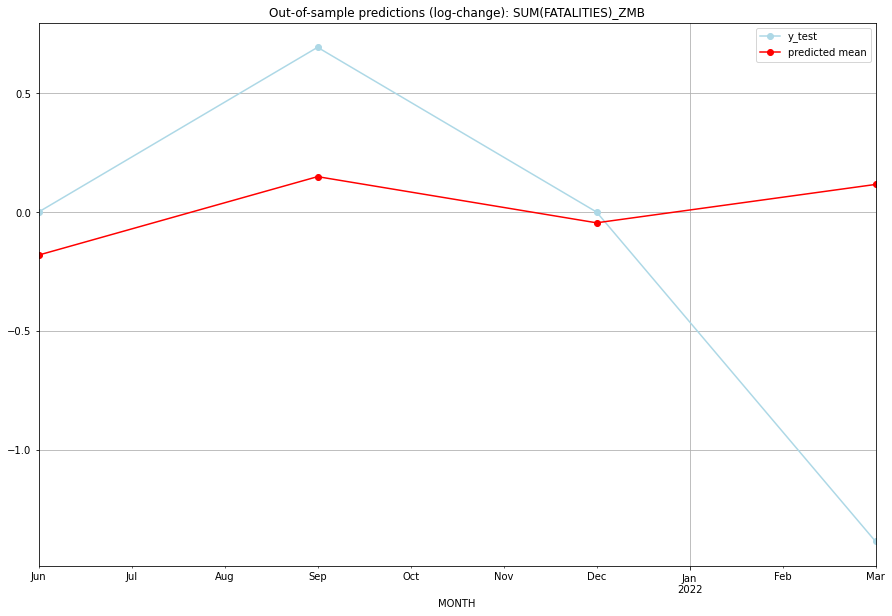

TADDA: 0.5973332935884901
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.337140         3.0     -0.181180        0.000000   ZMB   
1 2021-07-01  3.642340         7.0      0.148924        0.693147   ZMB   
2 2021-10-01  2.822608         3.0     -0.045361        0.000000   ZMB   
3 2022-01-01  3.492600         0.0      0.116137       -1.386294   ZMB   

                                          PARAMETERS  
0  {'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## ZWE (234/234) #########
0
Neighbor countries: ['MOZ', 'ZMB', 'ZAF', 'BWA']
Getting Data for ZWE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 32)
y: (100, 1)
------------------------------------------------
Training started.
Start

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6494415992389904, 'fold_results': [0.820853586501443, 0.5858517718785753, 0.3587711313223305, 0.631432161077064, 0.8502993454155389]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZWE   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -144.010
Date:                 Wed, 19 Oct 2022   AIC                            290.021
Time:                         11:03:30   BIC                            292.575
Sample:                     04-30-1997   HQIC                           291.053
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

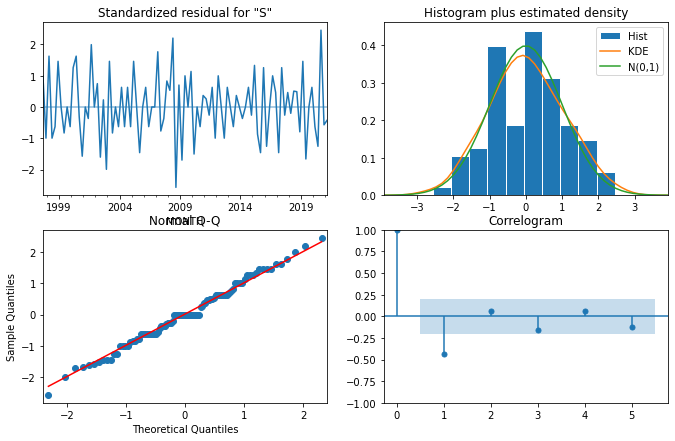

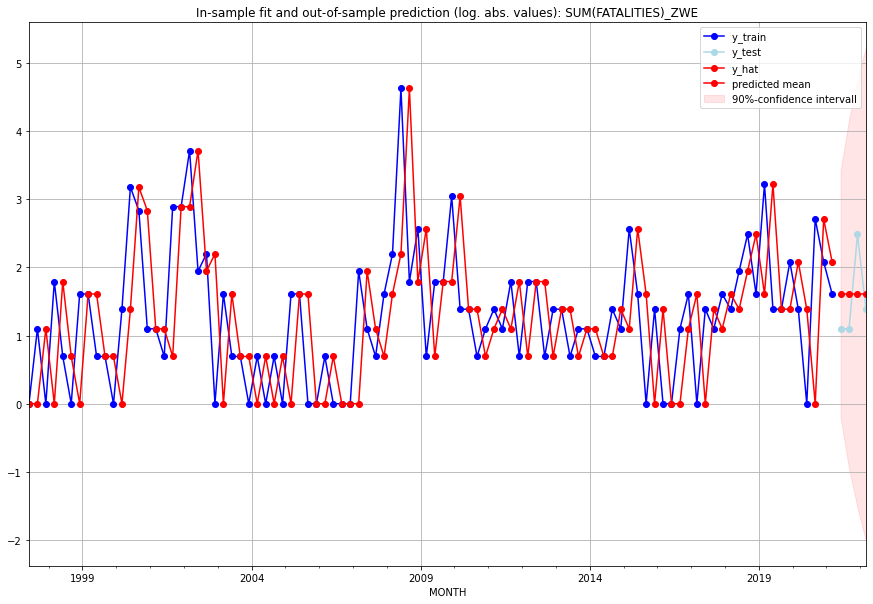

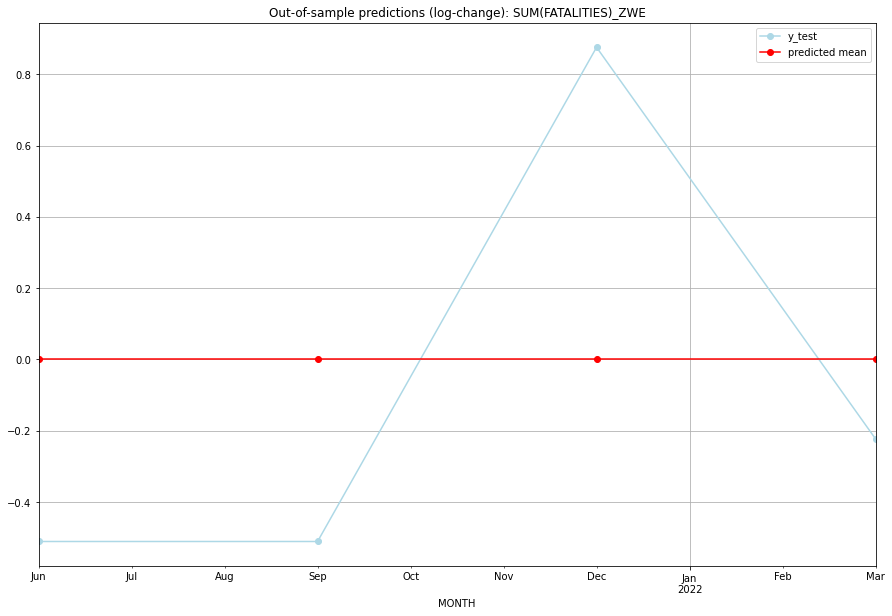

TADDA: 0.5300658840500231
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       4.0         2.0  2.220446e-16       -0.510826   ZWE   
1 2021-07-01       4.0         2.0  2.220446e-16       -0.510826   ZWE   
2 2021-10-01       4.0        11.0  2.220446e-16        0.875469   ZWE   
3 2022-01-01       4.0         3.0  2.220446e-16       -0.223144   ZWE   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20


In [8]:
# warnings.simplefilter(action='ignore')

sarimax_res = pd.DataFrame(columns=["MONTH", "FAT_PRED", "FAT_ACTUAL", "LC(FAT_PRED)", "LC(FAT_ACTUAL)", "GID_0", "PARAMETERS", "TIMESTAMP"])
csv_file = "../data/"+MODEL_NAME+"_PREDICTIONS.csv"

if os.path.exists(csv_file):
    existing_res = pd.read_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv")
    # print(existing_res)
    print("File already exists.")
    
else:
    sarimax_res.to_csv(csv_file, index=False, mode="a", header=True)
    existing_res = sarimax_res

for i, g in enumerate(gid_list):
# for i, g in enumerate(["XNC"]):
    print("######## "+g+" ("+str(i+1)+"/"+str(len(gid_list))+") #########")
    # print(existing_res[existing_res["GID_0"] == g])
    print(len(existing_res[existing_res["GID_0"] == g]))
    
    
    # skip country if results already exiast
    if len(existing_res[existing_res["GID_0"] == g]) > 0:
        print("Model for this country has already been fitted.")
        continue
    
    # add time series of neighboring  countries as predictor variables

    if NEIGHBORS == True:
        neighbor = gid0_neighbors[gid0_neighbors["GID_0"] == g]["NEIGHBOUR"].tolist()
    else:
        neighbor = []
    print("Neighbor countries: "+ str(neighbor))

    # measure time 
    st = time.time()

    res = sarimax(target_variable = TARGET_VARIABLE,
                  target_country = g,
                  predictor_countries = neighbor,
                  n_lags_X = N_LAGS_X,
                  seasonal_periodicity = SEASONAL_PERIODICITY)

    # append country results to csv with timestamp
    res["TIMESTAMP"] = datetime.datetime.now()
    
    res.to_csv(csv_file, index=False, mode="a", header=False)

    et = time.time()
    elapsed_time = et - st
    print('Execution time:', time.strftime("%M:%S", time.gmtime(elapsed_time)))

    sarimax_res = pd.concat([sarimax_res, res], ignore_index=True)

    # break

In [9]:
# varimax_res.to_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv", index=False)

In [10]:
sarimax_res

,MONTH,FAT_PRED,FAT_ACTUAL,LC(FAT_PRED),LC(FAT_ACTUAL),GID_0,PARAMETERS,TIMESTAMP
0,2021-04-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:21.539882
1,2021-07-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:21.539882
2,2021-10-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:21.539882
3,2022-01-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:21.539882
4,2021-04-01 00:00:00,8222.782078,18574.0,0.000825,0.815611,AFG,"{'params': [2, (2, 1, 0), (0, 0, 0, 0), 'n'], ...",2022-10-19 10:23:39.601906
...,...,...,...,...,...,...,...,...
931,2022-01-01 00:00:00,3.4926,0.0,0.116137,-1.386294,ZMB,"{'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:03:12.961884
932,2021-04-01 00:00:00,4.0,2.0,0.0,-0.510826,ZWE,"{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:03:33.888491
933,2021-07-01 00:00:00,4.0,2.0,0.0,-0.510826,ZWE,"{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:03:33.888491
934,2021-10-01 00:00:00,4.0,11.0,0.0,0.875469,ZWE,"{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:03:33.888491


In [11]:
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK
